<img src="HFPS.png" alt="LOGO" style="height: 250px; width:800px;"/>

## Team Members:
- Yashowardhan Shinde
- Aryan Kenchappagol
- Sumit Patil
- Yash Panchwatkar

## Problem Statement:
**Heart Failure Prediction using Machine Learning model during the follow up period of a patient when he/she has been diagnosed with a Heart Condition.**

**We intend to develop a robust hybrid prediction model for detecting a heart failure in a patient during the follow up period of the patient so that the they can be more aware of their heart conditions and can take the necessary actions according to their heart condition.**

## Importing all the necessary libraries.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
%matplotlib inline

## Loading the dataset:

In [2]:
df = pd.read_csv("heart_failure_clinical_records_dataset.csv")
df.head()

,age,anaemia,creatinine_phosphokinase,diabetes,ejection_fraction,high_blood_pressure,platelets,serum_creatinine,serum_sodium,sex,smoking,time,DEATH_EVENT
0,75.0,0,582,0,20,1,265000.00,1.9,130,1,0,4,1
1,55.0,0,7861,0,38,0,263358.03,1.1,136,1,0,6,1
2,65.0,0,146,0,20,0,162000.00,1.3,129,1,1,7,1
3,50.0,1,111,0,20,0,210000.00,1.9,137,1,0,7,1
4,65.0,1,160,1,20,0,327000.00,2.7,116,0,0,8,1


## Data Description:
1. **Age**: age of patient (in years)

2. **Anaemia**: Decrease of red blood cells or hemoglobin

3. **High blood pressure**: If a patient has hypertension

4. **Creatinine phosphokinase**: Level of the CPK enzyme in the blood (mcg/L)

5. **Diabetes**: If the patient has diabetes

6. **Ejection fraction**: Percentage of blood leaving the heart at each contraction

7. **Sex**: Woman or man

8. **Platelets**: Platelets in the blood (kiloplatelets/mL)

9. **Serum creatinine**: Level of creatinine in the blood (mg/dL)

10. **Serum sodium**: Level of sodium in the blood (mEq/L)

11. **Smoking**: If the patient smokes

12. **Time**: Follow-up period (in days)

13. **(Target) Death Event**: If the patient died during the follow-up period

## Performing EDA Exploratory Data Anlysis

In [3]:
df.describe()

,age,anaemia,creatinine_phosphokinase,diabetes,ejection_fraction,high_blood_pressure,platelets,serum_creatinine,serum_sodium,sex,smoking,time,DEATH_EVENT
count,299.000000,299.000000,299.000000,299.000000,299.000000,299.000000,299.000000,299.00000,299.000000,299.000000,299.00000,299.000000,299.00000
mean,60.833893,0.431438,581.839465,0.418060,38.083612,0.351171,263358.029264,1.39388,136.625418,0.648829,0.32107,130.260870,0.32107
std,11.894809,0.496107,970.287881,0.494067,11.834841,0.478136,97804.236869,1.03451,4.412477,0.478136,0.46767,77.614208,0.46767
min,40.000000,0.000000,23.000000,0.000000,14.000000,0.000000,25100.000000,0.50000,113.000000,0.000000,0.00000,4.000000,0.00000
25%,51.000000,0.000000,116.500000,0.000000,30.000000,0.000000,212500.000000,0.90000,134.000000,0.000000,0.00000,73.000000,0.00000
50%,60.000000,0.000000,250.000000,0.000000,38.000000,0.000000,262000.000000,1.10000,137.000000,1.000000,0.00000,115.000000,0.00000
75%,70.000000,1.000000,582.000000,1.000000,45.000000,1.000000,303500.000000,1.40000,140.000000,1.000000,1.00000,203.000000,1.00000
max,95.000000,1.000000,7861.000000,1.000000,80.000000,1.000000,850000.000000,9.40000,148.000000,1.000000,1.00000,285.000000,1.00000


In [4]:
df.dtypes

age                         float64
anaemia                       int64
creatinine_phosphokinase      int64
diabetes                      int64
ejection_fraction             int64
high_blood_pressure           int64
platelets                   float64
serum_creatinine            float64
serum_sodium                  int64
sex                           int64
smoking                       int64
time                          int64
DEATH_EVENT                   int64
dtype: object

In [5]:
df.isnull().sum()

age                         0
anaemia                     0
creatinine_phosphokinase    0
diabetes                    0
ejection_fraction           0
high_blood_pressure         0
platelets                   0
serum_creatinine            0
serum_sodium                0
sex                         0
smoking                     0
time                        0
DEATH_EVENT                 0
dtype: int64

## Visualization for exploring data:
- Pairplot
- Histograms for data distribution
- Box Plots 
- Bar Charts
- Scatter Plots
- Correlation Graph (Heatmap)

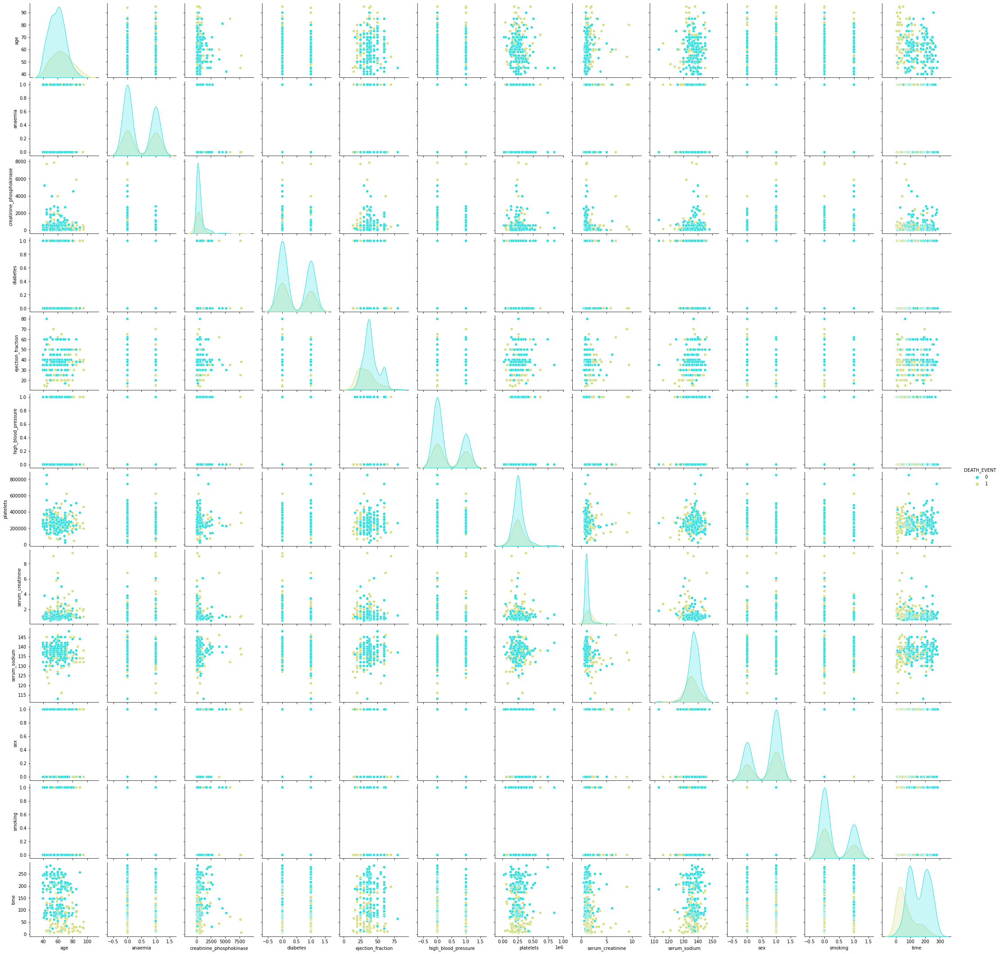

In [6]:
sns.pairplot(df, hue = 'DEATH_EVENT', palette='rainbow')
plt.show()

In [6]:
numeric = ['age', 'creatinine_phosphokinase', 
           'ejection_fraction', 'platelets', 
           'serum_creatinine', 'time', 'serum_sodium']

## Gender Analysis:
Now we will see the relation between the gender of the patients and the values other attributes like Age, Platelets, Ceratinine Phosphokinase etc.

In [7]:
fig = make_subplots(rows=2, cols=3, start_cell="top-left", subplot_titles=("Age","Creatinine Phosphokinase", "Platelets","Serum Creatinine","Serum Sodium","Time", "Diabetes"))
fig.add_trace(go.Box(y=df['age'], x=df['sex'],boxpoints='all', name='Age'), row=1, col=1)
fig.add_trace(go.Box(y=df['creatinine_phosphokinase'], x=df['sex'],boxpoints='all', name='Creatinine Phosphokinase'), row=1, col=2)
fig.add_trace(go.Box(y=df['platelets'], x=df['sex'],boxpoints='all', name='Platelets'), row=1, col=3)
fig.add_trace(go.Box(y=df['serum_creatinine'], x=df['sex'],boxpoints='all', name='Serum Creatinine'), row=2, col=1)
fig.add_trace(go.Box(y=df['serum_sodium'], x=df['sex'], boxpoints='all',name='Serum Sodium'), row=2, col=2)
fig.add_trace(go.Box(y=df['time'], x=df['sex'], boxpoints='all', name='Time'), row=2, col=3) 
fig.update_layout(height=1400, width=1000,showlegend=False)
fig.show()

**From the above graphs we can draw a few conclusions like:**
- The age of most females in our data lie between 50 and 67 whereas the age of most males lies between 52 and 70
- The majority of females have platelets in the range 223k and 318k (kilo platelets/mL) whereas majority of males have platelets in the range 211k and 295k(kilo platelets/mL)
- The Sodium Serum levels in females is in the range 135 and 140 (mEq/L) whereas in males it is 134 and 139 (mEq/L) which isn't a huge difference.
- The serum creatinine levels for both males and females also lie in a very similar range of about 0.9 and 1.4(mg/dL)
- The Creatinine Phosphokinase levels of both males and females lie in the range 115 and 582 (mcg/L)
- In conclusion most of the attributes for both males and females are very similar.

## Smoking Analysis:
**Now we will try to explore the data about the smokers and the non smokers from the dataset**

In [8]:
smoking = len(df[df['smoking']==1])
non_smoking = len(df)-smoking

print(smoking, non_smoking)

smoking_males = df[df["smoking"] == 1]
smoking_males = len(smoking_males[smoking_males['sex']==1])

smoking_females = df[df["smoking"] == 1]
smoking_females = len(smoking_females[smoking_females['sex']==0])

print(smoking_males, smoking_females)


non_smoking_males = df[df['smoking']==0]
non_smoking_males = len(non_smoking_males[non_smoking_males['sex']==1])

non_smoking_females = df[df['smoking']==0]
non_smoking_females = len(non_smoking_females[non_smoking_females['sex']==0])

print(non_smoking_males, non_smoking_females)

96 203
92 4
102 101


[]

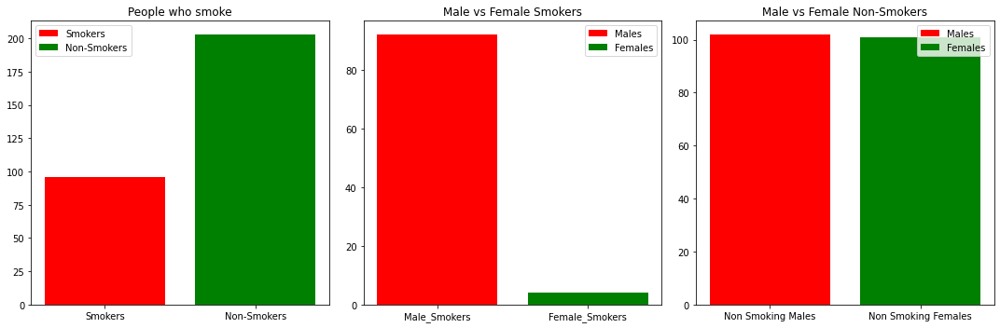

In [9]:
plt.figure(figsize=(15,5))

plt.subplot(1,3,1)
plt.bar(x=["Smokers"], height = [smoking], label = 'Smokers', color = 'red')
plt.bar(x=["Non-Smokers"], height = [non_smoking], label = 'Non-Smokers', color = 'green')
plt.title("People who smoke")
plt.legend()
plt.tight_layout()
plt.plot()

plt.subplot(1,3,2)
plt.bar(x=["Male_Smokers"], height = [smoking_males], label = "Males", color = 'red')
plt.bar(x=["Female_Smokers"], height = [smoking_females], label = "Females", color = 'green')
plt.title("Male vs Female Smokers")
plt.legend()
plt.tight_layout()
plt.plot()

plt.subplot(1,3,3)
plt.bar(x=['Non Smoking Males'], height = [non_smoking_males], label = "Males", color = 'red')
plt.bar(x=["Non Smoking Females"], height = [non_smoking_females], label = "Females", color = 'green')
plt.title("Male vs Female Non-Smokers")
plt.legend()
plt.tight_layout()
plt.plot()

#### Graph 1:(Smokers vs Non-Smokers)
We can see that in our data set we have more non smokers than smokers. Now, let's explore some data on the smokers.
#### Graph 2: (Male vs Female) Smokers
In the second graph it is clearly visible that our data has very few female smokers and a lot of male smokers.
#### Graph 3: (Male vs Female) Non-Smokers
In the third graph it is seen that the number of male non-smokers and female non-smokers is quite similar.

**In conclusion we can say that the non-smokers are in majority with equal male and female distribution and the males dominate in the smoking zone with a few female smokers**

In [10]:
smokers_btwn_40_50 = df[df['smoking'] == 1]
smokers_btwn_40_50 = len(smokers_btwn_40_50[smokers_btwn_40_50['age']<50])
print(smokers_btwn_40_50)

smokers_btwn_50_60 = df[df['smoking'] == 1]
smokers_btwn_50_60 = smokers_btwn_50_60[50<=smokers_btwn_50_60['age']]
smokers_btwn_50_60 = len(smokers_btwn_50_60[smokers_btwn_50_60['age']<60])
print(smokers_btwn_50_60)

smokers_btwn_60_70 = df[df['smoking'] == 1]
smokers_btwn_60_70 = smokers_btwn_60_70[60<=smokers_btwn_60_70['age']]
smokers_btwn_60_70 = len(smokers_btwn_60_70[smokers_btwn_60_70['age']<70])
print(smokers_btwn_60_70)

smokers_above_70 = df[df['smoking'] == 1]
smokers_above_70 = len(smokers_above_70[70<=smokers_above_70['age']])
print(smokers_above_70)
len(df[df['smoking'] == 1])

11
29
29
27


96

[]

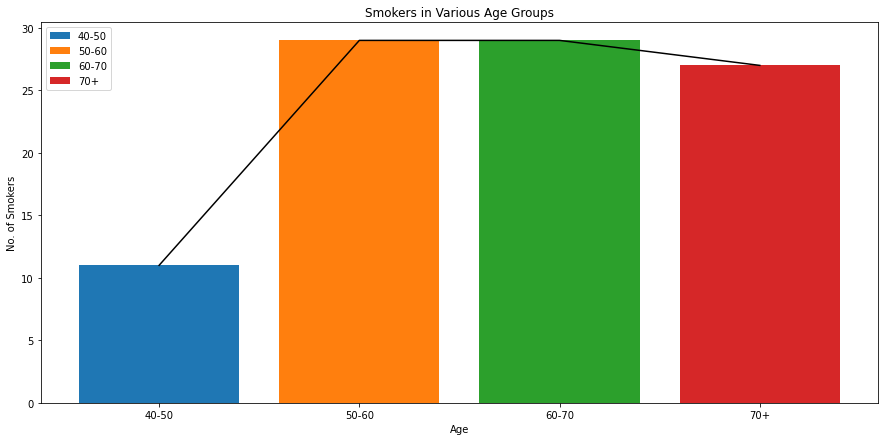

In [11]:
fig = plt.figure(figsize=(15,7))
plt.bar(x = ["40-50"], height = smokers_btwn_40_50, label = '40-50')
plt.bar(x = ["50-60"], height = smokers_btwn_50_60, label = '50-60')
plt.bar(x = ['60-70'], height = smokers_btwn_60_70, label = '60-70')
plt.bar(x = ['70+'], height =  smokers_above_70, label = '70+')
plt.title("Smokers in Various Age Groups")
plt.xlabel("Age")
plt.ylabel("No. of Smokers")
plt.legend()
plt.plot()

plt.plot([smokers_btwn_40_50, smokers_btwn_50_60, smokers_btwn_60_70, smokers_above_70], color = 'black')
plt.plot()

### The graph above depicts the distribution of smokers over different age groups:
**From the graph we can conclude that people with older age have a higher tendency of smoking and the people with age between age 40-50 have lower tendency of smoking.** 

### Plotting Histograms for Continuous Data:
**The ideal histogram should show a trend like a Bell Curve if any histogram has a positive or a negative skewed distribution we will try to fix that using some standard transformations.**

**Methods to fix skewness in data:**
- Right Skewed Data
    1. Square Root
    2. Cube Root
    3. Log
    4. Reciprocal
- Left Skewed Data
    1. Square
    2. Cube
    3. Higher Power

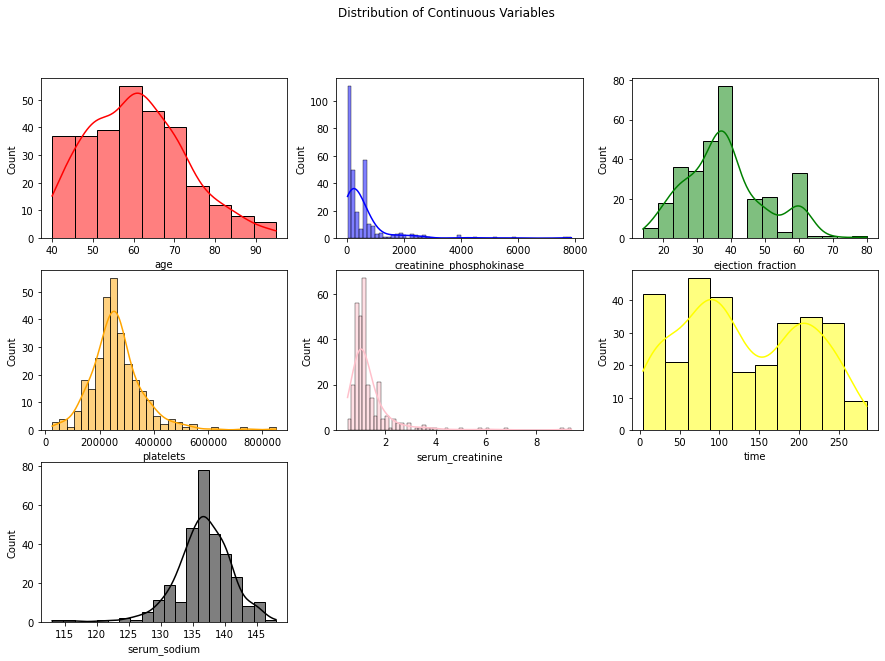

In [12]:
figure = plt.figure(figsize=(15, 10))
colors = ['red', 'blue', 'green', 'orange', 'pink', 'yellow', 'black']
plt.suptitle("Distribution of Continuous Variables")
for i in range(1, 8):
    plt.subplot(3,3,i)
    sns.histplot(df[numeric[i-1]], color = colors[i-1], kde=True)
    # plt.plot(df[numeric[i-1]])
    plt.xlabel(numeric[i-1])
    plt.plot()

**As we can see that the distribution of serum_creatinine and creatinine_phosphokinase show Right Skewness so we will try to fix this using our standard transformations here we will use the Leo-Johnson transformation method** 

In [13]:
from sklearn.preprocessing import PowerTransformer

t = np.array(list(df['creatinine_phosphokinase'])).reshape(-1, 1)
pt = PowerTransformer(method = "yeo-johnson")
creatinine_phosphokinase = pt.fit_transform(t)
df['creatinine_phosphokinase'] = creatinine_phosphokinase

t = np.array(list(df['serum_creatinine'])).reshape(-1, 1)
pt = PowerTransformer(method = "yeo-johnson")
serum_creatinine = pt.fit_transform(t)
df['serum_creatinine'] = serum_creatinine

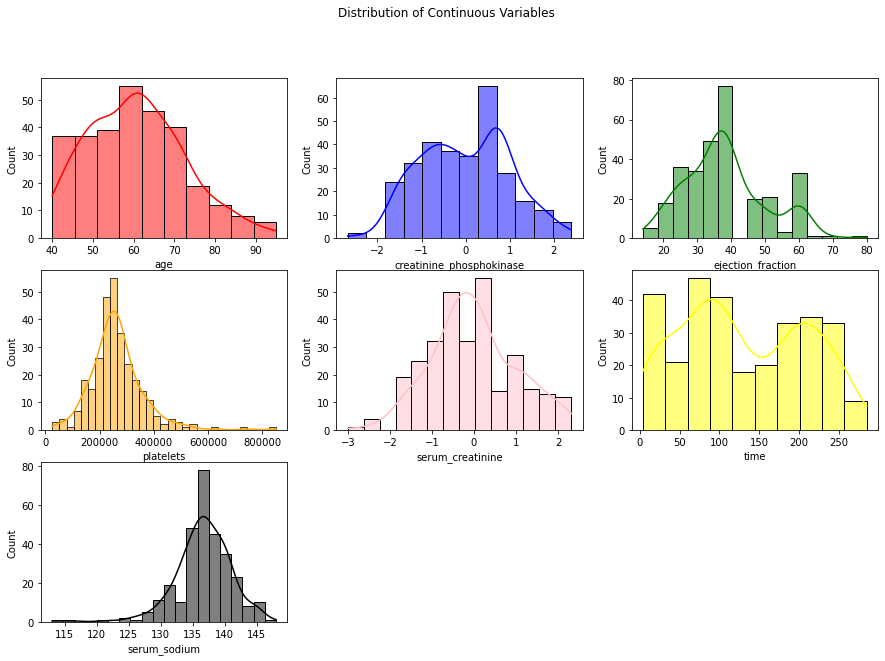

In [14]:
figure = plt.figure(figsize=(15, 10))
colors = ['red', 'blue', 'green', 'orange', 'pink', 'yellow', 'black']
plt.suptitle("Distribution of Continuous Variables")
for i in range(1, 8):
    plt.subplot(3,3,i)
    sns.histplot(df[numeric[i-1]], color = colors[i-1], kde=True)
    # plt.plot(df[numeric[i-1]])
    plt.xlabel(numeric[i-1])
    plt.plot()

**After doing the transformation we can now see that the data is distributed as per the Bell Curve so we can move forward**

### Scatter Plots:
Scatter plots to determine if there is any significant relation between the Age of the patients and all the other parameters we have in our dataset.

[]

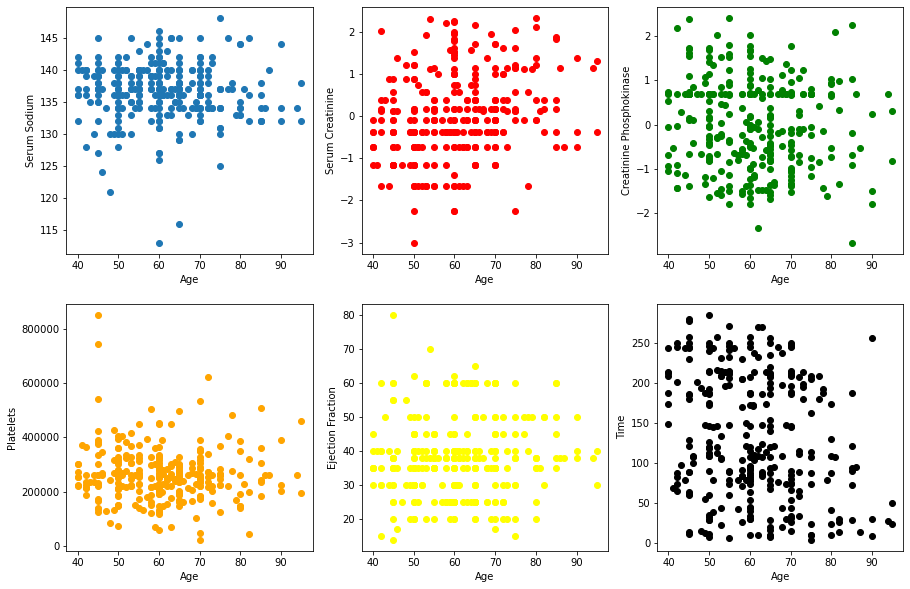

In [15]:
plt.figure(figsize=(15,10))

plt.subplot(2,3,1)
plt.scatter(x=df['age'], y=df['serum_sodium'])
plt.xlabel('Age')
plt.ylabel('Serum Sodium')
plt.plot()

plt.subplot(2,3,2)
plt.scatter(x=df['age'], y = df['serum_creatinine'], color='red')
plt.xlabel('Age')
plt.ylabel('Serum Creatinine')
plt.plot()

plt.subplot(2,3,3)
plt.scatter(x=df['age'], y = df['creatinine_phosphokinase'], color = 'green')
plt.xlabel('Age')
plt.ylabel('Creatinine Phosphokinase')
plt.plot()

plt.subplot(2,3,4)
plt.scatter(x=df['age'], y = df['platelets'], color = 'orange')
plt.xlabel('Age')
plt.ylabel('Platelets')
plt.plot()

plt.subplot(2,3,5)
plt.scatter(x=df['age'], y = df['ejection_fraction'], color = 'yellow')
plt.xlabel('Age')
plt.ylabel('Ejection Fraction')
plt.plot()

plt.subplot(2,3,6)
plt.scatter(x=df['age'], y = df['time'], color = 'black')
plt.xlabel('Age')
plt.ylabel('Time')
plt.plot()

**The scatter plots above do not show any significant trend between Age of the patient and the other quantities, the data is randomly distributed all over the plane.** 

### HeatMap:
- Using the heat map we will determine if there is any significant relation between any of the continuous variables and if any significant relation is found we will drop of othe two related quantities.

- In the heat map below  we can see that there is no significant relation between any of the continuous variables so we can move forward without dropping any columns.

<AxesSubplot:>

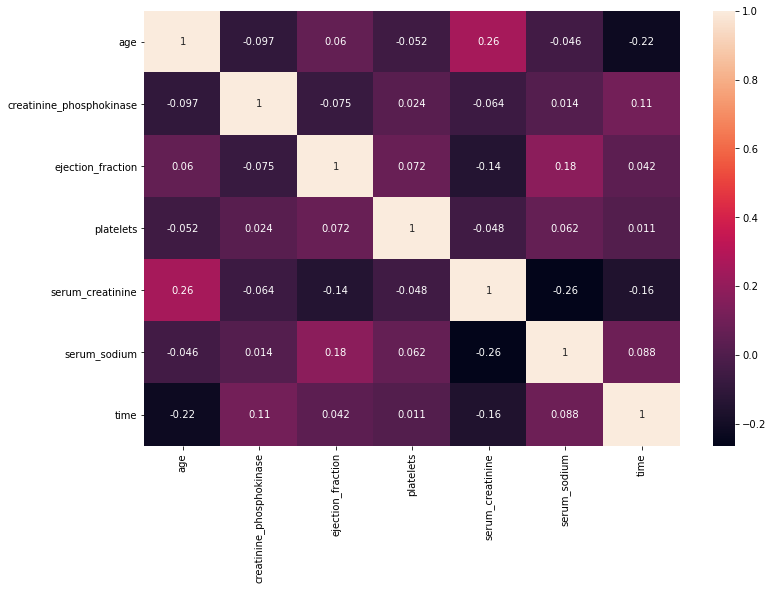

In [16]:
df_heatmap = df.drop(columns=['anaemia', 'diabetes', 'high_blood_pressure', 'sex', 'smoking', 'DEATH_EVENT'])
fig = plt.figure(figsize=(12,8))
sns.heatmap(df_heatmap.corr(), annot = True)

## Relation between Categorical and Continuous Data & Relation between Categorical Data:

For this we will use the chi square test, t-test, p-test, anova test
- chi square test: categorical vs categorical
- t-test: continuous & continuous vs categorical


In [17]:
from sklearn.feature_selection import chi2

categorical_data = ['anaemia',
                     'diabetes',
                     'high_blood_pressure',
                     'sex',
                     'smoking',
                     'DEATH_EVENT']
test_df = df.drop(columns=numeric)
test_df.head()


,anaemia,diabetes,high_blood_pressure,sex,smoking,DEATH_EVENT
0,0,0,1,1,0,1
1,0,0,0,1,0,1
2,0,0,0,1,1,1
3,1,0,0,1,0,1
4,1,1,0,0,0,1


## Chi2 Test:

### Hypothesis:
- Ho = The feature and Target variable have no relation
- Alternate Hypothesis = The feature and the Target variable are closely related.

We will calculate the p-value for each feature our threshold will be 0.05, if any p-value is less than 0.05 we will reject our null hypothesis and accept the alternate hypothesis.

First we will perform the chi2 test for independent variables and the between the independent and target variable.

### Chi2 Test between Independent Variables:

In [18]:
# anaemia vs other independent features ('diaetes', 'high_blood_pressure', 'sex', 'smoking')

dict1 = dict()
independent = ('diabetes', 'high_blood_pressure', 'sex', 'smoking')
chi2_val, p_val = chi2(test_df.iloc[:, 1:5], test_df.iloc[:, 0])

itr = 0
for i in independent:
    string = f'anaemia vs {i}'
    dict1[string] = p_val[itr]
    itr += 1

# dict1

In [19]:
# smoking vs other independent features ('diaetes', 'high_blood_pressure', 'sex')

dict2 = dict()
independent = ('diaetes', 'high_blood_pressure', 'sex')
chi2_val, p_val = chi2(test_df.iloc[:, 1:4], test_df.iloc[:, 4])

itr = 0
for i in independent:
    string = f'smoking vs {i}'
    dict2[string] = p_val[itr]
    itr += 1

# dict2

In [20]:
# diabetes vs other independent features ('high_blood_pressure', 'sex')

dict3 = dict()
independent = ('high_blood_pressure', 'sex')
chi2_val, p_val = chi2(test_df.iloc[:, 2:4], test_df.iloc[:, 1])

itr = 0
for i in independent:
    string = f'diabetes vs {i}'
    dict3[string] = p_val[itr]
    itr += 1

# dict3

In [21]:
# high_blood_pressure vs sex

dict4 = dict()
independent = ['sex']
chi2_val, p_val = chi2(test_df.iloc[:, 3:4], test_df.iloc[:, 2])

itr = 0
for i in independent:
    string = f'high_blood_pressure vs {i}'
    dict4[string] = p_val[itr]

# dict4

In [22]:
# Summarizing the Results:

dict_names = [dict1, dict2, dict3, dict4]
for i in range(0, 4):
    dictionary = dict_names[i]
    for key, value in dictionary.items():
        print(f'{key}: {value}')

anaemia vs diabetes: 0.8666559347273115
anaemia vs high_blood_pressure: 0.594854992140792
anaemia vs sex: 0.3315020306255289
anaemia vs smoking: 0.1263525006678854
smoking vs diaetes: 0.05221575927284853
smoking vs high_blood_pressure: 0.43776694989237386
smoking vs sex: 4.899856713610256e-06
diabetes vs high_blood_pressure: 0.8592401113570308
diabetes vs sex: 0.10604103630413232
high_blood_pressure vs sex: 0.28372858577976934


### Chi2 Test between Independent Variables and Target Variables:

In [23]:
# independent features vs Target Variable

dict5 = dict()
independent = ('anaemia', 'diabetes', 'high_blood_pressure', 'sex', 'smoking')
chi2_val, p_val = chi2(test_df.iloc[:, 0:5], test_df.iloc[:, -1])

itr = 0
for i in independent:
    string = f'DEATH_EVENT vs {i}'
    dict5[string] = p_val[itr]
    itr += 1
    
dict5

{'DEATH_EVENT vs anaemia': 0.387556924759485,
 'DEATH_EVENT vs diabetes': 0.9795537403764981,
 'DEATH_EVENT vs high_blood_pressure': 0.2690589262568509,
 'DEATH_EVENT vs sex': 0.9647213115147079,
 'DEATH_EVENT vs smoking': 0.8572685693681174}

In [24]:
heat_plot = [[1,0.8666559347273115,0.594854992140792,0.3315020306255289,0.1263525006678854,0.387556924759485],
            [0.8666559347273115,1,0.8592401113570308,0.10604103630413232,0.05221575927284853,0.9795537403764981],
            [0.594854992140792,0.8592401113570308,1,0.28372858577976934,0.43776694989237386,0.2690589262568509],
            [0.3315020306255289,0.10604103630413232,0.28372858577976934,1,.0004899856713610,0.9647213115147079],
            [0.1263525006678854,0.05221575927284853,0.43776694989237386,.0004899856713610,1,0.8572685693681174],
            [0.387556924759485,0.9795537403764981,0.2690589262568509,0.9647213115147079,0.8572685693681174,1]]

categorical_data = ['anaemia',
                     'diabetes',
                     'high_bp',
                     'sex',
                     'smoking',
                     'DEATH_EVENT']

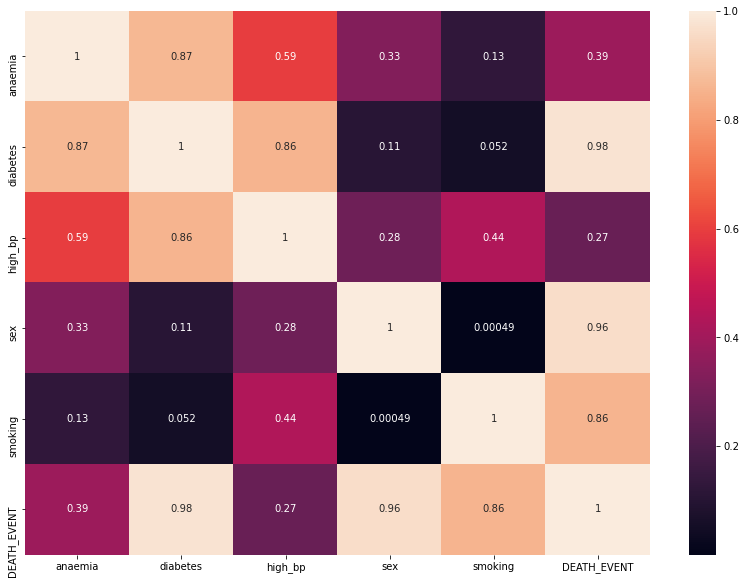

In [25]:
fig = plt.figure(figsize=(14, 10))
sns.heatmap(heat_plot, annot = True)
plt.xticks([i+0.5 for i in range(6)], categorical_data)
plt.yticks([i+0.5 for i in range(6)], categorical_data)
plt.show()

## Results of Chi2 Test:

- Ho = The variables are not related (p_val > 0.05)
- H1 = The variables are related (p_val < 0.05)

1. DEATH_EVENT our target variable shows no significant relation with any of the other variables.
2. SEX and SMOKING share a very strong relation this result was expected considering the earlier observations.
3. SMOKING and DIABETES also share a strong relation.

### Conclusion:

**None of the categorical variables share a strong relation with the target variable but there are some independent variable which are closely related so we will probably drop one of those variables to avoid a bias** 

In [26]:
df.drop(columns = ['sex', 'diabetes'], inplace = True)

In [27]:
X = df.iloc[:, 0:10].values
Y = df['DEATH_EVENT'].values

## Spliting Data into Train and Test Data:
- We will be splitting our data in ratio of 9:1 out of which 90% would be training data and 10% would be testing data. to do this we will use the **train_test_split module**.
- To evalute the performance of the models we will consider the mean square error and the **f1-score**. 
- We will also include the **GridSearchCV** for Hyper Parameter Tuning here 

In [28]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import learning_curve

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.1, random_state=6)

## Model Training Testing and Selection:

We will be using a blend of typical classification models and Ensemble based classification models to solve this problem.

Models that we will use:
1. Logistic Regression
2. Decision Tree
3. Random Forest
4. Bagging Classifier
5. GradientBoosting Classifier
6. XGBoost
7. XGBRFClassifier
8. Extra Trees Classifier
9. KNearestNeighbors
10. CatBoostClassifier

After training and testing the models we will aslo study the feature importance for the models and try hyper parameter tuning where ever possible.

**Out of all these models we will select the top 5 models based on the F1-Scores and the create a final Aggregator function which will make the final prediction**

## Logistic Regression:
Even after trying hyper paramenter tuning we were getting similar results so we decided not to use hyper parameter tuning here.

To plot the feature importance we will make use of the coefficients equations optimized by our Logistic Regression model. The features with the most significance were found to be:
   1. Time
   2. Serum Sodium
   3. Age
    
**Final Reults:**
  - Train Accuracy:  0.8215613382899628
  - Test Accuracy:  0.9
  - F1 score Test:  0.8571428571428572

In [29]:
from sklearn.linear_model import LogisticRegression

lr = LogisticRegression(C=0.01)
lr.fit(x_train, y_train)
predict = lr.predict(x_test)

print("Train Accuracy: ",lr.score(x_train, y_train))
print("Test Accuracy: ", lr.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.8215613382899628
Test Accuracy:  0.9
F1 score Test:  0.8571428571428572


## Feature Importance Decision Tree Classifier:

In [30]:
lr.coef_

array([[ 9.72123719e-03,  8.31708394e-05,  1.08400949e-04,
        -2.56293258e-03,  3.42245622e-05, -2.13147922e-06,
         6.22735998e-04,  1.09413211e-02,  2.13918789e-06,
        -1.96834647e-02]])

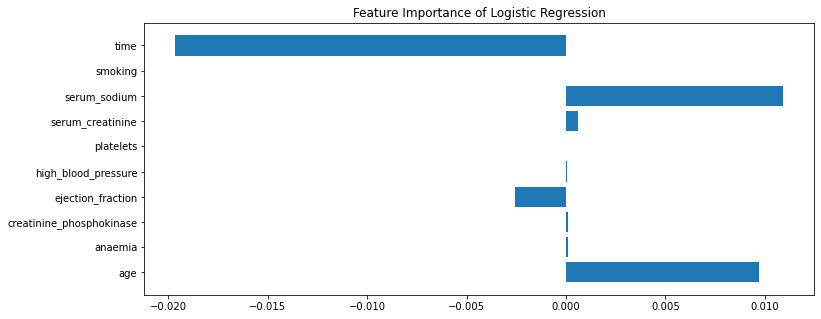

In [31]:
fig = plt.figure(figsize=(12, 5))
importance = lr.coef_
plt.title("Feature Importance of Logistic Regression")
plt.barh(y = [i for i in range(10)], width = [x for x in importance[0]])
plt.yticks([i for i in range(10)], list(df.columns)[:10])
plt.show()

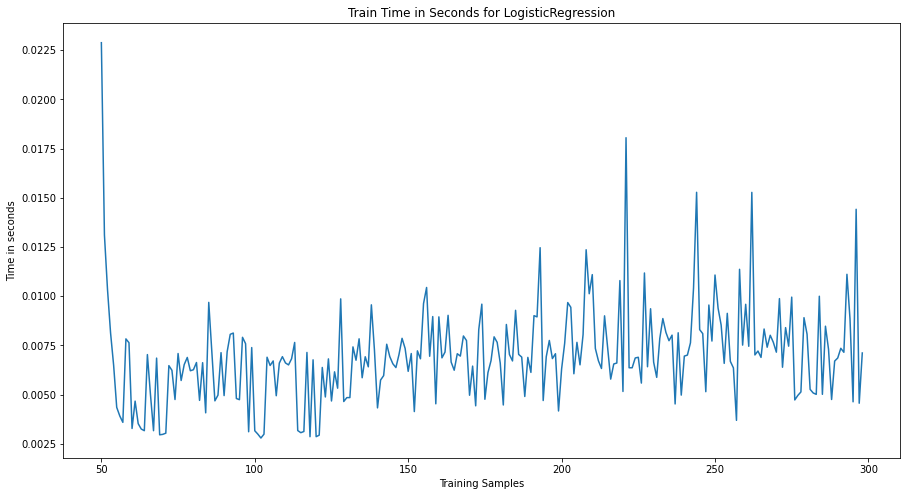

In [32]:
import time

def train_time(clf, X, Y, title):
    time_arr = []
    samples = [i for i in range(50, 299)]
    for i in range(len(samples)):
        x = X[:samples[i]]
        y = Y[:samples[i]]
        start_time = time.time()
        clf.fit(x,y)
        end_time = time.time()
        time_arr.append(end_time-start_time)
        
    fig = plt.figure(figsize=(15,8))
    
    plt.plot(time_arr)
    plt.title(title)
    plt.xlabel("Training Samples")
    plt.ylabel("Time in seconds")
    plt.xticks([i for i in range(0, 251, 50)], [i+50 for i in range(0, 251, 50)])


train_time(LogisticRegression(max_iter=1500), X, Y, "Train Time in Seconds for LogisticRegression")

## Decision Tree:

We got pretty good result using the decision tree it was found that the most important features according to the decision tree were:
1. Time
2. Serum Ceratinine
3. Ceratinine Phosphokinase

The parameter values suggested by hyper paratmeter tuning were the same as before.

**Final Reults:**
  - Train Accuracy:  1.0
  - Test Accuracy:  0.9666666666666667
  - F1 score Test:  0.9523809523809523

In [33]:
from sklearn.tree import DecisionTreeClassifier

dclf = DecisionTreeClassifier()
dclf.fit(x_train, y_train)
predict = dclf.predict(x_test)

print("Train Accuracy: ",dclf.score(x_train, y_train))
print("Test Accuracy: ", dclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9666666666666667
F1 score Test:  0.9523809523809523


### Hyper Parameter Tuning Decision Tree Classifier

In [32]:
dclf.get_params().keys()

dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_impurity_split', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'presort', 'random_state', 'splitter'])

In [77]:
grid ={
    'max_depth':[i for i in range(14,30)],
    'criterion':['gini', 'entropy']
}

clf = GridSearchCV(dclf, grid)
clf.fit(X, Y)
clf.best_params_

{'criterion': 'gini', 'max_depth': 15}

In [36]:
dclf = DecisionTreeClassifier(criterion='gini', 
                              max_depth= 15,
                            )
dclf.fit(x_train, y_train)
predict = dclf.predict(x_test)

print("Train Accuracy: ",dclf.score(x_train, y_train))
print("Test Accuracy: ", dclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9666666666666667
F1 score Test:  0.9523809523809523


### Feature Importance Decision Tree Classifier:

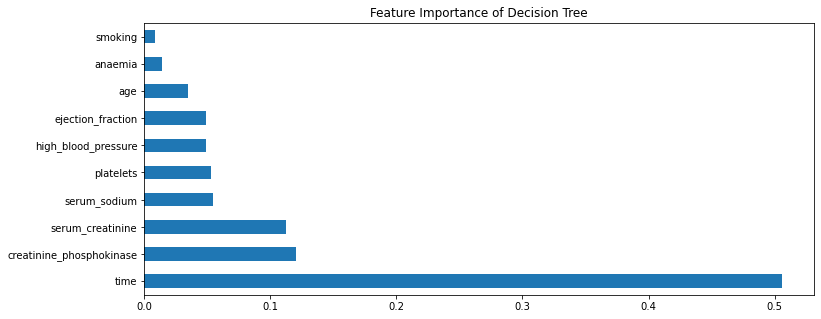

In [37]:
feature_imp = pd.Series(dclf.feature_importances_, index = list(df.columns)[:10])
fig = plt.figure(figsize=(12, 5))
feature_imp.nlargest(10).plot(kind = 'barh')
plt.title("Feature Importance of Decision Tree")
plt.show()

## Training Time Analysis:

We will try training our Decision Tree using different number of samples and then plot the training time required against the number of samples used for training the model.

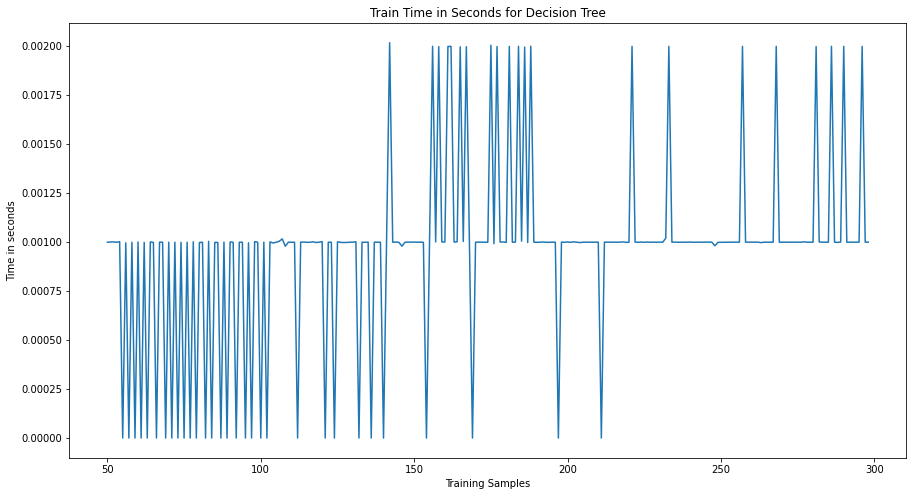

In [62]:
train_time(DecisionTreeClassifier(criterion='gini', max_depth= 14), X, Y, "Train Time in Seconds for Decision Tree")

### Decision Tree Visualization:

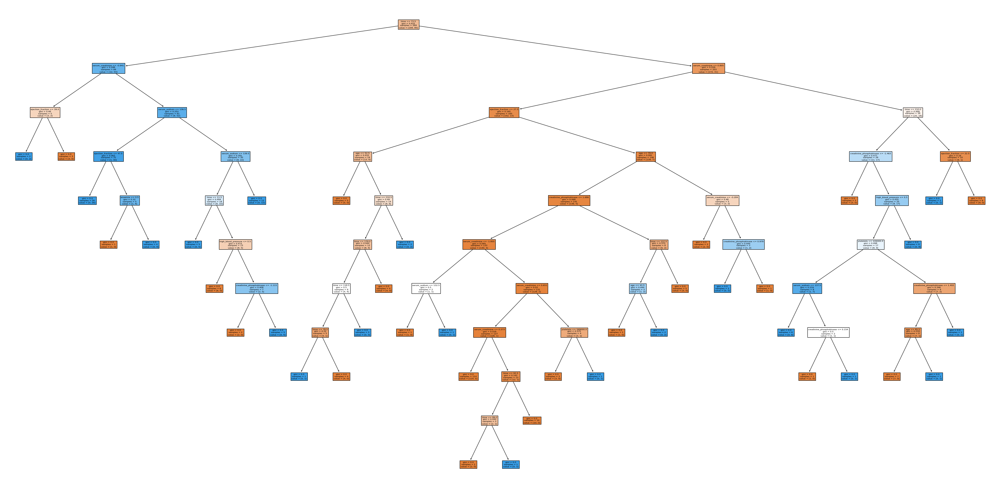

In [78]:
from sklearn import tree
figure = plt.figure(figsize=(50, 25))
t = tree.plot_tree(dclf, 
                   feature_names=list(df.columns)[:12],  
                   
                   filled=True)

## Random Forest:

<img src="RandomForest.ppm" alt="Bagging Classifier" style="height: 400px; width:400px;"/>

We got pretty good result using the Random Forest too, it was found that the most important features according to the Random Forest were:
1. Time
2. Serum Ceratinine
3. Ejection Fraction

Hyper Parameter Tuning helped us achieve a slightly better accuracy and f1-score.

**Final Reults:**
  - Train Accuracy:  1.0
  - Test Accuracy:  0.9333333333333333
  - F1 score Test:  0.9090909090909091

In [38]:
from sklearn.ensemble import RandomForestClassifier

rclf = RandomForestClassifier()
rclf.fit(x_train, y_train)
predict = rclf.predict(x_test)
print("Train Accuracy: ",rclf.score(x_train, y_train))
print("Test Accuracy: ", rclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9
F1 score Test:  0.8695652173913043


### Hyper Parameter Tuning Random Forest Classifier:

In [31]:
rclf.get_params().keys()

dict_keys(['bootstrap', 'ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'max_samples', 'min_impurity_decrease', 'min_impurity_split', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'n_estimators', 'n_jobs', 'oob_score', 'random_state', 'verbose', 'warm_start'])

In [75]:
grid={
    'max_depth':[i for i in range(12, 30)],
    'n_estimators':[i for i in range(50, 150)],
    'criterion':['gini', 'entropy']
}

clf = GridSearchCV(rclf, grid)
clf.fit(X, Y)
clf.best_params_

{'criterion': 'gini', 'max_depth': 16, 'n_estimators': 82}

In [40]:
rclf = RandomForestClassifier(criterion = 'gini',
                              max_depth = 16,
                              n_estimators = 82)
rclf.fit(x_train, y_train)
predict = rclf.predict(x_test)

print("Train Accuracy: ",rclf.score(x_train, y_train))
print("Test Accuracy: ", rclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9333333333333333
F1 score Test:  0.9090909090909091


### Feature Importance Random Forest Classifier:

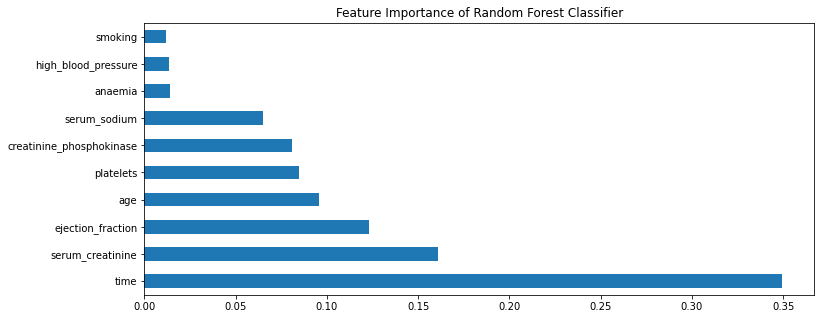

In [41]:
feature_imp = pd.Series(rclf.feature_importances_, index = list(df.columns)[:10])
fig = plt.figure(figsize=(12, 5))
feature_imp.nlargest(10).plot(kind = 'barh')
plt.title("Feature Importance of Random Forest Classifier")
plt.show()

## Training Time Analysis for Random Forest Classifier:

We will try training our Random Forest using different number of samples and then plot the training time required against the number of samples used for training the model.

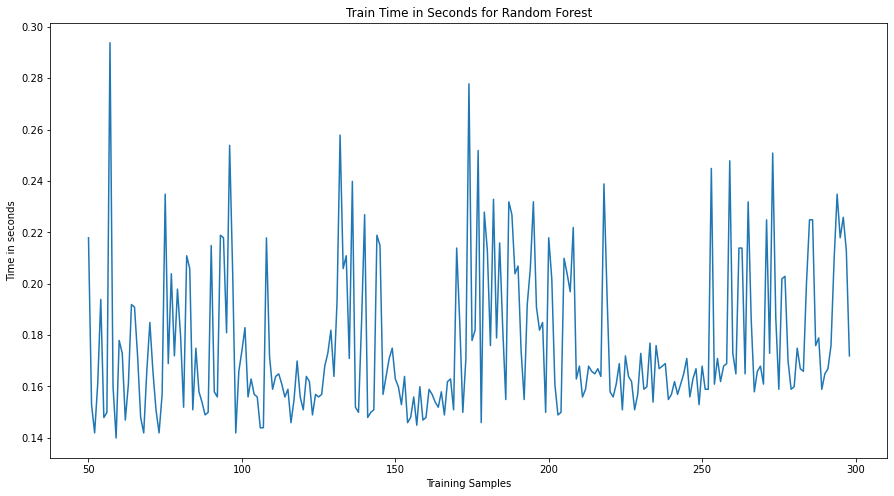

In [69]:
train_time(RandomForestClassifier(criterion='gini', max_depth= 16), X, Y, "Train Time in Seconds for Random Forest")

## Bagging Classifier:

Bagging = Bootstrapping + Aggregator
- **Bootstrapping**: Means that trains the model on random chunks of data, once a sample data is used the same data can be a part of multiple chunks.
- **Aggregator**:    Function which considers output of all the models and return the majority decision.

<img src="BaggingClassifier.png" alt="Bagging Classifier" style="height: 400px; width:400px;"/>

We got pretty good result using the Bagging Classifier too.

The parameter values suggested by hyper paratmeter tuning were the same as before.

**Final Reults:**
  - Train Accuracy:  0.992595167286245
  - Test Accuracy:  0.9333333333333333
  - F1 score Test:  0.9090909090909091

In [42]:
from sklearn.ensemble import BaggingClassifier

bclf = BaggingClassifier()
bclf.fit(x_train, y_train)
predict = bclf.predict(x_test)
print("Train Accuracy: ",bclf.score(x_train, y_train))
print("Test Accuracy: ", bclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.9888475836431226
Test Accuracy:  0.8666666666666667
F1 score Test:  0.8333333333333333


### Hyper Parameter Tuning for Bagging Classifier:

In [95]:
bclf.get_params().keys()

dict_keys(['base_estimator', 'bootstrap', 'bootstrap_features', 'max_features', 'max_samples', 'n_estimators', 'n_jobs', 'oob_score', 'random_state', 'verbose', 'warm_start'])

In [82]:
grid = {
    'base_estimator':[DecisionTreeClassifier(), RandomForestClassifier(), XGBClassifier()],
    'n_estimators':[i for i in range(20, 50)]
}

clf = GridSearchCV(bclf, grid)
clf.fit(X, Y)
clf.best_params_

{'base_estimator': RandomForestClassifier(), 'n_estimators': 34}

In [44]:
bclf = BaggingClassifier(base_estimator = RandomForestClassifier(),
                         n_estimators = 34)
bclf.fit(x_train, y_train)
predict = bclf.predict(x_test)

print("Train Accuracy: ",bclf.score(x_train, y_train))
print("Test Accuracy: ", bclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.9814126394052045
Test Accuracy:  0.9
F1 score Test:  0.8695652173913043


## Feature Importance of Bagging Classifier:

There is no built-in function available for directly calculating the feature importance of the Bagging classifier so to find out the feature importance of all the features what we have done is that we have calculated the feature importance of every base classifier in our bagging classifier i.e a random forest and then taken the average of the feature importances to find the final result

It is found that the most important features according to Bagging classifier are:
  1. Time
  2. Serum Creatinine
  3. Ejection Fraction

In [45]:
feature_importance = [forest.feature_importances_ for forest in bclf.estimators_]
mean_feature_imp = np.zeros((1, 10))

for i in range(34):
    x = np.array(feature_importance[i])
    mean_feature_imp += x
    
mean_feature_imp = mean_feature_imp/34
mean_feature_imp

array([[0.09301586, 0.01424342, 0.08493122, 0.11916325, 0.0132849 ,
        0.08492305, 0.15080668, 0.07284769, 0.01156135, 0.35522256]])

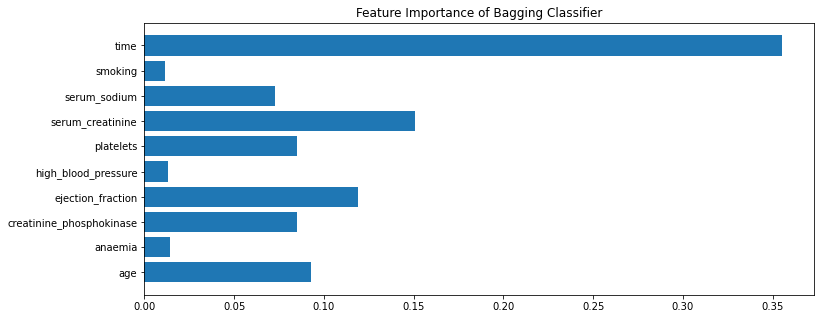

In [46]:
fig = plt.figure(figsize=(12, 5))
plt.title("Feature Importance of Bagging Classifier")
plt.barh(y = [i for i in range(10)], width = [x for x in mean_feature_imp[0]])
plt.yticks([i for i in range(10)], list(df.columns)[:10])
plt.show()

## Training Time Analysis for Bagging Classifer

We will try training our Bagging Classifier using different number of samples and then plot the training time required against the number of samples used for training the model.

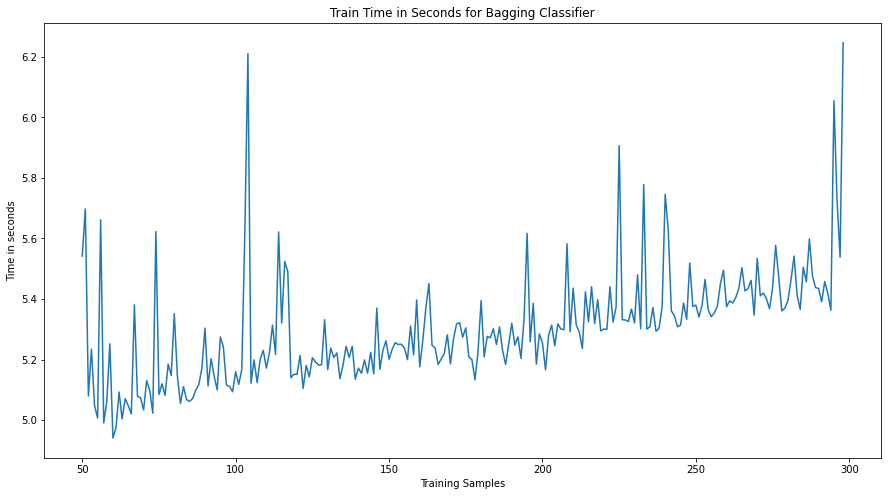

In [68]:
train_time(BaggingClassifier(base_estimator = RandomForestClassifier(),
                         n_estimators = 34), X, Y, "Train Time in Seconds for Bagging Classifier")

## Gradient Boosting:

Gradient Boosting is a ensemble earning method in which the residual or loss of the previously misclassified samples is passed on to the next model in order to optimize the results.

For Example if our model will first get trained on some data during this a Loss function there will be optimized but will be some misclassified samples these residual values will be passed on to the model in the next iteration and the model will try to minimize the loss.

<img src="GradientBoosting.jfif" alt="Bagging Classifier" style="height: 300px; width:400px;"/>

We got a good result using the Gradient Boosting too, it was found that the most important features according to the GradientBoostingClassifier were:
1. Time
2. Serum Ceratinine
3. Ejection Fraction

**Final Reults:**
  - Train Accuracy:  0.9962825278810409
  - Test Accuracy:  0.9
  - F1 score Test:  0.8695652173913043

In [47]:
from sklearn.ensemble import GradientBoostingClassifier

gclf = GradientBoostingClassifier()
gclf.fit(x_train, y_train)
predict = gclf.predict(x_test)

print("Train Accuracy: ",gclf.score(x_train, y_train))
print("Test Accuracy: ", gclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.9962825278810409
Test Accuracy:  0.9
F1 score Test:  0.8695652173913043


### Feature Importance of GradientBoosting Classifier:

<AxesSubplot:title={'center':'Feature Importance of Gradient Boosting Classifier'}>

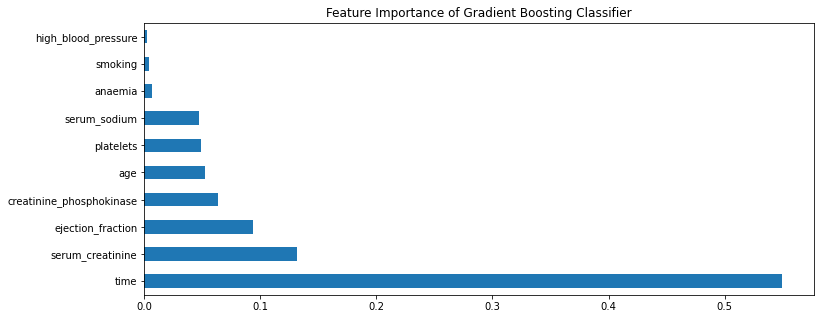

In [48]:
feature_imp = pd.Series(gclf.feature_importances_, index = list(df.columns)[:10])
fig = plt.figure(figsize=(12, 5))
plt.title("Feature Importance of Gradient Boosting Classifier")
feature_imp.nlargest(10).plot(kind = 'barh')

## Training Time Analysis for Gradient Boosting Classifier:
We will try training our Gradient Boosting Classifier using different number of samples and then plot the training time required against the number of samples used for training the model.

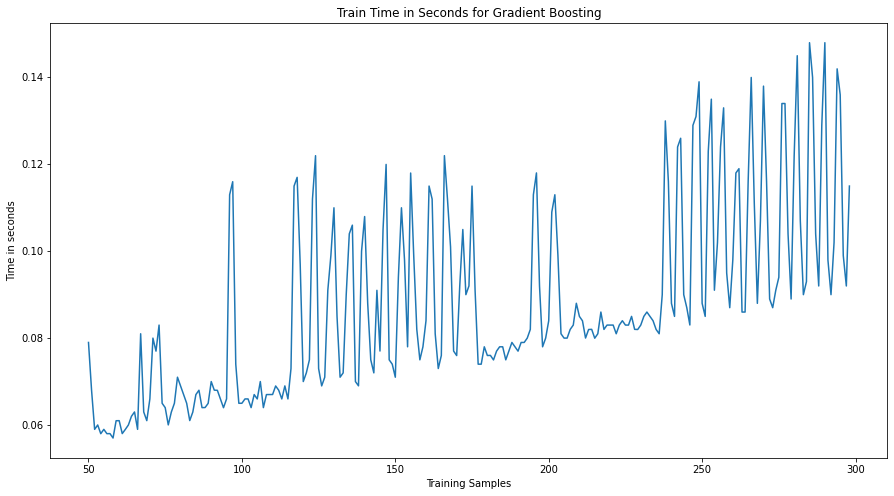

In [72]:
train_time(GradientBoostingClassifier(), X, Y, "Train Time in Seconds for Gradient Boosting")

## XGBoost Classifier:

XGBoost Classifier is very similar to GradientBoosting Classifier the only difference between the Gradient and Extreme Gradient Boosting is the Loss Function.
In XGBoost the Loss Function is a Double Derivative function where as in Gradient boosting a single derivative loss function is used.

We got pretty good result using the XGBoost too, it was found that the most important features according to the XGBoost were:
1. Time
2. Serum Ceratinine
3. Ejection Fraction

**Final Reults:**
  - Train Accuracy: 1.0
  - Test Accuracy:  0.9666666666666667
  - F1 score Test:  0.9523809523809523

In [49]:
from xgboost import XGBClassifier

xclf = XGBClassifier()
xclf.fit(x_train, y_train)
predict = xclf.predict(x_test)

print("Train Accuracy: ",xclf.score(x_train, y_train))
print("Test Accuracy: ", xclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

[18:15:04] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Train Accuracy:  1.0
Test Accuracy:  0.9666666666666667
F1 score Test:  0.9523809523809523


/Users/yashowardhanshinde/opt/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



### Feature Importance of XGBoost Classifier:

<AxesSubplot:title={'center':'Feature Importance of Extreme Gradient Boosting Classifier'}>

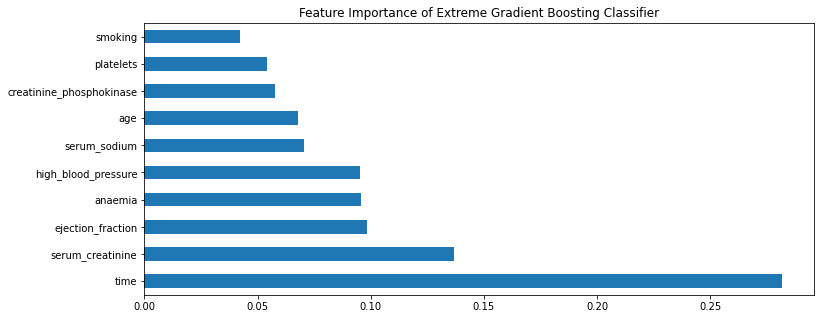

In [105]:
feature_imp = pd.Series(xclf.feature_importances_, index = list(df.columns)[:10])
fig = plt.figure(figsize=(12, 5))
plt.title("Feature Importance of Extreme Gradient Boosting Classifier")
feature_imp.nlargest(10).plot(kind = 'barh')

In [41]:
xclf.get_params().keys()

dict_keys(['objective', 'base_score', 'booster', 'colsample_bylevel', 'colsample_bynode', 'colsample_bytree', 'gamma', 'gpu_id', 'importance_type', 'interaction_constraints', 'learning_rate', 'max_delta_step', 'max_depth', 'min_child_weight', 'missing', 'monotone_constraints', 'n_estimators', 'n_jobs', 'num_parallel_tree', 'random_state', 'reg_alpha', 'reg_lambda', 'scale_pos_weight', 'subsample', 'tree_method', 'validate_parameters', 'verbosity'])

## Training Time Analysis for Extreme Gradient Boosting Classifier:
We will try training our Extreme Gradient Boosting Classifier using different number of samples and then plot the training time required against the number of samples used for training the model.

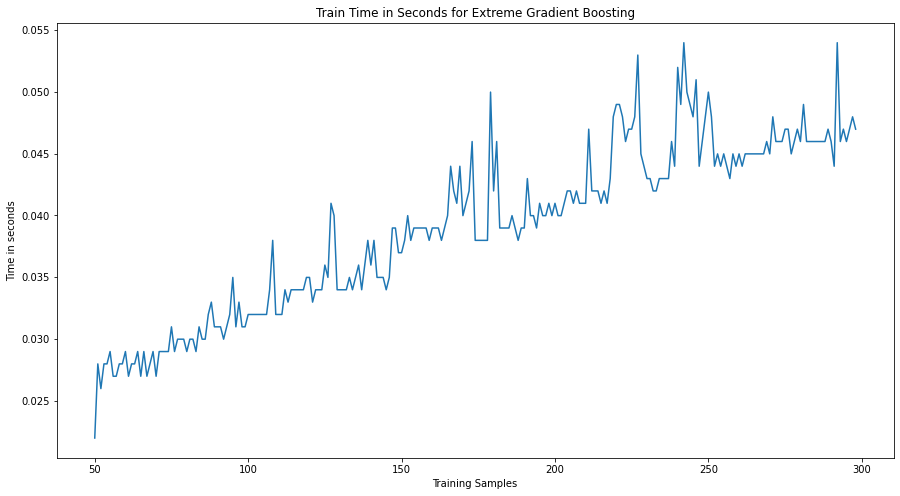

In [75]:
train_time(XGBClassifier(), X, Y, "Train Time in Seconds for Extreme Gradient Boosting")

## XGBRFClassifier:
It is similar to a Random Forest Classifier the only difference her ebeing that the Base Estimator is a XGBoost Classifier
instead of a Decision Tree.
So XGBRF is a Forest of XGBoost Classifiers.

We got a good result using XGBRFClassifier, it was found that the most important features according to the XGBRFClassifier 
were:
1. Time
2. Serum Ceratinine
3. Ejection Fraction

**Final Reults:**
  - Train Accuracy: 0.9442379182156134
  - Test Accuracy:  0.9333333333333333
  - F1 score Test:  0.9090909090909091


In [50]:
from xgboost import XGBRFClassifier

xrclf = XGBRFClassifier()
xrclf.fit(x_train, y_train)
predict = xrclf.predict(x_test)

print("Train Accuracy: ",xrclf.score(x_train, y_train))
print("Test Accuracy: ", xrclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

[18:15:15] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Train Accuracy:  0.9442379182156134
Test Accuracy:  0.9333333333333333
F1 score Test:  0.9090909090909091


/Users/yashowardhanshinde/opt/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



### Feature Importance of XGBRFClassifier:

<AxesSubplot:title={'center':'Feature Importance of Extreme Gradient Boosting Random Forest Classifier'}>

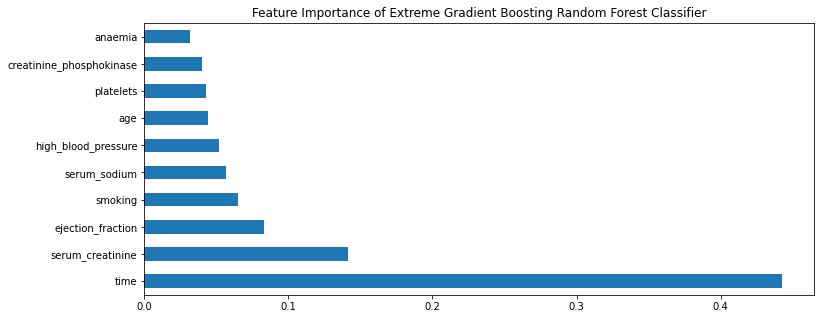

In [107]:
feature_imp = pd.Series(xrclf.feature_importances_, index = list(df.columns)[:10])
fig = plt.figure(figsize=(12, 5))
plt.title("Feature Importance of Extreme Gradient Boosting Random Forest Classifier")
feature_imp.nlargest(10).plot(kind = 'barh')

## Training Time Analysis for Extreme Gradient Boosting Random Forest Classifier:
We will try training our Extreme Gradient Boosting Random Forest Classifier using different number of samples and then plot the training time required against the number of samples used for training the model.

/Users/yashowardhanshinde/opt/anaconda3/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning:

The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].



[18:15:20] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:20] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:20] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

[18:15:20] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:20] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:20] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

[18:15:21] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:21] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:21] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

[18:15:22] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:22] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:22] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

[18:15:22] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:22] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:23] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

[18:15:23] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:23] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:23] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

[18:15:24] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:24] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:24] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

[18:15:25] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:25] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:25] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

[18:15:26] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:27] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[18:15:27] WARNING: /Users/yashowardhanshinde/xgboost/python-package/build/temp.macosx-10.9-x86_64-3.8/xgboost/src/learner.cc:1094: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restor

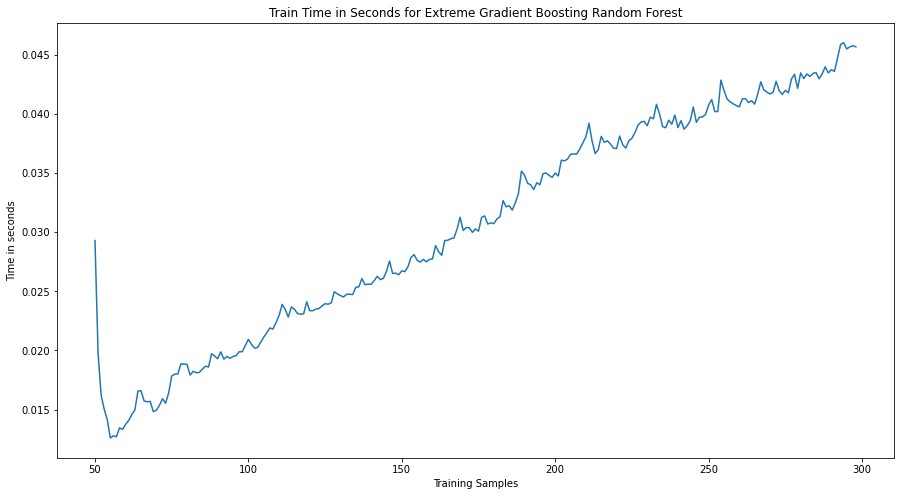

In [51]:
train_time(XGBRFClassifier(), X, Y, "Train Time in Seconds for Extreme Gradient Boosting Random Forest")

## Extra Trees Classifier:

Extra Trees Classifier is a type of ensemble learning technique which aggregates the results of multiple de-correlated 
decision trees collected in a “forest” to output it’s classification result. In concept, it is very similar to a Random Forest Classifier and only differs from it in the manner of construction of the decision trees in the forest.

Each Decision Tree in the Extra Trees Forest is constructed from the original training sample. Then, at each test node, 
Each tree is provided with a random sample of k features from the feature-set from which each decision tree must select the 
best feature to split the data based on some mathematical criteria (typically the Gini Index). 
This random sample of features leads to the creation of multiple de-correlated decision trees.

A satisfactory result was obtained using Extra Tree Classifier, it was also found that the most important features in Extra Tree Classifier were:
1. Time
2. Ejection Fraction
3. Serum Ceratinine

**Final Reults:**
  - Train Accuracy: 1.0
  - Test Accuracy:  0.9
  - F1 score Test:  0.8695652173913043

In [52]:
from sklearn.ensemble import ExtraTreesClassifier

eclf = ExtraTreesClassifier()
eclf.fit(x_train, y_train)
predict = eclf.predict(x_test)

print("Train Accuracy: ",eclf.score(x_train, y_train))
print("Test Accuracy: ", eclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9
F1 score Test:  0.8571428571428572


### Feature Importance of ExtraTree Classifier:

<AxesSubplot:title={'center':'Feature Importance of Extra Trees Classifier'}>

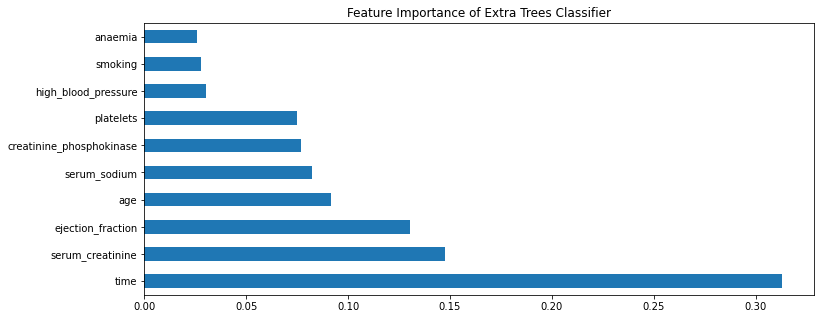

In [53]:
feature_imp = pd.Series(eclf.feature_importances_, index = list(df.columns)[:10])
fig = plt.figure(figsize=(12, 5))
plt.title("Feature Importance of Extra Trees Classifier")
feature_imp.nlargest(10).plot(kind = 'barh')

In [54]:
from sklearn.feature_selection import SelectFromModel

model = SelectFromModel(eclf, prefit = True)
X_new_train = model.transform(x_train)
X_new_test = model.transform(x_test)

In [55]:
eclf = ExtraTreesClassifier(n_estimators = 110, max_depth=14)
eclf.fit(X_new_train, y_train)
predict = eclf.predict(X_new_test)

print("Train Accuracy: ",eclf.score(X_new_train, y_train))
print("Test Accuracy: ", eclf.score(X_new_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  1.0
Test Accuracy:  0.9
F1 score Test:  0.8695652173913043


## Training Time Analysis for Extra Trees Classifier:
We will try training our Extra Trees Classifier using different number of samples and then plot the training time required against the number of samples used for training the model.

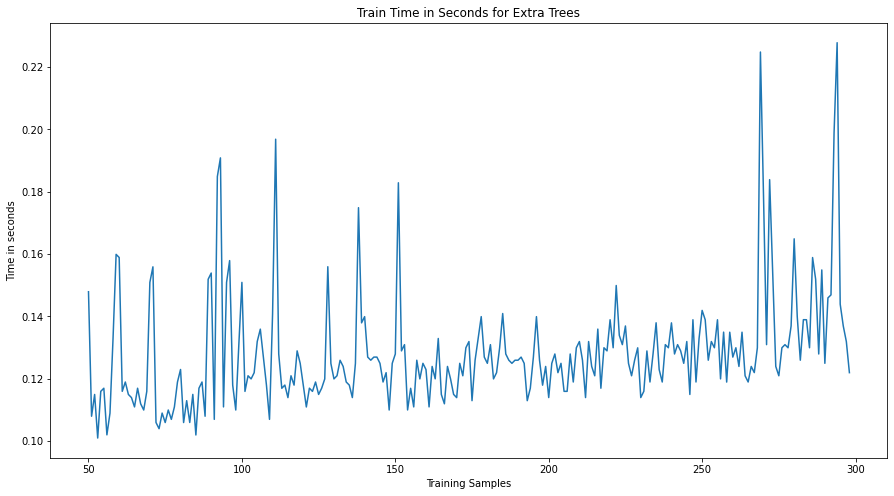

In [79]:
train_time(ExtraTreesClassifier(), X, Y, "Train Time in Seconds for Extra Trees")

## CatBoostClassifier

Advantages of CatBoost library are as follows:-

- **Performance:** CatBoost provides state of the art results and it is competitive with any leading machine learning algorithm on the performance front.

- **Handling Categorical features automatically:** We can use CatBoost without any explicit pre-processing to convert categories into numbers. CatBoost converts categorical values into numbers using various statistics on combinations of categorical features and combinations of categorical and numerical features.

- **Robust:** It reduces the need for extensive hyper-parameter tuning and lower the chances of overfitting also which leads to more generalized models. Although, CatBoost has multiple parameters to tune and it contains parameters like the number of trees, learning rate, regularization, tree depth, fold size, bagging temperature and others.

- **Easy-to-use:** We can use CatBoost from the command line, using an user-friendly API for both Python and R.

A good result was obtained using CatBoost Classifier, it was also found that the most important features in CatBoost Classifier were:

    1. Time
    2. Ejection Fraction
    3. Serum Ceratinine

**Final Reults:**

 - Train Accuracy: 1.0
 - Test Accuracy: 0.9333333333333333
 - F1 score Test: 0.9090909090909091

In [56]:
from catboost import CatBoostClassifier

catclf = CatBoostClassifier(learning_rate = 0.1,
                           depth = 7,
                           od_wait=200)
catclf.fit(x_train, y_train)
predict = catclf.predict(x_test)
print("Train Accuracy: ",catclf.score(x_train, y_train))
print("Test Accuracy: ", catclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

0:	learn: 0.6107492	total: 65ms	remaining: 1m 4s
1:	learn: 0.5537767	total: 66.1ms	remaining: 33s
2:	learn: 0.5026959	total: 67.1ms	remaining: 22.3s
3:	learn: 0.4645591	total: 68.1ms	remaining: 16.9s
4:	learn: 0.4267381	total: 69.1ms	remaining: 13.8s
5:	learn: 0.3874218	total: 70.1ms	remaining: 11.6s
6:	learn: 0.3612005	total: 70.9ms	remaining: 10.1s
7:	learn: 0.3422078	total: 71.8ms	remaining: 8.9s
8:	learn: 0.3214579	total: 72.7ms	remaining: 8s
9:	learn: 0.3048803	total: 73.7ms	remaining: 7.29s
10:	learn: 0.2877798	total: 74.5ms	remaining: 6.7s
11:	learn: 0.2734869	total: 75.4ms	remaining: 6.21s
12:	learn: 0.2608394	total: 76.2ms	remaining: 5.78s
13:	learn: 0.2500201	total: 77ms	remaining: 5.42s
14:	learn: 0.2451704	total: 77.8ms	remaining: 5.11s
15:	learn: 0.2365317	total: 78.6ms	remaining: 4.83s
16:	learn: 0.2252369	total: 79.5ms	remaining: 4.6s
17:	learn: 0.2206194	total: 80.4ms	remaining: 4.38s
18:	learn: 0.2120952	total: 81.2ms	remaining: 4.19s
19:	learn: 0.2053734	total: 82.1ms

211:	learn: 0.0091981	total: 253ms	remaining: 942ms
212:	learn: 0.0091730	total: 255ms	remaining: 941ms
213:	learn: 0.0090903	total: 256ms	remaining: 939ms
214:	learn: 0.0090384	total: 256ms	remaining: 936ms
215:	learn: 0.0089873	total: 257ms	remaining: 934ms
216:	learn: 0.0089410	total: 258ms	remaining: 932ms
217:	learn: 0.0088850	total: 259ms	remaining: 930ms
218:	learn: 0.0088353	total: 260ms	remaining: 927ms
219:	learn: 0.0087933	total: 261ms	remaining: 925ms
220:	learn: 0.0087385	total: 262ms	remaining: 922ms
221:	learn: 0.0086819	total: 262ms	remaining: 919ms
222:	learn: 0.0086337	total: 263ms	remaining: 917ms
223:	learn: 0.0085557	total: 264ms	remaining: 915ms
224:	learn: 0.0085030	total: 265ms	remaining: 913ms
225:	learn: 0.0084546	total: 266ms	remaining: 911ms
226:	learn: 0.0084138	total: 267ms	remaining: 910ms
227:	learn: 0.0083656	total: 268ms	remaining: 908ms
228:	learn: 0.0083077	total: 269ms	remaining: 906ms
229:	learn: 0.0082530	total: 270ms	remaining: 904ms
230:	learn: 

409:	learn: 0.0039115	total: 441ms	remaining: 634ms
410:	learn: 0.0039014	total: 442ms	remaining: 633ms
411:	learn: 0.0038882	total: 442ms	remaining: 632ms
412:	learn: 0.0038761	total: 443ms	remaining: 630ms
413:	learn: 0.0038634	total: 444ms	remaining: 629ms
414:	learn: 0.0038472	total: 445ms	remaining: 628ms
415:	learn: 0.0038351	total: 446ms	remaining: 626ms
416:	learn: 0.0038246	total: 447ms	remaining: 625ms
417:	learn: 0.0038146	total: 448ms	remaining: 624ms
418:	learn: 0.0038007	total: 449ms	remaining: 623ms
419:	learn: 0.0037831	total: 450ms	remaining: 622ms
420:	learn: 0.0037738	total: 451ms	remaining: 621ms
421:	learn: 0.0037632	total: 453ms	remaining: 620ms
422:	learn: 0.0037537	total: 454ms	remaining: 619ms
423:	learn: 0.0037439	total: 455ms	remaining: 618ms
424:	learn: 0.0037340	total: 455ms	remaining: 616ms
425:	learn: 0.0037246	total: 456ms	remaining: 615ms
426:	learn: 0.0037152	total: 457ms	remaining: 614ms
427:	learn: 0.0037030	total: 459ms	remaining: 613ms
428:	learn: 

612:	learn: 0.0023765	total: 629ms	remaining: 397ms
613:	learn: 0.0023736	total: 630ms	remaining: 396ms
614:	learn: 0.0023684	total: 631ms	remaining: 395ms
615:	learn: 0.0023646	total: 632ms	remaining: 394ms
616:	learn: 0.0023587	total: 633ms	remaining: 393ms
617:	learn: 0.0023520	total: 634ms	remaining: 392ms
618:	learn: 0.0023486	total: 635ms	remaining: 391ms
619:	learn: 0.0023432	total: 636ms	remaining: 390ms
620:	learn: 0.0023389	total: 637ms	remaining: 389ms
621:	learn: 0.0023324	total: 638ms	remaining: 388ms
622:	learn: 0.0023280	total: 639ms	remaining: 386ms
623:	learn: 0.0023238	total: 640ms	remaining: 385ms
624:	learn: 0.0023178	total: 640ms	remaining: 384ms
625:	learn: 0.0023142	total: 641ms	remaining: 383ms
626:	learn: 0.0023102	total: 643ms	remaining: 382ms
627:	learn: 0.0023065	total: 644ms	remaining: 381ms
628:	learn: 0.0023019	total: 645ms	remaining: 380ms
629:	learn: 0.0022957	total: 646ms	remaining: 379ms
630:	learn: 0.0022912	total: 647ms	remaining: 378ms
631:	learn: 

811:	learn: 0.0017809	total: 817ms	remaining: 189ms
812:	learn: 0.0017794	total: 818ms	remaining: 188ms
813:	learn: 0.0017769	total: 819ms	remaining: 187ms
814:	learn: 0.0017733	total: 820ms	remaining: 186ms
815:	learn: 0.0017699	total: 821ms	remaining: 185ms
816:	learn: 0.0017684	total: 822ms	remaining: 184ms
817:	learn: 0.0017660	total: 823ms	remaining: 183ms
818:	learn: 0.0017637	total: 824ms	remaining: 182ms
819:	learn: 0.0017637	total: 825ms	remaining: 181ms
820:	learn: 0.0017606	total: 826ms	remaining: 180ms
821:	learn: 0.0017583	total: 826ms	remaining: 179ms
822:	learn: 0.0017560	total: 828ms	remaining: 178ms
823:	learn: 0.0017526	total: 829ms	remaining: 177ms
824:	learn: 0.0017526	total: 829ms	remaining: 176ms
825:	learn: 0.0017497	total: 830ms	remaining: 175ms
826:	learn: 0.0017464	total: 831ms	remaining: 174ms
827:	learn: 0.0017438	total: 832ms	remaining: 173ms
828:	learn: 0.0017417	total: 833ms	remaining: 172ms
829:	learn: 0.0017394	total: 834ms	remaining: 171ms
830:	learn: 

Train Accuracy:  1.0
Test Accuracy:  0.9333333333333333
F1 score Test:  0.9090909090909091


<AxesSubplot:title={'center':'Feature Importance of CatBoost Classifier'}>

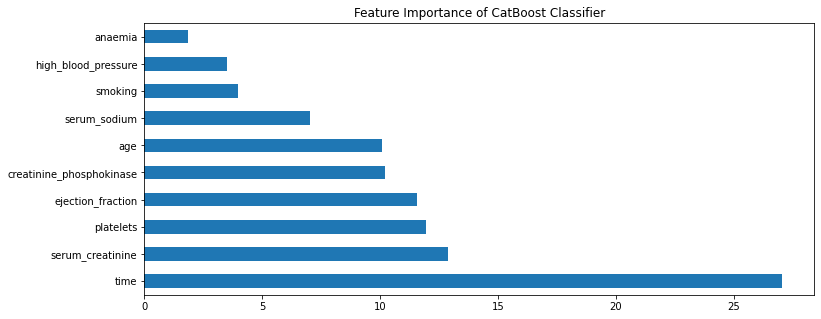

In [57]:
feature_imp = pd.Series(catclf.feature_importances_, index = list(df.columns)[:10])
fig = plt.figure(figsize=(12, 5))
plt.title("Feature Importance of CatBoost Classifier")
feature_imp.nlargest(10).plot(kind = 'barh')

## Training Time Analysis for CatBoost Classifier:
We will try training our CatBoost using different number of samples and then plot the training time required against the number of samples used for training the model.

Learning rate set to 0.002867
0:	learn: 0.6909595	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6883442	total: 2.32ms	remaining: 1.16s
2:	learn: 0.6861037	total: 3.28ms	remaining: 1.09s
3:	learn: 0.6839837	total: 4.25ms	remaining: 1.06s
4:	learn: 0.6819919	total: 5.29ms	remaining: 1.05s
5:	learn: 0.6799145	total: 6.26ms	remaining: 1.04s
6:	learn: 0.6780707	total: 7.21ms	remaining: 1.02s
7:	learn: 0.6762585	total: 8.37ms	remaining: 1.04s
8:	learn: 0.6740131	total: 9.4ms	remaining: 1.03s
9:	learn: 0.6715673	total: 10.4ms	remaining: 1.03s
10:	learn: 0.6695773	total: 11ms	remaining: 986ms
11:	learn: 0.6676226	total: 11.9ms	remaining: 984ms
12:	learn: 0.6654751	total: 12.9ms	remaining: 979ms
13:	learn: 0.6635152	total: 13.9ms	remaining: 976ms
14:	learn: 0.6614795	total: 14.9ms	remaining: 977ms
15:	learn: 0.6595622	total: 15.9ms	remaining: 975ms
16:	learn: 0.6568670	total: 16.6ms	remaining: 959ms
17:	learn: 0.6546807	total: 17.6ms	remaining: 959ms
18:	learn: 0.6526218	total: 18.5ms	remaining: 9

275:	learn: 0.3364148	total: 179ms	remaining: 468ms
276:	learn: 0.3358127	total: 180ms	remaining: 469ms
277:	learn: 0.3349655	total: 180ms	remaining: 468ms
278:	learn: 0.3344316	total: 180ms	remaining: 466ms
279:	learn: 0.3336649	total: 181ms	remaining: 466ms
280:	learn: 0.3328957	total: 182ms	remaining: 465ms
281:	learn: 0.3320392	total: 182ms	remaining: 464ms
282:	learn: 0.3312363	total: 183ms	remaining: 464ms
283:	learn: 0.3307091	total: 183ms	remaining: 463ms
284:	learn: 0.3298341	total: 184ms	remaining: 462ms
285:	learn: 0.3293578	total: 184ms	remaining: 460ms
286:	learn: 0.3285220	total: 185ms	remaining: 460ms
287:	learn: 0.3277609	total: 186ms	remaining: 459ms
288:	learn: 0.3272025	total: 186ms	remaining: 458ms
289:	learn: 0.3264087	total: 187ms	remaining: 457ms
290:	learn: 0.3257180	total: 187ms	remaining: 456ms
291:	learn: 0.3249893	total: 188ms	remaining: 455ms
292:	learn: 0.3243297	total: 188ms	remaining: 455ms
293:	learn: 0.3235095	total: 189ms	remaining: 454ms
294:	learn: 

459:	learn: 0.2356257	total: 325ms	remaining: 382ms
460:	learn: 0.2351916	total: 326ms	remaining: 381ms
461:	learn: 0.2347581	total: 327ms	remaining: 380ms
462:	learn: 0.2341764	total: 327ms	remaining: 380ms
463:	learn: 0.2337210	total: 328ms	remaining: 379ms
464:	learn: 0.2333381	total: 328ms	remaining: 378ms
465:	learn: 0.2329907	total: 329ms	remaining: 377ms
466:	learn: 0.2326873	total: 330ms	remaining: 376ms
467:	learn: 0.2322364	total: 330ms	remaining: 375ms
468:	learn: 0.2318862	total: 331ms	remaining: 375ms
469:	learn: 0.2316032	total: 331ms	remaining: 374ms
470:	learn: 0.2313289	total: 332ms	remaining: 373ms
471:	learn: 0.2310443	total: 332ms	remaining: 372ms
472:	learn: 0.2306422	total: 333ms	remaining: 371ms
473:	learn: 0.2302037	total: 334ms	remaining: 370ms
474:	learn: 0.2297853	total: 334ms	remaining: 369ms
475:	learn: 0.2292925	total: 335ms	remaining: 368ms
476:	learn: 0.2290651	total: 335ms	remaining: 368ms
477:	learn: 0.2284982	total: 336ms	remaining: 367ms
478:	learn: 

738:	learn: 0.1525507	total: 490ms	remaining: 173ms
739:	learn: 0.1522907	total: 491ms	remaining: 172ms
740:	learn: 0.1521607	total: 491ms	remaining: 172ms
741:	learn: 0.1519551	total: 492ms	remaining: 171ms
742:	learn: 0.1518057	total: 492ms	remaining: 170ms
743:	learn: 0.1515780	total: 493ms	remaining: 170ms
744:	learn: 0.1514338	total: 494ms	remaining: 169ms
745:	learn: 0.1512296	total: 494ms	remaining: 168ms
746:	learn: 0.1511009	total: 495ms	remaining: 168ms
747:	learn: 0.1508491	total: 495ms	remaining: 167ms
748:	learn: 0.1507120	total: 496ms	remaining: 166ms
749:	learn: 0.1504050	total: 496ms	remaining: 165ms
750:	learn: 0.1501873	total: 497ms	remaining: 165ms
751:	learn: 0.1499233	total: 497ms	remaining: 164ms
752:	learn: 0.1497120	total: 498ms	remaining: 163ms
753:	learn: 0.1495628	total: 499ms	remaining: 163ms
754:	learn: 0.1493662	total: 499ms	remaining: 162ms
755:	learn: 0.1491163	total: 500ms	remaining: 161ms
756:	learn: 0.1489239	total: 500ms	remaining: 161ms
757:	learn: 

22:	learn: 0.6433694	total: 12.6ms	remaining: 537ms
23:	learn: 0.6416333	total: 13.4ms	remaining: 543ms
24:	learn: 0.6399508	total: 13.8ms	remaining: 539ms
25:	learn: 0.6380703	total: 14.3ms	remaining: 536ms
26:	learn: 0.6357737	total: 14.6ms	remaining: 526ms
27:	learn: 0.6337444	total: 15.1ms	remaining: 525ms
28:	learn: 0.6316404	total: 15.5ms	remaining: 519ms
29:	learn: 0.6298183	total: 16.5ms	remaining: 534ms
30:	learn: 0.6274056	total: 17.1ms	remaining: 534ms
31:	learn: 0.6255172	total: 17.7ms	remaining: 535ms
32:	learn: 0.6236974	total: 18.1ms	remaining: 531ms
33:	learn: 0.6220976	total: 18.8ms	remaining: 533ms
34:	learn: 0.6203507	total: 19.4ms	remaining: 534ms
35:	learn: 0.6186242	total: 20ms	remaining: 536ms
36:	learn: 0.6168660	total: 20.6ms	remaining: 537ms
37:	learn: 0.6144428	total: 21.1ms	remaining: 533ms
38:	learn: 0.6122346	total: 21.4ms	remaining: 529ms
39:	learn: 0.6104892	total: 21.9ms	remaining: 526ms
40:	learn: 0.6085143	total: 22.7ms	remaining: 531ms
41:	learn: 0.6

327:	learn: 0.2990396	total: 194ms	remaining: 398ms
328:	learn: 0.2985175	total: 195ms	remaining: 398ms
329:	learn: 0.2976667	total: 196ms	remaining: 397ms
330:	learn: 0.2970228	total: 196ms	remaining: 396ms
331:	learn: 0.2966165	total: 197ms	remaining: 396ms
332:	learn: 0.2961372	total: 197ms	remaining: 395ms
333:	learn: 0.2954544	total: 198ms	remaining: 394ms
334:	learn: 0.2949079	total: 198ms	remaining: 393ms
335:	learn: 0.2944056	total: 199ms	remaining: 393ms
336:	learn: 0.2939333	total: 199ms	remaining: 392ms
337:	learn: 0.2933518	total: 200ms	remaining: 392ms
338:	learn: 0.2929761	total: 201ms	remaining: 391ms
339:	learn: 0.2922531	total: 201ms	remaining: 390ms
340:	learn: 0.2914781	total: 202ms	remaining: 390ms
341:	learn: 0.2909628	total: 203ms	remaining: 390ms
342:	learn: 0.2902261	total: 203ms	remaining: 389ms
343:	learn: 0.2897344	total: 204ms	remaining: 389ms
344:	learn: 0.2891335	total: 204ms	remaining: 388ms
345:	learn: 0.2884532	total: 205ms	remaining: 387ms
346:	learn: 

618:	learn: 0.1784762	total: 374ms	remaining: 230ms
619:	learn: 0.1781489	total: 375ms	remaining: 230ms
620:	learn: 0.1779655	total: 375ms	remaining: 229ms
621:	learn: 0.1776390	total: 376ms	remaining: 228ms
622:	learn: 0.1773400	total: 377ms	remaining: 228ms
623:	learn: 0.1770425	total: 377ms	remaining: 227ms
624:	learn: 0.1768550	total: 378ms	remaining: 227ms
625:	learn: 0.1765197	total: 378ms	remaining: 226ms
626:	learn: 0.1762289	total: 379ms	remaining: 225ms
627:	learn: 0.1759713	total: 379ms	remaining: 225ms
628:	learn: 0.1756199	total: 380ms	remaining: 224ms
629:	learn: 0.1754501	total: 380ms	remaining: 223ms
630:	learn: 0.1751206	total: 381ms	remaining: 223ms
631:	learn: 0.1747790	total: 382ms	remaining: 222ms
632:	learn: 0.1745238	total: 382ms	remaining: 222ms
633:	learn: 0.1743118	total: 383ms	remaining: 221ms
634:	learn: 0.1739429	total: 383ms	remaining: 220ms
635:	learn: 0.1736419	total: 384ms	remaining: 220ms
636:	learn: 0.1734062	total: 384ms	remaining: 219ms
637:	learn: 

930:	learn: 0.1147032	total: 556ms	remaining: 41.2ms
931:	learn: 0.1145370	total: 557ms	remaining: 40.6ms
932:	learn: 0.1144442	total: 557ms	remaining: 40ms
933:	learn: 0.1142579	total: 558ms	remaining: 39.4ms
934:	learn: 0.1141037	total: 559ms	remaining: 38.9ms
935:	learn: 0.1140002	total: 559ms	remaining: 38.2ms
936:	learn: 0.1138524	total: 560ms	remaining: 37.7ms
937:	learn: 0.1137051	total: 561ms	remaining: 37.1ms
938:	learn: 0.1135823	total: 561ms	remaining: 36.5ms
939:	learn: 0.1134223	total: 562ms	remaining: 35.9ms
940:	learn: 0.1133101	total: 562ms	remaining: 35.3ms
941:	learn: 0.1131687	total: 563ms	remaining: 34.6ms
942:	learn: 0.1130427	total: 563ms	remaining: 34ms
943:	learn: 0.1129318	total: 564ms	remaining: 33.4ms
944:	learn: 0.1127732	total: 564ms	remaining: 32.8ms
945:	learn: 0.1125860	total: 565ms	remaining: 32.2ms
946:	learn: 0.1124736	total: 565ms	remaining: 31.6ms
947:	learn: 0.1123541	total: 566ms	remaining: 31ms
948:	learn: 0.1122422	total: 567ms	remaining: 30.4ms

222:	learn: 0.3723335	total: 127ms	remaining: 443ms
223:	learn: 0.3714524	total: 128ms	remaining: 443ms
224:	learn: 0.3706512	total: 128ms	remaining: 442ms
225:	learn: 0.3698692	total: 129ms	remaining: 441ms
226:	learn: 0.3689468	total: 129ms	remaining: 441ms
227:	learn: 0.3682287	total: 130ms	remaining: 441ms
228:	learn: 0.3673999	total: 131ms	remaining: 441ms
229:	learn: 0.3667074	total: 131ms	remaining: 440ms
230:	learn: 0.3659610	total: 132ms	remaining: 439ms
231:	learn: 0.3651700	total: 132ms	remaining: 438ms
232:	learn: 0.3642723	total: 133ms	remaining: 437ms
233:	learn: 0.3633907	total: 133ms	remaining: 437ms
234:	learn: 0.3619333	total: 134ms	remaining: 436ms
235:	learn: 0.3610724	total: 134ms	remaining: 435ms
236:	learn: 0.3600813	total: 135ms	remaining: 434ms
237:	learn: 0.3594499	total: 135ms	remaining: 434ms
238:	learn: 0.3586451	total: 136ms	remaining: 433ms
239:	learn: 0.3577274	total: 137ms	remaining: 433ms
240:	learn: 0.3568811	total: 137ms	remaining: 432ms
241:	learn: 

536:	learn: 0.2026363	total: 310ms	remaining: 267ms
537:	learn: 0.2023480	total: 311ms	remaining: 267ms
538:	learn: 0.2020977	total: 311ms	remaining: 266ms
539:	learn: 0.2017672	total: 312ms	remaining: 266ms
540:	learn: 0.2014560	total: 312ms	remaining: 265ms
541:	learn: 0.2011324	total: 313ms	remaining: 265ms
542:	learn: 0.2008212	total: 314ms	remaining: 265ms
543:	learn: 0.2005139	total: 315ms	remaining: 264ms
544:	learn: 0.2002190	total: 316ms	remaining: 264ms
545:	learn: 0.1999925	total: 316ms	remaining: 263ms
546:	learn: 0.1996426	total: 317ms	remaining: 263ms
547:	learn: 0.1993766	total: 318ms	remaining: 262ms
548:	learn: 0.1989655	total: 318ms	remaining: 262ms
549:	learn: 0.1986421	total: 319ms	remaining: 261ms
550:	learn: 0.1983423	total: 320ms	remaining: 260ms
551:	learn: 0.1980218	total: 320ms	remaining: 260ms
552:	learn: 0.1976994	total: 321ms	remaining: 260ms
553:	learn: 0.1973118	total: 322ms	remaining: 259ms
554:	learn: 0.1970699	total: 322ms	remaining: 258ms
555:	learn: 

836:	learn: 0.1295691	total: 492ms	remaining: 95.8ms
837:	learn: 0.1294685	total: 492ms	remaining: 95.2ms
838:	learn: 0.1292824	total: 493ms	remaining: 94.6ms
839:	learn: 0.1291063	total: 493ms	remaining: 94ms
840:	learn: 0.1289538	total: 494ms	remaining: 93.4ms
841:	learn: 0.1288005	total: 495ms	remaining: 92.8ms
842:	learn: 0.1286182	total: 495ms	remaining: 92.2ms
843:	learn: 0.1283881	total: 496ms	remaining: 91.6ms
844:	learn: 0.1282249	total: 496ms	remaining: 91ms
845:	learn: 0.1279403	total: 497ms	remaining: 90.4ms
846:	learn: 0.1277421	total: 497ms	remaining: 89.9ms
847:	learn: 0.1275732	total: 498ms	remaining: 89.3ms
848:	learn: 0.1273501	total: 498ms	remaining: 88.6ms
849:	learn: 0.1271931	total: 499ms	remaining: 88ms
850:	learn: 0.1270593	total: 499ms	remaining: 87.5ms
851:	learn: 0.1268845	total: 500ms	remaining: 86.8ms
852:	learn: 0.1267452	total: 500ms	remaining: 86.2ms
853:	learn: 0.1265575	total: 501ms	remaining: 85.6ms
854:	learn: 0.1263722	total: 502ms	remaining: 85.1ms

134:	learn: 0.4616286	total: 75.7ms	remaining: 485ms
135:	learn: 0.4602334	total: 76.4ms	remaining: 486ms
136:	learn: 0.4583811	total: 77.1ms	remaining: 486ms
137:	learn: 0.4569128	total: 77.8ms	remaining: 486ms
138:	learn: 0.4560037	total: 78.2ms	remaining: 485ms
139:	learn: 0.4547942	total: 78.7ms	remaining: 484ms
140:	learn: 0.4534612	total: 79.2ms	remaining: 482ms
141:	learn: 0.4524116	total: 79.8ms	remaining: 482ms
142:	learn: 0.4509005	total: 80.4ms	remaining: 482ms
143:	learn: 0.4498980	total: 81ms	remaining: 481ms
144:	learn: 0.4489013	total: 81.5ms	remaining: 481ms
145:	learn: 0.4478722	total: 82ms	remaining: 479ms
146:	learn: 0.4468502	total: 82.5ms	remaining: 479ms
147:	learn: 0.4454610	total: 83.2ms	remaining: 479ms
148:	learn: 0.4443910	total: 84.3ms	remaining: 481ms
149:	learn: 0.4432347	total: 84.9ms	remaining: 481ms
150:	learn: 0.4421121	total: 85.7ms	remaining: 482ms
151:	learn: 0.4410530	total: 86.6ms	remaining: 483ms
152:	learn: 0.4401459	total: 87.1ms	remaining: 482

439:	learn: 0.2396696	total: 258ms	remaining: 328ms
440:	learn: 0.2394378	total: 258ms	remaining: 328ms
441:	learn: 0.2390392	total: 259ms	remaining: 327ms
442:	learn: 0.2385496	total: 260ms	remaining: 326ms
443:	learn: 0.2381793	total: 260ms	remaining: 326ms
444:	learn: 0.2375520	total: 261ms	remaining: 325ms
445:	learn: 0.2372150	total: 262ms	remaining: 325ms
446:	learn: 0.2367882	total: 262ms	remaining: 324ms
447:	learn: 0.2364251	total: 263ms	remaining: 324ms
448:	learn: 0.2359334	total: 263ms	remaining: 323ms
449:	learn: 0.2354195	total: 264ms	remaining: 323ms
450:	learn: 0.2349875	total: 265ms	remaining: 322ms
451:	learn: 0.2345646	total: 265ms	remaining: 322ms
452:	learn: 0.2341744	total: 266ms	remaining: 321ms
453:	learn: 0.2339281	total: 267ms	remaining: 321ms
454:	learn: 0.2334877	total: 267ms	remaining: 320ms
455:	learn: 0.2330700	total: 268ms	remaining: 319ms
456:	learn: 0.2327709	total: 268ms	remaining: 319ms
457:	learn: 0.2325135	total: 269ms	remaining: 318ms
458:	learn: 

735:	learn: 0.1500326	total: 439ms	remaining: 158ms
736:	learn: 0.1497683	total: 440ms	remaining: 157ms
737:	learn: 0.1495800	total: 441ms	remaining: 156ms
738:	learn: 0.1492813	total: 441ms	remaining: 156ms
739:	learn: 0.1491533	total: 442ms	remaining: 155ms
740:	learn: 0.1488775	total: 443ms	remaining: 155ms
741:	learn: 0.1486116	total: 443ms	remaining: 154ms
742:	learn: 0.1484417	total: 444ms	remaining: 153ms
743:	learn: 0.1482067	total: 444ms	remaining: 153ms
744:	learn: 0.1480714	total: 445ms	remaining: 152ms
745:	learn: 0.1478972	total: 445ms	remaining: 152ms
746:	learn: 0.1476369	total: 446ms	remaining: 151ms
747:	learn: 0.1473894	total: 447ms	remaining: 150ms
748:	learn: 0.1471054	total: 447ms	remaining: 150ms
749:	learn: 0.1469038	total: 448ms	remaining: 149ms
750:	learn: 0.1466015	total: 448ms	remaining: 149ms
751:	learn: 0.1463881	total: 449ms	remaining: 148ms
752:	learn: 0.1461152	total: 450ms	remaining: 148ms
753:	learn: 0.1458935	total: 450ms	remaining: 147ms
754:	learn: 

24:	learn: 0.6363940	total: 12.9ms	remaining: 502ms
25:	learn: 0.6341918	total: 13.6ms	remaining: 509ms
26:	learn: 0.6322341	total: 14.2ms	remaining: 512ms
27:	learn: 0.6297903	total: 14.8ms	remaining: 514ms
28:	learn: 0.6277881	total: 15.4ms	remaining: 516ms
29:	learn: 0.6259591	total: 16ms	remaining: 517ms
30:	learn: 0.6238711	total: 16.7ms	remaining: 523ms
31:	learn: 0.6223580	total: 17.8ms	remaining: 539ms
32:	learn: 0.6202566	total: 18.3ms	remaining: 536ms
33:	learn: 0.6183866	total: 19ms	remaining: 540ms
34:	learn: 0.6161362	total: 19.6ms	remaining: 540ms
35:	learn: 0.6139476	total: 20.2ms	remaining: 540ms
36:	learn: 0.6117739	total: 20.9ms	remaining: 545ms
37:	learn: 0.6100213	total: 21.5ms	remaining: 544ms
38:	learn: 0.6081766	total: 22.2ms	remaining: 547ms
39:	learn: 0.6066010	total: 22.9ms	remaining: 550ms
40:	learn: 0.6045446	total: 23.4ms	remaining: 548ms
41:	learn: 0.6021496	total: 24.1ms	remaining: 549ms
42:	learn: 0.6001813	total: 24.6ms	remaining: 547ms
43:	learn: 0.598

324:	learn: 0.2958083	total: 194ms	remaining: 402ms
325:	learn: 0.2952283	total: 194ms	remaining: 402ms
326:	learn: 0.2946535	total: 195ms	remaining: 401ms
327:	learn: 0.2939469	total: 195ms	remaining: 400ms
328:	learn: 0.2934028	total: 196ms	remaining: 399ms
329:	learn: 0.2927631	total: 196ms	remaining: 399ms
330:	learn: 0.2922602	total: 197ms	remaining: 398ms
331:	learn: 0.2917370	total: 197ms	remaining: 397ms
332:	learn: 0.2910506	total: 198ms	remaining: 397ms
333:	learn: 0.2904760	total: 199ms	remaining: 396ms
334:	learn: 0.2901078	total: 199ms	remaining: 396ms
335:	learn: 0.2897001	total: 200ms	remaining: 395ms
336:	learn: 0.2892859	total: 201ms	remaining: 395ms
337:	learn: 0.2888166	total: 201ms	remaining: 394ms
338:	learn: 0.2883089	total: 202ms	remaining: 394ms
339:	learn: 0.2876463	total: 203ms	remaining: 393ms
340:	learn: 0.2872141	total: 203ms	remaining: 393ms
341:	learn: 0.2865525	total: 204ms	remaining: 392ms
342:	learn: 0.2860260	total: 204ms	remaining: 391ms
343:	learn: 

633:	learn: 0.1748742	total: 376ms	remaining: 217ms
634:	learn: 0.1746520	total: 376ms	remaining: 216ms
635:	learn: 0.1743425	total: 377ms	remaining: 216ms
636:	learn: 0.1741654	total: 377ms	remaining: 215ms
637:	learn: 0.1738404	total: 378ms	remaining: 214ms
638:	learn: 0.1736004	total: 378ms	remaining: 214ms
639:	learn: 0.1732136	total: 379ms	remaining: 213ms
640:	learn: 0.1729318	total: 380ms	remaining: 213ms
641:	learn: 0.1726593	total: 380ms	remaining: 212ms
642:	learn: 0.1724620	total: 381ms	remaining: 212ms
643:	learn: 0.1722473	total: 381ms	remaining: 211ms
644:	learn: 0.1719508	total: 382ms	remaining: 210ms
645:	learn: 0.1716646	total: 383ms	remaining: 210ms
646:	learn: 0.1713926	total: 383ms	remaining: 209ms
647:	learn: 0.1710872	total: 384ms	remaining: 209ms
648:	learn: 0.1709053	total: 385ms	remaining: 208ms
649:	learn: 0.1706474	total: 385ms	remaining: 208ms
650:	learn: 0.1704468	total: 386ms	remaining: 207ms
651:	learn: 0.1701886	total: 387ms	remaining: 206ms
652:	learn: 

936:	learn: 0.1148074	total: 558ms	remaining: 37.5ms
937:	learn: 0.1146746	total: 558ms	remaining: 36.9ms
938:	learn: 0.1145333	total: 559ms	remaining: 36.3ms
939:	learn: 0.1143818	total: 559ms	remaining: 35.7ms
940:	learn: 0.1143199	total: 560ms	remaining: 35.1ms
941:	learn: 0.1141346	total: 561ms	remaining: 34.5ms
942:	learn: 0.1140391	total: 561ms	remaining: 33.9ms
943:	learn: 0.1139262	total: 562ms	remaining: 33.3ms
944:	learn: 0.1138096	total: 563ms	remaining: 32.7ms
945:	learn: 0.1137393	total: 563ms	remaining: 32.1ms
946:	learn: 0.1136051	total: 564ms	remaining: 31.5ms
947:	learn: 0.1134865	total: 564ms	remaining: 31ms
948:	learn: 0.1133857	total: 565ms	remaining: 30.4ms
949:	learn: 0.1132561	total: 566ms	remaining: 29.8ms
950:	learn: 0.1131517	total: 566ms	remaining: 29.2ms
951:	learn: 0.1129989	total: 567ms	remaining: 28.6ms
952:	learn: 0.1129201	total: 567ms	remaining: 28ms
953:	learn: 0.1127861	total: 568ms	remaining: 27.4ms
954:	learn: 0.1126356	total: 568ms	remaining: 26.8

195:	learn: 0.3929726	total: 116ms	remaining: 475ms
196:	learn: 0.3923081	total: 117ms	remaining: 475ms
197:	learn: 0.3913625	total: 117ms	remaining: 474ms
198:	learn: 0.3904484	total: 118ms	remaining: 474ms
199:	learn: 0.3891994	total: 118ms	remaining: 473ms
200:	learn: 0.3885716	total: 119ms	remaining: 472ms
201:	learn: 0.3875465	total: 119ms	remaining: 471ms
202:	learn: 0.3864474	total: 120ms	remaining: 470ms
203:	learn: 0.3854791	total: 120ms	remaining: 469ms
204:	learn: 0.3844430	total: 121ms	remaining: 468ms
205:	learn: 0.3836730	total: 121ms	remaining: 468ms
206:	learn: 0.3828539	total: 122ms	remaining: 467ms
207:	learn: 0.3819722	total: 122ms	remaining: 466ms
208:	learn: 0.3813448	total: 123ms	remaining: 464ms
209:	learn: 0.3805843	total: 123ms	remaining: 463ms
210:	learn: 0.3797492	total: 124ms	remaining: 462ms
211:	learn: 0.3786904	total: 124ms	remaining: 462ms
212:	learn: 0.3774929	total: 125ms	remaining: 461ms
213:	learn: 0.3766252	total: 125ms	remaining: 460ms
214:	learn: 

500:	learn: 0.2119118	total: 297ms	remaining: 296ms
501:	learn: 0.2116484	total: 298ms	remaining: 295ms
502:	learn: 0.2113313	total: 298ms	remaining: 295ms
503:	learn: 0.2109718	total: 299ms	remaining: 294ms
504:	learn: 0.2106027	total: 299ms	remaining: 293ms
505:	learn: 0.2103204	total: 300ms	remaining: 293ms
506:	learn: 0.2099864	total: 300ms	remaining: 292ms
507:	learn: 0.2095651	total: 301ms	remaining: 291ms
508:	learn: 0.2091794	total: 301ms	remaining: 291ms
509:	learn: 0.2088702	total: 302ms	remaining: 290ms
510:	learn: 0.2084079	total: 302ms	remaining: 289ms
511:	learn: 0.2079212	total: 303ms	remaining: 289ms
512:	learn: 0.2077238	total: 304ms	remaining: 288ms
513:	learn: 0.2073914	total: 304ms	remaining: 288ms
514:	learn: 0.2069787	total: 305ms	remaining: 287ms
515:	learn: 0.2065670	total: 306ms	remaining: 287ms
516:	learn: 0.2062631	total: 307ms	remaining: 286ms
517:	learn: 0.2058536	total: 307ms	remaining: 286ms
518:	learn: 0.2055508	total: 308ms	remaining: 285ms
519:	learn: 

805:	learn: 0.1338659	total: 478ms	remaining: 115ms
806:	learn: 0.1336314	total: 479ms	remaining: 115ms
807:	learn: 0.1333731	total: 480ms	remaining: 114ms
808:	learn: 0.1331927	total: 480ms	remaining: 113ms
809:	learn: 0.1330532	total: 481ms	remaining: 113ms
810:	learn: 0.1329031	total: 481ms	remaining: 112ms
811:	learn: 0.1326420	total: 482ms	remaining: 112ms
812:	learn: 0.1324038	total: 483ms	remaining: 111ms
813:	learn: 0.1321633	total: 483ms	remaining: 110ms
814:	learn: 0.1319838	total: 484ms	remaining: 110ms
815:	learn: 0.1318228	total: 484ms	remaining: 109ms
816:	learn: 0.1316869	total: 485ms	remaining: 109ms
817:	learn: 0.1315662	total: 486ms	remaining: 108ms
818:	learn: 0.1313729	total: 486ms	remaining: 107ms
819:	learn: 0.1311422	total: 487ms	remaining: 107ms
820:	learn: 0.1308851	total: 487ms	remaining: 106ms
821:	learn: 0.1306535	total: 488ms	remaining: 106ms
822:	learn: 0.1305226	total: 489ms	remaining: 105ms
823:	learn: 0.1304116	total: 489ms	remaining: 105ms
824:	learn: 

91:	learn: 0.5128230	total: 50ms	remaining: 493ms
92:	learn: 0.5115989	total: 50.8ms	remaining: 495ms
93:	learn: 0.5102846	total: 51.5ms	remaining: 496ms
94:	learn: 0.5089591	total: 51.9ms	remaining: 494ms
95:	learn: 0.5076995	total: 52.4ms	remaining: 494ms
96:	learn: 0.5058511	total: 52.9ms	remaining: 493ms
97:	learn: 0.5040851	total: 53.4ms	remaining: 492ms
98:	learn: 0.5027403	total: 54ms	remaining: 492ms
99:	learn: 0.5013561	total: 54.5ms	remaining: 491ms
100:	learn: 0.5000424	total: 54.9ms	remaining: 489ms
101:	learn: 0.4986250	total: 55.4ms	remaining: 488ms
102:	learn: 0.4970542	total: 55.9ms	remaining: 487ms
103:	learn: 0.4954292	total: 56.4ms	remaining: 486ms
104:	learn: 0.4936057	total: 56.8ms	remaining: 484ms
105:	learn: 0.4921880	total: 57.5ms	remaining: 485ms
106:	learn: 0.4908757	total: 58.1ms	remaining: 485ms
107:	learn: 0.4891629	total: 58.6ms	remaining: 484ms
108:	learn: 0.4877490	total: 59.2ms	remaining: 484ms
109:	learn: 0.4866417	total: 59.6ms	remaining: 482ms
110:	l

402:	learn: 0.2501754	total: 231ms	remaining: 341ms
403:	learn: 0.2497289	total: 231ms	remaining: 341ms
404:	learn: 0.2492409	total: 232ms	remaining: 340ms
405:	learn: 0.2488353	total: 232ms	remaining: 340ms
406:	learn: 0.2482271	total: 233ms	remaining: 339ms
407:	learn: 0.2478349	total: 233ms	remaining: 339ms
408:	learn: 0.2472253	total: 234ms	remaining: 338ms
409:	learn: 0.2467964	total: 235ms	remaining: 338ms
410:	learn: 0.2462939	total: 235ms	remaining: 337ms
411:	learn: 0.2457566	total: 236ms	remaining: 337ms
412:	learn: 0.2454120	total: 236ms	remaining: 336ms
413:	learn: 0.2449928	total: 237ms	remaining: 335ms
414:	learn: 0.2446596	total: 238ms	remaining: 335ms
415:	learn: 0.2441598	total: 238ms	remaining: 334ms
416:	learn: 0.2438649	total: 239ms	remaining: 334ms
417:	learn: 0.2433552	total: 239ms	remaining: 333ms
418:	learn: 0.2428894	total: 240ms	remaining: 333ms
419:	learn: 0.2425288	total: 240ms	remaining: 332ms
420:	learn: 0.2421719	total: 241ms	remaining: 332ms
421:	learn: 

703:	learn: 0.1514348	total: 412ms	remaining: 173ms
704:	learn: 0.1512009	total: 413ms	remaining: 173ms
705:	learn: 0.1510217	total: 413ms	remaining: 172ms
706:	learn: 0.1507606	total: 414ms	remaining: 172ms
707:	learn: 0.1504918	total: 415ms	remaining: 171ms
708:	learn: 0.1502952	total: 415ms	remaining: 170ms
709:	learn: 0.1500263	total: 416ms	remaining: 170ms
710:	learn: 0.1497634	total: 417ms	remaining: 169ms
711:	learn: 0.1495580	total: 417ms	remaining: 169ms
712:	learn: 0.1494135	total: 418ms	remaining: 168ms
713:	learn: 0.1491654	total: 419ms	remaining: 168ms
714:	learn: 0.1489766	total: 419ms	remaining: 167ms
715:	learn: 0.1487726	total: 420ms	remaining: 166ms
716:	learn: 0.1486379	total: 420ms	remaining: 166ms
717:	learn: 0.1484221	total: 421ms	remaining: 165ms
718:	learn: 0.1481432	total: 421ms	remaining: 165ms
719:	learn: 0.1480282	total: 422ms	remaining: 164ms
720:	learn: 0.1477518	total: 423ms	remaining: 164ms
721:	learn: 0.1475528	total: 423ms	remaining: 163ms
722:	learn: 

Learning rate set to 0.003032
0:	learn: 0.6906355	total: 610us	remaining: 610ms
1:	learn: 0.6877327	total: 1.25ms	remaining: 622ms
2:	learn: 0.6854045	total: 1.87ms	remaining: 621ms
3:	learn: 0.6832462	total: 2.42ms	remaining: 602ms
4:	learn: 0.6807865	total: 2.69ms	remaining: 536ms
5:	learn: 0.6787789	total: 3.72ms	remaining: 616ms
6:	learn: 0.6767100	total: 3.98ms	remaining: 565ms
7:	learn: 0.6743497	total: 4.27ms	remaining: 530ms
8:	learn: 0.6722750	total: 4.75ms	remaining: 524ms
9:	learn: 0.6703785	total: 5.21ms	remaining: 516ms
10:	learn: 0.6681626	total: 5.6ms	remaining: 504ms
11:	learn: 0.6654605	total: 5.97ms	remaining: 492ms
12:	learn: 0.6632959	total: 6.36ms	remaining: 483ms
13:	learn: 0.6609788	total: 6.92ms	remaining: 488ms
14:	learn: 0.6587109	total: 7.5ms	remaining: 492ms
15:	learn: 0.6561584	total: 7.95ms	remaining: 489ms
16:	learn: 0.6538865	total: 8.37ms	remaining: 484ms
17:	learn: 0.6512858	total: 8.73ms	remaining: 476ms
18:	learn: 0.6492806	total: 9.06ms	remaining: 4

307:	learn: 0.3053484	total: 182ms	remaining: 408ms
308:	learn: 0.3046703	total: 182ms	remaining: 407ms
309:	learn: 0.3040979	total: 183ms	remaining: 407ms
310:	learn: 0.3035925	total: 184ms	remaining: 407ms
311:	learn: 0.3030351	total: 184ms	remaining: 406ms
312:	learn: 0.3025154	total: 185ms	remaining: 406ms
313:	learn: 0.3016924	total: 185ms	remaining: 405ms
314:	learn: 0.3010179	total: 186ms	remaining: 404ms
315:	learn: 0.3004743	total: 186ms	remaining: 403ms
316:	learn: 0.2999475	total: 187ms	remaining: 402ms
317:	learn: 0.2995682	total: 188ms	remaining: 403ms
318:	learn: 0.2989992	total: 189ms	remaining: 402ms
319:	learn: 0.2983017	total: 189ms	remaining: 402ms
320:	learn: 0.2976646	total: 190ms	remaining: 401ms
321:	learn: 0.2970230	total: 190ms	remaining: 401ms
322:	learn: 0.2964376	total: 191ms	remaining: 400ms
323:	learn: 0.2959376	total: 192ms	remaining: 400ms
324:	learn: 0.2954843	total: 193ms	remaining: 400ms
325:	learn: 0.2946331	total: 193ms	remaining: 400ms
326:	learn: 

610:	learn: 0.1767844	total: 363ms	remaining: 231ms
611:	learn: 0.1765481	total: 364ms	remaining: 231ms
612:	learn: 0.1762772	total: 365ms	remaining: 230ms
613:	learn: 0.1758510	total: 365ms	remaining: 230ms
614:	learn: 0.1755808	total: 366ms	remaining: 229ms
615:	learn: 0.1753992	total: 366ms	remaining: 228ms
616:	learn: 0.1752650	total: 367ms	remaining: 228ms
617:	learn: 0.1749167	total: 367ms	remaining: 227ms
618:	learn: 0.1746226	total: 368ms	remaining: 227ms
619:	learn: 0.1742663	total: 369ms	remaining: 226ms
620:	learn: 0.1740466	total: 370ms	remaining: 226ms
621:	learn: 0.1737385	total: 370ms	remaining: 225ms
622:	learn: 0.1734275	total: 371ms	remaining: 225ms
623:	learn: 0.1731557	total: 372ms	remaining: 224ms
624:	learn: 0.1729888	total: 373ms	remaining: 224ms
625:	learn: 0.1728426	total: 373ms	remaining: 223ms
626:	learn: 0.1724634	total: 374ms	remaining: 222ms
627:	learn: 0.1721123	total: 374ms	remaining: 222ms
628:	learn: 0.1719201	total: 375ms	remaining: 221ms
629:	learn: 

898:	learn: 0.1166754	total: 545ms	remaining: 61.2ms
899:	learn: 0.1164906	total: 545ms	remaining: 60.6ms
900:	learn: 0.1163154	total: 546ms	remaining: 60ms
901:	learn: 0.1161995	total: 546ms	remaining: 59.3ms
902:	learn: 0.1160385	total: 547ms	remaining: 58.7ms
903:	learn: 0.1158498	total: 547ms	remaining: 58.1ms
904:	learn: 0.1156940	total: 548ms	remaining: 57.5ms
905:	learn: 0.1155801	total: 548ms	remaining: 56.9ms
906:	learn: 0.1154199	total: 549ms	remaining: 56.3ms
907:	learn: 0.1152665	total: 550ms	remaining: 55.7ms
908:	learn: 0.1151842	total: 551ms	remaining: 55.1ms
909:	learn: 0.1149773	total: 551ms	remaining: 54.5ms
910:	learn: 0.1148112	total: 552ms	remaining: 53.9ms
911:	learn: 0.1146796	total: 552ms	remaining: 53.3ms
912:	learn: 0.1144872	total: 553ms	remaining: 52.7ms
913:	learn: 0.1143358	total: 554ms	remaining: 52.1ms
914:	learn: 0.1141646	total: 554ms	remaining: 51.5ms
915:	learn: 0.1140155	total: 555ms	remaining: 50.9ms
916:	learn: 0.1138767	total: 556ms	remaining: 50

180:	learn: 0.4124147	total: 107ms	remaining: 484ms
181:	learn: 0.4110864	total: 108ms	remaining: 485ms
182:	learn: 0.4102576	total: 109ms	remaining: 484ms
183:	learn: 0.4094705	total: 109ms	remaining: 483ms
184:	learn: 0.4086567	total: 110ms	remaining: 483ms
185:	learn: 0.4077450	total: 110ms	remaining: 482ms
186:	learn: 0.4068500	total: 111ms	remaining: 482ms
187:	learn: 0.4057648	total: 111ms	remaining: 481ms
188:	learn: 0.4048487	total: 112ms	remaining: 482ms
189:	learn: 0.4037812	total: 113ms	remaining: 482ms
190:	learn: 0.4027147	total: 114ms	remaining: 482ms
191:	learn: 0.4019886	total: 114ms	remaining: 481ms
192:	learn: 0.4010473	total: 115ms	remaining: 479ms
193:	learn: 0.3997303	total: 115ms	remaining: 479ms
194:	learn: 0.3985841	total: 116ms	remaining: 479ms
195:	learn: 0.3975777	total: 116ms	remaining: 478ms
196:	learn: 0.3964857	total: 117ms	remaining: 477ms
197:	learn: 0.3957977	total: 118ms	remaining: 477ms
198:	learn: 0.3948319	total: 118ms	remaining: 476ms
199:	learn: 

476:	learn: 0.2284160	total: 290ms	remaining: 318ms
477:	learn: 0.2282246	total: 290ms	remaining: 317ms
478:	learn: 0.2278129	total: 291ms	remaining: 317ms
479:	learn: 0.2275252	total: 292ms	remaining: 316ms
480:	learn: 0.2271398	total: 292ms	remaining: 315ms
481:	learn: 0.2267679	total: 293ms	remaining: 315ms
482:	learn: 0.2264030	total: 294ms	remaining: 314ms
483:	learn: 0.2259886	total: 294ms	remaining: 314ms
484:	learn: 0.2254709	total: 295ms	remaining: 313ms
485:	learn: 0.2251457	total: 296ms	remaining: 313ms
486:	learn: 0.2246453	total: 296ms	remaining: 312ms
487:	learn: 0.2244317	total: 297ms	remaining: 312ms
488:	learn: 0.2241042	total: 298ms	remaining: 311ms
489:	learn: 0.2234946	total: 298ms	remaining: 311ms
490:	learn: 0.2231403	total: 299ms	remaining: 310ms
491:	learn: 0.2229480	total: 300ms	remaining: 309ms
492:	learn: 0.2225857	total: 300ms	remaining: 309ms
493:	learn: 0.2221703	total: 301ms	remaining: 308ms
494:	learn: 0.2218270	total: 302ms	remaining: 308ms
495:	learn: 

773:	learn: 0.1462556	total: 473ms	remaining: 138ms
774:	learn: 0.1460232	total: 474ms	remaining: 138ms
775:	learn: 0.1458864	total: 475ms	remaining: 137ms
776:	learn: 0.1456556	total: 475ms	remaining: 136ms
777:	learn: 0.1454896	total: 476ms	remaining: 136ms
778:	learn: 0.1452954	total: 477ms	remaining: 135ms
779:	learn: 0.1450261	total: 477ms	remaining: 135ms
780:	learn: 0.1447850	total: 478ms	remaining: 134ms
781:	learn: 0.1446314	total: 478ms	remaining: 133ms
782:	learn: 0.1444875	total: 479ms	remaining: 133ms
783:	learn: 0.1443364	total: 480ms	remaining: 132ms
784:	learn: 0.1442034	total: 480ms	remaining: 132ms
785:	learn: 0.1440091	total: 481ms	remaining: 131ms
786:	learn: 0.1437773	total: 482ms	remaining: 130ms
787:	learn: 0.1435209	total: 482ms	remaining: 130ms
788:	learn: 0.1433387	total: 483ms	remaining: 129ms
789:	learn: 0.1431740	total: 483ms	remaining: 128ms
790:	learn: 0.1429668	total: 484ms	remaining: 128ms
791:	learn: 0.1427800	total: 485ms	remaining: 127ms
792:	learn: 

44:	learn: 0.5972995	total: 26.9ms	remaining: 571ms
45:	learn: 0.5952725	total: 27.5ms	remaining: 571ms
46:	learn: 0.5936763	total: 28.3ms	remaining: 573ms
47:	learn: 0.5917614	total: 28.8ms	remaining: 572ms
48:	learn: 0.5899045	total: 29.4ms	remaining: 571ms
49:	learn: 0.5878132	total: 30ms	remaining: 570ms
50:	learn: 0.5861532	total: 30.8ms	remaining: 573ms
51:	learn: 0.5845648	total: 31.1ms	remaining: 567ms
52:	learn: 0.5826589	total: 31.7ms	remaining: 566ms
53:	learn: 0.5807352	total: 32.5ms	remaining: 569ms
54:	learn: 0.5783684	total: 33.1ms	remaining: 569ms
55:	learn: 0.5765774	total: 33.6ms	remaining: 567ms
56:	learn: 0.5748037	total: 34.1ms	remaining: 564ms
57:	learn: 0.5731832	total: 34.7ms	remaining: 564ms
58:	learn: 0.5713421	total: 35.1ms	remaining: 561ms
59:	learn: 0.5696931	total: 35.6ms	remaining: 558ms
60:	learn: 0.5675276	total: 36.5ms	remaining: 562ms
61:	learn: 0.5654800	total: 37.4ms	remaining: 566ms
62:	learn: 0.5641515	total: 38ms	remaining: 565ms
63:	learn: 0.562

343:	learn: 0.2892699	total: 209ms	remaining: 398ms
344:	learn: 0.2888419	total: 210ms	remaining: 398ms
345:	learn: 0.2883322	total: 210ms	remaining: 398ms
346:	learn: 0.2879350	total: 211ms	remaining: 397ms
347:	learn: 0.2874111	total: 212ms	remaining: 397ms
348:	learn: 0.2867953	total: 212ms	remaining: 396ms
349:	learn: 0.2861613	total: 213ms	remaining: 395ms
350:	learn: 0.2855595	total: 213ms	remaining: 395ms
351:	learn: 0.2848999	total: 214ms	remaining: 394ms
352:	learn: 0.2842498	total: 215ms	remaining: 393ms
353:	learn: 0.2837367	total: 215ms	remaining: 393ms
354:	learn: 0.2832556	total: 216ms	remaining: 392ms
355:	learn: 0.2825164	total: 216ms	remaining: 391ms
356:	learn: 0.2821736	total: 217ms	remaining: 391ms
357:	learn: 0.2815040	total: 218ms	remaining: 391ms
358:	learn: 0.2808265	total: 218ms	remaining: 390ms
359:	learn: 0.2802893	total: 219ms	remaining: 389ms
360:	learn: 0.2796783	total: 220ms	remaining: 389ms
361:	learn: 0.2791755	total: 220ms	remaining: 388ms
362:	learn: 

644:	learn: 0.1722553	total: 391ms	remaining: 215ms
645:	learn: 0.1719991	total: 392ms	remaining: 215ms
646:	learn: 0.1717572	total: 392ms	remaining: 214ms
647:	learn: 0.1714963	total: 393ms	remaining: 213ms
648:	learn: 0.1712409	total: 393ms	remaining: 213ms
649:	learn: 0.1710070	total: 393ms	remaining: 212ms
650:	learn: 0.1707775	total: 394ms	remaining: 211ms
651:	learn: 0.1706139	total: 395ms	remaining: 211ms
652:	learn: 0.1704019	total: 395ms	remaining: 210ms
653:	learn: 0.1701748	total: 396ms	remaining: 209ms
654:	learn: 0.1699633	total: 396ms	remaining: 209ms
655:	learn: 0.1697208	total: 397ms	remaining: 208ms
656:	learn: 0.1695069	total: 398ms	remaining: 208ms
657:	learn: 0.1692266	total: 398ms	remaining: 207ms
658:	learn: 0.1688968	total: 399ms	remaining: 206ms
659:	learn: 0.1686771	total: 399ms	remaining: 206ms
660:	learn: 0.1684857	total: 400ms	remaining: 205ms
661:	learn: 0.1683056	total: 400ms	remaining: 204ms
662:	learn: 0.1681876	total: 401ms	remaining: 204ms
663:	learn: 

947:	learn: 0.1124848	total: 573ms	remaining: 31.4ms
948:	learn: 0.1123818	total: 574ms	remaining: 30.8ms
949:	learn: 0.1122005	total: 574ms	remaining: 30.2ms
950:	learn: 0.1121088	total: 575ms	remaining: 29.6ms
951:	learn: 0.1119893	total: 575ms	remaining: 29ms
952:	learn: 0.1118235	total: 576ms	remaining: 28.4ms
953:	learn: 0.1116891	total: 577ms	remaining: 27.8ms
954:	learn: 0.1115143	total: 578ms	remaining: 27.2ms
955:	learn: 0.1114056	total: 578ms	remaining: 26.6ms
956:	learn: 0.1112880	total: 579ms	remaining: 26ms
957:	learn: 0.1110866	total: 580ms	remaining: 25.4ms
958:	learn: 0.1110244	total: 580ms	remaining: 24.8ms
959:	learn: 0.1108988	total: 581ms	remaining: 24.2ms
960:	learn: 0.1107026	total: 581ms	remaining: 23.6ms
961:	learn: 0.1105706	total: 582ms	remaining: 23ms
962:	learn: 0.1104093	total: 583ms	remaining: 22.4ms
963:	learn: 0.1102498	total: 583ms	remaining: 21.8ms
964:	learn: 0.1101638	total: 584ms	remaining: 21.2ms
965:	learn: 0.1100206	total: 584ms	remaining: 20.6ms

228:	learn: 0.3670630	total: 136ms	remaining: 457ms
229:	learn: 0.3662402	total: 136ms	remaining: 457ms
230:	learn: 0.3654483	total: 137ms	remaining: 456ms
231:	learn: 0.3647403	total: 137ms	remaining: 455ms
232:	learn: 0.3641485	total: 138ms	remaining: 456ms
233:	learn: 0.3633102	total: 139ms	remaining: 455ms
234:	learn: 0.3623456	total: 140ms	remaining: 454ms
235:	learn: 0.3613377	total: 140ms	remaining: 454ms
236:	learn: 0.3604496	total: 141ms	remaining: 454ms
237:	learn: 0.3595926	total: 141ms	remaining: 453ms
238:	learn: 0.3587215	total: 142ms	remaining: 453ms
239:	learn: 0.3578797	total: 143ms	remaining: 452ms
240:	learn: 0.3571051	total: 143ms	remaining: 451ms
241:	learn: 0.3562433	total: 144ms	remaining: 450ms
242:	learn: 0.3554813	total: 144ms	remaining: 449ms
243:	learn: 0.3547561	total: 145ms	remaining: 449ms
244:	learn: 0.3541018	total: 146ms	remaining: 449ms
245:	learn: 0.3530795	total: 146ms	remaining: 448ms
246:	learn: 0.3523142	total: 147ms	remaining: 447ms
247:	learn: 

530:	learn: 0.2053064	total: 318ms	remaining: 281ms
531:	learn: 0.2049647	total: 319ms	remaining: 280ms
532:	learn: 0.2046953	total: 319ms	remaining: 280ms
533:	learn: 0.2043845	total: 320ms	remaining: 279ms
534:	learn: 0.2041080	total: 320ms	remaining: 278ms
535:	learn: 0.2037255	total: 321ms	remaining: 278ms
536:	learn: 0.2034485	total: 321ms	remaining: 277ms
537:	learn: 0.2031120	total: 323ms	remaining: 277ms
538:	learn: 0.2028338	total: 323ms	remaining: 276ms
539:	learn: 0.2024549	total: 324ms	remaining: 276ms
540:	learn: 0.2020925	total: 325ms	remaining: 275ms
541:	learn: 0.2017458	total: 325ms	remaining: 275ms
542:	learn: 0.2015700	total: 326ms	remaining: 275ms
543:	learn: 0.2012804	total: 327ms	remaining: 274ms
544:	learn: 0.2010236	total: 328ms	remaining: 274ms
545:	learn: 0.2007802	total: 328ms	remaining: 273ms
546:	learn: 0.2005029	total: 329ms	remaining: 272ms
547:	learn: 0.2000283	total: 329ms	remaining: 272ms
548:	learn: 0.1997444	total: 330ms	remaining: 271ms
549:	learn: 

821:	learn: 0.1322254	total: 500ms	remaining: 108ms
822:	learn: 0.1319966	total: 500ms	remaining: 108ms
823:	learn: 0.1318220	total: 501ms	remaining: 107ms
824:	learn: 0.1316770	total: 502ms	remaining: 106ms
825:	learn: 0.1314323	total: 502ms	remaining: 106ms
826:	learn: 0.1312873	total: 503ms	remaining: 105ms
827:	learn: 0.1310718	total: 504ms	remaining: 105ms
828:	learn: 0.1308292	total: 504ms	remaining: 104ms
829:	learn: 0.1306850	total: 505ms	remaining: 103ms
830:	learn: 0.1305476	total: 506ms	remaining: 103ms
831:	learn: 0.1303713	total: 506ms	remaining: 102ms
832:	learn: 0.1302136	total: 507ms	remaining: 102ms
833:	learn: 0.1300620	total: 507ms	remaining: 101ms
834:	learn: 0.1298008	total: 508ms	remaining: 100ms
835:	learn: 0.1296635	total: 509ms	remaining: 99.8ms
836:	learn: 0.1294758	total: 509ms	remaining: 99.2ms
837:	learn: 0.1293860	total: 510ms	remaining: 98.6ms
838:	learn: 0.1292317	total: 511ms	remaining: 98ms
839:	learn: 0.1289888	total: 512ms	remaining: 97.4ms
840:	lear

100:	learn: 0.5072179	total: 57.4ms	remaining: 511ms
101:	learn: 0.5059071	total: 58ms	remaining: 511ms
102:	learn: 0.5045078	total: 58.6ms	remaining: 510ms
103:	learn: 0.5033691	total: 59.1ms	remaining: 509ms
104:	learn: 0.5019525	total: 59.8ms	remaining: 509ms
105:	learn: 0.5006502	total: 60.4ms	remaining: 509ms
106:	learn: 0.4995343	total: 60.8ms	remaining: 507ms
107:	learn: 0.4977034	total: 61.2ms	remaining: 506ms
108:	learn: 0.4962372	total: 61.9ms	remaining: 506ms
109:	learn: 0.4946657	total: 62.5ms	remaining: 506ms
110:	learn: 0.4933939	total: 62.9ms	remaining: 504ms
111:	learn: 0.4920581	total: 63.4ms	remaining: 503ms
112:	learn: 0.4906109	total: 64.1ms	remaining: 503ms
113:	learn: 0.4891027	total: 64.7ms	remaining: 503ms
114:	learn: 0.4879122	total: 65.2ms	remaining: 502ms
115:	learn: 0.4868140	total: 65.7ms	remaining: 501ms
116:	learn: 0.4855575	total: 66.3ms	remaining: 500ms
117:	learn: 0.4843514	total: 66.8ms	remaining: 499ms
118:	learn: 0.4832400	total: 67.8ms	remaining: 5

402:	learn: 0.2534407	total: 239ms	remaining: 354ms
403:	learn: 0.2529491	total: 240ms	remaining: 354ms
404:	learn: 0.2523135	total: 241ms	remaining: 353ms
405:	learn: 0.2517905	total: 241ms	remaining: 353ms
406:	learn: 0.2515254	total: 242ms	remaining: 352ms
407:	learn: 0.2511346	total: 243ms	remaining: 352ms
408:	learn: 0.2508723	total: 243ms	remaining: 352ms
409:	learn: 0.2504756	total: 244ms	remaining: 351ms
410:	learn: 0.2499303	total: 245ms	remaining: 351ms
411:	learn: 0.2492233	total: 245ms	remaining: 350ms
412:	learn: 0.2489583	total: 246ms	remaining: 350ms
413:	learn: 0.2486198	total: 247ms	remaining: 349ms
414:	learn: 0.2481300	total: 247ms	remaining: 348ms
415:	learn: 0.2476583	total: 248ms	remaining: 348ms
416:	learn: 0.2471967	total: 248ms	remaining: 347ms
417:	learn: 0.2467618	total: 249ms	remaining: 346ms
418:	learn: 0.2463909	total: 249ms	remaining: 346ms
419:	learn: 0.2459208	total: 250ms	remaining: 345ms
420:	learn: 0.2454681	total: 251ms	remaining: 345ms
421:	learn: 

672:	learn: 0.1626253	total: 405ms	remaining: 197ms
673:	learn: 0.1624095	total: 406ms	remaining: 196ms
674:	learn: 0.1620337	total: 406ms	remaining: 196ms
675:	learn: 0.1618791	total: 407ms	remaining: 195ms
676:	learn: 0.1617359	total: 408ms	remaining: 194ms
677:	learn: 0.1615828	total: 408ms	remaining: 194ms
678:	learn: 0.1612367	total: 408ms	remaining: 193ms
679:	learn: 0.1610110	total: 409ms	remaining: 193ms
680:	learn: 0.1608690	total: 410ms	remaining: 192ms
681:	learn: 0.1606587	total: 410ms	remaining: 191ms
682:	learn: 0.1603757	total: 411ms	remaining: 191ms
683:	learn: 0.1601148	total: 412ms	remaining: 190ms
684:	learn: 0.1598825	total: 412ms	remaining: 190ms
685:	learn: 0.1595076	total: 413ms	remaining: 189ms
686:	learn: 0.1592286	total: 413ms	remaining: 188ms
687:	learn: 0.1589345	total: 414ms	remaining: 188ms
688:	learn: 0.1585763	total: 415ms	remaining: 187ms
689:	learn: 0.1584049	total: 416ms	remaining: 187ms
690:	learn: 0.1582312	total: 416ms	remaining: 186ms
691:	learn: 

967:	learn: 0.1077673	total: 588ms	remaining: 19.4ms
968:	learn: 0.1076167	total: 589ms	remaining: 18.8ms
969:	learn: 0.1074519	total: 589ms	remaining: 18.2ms
970:	learn: 0.1073750	total: 589ms	remaining: 17.6ms
971:	learn: 0.1071645	total: 590ms	remaining: 17ms
972:	learn: 0.1070454	total: 591ms	remaining: 16.4ms
973:	learn: 0.1069184	total: 591ms	remaining: 15.8ms
974:	learn: 0.1067898	total: 592ms	remaining: 15.2ms
975:	learn: 0.1066446	total: 592ms	remaining: 14.6ms
976:	learn: 0.1064807	total: 593ms	remaining: 14ms
977:	learn: 0.1063330	total: 594ms	remaining: 13.4ms
978:	learn: 0.1061773	total: 595ms	remaining: 12.8ms
979:	learn: 0.1060946	total: 595ms	remaining: 12.2ms
980:	learn: 0.1059705	total: 596ms	remaining: 11.5ms
981:	learn: 0.1058267	total: 597ms	remaining: 10.9ms
982:	learn: 0.1056189	total: 598ms	remaining: 10.3ms
983:	learn: 0.1054872	total: 598ms	remaining: 9.72ms
984:	learn: 0.1054095	total: 599ms	remaining: 9.12ms
985:	learn: 0.1052547	total: 599ms	remaining: 8.51

220:	learn: 0.3716913	total: 148ms	remaining: 520ms
221:	learn: 0.3709846	total: 152ms	remaining: 534ms
222:	learn: 0.3702215	total: 154ms	remaining: 536ms
223:	learn: 0.3693375	total: 154ms	remaining: 535ms
224:	learn: 0.3685394	total: 155ms	remaining: 534ms
225:	learn: 0.3679287	total: 156ms	remaining: 533ms
226:	learn: 0.3671134	total: 159ms	remaining: 541ms
227:	learn: 0.3663970	total: 159ms	remaining: 540ms
228:	learn: 0.3656295	total: 160ms	remaining: 539ms
229:	learn: 0.3648639	total: 161ms	remaining: 538ms
230:	learn: 0.3640828	total: 161ms	remaining: 536ms
231:	learn: 0.3632655	total: 161ms	remaining: 534ms
232:	learn: 0.3624608	total: 163ms	remaining: 536ms
233:	learn: 0.3617262	total: 164ms	remaining: 537ms
234:	learn: 0.3611227	total: 165ms	remaining: 538ms
235:	learn: 0.3602684	total: 166ms	remaining: 538ms
236:	learn: 0.3593069	total: 167ms	remaining: 539ms
237:	learn: 0.3581861	total: 168ms	remaining: 538ms
238:	learn: 0.3572777	total: 169ms	remaining: 537ms
239:	learn: 

478:	learn: 0.2218261	total: 315ms	remaining: 343ms
479:	learn: 0.2213414	total: 316ms	remaining: 342ms
480:	learn: 0.2208354	total: 316ms	remaining: 341ms
481:	learn: 0.2206848	total: 317ms	remaining: 340ms
482:	learn: 0.2201568	total: 317ms	remaining: 340ms
483:	learn: 0.2198475	total: 318ms	remaining: 339ms
484:	learn: 0.2196490	total: 318ms	remaining: 338ms
485:	learn: 0.2191903	total: 319ms	remaining: 337ms
486:	learn: 0.2187351	total: 320ms	remaining: 337ms
487:	learn: 0.2181767	total: 320ms	remaining: 336ms
488:	learn: 0.2179138	total: 321ms	remaining: 335ms
489:	learn: 0.2175314	total: 322ms	remaining: 335ms
490:	learn: 0.2171800	total: 322ms	remaining: 334ms
491:	learn: 0.2168746	total: 323ms	remaining: 333ms
492:	learn: 0.2164994	total: 324ms	remaining: 333ms
493:	learn: 0.2161775	total: 324ms	remaining: 332ms
494:	learn: 0.2156062	total: 325ms	remaining: 331ms
495:	learn: 0.2152262	total: 325ms	remaining: 330ms
496:	learn: 0.2149171	total: 326ms	remaining: 330ms
497:	learn: 

773:	learn: 0.1406339	total: 497ms	remaining: 145ms
774:	learn: 0.1404659	total: 497ms	remaining: 144ms
775:	learn: 0.1402776	total: 498ms	remaining: 144ms
776:	learn: 0.1399803	total: 499ms	remaining: 143ms
777:	learn: 0.1398070	total: 500ms	remaining: 143ms
778:	learn: 0.1395902	total: 500ms	remaining: 142ms
779:	learn: 0.1393723	total: 501ms	remaining: 141ms
780:	learn: 0.1392029	total: 502ms	remaining: 141ms
781:	learn: 0.1390649	total: 502ms	remaining: 140ms
782:	learn: 0.1388979	total: 503ms	remaining: 139ms
783:	learn: 0.1387797	total: 503ms	remaining: 139ms
784:	learn: 0.1386396	total: 504ms	remaining: 138ms
785:	learn: 0.1383754	total: 505ms	remaining: 137ms
786:	learn: 0.1381516	total: 505ms	remaining: 137ms
787:	learn: 0.1379706	total: 506ms	remaining: 136ms
788:	learn: 0.1377804	total: 506ms	remaining: 135ms
789:	learn: 0.1375506	total: 507ms	remaining: 135ms
790:	learn: 0.1374101	total: 507ms	remaining: 134ms
791:	learn: 0.1372066	total: 508ms	remaining: 133ms
792:	learn: 

49:	learn: 0.5907757	total: 32.1ms	remaining: 609ms
50:	learn: 0.5886690	total: 33ms	remaining: 614ms
51:	learn: 0.5868999	total: 33.5ms	remaining: 610ms
52:	learn: 0.5855060	total: 34.2ms	remaining: 612ms
53:	learn: 0.5835726	total: 34.7ms	remaining: 608ms
54:	learn: 0.5821039	total: 35.4ms	remaining: 608ms
55:	learn: 0.5800864	total: 36ms	remaining: 608ms
56:	learn: 0.5783182	total: 36.6ms	remaining: 606ms
57:	learn: 0.5765600	total: 37.1ms	remaining: 602ms
58:	learn: 0.5749345	total: 37.6ms	remaining: 599ms
59:	learn: 0.5732979	total: 38.1ms	remaining: 597ms
60:	learn: 0.5719483	total: 38.7ms	remaining: 596ms
61:	learn: 0.5699883	total: 39.1ms	remaining: 592ms
62:	learn: 0.5685596	total: 39.6ms	remaining: 589ms
63:	learn: 0.5665998	total: 40.1ms	remaining: 587ms
64:	learn: 0.5640124	total: 40.9ms	remaining: 588ms
65:	learn: 0.5619572	total: 41.4ms	remaining: 586ms
66:	learn: 0.5598651	total: 42.1ms	remaining: 586ms
67:	learn: 0.5581397	total: 42.6ms	remaining: 584ms
68:	learn: 0.556

307:	learn: 0.3092801	total: 211ms	remaining: 474ms
308:	learn: 0.3086891	total: 211ms	remaining: 473ms
309:	learn: 0.3081487	total: 212ms	remaining: 472ms
310:	learn: 0.3073819	total: 213ms	remaining: 472ms
311:	learn: 0.3067643	total: 213ms	remaining: 471ms
312:	learn: 0.3061253	total: 214ms	remaining: 471ms
313:	learn: 0.3054669	total: 215ms	remaining: 470ms
314:	learn: 0.3046935	total: 216ms	remaining: 469ms
315:	learn: 0.3040757	total: 216ms	remaining: 468ms
316:	learn: 0.3034765	total: 217ms	remaining: 467ms
317:	learn: 0.3028867	total: 217ms	remaining: 466ms
318:	learn: 0.3022722	total: 218ms	remaining: 465ms
319:	learn: 0.3015752	total: 218ms	remaining: 464ms
320:	learn: 0.3010866	total: 219ms	remaining: 463ms
321:	learn: 0.3004099	total: 219ms	remaining: 462ms
322:	learn: 0.2999578	total: 220ms	remaining: 462ms
323:	learn: 0.2993590	total: 221ms	remaining: 461ms
324:	learn: 0.2989302	total: 222ms	remaining: 460ms
325:	learn: 0.2981506	total: 222ms	remaining: 459ms
326:	learn: 

590:	learn: 0.1871523	total: 392ms	remaining: 271ms
591:	learn: 0.1867198	total: 393ms	remaining: 271ms
592:	learn: 0.1864329	total: 393ms	remaining: 270ms
593:	learn: 0.1861080	total: 394ms	remaining: 269ms
594:	learn: 0.1858447	total: 394ms	remaining: 268ms
595:	learn: 0.1857167	total: 395ms	remaining: 267ms
596:	learn: 0.1853984	total: 395ms	remaining: 267ms
597:	learn: 0.1850130	total: 396ms	remaining: 266ms
598:	learn: 0.1846875	total: 396ms	remaining: 265ms
599:	learn: 0.1843424	total: 397ms	remaining: 264ms
600:	learn: 0.1839743	total: 397ms	remaining: 264ms
601:	learn: 0.1836710	total: 398ms	remaining: 263ms
602:	learn: 0.1833657	total: 398ms	remaining: 262ms
603:	learn: 0.1831595	total: 399ms	remaining: 262ms
604:	learn: 0.1828909	total: 400ms	remaining: 261ms
605:	learn: 0.1826153	total: 400ms	remaining: 260ms
606:	learn: 0.1824630	total: 401ms	remaining: 260ms
607:	learn: 0.1822517	total: 401ms	remaining: 259ms
608:	learn: 0.1820203	total: 402ms	remaining: 258ms
609:	learn: 

892:	learn: 0.1214920	total: 575ms	remaining: 69ms
893:	learn: 0.1212813	total: 576ms	remaining: 68.3ms
894:	learn: 0.1210728	total: 577ms	remaining: 67.7ms
895:	learn: 0.1209611	total: 577ms	remaining: 67ms
896:	learn: 0.1208271	total: 578ms	remaining: 66.3ms
897:	learn: 0.1206474	total: 579ms	remaining: 65.8ms
898:	learn: 0.1204641	total: 580ms	remaining: 65.1ms
899:	learn: 0.1203349	total: 580ms	remaining: 64.5ms
900:	learn: 0.1201673	total: 581ms	remaining: 63.8ms
901:	learn: 0.1200142	total: 581ms	remaining: 63.2ms
902:	learn: 0.1198494	total: 582ms	remaining: 62.5ms
903:	learn: 0.1196913	total: 583ms	remaining: 61.9ms
904:	learn: 0.1195959	total: 583ms	remaining: 61.2ms
905:	learn: 0.1194310	total: 584ms	remaining: 60.6ms
906:	learn: 0.1192018	total: 585ms	remaining: 59.9ms
907:	learn: 0.1190418	total: 585ms	remaining: 59.3ms
908:	learn: 0.1188689	total: 586ms	remaining: 58.6ms
909:	learn: 0.1186904	total: 586ms	remaining: 58ms
910:	learn: 0.1185010	total: 587ms	remaining: 57.4ms

171:	learn: 0.4191220	total: 99.4ms	remaining: 479ms
172:	learn: 0.4182513	total: 100ms	remaining: 479ms
173:	learn: 0.4172278	total: 101ms	remaining: 479ms
174:	learn: 0.4160652	total: 101ms	remaining: 478ms
175:	learn: 0.4148305	total: 102ms	remaining: 478ms
176:	learn: 0.4139902	total: 103ms	remaining: 477ms
177:	learn: 0.4130380	total: 103ms	remaining: 476ms
178:	learn: 0.4121005	total: 104ms	remaining: 476ms
179:	learn: 0.4109072	total: 104ms	remaining: 474ms
180:	learn: 0.4097088	total: 105ms	remaining: 474ms
181:	learn: 0.4086117	total: 105ms	remaining: 473ms
182:	learn: 0.4075284	total: 106ms	remaining: 473ms
183:	learn: 0.4067006	total: 107ms	remaining: 472ms
184:	learn: 0.4056886	total: 107ms	remaining: 471ms
185:	learn: 0.4047487	total: 107ms	remaining: 470ms
186:	learn: 0.4036937	total: 108ms	remaining: 469ms
187:	learn: 0.4028112	total: 109ms	remaining: 469ms
188:	learn: 0.4017462	total: 109ms	remaining: 468ms
189:	learn: 0.4007411	total: 110ms	remaining: 468ms
190:	learn:

469:	learn: 0.2284150	total: 282ms	remaining: 318ms
470:	learn: 0.2279713	total: 283ms	remaining: 318ms
471:	learn: 0.2275690	total: 283ms	remaining: 317ms
472:	learn: 0.2270360	total: 284ms	remaining: 316ms
473:	learn: 0.2265182	total: 284ms	remaining: 316ms
474:	learn: 0.2262489	total: 285ms	remaining: 315ms
475:	learn: 0.2258127	total: 285ms	remaining: 314ms
476:	learn: 0.2253812	total: 286ms	remaining: 314ms
477:	learn: 0.2249072	total: 287ms	remaining: 313ms
478:	learn: 0.2244914	total: 287ms	remaining: 312ms
479:	learn: 0.2241996	total: 288ms	remaining: 312ms
480:	learn: 0.2237901	total: 288ms	remaining: 311ms
481:	learn: 0.2232403	total: 289ms	remaining: 310ms
482:	learn: 0.2228887	total: 289ms	remaining: 309ms
483:	learn: 0.2225797	total: 290ms	remaining: 309ms
484:	learn: 0.2222050	total: 290ms	remaining: 308ms
485:	learn: 0.2218246	total: 291ms	remaining: 308ms
486:	learn: 0.2215496	total: 291ms	remaining: 307ms
487:	learn: 0.2211429	total: 292ms	remaining: 306ms
488:	learn: 

768:	learn: 0.1422302	total: 464ms	remaining: 139ms
769:	learn: 0.1420522	total: 465ms	remaining: 139ms
770:	learn: 0.1417673	total: 465ms	remaining: 138ms
771:	learn: 0.1416206	total: 466ms	remaining: 138ms
772:	learn: 0.1414678	total: 466ms	remaining: 137ms
773:	learn: 0.1412910	total: 467ms	remaining: 136ms
774:	learn: 0.1410026	total: 468ms	remaining: 136ms
775:	learn: 0.1407486	total: 469ms	remaining: 135ms
776:	learn: 0.1405707	total: 469ms	remaining: 135ms
777:	learn: 0.1402951	total: 470ms	remaining: 134ms
778:	learn: 0.1401711	total: 470ms	remaining: 133ms
779:	learn: 0.1399864	total: 471ms	remaining: 133ms
780:	learn: 0.1398279	total: 471ms	remaining: 132ms
781:	learn: 0.1397500	total: 472ms	remaining: 132ms
782:	learn: 0.1395090	total: 472ms	remaining: 131ms
783:	learn: 0.1393228	total: 473ms	remaining: 130ms
784:	learn: 0.1392063	total: 473ms	remaining: 130ms
785:	learn: 0.1390599	total: 474ms	remaining: 129ms
786:	learn: 0.1387711	total: 475ms	remaining: 128ms
787:	learn: 

25:	learn: 0.6361080	total: 12.3ms	remaining: 460ms
26:	learn: 0.6342260	total: 13.2ms	remaining: 475ms
27:	learn: 0.6319180	total: 13.7ms	remaining: 477ms
28:	learn: 0.6300384	total: 14.3ms	remaining: 478ms
29:	learn: 0.6280416	total: 14.8ms	remaining: 477ms
30:	learn: 0.6257854	total: 15.2ms	remaining: 475ms
31:	learn: 0.6240398	total: 15.8ms	remaining: 477ms
32:	learn: 0.6218932	total: 16.6ms	remaining: 486ms
33:	learn: 0.6199626	total: 17.3ms	remaining: 491ms
34:	learn: 0.6179155	total: 17.8ms	remaining: 492ms
35:	learn: 0.6159912	total: 18.3ms	remaining: 491ms
36:	learn: 0.6137243	total: 18.8ms	remaining: 491ms
37:	learn: 0.6121298	total: 19.6ms	remaining: 496ms
38:	learn: 0.6101439	total: 20.3ms	remaining: 501ms
39:	learn: 0.6080914	total: 20.9ms	remaining: 502ms
40:	learn: 0.6061122	total: 21.4ms	remaining: 500ms
41:	learn: 0.6040762	total: 21.9ms	remaining: 500ms
42:	learn: 0.6025535	total: 22.4ms	remaining: 499ms
43:	learn: 0.6009975	total: 23ms	remaining: 499ms
44:	learn: 0.5

336:	learn: 0.2947268	total: 195ms	remaining: 384ms
337:	learn: 0.2940765	total: 196ms	remaining: 384ms
338:	learn: 0.2937991	total: 196ms	remaining: 383ms
339:	learn: 0.2931662	total: 197ms	remaining: 382ms
340:	learn: 0.2924766	total: 197ms	remaining: 381ms
341:	learn: 0.2918510	total: 198ms	remaining: 381ms
342:	learn: 0.2911883	total: 198ms	remaining: 380ms
343:	learn: 0.2905067	total: 199ms	remaining: 379ms
344:	learn: 0.2902889	total: 199ms	remaining: 378ms
345:	learn: 0.2900052	total: 200ms	remaining: 378ms
346:	learn: 0.2896101	total: 200ms	remaining: 377ms
347:	learn: 0.2890752	total: 201ms	remaining: 377ms
348:	learn: 0.2887525	total: 202ms	remaining: 376ms
349:	learn: 0.2882313	total: 202ms	remaining: 376ms
350:	learn: 0.2875915	total: 203ms	remaining: 376ms
351:	learn: 0.2869823	total: 204ms	remaining: 376ms
352:	learn: 0.2864389	total: 205ms	remaining: 375ms
353:	learn: 0.2860761	total: 205ms	remaining: 375ms
354:	learn: 0.2854028	total: 206ms	remaining: 374ms
355:	learn: 

635:	learn: 0.1758768	total: 378ms	remaining: 216ms
636:	learn: 0.1756458	total: 379ms	remaining: 216ms
637:	learn: 0.1754101	total: 379ms	remaining: 215ms
638:	learn: 0.1751243	total: 380ms	remaining: 215ms
639:	learn: 0.1748154	total: 380ms	remaining: 214ms
640:	learn: 0.1744357	total: 381ms	remaining: 213ms
641:	learn: 0.1742862	total: 382ms	remaining: 213ms
642:	learn: 0.1740225	total: 382ms	remaining: 212ms
643:	learn: 0.1738037	total: 383ms	remaining: 212ms
644:	learn: 0.1734953	total: 383ms	remaining: 211ms
645:	learn: 0.1732759	total: 384ms	remaining: 210ms
646:	learn: 0.1730621	total: 385ms	remaining: 210ms
647:	learn: 0.1727524	total: 385ms	remaining: 209ms
648:	learn: 0.1725029	total: 386ms	remaining: 209ms
649:	learn: 0.1722133	total: 387ms	remaining: 208ms
650:	learn: 0.1718111	total: 387ms	remaining: 208ms
651:	learn: 0.1716170	total: 388ms	remaining: 207ms
652:	learn: 0.1713511	total: 389ms	remaining: 207ms
653:	learn: 0.1710209	total: 389ms	remaining: 206ms
654:	learn: 

926:	learn: 0.1160064	total: 561ms	remaining: 44.2ms
927:	learn: 0.1158872	total: 561ms	remaining: 43.6ms
928:	learn: 0.1157179	total: 562ms	remaining: 43ms
929:	learn: 0.1155867	total: 563ms	remaining: 42.3ms
930:	learn: 0.1153928	total: 563ms	remaining: 41.7ms
931:	learn: 0.1152045	total: 564ms	remaining: 41.1ms
932:	learn: 0.1150840	total: 564ms	remaining: 40.5ms
933:	learn: 0.1149047	total: 565ms	remaining: 39.9ms
934:	learn: 0.1147721	total: 566ms	remaining: 39.3ms
935:	learn: 0.1145985	total: 566ms	remaining: 38.7ms
936:	learn: 0.1144352	total: 567ms	remaining: 38.1ms
937:	learn: 0.1142931	total: 568ms	remaining: 37.5ms
938:	learn: 0.1140883	total: 568ms	remaining: 36.9ms
939:	learn: 0.1140422	total: 569ms	remaining: 36.3ms
940:	learn: 0.1139153	total: 569ms	remaining: 35.7ms
941:	learn: 0.1137703	total: 570ms	remaining: 35.1ms
942:	learn: 0.1136046	total: 571ms	remaining: 34.5ms
943:	learn: 0.1134649	total: 571ms	remaining: 33.9ms
944:	learn: 0.1132847	total: 572ms	remaining: 33

198:	learn: 0.3971002	total: 123ms	remaining: 494ms
199:	learn: 0.3961979	total: 123ms	remaining: 494ms
200:	learn: 0.3952858	total: 124ms	remaining: 493ms
201:	learn: 0.3942695	total: 125ms	remaining: 492ms
202:	learn: 0.3935984	total: 125ms	remaining: 491ms
203:	learn: 0.3927598	total: 126ms	remaining: 490ms
204:	learn: 0.3917126	total: 126ms	remaining: 490ms
205:	learn: 0.3907330	total: 127ms	remaining: 489ms
206:	learn: 0.3901652	total: 127ms	remaining: 488ms
207:	learn: 0.3889534	total: 128ms	remaining: 488ms
208:	learn: 0.3882188	total: 129ms	remaining: 487ms
209:	learn: 0.3876447	total: 129ms	remaining: 486ms
210:	learn: 0.3868665	total: 130ms	remaining: 485ms
211:	learn: 0.3860792	total: 130ms	remaining: 485ms
212:	learn: 0.3850620	total: 131ms	remaining: 483ms
213:	learn: 0.3842392	total: 131ms	remaining: 483ms
214:	learn: 0.3831193	total: 132ms	remaining: 483ms
215:	learn: 0.3821581	total: 133ms	remaining: 482ms
216:	learn: 0.3812571	total: 133ms	remaining: 481ms
217:	learn: 

500:	learn: 0.2190512	total: 305ms	remaining: 304ms
501:	learn: 0.2187974	total: 305ms	remaining: 303ms
502:	learn: 0.2184496	total: 306ms	remaining: 302ms
503:	learn: 0.2181585	total: 306ms	remaining: 302ms
504:	learn: 0.2177908	total: 307ms	remaining: 301ms
505:	learn: 0.2172253	total: 308ms	remaining: 300ms
506:	learn: 0.2169156	total: 308ms	remaining: 300ms
507:	learn: 0.2165635	total: 309ms	remaining: 299ms
508:	learn: 0.2161189	total: 309ms	remaining: 299ms
509:	learn: 0.2157843	total: 310ms	remaining: 298ms
510:	learn: 0.2153791	total: 311ms	remaining: 297ms
511:	learn: 0.2151673	total: 311ms	remaining: 297ms
512:	learn: 0.2148955	total: 312ms	remaining: 296ms
513:	learn: 0.2144226	total: 312ms	remaining: 295ms
514:	learn: 0.2141323	total: 313ms	remaining: 295ms
515:	learn: 0.2138510	total: 314ms	remaining: 294ms
516:	learn: 0.2134857	total: 314ms	remaining: 294ms
517:	learn: 0.2132396	total: 315ms	remaining: 293ms
518:	learn: 0.2130500	total: 316ms	remaining: 292ms
519:	learn: 

796:	learn: 0.1391706	total: 488ms	remaining: 124ms
797:	learn: 0.1389526	total: 488ms	remaining: 124ms
798:	learn: 0.1388209	total: 489ms	remaining: 123ms
799:	learn: 0.1386295	total: 490ms	remaining: 123ms
800:	learn: 0.1383543	total: 491ms	remaining: 122ms
801:	learn: 0.1381752	total: 491ms	remaining: 121ms
802:	learn: 0.1380305	total: 492ms	remaining: 121ms
803:	learn: 0.1377776	total: 493ms	remaining: 120ms
804:	learn: 0.1375453	total: 493ms	remaining: 119ms
805:	learn: 0.1373582	total: 494ms	remaining: 119ms
806:	learn: 0.1370380	total: 495ms	remaining: 118ms
807:	learn: 0.1368757	total: 495ms	remaining: 118ms
808:	learn: 0.1367343	total: 496ms	remaining: 117ms
809:	learn: 0.1365573	total: 496ms	remaining: 116ms
810:	learn: 0.1362877	total: 497ms	remaining: 116ms
811:	learn: 0.1361671	total: 498ms	remaining: 115ms
812:	learn: 0.1360051	total: 498ms	remaining: 115ms
813:	learn: 0.1358184	total: 499ms	remaining: 114ms
814:	learn: 0.1357336	total: 499ms	remaining: 113ms
815:	learn: 

77:	learn: 0.5417113	total: 45.3ms	remaining: 536ms
78:	learn: 0.5400585	total: 46ms	remaining: 537ms
79:	learn: 0.5384532	total: 46.8ms	remaining: 538ms
80:	learn: 0.5371444	total: 47.2ms	remaining: 535ms
81:	learn: 0.5357302	total: 47.7ms	remaining: 534ms
82:	learn: 0.5342290	total: 48.4ms	remaining: 535ms
83:	learn: 0.5328575	total: 49ms	remaining: 534ms
84:	learn: 0.5312554	total: 49.7ms	remaining: 535ms
85:	learn: 0.5297877	total: 50.3ms	remaining: 534ms
86:	learn: 0.5282266	total: 50.8ms	remaining: 533ms
87:	learn: 0.5270203	total: 51.4ms	remaining: 533ms
88:	learn: 0.5257512	total: 51.8ms	remaining: 530ms
89:	learn: 0.5244933	total: 52.6ms	remaining: 532ms
90:	learn: 0.5232450	total: 53.2ms	remaining: 531ms
91:	learn: 0.5218172	total: 53.7ms	remaining: 530ms
92:	learn: 0.5206929	total: 54.2ms	remaining: 528ms
93:	learn: 0.5186971	total: 55.1ms	remaining: 531ms
94:	learn: 0.5171574	total: 55.6ms	remaining: 530ms
95:	learn: 0.5160024	total: 56.2ms	remaining: 529ms
96:	learn: 0.514

373:	learn: 0.2754690	total: 228ms	remaining: 381ms
374:	learn: 0.2748932	total: 228ms	remaining: 381ms
375:	learn: 0.2743116	total: 229ms	remaining: 380ms
376:	learn: 0.2739897	total: 229ms	remaining: 379ms
377:	learn: 0.2736592	total: 230ms	remaining: 379ms
378:	learn: 0.2731671	total: 231ms	remaining: 378ms
379:	learn: 0.2725897	total: 232ms	remaining: 378ms
380:	learn: 0.2722134	total: 232ms	remaining: 377ms
381:	learn: 0.2715525	total: 233ms	remaining: 377ms
382:	learn: 0.2712158	total: 233ms	remaining: 376ms
383:	learn: 0.2708368	total: 234ms	remaining: 376ms
384:	learn: 0.2702633	total: 235ms	remaining: 375ms
385:	learn: 0.2698778	total: 235ms	remaining: 374ms
386:	learn: 0.2694392	total: 236ms	remaining: 374ms
387:	learn: 0.2690343	total: 237ms	remaining: 373ms
388:	learn: 0.2685505	total: 237ms	remaining: 373ms
389:	learn: 0.2679681	total: 238ms	remaining: 372ms
390:	learn: 0.2674553	total: 238ms	remaining: 371ms
391:	learn: 0.2667878	total: 239ms	remaining: 371ms
392:	learn: 

664:	learn: 0.1685275	total: 411ms	remaining: 207ms
665:	learn: 0.1681445	total: 412ms	remaining: 206ms
666:	learn: 0.1679675	total: 412ms	remaining: 206ms
667:	learn: 0.1677674	total: 413ms	remaining: 205ms
668:	learn: 0.1675249	total: 413ms	remaining: 204ms
669:	learn: 0.1672782	total: 414ms	remaining: 204ms
670:	learn: 0.1670652	total: 414ms	remaining: 203ms
671:	learn: 0.1668302	total: 415ms	remaining: 203ms
672:	learn: 0.1665986	total: 415ms	remaining: 202ms
673:	learn: 0.1662946	total: 416ms	remaining: 201ms
674:	learn: 0.1659646	total: 417ms	remaining: 201ms
675:	learn: 0.1658170	total: 417ms	remaining: 200ms
676:	learn: 0.1655575	total: 418ms	remaining: 199ms
677:	learn: 0.1653118	total: 418ms	remaining: 199ms
678:	learn: 0.1651232	total: 419ms	remaining: 198ms
679:	learn: 0.1649517	total: 419ms	remaining: 197ms
680:	learn: 0.1647221	total: 420ms	remaining: 197ms
681:	learn: 0.1644866	total: 420ms	remaining: 196ms
682:	learn: 0.1641766	total: 421ms	remaining: 195ms
683:	learn: 

960:	learn: 0.1102742	total: 594ms	remaining: 24.1ms
961:	learn: 0.1101219	total: 595ms	remaining: 23.5ms
962:	learn: 0.1099831	total: 595ms	remaining: 22.9ms
963:	learn: 0.1098356	total: 596ms	remaining: 22.2ms
964:	learn: 0.1097027	total: 596ms	remaining: 21.6ms
965:	learn: 0.1095188	total: 597ms	remaining: 21ms
966:	learn: 0.1094152	total: 597ms	remaining: 20.4ms
967:	learn: 0.1091950	total: 598ms	remaining: 19.8ms
968:	learn: 0.1090483	total: 598ms	remaining: 19.1ms
969:	learn: 0.1089552	total: 599ms	remaining: 18.5ms
970:	learn: 0.1087720	total: 600ms	remaining: 17.9ms
971:	learn: 0.1087077	total: 600ms	remaining: 17.3ms
972:	learn: 0.1085925	total: 601ms	remaining: 16.7ms
973:	learn: 0.1084233	total: 602ms	remaining: 16.1ms
974:	learn: 0.1082838	total: 602ms	remaining: 15.4ms
975:	learn: 0.1081411	total: 603ms	remaining: 14.8ms
976:	learn: 0.1079777	total: 604ms	remaining: 14.2ms
977:	learn: 0.1077508	total: 605ms	remaining: 13.6ms
978:	learn: 0.1075849	total: 605ms	remaining: 13

239:	learn: 0.3618715	total: 142ms	remaining: 450ms
240:	learn: 0.3609147	total: 143ms	remaining: 450ms
241:	learn: 0.3597924	total: 143ms	remaining: 449ms
242:	learn: 0.3589625	total: 144ms	remaining: 448ms
243:	learn: 0.3583023	total: 145ms	remaining: 448ms
244:	learn: 0.3575101	total: 145ms	remaining: 448ms
245:	learn: 0.3568418	total: 146ms	remaining: 447ms
246:	learn: 0.3560225	total: 146ms	remaining: 446ms
247:	learn: 0.3553639	total: 147ms	remaining: 445ms
248:	learn: 0.3543389	total: 147ms	remaining: 444ms
249:	learn: 0.3535174	total: 148ms	remaining: 444ms
250:	learn: 0.3525119	total: 148ms	remaining: 443ms
251:	learn: 0.3517052	total: 150ms	remaining: 444ms
252:	learn: 0.3508412	total: 150ms	remaining: 443ms
253:	learn: 0.3498778	total: 151ms	remaining: 443ms
254:	learn: 0.3490426	total: 151ms	remaining: 442ms
255:	learn: 0.3483534	total: 152ms	remaining: 441ms
256:	learn: 0.3476031	total: 153ms	remaining: 441ms
257:	learn: 0.3469443	total: 153ms	remaining: 440ms
258:	learn: 

537:	learn: 0.2046244	total: 325ms	remaining: 279ms
538:	learn: 0.2043750	total: 326ms	remaining: 279ms
539:	learn: 0.2040650	total: 326ms	remaining: 278ms
540:	learn: 0.2036772	total: 327ms	remaining: 277ms
541:	learn: 0.2034882	total: 327ms	remaining: 277ms
542:	learn: 0.2030096	total: 328ms	remaining: 276ms
543:	learn: 0.2026320	total: 329ms	remaining: 275ms
544:	learn: 0.2024226	total: 329ms	remaining: 275ms
545:	learn: 0.2021680	total: 330ms	remaining: 274ms
546:	learn: 0.2019167	total: 330ms	remaining: 274ms
547:	learn: 0.2016412	total: 331ms	remaining: 273ms
548:	learn: 0.2012896	total: 332ms	remaining: 273ms
549:	learn: 0.2008936	total: 332ms	remaining: 272ms
550:	learn: 0.2005860	total: 333ms	remaining: 271ms
551:	learn: 0.2002223	total: 333ms	remaining: 271ms
552:	learn: 0.1999811	total: 334ms	remaining: 270ms
553:	learn: 0.1997361	total: 335ms	remaining: 269ms
554:	learn: 0.1992469	total: 335ms	remaining: 269ms
555:	learn: 0.1989815	total: 336ms	remaining: 268ms
556:	learn: 

831:	learn: 0.1310321	total: 507ms	remaining: 102ms
832:	learn: 0.1309377	total: 508ms	remaining: 102ms
833:	learn: 0.1307833	total: 509ms	remaining: 101ms
834:	learn: 0.1306113	total: 510ms	remaining: 101ms
835:	learn: 0.1304863	total: 510ms	remaining: 100ms
836:	learn: 0.1303280	total: 511ms	remaining: 99.5ms
837:	learn: 0.1301887	total: 511ms	remaining: 98.9ms
838:	learn: 0.1300070	total: 512ms	remaining: 98.2ms
839:	learn: 0.1298930	total: 513ms	remaining: 97.6ms
840:	learn: 0.1297947	total: 513ms	remaining: 97ms
841:	learn: 0.1296306	total: 514ms	remaining: 96.4ms
842:	learn: 0.1294298	total: 514ms	remaining: 95.8ms
843:	learn: 0.1291624	total: 515ms	remaining: 95.2ms
844:	learn: 0.1289754	total: 516ms	remaining: 94.6ms
845:	learn: 0.1288303	total: 516ms	remaining: 94ms
846:	learn: 0.1286485	total: 517ms	remaining: 93.4ms
847:	learn: 0.1284184	total: 517ms	remaining: 92.7ms
848:	learn: 0.1282634	total: 518ms	remaining: 92.1ms
849:	learn: 0.1281725	total: 519ms	remaining: 91.6ms
85

108:	learn: 0.4957292	total: 66.1ms	remaining: 540ms
109:	learn: 0.4938668	total: 66.7ms	remaining: 540ms
110:	learn: 0.4926293	total: 67.3ms	remaining: 539ms
111:	learn: 0.4913296	total: 67.9ms	remaining: 539ms
112:	learn: 0.4898727	total: 68.7ms	remaining: 539ms
113:	learn: 0.4883300	total: 69.4ms	remaining: 539ms
114:	learn: 0.4869413	total: 70.2ms	remaining: 540ms
115:	learn: 0.4858704	total: 70.8ms	remaining: 539ms
116:	learn: 0.4847406	total: 71.3ms	remaining: 538ms
117:	learn: 0.4833140	total: 71.7ms	remaining: 536ms
118:	learn: 0.4822159	total: 72.4ms	remaining: 536ms
119:	learn: 0.4807115	total: 72.8ms	remaining: 534ms
120:	learn: 0.4796109	total: 73.3ms	remaining: 533ms
121:	learn: 0.4787431	total: 73.9ms	remaining: 532ms
122:	learn: 0.4775022	total: 74.6ms	remaining: 532ms
123:	learn: 0.4761816	total: 75.3ms	remaining: 532ms
124:	learn: 0.4748751	total: 76ms	remaining: 532ms
125:	learn: 0.4738233	total: 76.4ms	remaining: 530ms
126:	learn: 0.4722514	total: 77ms	remaining: 529

404:	learn: 0.2554155	total: 249ms	remaining: 366ms
405:	learn: 0.2550327	total: 250ms	remaining: 366ms
406:	learn: 0.2544220	total: 251ms	remaining: 365ms
407:	learn: 0.2536701	total: 251ms	remaining: 365ms
408:	learn: 0.2533292	total: 252ms	remaining: 364ms
409:	learn: 0.2529012	total: 252ms	remaining: 363ms
410:	learn: 0.2525570	total: 253ms	remaining: 363ms
411:	learn: 0.2519580	total: 254ms	remaining: 362ms
412:	learn: 0.2515237	total: 255ms	remaining: 362ms
413:	learn: 0.2510507	total: 255ms	remaining: 361ms
414:	learn: 0.2506842	total: 256ms	remaining: 361ms
415:	learn: 0.2502713	total: 257ms	remaining: 360ms
416:	learn: 0.2497888	total: 258ms	remaining: 360ms
417:	learn: 0.2493181	total: 259ms	remaining: 360ms
418:	learn: 0.2489558	total: 259ms	remaining: 359ms
419:	learn: 0.2484238	total: 260ms	remaining: 359ms
420:	learn: 0.2480077	total: 261ms	remaining: 358ms
421:	learn: 0.2474680	total: 261ms	remaining: 358ms
422:	learn: 0.2470190	total: 262ms	remaining: 357ms
423:	learn: 

692:	learn: 0.1581509	total: 432ms	remaining: 191ms
693:	learn: 0.1578721	total: 433ms	remaining: 191ms
694:	learn: 0.1577961	total: 433ms	remaining: 190ms
695:	learn: 0.1574375	total: 434ms	remaining: 189ms
696:	learn: 0.1572070	total: 434ms	remaining: 189ms
697:	learn: 0.1570287	total: 435ms	remaining: 188ms
698:	learn: 0.1567411	total: 436ms	remaining: 188ms
699:	learn: 0.1564920	total: 436ms	remaining: 187ms
700:	learn: 0.1562664	total: 437ms	remaining: 186ms
701:	learn: 0.1559972	total: 438ms	remaining: 186ms
702:	learn: 0.1557569	total: 439ms	remaining: 185ms
703:	learn: 0.1554023	total: 439ms	remaining: 185ms
704:	learn: 0.1551599	total: 440ms	remaining: 184ms
705:	learn: 0.1549313	total: 440ms	remaining: 183ms
706:	learn: 0.1548398	total: 441ms	remaining: 183ms
707:	learn: 0.1546467	total: 442ms	remaining: 182ms
708:	learn: 0.1544175	total: 442ms	remaining: 182ms
709:	learn: 0.1541968	total: 443ms	remaining: 181ms
710:	learn: 0.1539892	total: 444ms	remaining: 180ms
711:	learn: 

980:	learn: 0.1062899	total: 615ms	remaining: 11.9ms
981:	learn: 0.1062139	total: 615ms	remaining: 11.3ms
982:	learn: 0.1061149	total: 616ms	remaining: 10.7ms
983:	learn: 0.1060087	total: 616ms	remaining: 10ms
984:	learn: 0.1059080	total: 617ms	remaining: 9.4ms
985:	learn: 0.1057686	total: 618ms	remaining: 8.77ms
986:	learn: 0.1056276	total: 618ms	remaining: 8.15ms
987:	learn: 0.1054520	total: 619ms	remaining: 7.52ms
988:	learn: 0.1053002	total: 620ms	remaining: 6.89ms
989:	learn: 0.1050821	total: 621ms	remaining: 6.27ms
990:	learn: 0.1049763	total: 621ms	remaining: 5.64ms
991:	learn: 0.1048738	total: 622ms	remaining: 5.01ms
992:	learn: 0.1046905	total: 622ms	remaining: 4.39ms
993:	learn: 0.1045993	total: 623ms	remaining: 3.76ms
994:	learn: 0.1045041	total: 624ms	remaining: 3.14ms
995:	learn: 0.1043650	total: 625ms	remaining: 2.51ms
996:	learn: 0.1042353	total: 625ms	remaining: 1.88ms
997:	learn: 0.1040880	total: 626ms	remaining: 1.25ms
998:	learn: 0.1038728	total: 627ms	remaining: 627

259:	learn: 0.3405032	total: 155ms	remaining: 441ms
260:	learn: 0.3396944	total: 155ms	remaining: 440ms
261:	learn: 0.3388715	total: 156ms	remaining: 439ms
262:	learn: 0.3381907	total: 157ms	remaining: 439ms
263:	learn: 0.3374056	total: 157ms	remaining: 438ms
264:	learn: 0.3365710	total: 158ms	remaining: 438ms
265:	learn: 0.3357255	total: 158ms	remaining: 437ms
266:	learn: 0.3349765	total: 159ms	remaining: 437ms
267:	learn: 0.3338975	total: 160ms	remaining: 437ms
268:	learn: 0.3331604	total: 160ms	remaining: 436ms
269:	learn: 0.3323232	total: 161ms	remaining: 436ms
270:	learn: 0.3316183	total: 162ms	remaining: 435ms
271:	learn: 0.3309385	total: 162ms	remaining: 435ms
272:	learn: 0.3300578	total: 163ms	remaining: 435ms
273:	learn: 0.3294761	total: 164ms	remaining: 434ms
274:	learn: 0.3289930	total: 164ms	remaining: 433ms
275:	learn: 0.3283549	total: 165ms	remaining: 433ms
276:	learn: 0.3276194	total: 166ms	remaining: 432ms
277:	learn: 0.3269940	total: 166ms	remaining: 432ms
278:	learn: 

549:	learn: 0.1982422	total: 338ms	remaining: 277ms
550:	learn: 0.1978686	total: 339ms	remaining: 276ms
551:	learn: 0.1974802	total: 339ms	remaining: 276ms
552:	learn: 0.1972841	total: 340ms	remaining: 275ms
553:	learn: 0.1970735	total: 341ms	remaining: 274ms
554:	learn: 0.1967032	total: 341ms	remaining: 274ms
555:	learn: 0.1964773	total: 342ms	remaining: 273ms
556:	learn: 0.1961939	total: 342ms	remaining: 272ms
557:	learn: 0.1959948	total: 343ms	remaining: 272ms
558:	learn: 0.1957460	total: 344ms	remaining: 271ms
559:	learn: 0.1952861	total: 344ms	remaining: 271ms
560:	learn: 0.1950724	total: 345ms	remaining: 270ms
561:	learn: 0.1948053	total: 346ms	remaining: 269ms
562:	learn: 0.1945228	total: 346ms	remaining: 269ms
563:	learn: 0.1943119	total: 347ms	remaining: 268ms
564:	learn: 0.1941129	total: 348ms	remaining: 268ms
565:	learn: 0.1938388	total: 348ms	remaining: 267ms
566:	learn: 0.1935066	total: 349ms	remaining: 266ms
567:	learn: 0.1929946	total: 349ms	remaining: 266ms
568:	learn: 

846:	learn: 0.1261006	total: 522ms	remaining: 94.3ms
847:	learn: 0.1258495	total: 523ms	remaining: 93.7ms
848:	learn: 0.1257314	total: 523ms	remaining: 93.1ms
849:	learn: 0.1256028	total: 524ms	remaining: 92.5ms
850:	learn: 0.1254171	total: 525ms	remaining: 91.8ms
851:	learn: 0.1252529	total: 525ms	remaining: 91.2ms
852:	learn: 0.1249647	total: 526ms	remaining: 90.6ms
853:	learn: 0.1248584	total: 526ms	remaining: 90ms
854:	learn: 0.1246363	total: 527ms	remaining: 89.4ms
855:	learn: 0.1244553	total: 528ms	remaining: 88.7ms
856:	learn: 0.1242827	total: 528ms	remaining: 88.1ms
857:	learn: 0.1240934	total: 529ms	remaining: 87.5ms
858:	learn: 0.1238844	total: 530ms	remaining: 86.9ms
859:	learn: 0.1236863	total: 530ms	remaining: 86.3ms
860:	learn: 0.1235381	total: 531ms	remaining: 85.8ms
861:	learn: 0.1233829	total: 532ms	remaining: 85.2ms
862:	learn: 0.1232268	total: 533ms	remaining: 84.6ms
863:	learn: 0.1230688	total: 533ms	remaining: 84ms
864:	learn: 0.1228704	total: 534ms	remaining: 83.4

118:	learn: 0.4801374	total: 71.7ms	remaining: 531ms
119:	learn: 0.4789491	total: 72.3ms	remaining: 530ms
120:	learn: 0.4775245	total: 72.9ms	remaining: 530ms
121:	learn: 0.4762029	total: 73.4ms	remaining: 528ms
122:	learn: 0.4748410	total: 74.1ms	remaining: 528ms
123:	learn: 0.4735011	total: 75.1ms	remaining: 530ms
124:	learn: 0.4724684	total: 75.7ms	remaining: 530ms
125:	learn: 0.4711564	total: 76.2ms	remaining: 529ms
126:	learn: 0.4700889	total: 76.7ms	remaining: 527ms
127:	learn: 0.4685273	total: 77.2ms	remaining: 526ms
128:	learn: 0.4673703	total: 77.8ms	remaining: 526ms
129:	learn: 0.4665163	total: 78.6ms	remaining: 526ms
130:	learn: 0.4652439	total: 79.3ms	remaining: 526ms
131:	learn: 0.4640953	total: 79.9ms	remaining: 525ms
132:	learn: 0.4625988	total: 80.4ms	remaining: 524ms
133:	learn: 0.4610107	total: 81ms	remaining: 523ms
134:	learn: 0.4599223	total: 81.8ms	remaining: 524ms
135:	learn: 0.4585371	total: 82.6ms	remaining: 525ms
136:	learn: 0.4574022	total: 83ms	remaining: 523

415:	learn: 0.2537590	total: 255ms	remaining: 358ms
416:	learn: 0.2533393	total: 256ms	remaining: 357ms
417:	learn: 0.2528441	total: 256ms	remaining: 356ms
418:	learn: 0.2525531	total: 257ms	remaining: 356ms
419:	learn: 0.2520217	total: 257ms	remaining: 355ms
420:	learn: 0.2515739	total: 258ms	remaining: 355ms
421:	learn: 0.2509827	total: 258ms	remaining: 354ms
422:	learn: 0.2506652	total: 259ms	remaining: 353ms
423:	learn: 0.2502195	total: 260ms	remaining: 353ms
424:	learn: 0.2497726	total: 260ms	remaining: 352ms
425:	learn: 0.2492725	total: 261ms	remaining: 352ms
426:	learn: 0.2488177	total: 262ms	remaining: 351ms
427:	learn: 0.2483948	total: 262ms	remaining: 350ms
428:	learn: 0.2476993	total: 263ms	remaining: 350ms
429:	learn: 0.2471446	total: 264ms	remaining: 350ms
430:	learn: 0.2467885	total: 264ms	remaining: 349ms
431:	learn: 0.2463071	total: 265ms	remaining: 348ms
432:	learn: 0.2460157	total: 266ms	remaining: 348ms
433:	learn: 0.2456777	total: 266ms	remaining: 347ms
434:	learn: 

704:	learn: 0.1590511	total: 437ms	remaining: 183ms
705:	learn: 0.1587700	total: 438ms	remaining: 182ms
706:	learn: 0.1586153	total: 438ms	remaining: 182ms
707:	learn: 0.1583981	total: 439ms	remaining: 181ms
708:	learn: 0.1580382	total: 439ms	remaining: 180ms
709:	learn: 0.1578559	total: 440ms	remaining: 180ms
710:	learn: 0.1575728	total: 440ms	remaining: 179ms
711:	learn: 0.1572358	total: 441ms	remaining: 178ms
712:	learn: 0.1567332	total: 442ms	remaining: 178ms
713:	learn: 0.1565067	total: 442ms	remaining: 177ms
714:	learn: 0.1561544	total: 443ms	remaining: 176ms
715:	learn: 0.1558492	total: 443ms	remaining: 176ms
716:	learn: 0.1557033	total: 444ms	remaining: 175ms
717:	learn: 0.1554243	total: 445ms	remaining: 175ms
718:	learn: 0.1551972	total: 445ms	remaining: 174ms
719:	learn: 0.1549822	total: 446ms	remaining: 173ms
720:	learn: 0.1546940	total: 447ms	remaining: 173ms
721:	learn: 0.1545171	total: 447ms	remaining: 172ms
722:	learn: 0.1542416	total: 448ms	remaining: 172ms
723:	learn: 

995:	learn: 0.1069554	total: 618ms	remaining: 2.48ms
996:	learn: 0.1068585	total: 619ms	remaining: 1.86ms
997:	learn: 0.1067497	total: 619ms	remaining: 1.24ms
998:	learn: 0.1065506	total: 620ms	remaining: 620us
999:	learn: 0.1062784	total: 620ms	remaining: 0us
Learning rate set to 0.00335
0:	learn: 0.6905091	total: 723us	remaining: 723ms
1:	learn: 0.6884144	total: 1.37ms	remaining: 682ms
2:	learn: 0.6858612	total: 1.86ms	remaining: 620ms
3:	learn: 0.6838593	total: 2.34ms	remaining: 582ms
4:	learn: 0.6815753	total: 2.73ms	remaining: 543ms
5:	learn: 0.6797920	total: 3.3ms	remaining: 546ms
6:	learn: 0.6775042	total: 3.85ms	remaining: 547ms
7:	learn: 0.6751027	total: 4.45ms	remaining: 551ms
8:	learn: 0.6726180	total: 4.98ms	remaining: 549ms
9:	learn: 0.6702808	total: 5.41ms	remaining: 536ms
10:	learn: 0.6681169	total: 6ms	remaining: 540ms
11:	learn: 0.6662096	total: 6.45ms	remaining: 531ms
12:	learn: 0.6638561	total: 6.87ms	remaining: 522ms
13:	learn: 0.6615968	total: 7.46ms	remaining: 526

275:	learn: 0.3305931	total: 165ms	remaining: 432ms
276:	learn: 0.3300253	total: 165ms	remaining: 431ms
277:	learn: 0.3297154	total: 166ms	remaining: 431ms
278:	learn: 0.3292095	total: 167ms	remaining: 431ms
279:	learn: 0.3286875	total: 167ms	remaining: 429ms
280:	learn: 0.3282654	total: 168ms	remaining: 429ms
281:	learn: 0.3275372	total: 168ms	remaining: 429ms
282:	learn: 0.3263812	total: 169ms	remaining: 428ms
283:	learn: 0.3257154	total: 169ms	remaining: 427ms
284:	learn: 0.3251614	total: 170ms	remaining: 426ms
285:	learn: 0.3243513	total: 170ms	remaining: 425ms
286:	learn: 0.3236278	total: 171ms	remaining: 426ms
287:	learn: 0.3228895	total: 172ms	remaining: 425ms
288:	learn: 0.3224726	total: 172ms	remaining: 424ms
289:	learn: 0.3219236	total: 173ms	remaining: 424ms
290:	learn: 0.3209046	total: 174ms	remaining: 423ms
291:	learn: 0.3201840	total: 174ms	remaining: 422ms
292:	learn: 0.3198026	total: 175ms	remaining: 422ms
293:	learn: 0.3191911	total: 175ms	remaining: 421ms
294:	learn: 

561:	learn: 0.1966907	total: 346ms	remaining: 270ms
562:	learn: 0.1964646	total: 347ms	remaining: 269ms
563:	learn: 0.1962505	total: 348ms	remaining: 269ms
564:	learn: 0.1959958	total: 349ms	remaining: 269ms
565:	learn: 0.1957094	total: 349ms	remaining: 268ms
566:	learn: 0.1955329	total: 350ms	remaining: 267ms
567:	learn: 0.1952029	total: 351ms	remaining: 267ms
568:	learn: 0.1950311	total: 351ms	remaining: 266ms
569:	learn: 0.1947891	total: 352ms	remaining: 266ms
570:	learn: 0.1943596	total: 353ms	remaining: 265ms
571:	learn: 0.1940932	total: 353ms	remaining: 264ms
572:	learn: 0.1937103	total: 354ms	remaining: 264ms
573:	learn: 0.1933513	total: 355ms	remaining: 263ms
574:	learn: 0.1930260	total: 355ms	remaining: 263ms
575:	learn: 0.1929040	total: 356ms	remaining: 262ms
576:	learn: 0.1926055	total: 356ms	remaining: 261ms
577:	learn: 0.1923357	total: 357ms	remaining: 261ms
578:	learn: 0.1920001	total: 358ms	remaining: 260ms
579:	learn: 0.1916075	total: 358ms	remaining: 260ms
580:	learn: 

847:	learn: 0.1293054	total: 529ms	remaining: 94.9ms
848:	learn: 0.1290723	total: 530ms	remaining: 94.3ms
849:	learn: 0.1289237	total: 531ms	remaining: 93.7ms
850:	learn: 0.1288075	total: 531ms	remaining: 93ms
851:	learn: 0.1286523	total: 532ms	remaining: 92.4ms
852:	learn: 0.1283708	total: 533ms	remaining: 91.8ms
853:	learn: 0.1282231	total: 533ms	remaining: 91.2ms
854:	learn: 0.1280944	total: 534ms	remaining: 90.6ms
855:	learn: 0.1279280	total: 535ms	remaining: 90ms
856:	learn: 0.1276995	total: 535ms	remaining: 89.3ms
857:	learn: 0.1274981	total: 536ms	remaining: 88.7ms
858:	learn: 0.1272964	total: 537ms	remaining: 88.1ms
859:	learn: 0.1272234	total: 537ms	remaining: 87.5ms
860:	learn: 0.1270110	total: 538ms	remaining: 86.8ms
861:	learn: 0.1268106	total: 539ms	remaining: 86.2ms
862:	learn: 0.1266521	total: 539ms	remaining: 85.6ms
863:	learn: 0.1265412	total: 540ms	remaining: 85ms
864:	learn: 0.1263811	total: 540ms	remaining: 84.3ms
865:	learn: 0.1261940	total: 541ms	remaining: 83.7ms

121:	learn: 0.4784234	total: 71.7ms	remaining: 516ms
122:	learn: 0.4771384	total: 72.3ms	remaining: 516ms
123:	learn: 0.4757462	total: 72.8ms	remaining: 514ms
124:	learn: 0.4743049	total: 73.6ms	remaining: 515ms
125:	learn: 0.4733571	total: 74.4ms	remaining: 516ms
126:	learn: 0.4720073	total: 74.9ms	remaining: 515ms
127:	learn: 0.4709133	total: 75.3ms	remaining: 513ms
128:	learn: 0.4691813	total: 76.2ms	remaining: 515ms
129:	learn: 0.4673905	total: 76.8ms	remaining: 514ms
130:	learn: 0.4660463	total: 77.4ms	remaining: 513ms
131:	learn: 0.4650201	total: 77.9ms	remaining: 512ms
132:	learn: 0.4638527	total: 78.5ms	remaining: 512ms
133:	learn: 0.4625812	total: 79.1ms	remaining: 511ms
134:	learn: 0.4617413	total: 79.6ms	remaining: 510ms
135:	learn: 0.4606005	total: 80.2ms	remaining: 509ms
136:	learn: 0.4595594	total: 80.7ms	remaining: 508ms
137:	learn: 0.4583555	total: 81.3ms	remaining: 508ms
138:	learn: 0.4571675	total: 82ms	remaining: 508ms
139:	learn: 0.4557048	total: 82.6ms	remaining: 5

365:	learn: 0.2783114	total: 224ms	remaining: 387ms
366:	learn: 0.2775996	total: 224ms	remaining: 387ms
367:	learn: 0.2769925	total: 225ms	remaining: 386ms
368:	learn: 0.2763815	total: 225ms	remaining: 386ms
369:	learn: 0.2759968	total: 226ms	remaining: 385ms
370:	learn: 0.2754359	total: 227ms	remaining: 384ms
371:	learn: 0.2750574	total: 227ms	remaining: 384ms
372:	learn: 0.2745145	total: 228ms	remaining: 383ms
373:	learn: 0.2739214	total: 228ms	remaining: 382ms
374:	learn: 0.2734794	total: 229ms	remaining: 382ms
375:	learn: 0.2728507	total: 230ms	remaining: 381ms
376:	learn: 0.2724320	total: 230ms	remaining: 380ms
377:	learn: 0.2719049	total: 231ms	remaining: 380ms
378:	learn: 0.2709875	total: 231ms	remaining: 379ms
379:	learn: 0.2706273	total: 232ms	remaining: 378ms
380:	learn: 0.2700797	total: 232ms	remaining: 378ms
381:	learn: 0.2695798	total: 233ms	remaining: 377ms
382:	learn: 0.2689350	total: 234ms	remaining: 377ms
383:	learn: 0.2685569	total: 234ms	remaining: 376ms
384:	learn: 

653:	learn: 0.1710811	total: 406ms	remaining: 215ms
654:	learn: 0.1707819	total: 407ms	remaining: 214ms
655:	learn: 0.1703833	total: 408ms	remaining: 214ms
656:	learn: 0.1701277	total: 408ms	remaining: 213ms
657:	learn: 0.1699291	total: 409ms	remaining: 213ms
658:	learn: 0.1696935	total: 410ms	remaining: 212ms
659:	learn: 0.1695038	total: 410ms	remaining: 211ms
660:	learn: 0.1692449	total: 411ms	remaining: 211ms
661:	learn: 0.1689473	total: 412ms	remaining: 210ms
662:	learn: 0.1687852	total: 412ms	remaining: 210ms
663:	learn: 0.1684811	total: 413ms	remaining: 209ms
664:	learn: 0.1681644	total: 414ms	remaining: 208ms
665:	learn: 0.1679045	total: 414ms	remaining: 208ms
666:	learn: 0.1675672	total: 415ms	remaining: 207ms
667:	learn: 0.1674171	total: 415ms	remaining: 206ms
668:	learn: 0.1670789	total: 416ms	remaining: 206ms
669:	learn: 0.1669511	total: 417ms	remaining: 205ms
670:	learn: 0.1667652	total: 418ms	remaining: 205ms
671:	learn: 0.1665099	total: 418ms	remaining: 204ms
672:	learn: 

927:	learn: 0.1169186	total: 575ms	remaining: 44.6ms
928:	learn: 0.1167267	total: 575ms	remaining: 44ms
929:	learn: 0.1165208	total: 576ms	remaining: 43.3ms
930:	learn: 0.1162906	total: 576ms	remaining: 42.7ms
931:	learn: 0.1161101	total: 577ms	remaining: 42.1ms
932:	learn: 0.1160303	total: 578ms	remaining: 41.5ms
933:	learn: 0.1159433	total: 578ms	remaining: 40.9ms
934:	learn: 0.1158030	total: 579ms	remaining: 40.2ms
935:	learn: 0.1156094	total: 580ms	remaining: 39.6ms
936:	learn: 0.1154182	total: 580ms	remaining: 39ms
937:	learn: 0.1152567	total: 581ms	remaining: 38.4ms
938:	learn: 0.1150507	total: 582ms	remaining: 37.8ms
939:	learn: 0.1148918	total: 582ms	remaining: 37.2ms
940:	learn: 0.1147609	total: 583ms	remaining: 36.6ms
941:	learn: 0.1146292	total: 584ms	remaining: 35.9ms
942:	learn: 0.1144849	total: 584ms	remaining: 35.3ms
943:	learn: 0.1143571	total: 585ms	remaining: 34.7ms
944:	learn: 0.1142676	total: 586ms	remaining: 34.1ms
945:	learn: 0.1141137	total: 586ms	remaining: 33.5

197:	learn: 0.3908683	total: 122ms	remaining: 493ms
198:	learn: 0.3901019	total: 122ms	remaining: 493ms
199:	learn: 0.3892970	total: 123ms	remaining: 492ms
200:	learn: 0.3885727	total: 124ms	remaining: 491ms
201:	learn: 0.3872879	total: 124ms	remaining: 491ms
202:	learn: 0.3863771	total: 125ms	remaining: 489ms
203:	learn: 0.3854980	total: 125ms	remaining: 489ms
204:	learn: 0.3844027	total: 126ms	remaining: 489ms
205:	learn: 0.3832332	total: 127ms	remaining: 488ms
206:	learn: 0.3824082	total: 127ms	remaining: 488ms
207:	learn: 0.3818352	total: 128ms	remaining: 487ms
208:	learn: 0.3808852	total: 128ms	remaining: 486ms
209:	learn: 0.3801876	total: 129ms	remaining: 485ms
210:	learn: 0.3792906	total: 130ms	remaining: 485ms
211:	learn: 0.3785534	total: 130ms	remaining: 484ms
212:	learn: 0.3778750	total: 131ms	remaining: 483ms
213:	learn: 0.3766344	total: 131ms	remaining: 482ms
214:	learn: 0.3758933	total: 132ms	remaining: 481ms
215:	learn: 0.3750432	total: 132ms	remaining: 481ms
216:	learn: 

489:	learn: 0.2189940	total: 304ms	remaining: 317ms
490:	learn: 0.2185965	total: 305ms	remaining: 316ms
491:	learn: 0.2183403	total: 306ms	remaining: 316ms
492:	learn: 0.2181182	total: 306ms	remaining: 315ms
493:	learn: 0.2179364	total: 307ms	remaining: 315ms
494:	learn: 0.2176483	total: 308ms	remaining: 314ms
495:	learn: 0.2172891	total: 308ms	remaining: 313ms
496:	learn: 0.2168491	total: 309ms	remaining: 313ms
497:	learn: 0.2165533	total: 310ms	remaining: 312ms
498:	learn: 0.2161378	total: 310ms	remaining: 312ms
499:	learn: 0.2156683	total: 311ms	remaining: 311ms
500:	learn: 0.2153591	total: 312ms	remaining: 310ms
501:	learn: 0.2149310	total: 312ms	remaining: 310ms
502:	learn: 0.2147103	total: 313ms	remaining: 309ms
503:	learn: 0.2142562	total: 313ms	remaining: 308ms
504:	learn: 0.2140546	total: 314ms	remaining: 308ms
505:	learn: 0.2137315	total: 314ms	remaining: 307ms
506:	learn: 0.2134781	total: 315ms	remaining: 306ms
507:	learn: 0.2131792	total: 315ms	remaining: 306ms
508:	learn: 

775:	learn: 0.1414552	total: 486ms	remaining: 140ms
776:	learn: 0.1413722	total: 487ms	remaining: 140ms
777:	learn: 0.1412629	total: 488ms	remaining: 139ms
778:	learn: 0.1410215	total: 488ms	remaining: 139ms
779:	learn: 0.1408681	total: 489ms	remaining: 138ms
780:	learn: 0.1405437	total: 490ms	remaining: 137ms
781:	learn: 0.1403453	total: 490ms	remaining: 137ms
782:	learn: 0.1401336	total: 491ms	remaining: 136ms
783:	learn: 0.1399477	total: 492ms	remaining: 136ms
784:	learn: 0.1397969	total: 493ms	remaining: 135ms
785:	learn: 0.1396618	total: 493ms	remaining: 134ms
786:	learn: 0.1395671	total: 494ms	remaining: 134ms
787:	learn: 0.1393749	total: 494ms	remaining: 133ms
788:	learn: 0.1392365	total: 495ms	remaining: 132ms
789:	learn: 0.1391080	total: 496ms	remaining: 132ms
790:	learn: 0.1389353	total: 497ms	remaining: 131ms
791:	learn: 0.1387570	total: 498ms	remaining: 131ms
792:	learn: 0.1385235	total: 498ms	remaining: 130ms
793:	learn: 0.1383432	total: 499ms	remaining: 129ms
794:	learn: 

40:	learn: 0.6040373	total: 24.3ms	remaining: 568ms
41:	learn: 0.6020712	total: 24.9ms	remaining: 568ms
42:	learn: 0.6001421	total: 25.7ms	remaining: 573ms
43:	learn: 0.5984975	total: 26.4ms	remaining: 573ms
44:	learn: 0.5970999	total: 27.2ms	remaining: 577ms
45:	learn: 0.5949445	total: 27.7ms	remaining: 574ms
46:	learn: 0.5932816	total: 28.4ms	remaining: 575ms
47:	learn: 0.5911963	total: 29ms	remaining: 576ms
48:	learn: 0.5891159	total: 29.6ms	remaining: 574ms
49:	learn: 0.5869868	total: 30ms	remaining: 571ms
50:	learn: 0.5855965	total: 30.6ms	remaining: 570ms
51:	learn: 0.5837646	total: 31.3ms	remaining: 571ms
52:	learn: 0.5819081	total: 31.9ms	remaining: 569ms
53:	learn: 0.5805631	total: 32.6ms	remaining: 571ms
54:	learn: 0.5779924	total: 33.1ms	remaining: 569ms
55:	learn: 0.5762744	total: 33.7ms	remaining: 569ms
56:	learn: 0.5747971	total: 34.4ms	remaining: 569ms
57:	learn: 0.5729504	total: 35ms	remaining: 568ms
58:	learn: 0.5714243	total: 36ms	remaining: 575ms
59:	learn: 0.5699214

334:	learn: 0.2909890	total: 205ms	remaining: 408ms
335:	learn: 0.2904410	total: 206ms	remaining: 407ms
336:	learn: 0.2896989	total: 207ms	remaining: 407ms
337:	learn: 0.2890894	total: 208ms	remaining: 407ms
338:	learn: 0.2882814	total: 209ms	remaining: 407ms
339:	learn: 0.2876841	total: 209ms	remaining: 406ms
340:	learn: 0.2872618	total: 210ms	remaining: 405ms
341:	learn: 0.2866382	total: 210ms	remaining: 405ms
342:	learn: 0.2861156	total: 211ms	remaining: 404ms
343:	learn: 0.2857333	total: 212ms	remaining: 404ms
344:	learn: 0.2852653	total: 213ms	remaining: 404ms
345:	learn: 0.2846150	total: 213ms	remaining: 403ms
346:	learn: 0.2841271	total: 214ms	remaining: 403ms
347:	learn: 0.2834148	total: 214ms	remaining: 402ms
348:	learn: 0.2828784	total: 215ms	remaining: 401ms
349:	learn: 0.2822223	total: 216ms	remaining: 401ms
350:	learn: 0.2816047	total: 217ms	remaining: 400ms
351:	learn: 0.2811462	total: 217ms	remaining: 400ms
352:	learn: 0.2807782	total: 218ms	remaining: 400ms
353:	learn: 

616:	learn: 0.1769638	total: 387ms	remaining: 240ms
617:	learn: 0.1766831	total: 388ms	remaining: 240ms
618:	learn: 0.1765037	total: 388ms	remaining: 239ms
619:	learn: 0.1762084	total: 389ms	remaining: 238ms
620:	learn: 0.1759242	total: 389ms	remaining: 238ms
621:	learn: 0.1755310	total: 390ms	remaining: 237ms
622:	learn: 0.1753104	total: 391ms	remaining: 236ms
623:	learn: 0.1750822	total: 391ms	remaining: 236ms
624:	learn: 0.1748389	total: 392ms	remaining: 235ms
625:	learn: 0.1746116	total: 393ms	remaining: 235ms
626:	learn: 0.1742985	total: 393ms	remaining: 234ms
627:	learn: 0.1739132	total: 394ms	remaining: 233ms
628:	learn: 0.1734760	total: 395ms	remaining: 233ms
629:	learn: 0.1732574	total: 395ms	remaining: 232ms
630:	learn: 0.1730214	total: 396ms	remaining: 231ms
631:	learn: 0.1727116	total: 396ms	remaining: 231ms
632:	learn: 0.1723902	total: 397ms	remaining: 230ms
633:	learn: 0.1720962	total: 397ms	remaining: 229ms
634:	learn: 0.1718002	total: 398ms	remaining: 229ms
635:	learn: 

896:	learn: 0.1173250	total: 564ms	remaining: 64.8ms
897:	learn: 0.1171765	total: 565ms	remaining: 64.2ms
898:	learn: 0.1170007	total: 566ms	remaining: 63.6ms
899:	learn: 0.1168331	total: 566ms	remaining: 62.9ms
900:	learn: 0.1166548	total: 567ms	remaining: 62.3ms
901:	learn: 0.1165116	total: 568ms	remaining: 61.7ms
902:	learn: 0.1163674	total: 568ms	remaining: 61ms
903:	learn: 0.1161715	total: 569ms	remaining: 60.4ms
904:	learn: 0.1160438	total: 570ms	remaining: 59.8ms
905:	learn: 0.1159160	total: 570ms	remaining: 59.1ms
906:	learn: 0.1157039	total: 571ms	remaining: 58.5ms
907:	learn: 0.1155625	total: 571ms	remaining: 57.9ms
908:	learn: 0.1154298	total: 572ms	remaining: 57.3ms
909:	learn: 0.1152750	total: 573ms	remaining: 56.7ms
910:	learn: 0.1151733	total: 573ms	remaining: 56ms
911:	learn: 0.1149617	total: 574ms	remaining: 55.4ms
912:	learn: 0.1147620	total: 574ms	remaining: 54.7ms
913:	learn: 0.1146234	total: 575ms	remaining: 54.1ms
914:	learn: 0.1145125	total: 576ms	remaining: 53.5

166:	learn: 0.4208809	total: 100ms	remaining: 499ms
167:	learn: 0.4201284	total: 101ms	remaining: 499ms
168:	learn: 0.4190554	total: 101ms	remaining: 498ms
169:	learn: 0.4182260	total: 102ms	remaining: 498ms
170:	learn: 0.4173734	total: 103ms	remaining: 497ms
171:	learn: 0.4166390	total: 103ms	remaining: 497ms
172:	learn: 0.4156942	total: 104ms	remaining: 496ms
173:	learn: 0.4147039	total: 104ms	remaining: 495ms
174:	learn: 0.4134457	total: 105ms	remaining: 494ms
175:	learn: 0.4126283	total: 105ms	remaining: 493ms
176:	learn: 0.4113675	total: 106ms	remaining: 493ms
177:	learn: 0.4108058	total: 106ms	remaining: 492ms
178:	learn: 0.4095359	total: 107ms	remaining: 491ms
179:	learn: 0.4083104	total: 108ms	remaining: 490ms
180:	learn: 0.4074794	total: 108ms	remaining: 489ms
181:	learn: 0.4061933	total: 109ms	remaining: 491ms
182:	learn: 0.4053635	total: 110ms	remaining: 490ms
183:	learn: 0.4044949	total: 110ms	remaining: 490ms
184:	learn: 0.4031946	total: 111ms	remaining: 489ms
185:	learn: 

454:	learn: 0.2309316	total: 282ms	remaining: 337ms
455:	learn: 0.2304623	total: 282ms	remaining: 337ms
456:	learn: 0.2299407	total: 283ms	remaining: 337ms
457:	learn: 0.2296308	total: 284ms	remaining: 336ms
458:	learn: 0.2291673	total: 285ms	remaining: 336ms
459:	learn: 0.2290024	total: 285ms	remaining: 335ms
460:	learn: 0.2284380	total: 286ms	remaining: 334ms
461:	learn: 0.2280110	total: 286ms	remaining: 334ms
462:	learn: 0.2276497	total: 287ms	remaining: 333ms
463:	learn: 0.2272229	total: 288ms	remaining: 332ms
464:	learn: 0.2266755	total: 288ms	remaining: 332ms
465:	learn: 0.2264535	total: 289ms	remaining: 331ms
466:	learn: 0.2259659	total: 289ms	remaining: 330ms
467:	learn: 0.2256693	total: 290ms	remaining: 330ms
468:	learn: 0.2253465	total: 291ms	remaining: 329ms
469:	learn: 0.2250631	total: 291ms	remaining: 328ms
470:	learn: 0.2247650	total: 292ms	remaining: 328ms
471:	learn: 0.2241542	total: 292ms	remaining: 327ms
472:	learn: 0.2238196	total: 293ms	remaining: 327ms
473:	learn: 

739:	learn: 0.1450575	total: 462ms	remaining: 162ms
740:	learn: 0.1448652	total: 463ms	remaining: 162ms
741:	learn: 0.1446640	total: 464ms	remaining: 161ms
742:	learn: 0.1443665	total: 465ms	remaining: 161ms
743:	learn: 0.1441149	total: 466ms	remaining: 160ms
744:	learn: 0.1439175	total: 466ms	remaining: 160ms
745:	learn: 0.1436821	total: 467ms	remaining: 159ms
746:	learn: 0.1434937	total: 468ms	remaining: 158ms
747:	learn: 0.1433406	total: 469ms	remaining: 158ms
748:	learn: 0.1430455	total: 469ms	remaining: 157ms
749:	learn: 0.1428627	total: 470ms	remaining: 157ms
750:	learn: 0.1425860	total: 470ms	remaining: 156ms
751:	learn: 0.1424383	total: 471ms	remaining: 155ms
752:	learn: 0.1422832	total: 471ms	remaining: 155ms
753:	learn: 0.1420968	total: 472ms	remaining: 154ms
754:	learn: 0.1419055	total: 473ms	remaining: 153ms
755:	learn: 0.1416903	total: 473ms	remaining: 153ms
756:	learn: 0.1414982	total: 474ms	remaining: 152ms
757:	learn: 0.1413136	total: 474ms	remaining: 151ms
758:	learn: 

Learning rate set to 0.003447
0:	learn: 0.6905701	total: 698us	remaining: 698ms
1:	learn: 0.6886921	total: 1.49ms	remaining: 744ms
2:	learn: 0.6858378	total: 2.09ms	remaining: 696ms
3:	learn: 0.6837375	total: 2.64ms	remaining: 658ms
4:	learn: 0.6813784	total: 2.97ms	remaining: 591ms
5:	learn: 0.6796776	total: 3.45ms	remaining: 572ms
6:	learn: 0.6772808	total: 3.97ms	remaining: 563ms
7:	learn: 0.6747244	total: 4.45ms	remaining: 551ms
8:	learn: 0.6721393	total: 4.96ms	remaining: 546ms
9:	learn: 0.6697862	total: 5.51ms	remaining: 546ms
10:	learn: 0.6673322	total: 6.13ms	remaining: 551ms
11:	learn: 0.6654157	total: 6.65ms	remaining: 548ms
12:	learn: 0.6624162	total: 7.15ms	remaining: 543ms
13:	learn: 0.6602184	total: 7.55ms	remaining: 532ms
14:	learn: 0.6580331	total: 8.17ms	remaining: 536ms
15:	learn: 0.6557798	total: 8.58ms	remaining: 528ms
16:	learn: 0.6535152	total: 9.29ms	remaining: 537ms
17:	learn: 0.6509882	total: 10.1ms	remaining: 549ms
18:	learn: 0.6494296	total: 10.6ms	remaining:

291:	learn: 0.3164898	total: 181ms	remaining: 440ms
292:	learn: 0.3157620	total: 182ms	remaining: 439ms
293:	learn: 0.3152149	total: 183ms	remaining: 439ms
294:	learn: 0.3146157	total: 183ms	remaining: 438ms
295:	learn: 0.3139226	total: 184ms	remaining: 438ms
296:	learn: 0.3134143	total: 184ms	remaining: 436ms
297:	learn: 0.3127706	total: 185ms	remaining: 436ms
298:	learn: 0.3123289	total: 185ms	remaining: 435ms
299:	learn: 0.3116103	total: 186ms	remaining: 434ms
300:	learn: 0.3108053	total: 186ms	remaining: 433ms
301:	learn: 0.3102248	total: 187ms	remaining: 432ms
302:	learn: 0.3096700	total: 187ms	remaining: 431ms
303:	learn: 0.3092593	total: 188ms	remaining: 431ms
304:	learn: 0.3087338	total: 189ms	remaining: 430ms
305:	learn: 0.3078983	total: 189ms	remaining: 429ms
306:	learn: 0.3073323	total: 190ms	remaining: 429ms
307:	learn: 0.3068369	total: 190ms	remaining: 428ms
308:	learn: 0.3061032	total: 191ms	remaining: 427ms
309:	learn: 0.3055273	total: 191ms	remaining: 426ms
310:	learn: 

585:	learn: 0.1874588	total: 365ms	remaining: 258ms
586:	learn: 0.1871819	total: 365ms	remaining: 257ms
587:	learn: 0.1868077	total: 366ms	remaining: 257ms
588:	learn: 0.1865176	total: 367ms	remaining: 256ms
589:	learn: 0.1861749	total: 367ms	remaining: 255ms
590:	learn: 0.1857839	total: 368ms	remaining: 255ms
591:	learn: 0.1854285	total: 368ms	remaining: 254ms
592:	learn: 0.1851019	total: 370ms	remaining: 254ms
593:	learn: 0.1846424	total: 371ms	remaining: 254ms
594:	learn: 0.1843068	total: 372ms	remaining: 253ms
595:	learn: 0.1841239	total: 373ms	remaining: 253ms
596:	learn: 0.1838767	total: 374ms	remaining: 252ms
597:	learn: 0.1836411	total: 375ms	remaining: 252ms
598:	learn: 0.1834594	total: 375ms	remaining: 251ms
599:	learn: 0.1831479	total: 376ms	remaining: 251ms
600:	learn: 0.1829457	total: 377ms	remaining: 250ms
601:	learn: 0.1827360	total: 379ms	remaining: 250ms
602:	learn: 0.1822624	total: 380ms	remaining: 250ms
603:	learn: 0.1819756	total: 381ms	remaining: 250ms
604:	learn: 

856:	learn: 0.1265492	total: 546ms	remaining: 91.1ms
857:	learn: 0.1263318	total: 546ms	remaining: 90.4ms
858:	learn: 0.1261457	total: 547ms	remaining: 89.7ms
859:	learn: 0.1259997	total: 547ms	remaining: 89.1ms
860:	learn: 0.1258482	total: 548ms	remaining: 88.5ms
861:	learn: 0.1256784	total: 549ms	remaining: 87.8ms
862:	learn: 0.1255051	total: 549ms	remaining: 87.2ms
863:	learn: 0.1253573	total: 550ms	remaining: 86.6ms
864:	learn: 0.1251937	total: 551ms	remaining: 85.9ms
865:	learn: 0.1250241	total: 551ms	remaining: 85.3ms
866:	learn: 0.1248292	total: 552ms	remaining: 84.7ms
867:	learn: 0.1246167	total: 553ms	remaining: 84ms
868:	learn: 0.1244864	total: 553ms	remaining: 83.4ms
869:	learn: 0.1243190	total: 554ms	remaining: 82.8ms
870:	learn: 0.1242360	total: 555ms	remaining: 82.1ms
871:	learn: 0.1241149	total: 555ms	remaining: 81.5ms
872:	learn: 0.1240257	total: 556ms	remaining: 80.8ms
873:	learn: 0.1238043	total: 556ms	remaining: 80.2ms
874:	learn: 0.1236667	total: 557ms	remaining: 79

122:	learn: 0.4740273	total: 77.2ms	remaining: 551ms
123:	learn: 0.4728047	total: 77.9ms	remaining: 550ms
124:	learn: 0.4719262	total: 78.6ms	remaining: 550ms
125:	learn: 0.4704227	total: 79.3ms	remaining: 550ms
126:	learn: 0.4692456	total: 80ms	remaining: 550ms
127:	learn: 0.4682834	total: 80.7ms	remaining: 549ms
128:	learn: 0.4670054	total: 81.3ms	remaining: 549ms
129:	learn: 0.4651396	total: 81.9ms	remaining: 548ms
130:	learn: 0.4640988	total: 82.6ms	remaining: 548ms
131:	learn: 0.4627530	total: 83.2ms	remaining: 547ms
132:	learn: 0.4610294	total: 83.7ms	remaining: 546ms
133:	learn: 0.4597069	total: 84.3ms	remaining: 545ms
134:	learn: 0.4585187	total: 84.9ms	remaining: 544ms
135:	learn: 0.4573419	total: 85.3ms	remaining: 542ms
136:	learn: 0.4562785	total: 85.9ms	remaining: 541ms
137:	learn: 0.4548370	total: 86.6ms	remaining: 541ms
138:	learn: 0.4535856	total: 87.3ms	remaining: 541ms
139:	learn: 0.4528664	total: 87.9ms	remaining: 540ms
140:	learn: 0.4513039	total: 88.5ms	remaining: 5

409:	learn: 0.2486350	total: 259ms	remaining: 373ms
410:	learn: 0.2481580	total: 260ms	remaining: 372ms
411:	learn: 0.2475616	total: 260ms	remaining: 371ms
412:	learn: 0.2470869	total: 261ms	remaining: 371ms
413:	learn: 0.2468354	total: 262ms	remaining: 370ms
414:	learn: 0.2464893	total: 262ms	remaining: 370ms
415:	learn: 0.2460995	total: 263ms	remaining: 369ms
416:	learn: 0.2458245	total: 263ms	remaining: 368ms
417:	learn: 0.2452899	total: 264ms	remaining: 367ms
418:	learn: 0.2449034	total: 265ms	remaining: 367ms
419:	learn: 0.2446053	total: 265ms	remaining: 366ms
420:	learn: 0.2442570	total: 266ms	remaining: 366ms
421:	learn: 0.2438275	total: 267ms	remaining: 365ms
422:	learn: 0.2434222	total: 267ms	remaining: 364ms
423:	learn: 0.2430644	total: 268ms	remaining: 364ms
424:	learn: 0.2427318	total: 269ms	remaining: 363ms
425:	learn: 0.2422502	total: 269ms	remaining: 363ms
426:	learn: 0.2415986	total: 270ms	remaining: 362ms
427:	learn: 0.2412428	total: 270ms	remaining: 361ms
428:	learn: 

691:	learn: 0.1571719	total: 441ms	remaining: 196ms
692:	learn: 0.1568611	total: 441ms	remaining: 195ms
693:	learn: 0.1566591	total: 442ms	remaining: 195ms
694:	learn: 0.1562758	total: 442ms	remaining: 194ms
695:	learn: 0.1560712	total: 443ms	remaining: 194ms
696:	learn: 0.1558880	total: 444ms	remaining: 193ms
697:	learn: 0.1557721	total: 444ms	remaining: 192ms
698:	learn: 0.1557356	total: 445ms	remaining: 191ms
699:	learn: 0.1554871	total: 445ms	remaining: 191ms
700:	learn: 0.1552417	total: 446ms	remaining: 190ms
701:	learn: 0.1550800	total: 447ms	remaining: 190ms
702:	learn: 0.1548577	total: 448ms	remaining: 189ms
703:	learn: 0.1544765	total: 448ms	remaining: 188ms
704:	learn: 0.1543902	total: 449ms	remaining: 188ms
705:	learn: 0.1541773	total: 450ms	remaining: 187ms
706:	learn: 0.1539830	total: 450ms	remaining: 187ms
707:	learn: 0.1538381	total: 451ms	remaining: 186ms
708:	learn: 0.1536832	total: 451ms	remaining: 185ms
709:	learn: 0.1535407	total: 452ms	remaining: 185ms
710:	learn: 

973:	learn: 0.1071708	total: 624ms	remaining: 16.6ms
974:	learn: 0.1069497	total: 625ms	remaining: 16ms
975:	learn: 0.1068533	total: 626ms	remaining: 15.4ms
976:	learn: 0.1067502	total: 626ms	remaining: 14.7ms
977:	learn: 0.1066223	total: 627ms	remaining: 14.1ms
978:	learn: 0.1063801	total: 628ms	remaining: 13.5ms
979:	learn: 0.1061948	total: 628ms	remaining: 12.8ms
980:	learn: 0.1060132	total: 629ms	remaining: 12.2ms
981:	learn: 0.1058689	total: 629ms	remaining: 11.5ms
982:	learn: 0.1057375	total: 630ms	remaining: 10.9ms
983:	learn: 0.1055226	total: 631ms	remaining: 10.3ms
984:	learn: 0.1053349	total: 631ms	remaining: 9.61ms
985:	learn: 0.1051797	total: 632ms	remaining: 8.97ms
986:	learn: 0.1051113	total: 632ms	remaining: 8.33ms
987:	learn: 0.1050243	total: 633ms	remaining: 7.69ms
988:	learn: 0.1048407	total: 634ms	remaining: 7.05ms
989:	learn: 0.1047104	total: 634ms	remaining: 6.41ms
990:	learn: 0.1045597	total: 635ms	remaining: 5.77ms
991:	learn: 0.1044671	total: 636ms	remaining: 5.

239:	learn: 0.3567234	total: 150ms	remaining: 476ms
240:	learn: 0.3555119	total: 151ms	remaining: 475ms
241:	learn: 0.3545055	total: 152ms	remaining: 475ms
242:	learn: 0.3537992	total: 152ms	remaining: 474ms
243:	learn: 0.3531838	total: 153ms	remaining: 474ms
244:	learn: 0.3525756	total: 154ms	remaining: 473ms
245:	learn: 0.3521773	total: 154ms	remaining: 472ms
246:	learn: 0.3516144	total: 154ms	remaining: 471ms
247:	learn: 0.3504774	total: 155ms	remaining: 470ms
248:	learn: 0.3495324	total: 155ms	remaining: 469ms
249:	learn: 0.3487430	total: 156ms	remaining: 468ms
250:	learn: 0.3478339	total: 157ms	remaining: 468ms
251:	learn: 0.3467788	total: 158ms	remaining: 468ms
252:	learn: 0.3459585	total: 158ms	remaining: 467ms
253:	learn: 0.3451388	total: 159ms	remaining: 466ms
254:	learn: 0.3443502	total: 159ms	remaining: 466ms
255:	learn: 0.3435111	total: 160ms	remaining: 466ms
256:	learn: 0.3427838	total: 161ms	remaining: 465ms
257:	learn: 0.3422503	total: 162ms	remaining: 465ms
258:	learn: 

528:	learn: 0.2056074	total: 334ms	remaining: 297ms
529:	learn: 0.2051453	total: 335ms	remaining: 297ms
530:	learn: 0.2048686	total: 335ms	remaining: 296ms
531:	learn: 0.2044525	total: 336ms	remaining: 296ms
532:	learn: 0.2040874	total: 337ms	remaining: 295ms
533:	learn: 0.2039416	total: 337ms	remaining: 294ms
534:	learn: 0.2035987	total: 338ms	remaining: 294ms
535:	learn: 0.2033013	total: 339ms	remaining: 293ms
536:	learn: 0.2030061	total: 339ms	remaining: 292ms
537:	learn: 0.2027330	total: 340ms	remaining: 292ms
538:	learn: 0.2024453	total: 340ms	remaining: 291ms
539:	learn: 0.2019890	total: 341ms	remaining: 291ms
540:	learn: 0.2017528	total: 342ms	remaining: 290ms
541:	learn: 0.2014974	total: 342ms	remaining: 289ms
542:	learn: 0.2012100	total: 343ms	remaining: 289ms
543:	learn: 0.2007566	total: 343ms	remaining: 288ms
544:	learn: 0.2004903	total: 344ms	remaining: 287ms
545:	learn: 0.2002234	total: 345ms	remaining: 287ms
546:	learn: 0.1999753	total: 346ms	remaining: 286ms
547:	learn: 

792:	learn: 0.1382098	total: 501ms	remaining: 131ms
793:	learn: 0.1379680	total: 501ms	remaining: 130ms
794:	learn: 0.1377029	total: 502ms	remaining: 129ms
795:	learn: 0.1376138	total: 503ms	remaining: 129ms
796:	learn: 0.1373404	total: 504ms	remaining: 128ms
797:	learn: 0.1371284	total: 505ms	remaining: 128ms
798:	learn: 0.1369669	total: 505ms	remaining: 127ms
799:	learn: 0.1368221	total: 507ms	remaining: 127ms
800:	learn: 0.1365172	total: 507ms	remaining: 126ms
801:	learn: 0.1363331	total: 508ms	remaining: 125ms
802:	learn: 0.1362245	total: 508ms	remaining: 125ms
803:	learn: 0.1360429	total: 509ms	remaining: 124ms
804:	learn: 0.1358177	total: 510ms	remaining: 124ms
805:	learn: 0.1355888	total: 511ms	remaining: 123ms
806:	learn: 0.1353615	total: 511ms	remaining: 122ms
807:	learn: 0.1352109	total: 512ms	remaining: 122ms
808:	learn: 0.1350045	total: 512ms	remaining: 121ms
809:	learn: 0.1347923	total: 513ms	remaining: 120ms
810:	learn: 0.1345958	total: 514ms	remaining: 120ms
811:	learn: 

47:	learn: 0.5954390	total: 29.7ms	remaining: 589ms
48:	learn: 0.5935700	total: 30.3ms	remaining: 588ms
49:	learn: 0.5920756	total: 31.6ms	remaining: 600ms
50:	learn: 0.5900863	total: 32.1ms	remaining: 598ms
51:	learn: 0.5884297	total: 32.7ms	remaining: 596ms
52:	learn: 0.5869562	total: 33.2ms	remaining: 593ms
53:	learn: 0.5850114	total: 33.9ms	remaining: 593ms
54:	learn: 0.5837024	total: 34.4ms	remaining: 590ms
55:	learn: 0.5817874	total: 35ms	remaining: 589ms
56:	learn: 0.5796756	total: 35.7ms	remaining: 591ms
57:	learn: 0.5778398	total: 36.3ms	remaining: 589ms
58:	learn: 0.5762943	total: 37.1ms	remaining: 591ms
59:	learn: 0.5743605	total: 37.9ms	remaining: 595ms
60:	learn: 0.5726412	total: 38.5ms	remaining: 593ms
61:	learn: 0.5706187	total: 39.2ms	remaining: 593ms
62:	learn: 0.5692764	total: 39.5ms	remaining: 587ms
63:	learn: 0.5673741	total: 40.1ms	remaining: 586ms
64:	learn: 0.5660791	total: 40.9ms	remaining: 588ms
65:	learn: 0.5643293	total: 41.5ms	remaining: 588ms
66:	learn: 0.5

255:	learn: 0.3443100	total: 163ms	remaining: 475ms
256:	learn: 0.3436927	total: 164ms	remaining: 474ms
257:	learn: 0.3429749	total: 165ms	remaining: 474ms
258:	learn: 0.3422480	total: 165ms	remaining: 473ms
259:	learn: 0.3414111	total: 166ms	remaining: 473ms
260:	learn: 0.3406303	total: 167ms	remaining: 472ms
261:	learn: 0.3399824	total: 167ms	remaining: 472ms
262:	learn: 0.3392569	total: 168ms	remaining: 471ms
263:	learn: 0.3387344	total: 169ms	remaining: 470ms
264:	learn: 0.3377706	total: 169ms	remaining: 470ms
265:	learn: 0.3370322	total: 170ms	remaining: 469ms
266:	learn: 0.3363584	total: 171ms	remaining: 468ms
267:	learn: 0.3356226	total: 171ms	remaining: 467ms
268:	learn: 0.3350369	total: 172ms	remaining: 467ms
269:	learn: 0.3343613	total: 172ms	remaining: 466ms
270:	learn: 0.3337385	total: 173ms	remaining: 466ms
271:	learn: 0.3329148	total: 174ms	remaining: 466ms
272:	learn: 0.3320931	total: 175ms	remaining: 465ms
273:	learn: 0.3315600	total: 175ms	remaining: 464ms
274:	learn: 

536:	learn: 0.2017066	total: 346ms	remaining: 298ms
537:	learn: 0.2013933	total: 346ms	remaining: 297ms
538:	learn: 0.2010031	total: 347ms	remaining: 297ms
539:	learn: 0.2006726	total: 347ms	remaining: 296ms
540:	learn: 0.2003565	total: 348ms	remaining: 295ms
541:	learn: 0.2001183	total: 349ms	remaining: 295ms
542:	learn: 0.1998944	total: 349ms	remaining: 294ms
543:	learn: 0.1996053	total: 350ms	remaining: 293ms
544:	learn: 0.1992615	total: 351ms	remaining: 293ms
545:	learn: 0.1990576	total: 351ms	remaining: 292ms
546:	learn: 0.1987081	total: 352ms	remaining: 291ms
547:	learn: 0.1981986	total: 353ms	remaining: 291ms
548:	learn: 0.1977881	total: 353ms	remaining: 290ms
549:	learn: 0.1975594	total: 354ms	remaining: 289ms
550:	learn: 0.1972994	total: 354ms	remaining: 289ms
551:	learn: 0.1970469	total: 355ms	remaining: 288ms
552:	learn: 0.1968143	total: 355ms	remaining: 287ms
553:	learn: 0.1965903	total: 356ms	remaining: 286ms
554:	learn: 0.1963146	total: 356ms	remaining: 286ms
555:	learn: 

824:	learn: 0.1313730	total: 529ms	remaining: 112ms
825:	learn: 0.1312366	total: 529ms	remaining: 111ms
826:	learn: 0.1310549	total: 530ms	remaining: 111ms
827:	learn: 0.1308772	total: 531ms	remaining: 110ms
828:	learn: 0.1307019	total: 532ms	remaining: 110ms
829:	learn: 0.1304654	total: 533ms	remaining: 109ms
830:	learn: 0.1302664	total: 534ms	remaining: 109ms
831:	learn: 0.1300100	total: 534ms	remaining: 108ms
832:	learn: 0.1298880	total: 535ms	remaining: 107ms
833:	learn: 0.1297184	total: 535ms	remaining: 107ms
834:	learn: 0.1295491	total: 536ms	remaining: 106ms
835:	learn: 0.1293530	total: 537ms	remaining: 105ms
836:	learn: 0.1291152	total: 538ms	remaining: 105ms
837:	learn: 0.1289247	total: 538ms	remaining: 104ms
838:	learn: 0.1287468	total: 539ms	remaining: 103ms
839:	learn: 0.1286179	total: 540ms	remaining: 103ms
840:	learn: 0.1284544	total: 540ms	remaining: 102ms
841:	learn: 0.1282823	total: 541ms	remaining: 102ms
842:	learn: 0.1281479	total: 541ms	remaining: 101ms
843:	learn: 

89:	learn: 0.5236252	total: 57.1ms	remaining: 577ms
90:	learn: 0.5215480	total: 58.1ms	remaining: 581ms
91:	learn: 0.5200580	total: 58.9ms	remaining: 582ms
92:	learn: 0.5182901	total: 59.9ms	remaining: 584ms
93:	learn: 0.5168140	total: 60.6ms	remaining: 584ms
94:	learn: 0.5153857	total: 61.4ms	remaining: 585ms
95:	learn: 0.5140331	total: 61.9ms	remaining: 583ms
96:	learn: 0.5126595	total: 62.4ms	remaining: 581ms
97:	learn: 0.5110292	total: 63ms	remaining: 579ms
98:	learn: 0.5093274	total: 63.5ms	remaining: 578ms
99:	learn: 0.5078996	total: 64.2ms	remaining: 578ms
100:	learn: 0.5059341	total: 64.9ms	remaining: 578ms
101:	learn: 0.5047994	total: 65.4ms	remaining: 575ms
102:	learn: 0.5029938	total: 65.9ms	remaining: 574ms
103:	learn: 0.5015431	total: 66.5ms	remaining: 573ms
104:	learn: 0.5000371	total: 67.3ms	remaining: 574ms
105:	learn: 0.4983627	total: 68.3ms	remaining: 576ms
106:	learn: 0.4971948	total: 69.1ms	remaining: 576ms
107:	learn: 0.4956690	total: 69.7ms	remaining: 576ms
108:	l

374:	learn: 0.2688982	total: 238ms	remaining: 397ms
375:	learn: 0.2685002	total: 239ms	remaining: 397ms
376:	learn: 0.2679887	total: 240ms	remaining: 396ms
377:	learn: 0.2675289	total: 240ms	remaining: 396ms
378:	learn: 0.2669082	total: 241ms	remaining: 395ms
379:	learn: 0.2664909	total: 242ms	remaining: 395ms
380:	learn: 0.2659912	total: 243ms	remaining: 394ms
381:	learn: 0.2655869	total: 243ms	remaining: 394ms
382:	learn: 0.2651799	total: 244ms	remaining: 393ms
383:	learn: 0.2647849	total: 245ms	remaining: 393ms
384:	learn: 0.2641209	total: 245ms	remaining: 392ms
385:	learn: 0.2636414	total: 246ms	remaining: 391ms
386:	learn: 0.2632821	total: 246ms	remaining: 390ms
387:	learn: 0.2629972	total: 247ms	remaining: 390ms
388:	learn: 0.2624335	total: 248ms	remaining: 389ms
389:	learn: 0.2619153	total: 248ms	remaining: 388ms
390:	learn: 0.2615107	total: 249ms	remaining: 387ms
391:	learn: 0.2609703	total: 249ms	remaining: 387ms
392:	learn: 0.2604148	total: 250ms	remaining: 386ms
393:	learn: 

648:	learn: 0.1718726	total: 419ms	remaining: 227ms
649:	learn: 0.1716293	total: 420ms	remaining: 226ms
650:	learn: 0.1714856	total: 421ms	remaining: 225ms
651:	learn: 0.1711758	total: 421ms	remaining: 225ms
652:	learn: 0.1709439	total: 422ms	remaining: 224ms
653:	learn: 0.1706856	total: 423ms	remaining: 224ms
654:	learn: 0.1703175	total: 424ms	remaining: 223ms
655:	learn: 0.1700546	total: 424ms	remaining: 223ms
656:	learn: 0.1697346	total: 425ms	remaining: 222ms
657:	learn: 0.1695886	total: 426ms	remaining: 221ms
658:	learn: 0.1692907	total: 426ms	remaining: 221ms
659:	learn: 0.1689815	total: 427ms	remaining: 220ms
660:	learn: 0.1687056	total: 427ms	remaining: 219ms
661:	learn: 0.1684305	total: 428ms	remaining: 219ms
662:	learn: 0.1682307	total: 429ms	remaining: 218ms
663:	learn: 0.1680148	total: 429ms	remaining: 217ms
664:	learn: 0.1677722	total: 430ms	remaining: 217ms
665:	learn: 0.1675467	total: 430ms	remaining: 216ms
666:	learn: 0.1673089	total: 432ms	remaining: 216ms
667:	learn: 

928:	learn: 0.1167570	total: 601ms	remaining: 45.9ms
929:	learn: 0.1165957	total: 602ms	remaining: 45.3ms
930:	learn: 0.1165108	total: 603ms	remaining: 44.7ms
931:	learn: 0.1163002	total: 603ms	remaining: 44ms
932:	learn: 0.1161577	total: 604ms	remaining: 43.3ms
933:	learn: 0.1160336	total: 604ms	remaining: 42.7ms
934:	learn: 0.1158787	total: 605ms	remaining: 42.1ms
935:	learn: 0.1156486	total: 606ms	remaining: 41.4ms
936:	learn: 0.1155951	total: 606ms	remaining: 40.8ms
937:	learn: 0.1154686	total: 607ms	remaining: 40.1ms
938:	learn: 0.1153265	total: 608ms	remaining: 39.5ms
939:	learn: 0.1151738	total: 609ms	remaining: 38.9ms
940:	learn: 0.1150389	total: 609ms	remaining: 38.2ms
941:	learn: 0.1148741	total: 610ms	remaining: 37.5ms
942:	learn: 0.1147203	total: 611ms	remaining: 36.9ms
943:	learn: 0.1145891	total: 611ms	remaining: 36.3ms
944:	learn: 0.1143983	total: 612ms	remaining: 35.6ms
945:	learn: 0.1142405	total: 613ms	remaining: 35ms
946:	learn: 0.1140884	total: 613ms	remaining: 34.3

194:	learn: 0.3903290	total: 121ms	remaining: 499ms
195:	learn: 0.3897374	total: 122ms	remaining: 499ms
196:	learn: 0.3891708	total: 123ms	remaining: 501ms
197:	learn: 0.3882789	total: 124ms	remaining: 501ms
198:	learn: 0.3870449	total: 124ms	remaining: 501ms
199:	learn: 0.3862919	total: 125ms	remaining: 500ms
200:	learn: 0.3853922	total: 126ms	remaining: 500ms
201:	learn: 0.3845248	total: 126ms	remaining: 500ms
202:	learn: 0.3837281	total: 127ms	remaining: 499ms
203:	learn: 0.3828393	total: 128ms	remaining: 499ms
204:	learn: 0.3820666	total: 128ms	remaining: 498ms
205:	learn: 0.3811484	total: 129ms	remaining: 497ms
206:	learn: 0.3805038	total: 130ms	remaining: 497ms
207:	learn: 0.3796649	total: 130ms	remaining: 496ms
208:	learn: 0.3788289	total: 131ms	remaining: 495ms
209:	learn: 0.3774745	total: 131ms	remaining: 494ms
210:	learn: 0.3767323	total: 132ms	remaining: 494ms
211:	learn: 0.3757717	total: 133ms	remaining: 493ms
212:	learn: 0.3750402	total: 133ms	remaining: 492ms
213:	learn: 

479:	learn: 0.2195369	total: 304ms	remaining: 329ms
480:	learn: 0.2191094	total: 305ms	remaining: 329ms
481:	learn: 0.2187071	total: 305ms	remaining: 328ms
482:	learn: 0.2182154	total: 306ms	remaining: 328ms
483:	learn: 0.2179719	total: 307ms	remaining: 327ms
484:	learn: 0.2175613	total: 307ms	remaining: 326ms
485:	learn: 0.2171597	total: 308ms	remaining: 326ms
486:	learn: 0.2168930	total: 309ms	remaining: 325ms
487:	learn: 0.2165674	total: 309ms	remaining: 325ms
488:	learn: 0.2164064	total: 310ms	remaining: 324ms
489:	learn: 0.2160092	total: 311ms	remaining: 323ms
490:	learn: 0.2157436	total: 311ms	remaining: 323ms
491:	learn: 0.2153558	total: 312ms	remaining: 322ms
492:	learn: 0.2151730	total: 312ms	remaining: 321ms
493:	learn: 0.2147655	total: 313ms	remaining: 320ms
494:	learn: 0.2143408	total: 313ms	remaining: 320ms
495:	learn: 0.2139646	total: 314ms	remaining: 319ms
496:	learn: 0.2136495	total: 315ms	remaining: 318ms
497:	learn: 0.2134636	total: 315ms	remaining: 318ms
498:	learn: 

770:	learn: 0.1411104	total: 487ms	remaining: 145ms
771:	learn: 0.1408424	total: 488ms	remaining: 144ms
772:	learn: 0.1407212	total: 489ms	remaining: 143ms
773:	learn: 0.1405503	total: 489ms	remaining: 143ms
774:	learn: 0.1403244	total: 490ms	remaining: 142ms
775:	learn: 0.1402025	total: 491ms	remaining: 142ms
776:	learn: 0.1400283	total: 491ms	remaining: 141ms
777:	learn: 0.1398459	total: 492ms	remaining: 140ms
778:	learn: 0.1396943	total: 492ms	remaining: 140ms
779:	learn: 0.1395032	total: 493ms	remaining: 139ms
780:	learn: 0.1392845	total: 493ms	remaining: 138ms
781:	learn: 0.1390652	total: 494ms	remaining: 138ms
782:	learn: 0.1389455	total: 495ms	remaining: 137ms
783:	learn: 0.1387743	total: 496ms	remaining: 137ms
784:	learn: 0.1385588	total: 496ms	remaining: 136ms
785:	learn: 0.1383110	total: 497ms	remaining: 135ms
786:	learn: 0.1381904	total: 497ms	remaining: 135ms
787:	learn: 0.1380866	total: 498ms	remaining: 134ms
788:	learn: 0.1378930	total: 499ms	remaining: 133ms
789:	learn: 

32:	learn: 0.6174084	total: 20.7ms	remaining: 606ms
33:	learn: 0.6157767	total: 21.2ms	remaining: 602ms
34:	learn: 0.6138125	total: 21.7ms	remaining: 599ms
35:	learn: 0.6116096	total: 22.9ms	remaining: 612ms
36:	learn: 0.6096350	total: 23.5ms	remaining: 612ms
37:	learn: 0.6075929	total: 24.1ms	remaining: 610ms
38:	learn: 0.6056273	total: 24.6ms	remaining: 607ms
39:	learn: 0.6034848	total: 25.2ms	remaining: 606ms
40:	learn: 0.6013620	total: 26.1ms	remaining: 611ms
41:	learn: 0.5985497	total: 27ms	remaining: 616ms
42:	learn: 0.5972531	total: 27.6ms	remaining: 613ms
43:	learn: 0.5950364	total: 28.1ms	remaining: 611ms
44:	learn: 0.5933155	total: 28.7ms	remaining: 610ms
45:	learn: 0.5912994	total: 29.2ms	remaining: 606ms
46:	learn: 0.5898450	total: 29.8ms	remaining: 604ms
47:	learn: 0.5879409	total: 30.3ms	remaining: 601ms
48:	learn: 0.5860541	total: 31.1ms	remaining: 603ms
49:	learn: 0.5839758	total: 31.8ms	remaining: 604ms
50:	learn: 0.5823587	total: 32.4ms	remaining: 602ms
51:	learn: 0.5

316:	learn: 0.2972440	total: 202ms	remaining: 436ms
317:	learn: 0.2965205	total: 203ms	remaining: 435ms
318:	learn: 0.2958878	total: 204ms	remaining: 435ms
319:	learn: 0.2953305	total: 204ms	remaining: 434ms
320:	learn: 0.2946728	total: 205ms	remaining: 433ms
321:	learn: 0.2938436	total: 206ms	remaining: 433ms
322:	learn: 0.2932955	total: 206ms	remaining: 433ms
323:	learn: 0.2928868	total: 207ms	remaining: 432ms
324:	learn: 0.2921730	total: 208ms	remaining: 431ms
325:	learn: 0.2917263	total: 208ms	remaining: 430ms
326:	learn: 0.2912140	total: 209ms	remaining: 430ms
327:	learn: 0.2907807	total: 209ms	remaining: 429ms
328:	learn: 0.2904238	total: 210ms	remaining: 428ms
329:	learn: 0.2901672	total: 211ms	remaining: 428ms
330:	learn: 0.2894112	total: 211ms	remaining: 427ms
331:	learn: 0.2887298	total: 212ms	remaining: 426ms
332:	learn: 0.2880224	total: 213ms	remaining: 426ms
333:	learn: 0.2873545	total: 213ms	remaining: 425ms
334:	learn: 0.2865107	total: 214ms	remaining: 424ms
335:	learn: 

596:	learn: 0.1812917	total: 384ms	remaining: 259ms
597:	learn: 0.1810016	total: 385ms	remaining: 259ms
598:	learn: 0.1807864	total: 386ms	remaining: 258ms
599:	learn: 0.1805374	total: 386ms	remaining: 257ms
600:	learn: 0.1803964	total: 387ms	remaining: 257ms
601:	learn: 0.1801711	total: 388ms	remaining: 256ms
602:	learn: 0.1798773	total: 388ms	remaining: 256ms
603:	learn: 0.1795463	total: 389ms	remaining: 255ms
604:	learn: 0.1791026	total: 390ms	remaining: 255ms
605:	learn: 0.1787604	total: 391ms	remaining: 254ms
606:	learn: 0.1785468	total: 391ms	remaining: 253ms
607:	learn: 0.1782323	total: 392ms	remaining: 253ms
608:	learn: 0.1779265	total: 392ms	remaining: 252ms
609:	learn: 0.1777201	total: 393ms	remaining: 251ms
610:	learn: 0.1774393	total: 394ms	remaining: 251ms
611:	learn: 0.1771603	total: 394ms	remaining: 250ms
612:	learn: 0.1769260	total: 395ms	remaining: 249ms
613:	learn: 0.1766741	total: 395ms	remaining: 249ms
614:	learn: 0.1764090	total: 396ms	remaining: 248ms
615:	learn: 

874:	learn: 0.1216297	total: 566ms	remaining: 80.9ms
875:	learn: 0.1214913	total: 567ms	remaining: 80.3ms
876:	learn: 0.1213878	total: 568ms	remaining: 79.7ms
877:	learn: 0.1212419	total: 569ms	remaining: 79ms
878:	learn: 0.1210054	total: 569ms	remaining: 78.4ms
879:	learn: 0.1208462	total: 570ms	remaining: 77.7ms
880:	learn: 0.1206331	total: 570ms	remaining: 77ms
881:	learn: 0.1204468	total: 571ms	remaining: 76.4ms
882:	learn: 0.1202448	total: 572ms	remaining: 75.8ms
883:	learn: 0.1200820	total: 572ms	remaining: 75.1ms
884:	learn: 0.1198906	total: 573ms	remaining: 74.5ms
885:	learn: 0.1197956	total: 574ms	remaining: 73.8ms
886:	learn: 0.1196617	total: 575ms	remaining: 73.2ms
887:	learn: 0.1195099	total: 575ms	remaining: 72.6ms
888:	learn: 0.1193746	total: 576ms	remaining: 71.9ms
889:	learn: 0.1191706	total: 577ms	remaining: 71.3ms
890:	learn: 0.1190488	total: 577ms	remaining: 70.6ms
891:	learn: 0.1187554	total: 578ms	remaining: 69.9ms
892:	learn: 0.1186032	total: 578ms	remaining: 69.3

139:	learn: 0.4491004	total: 86.9ms	remaining: 534ms
140:	learn: 0.4484182	total: 87.7ms	remaining: 534ms
141:	learn: 0.4476543	total: 88.6ms	remaining: 535ms
142:	learn: 0.4467325	total: 89.2ms	remaining: 535ms
143:	learn: 0.4459097	total: 89.8ms	remaining: 534ms
144:	learn: 0.4445572	total: 90.3ms	remaining: 532ms
145:	learn: 0.4434974	total: 91.8ms	remaining: 537ms
146:	learn: 0.4422847	total: 92.5ms	remaining: 537ms
147:	learn: 0.4412225	total: 93.1ms	remaining: 536ms
148:	learn: 0.4398710	total: 93.8ms	remaining: 536ms
149:	learn: 0.4385339	total: 94.5ms	remaining: 536ms
150:	learn: 0.4367713	total: 95.1ms	remaining: 535ms
151:	learn: 0.4355811	total: 96.1ms	remaining: 536ms
152:	learn: 0.4341530	total: 96.9ms	remaining: 536ms
153:	learn: 0.4328735	total: 97.6ms	remaining: 536ms
154:	learn: 0.4315878	total: 98.5ms	remaining: 537ms
155:	learn: 0.4306427	total: 99.2ms	remaining: 536ms
156:	learn: 0.4294566	total: 99.7ms	remaining: 535ms
157:	learn: 0.4283163	total: 100ms	remaining: 

416:	learn: 0.2419629	total: 268ms	remaining: 375ms
417:	learn: 0.2412525	total: 269ms	remaining: 375ms
418:	learn: 0.2407467	total: 270ms	remaining: 374ms
419:	learn: 0.2402175	total: 270ms	remaining: 373ms
420:	learn: 0.2398238	total: 271ms	remaining: 372ms
421:	learn: 0.2394131	total: 271ms	remaining: 372ms
422:	learn: 0.2389207	total: 272ms	remaining: 371ms
423:	learn: 0.2384760	total: 273ms	remaining: 370ms
424:	learn: 0.2380433	total: 273ms	remaining: 370ms
425:	learn: 0.2375619	total: 274ms	remaining: 369ms
426:	learn: 0.2370665	total: 275ms	remaining: 369ms
427:	learn: 0.2367438	total: 275ms	remaining: 368ms
428:	learn: 0.2363616	total: 276ms	remaining: 367ms
429:	learn: 0.2359903	total: 277ms	remaining: 367ms
430:	learn: 0.2354957	total: 277ms	remaining: 366ms
431:	learn: 0.2350630	total: 278ms	remaining: 366ms
432:	learn: 0.2347445	total: 279ms	remaining: 365ms
433:	learn: 0.2344337	total: 279ms	remaining: 364ms
434:	learn: 0.2337496	total: 280ms	remaining: 364ms
435:	learn: 

691:	learn: 0.1552936	total: 450ms	remaining: 200ms
692:	learn: 0.1548847	total: 451ms	remaining: 200ms
693:	learn: 0.1545511	total: 451ms	remaining: 199ms
694:	learn: 0.1543059	total: 452ms	remaining: 198ms
695:	learn: 0.1540392	total: 452ms	remaining: 198ms
696:	learn: 0.1537790	total: 453ms	remaining: 197ms
697:	learn: 0.1535986	total: 453ms	remaining: 196ms
698:	learn: 0.1534179	total: 454ms	remaining: 195ms
699:	learn: 0.1532138	total: 455ms	remaining: 195ms
700:	learn: 0.1529811	total: 455ms	remaining: 194ms
701:	learn: 0.1527567	total: 456ms	remaining: 194ms
702:	learn: 0.1524722	total: 457ms	remaining: 193ms
703:	learn: 0.1522066	total: 458ms	remaining: 193ms
704:	learn: 0.1520467	total: 459ms	remaining: 192ms
705:	learn: 0.1519264	total: 459ms	remaining: 191ms
706:	learn: 0.1517909	total: 460ms	remaining: 191ms
707:	learn: 0.1515576	total: 461ms	remaining: 190ms
708:	learn: 0.1513003	total: 462ms	remaining: 189ms
709:	learn: 0.1510534	total: 462ms	remaining: 189ms
710:	learn: 

962:	learn: 0.1074823	total: 632ms	remaining: 24.3ms
963:	learn: 0.1073147	total: 633ms	remaining: 23.6ms
964:	learn: 0.1071549	total: 633ms	remaining: 23ms
965:	learn: 0.1069697	total: 634ms	remaining: 22.3ms
966:	learn: 0.1068412	total: 635ms	remaining: 21.7ms
967:	learn: 0.1067212	total: 635ms	remaining: 21ms
968:	learn: 0.1065875	total: 636ms	remaining: 20.4ms
969:	learn: 0.1064830	total: 637ms	remaining: 19.7ms
970:	learn: 0.1062858	total: 638ms	remaining: 19ms
971:	learn: 0.1061078	total: 639ms	remaining: 18.4ms
972:	learn: 0.1059290	total: 639ms	remaining: 17.7ms
973:	learn: 0.1057744	total: 640ms	remaining: 17.1ms
974:	learn: 0.1056424	total: 641ms	remaining: 16.4ms
975:	learn: 0.1055070	total: 642ms	remaining: 15.8ms
976:	learn: 0.1053499	total: 642ms	remaining: 15.1ms
977:	learn: 0.1052008	total: 643ms	remaining: 14.5ms
978:	learn: 0.1050991	total: 644ms	remaining: 13.8ms
979:	learn: 0.1049587	total: 644ms	remaining: 13.2ms
980:	learn: 0.1048657	total: 645ms	remaining: 12.5ms

227:	learn: 0.3548746	total: 142ms	remaining: 481ms
228:	learn: 0.3544813	total: 143ms	remaining: 480ms
229:	learn: 0.3539805	total: 143ms	remaining: 479ms
230:	learn: 0.3532137	total: 144ms	remaining: 478ms
231:	learn: 0.3523742	total: 144ms	remaining: 477ms
232:	learn: 0.3512011	total: 145ms	remaining: 476ms
233:	learn: 0.3502347	total: 145ms	remaining: 475ms
234:	learn: 0.3494052	total: 146ms	remaining: 474ms
235:	learn: 0.3488615	total: 146ms	remaining: 473ms
236:	learn: 0.3480318	total: 147ms	remaining: 473ms
237:	learn: 0.3475120	total: 147ms	remaining: 472ms
238:	learn: 0.3467768	total: 148ms	remaining: 472ms
239:	learn: 0.3460301	total: 149ms	remaining: 471ms
240:	learn: 0.3452938	total: 149ms	remaining: 471ms
241:	learn: 0.3443139	total: 150ms	remaining: 470ms
242:	learn: 0.3437529	total: 150ms	remaining: 469ms
243:	learn: 0.3433524	total: 151ms	remaining: 469ms
244:	learn: 0.3428491	total: 152ms	remaining: 468ms
245:	learn: 0.3422343	total: 152ms	remaining: 467ms
246:	learn: 

508:	learn: 0.2048932	total: 324ms	remaining: 313ms
509:	learn: 0.2043666	total: 325ms	remaining: 312ms
510:	learn: 0.2039604	total: 326ms	remaining: 311ms
511:	learn: 0.2034739	total: 326ms	remaining: 311ms
512:	learn: 0.2032329	total: 327ms	remaining: 310ms
513:	learn: 0.2029853	total: 328ms	remaining: 310ms
514:	learn: 0.2025751	total: 328ms	remaining: 309ms
515:	learn: 0.2021797	total: 329ms	remaining: 309ms
516:	learn: 0.2018198	total: 330ms	remaining: 308ms
517:	learn: 0.2015553	total: 330ms	remaining: 308ms
518:	learn: 0.2011523	total: 331ms	remaining: 307ms
519:	learn: 0.2009994	total: 332ms	remaining: 306ms
520:	learn: 0.2006433	total: 332ms	remaining: 306ms
521:	learn: 0.2002149	total: 333ms	remaining: 305ms
522:	learn: 0.1998354	total: 334ms	remaining: 304ms
523:	learn: 0.1995583	total: 334ms	remaining: 304ms
524:	learn: 0.1992503	total: 335ms	remaining: 303ms
525:	learn: 0.1989520	total: 336ms	remaining: 302ms
526:	learn: 0.1986190	total: 336ms	remaining: 302ms
527:	learn: 

785:	learn: 0.1350606	total: 506ms	remaining: 138ms
786:	learn: 0.1348281	total: 507ms	remaining: 137ms
787:	learn: 0.1346406	total: 508ms	remaining: 137ms
788:	learn: 0.1344548	total: 508ms	remaining: 136ms
789:	learn: 0.1342926	total: 509ms	remaining: 135ms
790:	learn: 0.1340389	total: 510ms	remaining: 135ms
791:	learn: 0.1337993	total: 510ms	remaining: 134ms
792:	learn: 0.1336559	total: 511ms	remaining: 133ms
793:	learn: 0.1335292	total: 512ms	remaining: 133ms
794:	learn: 0.1333240	total: 512ms	remaining: 132ms
795:	learn: 0.1331881	total: 513ms	remaining: 131ms
796:	learn: 0.1330387	total: 513ms	remaining: 131ms
797:	learn: 0.1328180	total: 514ms	remaining: 130ms
798:	learn: 0.1326624	total: 515ms	remaining: 130ms
799:	learn: 0.1325562	total: 516ms	remaining: 129ms
800:	learn: 0.1323535	total: 516ms	remaining: 128ms
801:	learn: 0.1321379	total: 517ms	remaining: 128ms
802:	learn: 0.1319545	total: 517ms	remaining: 127ms
803:	learn: 0.1317227	total: 518ms	remaining: 126ms
804:	learn: 

47:	learn: 0.5846373	total: 28.7ms	remaining: 569ms
48:	learn: 0.5830589	total: 29.4ms	remaining: 571ms
49:	learn: 0.5811584	total: 30ms	remaining: 570ms
50:	learn: 0.5792349	total: 30.5ms	remaining: 568ms
51:	learn: 0.5774025	total: 31.2ms	remaining: 569ms
52:	learn: 0.5752274	total: 32ms	remaining: 571ms
53:	learn: 0.5737657	total: 32.7ms	remaining: 573ms
54:	learn: 0.5716317	total: 33.5ms	remaining: 575ms
55:	learn: 0.5691525	total: 34ms	remaining: 574ms
56:	learn: 0.5672618	total: 34.7ms	remaining: 574ms
57:	learn: 0.5660031	total: 35.3ms	remaining: 573ms
58:	learn: 0.5636670	total: 36ms	remaining: 575ms
59:	learn: 0.5622047	total: 36.6ms	remaining: 573ms
60:	learn: 0.5601474	total: 37.4ms	remaining: 576ms
61:	learn: 0.5585020	total: 38.1ms	remaining: 576ms
62:	learn: 0.5572659	total: 38.7ms	remaining: 576ms
63:	learn: 0.5552280	total: 39.3ms	remaining: 575ms
64:	learn: 0.5538614	total: 39.9ms	remaining: 574ms
65:	learn: 0.5520010	total: 40.5ms	remaining: 573ms
66:	learn: 0.5502079

328:	learn: 0.2789284	total: 210ms	remaining: 429ms
329:	learn: 0.2785498	total: 211ms	remaining: 428ms
330:	learn: 0.2780016	total: 212ms	remaining: 428ms
331:	learn: 0.2771643	total: 212ms	remaining: 427ms
332:	learn: 0.2762477	total: 213ms	remaining: 427ms
333:	learn: 0.2757496	total: 214ms	remaining: 426ms
334:	learn: 0.2751539	total: 215ms	remaining: 427ms
335:	learn: 0.2747688	total: 216ms	remaining: 427ms
336:	learn: 0.2740525	total: 217ms	remaining: 426ms
337:	learn: 0.2734646	total: 217ms	remaining: 425ms
338:	learn: 0.2730568	total: 218ms	remaining: 425ms
339:	learn: 0.2723598	total: 219ms	remaining: 424ms
340:	learn: 0.2718814	total: 219ms	remaining: 423ms
341:	learn: 0.2715351	total: 220ms	remaining: 423ms
342:	learn: 0.2709427	total: 220ms	remaining: 422ms
343:	learn: 0.2704245	total: 221ms	remaining: 422ms
344:	learn: 0.2699133	total: 222ms	remaining: 421ms
345:	learn: 0.2693110	total: 222ms	remaining: 420ms
346:	learn: 0.2687558	total: 223ms	remaining: 419ms
347:	learn: 

612:	learn: 0.1702957	total: 392ms	remaining: 247ms
613:	learn: 0.1700302	total: 392ms	remaining: 247ms
614:	learn: 0.1697624	total: 393ms	remaining: 246ms
615:	learn: 0.1695106	total: 394ms	remaining: 246ms
616:	learn: 0.1694111	total: 395ms	remaining: 245ms
617:	learn: 0.1691835	total: 396ms	remaining: 245ms
618:	learn: 0.1689298	total: 397ms	remaining: 244ms
619:	learn: 0.1686615	total: 397ms	remaining: 243ms
620:	learn: 0.1684126	total: 398ms	remaining: 243ms
621:	learn: 0.1682218	total: 398ms	remaining: 242ms
622:	learn: 0.1679032	total: 399ms	remaining: 241ms
623:	learn: 0.1674891	total: 400ms	remaining: 241ms
624:	learn: 0.1671159	total: 400ms	remaining: 240ms
625:	learn: 0.1669239	total: 401ms	remaining: 240ms
626:	learn: 0.1667026	total: 401ms	remaining: 239ms
627:	learn: 0.1665053	total: 402ms	remaining: 238ms
628:	learn: 0.1662479	total: 403ms	remaining: 237ms
629:	learn: 0.1660015	total: 403ms	remaining: 237ms
630:	learn: 0.1657722	total: 404ms	remaining: 236ms
631:	learn: 

891:	learn: 0.1143476	total: 574ms	remaining: 69.5ms
892:	learn: 0.1142287	total: 575ms	remaining: 68.9ms
893:	learn: 0.1141423	total: 576ms	remaining: 68.3ms
894:	learn: 0.1139549	total: 576ms	remaining: 67.6ms
895:	learn: 0.1138270	total: 577ms	remaining: 67ms
896:	learn: 0.1136695	total: 577ms	remaining: 66.3ms
897:	learn: 0.1135428	total: 578ms	remaining: 65.7ms
898:	learn: 0.1133768	total: 579ms	remaining: 65ms
899:	learn: 0.1132265	total: 580ms	remaining: 64.4ms
900:	learn: 0.1131482	total: 580ms	remaining: 63.7ms
901:	learn: 0.1129950	total: 581ms	remaining: 63.1ms
902:	learn: 0.1128324	total: 582ms	remaining: 62.5ms
903:	learn: 0.1126674	total: 582ms	remaining: 61.8ms
904:	learn: 0.1124943	total: 583ms	remaining: 61.2ms
905:	learn: 0.1124064	total: 584ms	remaining: 60.5ms
906:	learn: 0.1122990	total: 584ms	remaining: 59.9ms
907:	learn: 0.1120567	total: 585ms	remaining: 59.2ms
908:	learn: 0.1119071	total: 585ms	remaining: 58.6ms
909:	learn: 0.1117925	total: 586ms	remaining: 57.9

152:	learn: 0.4192426	total: 95.9ms	remaining: 531ms
153:	learn: 0.4181215	total: 97ms	remaining: 533ms
154:	learn: 0.4170525	total: 97.7ms	remaining: 533ms
155:	learn: 0.4160305	total: 98.4ms	remaining: 532ms
156:	learn: 0.4150296	total: 99ms	remaining: 531ms
157:	learn: 0.4135621	total: 99.6ms	remaining: 531ms
158:	learn: 0.4119947	total: 100ms	remaining: 530ms
159:	learn: 0.4106925	total: 101ms	remaining: 529ms
160:	learn: 0.4096819	total: 101ms	remaining: 528ms
161:	learn: 0.4084736	total: 102ms	remaining: 527ms
162:	learn: 0.4071487	total: 102ms	remaining: 526ms
163:	learn: 0.4058750	total: 103ms	remaining: 527ms
164:	learn: 0.4047418	total: 104ms	remaining: 527ms
165:	learn: 0.4032930	total: 105ms	remaining: 526ms
166:	learn: 0.4022004	total: 105ms	remaining: 525ms
167:	learn: 0.4013207	total: 106ms	remaining: 524ms
168:	learn: 0.3997215	total: 107ms	remaining: 524ms
169:	learn: 0.3982986	total: 107ms	remaining: 523ms
170:	learn: 0.3972447	total: 108ms	remaining: 522ms
171:	learn

440:	learn: 0.2272159	total: 278ms	remaining: 352ms
441:	learn: 0.2266835	total: 279ms	remaining: 352ms
442:	learn: 0.2263659	total: 279ms	remaining: 351ms
443:	learn: 0.2259368	total: 280ms	remaining: 350ms
444:	learn: 0.2255085	total: 280ms	remaining: 350ms
445:	learn: 0.2250156	total: 281ms	remaining: 349ms
446:	learn: 0.2246002	total: 282ms	remaining: 349ms
447:	learn: 0.2242685	total: 282ms	remaining: 348ms
448:	learn: 0.2236199	total: 283ms	remaining: 347ms
449:	learn: 0.2229364	total: 284ms	remaining: 347ms
450:	learn: 0.2226361	total: 284ms	remaining: 346ms
451:	learn: 0.2220551	total: 285ms	remaining: 345ms
452:	learn: 0.2216619	total: 285ms	remaining: 345ms
453:	learn: 0.2210507	total: 286ms	remaining: 344ms
454:	learn: 0.2205703	total: 287ms	remaining: 343ms
455:	learn: 0.2201436	total: 287ms	remaining: 342ms
456:	learn: 0.2195465	total: 288ms	remaining: 342ms
457:	learn: 0.2192262	total: 288ms	remaining: 341ms
458:	learn: 0.2185610	total: 289ms	remaining: 340ms
459:	learn: 

716:	learn: 0.1435596	total: 461ms	remaining: 182ms
717:	learn: 0.1432457	total: 462ms	remaining: 181ms
718:	learn: 0.1430320	total: 462ms	remaining: 181ms
719:	learn: 0.1428046	total: 463ms	remaining: 180ms
720:	learn: 0.1426247	total: 464ms	remaining: 179ms
721:	learn: 0.1422313	total: 464ms	remaining: 179ms
722:	learn: 0.1419723	total: 465ms	remaining: 178ms
723:	learn: 0.1417119	total: 465ms	remaining: 177ms
724:	learn: 0.1413938	total: 466ms	remaining: 177ms
725:	learn: 0.1411243	total: 467ms	remaining: 176ms
726:	learn: 0.1408327	total: 467ms	remaining: 175ms
727:	learn: 0.1406008	total: 468ms	remaining: 175ms
728:	learn: 0.1404389	total: 469ms	remaining: 174ms
729:	learn: 0.1401979	total: 469ms	remaining: 174ms
730:	learn: 0.1400444	total: 470ms	remaining: 173ms
731:	learn: 0.1397698	total: 471ms	remaining: 172ms
732:	learn: 0.1396180	total: 471ms	remaining: 172ms
733:	learn: 0.1393924	total: 472ms	remaining: 171ms
734:	learn: 0.1392796	total: 472ms	remaining: 170ms
735:	learn: 

993:	learn: 0.0986092	total: 642ms	remaining: 3.88ms
994:	learn: 0.0985034	total: 643ms	remaining: 3.23ms
995:	learn: 0.0983822	total: 644ms	remaining: 2.58ms
996:	learn: 0.0982639	total: 644ms	remaining: 1.94ms
997:	learn: 0.0981230	total: 645ms	remaining: 1.29ms
998:	learn: 0.0979997	total: 645ms	remaining: 646us
999:	learn: 0.0979106	total: 646ms	remaining: 0us
Learning rate set to 0.003649
0:	learn: 0.6909654	total: 772us	remaining: 772ms
1:	learn: 0.6886650	total: 1.63ms	remaining: 813ms
2:	learn: 0.6857225	total: 2.26ms	remaining: 753ms
3:	learn: 0.6834539	total: 2.82ms	remaining: 703ms
4:	learn: 0.6806150	total: 3.42ms	remaining: 681ms
5:	learn: 0.6780873	total: 3.98ms	remaining: 659ms
6:	learn: 0.6751075	total: 4.6ms	remaining: 653ms
7:	learn: 0.6728911	total: 5.11ms	remaining: 633ms
8:	learn: 0.6705599	total: 5.63ms	remaining: 620ms
9:	learn: 0.6679507	total: 6.24ms	remaining: 618ms
10:	learn: 0.6652928	total: 6.59ms	remaining: 593ms
11:	learn: 0.6623915	total: 7.11ms	remainin

261:	learn: 0.3200768	total: 163ms	remaining: 460ms
262:	learn: 0.3191592	total: 164ms	remaining: 459ms
263:	learn: 0.3183277	total: 164ms	remaining: 458ms
264:	learn: 0.3178845	total: 165ms	remaining: 458ms
265:	learn: 0.3171653	total: 166ms	remaining: 458ms
266:	learn: 0.3166639	total: 167ms	remaining: 459ms
267:	learn: 0.3157440	total: 168ms	remaining: 458ms
268:	learn: 0.3149919	total: 169ms	remaining: 458ms
269:	learn: 0.3142264	total: 169ms	remaining: 457ms
270:	learn: 0.3135493	total: 170ms	remaining: 457ms
271:	learn: 0.3129813	total: 170ms	remaining: 456ms
272:	learn: 0.3122861	total: 171ms	remaining: 455ms
273:	learn: 0.3115888	total: 172ms	remaining: 454ms
274:	learn: 0.3106925	total: 172ms	remaining: 454ms
275:	learn: 0.3100219	total: 173ms	remaining: 453ms
276:	learn: 0.3093904	total: 173ms	remaining: 452ms
277:	learn: 0.3086302	total: 174ms	remaining: 452ms
278:	learn: 0.3079671	total: 175ms	remaining: 451ms
279:	learn: 0.3071816	total: 175ms	remaining: 450ms
280:	learn: 

547:	learn: 0.1842212	total: 346ms	remaining: 285ms
548:	learn: 0.1839363	total: 346ms	remaining: 285ms
549:	learn: 0.1837360	total: 347ms	remaining: 284ms
550:	learn: 0.1834005	total: 347ms	remaining: 283ms
551:	learn: 0.1832409	total: 348ms	remaining: 282ms
552:	learn: 0.1828922	total: 349ms	remaining: 282ms
553:	learn: 0.1827450	total: 349ms	remaining: 281ms
554:	learn: 0.1825831	total: 350ms	remaining: 280ms
555:	learn: 0.1822250	total: 350ms	remaining: 280ms
556:	learn: 0.1818047	total: 351ms	remaining: 279ms
557:	learn: 0.1814910	total: 351ms	remaining: 278ms
558:	learn: 0.1812354	total: 352ms	remaining: 278ms
559:	learn: 0.1809711	total: 353ms	remaining: 277ms
560:	learn: 0.1804524	total: 354ms	remaining: 277ms
561:	learn: 0.1801882	total: 354ms	remaining: 276ms
562:	learn: 0.1799027	total: 355ms	remaining: 276ms
563:	learn: 0.1795897	total: 356ms	remaining: 275ms
564:	learn: 0.1794263	total: 356ms	remaining: 274ms
565:	learn: 0.1790182	total: 357ms	remaining: 274ms
566:	learn: 

832:	learn: 0.1203842	total: 528ms	remaining: 106ms
833:	learn: 0.1202798	total: 529ms	remaining: 105ms
834:	learn: 0.1200094	total: 529ms	remaining: 105ms
835:	learn: 0.1198365	total: 530ms	remaining: 104ms
836:	learn: 0.1196570	total: 530ms	remaining: 103ms
837:	learn: 0.1195558	total: 531ms	remaining: 103ms
838:	learn: 0.1193463	total: 532ms	remaining: 102ms
839:	learn: 0.1191997	total: 532ms	remaining: 101ms
840:	learn: 0.1190456	total: 533ms	remaining: 101ms
841:	learn: 0.1188420	total: 534ms	remaining: 100ms
842:	learn: 0.1186694	total: 535ms	remaining: 99.6ms
843:	learn: 0.1185201	total: 535ms	remaining: 99ms
844:	learn: 0.1182820	total: 536ms	remaining: 98.3ms
845:	learn: 0.1180261	total: 537ms	remaining: 97.7ms
846:	learn: 0.1178877	total: 537ms	remaining: 97ms
847:	learn: 0.1177999	total: 538ms	remaining: 96.4ms
848:	learn: 0.1176507	total: 539ms	remaining: 95.8ms
849:	learn: 0.1175170	total: 539ms	remaining: 95.2ms
850:	learn: 0.1173607	total: 540ms	remaining: 94.5ms
851:	le

102:	learn: 0.4823317	total: 61.8ms	remaining: 539ms
103:	learn: 0.4810188	total: 62.6ms	remaining: 539ms
104:	learn: 0.4794025	total: 63.3ms	remaining: 540ms
105:	learn: 0.4775180	total: 63.9ms	remaining: 539ms
106:	learn: 0.4758511	total: 64.5ms	remaining: 539ms
107:	learn: 0.4742019	total: 65.1ms	remaining: 538ms
108:	learn: 0.4726468	total: 65.6ms	remaining: 536ms
109:	learn: 0.4714100	total: 66.3ms	remaining: 536ms
110:	learn: 0.4706241	total: 66.9ms	remaining: 536ms
111:	learn: 0.4690592	total: 67.5ms	remaining: 535ms
112:	learn: 0.4673203	total: 68.3ms	remaining: 536ms
113:	learn: 0.4653011	total: 68.9ms	remaining: 536ms
114:	learn: 0.4634117	total: 69.5ms	remaining: 535ms
115:	learn: 0.4621354	total: 70.2ms	remaining: 535ms
116:	learn: 0.4608426	total: 70.9ms	remaining: 535ms
117:	learn: 0.4591493	total: 71.5ms	remaining: 534ms
118:	learn: 0.4576406	total: 72.2ms	remaining: 535ms
119:	learn: 0.4561372	total: 72.8ms	remaining: 534ms
120:	learn: 0.4548908	total: 73.4ms	remaining:

393:	learn: 0.2410954	total: 246ms	remaining: 378ms
394:	learn: 0.2407093	total: 247ms	remaining: 378ms
395:	learn: 0.2401440	total: 248ms	remaining: 378ms
396:	learn: 0.2396969	total: 249ms	remaining: 378ms
397:	learn: 0.2392113	total: 249ms	remaining: 377ms
398:	learn: 0.2387988	total: 250ms	remaining: 376ms
399:	learn: 0.2383631	total: 250ms	remaining: 375ms
400:	learn: 0.2378816	total: 251ms	remaining: 375ms
401:	learn: 0.2374343	total: 252ms	remaining: 374ms
402:	learn: 0.2371612	total: 252ms	remaining: 374ms
403:	learn: 0.2367089	total: 253ms	remaining: 373ms
404:	learn: 0.2363467	total: 254ms	remaining: 373ms
405:	learn: 0.2361229	total: 254ms	remaining: 372ms
406:	learn: 0.2358096	total: 255ms	remaining: 371ms
407:	learn: 0.2354453	total: 255ms	remaining: 371ms
408:	learn: 0.2350710	total: 256ms	remaining: 370ms
409:	learn: 0.2346203	total: 257ms	remaining: 370ms
410:	learn: 0.2341994	total: 258ms	remaining: 369ms
411:	learn: 0.2336878	total: 258ms	remaining: 369ms
412:	learn: 

674:	learn: 0.1505334	total: 430ms	remaining: 207ms
675:	learn: 0.1503376	total: 431ms	remaining: 206ms
676:	learn: 0.1502074	total: 431ms	remaining: 206ms
677:	learn: 0.1499640	total: 432ms	remaining: 205ms
678:	learn: 0.1497855	total: 433ms	remaining: 204ms
679:	learn: 0.1495403	total: 434ms	remaining: 204ms
680:	learn: 0.1492676	total: 434ms	remaining: 204ms
681:	learn: 0.1490497	total: 435ms	remaining: 203ms
682:	learn: 0.1488805	total: 436ms	remaining: 202ms
683:	learn: 0.1487253	total: 436ms	remaining: 202ms
684:	learn: 0.1482252	total: 437ms	remaining: 201ms
685:	learn: 0.1479123	total: 437ms	remaining: 200ms
686:	learn: 0.1477103	total: 438ms	remaining: 200ms
687:	learn: 0.1474519	total: 439ms	remaining: 199ms
688:	learn: 0.1472125	total: 440ms	remaining: 198ms
689:	learn: 0.1469219	total: 440ms	remaining: 198ms
690:	learn: 0.1466771	total: 441ms	remaining: 197ms
691:	learn: 0.1464901	total: 441ms	remaining: 196ms
692:	learn: 0.1462305	total: 442ms	remaining: 196ms
693:	learn: 

947:	learn: 0.1028824	total: 614ms	remaining: 33.7ms
948:	learn: 0.1027244	total: 614ms	remaining: 33ms
949:	learn: 0.1025742	total: 615ms	remaining: 32.4ms
950:	learn: 0.1024488	total: 616ms	remaining: 31.7ms
951:	learn: 0.1023713	total: 616ms	remaining: 31.1ms
952:	learn: 0.1021526	total: 617ms	remaining: 30.4ms
953:	learn: 0.1020857	total: 617ms	remaining: 29.8ms
954:	learn: 0.1019558	total: 619ms	remaining: 29.1ms
955:	learn: 0.1017758	total: 619ms	remaining: 28.5ms
956:	learn: 0.1015923	total: 620ms	remaining: 27.8ms
957:	learn: 0.1015110	total: 620ms	remaining: 27.2ms
958:	learn: 0.1013982	total: 621ms	remaining: 26.5ms
959:	learn: 0.1012851	total: 621ms	remaining: 25.9ms
960:	learn: 0.1011319	total: 622ms	remaining: 25.2ms
961:	learn: 0.1010119	total: 623ms	remaining: 24.6ms
962:	learn: 0.1009528	total: 624ms	remaining: 24ms
963:	learn: 0.1008550	total: 624ms	remaining: 23.3ms
964:	learn: 0.1007303	total: 625ms	remaining: 22.7ms
965:	learn: 0.1005743	total: 625ms	remaining: 22ms

213:	learn: 0.3612230	total: 135ms	remaining: 496ms
214:	learn: 0.3601939	total: 136ms	remaining: 497ms
215:	learn: 0.3594352	total: 137ms	remaining: 497ms
216:	learn: 0.3585133	total: 138ms	remaining: 497ms
217:	learn: 0.3573238	total: 138ms	remaining: 497ms
218:	learn: 0.3563674	total: 139ms	remaining: 496ms
219:	learn: 0.3557666	total: 140ms	remaining: 495ms
220:	learn: 0.3549498	total: 141ms	remaining: 495ms
221:	learn: 0.3543374	total: 141ms	remaining: 495ms
222:	learn: 0.3537321	total: 142ms	remaining: 495ms
223:	learn: 0.3527531	total: 143ms	remaining: 494ms
224:	learn: 0.3519352	total: 143ms	remaining: 494ms
225:	learn: 0.3510612	total: 144ms	remaining: 493ms
226:	learn: 0.3505808	total: 145ms	remaining: 493ms
227:	learn: 0.3496449	total: 145ms	remaining: 492ms
228:	learn: 0.3489873	total: 146ms	remaining: 491ms
229:	learn: 0.3481620	total: 146ms	remaining: 490ms
230:	learn: 0.3476556	total: 147ms	remaining: 489ms
231:	learn: 0.3466314	total: 148ms	remaining: 489ms
232:	learn: 

493:	learn: 0.2058170	total: 318ms	remaining: 326ms
494:	learn: 0.2055359	total: 319ms	remaining: 325ms
495:	learn: 0.2052019	total: 319ms	remaining: 324ms
496:	learn: 0.2047304	total: 320ms	remaining: 324ms
497:	learn: 0.2043075	total: 320ms	remaining: 323ms
498:	learn: 0.2040812	total: 321ms	remaining: 322ms
499:	learn: 0.2037168	total: 322ms	remaining: 322ms
500:	learn: 0.2032751	total: 322ms	remaining: 321ms
501:	learn: 0.2029271	total: 323ms	remaining: 321ms
502:	learn: 0.2024530	total: 324ms	remaining: 320ms
503:	learn: 0.2020180	total: 325ms	remaining: 319ms
504:	learn: 0.2016542	total: 325ms	remaining: 319ms
505:	learn: 0.2013466	total: 326ms	remaining: 318ms
506:	learn: 0.2009672	total: 327ms	remaining: 318ms
507:	learn: 0.2005963	total: 327ms	remaining: 317ms
508:	learn: 0.2003857	total: 328ms	remaining: 316ms
509:	learn: 0.1999576	total: 329ms	remaining: 316ms
510:	learn: 0.1994822	total: 329ms	remaining: 315ms
511:	learn: 0.1990004	total: 330ms	remaining: 314ms
512:	learn: 

776:	learn: 0.1318153	total: 499ms	remaining: 143ms
777:	learn: 0.1315975	total: 500ms	remaining: 143ms
778:	learn: 0.1315059	total: 500ms	remaining: 142ms
779:	learn: 0.1314687	total: 501ms	remaining: 141ms
780:	learn: 0.1312887	total: 501ms	remaining: 141ms
781:	learn: 0.1311073	total: 502ms	remaining: 140ms
782:	learn: 0.1309900	total: 502ms	remaining: 139ms
783:	learn: 0.1308425	total: 503ms	remaining: 139ms
784:	learn: 0.1306735	total: 504ms	remaining: 138ms
785:	learn: 0.1305003	total: 504ms	remaining: 137ms
786:	learn: 0.1302549	total: 505ms	remaining: 137ms
787:	learn: 0.1300120	total: 506ms	remaining: 136ms
788:	learn: 0.1298324	total: 506ms	remaining: 135ms
789:	learn: 0.1297330	total: 507ms	remaining: 135ms
790:	learn: 0.1294839	total: 508ms	remaining: 134ms
791:	learn: 0.1293331	total: 508ms	remaining: 133ms
792:	learn: 0.1291337	total: 509ms	remaining: 133ms
793:	learn: 0.1288486	total: 509ms	remaining: 132ms
794:	learn: 0.1287105	total: 510ms	remaining: 132ms
795:	learn: 

39:	learn: 0.5971908	total: 22.2ms	remaining: 534ms
40:	learn: 0.5948734	total: 23ms	remaining: 537ms
41:	learn: 0.5925284	total: 23.9ms	remaining: 544ms
42:	learn: 0.5906974	total: 24.4ms	remaining: 544ms
43:	learn: 0.5888527	total: 24.9ms	remaining: 541ms
44:	learn: 0.5856924	total: 25.5ms	remaining: 542ms
45:	learn: 0.5832746	total: 26.1ms	remaining: 541ms
46:	learn: 0.5809669	total: 26.6ms	remaining: 540ms
47:	learn: 0.5789090	total: 27.3ms	remaining: 542ms
48:	learn: 0.5772801	total: 27.9ms	remaining: 541ms
49:	learn: 0.5749665	total: 28.4ms	remaining: 539ms
50:	learn: 0.5729827	total: 28.9ms	remaining: 537ms
51:	learn: 0.5706818	total: 29.5ms	remaining: 538ms
52:	learn: 0.5687857	total: 30.1ms	remaining: 538ms
53:	learn: 0.5667892	total: 30.8ms	remaining: 540ms
54:	learn: 0.5648573	total: 31.4ms	remaining: 540ms
55:	learn: 0.5632522	total: 32ms	remaining: 540ms
56:	learn: 0.5616320	total: 32.6ms	remaining: 540ms
57:	learn: 0.5599315	total: 33.2ms	remaining: 539ms
58:	learn: 0.558

330:	learn: 0.2741401	total: 205ms	remaining: 414ms
331:	learn: 0.2732492	total: 205ms	remaining: 413ms
332:	learn: 0.2726176	total: 206ms	remaining: 413ms
333:	learn: 0.2721122	total: 207ms	remaining: 412ms
334:	learn: 0.2714608	total: 207ms	remaining: 412ms
335:	learn: 0.2710485	total: 208ms	remaining: 411ms
336:	learn: 0.2705200	total: 208ms	remaining: 410ms
337:	learn: 0.2698760	total: 209ms	remaining: 410ms
338:	learn: 0.2694469	total: 210ms	remaining: 409ms
339:	learn: 0.2688038	total: 210ms	remaining: 408ms
340:	learn: 0.2683616	total: 211ms	remaining: 407ms
341:	learn: 0.2679940	total: 211ms	remaining: 407ms
342:	learn: 0.2674443	total: 212ms	remaining: 406ms
343:	learn: 0.2669038	total: 213ms	remaining: 406ms
344:	learn: 0.2663236	total: 213ms	remaining: 405ms
345:	learn: 0.2657412	total: 214ms	remaining: 404ms
346:	learn: 0.2652340	total: 215ms	remaining: 404ms
347:	learn: 0.2648109	total: 215ms	remaining: 403ms
348:	learn: 0.2640951	total: 216ms	remaining: 403ms
349:	learn: 

617:	learn: 0.1670341	total: 386ms	remaining: 239ms
618:	learn: 0.1668131	total: 387ms	remaining: 238ms
619:	learn: 0.1665248	total: 388ms	remaining: 238ms
620:	learn: 0.1662505	total: 388ms	remaining: 237ms
621:	learn: 0.1660053	total: 389ms	remaining: 236ms
622:	learn: 0.1656774	total: 389ms	remaining: 236ms
623:	learn: 0.1653071	total: 390ms	remaining: 235ms
624:	learn: 0.1648854	total: 390ms	remaining: 234ms
625:	learn: 0.1646461	total: 391ms	remaining: 234ms
626:	learn: 0.1644246	total: 391ms	remaining: 233ms
627:	learn: 0.1642585	total: 392ms	remaining: 232ms
628:	learn: 0.1640273	total: 393ms	remaining: 232ms
629:	learn: 0.1638135	total: 393ms	remaining: 231ms
630:	learn: 0.1635526	total: 394ms	remaining: 230ms
631:	learn: 0.1632139	total: 395ms	remaining: 230ms
632:	learn: 0.1630553	total: 395ms	remaining: 229ms
633:	learn: 0.1627874	total: 396ms	remaining: 229ms
634:	learn: 0.1625185	total: 397ms	remaining: 228ms
635:	learn: 0.1622917	total: 398ms	remaining: 228ms
636:	learn: 

902:	learn: 0.1109451	total: 569ms	remaining: 61.1ms
903:	learn: 0.1107966	total: 569ms	remaining: 60.5ms
904:	learn: 0.1106943	total: 570ms	remaining: 59.8ms
905:	learn: 0.1105191	total: 570ms	remaining: 59.2ms
906:	learn: 0.1104645	total: 571ms	remaining: 58.5ms
907:	learn: 0.1103869	total: 572ms	remaining: 57.9ms
908:	learn: 0.1101886	total: 572ms	remaining: 57.3ms
909:	learn: 0.1099830	total: 573ms	remaining: 56.6ms
910:	learn: 0.1098246	total: 573ms	remaining: 56ms
911:	learn: 0.1097586	total: 574ms	remaining: 55.4ms
912:	learn: 0.1095668	total: 574ms	remaining: 54.7ms
913:	learn: 0.1094322	total: 575ms	remaining: 54.1ms
914:	learn: 0.1092828	total: 576ms	remaining: 53.5ms
915:	learn: 0.1091259	total: 576ms	remaining: 52.9ms
916:	learn: 0.1089015	total: 577ms	remaining: 52.2ms
917:	learn: 0.1088133	total: 578ms	remaining: 51.6ms
918:	learn: 0.1086801	total: 579ms	remaining: 51ms
919:	learn: 0.1085787	total: 579ms	remaining: 50.4ms
920:	learn: 0.1084102	total: 580ms	remaining: 49.7

171:	learn: 0.3904480	total: 107ms	remaining: 517ms
172:	learn: 0.3893267	total: 108ms	remaining: 517ms
173:	learn: 0.3882034	total: 109ms	remaining: 516ms
174:	learn: 0.3871446	total: 109ms	remaining: 515ms
175:	learn: 0.3857910	total: 110ms	remaining: 515ms
176:	learn: 0.3844427	total: 111ms	remaining: 514ms
177:	learn: 0.3831624	total: 111ms	remaining: 513ms
178:	learn: 0.3822780	total: 112ms	remaining: 513ms
179:	learn: 0.3815753	total: 112ms	remaining: 512ms
180:	learn: 0.3809505	total: 113ms	remaining: 512ms
181:	learn: 0.3802076	total: 114ms	remaining: 511ms
182:	learn: 0.3789462	total: 114ms	remaining: 510ms
183:	learn: 0.3781444	total: 115ms	remaining: 510ms
184:	learn: 0.3773195	total: 116ms	remaining: 510ms
185:	learn: 0.3768006	total: 116ms	remaining: 509ms
186:	learn: 0.3759982	total: 117ms	remaining: 508ms
187:	learn: 0.3752762	total: 118ms	remaining: 508ms
188:	learn: 0.3742545	total: 119ms	remaining: 509ms
189:	learn: 0.3733818	total: 119ms	remaining: 508ms
190:	learn: 

457:	learn: 0.2147754	total: 290ms	remaining: 344ms
458:	learn: 0.2143827	total: 291ms	remaining: 344ms
459:	learn: 0.2140493	total: 292ms	remaining: 343ms
460:	learn: 0.2137949	total: 293ms	remaining: 342ms
461:	learn: 0.2135114	total: 293ms	remaining: 342ms
462:	learn: 0.2129868	total: 294ms	remaining: 341ms
463:	learn: 0.2125794	total: 295ms	remaining: 340ms
464:	learn: 0.2122995	total: 295ms	remaining: 340ms
465:	learn: 0.2120710	total: 296ms	remaining: 339ms
466:	learn: 0.2117252	total: 296ms	remaining: 338ms
467:	learn: 0.2113091	total: 297ms	remaining: 338ms
468:	learn: 0.2109944	total: 298ms	remaining: 338ms
469:	learn: 0.2105614	total: 299ms	remaining: 337ms
470:	learn: 0.2101912	total: 300ms	remaining: 337ms
471:	learn: 0.2098683	total: 300ms	remaining: 336ms
472:	learn: 0.2095584	total: 301ms	remaining: 335ms
473:	learn: 0.2092940	total: 301ms	remaining: 335ms
474:	learn: 0.2088922	total: 302ms	remaining: 334ms
475:	learn: 0.2084598	total: 303ms	remaining: 333ms
476:	learn: 

729:	learn: 0.1395648	total: 472ms	remaining: 175ms
730:	learn: 0.1394633	total: 473ms	remaining: 174ms
731:	learn: 0.1393519	total: 474ms	remaining: 173ms
732:	learn: 0.1391619	total: 474ms	remaining: 173ms
733:	learn: 0.1388830	total: 475ms	remaining: 172ms
734:	learn: 0.1387056	total: 476ms	remaining: 172ms
735:	learn: 0.1383786	total: 476ms	remaining: 171ms
736:	learn: 0.1381095	total: 477ms	remaining: 170ms
737:	learn: 0.1379961	total: 478ms	remaining: 170ms
738:	learn: 0.1377981	total: 478ms	remaining: 169ms
739:	learn: 0.1377225	total: 479ms	remaining: 168ms
740:	learn: 0.1375304	total: 480ms	remaining: 168ms
741:	learn: 0.1372244	total: 480ms	remaining: 167ms
742:	learn: 0.1370973	total: 481ms	remaining: 166ms
743:	learn: 0.1369306	total: 481ms	remaining: 166ms
744:	learn: 0.1367812	total: 482ms	remaining: 165ms
745:	learn: 0.1365861	total: 483ms	remaining: 164ms
746:	learn: 0.1364142	total: 483ms	remaining: 164ms
747:	learn: 0.1361978	total: 484ms	remaining: 163ms
748:	learn: 

Learning rate set to 0.003737
0:	learn: 0.6897263	total: 678us	remaining: 678ms
1:	learn: 0.6869679	total: 1.28ms	remaining: 640ms
2:	learn: 0.6837475	total: 1.81ms	remaining: 602ms
3:	learn: 0.6813319	total: 2.26ms	remaining: 562ms
4:	learn: 0.6783863	total: 2.54ms	remaining: 506ms
5:	learn: 0.6764357	total: 2.98ms	remaining: 494ms
6:	learn: 0.6741357	total: 3.56ms	remaining: 506ms
7:	learn: 0.6720866	total: 4.16ms	remaining: 515ms
8:	learn: 0.6697605	total: 4.62ms	remaining: 509ms
9:	learn: 0.6672640	total: 5.26ms	remaining: 521ms
10:	learn: 0.6641153	total: 5.74ms	remaining: 517ms
11:	learn: 0.6616529	total: 6.32ms	remaining: 520ms
12:	learn: 0.6585068	total: 6.79ms	remaining: 516ms
13:	learn: 0.6562174	total: 7.23ms	remaining: 509ms
14:	learn: 0.6536822	total: 7.68ms	remaining: 504ms
15:	learn: 0.6508578	total: 8.26ms	remaining: 508ms
16:	learn: 0.6484133	total: 8.96ms	remaining: 518ms
17:	learn: 0.6457357	total: 9.81ms	remaining: 535ms
18:	learn: 0.6430752	total: 10.5ms	remaining:

287:	learn: 0.2968219	total: 181ms	remaining: 448ms
288:	learn: 0.2958324	total: 182ms	remaining: 447ms
289:	learn: 0.2951583	total: 182ms	remaining: 447ms
290:	learn: 0.2943733	total: 183ms	remaining: 446ms
291:	learn: 0.2935105	total: 184ms	remaining: 446ms
292:	learn: 0.2929233	total: 184ms	remaining: 445ms
293:	learn: 0.2921933	total: 185ms	remaining: 444ms
294:	learn: 0.2914883	total: 186ms	remaining: 444ms
295:	learn: 0.2908962	total: 186ms	remaining: 443ms
296:	learn: 0.2904047	total: 187ms	remaining: 443ms
297:	learn: 0.2896912	total: 188ms	remaining: 442ms
298:	learn: 0.2892069	total: 188ms	remaining: 442ms
299:	learn: 0.2886342	total: 189ms	remaining: 441ms
300:	learn: 0.2884219	total: 189ms	remaining: 440ms
301:	learn: 0.2878622	total: 190ms	remaining: 439ms
302:	learn: 0.2874025	total: 191ms	remaining: 438ms
303:	learn: 0.2868302	total: 191ms	remaining: 438ms
304:	learn: 0.2863533	total: 192ms	remaining: 437ms
305:	learn: 0.2858047	total: 192ms	remaining: 437ms
306:	learn: 

572:	learn: 0.1751743	total: 364ms	remaining: 271ms
573:	learn: 0.1749320	total: 365ms	remaining: 271ms
574:	learn: 0.1745179	total: 365ms	remaining: 270ms
575:	learn: 0.1742044	total: 366ms	remaining: 269ms
576:	learn: 0.1740150	total: 366ms	remaining: 269ms
577:	learn: 0.1736379	total: 367ms	remaining: 268ms
578:	learn: 0.1733125	total: 368ms	remaining: 267ms
579:	learn: 0.1729703	total: 368ms	remaining: 267ms
580:	learn: 0.1726430	total: 369ms	remaining: 266ms
581:	learn: 0.1725362	total: 370ms	remaining: 265ms
582:	learn: 0.1723878	total: 371ms	remaining: 265ms
583:	learn: 0.1721302	total: 371ms	remaining: 264ms
584:	learn: 0.1718974	total: 372ms	remaining: 264ms
585:	learn: 0.1716613	total: 372ms	remaining: 263ms
586:	learn: 0.1714067	total: 373ms	remaining: 263ms
587:	learn: 0.1710403	total: 374ms	remaining: 262ms
588:	learn: 0.1705754	total: 375ms	remaining: 261ms
589:	learn: 0.1702581	total: 375ms	remaining: 261ms
590:	learn: 0.1701218	total: 376ms	remaining: 260ms
591:	learn: 

858:	learn: 0.1150559	total: 546ms	remaining: 89.6ms
859:	learn: 0.1149657	total: 546ms	remaining: 89ms
860:	learn: 0.1148619	total: 547ms	remaining: 88.4ms
861:	learn: 0.1147166	total: 548ms	remaining: 87.7ms
862:	learn: 0.1145740	total: 549ms	remaining: 87.1ms
863:	learn: 0.1144448	total: 549ms	remaining: 86.5ms
864:	learn: 0.1143014	total: 550ms	remaining: 85.8ms
865:	learn: 0.1141259	total: 551ms	remaining: 85.2ms
866:	learn: 0.1139269	total: 551ms	remaining: 84.6ms
867:	learn: 0.1137805	total: 552ms	remaining: 83.9ms
868:	learn: 0.1136383	total: 552ms	remaining: 83.3ms
869:	learn: 0.1135309	total: 553ms	remaining: 82.7ms
870:	learn: 0.1133966	total: 554ms	remaining: 82ms
871:	learn: 0.1132601	total: 555ms	remaining: 81.4ms
872:	learn: 0.1131777	total: 555ms	remaining: 80.8ms
873:	learn: 0.1131538	total: 556ms	remaining: 80.1ms
874:	learn: 0.1129541	total: 556ms	remaining: 79.5ms
875:	learn: 0.1128299	total: 557ms	remaining: 78.8ms
876:	learn: 0.1126801	total: 557ms	remaining: 78.2

118:	learn: 0.4534861	total: 75ms	remaining: 555ms
119:	learn: 0.4521150	total: 75.5ms	remaining: 554ms
120:	learn: 0.4502795	total: 76.2ms	remaining: 554ms
121:	learn: 0.4487352	total: 76.9ms	remaining: 553ms
122:	learn: 0.4470521	total: 77.7ms	remaining: 554ms
123:	learn: 0.4457340	total: 78.4ms	remaining: 554ms
124:	learn: 0.4445372	total: 79.1ms	remaining: 554ms
125:	learn: 0.4429751	total: 79.8ms	remaining: 553ms
126:	learn: 0.4415482	total: 80.6ms	remaining: 554ms
127:	learn: 0.4404469	total: 81.6ms	remaining: 556ms
128:	learn: 0.4390485	total: 82.2ms	remaining: 555ms
129:	learn: 0.4377963	total: 82.9ms	remaining: 555ms
130:	learn: 0.4365119	total: 83.7ms	remaining: 555ms
131:	learn: 0.4349956	total: 84.2ms	remaining: 554ms
132:	learn: 0.4337791	total: 84.9ms	remaining: 553ms
133:	learn: 0.4322555	total: 85.4ms	remaining: 552ms
134:	learn: 0.4309524	total: 85.9ms	remaining: 551ms
135:	learn: 0.4296379	total: 86.7ms	remaining: 551ms
136:	learn: 0.4284846	total: 87.2ms	remaining: 5

401:	learn: 0.2331554	total: 258ms	remaining: 384ms
402:	learn: 0.2328050	total: 259ms	remaining: 383ms
403:	learn: 0.2323629	total: 260ms	remaining: 383ms
404:	learn: 0.2320592	total: 260ms	remaining: 382ms
405:	learn: 0.2317374	total: 261ms	remaining: 382ms
406:	learn: 0.2314278	total: 261ms	remaining: 381ms
407:	learn: 0.2311285	total: 262ms	remaining: 380ms
408:	learn: 0.2305044	total: 263ms	remaining: 380ms
409:	learn: 0.2301578	total: 264ms	remaining: 379ms
410:	learn: 0.2297764	total: 264ms	remaining: 378ms
411:	learn: 0.2294165	total: 265ms	remaining: 378ms
412:	learn: 0.2289880	total: 265ms	remaining: 377ms
413:	learn: 0.2284860	total: 266ms	remaining: 377ms
414:	learn: 0.2280014	total: 267ms	remaining: 376ms
415:	learn: 0.2276346	total: 268ms	remaining: 377ms
416:	learn: 0.2271114	total: 269ms	remaining: 376ms
417:	learn: 0.2267197	total: 269ms	remaining: 375ms
418:	learn: 0.2264693	total: 270ms	remaining: 374ms
419:	learn: 0.2257488	total: 271ms	remaining: 374ms
420:	learn: 

676:	learn: 0.1467746	total: 440ms	remaining: 210ms
677:	learn: 0.1465747	total: 441ms	remaining: 209ms
678:	learn: 0.1463881	total: 441ms	remaining: 209ms
679:	learn: 0.1461348	total: 442ms	remaining: 208ms
680:	learn: 0.1459160	total: 443ms	remaining: 207ms
681:	learn: 0.1457510	total: 443ms	remaining: 207ms
682:	learn: 0.1455096	total: 444ms	remaining: 206ms
683:	learn: 0.1452338	total: 445ms	remaining: 205ms
684:	learn: 0.1450127	total: 445ms	remaining: 205ms
685:	learn: 0.1448869	total: 446ms	remaining: 204ms
686:	learn: 0.1446317	total: 446ms	remaining: 203ms
687:	learn: 0.1443871	total: 447ms	remaining: 203ms
688:	learn: 0.1441660	total: 448ms	remaining: 202ms
689:	learn: 0.1439417	total: 448ms	remaining: 201ms
690:	learn: 0.1437633	total: 449ms	remaining: 201ms
691:	learn: 0.1435516	total: 450ms	remaining: 200ms
692:	learn: 0.1433280	total: 450ms	remaining: 200ms
693:	learn: 0.1430167	total: 451ms	remaining: 199ms
694:	learn: 0.1428631	total: 451ms	remaining: 198ms
695:	learn: 

959:	learn: 0.1001969	total: 623ms	remaining: 25.9ms
960:	learn: 0.1000947	total: 624ms	remaining: 25.3ms
961:	learn: 0.0999815	total: 625ms	remaining: 24.7ms
962:	learn: 0.0997529	total: 625ms	remaining: 24ms
963:	learn: 0.0996214	total: 626ms	remaining: 23.4ms
964:	learn: 0.0994990	total: 626ms	remaining: 22.7ms
965:	learn: 0.0992919	total: 627ms	remaining: 22.1ms
966:	learn: 0.0991170	total: 628ms	remaining: 21.4ms
967:	learn: 0.0989633	total: 628ms	remaining: 20.8ms
968:	learn: 0.0988062	total: 629ms	remaining: 20.1ms
969:	learn: 0.0987177	total: 630ms	remaining: 19.5ms
970:	learn: 0.0986325	total: 630ms	remaining: 18.8ms
971:	learn: 0.0984962	total: 631ms	remaining: 18.2ms
972:	learn: 0.0983162	total: 631ms	remaining: 17.5ms
973:	learn: 0.0982017	total: 632ms	remaining: 16.9ms
974:	learn: 0.0980367	total: 633ms	remaining: 16.2ms
975:	learn: 0.0978717	total: 633ms	remaining: 15.6ms
976:	learn: 0.0977542	total: 634ms	remaining: 14.9ms
977:	learn: 0.0976850	total: 634ms	remaining: 14

221:	learn: 0.3395291	total: 141ms	remaining: 493ms
222:	learn: 0.3385810	total: 142ms	remaining: 493ms
223:	learn: 0.3375342	total: 142ms	remaining: 492ms
224:	learn: 0.3367099	total: 143ms	remaining: 492ms
225:	learn: 0.3357092	total: 143ms	remaining: 491ms
226:	learn: 0.3351884	total: 144ms	remaining: 490ms
227:	learn: 0.3344197	total: 144ms	remaining: 489ms
228:	learn: 0.3335983	total: 145ms	remaining: 488ms
229:	learn: 0.3329883	total: 145ms	remaining: 487ms
230:	learn: 0.3321682	total: 146ms	remaining: 486ms
231:	learn: 0.3314262	total: 147ms	remaining: 486ms
232:	learn: 0.3305056	total: 148ms	remaining: 486ms
233:	learn: 0.3296587	total: 149ms	remaining: 486ms
234:	learn: 0.3291229	total: 149ms	remaining: 485ms
235:	learn: 0.3282573	total: 150ms	remaining: 484ms
236:	learn: 0.3274248	total: 150ms	remaining: 483ms
237:	learn: 0.3265914	total: 151ms	remaining: 483ms
238:	learn: 0.3257401	total: 151ms	remaining: 482ms
239:	learn: 0.3250549	total: 152ms	remaining: 481ms
240:	learn: 

494:	learn: 0.1957829	total: 323ms	remaining: 330ms
495:	learn: 0.1955313	total: 324ms	remaining: 329ms
496:	learn: 0.1950916	total: 325ms	remaining: 329ms
497:	learn: 0.1946945	total: 325ms	remaining: 328ms
498:	learn: 0.1943594	total: 326ms	remaining: 327ms
499:	learn: 0.1940011	total: 326ms	remaining: 326ms
500:	learn: 0.1935567	total: 327ms	remaining: 326ms
501:	learn: 0.1932172	total: 328ms	remaining: 325ms
502:	learn: 0.1927246	total: 328ms	remaining: 324ms
503:	learn: 0.1923086	total: 329ms	remaining: 324ms
504:	learn: 0.1919617	total: 329ms	remaining: 323ms
505:	learn: 0.1916558	total: 330ms	remaining: 322ms
506:	learn: 0.1912894	total: 331ms	remaining: 322ms
507:	learn: 0.1909349	total: 332ms	remaining: 321ms
508:	learn: 0.1906532	total: 332ms	remaining: 320ms
509:	learn: 0.1902580	total: 333ms	remaining: 320ms
510:	learn: 0.1897501	total: 333ms	remaining: 319ms
511:	learn: 0.1893017	total: 334ms	remaining: 318ms
512:	learn: 0.1890200	total: 335ms	remaining: 318ms
513:	learn: 

779:	learn: 0.1247720	total: 506ms	remaining: 143ms
780:	learn: 0.1245944	total: 507ms	remaining: 142ms
781:	learn: 0.1243636	total: 507ms	remaining: 141ms
782:	learn: 0.1242393	total: 508ms	remaining: 141ms
783:	learn: 0.1240464	total: 508ms	remaining: 140ms
784:	learn: 0.1238701	total: 509ms	remaining: 139ms
785:	learn: 0.1237437	total: 509ms	remaining: 139ms
786:	learn: 0.1235907	total: 510ms	remaining: 138ms
787:	learn: 0.1234534	total: 511ms	remaining: 137ms
788:	learn: 0.1232668	total: 511ms	remaining: 137ms
789:	learn: 0.1231445	total: 512ms	remaining: 136ms
790:	learn: 0.1229495	total: 513ms	remaining: 135ms
791:	learn: 0.1227541	total: 514ms	remaining: 135ms
792:	learn: 0.1226002	total: 514ms	remaining: 134ms
793:	learn: 0.1223682	total: 515ms	remaining: 134ms
794:	learn: 0.1221735	total: 515ms	remaining: 133ms
795:	learn: 0.1220245	total: 516ms	remaining: 132ms
796:	learn: 0.1218875	total: 516ms	remaining: 131ms
797:	learn: 0.1217343	total: 517ms	remaining: 131ms
798:	learn: 

31:	learn: 0.6077159	total: 18.8ms	remaining: 568ms
32:	learn: 0.6052520	total: 19.4ms	remaining: 568ms
33:	learn: 0.6029382	total: 19.9ms	remaining: 566ms
34:	learn: 0.6017235	total: 20.5ms	remaining: 564ms
35:	learn: 0.5993970	total: 21.2ms	remaining: 567ms
36:	learn: 0.5968190	total: 21.7ms	remaining: 566ms
37:	learn: 0.5947662	total: 22.3ms	remaining: 565ms
38:	learn: 0.5929556	total: 23ms	remaining: 568ms
39:	learn: 0.5906018	total: 23.8ms	remaining: 570ms
40:	learn: 0.5882219	total: 24.4ms	remaining: 570ms
41:	learn: 0.5860464	total: 25.1ms	remaining: 572ms
42:	learn: 0.5834951	total: 25.8ms	remaining: 573ms
43:	learn: 0.5813562	total: 26.4ms	remaining: 574ms
44:	learn: 0.5793540	total: 27ms	remaining: 572ms
45:	learn: 0.5769962	total: 27.4ms	remaining: 568ms
46:	learn: 0.5751851	total: 27.9ms	remaining: 566ms
47:	learn: 0.5729038	total: 28.5ms	remaining: 565ms
48:	learn: 0.5705658	total: 29ms	remaining: 562ms
49:	learn: 0.5683713	total: 29.6ms	remaining: 563ms
50:	learn: 0.56648

309:	learn: 0.2731411	total: 201ms	remaining: 447ms
310:	learn: 0.2726872	total: 201ms	remaining: 446ms
311:	learn: 0.2723219	total: 202ms	remaining: 446ms
312:	learn: 0.2715964	total: 203ms	remaining: 445ms
313:	learn: 0.2710735	total: 203ms	remaining: 444ms
314:	learn: 0.2703961	total: 204ms	remaining: 444ms
315:	learn: 0.2701188	total: 205ms	remaining: 444ms
316:	learn: 0.2693022	total: 205ms	remaining: 443ms
317:	learn: 0.2687098	total: 206ms	remaining: 442ms
318:	learn: 0.2684001	total: 206ms	remaining: 441ms
319:	learn: 0.2678878	total: 207ms	remaining: 440ms
320:	learn: 0.2671936	total: 208ms	remaining: 439ms
321:	learn: 0.2665308	total: 208ms	remaining: 439ms
322:	learn: 0.2661541	total: 209ms	remaining: 438ms
323:	learn: 0.2656352	total: 210ms	remaining: 437ms
324:	learn: 0.2651309	total: 210ms	remaining: 437ms
325:	learn: 0.2642900	total: 211ms	remaining: 436ms
326:	learn: 0.2638726	total: 212ms	remaining: 436ms
327:	learn: 0.2632328	total: 212ms	remaining: 435ms
328:	learn: 

600:	learn: 0.1607421	total: 383ms	remaining: 254ms
601:	learn: 0.1605263	total: 383ms	remaining: 253ms
602:	learn: 0.1603409	total: 384ms	remaining: 253ms
603:	learn: 0.1601264	total: 384ms	remaining: 252ms
604:	learn: 0.1599008	total: 385ms	remaining: 251ms
605:	learn: 0.1596258	total: 386ms	remaining: 251ms
606:	learn: 0.1594190	total: 386ms	remaining: 250ms
607:	learn: 0.1591954	total: 387ms	remaining: 249ms
608:	learn: 0.1590192	total: 387ms	remaining: 249ms
609:	learn: 0.1587526	total: 388ms	remaining: 248ms
610:	learn: 0.1585195	total: 388ms	remaining: 247ms
611:	learn: 0.1582891	total: 389ms	remaining: 247ms
612:	learn: 0.1580425	total: 390ms	remaining: 246ms
613:	learn: 0.1577972	total: 390ms	remaining: 245ms
614:	learn: 0.1575251	total: 391ms	remaining: 245ms
615:	learn: 0.1572841	total: 392ms	remaining: 244ms
616:	learn: 0.1570496	total: 392ms	remaining: 244ms
617:	learn: 0.1567107	total: 393ms	remaining: 243ms
618:	learn: 0.1564977	total: 394ms	remaining: 242ms
619:	learn: 

879:	learn: 0.1079471	total: 565ms	remaining: 77ms
880:	learn: 0.1078316	total: 566ms	remaining: 76.4ms
881:	learn: 0.1076850	total: 566ms	remaining: 75.7ms
882:	learn: 0.1076082	total: 567ms	remaining: 75.1ms
883:	learn: 0.1074586	total: 567ms	remaining: 74.5ms
884:	learn: 0.1073007	total: 568ms	remaining: 73.8ms
885:	learn: 0.1071611	total: 569ms	remaining: 73.2ms
886:	learn: 0.1069811	total: 569ms	remaining: 72.5ms
887:	learn: 0.1068624	total: 570ms	remaining: 71.9ms
888:	learn: 0.1067372	total: 570ms	remaining: 71.2ms
889:	learn: 0.1065748	total: 571ms	remaining: 70.6ms
890:	learn: 0.1064624	total: 572ms	remaining: 69.9ms
891:	learn: 0.1063416	total: 572ms	remaining: 69.3ms
892:	learn: 0.1062011	total: 573ms	remaining: 68.7ms
893:	learn: 0.1060759	total: 574ms	remaining: 68.1ms
894:	learn: 0.1059930	total: 575ms	remaining: 67.5ms
895:	learn: 0.1058593	total: 575ms	remaining: 66.8ms
896:	learn: 0.1057263	total: 576ms	remaining: 66.1ms
897:	learn: 0.1055932	total: 577ms	remaining: 65

137:	learn: 0.4293352	total: 87.6ms	remaining: 547ms
138:	learn: 0.4282140	total: 88.3ms	remaining: 547ms
139:	learn: 0.4271425	total: 88.9ms	remaining: 546ms
140:	learn: 0.4256655	total: 89.6ms	remaining: 546ms
141:	learn: 0.4246794	total: 90.1ms	remaining: 544ms
142:	learn: 0.4233928	total: 90.6ms	remaining: 543ms
143:	learn: 0.4220995	total: 91.2ms	remaining: 542ms
144:	learn: 0.4212492	total: 91.8ms	remaining: 542ms
145:	learn: 0.4202217	total: 92.5ms	remaining: 541ms
146:	learn: 0.4191389	total: 93.1ms	remaining: 540ms
147:	learn: 0.4174792	total: 93.7ms	remaining: 539ms
148:	learn: 0.4166207	total: 94.2ms	remaining: 538ms
149:	learn: 0.4156225	total: 94.8ms	remaining: 537ms
150:	learn: 0.4142276	total: 95.3ms	remaining: 536ms
151:	learn: 0.4128865	total: 96.3ms	remaining: 537ms
152:	learn: 0.4117202	total: 96.8ms	remaining: 536ms
153:	learn: 0.4104829	total: 97.4ms	remaining: 535ms
154:	learn: 0.4092570	total: 98ms	remaining: 534ms
155:	learn: 0.4080934	total: 98.6ms	remaining: 5

422:	learn: 0.2282071	total: 271ms	remaining: 370ms
423:	learn: 0.2278048	total: 272ms	remaining: 370ms
424:	learn: 0.2274091	total: 273ms	remaining: 369ms
425:	learn: 0.2268148	total: 273ms	remaining: 368ms
426:	learn: 0.2264582	total: 274ms	remaining: 368ms
427:	learn: 0.2260041	total: 275ms	remaining: 367ms
428:	learn: 0.2256858	total: 275ms	remaining: 367ms
429:	learn: 0.2252222	total: 276ms	remaining: 366ms
430:	learn: 0.2248303	total: 277ms	remaining: 365ms
431:	learn: 0.2242250	total: 277ms	remaining: 365ms
432:	learn: 0.2237459	total: 278ms	remaining: 364ms
433:	learn: 0.2232972	total: 278ms	remaining: 363ms
434:	learn: 0.2228734	total: 280ms	remaining: 363ms
435:	learn: 0.2224738	total: 280ms	remaining: 363ms
436:	learn: 0.2221901	total: 281ms	remaining: 362ms
437:	learn: 0.2215358	total: 282ms	remaining: 362ms
438:	learn: 0.2210710	total: 282ms	remaining: 361ms
439:	learn: 0.2206374	total: 283ms	remaining: 361ms
440:	learn: 0.2203362	total: 284ms	remaining: 360ms
441:	learn: 

707:	learn: 0.1445893	total: 453ms	remaining: 187ms
708:	learn: 0.1443840	total: 454ms	remaining: 186ms
709:	learn: 0.1442311	total: 455ms	remaining: 186ms
710:	learn: 0.1440550	total: 455ms	remaining: 185ms
711:	learn: 0.1438659	total: 456ms	remaining: 184ms
712:	learn: 0.1436257	total: 457ms	remaining: 184ms
713:	learn: 0.1432655	total: 457ms	remaining: 183ms
714:	learn: 0.1429823	total: 458ms	remaining: 182ms
715:	learn: 0.1426475	total: 458ms	remaining: 182ms
716:	learn: 0.1423245	total: 459ms	remaining: 181ms
717:	learn: 0.1421221	total: 460ms	remaining: 181ms
718:	learn: 0.1419077	total: 461ms	remaining: 180ms
719:	learn: 0.1417181	total: 461ms	remaining: 179ms
720:	learn: 0.1414975	total: 462ms	remaining: 179ms
721:	learn: 0.1413231	total: 462ms	remaining: 178ms
722:	learn: 0.1411256	total: 463ms	remaining: 177ms
723:	learn: 0.1409191	total: 464ms	remaining: 177ms
724:	learn: 0.1407779	total: 465ms	remaining: 176ms
725:	learn: 0.1406440	total: 465ms	remaining: 176ms
726:	learn: 

994:	learn: 0.0992728	total: 635ms	remaining: 3.19ms
995:	learn: 0.0991312	total: 636ms	remaining: 2.55ms
996:	learn: 0.0989936	total: 636ms	remaining: 1.92ms
997:	learn: 0.0988486	total: 637ms	remaining: 1.28ms
998:	learn: 0.0987175	total: 638ms	remaining: 638us
999:	learn: 0.0985479	total: 638ms	remaining: 0us
Learning rate set to 0.003821
0:	learn: 0.6897922	total: 653us	remaining: 652ms
1:	learn: 0.6869363	total: 1.31ms	remaining: 652ms
2:	learn: 0.6839038	total: 1.86ms	remaining: 620ms
3:	learn: 0.6813345	total: 2.4ms	remaining: 597ms
4:	learn: 0.6782174	total: 2.79ms	remaining: 556ms
5:	learn: 0.6760527	total: 3.46ms	remaining: 574ms
6:	learn: 0.6737113	total: 3.98ms	remaining: 564ms
7:	learn: 0.6715424	total: 4.67ms	remaining: 578ms
8:	learn: 0.6682162	total: 5.19ms	remaining: 571ms
9:	learn: 0.6660047	total: 5.67ms	remaining: 561ms
10:	learn: 0.6631110	total: 6.11ms	remaining: 549ms
11:	learn: 0.6605459	total: 6.61ms	remaining: 544ms
12:	learn: 0.6574126	total: 7.08ms	remaining

259:	learn: 0.3147290	total: 163ms	remaining: 465ms
260:	learn: 0.3138283	total: 164ms	remaining: 465ms
261:	learn: 0.3128271	total: 165ms	remaining: 465ms
262:	learn: 0.3121527	total: 166ms	remaining: 464ms
263:	learn: 0.3112613	total: 166ms	remaining: 464ms
264:	learn: 0.3106290	total: 167ms	remaining: 463ms
265:	learn: 0.3101119	total: 168ms	remaining: 462ms
266:	learn: 0.3092916	total: 168ms	remaining: 462ms
267:	learn: 0.3085130	total: 169ms	remaining: 461ms
268:	learn: 0.3079294	total: 169ms	remaining: 460ms
269:	learn: 0.3072943	total: 170ms	remaining: 459ms
270:	learn: 0.3065555	total: 170ms	remaining: 458ms
271:	learn: 0.3060128	total: 171ms	remaining: 458ms
272:	learn: 0.3052340	total: 172ms	remaining: 457ms
273:	learn: 0.3045341	total: 172ms	remaining: 456ms
274:	learn: 0.3037798	total: 173ms	remaining: 455ms
275:	learn: 0.3034403	total: 174ms	remaining: 457ms
276:	learn: 0.3027579	total: 175ms	remaining: 456ms
277:	learn: 0.3020836	total: 175ms	remaining: 455ms
278:	learn: 

544:	learn: 0.1836494	total: 347ms	remaining: 290ms
545:	learn: 0.1832110	total: 348ms	remaining: 289ms
546:	learn: 0.1829701	total: 348ms	remaining: 288ms
547:	learn: 0.1827812	total: 349ms	remaining: 288ms
548:	learn: 0.1825930	total: 350ms	remaining: 287ms
549:	learn: 0.1823546	total: 350ms	remaining: 287ms
550:	learn: 0.1821111	total: 351ms	remaining: 286ms
551:	learn: 0.1817827	total: 352ms	remaining: 285ms
552:	learn: 0.1814408	total: 352ms	remaining: 285ms
553:	learn: 0.1811638	total: 353ms	remaining: 284ms
554:	learn: 0.1809393	total: 353ms	remaining: 283ms
555:	learn: 0.1806975	total: 354ms	remaining: 283ms
556:	learn: 0.1803619	total: 355ms	remaining: 282ms
557:	learn: 0.1800553	total: 356ms	remaining: 282ms
558:	learn: 0.1797758	total: 357ms	remaining: 281ms
559:	learn: 0.1795440	total: 357ms	remaining: 281ms
560:	learn: 0.1792981	total: 358ms	remaining: 280ms
561:	learn: 0.1789650	total: 358ms	remaining: 279ms
562:	learn: 0.1785251	total: 359ms	remaining: 279ms
563:	learn: 

819:	learn: 0.1240938	total: 529ms	remaining: 116ms
820:	learn: 0.1239248	total: 530ms	remaining: 116ms
821:	learn: 0.1237833	total: 531ms	remaining: 115ms
822:	learn: 0.1236424	total: 532ms	remaining: 114ms
823:	learn: 0.1234793	total: 533ms	remaining: 114ms
824:	learn: 0.1232828	total: 533ms	remaining: 113ms
825:	learn: 0.1231638	total: 534ms	remaining: 112ms
826:	learn: 0.1230585	total: 534ms	remaining: 112ms
827:	learn: 0.1228629	total: 535ms	remaining: 111ms
828:	learn: 0.1226803	total: 536ms	remaining: 110ms
829:	learn: 0.1225012	total: 536ms	remaining: 110ms
830:	learn: 0.1223523	total: 537ms	remaining: 109ms
831:	learn: 0.1222208	total: 538ms	remaining: 109ms
832:	learn: 0.1219981	total: 538ms	remaining: 108ms
833:	learn: 0.1218386	total: 539ms	remaining: 107ms
834:	learn: 0.1216352	total: 539ms	remaining: 107ms
835:	learn: 0.1215190	total: 540ms	remaining: 106ms
836:	learn: 0.1213569	total: 540ms	remaining: 105ms
837:	learn: 0.1211549	total: 541ms	remaining: 105ms
838:	learn: 

77:	learn: 0.5199203	total: 51.2ms	remaining: 605ms
78:	learn: 0.5182474	total: 52ms	remaining: 606ms
79:	learn: 0.5164779	total: 52.5ms	remaining: 604ms
80:	learn: 0.5146617	total: 53.2ms	remaining: 604ms
81:	learn: 0.5131276	total: 53.8ms	remaining: 602ms
82:	learn: 0.5115382	total: 54.6ms	remaining: 603ms
83:	learn: 0.5099243	total: 55.3ms	remaining: 603ms
84:	learn: 0.5083227	total: 55.8ms	remaining: 601ms
85:	learn: 0.5066583	total: 56.5ms	remaining: 600ms
86:	learn: 0.5051086	total: 57ms	remaining: 599ms
87:	learn: 0.5034734	total: 57.6ms	remaining: 597ms
88:	learn: 0.5014268	total: 58.2ms	remaining: 596ms
89:	learn: 0.4998805	total: 58.8ms	remaining: 594ms
90:	learn: 0.4984929	total: 59.3ms	remaining: 592ms
91:	learn: 0.4969216	total: 59.9ms	remaining: 591ms
92:	learn: 0.4956609	total: 60.5ms	remaining: 590ms
93:	learn: 0.4946500	total: 61.2ms	remaining: 590ms
94:	learn: 0.4938558	total: 61.8ms	remaining: 588ms
95:	learn: 0.4922274	total: 62.5ms	remaining: 588ms
96:	learn: 0.490

371:	learn: 0.2526400	total: 234ms	remaining: 395ms
372:	learn: 0.2521460	total: 235ms	remaining: 394ms
373:	learn: 0.2517583	total: 235ms	remaining: 394ms
374:	learn: 0.2511414	total: 236ms	remaining: 393ms
375:	learn: 0.2505220	total: 237ms	remaining: 393ms
376:	learn: 0.2500741	total: 237ms	remaining: 392ms
377:	learn: 0.2494619	total: 238ms	remaining: 391ms
378:	learn: 0.2489275	total: 238ms	remaining: 391ms
379:	learn: 0.2484030	total: 239ms	remaining: 390ms
380:	learn: 0.2480318	total: 240ms	remaining: 390ms
381:	learn: 0.2474969	total: 240ms	remaining: 389ms
382:	learn: 0.2470259	total: 241ms	remaining: 388ms
383:	learn: 0.2467710	total: 241ms	remaining: 387ms
384:	learn: 0.2463998	total: 242ms	remaining: 387ms
385:	learn: 0.2459497	total: 243ms	remaining: 386ms
386:	learn: 0.2455221	total: 243ms	remaining: 386ms
387:	learn: 0.2450083	total: 244ms	remaining: 385ms
388:	learn: 0.2444299	total: 245ms	remaining: 384ms
389:	learn: 0.2440068	total: 245ms	remaining: 383ms
390:	learn: 

655:	learn: 0.1567118	total: 417ms	remaining: 218ms
656:	learn: 0.1566253	total: 418ms	remaining: 218ms
657:	learn: 0.1564123	total: 418ms	remaining: 217ms
658:	learn: 0.1561766	total: 419ms	remaining: 217ms
659:	learn: 0.1558364	total: 420ms	remaining: 216ms
660:	learn: 0.1555916	total: 421ms	remaining: 216ms
661:	learn: 0.1552867	total: 421ms	remaining: 215ms
662:	learn: 0.1550761	total: 422ms	remaining: 215ms
663:	learn: 0.1546954	total: 423ms	remaining: 214ms
664:	learn: 0.1544307	total: 423ms	remaining: 213ms
665:	learn: 0.1541967	total: 425ms	remaining: 213ms
666:	learn: 0.1540001	total: 425ms	remaining: 212ms
667:	learn: 0.1537489	total: 426ms	remaining: 211ms
668:	learn: 0.1534880	total: 426ms	remaining: 211ms
669:	learn: 0.1532224	total: 427ms	remaining: 210ms
670:	learn: 0.1530245	total: 427ms	remaining: 210ms
671:	learn: 0.1528330	total: 428ms	remaining: 209ms
672:	learn: 0.1525216	total: 429ms	remaining: 208ms
673:	learn: 0.1523702	total: 429ms	remaining: 208ms
674:	learn: 

938:	learn: 0.1048392	total: 599ms	remaining: 38.9ms
939:	learn: 0.1047081	total: 600ms	remaining: 38.3ms
940:	learn: 0.1045510	total: 601ms	remaining: 37.7ms
941:	learn: 0.1044034	total: 602ms	remaining: 37ms
942:	learn: 0.1042498	total: 602ms	remaining: 36.4ms
943:	learn: 0.1040960	total: 603ms	remaining: 35.8ms
944:	learn: 0.1039557	total: 604ms	remaining: 35.1ms
945:	learn: 0.1038224	total: 604ms	remaining: 34.5ms
946:	learn: 0.1037449	total: 605ms	remaining: 33.8ms
947:	learn: 0.1036228	total: 605ms	remaining: 33.2ms
948:	learn: 0.1035541	total: 606ms	remaining: 32.6ms
949:	learn: 0.1034648	total: 606ms	remaining: 31.9ms
950:	learn: 0.1033384	total: 607ms	remaining: 31.3ms
951:	learn: 0.1032097	total: 607ms	remaining: 30.6ms
952:	learn: 0.1030870	total: 608ms	remaining: 30ms
953:	learn: 0.1030108	total: 609ms	remaining: 29.3ms
954:	learn: 0.1029063	total: 609ms	remaining: 28.7ms
955:	learn: 0.1028141	total: 610ms	remaining: 28.1ms
956:	learn: 0.1026550	total: 610ms	remaining: 27.4

202:	learn: 0.3617718	total: 128ms	remaining: 503ms
203:	learn: 0.3610629	total: 129ms	remaining: 503ms
204:	learn: 0.3601919	total: 130ms	remaining: 502ms
205:	learn: 0.3594108	total: 130ms	remaining: 502ms
206:	learn: 0.3583502	total: 131ms	remaining: 501ms
207:	learn: 0.3573936	total: 131ms	remaining: 501ms
208:	learn: 0.3559483	total: 132ms	remaining: 500ms
209:	learn: 0.3550194	total: 133ms	remaining: 500ms
210:	learn: 0.3539174	total: 133ms	remaining: 499ms
211:	learn: 0.3531501	total: 134ms	remaining: 498ms
212:	learn: 0.3519194	total: 135ms	remaining: 498ms
213:	learn: 0.3508751	total: 135ms	remaining: 497ms
214:	learn: 0.3498976	total: 136ms	remaining: 496ms
215:	learn: 0.3488882	total: 137ms	remaining: 496ms
216:	learn: 0.3477310	total: 137ms	remaining: 495ms
217:	learn: 0.3468426	total: 138ms	remaining: 494ms
218:	learn: 0.3458655	total: 138ms	remaining: 493ms
219:	learn: 0.3448449	total: 139ms	remaining: 493ms
220:	learn: 0.3440646	total: 140ms	remaining: 493ms
221:	learn: 

478:	learn: 0.2049676	total: 310ms	remaining: 337ms
479:	learn: 0.2046236	total: 310ms	remaining: 336ms
480:	learn: 0.2042338	total: 311ms	remaining: 336ms
481:	learn: 0.2038600	total: 312ms	remaining: 335ms
482:	learn: 0.2034949	total: 312ms	remaining: 334ms
483:	learn: 0.2031087	total: 313ms	remaining: 334ms
484:	learn: 0.2026452	total: 313ms	remaining: 333ms
485:	learn: 0.2023852	total: 314ms	remaining: 332ms
486:	learn: 0.2022660	total: 314ms	remaining: 331ms
487:	learn: 0.2016727	total: 315ms	remaining: 330ms
488:	learn: 0.2014198	total: 316ms	remaining: 330ms
489:	learn: 0.2011885	total: 316ms	remaining: 329ms
490:	learn: 0.2005819	total: 317ms	remaining: 329ms
491:	learn: 0.2001281	total: 318ms	remaining: 328ms
492:	learn: 0.1996219	total: 318ms	remaining: 327ms
493:	learn: 0.1992854	total: 319ms	remaining: 327ms
494:	learn: 0.1989880	total: 320ms	remaining: 326ms
495:	learn: 0.1986881	total: 320ms	remaining: 326ms
496:	learn: 0.1983297	total: 321ms	remaining: 325ms
497:	learn: 

752:	learn: 0.1339877	total: 492ms	remaining: 161ms
753:	learn: 0.1338375	total: 493ms	remaining: 161ms
754:	learn: 0.1336917	total: 493ms	remaining: 160ms
755:	learn: 0.1334938	total: 494ms	remaining: 159ms
756:	learn: 0.1332760	total: 495ms	remaining: 159ms
757:	learn: 0.1330695	total: 495ms	remaining: 158ms
758:	learn: 0.1329212	total: 496ms	remaining: 157ms
759:	learn: 0.1326606	total: 496ms	remaining: 157ms
760:	learn: 0.1324546	total: 497ms	remaining: 156ms
761:	learn: 0.1322447	total: 498ms	remaining: 156ms
762:	learn: 0.1320419	total: 499ms	remaining: 155ms
763:	learn: 0.1318708	total: 499ms	remaining: 154ms
764:	learn: 0.1317115	total: 500ms	remaining: 154ms
765:	learn: 0.1315054	total: 501ms	remaining: 153ms
766:	learn: 0.1313135	total: 501ms	remaining: 152ms
767:	learn: 0.1312029	total: 502ms	remaining: 152ms
768:	learn: 0.1309026	total: 502ms	remaining: 151ms
769:	learn: 0.1306478	total: 503ms	remaining: 150ms
770:	learn: 0.1304323	total: 504ms	remaining: 150ms
771:	learn: 

7:	learn: 0.6727173	total: 4.42ms	remaining: 548ms
8:	learn: 0.6707562	total: 5.03ms	remaining: 554ms
9:	learn: 0.6674510	total: 5.76ms	remaining: 570ms
10:	learn: 0.6649274	total: 6.28ms	remaining: 565ms
11:	learn: 0.6624827	total: 6.83ms	remaining: 563ms
12:	learn: 0.6598167	total: 7.37ms	remaining: 559ms
13:	learn: 0.6571506	total: 8.11ms	remaining: 571ms
14:	learn: 0.6541214	total: 8.65ms	remaining: 568ms
15:	learn: 0.6516518	total: 9.14ms	remaining: 562ms
16:	learn: 0.6500438	total: 9.7ms	remaining: 561ms
17:	learn: 0.6471007	total: 10.4ms	remaining: 566ms
18:	learn: 0.6448504	total: 10.7ms	remaining: 553ms
19:	learn: 0.6418602	total: 11.4ms	remaining: 558ms
20:	learn: 0.6390482	total: 12.1ms	remaining: 564ms
21:	learn: 0.6368258	total: 12.7ms	remaining: 565ms
22:	learn: 0.6344045	total: 13.4ms	remaining: 569ms
23:	learn: 0.6320348	total: 14ms	remaining: 570ms
24:	learn: 0.6300631	total: 14.7ms	remaining: 575ms
25:	learn: 0.6273751	total: 15.5ms	remaining: 580ms
26:	learn: 0.62496

227:	learn: 0.3431520	total: 144ms	remaining: 486ms
228:	learn: 0.3423256	total: 144ms	remaining: 486ms
229:	learn: 0.3414324	total: 145ms	remaining: 486ms
230:	learn: 0.3404316	total: 146ms	remaining: 485ms
231:	learn: 0.3399476	total: 146ms	remaining: 484ms
232:	learn: 0.3392251	total: 147ms	remaining: 484ms
233:	learn: 0.3386564	total: 148ms	remaining: 483ms
234:	learn: 0.3376734	total: 148ms	remaining: 483ms
235:	learn: 0.3370864	total: 149ms	remaining: 483ms
236:	learn: 0.3363206	total: 150ms	remaining: 483ms
237:	learn: 0.3357439	total: 151ms	remaining: 485ms
238:	learn: 0.3347876	total: 152ms	remaining: 485ms
239:	learn: 0.3339813	total: 153ms	remaining: 486ms
240:	learn: 0.3333100	total: 154ms	remaining: 486ms
241:	learn: 0.3326872	total: 155ms	remaining: 486ms
242:	learn: 0.3320034	total: 156ms	remaining: 485ms
243:	learn: 0.3309218	total: 157ms	remaining: 485ms
244:	learn: 0.3304126	total: 158ms	remaining: 486ms
245:	learn: 0.3297288	total: 158ms	remaining: 485ms
246:	learn: 

429:	learn: 0.2273649	total: 280ms	remaining: 371ms
430:	learn: 0.2271286	total: 281ms	remaining: 371ms
431:	learn: 0.2266091	total: 281ms	remaining: 370ms
432:	learn: 0.2261921	total: 282ms	remaining: 369ms
433:	learn: 0.2257994	total: 283ms	remaining: 369ms
434:	learn: 0.2252962	total: 283ms	remaining: 368ms
435:	learn: 0.2249845	total: 284ms	remaining: 367ms
436:	learn: 0.2245631	total: 285ms	remaining: 367ms
437:	learn: 0.2241059	total: 285ms	remaining: 366ms
438:	learn: 0.2237786	total: 286ms	remaining: 366ms
439:	learn: 0.2233226	total: 287ms	remaining: 365ms
440:	learn: 0.2228142	total: 288ms	remaining: 364ms
441:	learn: 0.2225101	total: 288ms	remaining: 364ms
442:	learn: 0.2220381	total: 289ms	remaining: 363ms
443:	learn: 0.2217472	total: 289ms	remaining: 362ms
444:	learn: 0.2214120	total: 290ms	remaining: 362ms
445:	learn: 0.2207812	total: 291ms	remaining: 361ms
446:	learn: 0.2201928	total: 291ms	remaining: 360ms
447:	learn: 0.2197519	total: 292ms	remaining: 360ms
448:	learn: 

711:	learn: 0.1441825	total: 462ms	remaining: 187ms
712:	learn: 0.1440236	total: 463ms	remaining: 186ms
713:	learn: 0.1438509	total: 464ms	remaining: 186ms
714:	learn: 0.1436763	total: 465ms	remaining: 185ms
715:	learn: 0.1434142	total: 465ms	remaining: 185ms
716:	learn: 0.1432569	total: 466ms	remaining: 184ms
717:	learn: 0.1430668	total: 467ms	remaining: 183ms
718:	learn: 0.1428747	total: 467ms	remaining: 183ms
719:	learn: 0.1426553	total: 468ms	remaining: 182ms
720:	learn: 0.1425088	total: 469ms	remaining: 182ms
721:	learn: 0.1423504	total: 470ms	remaining: 181ms
722:	learn: 0.1422171	total: 470ms	remaining: 180ms
723:	learn: 0.1420115	total: 471ms	remaining: 179ms
724:	learn: 0.1418259	total: 471ms	remaining: 179ms
725:	learn: 0.1416091	total: 472ms	remaining: 178ms
726:	learn: 0.1415079	total: 473ms	remaining: 177ms
727:	learn: 0.1412705	total: 474ms	remaining: 177ms
728:	learn: 0.1411521	total: 475ms	remaining: 176ms
729:	learn: 0.1409827	total: 475ms	remaining: 176ms
730:	learn: 

996:	learn: 0.0993114	total: 645ms	remaining: 1.94ms
997:	learn: 0.0991862	total: 646ms	remaining: 1.29ms
998:	learn: 0.0990729	total: 647ms	remaining: 647us
999:	learn: 0.0989695	total: 649ms	remaining: 0us
Learning rate set to 0.003887
0:	learn: 0.6904604	total: 810us	remaining: 810ms
1:	learn: 0.6884827	total: 1.43ms	remaining: 714ms
2:	learn: 0.6858365	total: 1.94ms	remaining: 645ms
3:	learn: 0.6834730	total: 2.41ms	remaining: 601ms
4:	learn: 0.6804111	total: 2.96ms	remaining: 590ms
5:	learn: 0.6777803	total: 3.38ms	remaining: 560ms
6:	learn: 0.6751005	total: 4.07ms	remaining: 577ms
7:	learn: 0.6720425	total: 4.5ms	remaining: 558ms
8:	learn: 0.6700608	total: 4.94ms	remaining: 544ms
9:	learn: 0.6666956	total: 5.37ms	remaining: 532ms
10:	learn: 0.6641284	total: 5.79ms	remaining: 521ms
11:	learn: 0.6616624	total: 6.34ms	remaining: 522ms
12:	learn: 0.6589970	total: 6.75ms	remaining: 513ms
13:	learn: 0.6563336	total: 7.15ms	remaining: 504ms
14:	learn: 0.6532624	total: 7.79ms	remaining: 

272:	learn: 0.3090389	total: 164ms	remaining: 438ms
273:	learn: 0.3087085	total: 165ms	remaining: 438ms
274:	learn: 0.3078340	total: 166ms	remaining: 437ms
275:	learn: 0.3071315	total: 166ms	remaining: 436ms
276:	learn: 0.3061945	total: 167ms	remaining: 435ms
277:	learn: 0.3056822	total: 167ms	remaining: 434ms
278:	learn: 0.3052405	total: 168ms	remaining: 433ms
279:	learn: 0.3046022	total: 168ms	remaining: 433ms
280:	learn: 0.3039090	total: 169ms	remaining: 433ms
281:	learn: 0.3029944	total: 170ms	remaining: 432ms
282:	learn: 0.3021392	total: 170ms	remaining: 431ms
283:	learn: 0.3016076	total: 171ms	remaining: 431ms
284:	learn: 0.3009536	total: 172ms	remaining: 431ms
285:	learn: 0.3001916	total: 172ms	remaining: 431ms
286:	learn: 0.2996744	total: 173ms	remaining: 430ms
287:	learn: 0.2988727	total: 174ms	remaining: 430ms
288:	learn: 0.2983402	total: 174ms	remaining: 429ms
289:	learn: 0.2978177	total: 175ms	remaining: 428ms
290:	learn: 0.2972624	total: 176ms	remaining: 428ms
291:	learn: 

567:	learn: 0.1770444	total: 347ms	remaining: 264ms
568:	learn: 0.1766715	total: 348ms	remaining: 264ms
569:	learn: 0.1764378	total: 349ms	remaining: 263ms
570:	learn: 0.1760806	total: 350ms	remaining: 263ms
571:	learn: 0.1757018	total: 350ms	remaining: 262ms
572:	learn: 0.1754092	total: 351ms	remaining: 262ms
573:	learn: 0.1751196	total: 352ms	remaining: 261ms
574:	learn: 0.1747193	total: 353ms	remaining: 261ms
575:	learn: 0.1745632	total: 353ms	remaining: 260ms
576:	learn: 0.1742836	total: 354ms	remaining: 259ms
577:	learn: 0.1739513	total: 354ms	remaining: 259ms
578:	learn: 0.1736151	total: 355ms	remaining: 258ms
579:	learn: 0.1730971	total: 356ms	remaining: 258ms
580:	learn: 0.1728497	total: 356ms	remaining: 257ms
581:	learn: 0.1726660	total: 357ms	remaining: 256ms
582:	learn: 0.1722950	total: 358ms	remaining: 256ms
583:	learn: 0.1720591	total: 358ms	remaining: 255ms
584:	learn: 0.1718993	total: 359ms	remaining: 255ms
585:	learn: 0.1715890	total: 359ms	remaining: 254ms
586:	learn: 

852:	learn: 0.1173812	total: 531ms	remaining: 91.6ms
853:	learn: 0.1171972	total: 532ms	remaining: 91ms
854:	learn: 0.1170549	total: 533ms	remaining: 90.4ms
855:	learn: 0.1169084	total: 534ms	remaining: 89.8ms
856:	learn: 0.1167462	total: 534ms	remaining: 89.2ms
857:	learn: 0.1166182	total: 535ms	remaining: 88.5ms
858:	learn: 0.1165080	total: 536ms	remaining: 87.9ms
859:	learn: 0.1163857	total: 536ms	remaining: 87.3ms
860:	learn: 0.1162379	total: 537ms	remaining: 86.6ms
861:	learn: 0.1161433	total: 537ms	remaining: 86ms
862:	learn: 0.1159973	total: 538ms	remaining: 85.4ms
863:	learn: 0.1158475	total: 538ms	remaining: 84.7ms
864:	learn: 0.1156344	total: 539ms	remaining: 84.1ms
865:	learn: 0.1155223	total: 540ms	remaining: 83.5ms
866:	learn: 0.1153831	total: 540ms	remaining: 82.9ms
867:	learn: 0.1151248	total: 541ms	remaining: 82.2ms
868:	learn: 0.1149593	total: 542ms	remaining: 81.6ms
869:	learn: 0.1147926	total: 542ms	remaining: 81ms
870:	learn: 0.1147044	total: 543ms	remaining: 80.4ms

122:	learn: 0.4503680	total: 74.7ms	remaining: 533ms
123:	learn: 0.4489586	total: 75.6ms	remaining: 534ms
124:	learn: 0.4479868	total: 76.1ms	remaining: 533ms
125:	learn: 0.4465230	total: 76.6ms	remaining: 531ms
126:	learn: 0.4448829	total: 77.2ms	remaining: 531ms
127:	learn: 0.4437849	total: 77.7ms	remaining: 529ms
128:	learn: 0.4423806	total: 78.2ms	remaining: 528ms
129:	learn: 0.4410923	total: 78.9ms	remaining: 528ms
130:	learn: 0.4397003	total: 79.5ms	remaining: 527ms
131:	learn: 0.4383528	total: 80ms	remaining: 526ms
132:	learn: 0.4375099	total: 80.5ms	remaining: 525ms
133:	learn: 0.4362758	total: 81ms	remaining: 524ms
134:	learn: 0.4344150	total: 81.6ms	remaining: 523ms
135:	learn: 0.4330757	total: 82.5ms	remaining: 524ms
136:	learn: 0.4316567	total: 83.2ms	remaining: 524ms
137:	learn: 0.4305006	total: 83.8ms	remaining: 524ms
138:	learn: 0.4293384	total: 84.4ms	remaining: 523ms
139:	learn: 0.4283472	total: 85ms	remaining: 522ms
140:	learn: 0.4272266	total: 85.6ms	remaining: 522ms

423:	learn: 0.2239246	total: 259ms	remaining: 352ms
424:	learn: 0.2234681	total: 261ms	remaining: 353ms
425:	learn: 0.2229378	total: 261ms	remaining: 352ms
426:	learn: 0.2226155	total: 262ms	remaining: 352ms
427:	learn: 0.2222357	total: 263ms	remaining: 351ms
428:	learn: 0.2217982	total: 264ms	remaining: 352ms
429:	learn: 0.2214908	total: 265ms	remaining: 351ms
430:	learn: 0.2210748	total: 266ms	remaining: 351ms
431:	learn: 0.2206624	total: 266ms	remaining: 350ms
432:	learn: 0.2204556	total: 267ms	remaining: 350ms
433:	learn: 0.2199531	total: 268ms	remaining: 349ms
434:	learn: 0.2196758	total: 268ms	remaining: 349ms
435:	learn: 0.2194242	total: 269ms	remaining: 348ms
436:	learn: 0.2190019	total: 270ms	remaining: 347ms
437:	learn: 0.2184991	total: 270ms	remaining: 347ms
438:	learn: 0.2181612	total: 271ms	remaining: 346ms
439:	learn: 0.2178660	total: 272ms	remaining: 346ms
440:	learn: 0.2173978	total: 272ms	remaining: 345ms
441:	learn: 0.2170176	total: 273ms	remaining: 345ms
442:	learn: 

698:	learn: 0.1444514	total: 442ms	remaining: 190ms
699:	learn: 0.1441875	total: 443ms	remaining: 190ms
700:	learn: 0.1439754	total: 443ms	remaining: 189ms
701:	learn: 0.1438270	total: 444ms	remaining: 189ms
702:	learn: 0.1437528	total: 445ms	remaining: 188ms
703:	learn: 0.1434565	total: 445ms	remaining: 187ms
704:	learn: 0.1433150	total: 446ms	remaining: 187ms
705:	learn: 0.1430933	total: 447ms	remaining: 186ms
706:	learn: 0.1429038	total: 448ms	remaining: 186ms
707:	learn: 0.1426950	total: 448ms	remaining: 185ms
708:	learn: 0.1424774	total: 449ms	remaining: 184ms
709:	learn: 0.1423057	total: 450ms	remaining: 184ms
710:	learn: 0.1421298	total: 450ms	remaining: 183ms
711:	learn: 0.1419812	total: 451ms	remaining: 182ms
712:	learn: 0.1417920	total: 452ms	remaining: 182ms
713:	learn: 0.1415998	total: 452ms	remaining: 181ms
714:	learn: 0.1414081	total: 453ms	remaining: 180ms
715:	learn: 0.1412029	total: 453ms	remaining: 180ms
716:	learn: 0.1410501	total: 454ms	remaining: 179ms
717:	learn: 

977:	learn: 0.1000227	total: 625ms	remaining: 14ms
978:	learn: 0.0998904	total: 625ms	remaining: 13.4ms
979:	learn: 0.0997858	total: 626ms	remaining: 12.8ms
980:	learn: 0.0996481	total: 627ms	remaining: 12.1ms
981:	learn: 0.0995471	total: 627ms	remaining: 11.5ms
982:	learn: 0.0994399	total: 628ms	remaining: 10.9ms
983:	learn: 0.0993396	total: 629ms	remaining: 10.2ms
984:	learn: 0.0991772	total: 629ms	remaining: 9.58ms
985:	learn: 0.0990775	total: 630ms	remaining: 8.94ms
986:	learn: 0.0989720	total: 631ms	remaining: 8.31ms
987:	learn: 0.0988656	total: 631ms	remaining: 7.67ms
988:	learn: 0.0987118	total: 632ms	remaining: 7.03ms
989:	learn: 0.0985760	total: 632ms	remaining: 6.39ms
990:	learn: 0.0984680	total: 633ms	remaining: 5.75ms
991:	learn: 0.0984021	total: 634ms	remaining: 5.11ms
992:	learn: 0.0982955	total: 634ms	remaining: 4.47ms
993:	learn: 0.0981995	total: 635ms	remaining: 3.83ms
994:	learn: 0.0981421	total: 636ms	remaining: 3.2ms
995:	learn: 0.0979895	total: 637ms	remaining: 2.5

252:	learn: 0.3241431	total: 153ms	remaining: 452ms
253:	learn: 0.3235122	total: 154ms	remaining: 451ms
254:	learn: 0.3225383	total: 154ms	remaining: 451ms
255:	learn: 0.3216499	total: 155ms	remaining: 450ms
256:	learn: 0.3207731	total: 155ms	remaining: 449ms
257:	learn: 0.3201819	total: 156ms	remaining: 449ms
258:	learn: 0.3191343	total: 157ms	remaining: 448ms
259:	learn: 0.3185190	total: 157ms	remaining: 447ms
260:	learn: 0.3178792	total: 158ms	remaining: 447ms
261:	learn: 0.3171865	total: 159ms	remaining: 447ms
262:	learn: 0.3161865	total: 159ms	remaining: 446ms
263:	learn: 0.3153182	total: 160ms	remaining: 445ms
264:	learn: 0.3142840	total: 160ms	remaining: 444ms
265:	learn: 0.3134223	total: 161ms	remaining: 443ms
266:	learn: 0.3129271	total: 161ms	remaining: 442ms
267:	learn: 0.3121636	total: 162ms	remaining: 442ms
268:	learn: 0.3116741	total: 162ms	remaining: 441ms
269:	learn: 0.3109013	total: 163ms	remaining: 440ms
270:	learn: 0.3101440	total: 163ms	remaining: 439ms
271:	learn: 

546:	learn: 0.1861650	total: 338ms	remaining: 280ms
547:	learn: 0.1858555	total: 338ms	remaining: 279ms
548:	learn: 0.1855341	total: 339ms	remaining: 278ms
549:	learn: 0.1853253	total: 339ms	remaining: 278ms
550:	learn: 0.1849383	total: 340ms	remaining: 277ms
551:	learn: 0.1845452	total: 341ms	remaining: 276ms
552:	learn: 0.1840654	total: 341ms	remaining: 276ms
553:	learn: 0.1837772	total: 342ms	remaining: 275ms
554:	learn: 0.1834607	total: 342ms	remaining: 274ms
555:	learn: 0.1832378	total: 343ms	remaining: 274ms
556:	learn: 0.1829993	total: 343ms	remaining: 273ms
557:	learn: 0.1825917	total: 344ms	remaining: 272ms
558:	learn: 0.1823225	total: 345ms	remaining: 272ms
559:	learn: 0.1820812	total: 345ms	remaining: 271ms
560:	learn: 0.1817164	total: 346ms	remaining: 270ms
561:	learn: 0.1814358	total: 346ms	remaining: 270ms
562:	learn: 0.1812033	total: 347ms	remaining: 269ms
563:	learn: 0.1808987	total: 347ms	remaining: 268ms
564:	learn: 0.1805064	total: 348ms	remaining: 268ms
565:	learn: 

831:	learn: 0.1231310	total: 521ms	remaining: 105ms
832:	learn: 0.1230087	total: 522ms	remaining: 105ms
833:	learn: 0.1228106	total: 523ms	remaining: 104ms
834:	learn: 0.1226557	total: 523ms	remaining: 103ms
835:	learn: 0.1224849	total: 524ms	remaining: 103ms
836:	learn: 0.1223775	total: 525ms	remaining: 102ms
837:	learn: 0.1222966	total: 525ms	remaining: 102ms
838:	learn: 0.1220994	total: 526ms	remaining: 101ms
839:	learn: 0.1219022	total: 526ms	remaining: 100ms
840:	learn: 0.1217714	total: 527ms	remaining: 99.7ms
841:	learn: 0.1216085	total: 528ms	remaining: 99ms
842:	learn: 0.1214572	total: 529ms	remaining: 98.4ms
843:	learn: 0.1213200	total: 530ms	remaining: 97.9ms
844:	learn: 0.1211856	total: 530ms	remaining: 97.3ms
845:	learn: 0.1209807	total: 531ms	remaining: 96.7ms
846:	learn: 0.1207827	total: 532ms	remaining: 96ms
847:	learn: 0.1206798	total: 532ms	remaining: 95.4ms
848:	learn: 0.1205723	total: 533ms	remaining: 94.8ms
849:	learn: 0.1204519	total: 534ms	remaining: 94.2ms
850:	l

103:	learn: 0.4792884	total: 61.9ms	remaining: 533ms
104:	learn: 0.4774003	total: 62.5ms	remaining: 533ms
105:	learn: 0.4760578	total: 63.1ms	remaining: 532ms
106:	learn: 0.4744745	total: 63.6ms	remaining: 531ms
107:	learn: 0.4727578	total: 64.2ms	remaining: 530ms
108:	learn: 0.4712877	total: 64.7ms	remaining: 528ms
109:	learn: 0.4698056	total: 65.2ms	remaining: 527ms
110:	learn: 0.4682098	total: 65.8ms	remaining: 527ms
111:	learn: 0.4666961	total: 66.5ms	remaining: 527ms
112:	learn: 0.4653502	total: 67.1ms	remaining: 527ms
113:	learn: 0.4639154	total: 67.7ms	remaining: 526ms
114:	learn: 0.4626286	total: 68.2ms	remaining: 525ms
115:	learn: 0.4616042	total: 68.8ms	remaining: 524ms
116:	learn: 0.4603595	total: 69.3ms	remaining: 523ms
117:	learn: 0.4583805	total: 69.9ms	remaining: 523ms
118:	learn: 0.4568336	total: 70.5ms	remaining: 522ms
119:	learn: 0.4553024	total: 71.2ms	remaining: 522ms
120:	learn: 0.4537527	total: 71.9ms	remaining: 523ms
121:	learn: 0.4523216	total: 72.7ms	remaining:

386:	learn: 0.2416652	total: 244ms	remaining: 386ms
387:	learn: 0.2411525	total: 245ms	remaining: 386ms
388:	learn: 0.2405639	total: 245ms	remaining: 385ms
389:	learn: 0.2402473	total: 246ms	remaining: 385ms
390:	learn: 0.2399003	total: 247ms	remaining: 384ms
391:	learn: 0.2396039	total: 247ms	remaining: 383ms
392:	learn: 0.2390058	total: 248ms	remaining: 382ms
393:	learn: 0.2386037	total: 248ms	remaining: 382ms
394:	learn: 0.2381537	total: 249ms	remaining: 381ms
395:	learn: 0.2377721	total: 249ms	remaining: 380ms
396:	learn: 0.2375408	total: 250ms	remaining: 379ms
397:	learn: 0.2370109	total: 250ms	remaining: 379ms
398:	learn: 0.2366176	total: 251ms	remaining: 378ms
399:	learn: 0.2361952	total: 252ms	remaining: 377ms
400:	learn: 0.2354980	total: 253ms	remaining: 378ms
401:	learn: 0.2349284	total: 253ms	remaining: 377ms
402:	learn: 0.2344627	total: 254ms	remaining: 377ms
403:	learn: 0.2342248	total: 255ms	remaining: 376ms
404:	learn: 0.2338148	total: 256ms	remaining: 376ms
405:	learn: 

665:	learn: 0.1511828	total: 427ms	remaining: 214ms
666:	learn: 0.1510341	total: 427ms	remaining: 213ms
667:	learn: 0.1507598	total: 428ms	remaining: 213ms
668:	learn: 0.1505256	total: 428ms	remaining: 212ms
669:	learn: 0.1502338	total: 429ms	remaining: 211ms
670:	learn: 0.1499244	total: 430ms	remaining: 211ms
671:	learn: 0.1496814	total: 430ms	remaining: 210ms
672:	learn: 0.1493519	total: 431ms	remaining: 209ms
673:	learn: 0.1492076	total: 432ms	remaining: 209ms
674:	learn: 0.1490199	total: 433ms	remaining: 208ms
675:	learn: 0.1488958	total: 433ms	remaining: 208ms
676:	learn: 0.1487345	total: 434ms	remaining: 207ms
677:	learn: 0.1484183	total: 435ms	remaining: 206ms
678:	learn: 0.1482447	total: 435ms	remaining: 206ms
679:	learn: 0.1478764	total: 436ms	remaining: 205ms
680:	learn: 0.1476611	total: 437ms	remaining: 205ms
681:	learn: 0.1474765	total: 437ms	remaining: 204ms
682:	learn: 0.1472852	total: 438ms	remaining: 203ms
683:	learn: 0.1470918	total: 439ms	remaining: 203ms
684:	learn: 

941:	learn: 0.1032445	total: 609ms	remaining: 37.5ms
942:	learn: 0.1031028	total: 610ms	remaining: 36.8ms
943:	learn: 0.1029566	total: 610ms	remaining: 36.2ms
944:	learn: 0.1028166	total: 611ms	remaining: 35.6ms
945:	learn: 0.1026473	total: 611ms	remaining: 34.9ms
946:	learn: 0.1025289	total: 612ms	remaining: 34.3ms
947:	learn: 0.1024161	total: 613ms	remaining: 33.6ms
948:	learn: 0.1022458	total: 613ms	remaining: 33ms
949:	learn: 0.1021042	total: 614ms	remaining: 32.3ms
950:	learn: 0.1019446	total: 615ms	remaining: 31.7ms
951:	learn: 0.1017230	total: 615ms	remaining: 31ms
952:	learn: 0.1015951	total: 616ms	remaining: 30.4ms
953:	learn: 0.1014786	total: 617ms	remaining: 29.7ms
954:	learn: 0.1013149	total: 617ms	remaining: 29.1ms
955:	learn: 0.1012065	total: 618ms	remaining: 28.4ms
956:	learn: 0.1011041	total: 619ms	remaining: 27.8ms
957:	learn: 0.1009806	total: 619ms	remaining: 27.1ms
958:	learn: 0.1008925	total: 620ms	remaining: 26.5ms
959:	learn: 0.1007953	total: 621ms	remaining: 25.9

208:	learn: 0.3553496	total: 130ms	remaining: 491ms
209:	learn: 0.3544977	total: 130ms	remaining: 490ms
210:	learn: 0.3536384	total: 131ms	remaining: 490ms
211:	learn: 0.3528592	total: 132ms	remaining: 489ms
212:	learn: 0.3519904	total: 132ms	remaining: 489ms
213:	learn: 0.3508872	total: 133ms	remaining: 489ms
214:	learn: 0.3498640	total: 134ms	remaining: 488ms
215:	learn: 0.3489187	total: 134ms	remaining: 487ms
216:	learn: 0.3480177	total: 135ms	remaining: 487ms
217:	learn: 0.3467976	total: 136ms	remaining: 487ms
218:	learn: 0.3458335	total: 136ms	remaining: 486ms
219:	learn: 0.3450513	total: 137ms	remaining: 485ms
220:	learn: 0.3442514	total: 138ms	remaining: 485ms
221:	learn: 0.3434996	total: 138ms	remaining: 485ms
222:	learn: 0.3427777	total: 139ms	remaining: 484ms
223:	learn: 0.3420271	total: 139ms	remaining: 483ms
224:	learn: 0.3409593	total: 140ms	remaining: 482ms
225:	learn: 0.3403288	total: 141ms	remaining: 482ms
226:	learn: 0.3395690	total: 141ms	remaining: 481ms
227:	learn: 

489:	learn: 0.2026393	total: 311ms	remaining: 324ms
490:	learn: 0.2021951	total: 312ms	remaining: 324ms
491:	learn: 0.2017357	total: 313ms	remaining: 323ms
492:	learn: 0.2015099	total: 313ms	remaining: 322ms
493:	learn: 0.2011304	total: 314ms	remaining: 322ms
494:	learn: 0.2009382	total: 315ms	remaining: 321ms
495:	learn: 0.2006371	total: 315ms	remaining: 320ms
496:	learn: 0.2003903	total: 316ms	remaining: 320ms
497:	learn: 0.2002305	total: 316ms	remaining: 319ms
498:	learn: 0.1997491	total: 317ms	remaining: 318ms
499:	learn: 0.1994795	total: 318ms	remaining: 318ms
500:	learn: 0.1990937	total: 318ms	remaining: 317ms
501:	learn: 0.1987323	total: 319ms	remaining: 316ms
502:	learn: 0.1984373	total: 320ms	remaining: 316ms
503:	learn: 0.1981287	total: 321ms	remaining: 315ms
504:	learn: 0.1978686	total: 321ms	remaining: 315ms
505:	learn: 0.1976271	total: 322ms	remaining: 314ms
506:	learn: 0.1973813	total: 322ms	remaining: 313ms
507:	learn: 0.1969043	total: 323ms	remaining: 313ms
508:	learn: 

761:	learn: 0.1350836	total: 494ms	remaining: 154ms
762:	learn: 0.1348944	total: 495ms	remaining: 154ms
763:	learn: 0.1347250	total: 496ms	remaining: 153ms
764:	learn: 0.1345558	total: 496ms	remaining: 152ms
765:	learn: 0.1343732	total: 497ms	remaining: 152ms
766:	learn: 0.1341759	total: 498ms	remaining: 151ms
767:	learn: 0.1340170	total: 499ms	remaining: 151ms
768:	learn: 0.1337552	total: 500ms	remaining: 150ms
769:	learn: 0.1335301	total: 501ms	remaining: 150ms
770:	learn: 0.1333335	total: 502ms	remaining: 149ms
771:	learn: 0.1331888	total: 502ms	remaining: 148ms
772:	learn: 0.1330000	total: 503ms	remaining: 148ms
773:	learn: 0.1328460	total: 504ms	remaining: 147ms
774:	learn: 0.1326473	total: 505ms	remaining: 146ms
775:	learn: 0.1324922	total: 505ms	remaining: 146ms
776:	learn: 0.1323509	total: 506ms	remaining: 145ms
777:	learn: 0.1321243	total: 507ms	remaining: 145ms
778:	learn: 0.1320211	total: 507ms	remaining: 144ms
779:	learn: 0.1318464	total: 508ms	remaining: 143ms
780:	learn: 

17:	learn: 0.6449127	total: 9.35ms	remaining: 510ms
18:	learn: 0.6426630	total: 9.82ms	remaining: 507ms
19:	learn: 0.6404883	total: 10.5ms	remaining: 516ms
20:	learn: 0.6381008	total: 11ms	remaining: 513ms
21:	learn: 0.6354568	total: 11.5ms	remaining: 512ms
22:	learn: 0.6331288	total: 12ms	remaining: 510ms
23:	learn: 0.6307728	total: 12.8ms	remaining: 520ms
24:	learn: 0.6287439	total: 13.4ms	remaining: 521ms
25:	learn: 0.6260514	total: 14.2ms	remaining: 530ms
26:	learn: 0.6239687	total: 14.9ms	remaining: 538ms
27:	learn: 0.6218550	total: 15.5ms	remaining: 537ms
28:	learn: 0.6198700	total: 16.4ms	remaining: 550ms
29:	learn: 0.6172755	total: 17.3ms	remaining: 560ms
30:	learn: 0.6151361	total: 17.9ms	remaining: 559ms
31:	learn: 0.6124351	total: 18.5ms	remaining: 559ms
32:	learn: 0.6099671	total: 19.1ms	remaining: 559ms
33:	learn: 0.6074853	total: 19.9ms	remaining: 564ms
34:	learn: 0.6051214	total: 20.6ms	remaining: 567ms
35:	learn: 0.6024592	total: 21.3ms	remaining: 569ms
36:	learn: 0.600

301:	learn: 0.2868268	total: 192ms	remaining: 445ms
302:	learn: 0.2861111	total: 193ms	remaining: 444ms
303:	learn: 0.2853219	total: 194ms	remaining: 444ms
304:	learn: 0.2847368	total: 194ms	remaining: 443ms
305:	learn: 0.2838645	total: 195ms	remaining: 442ms
306:	learn: 0.2831540	total: 196ms	remaining: 441ms
307:	learn: 0.2822810	total: 196ms	remaining: 441ms
308:	learn: 0.2819407	total: 197ms	remaining: 441ms
309:	learn: 0.2815559	total: 198ms	remaining: 440ms
310:	learn: 0.2807501	total: 198ms	remaining: 439ms
311:	learn: 0.2802263	total: 199ms	remaining: 439ms
312:	learn: 0.2794212	total: 199ms	remaining: 438ms
313:	learn: 0.2790083	total: 200ms	remaining: 437ms
314:	learn: 0.2784464	total: 201ms	remaining: 437ms
315:	learn: 0.2779848	total: 201ms	remaining: 436ms
316:	learn: 0.2773683	total: 202ms	remaining: 435ms
317:	learn: 0.2766193	total: 203ms	remaining: 435ms
318:	learn: 0.2762359	total: 203ms	remaining: 434ms
319:	learn: 0.2754900	total: 204ms	remaining: 433ms
320:	learn: 

584:	learn: 0.1721268	total: 374ms	remaining: 265ms
585:	learn: 0.1718586	total: 375ms	remaining: 265ms
586:	learn: 0.1717208	total: 375ms	remaining: 264ms
587:	learn: 0.1713374	total: 376ms	remaining: 263ms
588:	learn: 0.1710488	total: 376ms	remaining: 263ms
589:	learn: 0.1708964	total: 377ms	remaining: 262ms
590:	learn: 0.1707560	total: 378ms	remaining: 261ms
591:	learn: 0.1705869	total: 378ms	remaining: 261ms
592:	learn: 0.1701912	total: 379ms	remaining: 260ms
593:	learn: 0.1699972	total: 380ms	remaining: 260ms
594:	learn: 0.1697244	total: 381ms	remaining: 259ms
595:	learn: 0.1694632	total: 381ms	remaining: 258ms
596:	learn: 0.1693825	total: 382ms	remaining: 258ms
597:	learn: 0.1690741	total: 383ms	remaining: 257ms
598:	learn: 0.1688420	total: 383ms	remaining: 257ms
599:	learn: 0.1686069	total: 384ms	remaining: 256ms
600:	learn: 0.1682533	total: 385ms	remaining: 255ms
601:	learn: 0.1680346	total: 385ms	remaining: 255ms
602:	learn: 0.1678366	total: 386ms	remaining: 254ms
603:	learn: 

859:	learn: 0.1177256	total: 556ms	remaining: 90.5ms
860:	learn: 0.1176523	total: 557ms	remaining: 89.9ms
861:	learn: 0.1174232	total: 558ms	remaining: 89.3ms
862:	learn: 0.1171724	total: 558ms	remaining: 88.6ms
863:	learn: 0.1170537	total: 559ms	remaining: 88ms
864:	learn: 0.1168910	total: 560ms	remaining: 87.4ms
865:	learn: 0.1168125	total: 561ms	remaining: 86.7ms
866:	learn: 0.1165909	total: 561ms	remaining: 86.1ms
867:	learn: 0.1164675	total: 562ms	remaining: 85.4ms
868:	learn: 0.1162939	total: 562ms	remaining: 84.7ms
869:	learn: 0.1161236	total: 563ms	remaining: 84.1ms
870:	learn: 0.1159783	total: 563ms	remaining: 83.4ms
871:	learn: 0.1158624	total: 564ms	remaining: 82.8ms
872:	learn: 0.1157124	total: 565ms	remaining: 82.1ms
873:	learn: 0.1156067	total: 565ms	remaining: 81.5ms
874:	learn: 0.1154207	total: 566ms	remaining: 80.8ms
875:	learn: 0.1152180	total: 566ms	remaining: 80.2ms
876:	learn: 0.1150784	total: 567ms	remaining: 79.5ms
877:	learn: 0.1149063	total: 567ms	remaining: 78

121:	learn: 0.4472174	total: 77.6ms	remaining: 558ms
122:	learn: 0.4461423	total: 78.4ms	remaining: 559ms
123:	learn: 0.4449553	total: 79.2ms	remaining: 560ms
124:	learn: 0.4431379	total: 79.9ms	remaining: 559ms
125:	learn: 0.4415375	total: 80.6ms	remaining: 559ms
126:	learn: 0.4403254	total: 81.2ms	remaining: 558ms
127:	learn: 0.4387916	total: 82ms	remaining: 559ms
128:	learn: 0.4376038	total: 82.6ms	remaining: 557ms
129:	learn: 0.4361680	total: 83.1ms	remaining: 556ms
130:	learn: 0.4352295	total: 83.7ms	remaining: 555ms
131:	learn: 0.4336111	total: 84.3ms	remaining: 554ms
132:	learn: 0.4321930	total: 84.9ms	remaining: 553ms
133:	learn: 0.4307188	total: 85.5ms	remaining: 553ms
134:	learn: 0.4294407	total: 86.2ms	remaining: 553ms
135:	learn: 0.4282835	total: 87ms	remaining: 553ms
136:	learn: 0.4270088	total: 87.5ms	remaining: 551ms
137:	learn: 0.4258097	total: 88.7ms	remaining: 554ms
138:	learn: 0.4245039	total: 89.3ms	remaining: 553ms
139:	learn: 0.4235166	total: 89.9ms	remaining: 552

397:	learn: 0.2324181	total: 259ms	remaining: 392ms
398:	learn: 0.2320833	total: 260ms	remaining: 392ms
399:	learn: 0.2316135	total: 261ms	remaining: 391ms
400:	learn: 0.2312291	total: 261ms	remaining: 391ms
401:	learn: 0.2307348	total: 262ms	remaining: 390ms
402:	learn: 0.2304246	total: 263ms	remaining: 389ms
403:	learn: 0.2301060	total: 263ms	remaining: 388ms
404:	learn: 0.2296731	total: 264ms	remaining: 388ms
405:	learn: 0.2292095	total: 264ms	remaining: 387ms
406:	learn: 0.2287744	total: 265ms	remaining: 386ms
407:	learn: 0.2283113	total: 266ms	remaining: 386ms
408:	learn: 0.2280805	total: 266ms	remaining: 385ms
409:	learn: 0.2276306	total: 267ms	remaining: 384ms
410:	learn: 0.2273224	total: 268ms	remaining: 383ms
411:	learn: 0.2268547	total: 268ms	remaining: 383ms
412:	learn: 0.2266747	total: 269ms	remaining: 382ms
413:	learn: 0.2264462	total: 269ms	remaining: 381ms
414:	learn: 0.2260834	total: 270ms	remaining: 381ms
415:	learn: 0.2257973	total: 271ms	remaining: 380ms
416:	learn: 

672:	learn: 0.1493234	total: 441ms	remaining: 214ms
673:	learn: 0.1491816	total: 442ms	remaining: 214ms
674:	learn: 0.1488810	total: 443ms	remaining: 213ms
675:	learn: 0.1485888	total: 444ms	remaining: 213ms
676:	learn: 0.1484260	total: 444ms	remaining: 212ms
677:	learn: 0.1481599	total: 445ms	remaining: 211ms
678:	learn: 0.1479103	total: 446ms	remaining: 211ms
679:	learn: 0.1476784	total: 446ms	remaining: 210ms
680:	learn: 0.1473907	total: 447ms	remaining: 209ms
681:	learn: 0.1471075	total: 448ms	remaining: 209ms
682:	learn: 0.1468436	total: 448ms	remaining: 208ms
683:	learn: 0.1467876	total: 449ms	remaining: 207ms
684:	learn: 0.1465553	total: 449ms	remaining: 207ms
685:	learn: 0.1462615	total: 450ms	remaining: 206ms
686:	learn: 0.1461364	total: 450ms	remaining: 205ms
687:	learn: 0.1459798	total: 451ms	remaining: 205ms
688:	learn: 0.1457890	total: 452ms	remaining: 204ms
689:	learn: 0.1455730	total: 452ms	remaining: 203ms
690:	learn: 0.1453804	total: 453ms	remaining: 203ms
691:	learn: 

944:	learn: 0.1029941	total: 624ms	remaining: 36.3ms
945:	learn: 0.1028680	total: 625ms	remaining: 35.7ms
946:	learn: 0.1027247	total: 626ms	remaining: 35ms
947:	learn: 0.1025789	total: 626ms	remaining: 34.4ms
948:	learn: 0.1024356	total: 627ms	remaining: 33.7ms
949:	learn: 0.1023200	total: 627ms	remaining: 33ms
950:	learn: 0.1021967	total: 628ms	remaining: 32.4ms
951:	learn: 0.1021131	total: 629ms	remaining: 31.7ms
952:	learn: 0.1020023	total: 629ms	remaining: 31ms
953:	learn: 0.1018933	total: 630ms	remaining: 30.4ms
954:	learn: 0.1017651	total: 631ms	remaining: 29.7ms
955:	learn: 0.1016383	total: 631ms	remaining: 29.1ms
956:	learn: 0.1014941	total: 632ms	remaining: 28.4ms
957:	learn: 0.1013526	total: 632ms	remaining: 27.7ms
958:	learn: 0.1012896	total: 634ms	remaining: 27.1ms
959:	learn: 0.1011634	total: 634ms	remaining: 26.4ms
960:	learn: 0.1010147	total: 635ms	remaining: 25.8ms
961:	learn: 0.1008164	total: 635ms	remaining: 25.1ms
962:	learn: 0.1007415	total: 636ms	remaining: 24.4ms

206:	learn: 0.3499352	total: 132ms	remaining: 506ms
207:	learn: 0.3491792	total: 133ms	remaining: 505ms
208:	learn: 0.3484532	total: 133ms	remaining: 505ms
209:	learn: 0.3476186	total: 134ms	remaining: 504ms
210:	learn: 0.3469979	total: 134ms	remaining: 502ms
211:	learn: 0.3460231	total: 135ms	remaining: 501ms
212:	learn: 0.3451487	total: 136ms	remaining: 503ms
213:	learn: 0.3439660	total: 137ms	remaining: 502ms
214:	learn: 0.3430424	total: 137ms	remaining: 501ms
215:	learn: 0.3417861	total: 138ms	remaining: 500ms
216:	learn: 0.3411745	total: 138ms	remaining: 499ms
217:	learn: 0.3404573	total: 139ms	remaining: 498ms
218:	learn: 0.3397790	total: 140ms	remaining: 498ms
219:	learn: 0.3387001	total: 140ms	remaining: 497ms
220:	learn: 0.3381891	total: 141ms	remaining: 496ms
221:	learn: 0.3375119	total: 141ms	remaining: 495ms
222:	learn: 0.3363861	total: 142ms	remaining: 495ms
223:	learn: 0.3355433	total: 143ms	remaining: 495ms
224:	learn: 0.3345675	total: 144ms	remaining: 495ms
225:	learn: 

483:	learn: 0.1982176	total: 314ms	remaining: 335ms
484:	learn: 0.1979227	total: 315ms	remaining: 335ms
485:	learn: 0.1974598	total: 316ms	remaining: 334ms
486:	learn: 0.1972017	total: 317ms	remaining: 334ms
487:	learn: 0.1968465	total: 317ms	remaining: 333ms
488:	learn: 0.1965634	total: 318ms	remaining: 332ms
489:	learn: 0.1962966	total: 319ms	remaining: 332ms
490:	learn: 0.1960829	total: 319ms	remaining: 331ms
491:	learn: 0.1956786	total: 320ms	remaining: 330ms
492:	learn: 0.1953778	total: 321ms	remaining: 330ms
493:	learn: 0.1949404	total: 322ms	remaining: 329ms
494:	learn: 0.1945214	total: 322ms	remaining: 329ms
495:	learn: 0.1942558	total: 323ms	remaining: 328ms
496:	learn: 0.1940210	total: 323ms	remaining: 327ms
497:	learn: 0.1936568	total: 324ms	remaining: 327ms
498:	learn: 0.1935517	total: 325ms	remaining: 326ms
499:	learn: 0.1933119	total: 325ms	remaining: 325ms
500:	learn: 0.1929384	total: 326ms	remaining: 325ms
501:	learn: 0.1925700	total: 327ms	remaining: 324ms
502:	learn: 

757:	learn: 0.1301016	total: 497ms	remaining: 159ms
758:	learn: 0.1299124	total: 498ms	remaining: 158ms
759:	learn: 0.1297415	total: 499ms	remaining: 157ms
760:	learn: 0.1295764	total: 499ms	remaining: 157ms
761:	learn: 0.1294106	total: 500ms	remaining: 156ms
762:	learn: 0.1292658	total: 501ms	remaining: 155ms
763:	learn: 0.1290884	total: 501ms	remaining: 155ms
764:	learn: 0.1290016	total: 502ms	remaining: 154ms
765:	learn: 0.1288789	total: 502ms	remaining: 154ms
766:	learn: 0.1285797	total: 503ms	remaining: 153ms
767:	learn: 0.1285028	total: 504ms	remaining: 152ms
768:	learn: 0.1283137	total: 504ms	remaining: 151ms
769:	learn: 0.1281778	total: 505ms	remaining: 151ms
770:	learn: 0.1280527	total: 505ms	remaining: 150ms
771:	learn: 0.1279039	total: 506ms	remaining: 149ms
772:	learn: 0.1277212	total: 507ms	remaining: 149ms
773:	learn: 0.1275755	total: 508ms	remaining: 148ms
774:	learn: 0.1274236	total: 509ms	remaining: 148ms
775:	learn: 0.1272101	total: 510ms	remaining: 147ms
776:	learn: 

11:	learn: 0.6609931	total: 7.51ms	remaining: 619ms
12:	learn: 0.6576526	total: 8.16ms	remaining: 620ms
13:	learn: 0.6549982	total: 8.62ms	remaining: 607ms
14:	learn: 0.6516184	total: 9.14ms	remaining: 600ms
15:	learn: 0.6489980	total: 9.86ms	remaining: 606ms
16:	learn: 0.6471401	total: 10.4ms	remaining: 601ms
17:	learn: 0.6441808	total: 11.1ms	remaining: 605ms
18:	learn: 0.6418791	total: 11.5ms	remaining: 596ms
19:	learn: 0.6393364	total: 12ms	remaining: 590ms
20:	learn: 0.6368558	total: 12.7ms	remaining: 592ms
21:	learn: 0.6341777	total: 13.3ms	remaining: 590ms
22:	learn: 0.6318053	total: 13.8ms	remaining: 586ms
23:	learn: 0.6294163	total: 14.5ms	remaining: 590ms
24:	learn: 0.6273265	total: 15ms	remaining: 587ms
25:	learn: 0.6249745	total: 15.6ms	remaining: 584ms
26:	learn: 0.6228718	total: 16.4ms	remaining: 590ms
27:	learn: 0.6206793	total: 17.1ms	remaining: 593ms
28:	learn: 0.6185953	total: 17.9ms	remaining: 598ms
29:	learn: 0.6160476	total: 18.7ms	remaining: 605ms
30:	learn: 0.613

293:	learn: 0.2831811	total: 189ms	remaining: 454ms
294:	learn: 0.2826184	total: 190ms	remaining: 454ms
295:	learn: 0.2819886	total: 190ms	remaining: 453ms
296:	learn: 0.2812725	total: 191ms	remaining: 452ms
297:	learn: 0.2806213	total: 192ms	remaining: 452ms
298:	learn: 0.2799713	total: 192ms	remaining: 451ms
299:	learn: 0.2793216	total: 193ms	remaining: 451ms
300:	learn: 0.2787666	total: 194ms	remaining: 450ms
301:	learn: 0.2784600	total: 196ms	remaining: 452ms
302:	learn: 0.2778863	total: 196ms	remaining: 451ms
303:	learn: 0.2770642	total: 197ms	remaining: 451ms
304:	learn: 0.2765007	total: 197ms	remaining: 450ms
305:	learn: 0.2758694	total: 198ms	remaining: 449ms
306:	learn: 0.2753669	total: 199ms	remaining: 449ms
307:	learn: 0.2747897	total: 200ms	remaining: 448ms
308:	learn: 0.2743152	total: 200ms	remaining: 448ms
309:	learn: 0.2738437	total: 201ms	remaining: 447ms
310:	learn: 0.2733076	total: 201ms	remaining: 446ms
311:	learn: 0.2727468	total: 202ms	remaining: 446ms
312:	learn: 

572:	learn: 0.1682874	total: 370ms	remaining: 276ms
573:	learn: 0.1680656	total: 371ms	remaining: 275ms
574:	learn: 0.1677552	total: 372ms	remaining: 275ms
575:	learn: 0.1673646	total: 372ms	remaining: 274ms
576:	learn: 0.1671193	total: 373ms	remaining: 273ms
577:	learn: 0.1669229	total: 374ms	remaining: 273ms
578:	learn: 0.1665974	total: 374ms	remaining: 272ms
579:	learn: 0.1663385	total: 375ms	remaining: 272ms
580:	learn: 0.1661301	total: 376ms	remaining: 271ms
581:	learn: 0.1658675	total: 376ms	remaining: 270ms
582:	learn: 0.1654055	total: 377ms	remaining: 270ms
583:	learn: 0.1651886	total: 378ms	remaining: 269ms
584:	learn: 0.1649713	total: 378ms	remaining: 268ms
585:	learn: 0.1647516	total: 379ms	remaining: 268ms
586:	learn: 0.1644984	total: 380ms	remaining: 267ms
587:	learn: 0.1642034	total: 381ms	remaining: 267ms
588:	learn: 0.1639881	total: 381ms	remaining: 266ms
589:	learn: 0.1637530	total: 382ms	remaining: 265ms
590:	learn: 0.1634994	total: 383ms	remaining: 265ms
591:	learn: 

847:	learn: 0.1137191	total: 553ms	remaining: 99.1ms
848:	learn: 0.1135598	total: 553ms	remaining: 98.4ms
849:	learn: 0.1133869	total: 554ms	remaining: 97.8ms
850:	learn: 0.1131940	total: 555ms	remaining: 97.1ms
851:	learn: 0.1130131	total: 555ms	remaining: 96.4ms
852:	learn: 0.1127806	total: 556ms	remaining: 95.8ms
853:	learn: 0.1126145	total: 557ms	remaining: 95.2ms
854:	learn: 0.1124581	total: 558ms	remaining: 94.6ms
855:	learn: 0.1123333	total: 558ms	remaining: 93.9ms
856:	learn: 0.1122175	total: 559ms	remaining: 93.3ms
857:	learn: 0.1121334	total: 560ms	remaining: 92.6ms
858:	learn: 0.1120643	total: 560ms	remaining: 92ms
859:	learn: 0.1119607	total: 561ms	remaining: 91.3ms
860:	learn: 0.1117656	total: 562ms	remaining: 90.7ms
861:	learn: 0.1116061	total: 562ms	remaining: 90ms
862:	learn: 0.1114587	total: 563ms	remaining: 89.4ms
863:	learn: 0.1112996	total: 564ms	remaining: 88.8ms
864:	learn: 0.1110835	total: 564ms	remaining: 88.1ms
865:	learn: 0.1109280	total: 565ms	remaining: 87.4

112:	learn: 0.4649390	total: 69.4ms	remaining: 545ms
113:	learn: 0.4635265	total: 70.2ms	remaining: 546ms
114:	learn: 0.4623013	total: 70.9ms	remaining: 545ms
115:	learn: 0.4610136	total: 71.5ms	remaining: 545ms
116:	learn: 0.4598687	total: 72ms	remaining: 543ms
117:	learn: 0.4578570	total: 72.5ms	remaining: 542ms
118:	learn: 0.4564980	total: 73.1ms	remaining: 541ms
119:	learn: 0.4552632	total: 73.9ms	remaining: 542ms
120:	learn: 0.4535667	total: 74.4ms	remaining: 540ms
121:	learn: 0.4519463	total: 75ms	remaining: 540ms
122:	learn: 0.4507224	total: 75.6ms	remaining: 539ms
123:	learn: 0.4486982	total: 76.3ms	remaining: 539ms
124:	learn: 0.4475732	total: 76.8ms	remaining: 538ms
125:	learn: 0.4465429	total: 77.5ms	remaining: 538ms
126:	learn: 0.4454819	total: 77.9ms	remaining: 536ms
127:	learn: 0.4440623	total: 78.5ms	remaining: 535ms
128:	learn: 0.4427033	total: 79.2ms	remaining: 534ms
129:	learn: 0.4413790	total: 79.7ms	remaining: 533ms
130:	learn: 0.4409114	total: 80ms	remaining: 531ms

390:	learn: 0.2425423	total: 252ms	remaining: 393ms
391:	learn: 0.2420326	total: 253ms	remaining: 392ms
392:	learn: 0.2417015	total: 254ms	remaining: 392ms
393:	learn: 0.2412027	total: 254ms	remaining: 391ms
394:	learn: 0.2406822	total: 255ms	remaining: 390ms
395:	learn: 0.2403220	total: 256ms	remaining: 390ms
396:	learn: 0.2398576	total: 256ms	remaining: 389ms
397:	learn: 0.2394241	total: 257ms	remaining: 389ms
398:	learn: 0.2388696	total: 258ms	remaining: 388ms
399:	learn: 0.2383594	total: 258ms	remaining: 387ms
400:	learn: 0.2379232	total: 259ms	remaining: 387ms
401:	learn: 0.2373984	total: 260ms	remaining: 386ms
402:	learn: 0.2369278	total: 261ms	remaining: 386ms
403:	learn: 0.2365153	total: 261ms	remaining: 386ms
404:	learn: 0.2361133	total: 262ms	remaining: 385ms
405:	learn: 0.2355917	total: 263ms	remaining: 384ms
406:	learn: 0.2352920	total: 263ms	remaining: 384ms
407:	learn: 0.2348919	total: 264ms	remaining: 383ms
408:	learn: 0.2345093	total: 264ms	remaining: 382ms
409:	learn: 

666:	learn: 0.1524223	total: 434ms	remaining: 217ms
667:	learn: 0.1521934	total: 435ms	remaining: 216ms
668:	learn: 0.1518969	total: 436ms	remaining: 216ms
669:	learn: 0.1516509	total: 436ms	remaining: 215ms
670:	learn: 0.1515318	total: 437ms	remaining: 214ms
671:	learn: 0.1513429	total: 437ms	remaining: 213ms
672:	learn: 0.1510050	total: 438ms	remaining: 213ms
673:	learn: 0.1507910	total: 439ms	remaining: 212ms
674:	learn: 0.1503571	total: 439ms	remaining: 211ms
675:	learn: 0.1501808	total: 440ms	remaining: 211ms
676:	learn: 0.1498956	total: 440ms	remaining: 210ms
677:	learn: 0.1496306	total: 441ms	remaining: 210ms
678:	learn: 0.1493898	total: 442ms	remaining: 209ms
679:	learn: 0.1491991	total: 443ms	remaining: 208ms
680:	learn: 0.1490053	total: 443ms	remaining: 208ms
681:	learn: 0.1487139	total: 444ms	remaining: 207ms
682:	learn: 0.1486607	total: 445ms	remaining: 206ms
683:	learn: 0.1484357	total: 445ms	remaining: 206ms
684:	learn: 0.1483109	total: 446ms	remaining: 205ms
685:	learn: 

939:	learn: 0.1052334	total: 617ms	remaining: 39.4ms
940:	learn: 0.1050721	total: 617ms	remaining: 38.7ms
941:	learn: 0.1049232	total: 618ms	remaining: 38ms
942:	learn: 0.1048087	total: 619ms	remaining: 37.4ms
943:	learn: 0.1047584	total: 619ms	remaining: 36.7ms
944:	learn: 0.1045768	total: 620ms	remaining: 36.1ms
945:	learn: 0.1043969	total: 621ms	remaining: 35.4ms
946:	learn: 0.1042191	total: 621ms	remaining: 34.8ms
947:	learn: 0.1040401	total: 623ms	remaining: 34.1ms
948:	learn: 0.1039077	total: 623ms	remaining: 33.5ms
949:	learn: 0.1037708	total: 624ms	remaining: 32.8ms
950:	learn: 0.1036038	total: 624ms	remaining: 32.2ms
951:	learn: 0.1034537	total: 625ms	remaining: 31.5ms
952:	learn: 0.1032860	total: 625ms	remaining: 30.8ms
953:	learn: 0.1030699	total: 626ms	remaining: 30.2ms
954:	learn: 0.1029292	total: 626ms	remaining: 29.5ms
955:	learn: 0.1028182	total: 627ms	remaining: 28.9ms
956:	learn: 0.1027402	total: 628ms	remaining: 28.2ms
957:	learn: 0.1026171	total: 628ms	remaining: 27

193:	learn: 0.3706829	total: 127ms	remaining: 527ms
194:	learn: 0.3696960	total: 127ms	remaining: 526ms
195:	learn: 0.3684748	total: 128ms	remaining: 525ms
196:	learn: 0.3675983	total: 129ms	remaining: 525ms
197:	learn: 0.3663866	total: 129ms	remaining: 524ms
198:	learn: 0.3654658	total: 130ms	remaining: 524ms
199:	learn: 0.3642973	total: 131ms	remaining: 523ms
200:	learn: 0.3631682	total: 131ms	remaining: 522ms
201:	learn: 0.3621719	total: 132ms	remaining: 522ms
202:	learn: 0.3611208	total: 133ms	remaining: 522ms
203:	learn: 0.3602722	total: 134ms	remaining: 521ms
204:	learn: 0.3591878	total: 134ms	remaining: 520ms
205:	learn: 0.3583228	total: 135ms	remaining: 519ms
206:	learn: 0.3578190	total: 136ms	remaining: 519ms
207:	learn: 0.3567205	total: 136ms	remaining: 518ms
208:	learn: 0.3557484	total: 137ms	remaining: 517ms
209:	learn: 0.3550536	total: 138ms	remaining: 519ms
210:	learn: 0.3542383	total: 139ms	remaining: 518ms
211:	learn: 0.3533775	total: 139ms	remaining: 517ms
212:	learn: 

473:	learn: 0.2077774	total: 308ms	remaining: 342ms
474:	learn: 0.2073825	total: 309ms	remaining: 342ms
475:	learn: 0.2070946	total: 310ms	remaining: 341ms
476:	learn: 0.2066286	total: 310ms	remaining: 340ms
477:	learn: 0.2065830	total: 311ms	remaining: 339ms
478:	learn: 0.2062211	total: 311ms	remaining: 339ms
479:	learn: 0.2059902	total: 312ms	remaining: 338ms
480:	learn: 0.2056842	total: 313ms	remaining: 337ms
481:	learn: 0.2052703	total: 313ms	remaining: 337ms
482:	learn: 0.2048296	total: 314ms	remaining: 336ms
483:	learn: 0.2046043	total: 315ms	remaining: 336ms
484:	learn: 0.2043699	total: 316ms	remaining: 335ms
485:	learn: 0.2041034	total: 316ms	remaining: 334ms
486:	learn: 0.2036607	total: 317ms	remaining: 334ms
487:	learn: 0.2031722	total: 318ms	remaining: 334ms
488:	learn: 0.2028454	total: 319ms	remaining: 333ms
489:	learn: 0.2024007	total: 319ms	remaining: 332ms
490:	learn: 0.2020087	total: 320ms	remaining: 332ms
491:	learn: 0.2016144	total: 320ms	remaining: 331ms
492:	learn: 

748:	learn: 0.1358155	total: 490ms	remaining: 164ms
749:	learn: 0.1356801	total: 491ms	remaining: 164ms
750:	learn: 0.1355157	total: 491ms	remaining: 163ms
751:	learn: 0.1353919	total: 492ms	remaining: 162ms
752:	learn: 0.1350926	total: 493ms	remaining: 162ms
753:	learn: 0.1348673	total: 493ms	remaining: 161ms
754:	learn: 0.1346437	total: 494ms	remaining: 160ms
755:	learn: 0.1343336	total: 495ms	remaining: 160ms
756:	learn: 0.1341900	total: 496ms	remaining: 159ms
757:	learn: 0.1340081	total: 496ms	remaining: 158ms
758:	learn: 0.1338367	total: 497ms	remaining: 158ms
759:	learn: 0.1336655	total: 497ms	remaining: 157ms
760:	learn: 0.1334247	total: 498ms	remaining: 156ms
761:	learn: 0.1332384	total: 499ms	remaining: 156ms
762:	learn: 0.1329559	total: 499ms	remaining: 155ms
763:	learn: 0.1327612	total: 500ms	remaining: 154ms
764:	learn: 0.1325856	total: 500ms	remaining: 154ms
765:	learn: 0.1324731	total: 501ms	remaining: 153ms
766:	learn: 0.1321985	total: 502ms	remaining: 152ms
767:	learn: 

0:	learn: 0.6906222	total: 717us	remaining: 716ms
1:	learn: 0.6886085	total: 1.8ms	remaining: 900ms
2:	learn: 0.6858188	total: 2.82ms	remaining: 937ms
3:	learn: 0.6831135	total: 3.35ms	remaining: 835ms
4:	learn: 0.6800971	total: 3.81ms	remaining: 759ms
5:	learn: 0.6773647	total: 4.33ms	remaining: 718ms
6:	learn: 0.6754420	total: 4.79ms	remaining: 679ms
7:	learn: 0.6716433	total: 5.34ms	remaining: 663ms
8:	learn: 0.6693336	total: 5.81ms	remaining: 640ms
9:	learn: 0.6663405	total: 6.25ms	remaining: 618ms
10:	learn: 0.6636463	total: 6.85ms	remaining: 616ms
11:	learn: 0.6611058	total: 7.49ms	remaining: 617ms
12:	learn: 0.6575732	total: 7.91ms	remaining: 601ms
13:	learn: 0.6546773	total: 8.43ms	remaining: 594ms
14:	learn: 0.6514522	total: 8.87ms	remaining: 583ms
15:	learn: 0.6489770	total: 9.52ms	remaining: 585ms
16:	learn: 0.6469183	total: 10ms	remaining: 580ms
17:	learn: 0.6438155	total: 10.7ms	remaining: 586ms
18:	learn: 0.6415519	total: 11.2ms	remaining: 576ms
19:	learn: 0.6393097	total

282:	learn: 0.2984444	total: 183ms	remaining: 465ms
283:	learn: 0.2980930	total: 184ms	remaining: 464ms
284:	learn: 0.2974505	total: 185ms	remaining: 464ms
285:	learn: 0.2966458	total: 185ms	remaining: 463ms
286:	learn: 0.2961955	total: 186ms	remaining: 463ms
287:	learn: 0.2956696	total: 187ms	remaining: 462ms
288:	learn: 0.2949277	total: 188ms	remaining: 462ms
289:	learn: 0.2944496	total: 188ms	remaining: 461ms
290:	learn: 0.2940420	total: 189ms	remaining: 460ms
291:	learn: 0.2933790	total: 189ms	remaining: 459ms
292:	learn: 0.2926346	total: 190ms	remaining: 458ms
293:	learn: 0.2918676	total: 191ms	remaining: 458ms
294:	learn: 0.2911889	total: 191ms	remaining: 457ms
295:	learn: 0.2906067	total: 192ms	remaining: 456ms
296:	learn: 0.2900478	total: 192ms	remaining: 456ms
297:	learn: 0.2894624	total: 193ms	remaining: 455ms
298:	learn: 0.2887740	total: 194ms	remaining: 454ms
299:	learn: 0.2881517	total: 194ms	remaining: 454ms
300:	learn: 0.2875028	total: 195ms	remaining: 453ms
301:	learn: 

570:	learn: 0.1764443	total: 367ms	remaining: 276ms
571:	learn: 0.1761781	total: 368ms	remaining: 275ms
572:	learn: 0.1759363	total: 369ms	remaining: 275ms
573:	learn: 0.1755644	total: 369ms	remaining: 274ms
574:	learn: 0.1753893	total: 370ms	remaining: 273ms
575:	learn: 0.1751224	total: 370ms	remaining: 273ms
576:	learn: 0.1748867	total: 371ms	remaining: 272ms
577:	learn: 0.1744252	total: 372ms	remaining: 271ms
578:	learn: 0.1741125	total: 372ms	remaining: 271ms
579:	learn: 0.1738977	total: 373ms	remaining: 270ms
580:	learn: 0.1736023	total: 374ms	remaining: 270ms
581:	learn: 0.1734422	total: 374ms	remaining: 269ms
582:	learn: 0.1732366	total: 375ms	remaining: 269ms
583:	learn: 0.1730876	total: 376ms	remaining: 268ms
584:	learn: 0.1728203	total: 377ms	remaining: 267ms
585:	learn: 0.1724743	total: 377ms	remaining: 267ms
586:	learn: 0.1722386	total: 378ms	remaining: 266ms
587:	learn: 0.1719162	total: 379ms	remaining: 265ms
588:	learn: 0.1716737	total: 379ms	remaining: 265ms
589:	learn: 

851:	learn: 0.1193563	total: 552ms	remaining: 95.8ms
852:	learn: 0.1192330	total: 552ms	remaining: 95.2ms
853:	learn: 0.1190268	total: 553ms	remaining: 94.5ms
854:	learn: 0.1188349	total: 554ms	remaining: 93.9ms
855:	learn: 0.1186839	total: 554ms	remaining: 93.3ms
856:	learn: 0.1185223	total: 555ms	remaining: 92.6ms
857:	learn: 0.1183112	total: 556ms	remaining: 92ms
858:	learn: 0.1181443	total: 556ms	remaining: 91.3ms
859:	learn: 0.1180065	total: 557ms	remaining: 90.6ms
860:	learn: 0.1178660	total: 558ms	remaining: 90.1ms
861:	learn: 0.1177991	total: 559ms	remaining: 89.4ms
862:	learn: 0.1176102	total: 559ms	remaining: 88.8ms
863:	learn: 0.1173206	total: 560ms	remaining: 88.1ms
864:	learn: 0.1172152	total: 561ms	remaining: 87.5ms
865:	learn: 0.1170474	total: 561ms	remaining: 86.8ms
866:	learn: 0.1169180	total: 562ms	remaining: 86.2ms
867:	learn: 0.1167369	total: 562ms	remaining: 85.5ms
868:	learn: 0.1165767	total: 563ms	remaining: 84.9ms
869:	learn: 0.1164001	total: 563ms	remaining: 84

103:	learn: 0.4841779	total: 67.7ms	remaining: 584ms
104:	learn: 0.4825951	total: 68.5ms	remaining: 584ms
105:	learn: 0.4812250	total: 69.2ms	remaining: 584ms
106:	learn: 0.4798106	total: 70ms	remaining: 584ms
107:	learn: 0.4780568	total: 70.8ms	remaining: 584ms
108:	learn: 0.4765969	total: 71.5ms	remaining: 585ms
109:	learn: 0.4751859	total: 72.2ms	remaining: 584ms
110:	learn: 0.4736569	total: 72.7ms	remaining: 582ms
111:	learn: 0.4718978	total: 73.2ms	remaining: 581ms
112:	learn: 0.4708059	total: 74ms	remaining: 581ms
113:	learn: 0.4694114	total: 74.7ms	remaining: 580ms
114:	learn: 0.4683861	total: 75.2ms	remaining: 579ms
115:	learn: 0.4672351	total: 75.8ms	remaining: 578ms
116:	learn: 0.4661212	total: 76.4ms	remaining: 576ms
117:	learn: 0.4640079	total: 77.2ms	remaining: 577ms
118:	learn: 0.4627364	total: 78ms	remaining: 578ms
119:	learn: 0.4615731	total: 78.8ms	remaining: 578ms
120:	learn: 0.4598394	total: 79.4ms	remaining: 577ms
121:	learn: 0.4582230	total: 80.1ms	remaining: 577ms

391:	learn: 0.2452236	total: 252ms	remaining: 390ms
392:	learn: 0.2447239	total: 252ms	remaining: 390ms
393:	learn: 0.2442896	total: 253ms	remaining: 389ms
394:	learn: 0.2437761	total: 253ms	remaining: 388ms
395:	learn: 0.2434410	total: 254ms	remaining: 388ms
396:	learn: 0.2429863	total: 255ms	remaining: 387ms
397:	learn: 0.2426485	total: 255ms	remaining: 386ms
398:	learn: 0.2423044	total: 257ms	remaining: 387ms
399:	learn: 0.2418592	total: 257ms	remaining: 386ms
400:	learn: 0.2414010	total: 258ms	remaining: 385ms
401:	learn: 0.2409228	total: 258ms	remaining: 384ms
402:	learn: 0.2405004	total: 259ms	remaining: 384ms
403:	learn: 0.2401641	total: 260ms	remaining: 383ms
404:	learn: 0.2398903	total: 260ms	remaining: 383ms
405:	learn: 0.2395515	total: 261ms	remaining: 382ms
406:	learn: 0.2391844	total: 262ms	remaining: 381ms
407:	learn: 0.2385301	total: 262ms	remaining: 381ms
408:	learn: 0.2382196	total: 263ms	remaining: 380ms
409:	learn: 0.2377551	total: 263ms	remaining: 379ms
410:	learn: 

674:	learn: 0.1570340	total: 436ms	remaining: 210ms
675:	learn: 0.1566937	total: 436ms	remaining: 209ms
676:	learn: 0.1565240	total: 437ms	remaining: 209ms
677:	learn: 0.1562632	total: 438ms	remaining: 208ms
678:	learn: 0.1561104	total: 438ms	remaining: 207ms
679:	learn: 0.1559221	total: 439ms	remaining: 207ms
680:	learn: 0.1555987	total: 440ms	remaining: 206ms
681:	learn: 0.1553527	total: 441ms	remaining: 206ms
682:	learn: 0.1551546	total: 442ms	remaining: 205ms
683:	learn: 0.1548502	total: 442ms	remaining: 204ms
684:	learn: 0.1545436	total: 443ms	remaining: 204ms
685:	learn: 0.1542475	total: 444ms	remaining: 203ms
686:	learn: 0.1539731	total: 445ms	remaining: 203ms
687:	learn: 0.1537265	total: 446ms	remaining: 202ms
688:	learn: 0.1534285	total: 447ms	remaining: 202ms
689:	learn: 0.1533193	total: 448ms	remaining: 201ms
690:	learn: 0.1530651	total: 448ms	remaining: 201ms
691:	learn: 0.1528552	total: 449ms	remaining: 200ms
692:	learn: 0.1526934	total: 449ms	remaining: 199ms
693:	learn: 

943:	learn: 0.1087019	total: 618ms	remaining: 36.6ms
944:	learn: 0.1085899	total: 618ms	remaining: 36ms
945:	learn: 0.1084260	total: 619ms	remaining: 35.3ms
946:	learn: 0.1082617	total: 620ms	remaining: 34.7ms
947:	learn: 0.1081495	total: 620ms	remaining: 34ms
948:	learn: 0.1080426	total: 621ms	remaining: 33.4ms
949:	learn: 0.1079211	total: 622ms	remaining: 32.7ms
950:	learn: 0.1077235	total: 622ms	remaining: 32.1ms
951:	learn: 0.1075297	total: 623ms	remaining: 31.4ms
952:	learn: 0.1073309	total: 623ms	remaining: 30.7ms
953:	learn: 0.1071177	total: 624ms	remaining: 30.1ms
954:	learn: 0.1070094	total: 624ms	remaining: 29.4ms
955:	learn: 0.1069475	total: 625ms	remaining: 28.8ms
956:	learn: 0.1068000	total: 626ms	remaining: 28.1ms
957:	learn: 0.1066579	total: 626ms	remaining: 27.5ms
958:	learn: 0.1065426	total: 627ms	remaining: 26.8ms
959:	learn: 0.1064583	total: 628ms	remaining: 26.2ms
960:	learn: 0.1062913	total: 629ms	remaining: 25.5ms
961:	learn: 0.1061885	total: 629ms	remaining: 24.9

198:	learn: 0.3711962	total: 130ms	remaining: 525ms
199:	learn: 0.3700531	total: 131ms	remaining: 525ms
200:	learn: 0.3692751	total: 132ms	remaining: 524ms
201:	learn: 0.3679393	total: 133ms	remaining: 526ms
202:	learn: 0.3670534	total: 134ms	remaining: 524ms
203:	learn: 0.3660329	total: 134ms	remaining: 523ms
204:	learn: 0.3651490	total: 135ms	remaining: 522ms
205:	learn: 0.3641882	total: 135ms	remaining: 521ms
206:	learn: 0.3634563	total: 136ms	remaining: 520ms
207:	learn: 0.3626721	total: 137ms	remaining: 520ms
208:	learn: 0.3618451	total: 137ms	remaining: 519ms
209:	learn: 0.3609776	total: 138ms	remaining: 518ms
210:	learn: 0.3598693	total: 138ms	remaining: 517ms
211:	learn: 0.3587206	total: 139ms	remaining: 516ms
212:	learn: 0.3577284	total: 139ms	remaining: 515ms
213:	learn: 0.3569654	total: 140ms	remaining: 514ms
214:	learn: 0.3558970	total: 140ms	remaining: 513ms
215:	learn: 0.3547940	total: 141ms	remaining: 512ms
216:	learn: 0.3540752	total: 142ms	remaining: 511ms
217:	learn: 

469:	learn: 0.2140048	total: 312ms	remaining: 352ms
470:	learn: 0.2134656	total: 313ms	remaining: 352ms
471:	learn: 0.2131878	total: 314ms	remaining: 351ms
472:	learn: 0.2128289	total: 315ms	remaining: 351ms
473:	learn: 0.2124132	total: 316ms	remaining: 350ms
474:	learn: 0.2121453	total: 316ms	remaining: 349ms
475:	learn: 0.2117224	total: 317ms	remaining: 349ms
476:	learn: 0.2113204	total: 317ms	remaining: 348ms
477:	learn: 0.2110038	total: 318ms	remaining: 347ms
478:	learn: 0.2104607	total: 319ms	remaining: 347ms
479:	learn: 0.2101263	total: 320ms	remaining: 347ms
480:	learn: 0.2097819	total: 321ms	remaining: 346ms
481:	learn: 0.2091657	total: 322ms	remaining: 346ms
482:	learn: 0.2089315	total: 322ms	remaining: 345ms
483:	learn: 0.2085946	total: 323ms	remaining: 344ms
484:	learn: 0.2082467	total: 324ms	remaining: 344ms
485:	learn: 0.2080438	total: 324ms	remaining: 343ms
486:	learn: 0.2078117	total: 325ms	remaining: 342ms
487:	learn: 0.2073955	total: 326ms	remaining: 342ms
488:	learn: 

743:	learn: 0.1403756	total: 494ms	remaining: 170ms
744:	learn: 0.1401790	total: 495ms	remaining: 169ms
745:	learn: 0.1400015	total: 496ms	remaining: 169ms
746:	learn: 0.1397626	total: 497ms	remaining: 168ms
747:	learn: 0.1396481	total: 497ms	remaining: 168ms
748:	learn: 0.1394832	total: 498ms	remaining: 167ms
749:	learn: 0.1392564	total: 499ms	remaining: 166ms
750:	learn: 0.1390911	total: 500ms	remaining: 166ms
751:	learn: 0.1388680	total: 500ms	remaining: 165ms
752:	learn: 0.1387388	total: 501ms	remaining: 164ms
753:	learn: 0.1385918	total: 502ms	remaining: 164ms
754:	learn: 0.1383050	total: 502ms	remaining: 163ms
755:	learn: 0.1381243	total: 503ms	remaining: 162ms
756:	learn: 0.1379809	total: 504ms	remaining: 162ms
757:	learn: 0.1378214	total: 504ms	remaining: 161ms
758:	learn: 0.1375798	total: 505ms	remaining: 160ms
759:	learn: 0.1374422	total: 506ms	remaining: 160ms
760:	learn: 0.1372468	total: 506ms	remaining: 159ms
761:	learn: 0.1370858	total: 507ms	remaining: 158ms
762:	learn: 

Learning rate set to 0.004106
0:	learn: 0.6904866	total: 721us	remaining: 720ms
1:	learn: 0.6879911	total: 1.71ms	remaining: 852ms
2:	learn: 0.6849501	total: 2.32ms	remaining: 771ms
3:	learn: 0.6824232	total: 2.94ms	remaining: 733ms
4:	learn: 0.6794925	total: 3.46ms	remaining: 688ms
5:	learn: 0.6766756	total: 4.12ms	remaining: 683ms
6:	learn: 0.6745901	total: 4.65ms	remaining: 660ms
7:	learn: 0.6715582	total: 5.2ms	remaining: 644ms
8:	learn: 0.6690889	total: 5.75ms	remaining: 633ms
9:	learn: 0.6658020	total: 6.19ms	remaining: 613ms
10:	learn: 0.6631366	total: 6.64ms	remaining: 597ms
11:	learn: 0.6605650	total: 7.11ms	remaining: 585ms
12:	learn: 0.6576057	total: 7.54ms	remaining: 573ms
13:	learn: 0.6549027	total: 8.14ms	remaining: 574ms
14:	learn: 0.6516286	total: 8.86ms	remaining: 582ms
15:	learn: 0.6489923	total: 9.45ms	remaining: 581ms
16:	learn: 0.6466977	total: 10.1ms	remaining: 584ms
17:	learn: 0.6436925	total: 10.8ms	remaining: 590ms
18:	learn: 0.6414639	total: 11.1ms	remaining: 

279:	learn: 0.3031522	total: 182ms	remaining: 467ms
280:	learn: 0.3024791	total: 182ms	remaining: 467ms
281:	learn: 0.3018210	total: 183ms	remaining: 466ms
282:	learn: 0.3011666	total: 184ms	remaining: 466ms
283:	learn: 0.3005786	total: 184ms	remaining: 465ms
284:	learn: 0.2999468	total: 185ms	remaining: 464ms
285:	learn: 0.2994928	total: 186ms	remaining: 464ms
286:	learn: 0.2990179	total: 186ms	remaining: 463ms
287:	learn: 0.2984313	total: 187ms	remaining: 462ms
288:	learn: 0.2977814	total: 187ms	remaining: 461ms
289:	learn: 0.2969983	total: 188ms	remaining: 460ms
290:	learn: 0.2960852	total: 189ms	remaining: 461ms
291:	learn: 0.2952939	total: 190ms	remaining: 461ms
292:	learn: 0.2946608	total: 190ms	remaining: 460ms
293:	learn: 0.2943239	total: 191ms	remaining: 459ms
294:	learn: 0.2937717	total: 192ms	remaining: 458ms
295:	learn: 0.2932139	total: 192ms	remaining: 458ms
296:	learn: 0.2926483	total: 193ms	remaining: 457ms
297:	learn: 0.2919388	total: 194ms	remaining: 456ms
298:	learn: 

548:	learn: 0.1851309	total: 364ms	remaining: 299ms
549:	learn: 0.1846910	total: 365ms	remaining: 298ms
550:	learn: 0.1842617	total: 366ms	remaining: 298ms
551:	learn: 0.1839881	total: 367ms	remaining: 298ms
552:	learn: 0.1836840	total: 367ms	remaining: 297ms
553:	learn: 0.1833693	total: 368ms	remaining: 296ms
554:	learn: 0.1831083	total: 368ms	remaining: 295ms
555:	learn: 0.1828233	total: 370ms	remaining: 295ms
556:	learn: 0.1826227	total: 371ms	remaining: 295ms
557:	learn: 0.1820986	total: 372ms	remaining: 295ms
558:	learn: 0.1817994	total: 372ms	remaining: 294ms
559:	learn: 0.1816052	total: 373ms	remaining: 293ms
560:	learn: 0.1813251	total: 374ms	remaining: 292ms
561:	learn: 0.1809958	total: 374ms	remaining: 292ms
562:	learn: 0.1807947	total: 375ms	remaining: 291ms
563:	learn: 0.1805390	total: 375ms	remaining: 290ms
564:	learn: 0.1802630	total: 376ms	remaining: 289ms
565:	learn: 0.1799067	total: 377ms	remaining: 289ms
566:	learn: 0.1797161	total: 378ms	remaining: 289ms
567:	learn: 

816:	learn: 0.1249237	total: 547ms	remaining: 123ms
817:	learn: 0.1248262	total: 548ms	remaining: 122ms
818:	learn: 0.1246513	total: 548ms	remaining: 121ms
819:	learn: 0.1244246	total: 549ms	remaining: 121ms
820:	learn: 0.1243148	total: 550ms	remaining: 120ms
821:	learn: 0.1241673	total: 551ms	remaining: 119ms
822:	learn: 0.1240572	total: 551ms	remaining: 119ms
823:	learn: 0.1238920	total: 552ms	remaining: 118ms
824:	learn: 0.1237678	total: 552ms	remaining: 117ms
825:	learn: 0.1235490	total: 553ms	remaining: 117ms
826:	learn: 0.1234292	total: 554ms	remaining: 116ms
827:	learn: 0.1232762	total: 555ms	remaining: 115ms
828:	learn: 0.1230750	total: 555ms	remaining: 115ms
829:	learn: 0.1229164	total: 556ms	remaining: 114ms
830:	learn: 0.1227155	total: 557ms	remaining: 113ms
831:	learn: 0.1225790	total: 557ms	remaining: 113ms
832:	learn: 0.1224399	total: 558ms	remaining: 112ms
833:	learn: 0.1222886	total: 558ms	remaining: 111ms
834:	learn: 0.1221012	total: 559ms	remaining: 110ms
835:	learn: 

50:	learn: 0.5690432	total: 30.4ms	remaining: 566ms
51:	learn: 0.5671451	total: 31ms	remaining: 565ms
52:	learn: 0.5650837	total: 31.9ms	remaining: 571ms
53:	learn: 0.5631640	total: 32.7ms	remaining: 573ms
54:	learn: 0.5612327	total: 33.6ms	remaining: 577ms
55:	learn: 0.5595270	total: 34.1ms	remaining: 575ms
56:	learn: 0.5575442	total: 34.9ms	remaining: 577ms
57:	learn: 0.5555319	total: 35.5ms	remaining: 576ms
58:	learn: 0.5532381	total: 36.2ms	remaining: 578ms
59:	learn: 0.5513329	total: 36.8ms	remaining: 576ms
60:	learn: 0.5496558	total: 37.5ms	remaining: 577ms
61:	learn: 0.5477481	total: 38.1ms	remaining: 577ms
62:	learn: 0.5456164	total: 38.6ms	remaining: 575ms
63:	learn: 0.5441185	total: 39.5ms	remaining: 577ms
64:	learn: 0.5425674	total: 40ms	remaining: 576ms
65:	learn: 0.5412648	total: 40.6ms	remaining: 574ms
66:	learn: 0.5393525	total: 41.2ms	remaining: 573ms
67:	learn: 0.5376558	total: 41.7ms	remaining: 572ms
68:	learn: 0.5354752	total: 42.4ms	remaining: 573ms
69:	learn: 0.533

327:	learn: 0.2718327	total: 213ms	remaining: 437ms
328:	learn: 0.2712176	total: 214ms	remaining: 437ms
329:	learn: 0.2705389	total: 215ms	remaining: 436ms
330:	learn: 0.2700722	total: 216ms	remaining: 436ms
331:	learn: 0.2694742	total: 216ms	remaining: 435ms
332:	learn: 0.2690887	total: 217ms	remaining: 435ms
333:	learn: 0.2687161	total: 218ms	remaining: 434ms
334:	learn: 0.2680868	total: 218ms	remaining: 433ms
335:	learn: 0.2676231	total: 219ms	remaining: 433ms
336:	learn: 0.2672226	total: 219ms	remaining: 432ms
337:	learn: 0.2666647	total: 220ms	remaining: 431ms
338:	learn: 0.2663570	total: 221ms	remaining: 430ms
339:	learn: 0.2658314	total: 222ms	remaining: 430ms
340:	learn: 0.2653233	total: 222ms	remaining: 430ms
341:	learn: 0.2649912	total: 223ms	remaining: 429ms
342:	learn: 0.2644829	total: 223ms	remaining: 428ms
343:	learn: 0.2638605	total: 224ms	remaining: 427ms
344:	learn: 0.2631066	total: 225ms	remaining: 427ms
345:	learn: 0.2623691	total: 226ms	remaining: 426ms
346:	learn: 

606:	learn: 0.1685589	total: 396ms	remaining: 256ms
607:	learn: 0.1682809	total: 397ms	remaining: 256ms
608:	learn: 0.1678731	total: 397ms	remaining: 255ms
609:	learn: 0.1676136	total: 398ms	remaining: 254ms
610:	learn: 0.1673745	total: 399ms	remaining: 254ms
611:	learn: 0.1670917	total: 399ms	remaining: 253ms
612:	learn: 0.1669058	total: 400ms	remaining: 253ms
613:	learn: 0.1666083	total: 401ms	remaining: 252ms
614:	learn: 0.1661818	total: 401ms	remaining: 251ms
615:	learn: 0.1660321	total: 402ms	remaining: 250ms
616:	learn: 0.1658180	total: 402ms	remaining: 250ms
617:	learn: 0.1655210	total: 403ms	remaining: 249ms
618:	learn: 0.1653622	total: 403ms	remaining: 248ms
619:	learn: 0.1651063	total: 404ms	remaining: 248ms
620:	learn: 0.1648472	total: 405ms	remaining: 247ms
621:	learn: 0.1646438	total: 405ms	remaining: 246ms
622:	learn: 0.1643726	total: 406ms	remaining: 246ms
623:	learn: 0.1640509	total: 406ms	remaining: 245ms
624:	learn: 0.1638087	total: 407ms	remaining: 244ms
625:	learn: 

884:	learn: 0.1145901	total: 580ms	remaining: 75.4ms
885:	learn: 0.1144250	total: 581ms	remaining: 74.7ms
886:	learn: 0.1143104	total: 581ms	remaining: 74.1ms
887:	learn: 0.1141071	total: 582ms	remaining: 73.4ms
888:	learn: 0.1139336	total: 583ms	remaining: 72.7ms
889:	learn: 0.1138272	total: 583ms	remaining: 72.1ms
890:	learn: 0.1137270	total: 584ms	remaining: 71.4ms
891:	learn: 0.1135337	total: 584ms	remaining: 70.7ms
892:	learn: 0.1133938	total: 585ms	remaining: 70.1ms
893:	learn: 0.1131999	total: 586ms	remaining: 69.4ms
894:	learn: 0.1130994	total: 586ms	remaining: 68.8ms
895:	learn: 0.1129785	total: 587ms	remaining: 68.2ms
896:	learn: 0.1128282	total: 588ms	remaining: 67.5ms
897:	learn: 0.1126609	total: 589ms	remaining: 66.9ms
898:	learn: 0.1125063	total: 590ms	remaining: 66.2ms
899:	learn: 0.1123388	total: 590ms	remaining: 65.6ms
900:	learn: 0.1121354	total: 591ms	remaining: 64.9ms
901:	learn: 0.1119950	total: 592ms	remaining: 64.3ms
902:	learn: 0.1119040	total: 593ms	remaining: 

137:	learn: 0.4295568	total: 90ms	remaining: 562ms
138:	learn: 0.4281190	total: 91ms	remaining: 564ms
139:	learn: 0.4269222	total: 91.7ms	remaining: 563ms
140:	learn: 0.4253658	total: 92.2ms	remaining: 562ms
141:	learn: 0.4240564	total: 92.9ms	remaining: 562ms
142:	learn: 0.4225537	total: 93.4ms	remaining: 560ms
143:	learn: 0.4213863	total: 94.3ms	remaining: 560ms
144:	learn: 0.4203413	total: 94.9ms	remaining: 560ms
145:	learn: 0.4190847	total: 95.6ms	remaining: 559ms
146:	learn: 0.4177404	total: 96.1ms	remaining: 558ms
147:	learn: 0.4166135	total: 97.4ms	remaining: 560ms
148:	learn: 0.4155580	total: 98ms	remaining: 559ms
149:	learn: 0.4143584	total: 98.7ms	remaining: 559ms
150:	learn: 0.4135058	total: 99.3ms	remaining: 558ms
151:	learn: 0.4120960	total: 100ms	remaining: 558ms
152:	learn: 0.4110268	total: 101ms	remaining: 559ms
153:	learn: 0.4098944	total: 102ms	remaining: 559ms
154:	learn: 0.4088408	total: 103ms	remaining: 561ms
155:	learn: 0.4075703	total: 103ms	remaining: 559ms
156:

405:	learn: 0.2326372	total: 272ms	remaining: 397ms
406:	learn: 0.2323545	total: 272ms	remaining: 397ms
407:	learn: 0.2318611	total: 273ms	remaining: 396ms
408:	learn: 0.2314979	total: 273ms	remaining: 395ms
409:	learn: 0.2313256	total: 274ms	remaining: 394ms
410:	learn: 0.2310775	total: 274ms	remaining: 393ms
411:	learn: 0.2307732	total: 275ms	remaining: 393ms
412:	learn: 0.2302537	total: 276ms	remaining: 392ms
413:	learn: 0.2297100	total: 276ms	remaining: 391ms
414:	learn: 0.2293355	total: 277ms	remaining: 390ms
415:	learn: 0.2290202	total: 278ms	remaining: 390ms
416:	learn: 0.2288423	total: 278ms	remaining: 389ms
417:	learn: 0.2284393	total: 280ms	remaining: 389ms
418:	learn: 0.2280134	total: 280ms	remaining: 389ms
419:	learn: 0.2276591	total: 281ms	remaining: 388ms
420:	learn: 0.2272745	total: 282ms	remaining: 387ms
421:	learn: 0.2269835	total: 282ms	remaining: 387ms
422:	learn: 0.2264645	total: 283ms	remaining: 386ms
423:	learn: 0.2259833	total: 284ms	remaining: 385ms
424:	learn: 

678:	learn: 0.1500753	total: 455ms	remaining: 215ms
679:	learn: 0.1497956	total: 456ms	remaining: 215ms
680:	learn: 0.1494727	total: 457ms	remaining: 214ms
681:	learn: 0.1493089	total: 458ms	remaining: 213ms
682:	learn: 0.1491445	total: 458ms	remaining: 213ms
683:	learn: 0.1488052	total: 459ms	remaining: 212ms
684:	learn: 0.1485822	total: 459ms	remaining: 211ms
685:	learn: 0.1483276	total: 460ms	remaining: 211ms
686:	learn: 0.1481680	total: 461ms	remaining: 210ms
687:	learn: 0.1480258	total: 461ms	remaining: 209ms
688:	learn: 0.1478462	total: 462ms	remaining: 208ms
689:	learn: 0.1477116	total: 462ms	remaining: 208ms
690:	learn: 0.1474442	total: 463ms	remaining: 207ms
691:	learn: 0.1472249	total: 464ms	remaining: 207ms
692:	learn: 0.1470063	total: 465ms	remaining: 206ms
693:	learn: 0.1467868	total: 465ms	remaining: 205ms
694:	learn: 0.1465822	total: 466ms	remaining: 205ms
695:	learn: 0.1464478	total: 467ms	remaining: 204ms
696:	learn: 0.1461744	total: 468ms	remaining: 203ms
697:	learn: 

952:	learn: 0.1035520	total: 638ms	remaining: 31.5ms
953:	learn: 0.1034345	total: 639ms	remaining: 30.8ms
954:	learn: 0.1033385	total: 639ms	remaining: 30.1ms
955:	learn: 0.1032043	total: 640ms	remaining: 29.4ms
956:	learn: 0.1030443	total: 641ms	remaining: 28.8ms
957:	learn: 0.1029246	total: 641ms	remaining: 28.1ms
958:	learn: 0.1027501	total: 642ms	remaining: 27.4ms
959:	learn: 0.1026308	total: 642ms	remaining: 26.8ms
960:	learn: 0.1025130	total: 643ms	remaining: 26.1ms
961:	learn: 0.1023698	total: 644ms	remaining: 25.4ms
962:	learn: 0.1022839	total: 644ms	remaining: 24.8ms
963:	learn: 0.1021267	total: 645ms	remaining: 24.1ms
964:	learn: 0.1020233	total: 646ms	remaining: 23.4ms
965:	learn: 0.1018825	total: 646ms	remaining: 22.7ms
966:	learn: 0.1016883	total: 647ms	remaining: 22.1ms
967:	learn: 0.1016049	total: 648ms	remaining: 21.4ms
968:	learn: 0.1014251	total: 648ms	remaining: 20.7ms
969:	learn: 0.1012000	total: 649ms	remaining: 20.1ms
970:	learn: 0.1010794	total: 649ms	remaining: 

217:	learn: 0.3437041	total: 137ms	remaining: 491ms
218:	learn: 0.3431131	total: 137ms	remaining: 490ms
219:	learn: 0.3417417	total: 138ms	remaining: 489ms
220:	learn: 0.3409237	total: 139ms	remaining: 489ms
221:	learn: 0.3403131	total: 139ms	remaining: 488ms
222:	learn: 0.3394529	total: 140ms	remaining: 487ms
223:	learn: 0.3385626	total: 140ms	remaining: 486ms
224:	learn: 0.3373742	total: 141ms	remaining: 485ms
225:	learn: 0.3367643	total: 142ms	remaining: 485ms
226:	learn: 0.3358432	total: 142ms	remaining: 484ms
227:	learn: 0.3348281	total: 143ms	remaining: 483ms
228:	learn: 0.3340132	total: 143ms	remaining: 482ms
229:	learn: 0.3333410	total: 144ms	remaining: 481ms
230:	learn: 0.3322954	total: 145ms	remaining: 482ms
231:	learn: 0.3316297	total: 145ms	remaining: 481ms
232:	learn: 0.3304074	total: 146ms	remaining: 480ms
233:	learn: 0.3298085	total: 146ms	remaining: 480ms
234:	learn: 0.3289034	total: 147ms	remaining: 479ms
235:	learn: 0.3282217	total: 148ms	remaining: 478ms
236:	learn: 

502:	learn: 0.1954050	total: 321ms	remaining: 317ms
503:	learn: 0.1950920	total: 321ms	remaining: 316ms
504:	learn: 0.1946321	total: 322ms	remaining: 316ms
505:	learn: 0.1942648	total: 323ms	remaining: 315ms
506:	learn: 0.1940821	total: 323ms	remaining: 314ms
507:	learn: 0.1937844	total: 324ms	remaining: 314ms
508:	learn: 0.1934186	total: 325ms	remaining: 314ms
509:	learn: 0.1930765	total: 326ms	remaining: 313ms
510:	learn: 0.1928470	total: 326ms	remaining: 312ms
511:	learn: 0.1924977	total: 327ms	remaining: 312ms
512:	learn: 0.1922080	total: 328ms	remaining: 311ms
513:	learn: 0.1918952	total: 328ms	remaining: 310ms
514:	learn: 0.1916669	total: 329ms	remaining: 310ms
515:	learn: 0.1912446	total: 330ms	remaining: 310ms
516:	learn: 0.1909832	total: 331ms	remaining: 309ms
517:	learn: 0.1907223	total: 331ms	remaining: 308ms
518:	learn: 0.1903732	total: 332ms	remaining: 308ms
519:	learn: 0.1901988	total: 333ms	remaining: 307ms
520:	learn: 0.1899531	total: 333ms	remaining: 307ms
521:	learn: 

769:	learn: 0.1308861	total: 505ms	remaining: 151ms
770:	learn: 0.1307393	total: 506ms	remaining: 150ms
771:	learn: 0.1305365	total: 506ms	remaining: 150ms
772:	learn: 0.1303869	total: 507ms	remaining: 149ms
773:	learn: 0.1302376	total: 508ms	remaining: 148ms
774:	learn: 0.1299963	total: 509ms	remaining: 148ms
775:	learn: 0.1297913	total: 510ms	remaining: 147ms
776:	learn: 0.1296557	total: 510ms	remaining: 146ms
777:	learn: 0.1295484	total: 511ms	remaining: 146ms
778:	learn: 0.1294680	total: 512ms	remaining: 145ms
779:	learn: 0.1293137	total: 512ms	remaining: 144ms
780:	learn: 0.1291803	total: 513ms	remaining: 144ms
781:	learn: 0.1291017	total: 514ms	remaining: 143ms
782:	learn: 0.1289291	total: 514ms	remaining: 143ms
783:	learn: 0.1287767	total: 515ms	remaining: 142ms
784:	learn: 0.1284948	total: 516ms	remaining: 141ms
785:	learn: 0.1284279	total: 517ms	remaining: 141ms
786:	learn: 0.1282979	total: 518ms	remaining: 140ms
787:	learn: 0.1281099	total: 519ms	remaining: 140ms
788:	learn: 

Learning rate set to 0.004166
0:	learn: 0.6905526	total: 613us	remaining: 613ms
1:	learn: 0.6880192	total: 1.18ms	remaining: 587ms
2:	learn: 0.6849331	total: 1.79ms	remaining: 595ms
3:	learn: 0.6824387	total: 2.42ms	remaining: 602ms
4:	learn: 0.6794868	total: 2.99ms	remaining: 595ms
5:	learn: 0.6768762	total: 3.65ms	remaining: 604ms
6:	learn: 0.6747189	total: 4.23ms	remaining: 600ms
7:	learn: 0.6719575	total: 4.76ms	remaining: 591ms
8:	learn: 0.6693927	total: 5.82ms	remaining: 641ms
9:	learn: 0.6660545	total: 6.44ms	remaining: 637ms
10:	learn: 0.6633044	total: 6.98ms	remaining: 627ms
11:	learn: 0.6608174	total: 7.49ms	remaining: 616ms
12:	learn: 0.6577839	total: 8.14ms	remaining: 618ms
13:	learn: 0.6549688	total: 8.82ms	remaining: 621ms
14:	learn: 0.6515675	total: 9.51ms	remaining: 624ms
15:	learn: 0.6489791	total: 10.4ms	remaining: 642ms
16:	learn: 0.6469377	total: 11.1ms	remaining: 642ms
17:	learn: 0.6438067	total: 11.8ms	remaining: 644ms
18:	learn: 0.6415853	total: 12.2ms	remaining:

268:	learn: 0.3089706	total: 182ms	remaining: 496ms
269:	learn: 0.3082153	total: 183ms	remaining: 495ms
270:	learn: 0.3077700	total: 184ms	remaining: 494ms
271:	learn: 0.3071360	total: 185ms	remaining: 494ms
272:	learn: 0.3066220	total: 185ms	remaining: 493ms
273:	learn: 0.3061138	total: 186ms	remaining: 493ms
274:	learn: 0.3055436	total: 187ms	remaining: 492ms
275:	learn: 0.3051790	total: 187ms	remaining: 491ms
276:	learn: 0.3046287	total: 188ms	remaining: 490ms
277:	learn: 0.3042453	total: 188ms	remaining: 489ms
278:	learn: 0.3037365	total: 189ms	remaining: 488ms
279:	learn: 0.3031303	total: 190ms	remaining: 487ms
280:	learn: 0.3024518	total: 190ms	remaining: 487ms
281:	learn: 0.3018546	total: 191ms	remaining: 486ms
282:	learn: 0.3012097	total: 191ms	remaining: 485ms
283:	learn: 0.3005808	total: 192ms	remaining: 484ms
284:	learn: 0.3003076	total: 193ms	remaining: 484ms
285:	learn: 0.2998727	total: 193ms	remaining: 483ms
286:	learn: 0.2991071	total: 194ms	remaining: 482ms
287:	learn: 

531:	learn: 0.1896533	total: 365ms	remaining: 321ms
532:	learn: 0.1892199	total: 366ms	remaining: 321ms
533:	learn: 0.1889111	total: 367ms	remaining: 320ms
534:	learn: 0.1886095	total: 368ms	remaining: 319ms
535:	learn: 0.1882905	total: 368ms	remaining: 319ms
536:	learn: 0.1879137	total: 369ms	remaining: 318ms
537:	learn: 0.1876971	total: 369ms	remaining: 317ms
538:	learn: 0.1873075	total: 370ms	remaining: 316ms
539:	learn: 0.1869507	total: 371ms	remaining: 316ms
540:	learn: 0.1867283	total: 372ms	remaining: 315ms
541:	learn: 0.1864106	total: 372ms	remaining: 315ms
542:	learn: 0.1862033	total: 373ms	remaining: 314ms
543:	learn: 0.1858168	total: 373ms	remaining: 313ms
544:	learn: 0.1852401	total: 374ms	remaining: 312ms
545:	learn: 0.1851193	total: 375ms	remaining: 312ms
546:	learn: 0.1848583	total: 375ms	remaining: 311ms
547:	learn: 0.1845314	total: 376ms	remaining: 310ms
548:	learn: 0.1843270	total: 376ms	remaining: 309ms
549:	learn: 0.1840344	total: 377ms	remaining: 308ms
550:	learn: 

811:	learn: 0.1258701	total: 549ms	remaining: 127ms
812:	learn: 0.1256911	total: 550ms	remaining: 126ms
813:	learn: 0.1254860	total: 550ms	remaining: 126ms
814:	learn: 0.1252565	total: 551ms	remaining: 125ms
815:	learn: 0.1250472	total: 552ms	remaining: 124ms
816:	learn: 0.1249546	total: 552ms	remaining: 124ms
817:	learn: 0.1247501	total: 553ms	remaining: 123ms
818:	learn: 0.1246135	total: 554ms	remaining: 122ms
819:	learn: 0.1244985	total: 554ms	remaining: 122ms
820:	learn: 0.1243466	total: 556ms	remaining: 121ms
821:	learn: 0.1241405	total: 556ms	remaining: 120ms
822:	learn: 0.1239369	total: 557ms	remaining: 120ms
823:	learn: 0.1237991	total: 558ms	remaining: 119ms
824:	learn: 0.1236763	total: 558ms	remaining: 118ms
825:	learn: 0.1235998	total: 559ms	remaining: 118ms
826:	learn: 0.1234072	total: 560ms	remaining: 117ms
827:	learn: 0.1232289	total: 560ms	remaining: 116ms
828:	learn: 0.1230271	total: 561ms	remaining: 116ms
829:	learn: 0.1228289	total: 562ms	remaining: 115ms
830:	learn: 

61:	learn: 0.5471144	total: 41ms	remaining: 621ms
62:	learn: 0.5449625	total: 41.8ms	remaining: 622ms
63:	learn: 0.5435583	total: 42.4ms	remaining: 620ms
64:	learn: 0.5419546	total: 43.4ms	remaining: 624ms
65:	learn: 0.5404252	total: 44ms	remaining: 623ms
66:	learn: 0.5385681	total: 44.7ms	remaining: 622ms
67:	learn: 0.5368099	total: 45.3ms	remaining: 621ms
68:	learn: 0.5345816	total: 45.9ms	remaining: 619ms
69:	learn: 0.5328244	total: 46.4ms	remaining: 617ms
70:	learn: 0.5310187	total: 46.9ms	remaining: 614ms
71:	learn: 0.5290347	total: 47.6ms	remaining: 613ms
72:	learn: 0.5274965	total: 48.3ms	remaining: 613ms
73:	learn: 0.5256890	total: 48.9ms	remaining: 612ms
74:	learn: 0.5237620	total: 49.5ms	remaining: 610ms
75:	learn: 0.5220212	total: 50.1ms	remaining: 609ms
76:	learn: 0.5199501	total: 50.7ms	remaining: 608ms
77:	learn: 0.5185491	total: 51.3ms	remaining: 606ms
78:	learn: 0.5168198	total: 51.9ms	remaining: 606ms
79:	learn: 0.5152109	total: 52.6ms	remaining: 605ms
80:	learn: 0.513

336:	learn: 0.2685985	total: 224ms	remaining: 442ms
337:	learn: 0.2683049	total: 225ms	remaining: 441ms
338:	learn: 0.2678314	total: 226ms	remaining: 441ms
339:	learn: 0.2671972	total: 226ms	remaining: 440ms
340:	learn: 0.2669035	total: 227ms	remaining: 439ms
341:	learn: 0.2665353	total: 228ms	remaining: 439ms
342:	learn: 0.2658955	total: 229ms	remaining: 438ms
343:	learn: 0.2651880	total: 230ms	remaining: 439ms
344:	learn: 0.2646404	total: 231ms	remaining: 438ms
345:	learn: 0.2640291	total: 231ms	remaining: 437ms
346:	learn: 0.2634787	total: 232ms	remaining: 436ms
347:	learn: 0.2629116	total: 232ms	remaining: 435ms
348:	learn: 0.2623907	total: 233ms	remaining: 435ms
349:	learn: 0.2617750	total: 234ms	remaining: 434ms
350:	learn: 0.2613446	total: 234ms	remaining: 433ms
351:	learn: 0.2608133	total: 235ms	remaining: 432ms
352:	learn: 0.2602279	total: 235ms	remaining: 432ms
353:	learn: 0.2596091	total: 236ms	remaining: 431ms
354:	learn: 0.2591429	total: 237ms	remaining: 430ms
355:	learn: 

611:	learn: 0.1681307	total: 407ms	remaining: 258ms
612:	learn: 0.1677158	total: 408ms	remaining: 257ms
613:	learn: 0.1674804	total: 408ms	remaining: 257ms
614:	learn: 0.1673176	total: 409ms	remaining: 256ms
615:	learn: 0.1670081	total: 410ms	remaining: 255ms
616:	learn: 0.1667072	total: 410ms	remaining: 255ms
617:	learn: 0.1664379	total: 411ms	remaining: 254ms
618:	learn: 0.1662122	total: 412ms	remaining: 253ms
619:	learn: 0.1658277	total: 412ms	remaining: 253ms
620:	learn: 0.1656135	total: 413ms	remaining: 252ms
621:	learn: 0.1653465	total: 414ms	remaining: 251ms
622:	learn: 0.1650791	total: 414ms	remaining: 251ms
623:	learn: 0.1648620	total: 415ms	remaining: 250ms
624:	learn: 0.1645797	total: 415ms	remaining: 249ms
625:	learn: 0.1643350	total: 416ms	remaining: 248ms
626:	learn: 0.1641512	total: 417ms	remaining: 248ms
627:	learn: 0.1639516	total: 417ms	remaining: 247ms
628:	learn: 0.1636679	total: 418ms	remaining: 247ms
629:	learn: 0.1633572	total: 419ms	remaining: 246ms
630:	learn: 

890:	learn: 0.1132341	total: 591ms	remaining: 72.3ms
891:	learn: 0.1131544	total: 592ms	remaining: 71.7ms
892:	learn: 0.1129780	total: 592ms	remaining: 71ms
893:	learn: 0.1127908	total: 593ms	remaining: 70.3ms
894:	learn: 0.1126189	total: 594ms	remaining: 69.7ms
895:	learn: 0.1125265	total: 594ms	remaining: 69ms
896:	learn: 0.1123557	total: 595ms	remaining: 68.3ms
897:	learn: 0.1120753	total: 596ms	remaining: 67.7ms
898:	learn: 0.1119131	total: 596ms	remaining: 67ms
899:	learn: 0.1117696	total: 597ms	remaining: 66.3ms
900:	learn: 0.1115770	total: 597ms	remaining: 65.6ms
901:	learn: 0.1114214	total: 598ms	remaining: 65ms
902:	learn: 0.1112634	total: 599ms	remaining: 64.3ms
903:	learn: 0.1111471	total: 600ms	remaining: 63.7ms
904:	learn: 0.1110052	total: 601ms	remaining: 63ms
905:	learn: 0.1108365	total: 601ms	remaining: 62.4ms
906:	learn: 0.1106094	total: 602ms	remaining: 61.7ms
907:	learn: 0.1104536	total: 602ms	remaining: 61ms
908:	learn: 0.1103152	total: 603ms	remaining: 60.4ms
909:	

145:	learn: 0.4164188	total: 94.4ms	remaining: 552ms
146:	learn: 0.4148789	total: 95.3ms	remaining: 553ms
147:	learn: 0.4135261	total: 96ms	remaining: 553ms
148:	learn: 0.4124169	total: 96.5ms	remaining: 551ms
149:	learn: 0.4113655	total: 97.1ms	remaining: 550ms
150:	learn: 0.4106317	total: 97.9ms	remaining: 551ms
151:	learn: 0.4092720	total: 98.5ms	remaining: 550ms
152:	learn: 0.4081534	total: 99.1ms	remaining: 548ms
153:	learn: 0.4067464	total: 99.7ms	remaining: 548ms
154:	learn: 0.4054099	total: 100ms	remaining: 546ms
155:	learn: 0.4041540	total: 101ms	remaining: 545ms
156:	learn: 0.4027232	total: 101ms	remaining: 544ms
157:	learn: 0.4014847	total: 102ms	remaining: 544ms
158:	learn: 0.4001373	total: 103ms	remaining: 544ms
159:	learn: 0.3990839	total: 103ms	remaining: 542ms
160:	learn: 0.3981933	total: 104ms	remaining: 542ms
161:	learn: 0.3968458	total: 105ms	remaining: 541ms
162:	learn: 0.3962272	total: 105ms	remaining: 539ms
163:	learn: 0.3951611	total: 106ms	remaining: 539ms
164:	

425:	learn: 0.2222694	total: 279ms	remaining: 376ms
426:	learn: 0.2218484	total: 280ms	remaining: 376ms
427:	learn: 0.2214087	total: 281ms	remaining: 375ms
428:	learn: 0.2209696	total: 281ms	remaining: 375ms
429:	learn: 0.2207300	total: 282ms	remaining: 374ms
430:	learn: 0.2204128	total: 283ms	remaining: 373ms
431:	learn: 0.2199772	total: 284ms	remaining: 373ms
432:	learn: 0.2196450	total: 284ms	remaining: 372ms
433:	learn: 0.2192894	total: 285ms	remaining: 372ms
434:	learn: 0.2187839	total: 286ms	remaining: 372ms
435:	learn: 0.2185029	total: 287ms	remaining: 371ms
436:	learn: 0.2181310	total: 288ms	remaining: 370ms
437:	learn: 0.2177688	total: 288ms	remaining: 370ms
438:	learn: 0.2174964	total: 289ms	remaining: 369ms
439:	learn: 0.2169844	total: 289ms	remaining: 368ms
440:	learn: 0.2166165	total: 290ms	remaining: 368ms
441:	learn: 0.2160272	total: 291ms	remaining: 367ms
442:	learn: 0.2154868	total: 291ms	remaining: 366ms
443:	learn: 0.2152077	total: 292ms	remaining: 366ms
444:	learn: 

692:	learn: 0.1450640	total: 463ms	remaining: 205ms
693:	learn: 0.1448671	total: 464ms	remaining: 204ms
694:	learn: 0.1446451	total: 464ms	remaining: 204ms
695:	learn: 0.1445099	total: 465ms	remaining: 203ms
696:	learn: 0.1441785	total: 466ms	remaining: 202ms
697:	learn: 0.1439025	total: 466ms	remaining: 202ms
698:	learn: 0.1436125	total: 467ms	remaining: 201ms
699:	learn: 0.1434644	total: 468ms	remaining: 201ms
700:	learn: 0.1432336	total: 469ms	remaining: 200ms
701:	learn: 0.1430447	total: 469ms	remaining: 199ms
702:	learn: 0.1428546	total: 470ms	remaining: 199ms
703:	learn: 0.1427048	total: 471ms	remaining: 198ms
704:	learn: 0.1424328	total: 472ms	remaining: 197ms
705:	learn: 0.1423094	total: 472ms	remaining: 197ms
706:	learn: 0.1420940	total: 473ms	remaining: 196ms
707:	learn: 0.1417980	total: 474ms	remaining: 195ms
708:	learn: 0.1416160	total: 474ms	remaining: 195ms
709:	learn: 0.1414604	total: 475ms	remaining: 194ms
710:	learn: 0.1411449	total: 476ms	remaining: 193ms
711:	learn: 

961:	learn: 0.1005757	total: 647ms	remaining: 25.5ms
962:	learn: 0.1003926	total: 647ms	remaining: 24.9ms
963:	learn: 0.1002746	total: 648ms	remaining: 24.2ms
964:	learn: 0.1001484	total: 649ms	remaining: 23.5ms
965:	learn: 0.1000411	total: 650ms	remaining: 22.9ms
966:	learn: 0.0999478	total: 651ms	remaining: 22.2ms
967:	learn: 0.0998279	total: 652ms	remaining: 21.5ms
968:	learn: 0.0996861	total: 653ms	remaining: 20.9ms
969:	learn: 0.0995241	total: 653ms	remaining: 20.2ms
970:	learn: 0.0993758	total: 654ms	remaining: 19.5ms
971:	learn: 0.0992121	total: 655ms	remaining: 18.9ms
972:	learn: 0.0990359	total: 656ms	remaining: 18.2ms
973:	learn: 0.0989330	total: 657ms	remaining: 17.5ms
974:	learn: 0.0987673	total: 657ms	remaining: 16.9ms
975:	learn: 0.0986769	total: 658ms	remaining: 16.2ms
976:	learn: 0.0985214	total: 659ms	remaining: 15.5ms
977:	learn: 0.0983526	total: 659ms	remaining: 14.8ms
978:	learn: 0.0982967	total: 660ms	remaining: 14.2ms
979:	learn: 0.0981942	total: 661ms	remaining: 

208:	learn: 0.3487088	total: 139ms	remaining: 527ms
209:	learn: 0.3475743	total: 140ms	remaining: 526ms
210:	learn: 0.3465014	total: 141ms	remaining: 526ms
211:	learn: 0.3455591	total: 141ms	remaining: 525ms
212:	learn: 0.3449196	total: 142ms	remaining: 523ms
213:	learn: 0.3438644	total: 142ms	remaining: 522ms
214:	learn: 0.3430342	total: 143ms	remaining: 521ms
215:	learn: 0.3422463	total: 143ms	remaining: 521ms
216:	learn: 0.3410496	total: 144ms	remaining: 520ms
217:	learn: 0.3403540	total: 145ms	remaining: 520ms
218:	learn: 0.3397177	total: 146ms	remaining: 520ms
219:	learn: 0.3388415	total: 146ms	remaining: 519ms
220:	learn: 0.3381175	total: 147ms	remaining: 518ms
221:	learn: 0.3375317	total: 148ms	remaining: 517ms
222:	learn: 0.3369865	total: 148ms	remaining: 516ms
223:	learn: 0.3362141	total: 149ms	remaining: 515ms
224:	learn: 0.3353677	total: 149ms	remaining: 514ms
225:	learn: 0.3348847	total: 150ms	remaining: 513ms
226:	learn: 0.3342598	total: 150ms	remaining: 512ms
227:	learn: 

483:	learn: 0.1996662	total: 323ms	remaining: 344ms
484:	learn: 0.1992739	total: 324ms	remaining: 344ms
485:	learn: 0.1989568	total: 324ms	remaining: 343ms
486:	learn: 0.1986499	total: 325ms	remaining: 342ms
487:	learn: 0.1982736	total: 326ms	remaining: 342ms
488:	learn: 0.1979741	total: 326ms	remaining: 341ms
489:	learn: 0.1974660	total: 327ms	remaining: 340ms
490:	learn: 0.1971517	total: 327ms	remaining: 339ms
491:	learn: 0.1968534	total: 328ms	remaining: 338ms
492:	learn: 0.1964381	total: 328ms	remaining: 338ms
493:	learn: 0.1961065	total: 329ms	remaining: 337ms
494:	learn: 0.1957926	total: 330ms	remaining: 336ms
495:	learn: 0.1955071	total: 330ms	remaining: 336ms
496:	learn: 0.1950711	total: 331ms	remaining: 335ms
497:	learn: 0.1946844	total: 332ms	remaining: 334ms
498:	learn: 0.1943958	total: 333ms	remaining: 334ms
499:	learn: 0.1939830	total: 333ms	remaining: 333ms
500:	learn: 0.1937218	total: 334ms	remaining: 332ms
501:	learn: 0.1934568	total: 334ms	remaining: 332ms
502:	learn: 

768:	learn: 0.1297349	total: 507ms	remaining: 152ms
769:	learn: 0.1296280	total: 508ms	remaining: 152ms
770:	learn: 0.1294899	total: 508ms	remaining: 151ms
771:	learn: 0.1293132	total: 509ms	remaining: 150ms
772:	learn: 0.1291081	total: 510ms	remaining: 150ms
773:	learn: 0.1289273	total: 510ms	remaining: 149ms
774:	learn: 0.1287309	total: 511ms	remaining: 148ms
775:	learn: 0.1285821	total: 512ms	remaining: 148ms
776:	learn: 0.1284228	total: 512ms	remaining: 147ms
777:	learn: 0.1282586	total: 513ms	remaining: 146ms
778:	learn: 0.1281617	total: 514ms	remaining: 146ms
779:	learn: 0.1279083	total: 514ms	remaining: 145ms
780:	learn: 0.1277782	total: 515ms	remaining: 144ms
781:	learn: 0.1276063	total: 515ms	remaining: 144ms
782:	learn: 0.1274158	total: 516ms	remaining: 143ms
783:	learn: 0.1272223	total: 517ms	remaining: 142ms
784:	learn: 0.1270963	total: 518ms	remaining: 142ms
785:	learn: 0.1269987	total: 518ms	remaining: 141ms
786:	learn: 0.1267347	total: 519ms	remaining: 141ms
787:	learn: 

22:	learn: 0.6299359	total: 14.1ms	remaining: 598ms
23:	learn: 0.6274209	total: 14.9ms	remaining: 604ms
24:	learn: 0.6251954	total: 16.1ms	remaining: 629ms
25:	learn: 0.6227566	total: 17.3ms	remaining: 649ms
26:	learn: 0.6204095	total: 17.9ms	remaining: 644ms
27:	learn: 0.6178789	total: 18.5ms	remaining: 643ms
28:	learn: 0.6156157	total: 19.3ms	remaining: 647ms
29:	learn: 0.6126325	total: 20.1ms	remaining: 649ms
30:	learn: 0.6103003	total: 20.6ms	remaining: 645ms
31:	learn: 0.6078878	total: 21.2ms	remaining: 642ms
32:	learn: 0.6058628	total: 21.8ms	remaining: 639ms
33:	learn: 0.6033714	total: 22.3ms	remaining: 633ms
34:	learn: 0.6005865	total: 22.9ms	remaining: 631ms
35:	learn: 0.5981217	total: 23.5ms	remaining: 629ms
36:	learn: 0.5954829	total: 24.1ms	remaining: 628ms
37:	learn: 0.5932594	total: 24.8ms	remaining: 629ms
38:	learn: 0.5912017	total: 25.5ms	remaining: 629ms
39:	learn: 0.5888021	total: 26.1ms	remaining: 627ms
40:	learn: 0.5867597	total: 26.7ms	remaining: 625ms
41:	learn: 0

299:	learn: 0.2809501	total: 198ms	remaining: 461ms
300:	learn: 0.2803440	total: 198ms	remaining: 460ms
301:	learn: 0.2797009	total: 199ms	remaining: 460ms
302:	learn: 0.2792160	total: 200ms	remaining: 459ms
303:	learn: 0.2786722	total: 200ms	remaining: 459ms
304:	learn: 0.2778360	total: 201ms	remaining: 458ms
305:	learn: 0.2773657	total: 202ms	remaining: 457ms
306:	learn: 0.2771524	total: 202ms	remaining: 456ms
307:	learn: 0.2765848	total: 203ms	remaining: 456ms
308:	learn: 0.2760443	total: 203ms	remaining: 455ms
309:	learn: 0.2755777	total: 204ms	remaining: 454ms
310:	learn: 0.2750650	total: 205ms	remaining: 453ms
311:	learn: 0.2746386	total: 205ms	remaining: 453ms
312:	learn: 0.2739328	total: 206ms	remaining: 452ms
313:	learn: 0.2731267	total: 207ms	remaining: 452ms
314:	learn: 0.2725921	total: 207ms	remaining: 451ms
315:	learn: 0.2722113	total: 208ms	remaining: 450ms
316:	learn: 0.2715998	total: 209ms	remaining: 450ms
317:	learn: 0.2709758	total: 210ms	remaining: 450ms
318:	learn: 

581:	learn: 0.1678263	total: 382ms	remaining: 274ms
582:	learn: 0.1676166	total: 382ms	remaining: 274ms
583:	learn: 0.1674965	total: 383ms	remaining: 273ms
584:	learn: 0.1672689	total: 384ms	remaining: 272ms
585:	learn: 0.1669385	total: 385ms	remaining: 272ms
586:	learn: 0.1668022	total: 385ms	remaining: 271ms
587:	learn: 0.1665569	total: 386ms	remaining: 271ms
588:	learn: 0.1662886	total: 387ms	remaining: 270ms
589:	learn: 0.1660357	total: 387ms	remaining: 269ms
590:	learn: 0.1658482	total: 388ms	remaining: 268ms
591:	learn: 0.1656116	total: 389ms	remaining: 268ms
592:	learn: 0.1653512	total: 390ms	remaining: 267ms
593:	learn: 0.1650571	total: 390ms	remaining: 267ms
594:	learn: 0.1647264	total: 391ms	remaining: 266ms
595:	learn: 0.1644880	total: 392ms	remaining: 265ms
596:	learn: 0.1642157	total: 392ms	remaining: 265ms
597:	learn: 0.1638761	total: 393ms	remaining: 264ms
598:	learn: 0.1634686	total: 393ms	remaining: 263ms
599:	learn: 0.1632434	total: 394ms	remaining: 263ms
600:	learn: 

865:	learn: 0.1112444	total: 566ms	remaining: 87.6ms
866:	learn: 0.1110655	total: 567ms	remaining: 86.9ms
867:	learn: 0.1109230	total: 567ms	remaining: 86.3ms
868:	learn: 0.1107393	total: 568ms	remaining: 85.7ms
869:	learn: 0.1105938	total: 569ms	remaining: 85ms
870:	learn: 0.1104145	total: 569ms	remaining: 84.3ms
871:	learn: 0.1102764	total: 570ms	remaining: 83.7ms
872:	learn: 0.1101679	total: 571ms	remaining: 83.1ms
873:	learn: 0.1100592	total: 572ms	remaining: 82.4ms
874:	learn: 0.1098500	total: 572ms	remaining: 81.8ms
875:	learn: 0.1097322	total: 573ms	remaining: 81.1ms
876:	learn: 0.1095867	total: 574ms	remaining: 80.5ms
877:	learn: 0.1094066	total: 574ms	remaining: 79.8ms
878:	learn: 0.1092143	total: 575ms	remaining: 79.2ms
879:	learn: 0.1090474	total: 576ms	remaining: 78.5ms
880:	learn: 0.1089313	total: 576ms	remaining: 77.8ms
881:	learn: 0.1087445	total: 577ms	remaining: 77.2ms
882:	learn: 0.1085673	total: 577ms	remaining: 76.5ms
883:	learn: 0.1084511	total: 578ms	remaining: 75

112:	learn: 0.4583955	total: 76.3ms	remaining: 599ms
113:	learn: 0.4573477	total: 77.2ms	remaining: 600ms
114:	learn: 0.4561050	total: 77.7ms	remaining: 598ms
115:	learn: 0.4550033	total: 78.2ms	remaining: 596ms
116:	learn: 0.4531571	total: 78.9ms	remaining: 595ms
117:	learn: 0.4517819	total: 79.8ms	remaining: 596ms
118:	learn: 0.4502176	total: 80.5ms	remaining: 596ms
119:	learn: 0.4487842	total: 81.1ms	remaining: 594ms
120:	learn: 0.4471931	total: 81.7ms	remaining: 594ms
121:	learn: 0.4459417	total: 82.2ms	remaining: 592ms
122:	learn: 0.4440059	total: 82.7ms	remaining: 590ms
123:	learn: 0.4425022	total: 83.4ms	remaining: 589ms
124:	learn: 0.4410339	total: 84.5ms	remaining: 592ms
125:	learn: 0.4394145	total: 85ms	remaining: 590ms
126:	learn: 0.4379005	total: 85.5ms	remaining: 588ms
127:	learn: 0.4367047	total: 86.3ms	remaining: 588ms
128:	learn: 0.4358727	total: 86.9ms	remaining: 586ms
129:	learn: 0.4349074	total: 87.4ms	remaining: 585ms
130:	learn: 0.4337798	total: 87.9ms	remaining: 5

386:	learn: 0.2387970	total: 258ms	remaining: 409ms
387:	learn: 0.2383952	total: 259ms	remaining: 409ms
388:	learn: 0.2377442	total: 260ms	remaining: 408ms
389:	learn: 0.2374265	total: 260ms	remaining: 407ms
390:	learn: 0.2369292	total: 261ms	remaining: 407ms
391:	learn: 0.2366365	total: 262ms	remaining: 406ms
392:	learn: 0.2362909	total: 262ms	remaining: 405ms
393:	learn: 0.2360761	total: 263ms	remaining: 404ms
394:	learn: 0.2356287	total: 264ms	remaining: 404ms
395:	learn: 0.2351129	total: 265ms	remaining: 404ms
396:	learn: 0.2346361	total: 265ms	remaining: 403ms
397:	learn: 0.2341794	total: 266ms	remaining: 402ms
398:	learn: 0.2338512	total: 266ms	remaining: 401ms
399:	learn: 0.2332810	total: 267ms	remaining: 400ms
400:	learn: 0.2327154	total: 268ms	remaining: 400ms
401:	learn: 0.2323336	total: 269ms	remaining: 400ms
402:	learn: 0.2319107	total: 269ms	remaining: 399ms
403:	learn: 0.2316942	total: 270ms	remaining: 398ms
404:	learn: 0.2310259	total: 271ms	remaining: 398ms
405:	learn: 

656:	learn: 0.1527591	total: 440ms	remaining: 230ms
657:	learn: 0.1524870	total: 441ms	remaining: 229ms
658:	learn: 0.1522181	total: 442ms	remaining: 229ms
659:	learn: 0.1519902	total: 443ms	remaining: 228ms
660:	learn: 0.1517641	total: 443ms	remaining: 227ms
661:	learn: 0.1515401	total: 444ms	remaining: 227ms
662:	learn: 0.1513161	total: 445ms	remaining: 226ms
663:	learn: 0.1512594	total: 445ms	remaining: 225ms
664:	learn: 0.1510657	total: 446ms	remaining: 225ms
665:	learn: 0.1508042	total: 446ms	remaining: 224ms
666:	learn: 0.1506631	total: 448ms	remaining: 224ms
667:	learn: 0.1504618	total: 448ms	remaining: 223ms
668:	learn: 0.1502552	total: 449ms	remaining: 222ms
669:	learn: 0.1499656	total: 450ms	remaining: 222ms
670:	learn: 0.1497777	total: 451ms	remaining: 221ms
671:	learn: 0.1496628	total: 451ms	remaining: 220ms
672:	learn: 0.1493999	total: 452ms	remaining: 219ms
673:	learn: 0.1492260	total: 452ms	remaining: 219ms
674:	learn: 0.1490787	total: 453ms	remaining: 218ms
675:	learn: 

929:	learn: 0.1058294	total: 623ms	remaining: 46.9ms
930:	learn: 0.1056776	total: 625ms	remaining: 46.3ms
931:	learn: 0.1055648	total: 626ms	remaining: 45.6ms
932:	learn: 0.1054360	total: 626ms	remaining: 45ms
933:	learn: 0.1053064	total: 627ms	remaining: 44.3ms
934:	learn: 0.1052243	total: 627ms	remaining: 43.6ms
935:	learn: 0.1050831	total: 628ms	remaining: 42.9ms
936:	learn: 0.1048235	total: 628ms	remaining: 42.3ms
937:	learn: 0.1046793	total: 629ms	remaining: 41.6ms
938:	learn: 0.1044734	total: 630ms	remaining: 40.9ms
939:	learn: 0.1043305	total: 630ms	remaining: 40.2ms
940:	learn: 0.1041497	total: 631ms	remaining: 39.6ms
941:	learn: 0.1040101	total: 631ms	remaining: 38.9ms
942:	learn: 0.1039122	total: 632ms	remaining: 38.2ms
943:	learn: 0.1037418	total: 633ms	remaining: 37.5ms
944:	learn: 0.1036270	total: 633ms	remaining: 36.9ms
945:	learn: 0.1034593	total: 634ms	remaining: 36.2ms
946:	learn: 0.1032727	total: 635ms	remaining: 35.5ms
947:	learn: 0.1031171	total: 635ms	remaining: 34

180:	learn: 0.3759794	total: 120ms	remaining: 543ms
181:	learn: 0.3747077	total: 121ms	remaining: 543ms
182:	learn: 0.3734706	total: 121ms	remaining: 542ms
183:	learn: 0.3724137	total: 123ms	remaining: 544ms
184:	learn: 0.3715874	total: 123ms	remaining: 543ms
185:	learn: 0.3706503	total: 124ms	remaining: 542ms
186:	learn: 0.3696819	total: 124ms	remaining: 541ms
187:	learn: 0.3687293	total: 125ms	remaining: 541ms
188:	learn: 0.3680392	total: 126ms	remaining: 540ms
189:	learn: 0.3668425	total: 127ms	remaining: 540ms
190:	learn: 0.3662096	total: 127ms	remaining: 539ms
191:	learn: 0.3653324	total: 128ms	remaining: 538ms
192:	learn: 0.3645674	total: 128ms	remaining: 537ms
193:	learn: 0.3635276	total: 129ms	remaining: 536ms
194:	learn: 0.3624464	total: 130ms	remaining: 536ms
195:	learn: 0.3612293	total: 130ms	remaining: 535ms
196:	learn: 0.3604584	total: 131ms	remaining: 534ms
197:	learn: 0.3593135	total: 132ms	remaining: 534ms
198:	learn: 0.3584988	total: 132ms	remaining: 533ms
199:	learn: 

447:	learn: 0.2149898	total: 303ms	remaining: 374ms
448:	learn: 0.2146352	total: 304ms	remaining: 373ms
449:	learn: 0.2141848	total: 305ms	remaining: 373ms
450:	learn: 0.2137727	total: 306ms	remaining: 372ms
451:	learn: 0.2135156	total: 306ms	remaining: 371ms
452:	learn: 0.2130756	total: 307ms	remaining: 371ms
453:	learn: 0.2126593	total: 308ms	remaining: 370ms
454:	learn: 0.2123090	total: 308ms	remaining: 369ms
455:	learn: 0.2120193	total: 309ms	remaining: 368ms
456:	learn: 0.2116224	total: 310ms	remaining: 368ms
457:	learn: 0.2111222	total: 310ms	remaining: 367ms
458:	learn: 0.2108535	total: 311ms	remaining: 367ms
459:	learn: 0.2104148	total: 312ms	remaining: 366ms
460:	learn: 0.2100324	total: 312ms	remaining: 365ms
461:	learn: 0.2095749	total: 313ms	remaining: 364ms
462:	learn: 0.2090451	total: 314ms	remaining: 364ms
463:	learn: 0.2085212	total: 314ms	remaining: 363ms
464:	learn: 0.2082039	total: 315ms	remaining: 362ms
465:	learn: 0.2080052	total: 316ms	remaining: 362ms
466:	learn: 

726:	learn: 0.1374825	total: 487ms	remaining: 183ms
727:	learn: 0.1373300	total: 488ms	remaining: 182ms
728:	learn: 0.1370970	total: 488ms	remaining: 182ms
729:	learn: 0.1368976	total: 489ms	remaining: 181ms
730:	learn: 0.1367218	total: 489ms	remaining: 180ms
731:	learn: 0.1365608	total: 490ms	remaining: 179ms
732:	learn: 0.1363662	total: 491ms	remaining: 179ms
733:	learn: 0.1362114	total: 491ms	remaining: 178ms
734:	learn: 0.1359225	total: 492ms	remaining: 177ms
735:	learn: 0.1357027	total: 493ms	remaining: 177ms
736:	learn: 0.1354598	total: 493ms	remaining: 176ms
737:	learn: 0.1354082	total: 494ms	remaining: 175ms
738:	learn: 0.1353411	total: 495ms	remaining: 175ms
739:	learn: 0.1352114	total: 496ms	remaining: 174ms
740:	learn: 0.1350427	total: 497ms	remaining: 174ms
741:	learn: 0.1348565	total: 497ms	remaining: 173ms
742:	learn: 0.1346280	total: 498ms	remaining: 172ms
743:	learn: 0.1344987	total: 498ms	remaining: 171ms
744:	learn: 0.1342814	total: 499ms	remaining: 171ms
745:	learn: 

998:	learn: 0.0953968	total: 670ms	remaining: 671us
999:	learn: 0.0952845	total: 671ms	remaining: 0us
Learning rate set to 0.004268
0:	learn: 0.6901709	total: 556us	remaining: 556ms
1:	learn: 0.6875181	total: 1.34ms	remaining: 670ms
2:	learn: 0.6844229	total: 2.16ms	remaining: 717ms
3:	learn: 0.6819665	total: 2.75ms	remaining: 685ms
4:	learn: 0.6785236	total: 3.4ms	remaining: 677ms
5:	learn: 0.6757807	total: 3.98ms	remaining: 659ms
6:	learn: 0.6735367	total: 4.49ms	remaining: 637ms
7:	learn: 0.6706385	total: 5.04ms	remaining: 625ms
8:	learn: 0.6681786	total: 5.69ms	remaining: 627ms
9:	learn: 0.6649915	total: 6.24ms	remaining: 617ms
10:	learn: 0.6613630	total: 6.7ms	remaining: 602ms
11:	learn: 0.6586296	total: 7.34ms	remaining: 605ms
12:	learn: 0.6562619	total: 8.07ms	remaining: 613ms
13:	learn: 0.6532182	total: 8.69ms	remaining: 612ms
14:	learn: 0.6504854	total: 9.3ms	remaining: 611ms
15:	learn: 0.6480170	total: 9.86ms	remaining: 606ms
16:	learn: 0.6457175	total: 10.5ms	remaining: 609m

257:	learn: 0.3106104	total: 168ms	remaining: 484ms
258:	learn: 0.3100136	total: 169ms	remaining: 483ms
259:	learn: 0.3092031	total: 170ms	remaining: 483ms
260:	learn: 0.3086868	total: 170ms	remaining: 482ms
261:	learn: 0.3080976	total: 171ms	remaining: 481ms
262:	learn: 0.3071992	total: 171ms	remaining: 480ms
263:	learn: 0.3064964	total: 172ms	remaining: 479ms
264:	learn: 0.3058074	total: 173ms	remaining: 479ms
265:	learn: 0.3049266	total: 173ms	remaining: 478ms
266:	learn: 0.3042004	total: 174ms	remaining: 477ms
267:	learn: 0.3033942	total: 175ms	remaining: 477ms
268:	learn: 0.3028913	total: 175ms	remaining: 476ms
269:	learn: 0.3022029	total: 176ms	remaining: 475ms
270:	learn: 0.3015510	total: 176ms	remaining: 474ms
271:	learn: 0.3006722	total: 177ms	remaining: 473ms
272:	learn: 0.3002705	total: 177ms	remaining: 473ms
273:	learn: 0.2994227	total: 178ms	remaining: 472ms
274:	learn: 0.2986289	total: 179ms	remaining: 471ms
275:	learn: 0.2980213	total: 179ms	remaining: 471ms
276:	learn: 

531:	learn: 0.1849502	total: 351ms	remaining: 309ms
532:	learn: 0.1845302	total: 352ms	remaining: 308ms
533:	learn: 0.1841127	total: 352ms	remaining: 308ms
534:	learn: 0.1837115	total: 353ms	remaining: 307ms
535:	learn: 0.1834416	total: 354ms	remaining: 306ms
536:	learn: 0.1831524	total: 355ms	remaining: 306ms
537:	learn: 0.1828112	total: 355ms	remaining: 305ms
538:	learn: 0.1824136	total: 356ms	remaining: 304ms
539:	learn: 0.1820294	total: 357ms	remaining: 304ms
540:	learn: 0.1817246	total: 357ms	remaining: 303ms
541:	learn: 0.1815108	total: 358ms	remaining: 302ms
542:	learn: 0.1813205	total: 359ms	remaining: 302ms
543:	learn: 0.1810907	total: 359ms	remaining: 301ms
544:	learn: 0.1807843	total: 360ms	remaining: 301ms
545:	learn: 0.1804101	total: 361ms	remaining: 300ms
546:	learn: 0.1802090	total: 361ms	remaining: 299ms
547:	learn: 0.1798803	total: 362ms	remaining: 299ms
548:	learn: 0.1795946	total: 363ms	remaining: 298ms
549:	learn: 0.1794268	total: 363ms	remaining: 297ms
550:	learn: 

799:	learn: 0.1248553	total: 534ms	remaining: 133ms
800:	learn: 0.1247246	total: 535ms	remaining: 133ms
801:	learn: 0.1246360	total: 535ms	remaining: 132ms
802:	learn: 0.1244492	total: 536ms	remaining: 131ms
803:	learn: 0.1243408	total: 536ms	remaining: 131ms
804:	learn: 0.1241795	total: 537ms	remaining: 130ms
805:	learn: 0.1240508	total: 537ms	remaining: 129ms
806:	learn: 0.1238992	total: 538ms	remaining: 129ms
807:	learn: 0.1237521	total: 539ms	remaining: 128ms
808:	learn: 0.1235691	total: 539ms	remaining: 127ms
809:	learn: 0.1234211	total: 540ms	remaining: 127ms
810:	learn: 0.1233408	total: 541ms	remaining: 126ms
811:	learn: 0.1231247	total: 542ms	remaining: 125ms
812:	learn: 0.1229240	total: 542ms	remaining: 125ms
813:	learn: 0.1227033	total: 543ms	remaining: 124ms
814:	learn: 0.1225701	total: 543ms	remaining: 123ms
815:	learn: 0.1224313	total: 544ms	remaining: 123ms
816:	learn: 0.1222753	total: 545ms	remaining: 122ms
817:	learn: 0.1221242	total: 545ms	remaining: 121ms
818:	learn: 

49:	learn: 0.5667960	total: 31.2ms	remaining: 593ms
50:	learn: 0.5649096	total: 31.9ms	remaining: 594ms
51:	learn: 0.5631362	total: 32.6ms	remaining: 595ms
52:	learn: 0.5612535	total: 33.2ms	remaining: 593ms
53:	learn: 0.5586824	total: 33.8ms	remaining: 592ms
54:	learn: 0.5563035	total: 34.5ms	remaining: 593ms
55:	learn: 0.5538819	total: 35.1ms	remaining: 592ms
56:	learn: 0.5519353	total: 36.1ms	remaining: 597ms
57:	learn: 0.5500980	total: 36.6ms	remaining: 594ms
58:	learn: 0.5482208	total: 37.3ms	remaining: 596ms
59:	learn: 0.5461897	total: 37.9ms	remaining: 594ms
60:	learn: 0.5447373	total: 38.8ms	remaining: 597ms
61:	learn: 0.5431239	total: 39.6ms	remaining: 599ms
62:	learn: 0.5409967	total: 40.3ms	remaining: 599ms
63:	learn: 0.5390019	total: 40.8ms	remaining: 597ms
64:	learn: 0.5367939	total: 41.4ms	remaining: 596ms
65:	learn: 0.5353171	total: 42.1ms	remaining: 596ms
66:	learn: 0.5334895	total: 42.8ms	remaining: 595ms
67:	learn: 0.5315247	total: 43.3ms	remaining: 593ms
68:	learn: 0

324:	learn: 0.2670258	total: 214ms	remaining: 445ms
325:	learn: 0.2667317	total: 215ms	remaining: 444ms
326:	learn: 0.2661005	total: 215ms	remaining: 443ms
327:	learn: 0.2655917	total: 216ms	remaining: 443ms
328:	learn: 0.2650780	total: 217ms	remaining: 442ms
329:	learn: 0.2646782	total: 217ms	remaining: 441ms
330:	learn: 0.2642459	total: 218ms	remaining: 441ms
331:	learn: 0.2638071	total: 219ms	remaining: 441ms
332:	learn: 0.2632020	total: 220ms	remaining: 440ms
333:	learn: 0.2625488	total: 220ms	remaining: 439ms
334:	learn: 0.2621205	total: 221ms	remaining: 438ms
335:	learn: 0.2615194	total: 222ms	remaining: 438ms
336:	learn: 0.2610573	total: 222ms	remaining: 437ms
337:	learn: 0.2608798	total: 223ms	remaining: 436ms
338:	learn: 0.2603812	total: 223ms	remaining: 435ms
339:	learn: 0.2597932	total: 224ms	remaining: 435ms
340:	learn: 0.2593337	total: 225ms	remaining: 434ms
341:	learn: 0.2589015	total: 225ms	remaining: 434ms
342:	learn: 0.2585372	total: 226ms	remaining: 433ms
343:	learn: 

597:	learn: 0.1661424	total: 397ms	remaining: 267ms
598:	learn: 0.1658536	total: 398ms	remaining: 266ms
599:	learn: 0.1655774	total: 399ms	remaining: 266ms
600:	learn: 0.1653069	total: 399ms	remaining: 265ms
601:	learn: 0.1649558	total: 400ms	remaining: 264ms
602:	learn: 0.1648079	total: 400ms	remaining: 264ms
603:	learn: 0.1645134	total: 401ms	remaining: 263ms
604:	learn: 0.1642830	total: 402ms	remaining: 262ms
605:	learn: 0.1639036	total: 403ms	remaining: 262ms
606:	learn: 0.1635854	total: 403ms	remaining: 261ms
607:	learn: 0.1633266	total: 404ms	remaining: 261ms
608:	learn: 0.1630817	total: 405ms	remaining: 260ms
609:	learn: 0.1628122	total: 405ms	remaining: 259ms
610:	learn: 0.1625580	total: 406ms	remaining: 259ms
611:	learn: 0.1622875	total: 407ms	remaining: 258ms
612:	learn: 0.1621373	total: 407ms	remaining: 257ms
613:	learn: 0.1618818	total: 408ms	remaining: 257ms
614:	learn: 0.1616628	total: 409ms	remaining: 256ms
615:	learn: 0.1614814	total: 409ms	remaining: 255ms
616:	learn: 

865:	learn: 0.1125894	total: 579ms	remaining: 89.6ms
866:	learn: 0.1123883	total: 580ms	remaining: 89ms
867:	learn: 0.1122330	total: 581ms	remaining: 88.3ms
868:	learn: 0.1121413	total: 582ms	remaining: 87.7ms
869:	learn: 0.1120233	total: 582ms	remaining: 87ms
870:	learn: 0.1118629	total: 583ms	remaining: 86.3ms
871:	learn: 0.1117333	total: 584ms	remaining: 85.7ms
872:	learn: 0.1116198	total: 585ms	remaining: 85ms
873:	learn: 0.1115234	total: 586ms	remaining: 84.4ms
874:	learn: 0.1113487	total: 586ms	remaining: 83.8ms
875:	learn: 0.1111775	total: 587ms	remaining: 83.1ms
876:	learn: 0.1110193	total: 588ms	remaining: 82.4ms
877:	learn: 0.1108963	total: 588ms	remaining: 81.8ms
878:	learn: 0.1106667	total: 589ms	remaining: 81.1ms
879:	learn: 0.1104715	total: 590ms	remaining: 80.5ms
880:	learn: 0.1103664	total: 591ms	remaining: 79.8ms
881:	learn: 0.1102210	total: 591ms	remaining: 79.1ms
882:	learn: 0.1100694	total: 592ms	remaining: 78.4ms
883:	learn: 0.1098424	total: 593ms	remaining: 77.8ms

113:	learn: 0.4540655	total: 75.5ms	remaining: 587ms
114:	learn: 0.4526607	total: 76.4ms	remaining: 588ms
115:	learn: 0.4511691	total: 77.1ms	remaining: 588ms
116:	learn: 0.4501515	total: 77.6ms	remaining: 585ms
117:	learn: 0.4482785	total: 78.1ms	remaining: 584ms
118:	learn: 0.4470716	total: 78.7ms	remaining: 583ms
119:	learn: 0.4459444	total: 79.6ms	remaining: 584ms
120:	learn: 0.4449236	total: 80.4ms	remaining: 584ms
121:	learn: 0.4438928	total: 81.1ms	remaining: 583ms
122:	learn: 0.4429345	total: 81.7ms	remaining: 582ms
123:	learn: 0.4414605	total: 82.3ms	remaining: 582ms
124:	learn: 0.4399700	total: 83ms	remaining: 581ms
125:	learn: 0.4384898	total: 83.6ms	remaining: 580ms
126:	learn: 0.4371650	total: 84.1ms	remaining: 578ms
127:	learn: 0.4361629	total: 84.7ms	remaining: 577ms
128:	learn: 0.4347891	total: 85.4ms	remaining: 577ms
129:	learn: 0.4332138	total: 85.9ms	remaining: 575ms
130:	learn: 0.4316221	total: 86.6ms	remaining: 575ms
131:	learn: 0.4302334	total: 87.3ms	remaining: 5

379:	learn: 0.2377812	total: 258ms	remaining: 421ms
380:	learn: 0.2372828	total: 259ms	remaining: 421ms
381:	learn: 0.2368971	total: 260ms	remaining: 421ms
382:	learn: 0.2363171	total: 261ms	remaining: 420ms
383:	learn: 0.2359147	total: 261ms	remaining: 419ms
384:	learn: 0.2355535	total: 262ms	remaining: 419ms
385:	learn: 0.2352072	total: 263ms	remaining: 418ms
386:	learn: 0.2346811	total: 264ms	remaining: 418ms
387:	learn: 0.2341516	total: 264ms	remaining: 417ms
388:	learn: 0.2338495	total: 265ms	remaining: 416ms
389:	learn: 0.2335145	total: 265ms	remaining: 415ms
390:	learn: 0.2329450	total: 266ms	remaining: 414ms
391:	learn: 0.2325851	total: 267ms	remaining: 413ms
392:	learn: 0.2321746	total: 267ms	remaining: 413ms
393:	learn: 0.2317738	total: 268ms	remaining: 412ms
394:	learn: 0.2314435	total: 269ms	remaining: 412ms
395:	learn: 0.2310416	total: 269ms	remaining: 411ms
396:	learn: 0.2307955	total: 270ms	remaining: 410ms
397:	learn: 0.2302999	total: 270ms	remaining: 409ms
398:	learn: 

643:	learn: 0.1530645	total: 441ms	remaining: 244ms
644:	learn: 0.1528126	total: 442ms	remaining: 243ms
645:	learn: 0.1525514	total: 443ms	remaining: 243ms
646:	learn: 0.1523808	total: 444ms	remaining: 242ms
647:	learn: 0.1520711	total: 444ms	remaining: 241ms
648:	learn: 0.1518856	total: 445ms	remaining: 241ms
649:	learn: 0.1516695	total: 446ms	remaining: 240ms
650:	learn: 0.1512912	total: 447ms	remaining: 239ms
651:	learn: 0.1510545	total: 447ms	remaining: 239ms
652:	learn: 0.1508577	total: 448ms	remaining: 238ms
653:	learn: 0.1507189	total: 449ms	remaining: 237ms
654:	learn: 0.1505264	total: 449ms	remaining: 237ms
655:	learn: 0.1502392	total: 450ms	remaining: 236ms
656:	learn: 0.1499657	total: 451ms	remaining: 235ms
657:	learn: 0.1498361	total: 452ms	remaining: 235ms
658:	learn: 0.1497094	total: 452ms	remaining: 234ms
659:	learn: 0.1494999	total: 453ms	remaining: 233ms
660:	learn: 0.1492674	total: 453ms	remaining: 232ms
661:	learn: 0.1490612	total: 454ms	remaining: 232ms
662:	learn: 

910:	learn: 0.1055111	total: 624ms	remaining: 61ms
911:	learn: 0.1053676	total: 625ms	remaining: 60.3ms
912:	learn: 0.1052191	total: 625ms	remaining: 59.6ms
913:	learn: 0.1051067	total: 626ms	remaining: 58.9ms
914:	learn: 0.1049847	total: 627ms	remaining: 58.2ms
915:	learn: 0.1048332	total: 628ms	remaining: 57.5ms
916:	learn: 0.1046476	total: 628ms	remaining: 56.9ms
917:	learn: 0.1044097	total: 629ms	remaining: 56.2ms
918:	learn: 0.1042790	total: 629ms	remaining: 55.5ms
919:	learn: 0.1041764	total: 630ms	remaining: 54.8ms
920:	learn: 0.1040923	total: 631ms	remaining: 54.1ms
921:	learn: 0.1038823	total: 631ms	remaining: 53.4ms
922:	learn: 0.1037422	total: 632ms	remaining: 52.7ms
923:	learn: 0.1035616	total: 633ms	remaining: 52.1ms
924:	learn: 0.1034212	total: 634ms	remaining: 51.4ms
925:	learn: 0.1033453	total: 635ms	remaining: 50.8ms
926:	learn: 0.1032000	total: 636ms	remaining: 50.1ms
927:	learn: 0.1030450	total: 637ms	remaining: 49.5ms
928:	learn: 0.1028738	total: 638ms	remaining: 48

159:	learn: 0.3953253	total: 104ms	remaining: 548ms
160:	learn: 0.3944096	total: 105ms	remaining: 548ms
161:	learn: 0.3934411	total: 106ms	remaining: 548ms
162:	learn: 0.3920455	total: 107ms	remaining: 548ms
163:	learn: 0.3908609	total: 107ms	remaining: 548ms
164:	learn: 0.3899091	total: 108ms	remaining: 546ms
165:	learn: 0.3888258	total: 109ms	remaining: 545ms
166:	learn: 0.3879249	total: 109ms	remaining: 545ms
167:	learn: 0.3866257	total: 110ms	remaining: 544ms
168:	learn: 0.3856001	total: 111ms	remaining: 544ms
169:	learn: 0.3843084	total: 111ms	remaining: 543ms
170:	learn: 0.3831965	total: 112ms	remaining: 543ms
171:	learn: 0.3823577	total: 113ms	remaining: 542ms
172:	learn: 0.3815941	total: 113ms	remaining: 540ms
173:	learn: 0.3804624	total: 114ms	remaining: 540ms
174:	learn: 0.3788001	total: 115ms	remaining: 540ms
175:	learn: 0.3777032	total: 115ms	remaining: 539ms
176:	learn: 0.3763885	total: 116ms	remaining: 539ms
177:	learn: 0.3748725	total: 117ms	remaining: 538ms
178:	learn: 

430:	learn: 0.2172795	total: 288ms	remaining: 380ms
431:	learn: 0.2168418	total: 289ms	remaining: 379ms
432:	learn: 0.2166636	total: 289ms	remaining: 379ms
433:	learn: 0.2163548	total: 290ms	remaining: 378ms
434:	learn: 0.2161658	total: 291ms	remaining: 378ms
435:	learn: 0.2159655	total: 291ms	remaining: 377ms
436:	learn: 0.2155697	total: 292ms	remaining: 376ms
437:	learn: 0.2150783	total: 293ms	remaining: 376ms
438:	learn: 0.2146229	total: 293ms	remaining: 375ms
439:	learn: 0.2142225	total: 294ms	remaining: 374ms
440:	learn: 0.2139691	total: 294ms	remaining: 373ms
441:	learn: 0.2135634	total: 295ms	remaining: 373ms
442:	learn: 0.2133486	total: 296ms	remaining: 372ms
443:	learn: 0.2129208	total: 296ms	remaining: 371ms
444:	learn: 0.2125240	total: 297ms	remaining: 370ms
445:	learn: 0.2121721	total: 298ms	remaining: 370ms
446:	learn: 0.2116783	total: 298ms	remaining: 369ms
447:	learn: 0.2114910	total: 299ms	remaining: 368ms
448:	learn: 0.2111693	total: 300ms	remaining: 368ms
449:	learn: 

689:	learn: 0.1444410	total: 470ms	remaining: 211ms
690:	learn: 0.1442445	total: 471ms	remaining: 210ms
691:	learn: 0.1440881	total: 471ms	remaining: 210ms
692:	learn: 0.1438011	total: 472ms	remaining: 209ms
693:	learn: 0.1436653	total: 472ms	remaining: 208ms
694:	learn: 0.1434190	total: 474ms	remaining: 208ms
695:	learn: 0.1432404	total: 474ms	remaining: 207ms
696:	learn: 0.1430875	total: 476ms	remaining: 207ms
697:	learn: 0.1427317	total: 477ms	remaining: 206ms
698:	learn: 0.1425482	total: 478ms	remaining: 206ms
699:	learn: 0.1423147	total: 479ms	remaining: 205ms
700:	learn: 0.1421369	total: 479ms	remaining: 204ms
701:	learn: 0.1418772	total: 480ms	remaining: 204ms
702:	learn: 0.1416580	total: 481ms	remaining: 203ms
703:	learn: 0.1413783	total: 481ms	remaining: 202ms
704:	learn: 0.1412283	total: 482ms	remaining: 202ms
705:	learn: 0.1409484	total: 483ms	remaining: 201ms
706:	learn: 0.1407932	total: 484ms	remaining: 200ms
707:	learn: 0.1405818	total: 484ms	remaining: 200ms
708:	learn: 

954:	learn: 0.1006197	total: 654ms	remaining: 30.8ms
955:	learn: 0.1004982	total: 654ms	remaining: 30.1ms
956:	learn: 0.1003497	total: 655ms	remaining: 29.4ms
957:	learn: 0.1002332	total: 656ms	remaining: 28.8ms
958:	learn: 0.1000972	total: 657ms	remaining: 28.1ms
959:	learn: 0.1000078	total: 657ms	remaining: 27.4ms
960:	learn: 0.0998475	total: 658ms	remaining: 26.7ms
961:	learn: 0.0997899	total: 659ms	remaining: 26ms
962:	learn: 0.0996988	total: 659ms	remaining: 25.3ms
963:	learn: 0.0996016	total: 660ms	remaining: 24.6ms
964:	learn: 0.0994419	total: 661ms	remaining: 24ms
965:	learn: 0.0992844	total: 661ms	remaining: 23.3ms
966:	learn: 0.0991112	total: 662ms	remaining: 22.6ms
967:	learn: 0.0989853	total: 663ms	remaining: 21.9ms
968:	learn: 0.0988526	total: 663ms	remaining: 21.2ms
969:	learn: 0.0986998	total: 664ms	remaining: 20.5ms
970:	learn: 0.0985813	total: 665ms	remaining: 19.9ms
971:	learn: 0.0984496	total: 665ms	remaining: 19.2ms
972:	learn: 0.0982588	total: 666ms	remaining: 18.5

178:	learn: 0.3720943	total: 120ms	remaining: 550ms
179:	learn: 0.3710416	total: 121ms	remaining: 549ms
180:	learn: 0.3700425	total: 121ms	remaining: 549ms
181:	learn: 0.3689087	total: 122ms	remaining: 549ms
182:	learn: 0.3681625	total: 123ms	remaining: 548ms
183:	learn: 0.3672494	total: 123ms	remaining: 547ms
184:	learn: 0.3662689	total: 124ms	remaining: 545ms
185:	learn: 0.3655047	total: 124ms	remaining: 544ms
186:	learn: 0.3645274	total: 125ms	remaining: 544ms
187:	learn: 0.3634282	total: 126ms	remaining: 543ms
188:	learn: 0.3627190	total: 126ms	remaining: 541ms
189:	learn: 0.3617671	total: 127ms	remaining: 541ms
190:	learn: 0.3609850	total: 128ms	remaining: 541ms
191:	learn: 0.3600019	total: 128ms	remaining: 541ms
192:	learn: 0.3589230	total: 129ms	remaining: 539ms
193:	learn: 0.3581453	total: 130ms	remaining: 539ms
194:	learn: 0.3571821	total: 130ms	remaining: 539ms
195:	learn: 0.3560644	total: 131ms	remaining: 538ms
196:	learn: 0.3553780	total: 132ms	remaining: 538ms
197:	learn: 

436:	learn: 0.2139016	total: 303ms	remaining: 390ms
437:	learn: 0.2134108	total: 303ms	remaining: 389ms
438:	learn: 0.2129577	total: 304ms	remaining: 388ms
439:	learn: 0.2125604	total: 304ms	remaining: 388ms
440:	learn: 0.2123066	total: 306ms	remaining: 388ms
441:	learn: 0.2119057	total: 307ms	remaining: 387ms
442:	learn: 0.2116916	total: 307ms	remaining: 386ms
443:	learn: 0.2112659	total: 308ms	remaining: 386ms
444:	learn: 0.2108708	total: 309ms	remaining: 385ms
445:	learn: 0.2105236	total: 309ms	remaining: 384ms
446:	learn: 0.2100312	total: 310ms	remaining: 383ms
447:	learn: 0.2096827	total: 310ms	remaining: 383ms
448:	learn: 0.2093668	total: 311ms	remaining: 382ms
449:	learn: 0.2089852	total: 312ms	remaining: 381ms
450:	learn: 0.2088019	total: 312ms	remaining: 380ms
451:	learn: 0.2083242	total: 313ms	remaining: 380ms
452:	learn: 0.2080681	total: 314ms	remaining: 379ms
453:	learn: 0.2078104	total: 315ms	remaining: 378ms
454:	learn: 0.2074980	total: 315ms	remaining: 378ms
455:	learn: 

711:	learn: 0.1392061	total: 486ms	remaining: 197ms
712:	learn: 0.1389562	total: 487ms	remaining: 196ms
713:	learn: 0.1388415	total: 488ms	remaining: 195ms
714:	learn: 0.1387124	total: 488ms	remaining: 195ms
715:	learn: 0.1384167	total: 489ms	remaining: 194ms
716:	learn: 0.1382705	total: 490ms	remaining: 193ms
717:	learn: 0.1379712	total: 491ms	remaining: 193ms
718:	learn: 0.1378244	total: 492ms	remaining: 192ms
719:	learn: 0.1377598	total: 493ms	remaining: 192ms
720:	learn: 0.1376032	total: 493ms	remaining: 191ms
721:	learn: 0.1373327	total: 494ms	remaining: 190ms
722:	learn: 0.1370620	total: 494ms	remaining: 189ms
723:	learn: 0.1369049	total: 495ms	remaining: 189ms
724:	learn: 0.1366753	total: 495ms	remaining: 188ms
725:	learn: 0.1365834	total: 496ms	remaining: 187ms
726:	learn: 0.1363881	total: 497ms	remaining: 186ms
727:	learn: 0.1361967	total: 498ms	remaining: 186ms
728:	learn: 0.1360771	total: 498ms	remaining: 185ms
729:	learn: 0.1358620	total: 499ms	remaining: 185ms
730:	learn: 

982:	learn: 0.0961899	total: 670ms	remaining: 11.6ms
983:	learn: 0.0959936	total: 671ms	remaining: 10.9ms
984:	learn: 0.0958510	total: 672ms	remaining: 10.2ms
985:	learn: 0.0957489	total: 672ms	remaining: 9.54ms
986:	learn: 0.0956472	total: 673ms	remaining: 8.86ms
987:	learn: 0.0955831	total: 673ms	remaining: 8.18ms
988:	learn: 0.0954843	total: 674ms	remaining: 7.5ms
989:	learn: 0.0953610	total: 675ms	remaining: 6.82ms
990:	learn: 0.0952525	total: 675ms	remaining: 6.13ms
991:	learn: 0.0950886	total: 676ms	remaining: 5.45ms
992:	learn: 0.0949600	total: 677ms	remaining: 4.77ms
993:	learn: 0.0948539	total: 678ms	remaining: 4.09ms
994:	learn: 0.0947519	total: 678ms	remaining: 3.41ms
995:	learn: 0.0945970	total: 679ms	remaining: 2.73ms
996:	learn: 0.0944284	total: 680ms	remaining: 2.04ms
997:	learn: 0.0942896	total: 681ms	remaining: 1.36ms
998:	learn: 0.0941812	total: 681ms	remaining: 682us
999:	learn: 0.0940914	total: 682ms	remaining: 0us
Learning rate set to 0.004339
0:	learn: 0.6904332	t

233:	learn: 0.3253051	total: 156ms	remaining: 510ms
234:	learn: 0.3247599	total: 156ms	remaining: 509ms
235:	learn: 0.3239252	total: 157ms	remaining: 508ms
236:	learn: 0.3231384	total: 158ms	remaining: 507ms
237:	learn: 0.3224799	total: 159ms	remaining: 508ms
238:	learn: 0.3216336	total: 159ms	remaining: 507ms
239:	learn: 0.3208112	total: 160ms	remaining: 506ms
240:	learn: 0.3202185	total: 161ms	remaining: 506ms
241:	learn: 0.3194756	total: 161ms	remaining: 505ms
242:	learn: 0.3183027	total: 162ms	remaining: 506ms
243:	learn: 0.3177114	total: 163ms	remaining: 505ms
244:	learn: 0.3170071	total: 164ms	remaining: 504ms
245:	learn: 0.3159266	total: 165ms	remaining: 506ms
246:	learn: 0.3153330	total: 166ms	remaining: 505ms
247:	learn: 0.3144540	total: 166ms	remaining: 504ms
248:	learn: 0.3135365	total: 167ms	remaining: 504ms
249:	learn: 0.3130902	total: 168ms	remaining: 505ms
250:	learn: 0.3125132	total: 169ms	remaining: 504ms
251:	learn: 0.3114416	total: 169ms	remaining: 503ms
252:	learn: 

511:	learn: 0.1894072	total: 340ms	remaining: 324ms
512:	learn: 0.1889535	total: 341ms	remaining: 323ms
513:	learn: 0.1886911	total: 341ms	remaining: 323ms
514:	learn: 0.1883862	total: 342ms	remaining: 322ms
515:	learn: 0.1881509	total: 343ms	remaining: 321ms
516:	learn: 0.1877444	total: 343ms	remaining: 321ms
517:	learn: 0.1874187	total: 344ms	remaining: 320ms
518:	learn: 0.1872213	total: 344ms	remaining: 319ms
519:	learn: 0.1869285	total: 345ms	remaining: 318ms
520:	learn: 0.1865518	total: 346ms	remaining: 318ms
521:	learn: 0.1862904	total: 346ms	remaining: 317ms
522:	learn: 0.1860608	total: 347ms	remaining: 316ms
523:	learn: 0.1857460	total: 347ms	remaining: 316ms
524:	learn: 0.1853366	total: 348ms	remaining: 315ms
525:	learn: 0.1851106	total: 349ms	remaining: 314ms
526:	learn: 0.1849411	total: 349ms	remaining: 314ms
527:	learn: 0.1847566	total: 350ms	remaining: 313ms
528:	learn: 0.1843199	total: 351ms	remaining: 312ms
529:	learn: 0.1840737	total: 351ms	remaining: 312ms
530:	learn: 

795:	learn: 0.1251648	total: 524ms	remaining: 134ms
796:	learn: 0.1250242	total: 525ms	remaining: 134ms
797:	learn: 0.1247974	total: 525ms	remaining: 133ms
798:	learn: 0.1246864	total: 526ms	remaining: 132ms
799:	learn: 0.1245297	total: 527ms	remaining: 132ms
800:	learn: 0.1243518	total: 527ms	remaining: 131ms
801:	learn: 0.1242002	total: 528ms	remaining: 130ms
802:	learn: 0.1239704	total: 528ms	remaining: 130ms
803:	learn: 0.1237753	total: 529ms	remaining: 129ms
804:	learn: 0.1236538	total: 529ms	remaining: 128ms
805:	learn: 0.1233854	total: 531ms	remaining: 128ms
806:	learn: 0.1231354	total: 531ms	remaining: 127ms
807:	learn: 0.1229028	total: 532ms	remaining: 126ms
808:	learn: 0.1227062	total: 533ms	remaining: 126ms
809:	learn: 0.1225268	total: 533ms	remaining: 125ms
810:	learn: 0.1223311	total: 534ms	remaining: 124ms
811:	learn: 0.1221949	total: 534ms	remaining: 124ms
812:	learn: 0.1219984	total: 535ms	remaining: 123ms
813:	learn: 0.1217781	total: 536ms	remaining: 122ms
814:	learn: 

31:	learn: 0.6075241	total: 19.8ms	remaining: 598ms
32:	learn: 0.6055302	total: 20.4ms	remaining: 599ms
33:	learn: 0.6031787	total: 21.2ms	remaining: 603ms
34:	learn: 0.6011615	total: 22.1ms	remaining: 610ms
35:	learn: 0.5985511	total: 22.9ms	remaining: 614ms
36:	learn: 0.5968873	total: 23.5ms	remaining: 611ms
37:	learn: 0.5946599	total: 24.1ms	remaining: 609ms
38:	learn: 0.5919013	total: 24.6ms	remaining: 607ms
39:	learn: 0.5896065	total: 25.5ms	remaining: 612ms
40:	learn: 0.5876270	total: 26.1ms	remaining: 610ms
41:	learn: 0.5853745	total: 26.6ms	remaining: 608ms
42:	learn: 0.5830338	total: 27.3ms	remaining: 607ms
43:	learn: 0.5806467	total: 28.3ms	remaining: 615ms
44:	learn: 0.5784350	total: 28.8ms	remaining: 612ms
45:	learn: 0.5760592	total: 29.4ms	remaining: 610ms
46:	learn: 0.5740058	total: 30ms	remaining: 609ms
47:	learn: 0.5711976	total: 30.7ms	remaining: 608ms
48:	learn: 0.5691409	total: 31.5ms	remaining: 612ms
49:	learn: 0.5670264	total: 32.1ms	remaining: 610ms
50:	learn: 0.5

313:	learn: 0.2695277	total: 204ms	remaining: 445ms
314:	learn: 0.2691110	total: 205ms	remaining: 445ms
315:	learn: 0.2686469	total: 205ms	remaining: 445ms
316:	learn: 0.2680347	total: 206ms	remaining: 444ms
317:	learn: 0.2674128	total: 207ms	remaining: 443ms
318:	learn: 0.2670114	total: 207ms	remaining: 443ms
319:	learn: 0.2663933	total: 208ms	remaining: 442ms
320:	learn: 0.2656791	total: 209ms	remaining: 442ms
321:	learn: 0.2650389	total: 209ms	remaining: 441ms
322:	learn: 0.2644728	total: 210ms	remaining: 440ms
323:	learn: 0.2639283	total: 211ms	remaining: 439ms
324:	learn: 0.2633427	total: 212ms	remaining: 440ms
325:	learn: 0.2627016	total: 212ms	remaining: 439ms
326:	learn: 0.2623930	total: 214ms	remaining: 440ms
327:	learn: 0.2617672	total: 214ms	remaining: 439ms
328:	learn: 0.2612204	total: 215ms	remaining: 438ms
329:	learn: 0.2606710	total: 216ms	remaining: 438ms
330:	learn: 0.2601956	total: 216ms	remaining: 437ms
331:	learn: 0.2598412	total: 217ms	remaining: 437ms
332:	learn: 

589:	learn: 0.1655407	total: 388ms	remaining: 270ms
590:	learn: 0.1652983	total: 389ms	remaining: 269ms
591:	learn: 0.1649895	total: 389ms	remaining: 268ms
592:	learn: 0.1647968	total: 390ms	remaining: 268ms
593:	learn: 0.1645251	total: 390ms	remaining: 267ms
594:	learn: 0.1641604	total: 391ms	remaining: 266ms
595:	learn: 0.1639676	total: 392ms	remaining: 265ms
596:	learn: 0.1637903	total: 392ms	remaining: 265ms
597:	learn: 0.1635609	total: 393ms	remaining: 264ms
598:	learn: 0.1633273	total: 394ms	remaining: 264ms
599:	learn: 0.1629275	total: 395ms	remaining: 263ms
600:	learn: 0.1627778	total: 395ms	remaining: 262ms
601:	learn: 0.1625227	total: 396ms	remaining: 262ms
602:	learn: 0.1623338	total: 397ms	remaining: 261ms
603:	learn: 0.1621564	total: 397ms	remaining: 261ms
604:	learn: 0.1619845	total: 398ms	remaining: 260ms
605:	learn: 0.1618407	total: 399ms	remaining: 259ms
606:	learn: 0.1615930	total: 399ms	remaining: 259ms
607:	learn: 0.1613393	total: 400ms	remaining: 258ms
608:	learn: 

857:	learn: 0.1128448	total: 572ms	remaining: 94.7ms
858:	learn: 0.1126621	total: 573ms	remaining: 94.1ms
859:	learn: 0.1125471	total: 574ms	remaining: 93.4ms
860:	learn: 0.1123898	total: 574ms	remaining: 92.7ms
861:	learn: 0.1122334	total: 575ms	remaining: 92.1ms
862:	learn: 0.1121434	total: 576ms	remaining: 91.4ms
863:	learn: 0.1120078	total: 576ms	remaining: 90.7ms
864:	learn: 0.1118985	total: 577ms	remaining: 90ms
865:	learn: 0.1117127	total: 577ms	remaining: 89.4ms
866:	learn: 0.1115472	total: 578ms	remaining: 88.7ms
867:	learn: 0.1113881	total: 579ms	remaining: 88.1ms
868:	learn: 0.1111954	total: 580ms	remaining: 87.4ms
869:	learn: 0.1110960	total: 580ms	remaining: 86.7ms
870:	learn: 0.1109255	total: 581ms	remaining: 86ms
871:	learn: 0.1107785	total: 582ms	remaining: 85.4ms
872:	learn: 0.1105943	total: 583ms	remaining: 84.7ms
873:	learn: 0.1104513	total: 583ms	remaining: 84.1ms
874:	learn: 0.1103016	total: 584ms	remaining: 83.4ms
875:	learn: 0.1101579	total: 585ms	remaining: 82.8

120:	learn: 0.4393315	total: 74.8ms	remaining: 543ms
121:	learn: 0.4380645	total: 75.5ms	remaining: 544ms
122:	learn: 0.4369302	total: 76.2ms	remaining: 544ms
123:	learn: 0.4359249	total: 76.8ms	remaining: 542ms
124:	learn: 0.4348448	total: 77.3ms	remaining: 541ms
125:	learn: 0.4334860	total: 78ms	remaining: 541ms
126:	learn: 0.4320853	total: 78.5ms	remaining: 540ms
127:	learn: 0.4309465	total: 79ms	remaining: 538ms
128:	learn: 0.4296204	total: 79.6ms	remaining: 537ms
129:	learn: 0.4283672	total: 80.1ms	remaining: 536ms
130:	learn: 0.4272803	total: 80.8ms	remaining: 536ms
131:	learn: 0.4260884	total: 81.5ms	remaining: 536ms
132:	learn: 0.4246143	total: 82.3ms	remaining: 536ms
133:	learn: 0.4229665	total: 82.9ms	remaining: 536ms
134:	learn: 0.4214906	total: 83.4ms	remaining: 534ms
135:	learn: 0.4202040	total: 84.1ms	remaining: 534ms
136:	learn: 0.4190996	total: 84.9ms	remaining: 535ms
137:	learn: 0.4175963	total: 85.6ms	remaining: 534ms
138:	learn: 0.4160077	total: 86.2ms	remaining: 534

391:	learn: 0.2295728	total: 259ms	remaining: 401ms
392:	learn: 0.2293101	total: 260ms	remaining: 401ms
393:	learn: 0.2289396	total: 260ms	remaining: 401ms
394:	learn: 0.2285584	total: 261ms	remaining: 400ms
395:	learn: 0.2282349	total: 262ms	remaining: 400ms
396:	learn: 0.2278063	total: 263ms	remaining: 399ms
397:	learn: 0.2275738	total: 264ms	remaining: 399ms
398:	learn: 0.2271300	total: 264ms	remaining: 398ms
399:	learn: 0.2266650	total: 265ms	remaining: 397ms
400:	learn: 0.2263819	total: 265ms	remaining: 397ms
401:	learn: 0.2260627	total: 266ms	remaining: 396ms
402:	learn: 0.2257565	total: 267ms	remaining: 395ms
403:	learn: 0.2254321	total: 267ms	remaining: 394ms
404:	learn: 0.2251012	total: 268ms	remaining: 393ms
405:	learn: 0.2245810	total: 268ms	remaining: 393ms
406:	learn: 0.2241733	total: 269ms	remaining: 392ms
407:	learn: 0.2238621	total: 270ms	remaining: 391ms
408:	learn: 0.2235824	total: 271ms	remaining: 391ms
409:	learn: 0.2232102	total: 271ms	remaining: 391ms
410:	learn: 

653:	learn: 0.1492090	total: 442ms	remaining: 234ms
654:	learn: 0.1489112	total: 443ms	remaining: 233ms
655:	learn: 0.1486711	total: 443ms	remaining: 232ms
656:	learn: 0.1484128	total: 444ms	remaining: 232ms
657:	learn: 0.1481191	total: 445ms	remaining: 231ms
658:	learn: 0.1478616	total: 446ms	remaining: 231ms
659:	learn: 0.1476871	total: 447ms	remaining: 230ms
660:	learn: 0.1473916	total: 447ms	remaining: 229ms
661:	learn: 0.1471121	total: 448ms	remaining: 229ms
662:	learn: 0.1468601	total: 449ms	remaining: 228ms
663:	learn: 0.1466882	total: 449ms	remaining: 227ms
664:	learn: 0.1463967	total: 451ms	remaining: 227ms
665:	learn: 0.1462121	total: 452ms	remaining: 226ms
666:	learn: 0.1460326	total: 452ms	remaining: 226ms
667:	learn: 0.1456660	total: 454ms	remaining: 225ms
668:	learn: 0.1453608	total: 454ms	remaining: 225ms
669:	learn: 0.1451670	total: 455ms	remaining: 224ms
670:	learn: 0.1448972	total: 456ms	remaining: 223ms
671:	learn: 0.1447323	total: 456ms	remaining: 223ms
672:	learn: 

916:	learn: 0.1026817	total: 626ms	remaining: 56.6ms
917:	learn: 0.1025363	total: 626ms	remaining: 55.9ms
918:	learn: 0.1024077	total: 627ms	remaining: 55.3ms
919:	learn: 0.1022603	total: 628ms	remaining: 54.6ms
920:	learn: 0.1021037	total: 628ms	remaining: 53.9ms
921:	learn: 0.1020441	total: 629ms	remaining: 53.2ms
922:	learn: 0.1018734	total: 630ms	remaining: 52.6ms
923:	learn: 0.1017239	total: 631ms	remaining: 51.9ms
924:	learn: 0.1015793	total: 631ms	remaining: 51.2ms
925:	learn: 0.1014164	total: 632ms	remaining: 50.5ms
926:	learn: 0.1012756	total: 633ms	remaining: 49.8ms
927:	learn: 0.1011429	total: 633ms	remaining: 49.1ms
928:	learn: 0.1010624	total: 634ms	remaining: 48.4ms
929:	learn: 0.1009163	total: 635ms	remaining: 47.8ms
930:	learn: 0.1007857	total: 635ms	remaining: 47.1ms
931:	learn: 0.1006648	total: 636ms	remaining: 46.4ms
932:	learn: 0.1005003	total: 637ms	remaining: 45.7ms
933:	learn: 0.1004036	total: 637ms	remaining: 45ms
934:	learn: 0.1002394	total: 638ms	remaining: 44

168:	learn: 0.3781252	total: 112ms	remaining: 552ms
169:	learn: 0.3768356	total: 113ms	remaining: 551ms
170:	learn: 0.3757015	total: 114ms	remaining: 552ms
171:	learn: 0.3746379	total: 115ms	remaining: 552ms
172:	learn: 0.3736068	total: 115ms	remaining: 551ms
173:	learn: 0.3725303	total: 116ms	remaining: 550ms
174:	learn: 0.3708808	total: 117ms	remaining: 552ms
175:	learn: 0.3697771	total: 118ms	remaining: 551ms
176:	learn: 0.3688365	total: 118ms	remaining: 550ms
177:	learn: 0.3672964	total: 119ms	remaining: 551ms
178:	learn: 0.3665162	total: 120ms	remaining: 549ms
179:	learn: 0.3654107	total: 121ms	remaining: 549ms
180:	learn: 0.3644099	total: 121ms	remaining: 548ms
181:	learn: 0.3633202	total: 122ms	remaining: 547ms
182:	learn: 0.3625344	total: 122ms	remaining: 546ms
183:	learn: 0.3616325	total: 123ms	remaining: 545ms
184:	learn: 0.3610464	total: 123ms	remaining: 544ms
185:	learn: 0.3602987	total: 124ms	remaining: 543ms
186:	learn: 0.3595245	total: 125ms	remaining: 542ms
187:	learn: 

449:	learn: 0.2058361	total: 296ms	remaining: 362ms
450:	learn: 0.2055223	total: 297ms	remaining: 361ms
451:	learn: 0.2050360	total: 298ms	remaining: 361ms
452:	learn: 0.2048026	total: 298ms	remaining: 360ms
453:	learn: 0.2045926	total: 299ms	remaining: 359ms
454:	learn: 0.2041547	total: 299ms	remaining: 359ms
455:	learn: 0.2037460	total: 300ms	remaining: 358ms
456:	learn: 0.2034764	total: 301ms	remaining: 357ms
457:	learn: 0.2031184	total: 301ms	remaining: 357ms
458:	learn: 0.2027839	total: 302ms	remaining: 356ms
459:	learn: 0.2026038	total: 302ms	remaining: 355ms
460:	learn: 0.2020239	total: 303ms	remaining: 355ms
461:	learn: 0.2016949	total: 304ms	remaining: 354ms
462:	learn: 0.2012335	total: 305ms	remaining: 353ms
463:	learn: 0.2008721	total: 305ms	remaining: 352ms
464:	learn: 0.2004797	total: 306ms	remaining: 352ms
465:	learn: 0.2001611	total: 306ms	remaining: 351ms
466:	learn: 0.1997464	total: 307ms	remaining: 351ms
467:	learn: 0.1993142	total: 308ms	remaining: 350ms
468:	learn: 

718:	learn: 0.1347576	total: 480ms	remaining: 187ms
719:	learn: 0.1346525	total: 480ms	remaining: 187ms
720:	learn: 0.1344310	total: 481ms	remaining: 186ms
721:	learn: 0.1342519	total: 482ms	remaining: 186ms
722:	learn: 0.1340705	total: 482ms	remaining: 185ms
723:	learn: 0.1339263	total: 483ms	remaining: 184ms
724:	learn: 0.1336292	total: 484ms	remaining: 184ms
725:	learn: 0.1335075	total: 484ms	remaining: 183ms
726:	learn: 0.1334260	total: 485ms	remaining: 182ms
727:	learn: 0.1332413	total: 486ms	remaining: 182ms
728:	learn: 0.1330922	total: 486ms	remaining: 181ms
729:	learn: 0.1329585	total: 487ms	remaining: 180ms
730:	learn: 0.1327590	total: 488ms	remaining: 179ms
731:	learn: 0.1327050	total: 488ms	remaining: 179ms
732:	learn: 0.1325634	total: 489ms	remaining: 178ms
733:	learn: 0.1322888	total: 489ms	remaining: 177ms
734:	learn: 0.1319924	total: 490ms	remaining: 177ms
735:	learn: 0.1317944	total: 491ms	remaining: 176ms
736:	learn: 0.1316074	total: 491ms	remaining: 175ms
737:	learn: 

987:	learn: 0.0929021	total: 664ms	remaining: 8.06ms
988:	learn: 0.0927594	total: 665ms	remaining: 7.39ms
989:	learn: 0.0926653	total: 665ms	remaining: 6.72ms
990:	learn: 0.0925955	total: 666ms	remaining: 6.05ms
991:	learn: 0.0925161	total: 667ms	remaining: 5.38ms
992:	learn: 0.0924015	total: 667ms	remaining: 4.7ms
993:	learn: 0.0922330	total: 668ms	remaining: 4.03ms
994:	learn: 0.0921342	total: 669ms	remaining: 3.36ms
995:	learn: 0.0919785	total: 669ms	remaining: 2.69ms
996:	learn: 0.0918576	total: 670ms	remaining: 2.02ms
997:	learn: 0.0917930	total: 670ms	remaining: 1.34ms
998:	learn: 0.0916785	total: 671ms	remaining: 671us
999:	learn: 0.0915494	total: 672ms	remaining: 0us
Learning rate set to 0.004395
0:	learn: 0.6900492	total: 737us	remaining: 737ms
1:	learn: 0.6871409	total: 1.53ms	remaining: 764ms
2:	learn: 0.6836520	total: 2.14ms	remaining: 713ms
3:	learn: 0.6810523	total: 2.73ms	remaining: 679ms
4:	learn: 0.6773748	total: 3.27ms	remaining: 652ms
5:	learn: 0.6749062	total: 3.94m

240:	learn: 0.3118456	total: 161ms	remaining: 506ms
241:	learn: 0.3110394	total: 162ms	remaining: 506ms
242:	learn: 0.3098661	total: 162ms	remaining: 505ms
243:	learn: 0.3093112	total: 163ms	remaining: 505ms
244:	learn: 0.3086246	total: 164ms	remaining: 504ms
245:	learn: 0.3076078	total: 164ms	remaining: 503ms
246:	learn: 0.3072472	total: 165ms	remaining: 502ms
247:	learn: 0.3065756	total: 165ms	remaining: 501ms
248:	learn: 0.3057099	total: 166ms	remaining: 501ms
249:	learn: 0.3051002	total: 167ms	remaining: 501ms
250:	learn: 0.3045896	total: 168ms	remaining: 500ms
251:	learn: 0.3035495	total: 168ms	remaining: 499ms
252:	learn: 0.3028099	total: 169ms	remaining: 498ms
253:	learn: 0.3024322	total: 169ms	remaining: 497ms
254:	learn: 0.3018012	total: 170ms	remaining: 496ms
255:	learn: 0.3010454	total: 170ms	remaining: 495ms
256:	learn: 0.3003841	total: 171ms	remaining: 495ms
257:	learn: 0.2995047	total: 172ms	remaining: 494ms
258:	learn: 0.2986915	total: 172ms	remaining: 493ms
259:	learn: 

519:	learn: 0.1812915	total: 345ms	remaining: 318ms
520:	learn: 0.1810701	total: 346ms	remaining: 318ms
521:	learn: 0.1808418	total: 346ms	remaining: 317ms
522:	learn: 0.1803997	total: 347ms	remaining: 316ms
523:	learn: 0.1801380	total: 348ms	remaining: 316ms
524:	learn: 0.1799607	total: 348ms	remaining: 315ms
525:	learn: 0.1797464	total: 349ms	remaining: 314ms
526:	learn: 0.1793125	total: 350ms	remaining: 314ms
527:	learn: 0.1790579	total: 350ms	remaining: 313ms
528:	learn: 0.1788222	total: 351ms	remaining: 313ms
529:	learn: 0.1785820	total: 352ms	remaining: 312ms
530:	learn: 0.1783261	total: 352ms	remaining: 311ms
531:	learn: 0.1780725	total: 353ms	remaining: 311ms
532:	learn: 0.1779036	total: 354ms	remaining: 310ms
533:	learn: 0.1776700	total: 354ms	remaining: 309ms
534:	learn: 0.1773837	total: 355ms	remaining: 309ms
535:	learn: 0.1770381	total: 356ms	remaining: 308ms
536:	learn: 0.1767018	total: 356ms	remaining: 307ms
537:	learn: 0.1765155	total: 357ms	remaining: 306ms
538:	learn: 

799:	learn: 0.1201130	total: 529ms	remaining: 132ms
800:	learn: 0.1199224	total: 529ms	remaining: 131ms
801:	learn: 0.1197997	total: 530ms	remaining: 131ms
802:	learn: 0.1195839	total: 531ms	remaining: 130ms
803:	learn: 0.1193318	total: 531ms	remaining: 130ms
804:	learn: 0.1191093	total: 532ms	remaining: 129ms
805:	learn: 0.1188889	total: 533ms	remaining: 128ms
806:	learn: 0.1186841	total: 533ms	remaining: 128ms
807:	learn: 0.1184901	total: 534ms	remaining: 127ms
808:	learn: 0.1182576	total: 535ms	remaining: 126ms
809:	learn: 0.1180677	total: 536ms	remaining: 126ms
810:	learn: 0.1178604	total: 536ms	remaining: 125ms
811:	learn: 0.1176835	total: 537ms	remaining: 124ms
812:	learn: 0.1174411	total: 537ms	remaining: 124ms
813:	learn: 0.1172741	total: 538ms	remaining: 123ms
814:	learn: 0.1171134	total: 539ms	remaining: 122ms
815:	learn: 0.1169984	total: 539ms	remaining: 122ms
816:	learn: 0.1168432	total: 540ms	remaining: 121ms
817:	learn: 0.1166370	total: 540ms	remaining: 120ms
818:	learn: 

52:	learn: 0.5572092	total: 33.1ms	remaining: 592ms
53:	learn: 0.5543341	total: 33.8ms	remaining: 593ms
54:	learn: 0.5515289	total: 34.6ms	remaining: 595ms
55:	learn: 0.5489662	total: 35.2ms	remaining: 593ms
56:	learn: 0.5465361	total: 35.7ms	remaining: 591ms
57:	learn: 0.5447245	total: 36.5ms	remaining: 592ms
58:	learn: 0.5428842	total: 37.1ms	remaining: 591ms
59:	learn: 0.5407101	total: 37.6ms	remaining: 589ms
60:	learn: 0.5391055	total: 38.3ms	remaining: 589ms
61:	learn: 0.5373523	total: 39ms	remaining: 590ms
62:	learn: 0.5354763	total: 39.6ms	remaining: 589ms
63:	learn: 0.5332577	total: 40.2ms	remaining: 588ms
64:	learn: 0.5311687	total: 40.9ms	remaining: 588ms
65:	learn: 0.5290074	total: 41.5ms	remaining: 587ms
66:	learn: 0.5271380	total: 42.1ms	remaining: 586ms
67:	learn: 0.5250833	total: 42.8ms	remaining: 587ms
68:	learn: 0.5228643	total: 43.4ms	remaining: 585ms
69:	learn: 0.5210514	total: 44.2ms	remaining: 587ms
70:	learn: 0.5193007	total: 44.9ms	remaining: 587ms
71:	learn: 0.5

319:	learn: 0.2607434	total: 216ms	remaining: 460ms
320:	learn: 0.2603307	total: 217ms	remaining: 460ms
321:	learn: 0.2596158	total: 218ms	remaining: 459ms
322:	learn: 0.2589913	total: 219ms	remaining: 458ms
323:	learn: 0.2586428	total: 219ms	remaining: 458ms
324:	learn: 0.2582263	total: 220ms	remaining: 457ms
325:	learn: 0.2577935	total: 221ms	remaining: 457ms
326:	learn: 0.2571208	total: 221ms	remaining: 456ms
327:	learn: 0.2567188	total: 222ms	remaining: 455ms
328:	learn: 0.2561866	total: 223ms	remaining: 454ms
329:	learn: 0.2554485	total: 224ms	remaining: 454ms
330:	learn: 0.2547309	total: 224ms	remaining: 453ms
331:	learn: 0.2540903	total: 225ms	remaining: 452ms
332:	learn: 0.2535665	total: 225ms	remaining: 451ms
333:	learn: 0.2527714	total: 226ms	remaining: 451ms
334:	learn: 0.2524198	total: 227ms	remaining: 450ms
335:	learn: 0.2517410	total: 227ms	remaining: 449ms
336:	learn: 0.2510486	total: 228ms	remaining: 448ms
337:	learn: 0.2505956	total: 228ms	remaining: 447ms
338:	learn: 

581:	learn: 0.1633875	total: 399ms	remaining: 287ms
582:	learn: 0.1631115	total: 400ms	remaining: 286ms
583:	learn: 0.1628792	total: 401ms	remaining: 285ms
584:	learn: 0.1626214	total: 401ms	remaining: 285ms
585:	learn: 0.1623610	total: 402ms	remaining: 284ms
586:	learn: 0.1621716	total: 403ms	remaining: 283ms
587:	learn: 0.1619151	total: 403ms	remaining: 283ms
588:	learn: 0.1617249	total: 404ms	remaining: 282ms
589:	learn: 0.1613071	total: 404ms	remaining: 281ms
590:	learn: 0.1609698	total: 405ms	remaining: 280ms
591:	learn: 0.1606996	total: 406ms	remaining: 280ms
592:	learn: 0.1604203	total: 407ms	remaining: 279ms
593:	learn: 0.1601873	total: 407ms	remaining: 278ms
594:	learn: 0.1599785	total: 408ms	remaining: 278ms
595:	learn: 0.1598094	total: 409ms	remaining: 277ms
596:	learn: 0.1595454	total: 409ms	remaining: 276ms
597:	learn: 0.1593128	total: 410ms	remaining: 275ms
598:	learn: 0.1590251	total: 410ms	remaining: 275ms
599:	learn: 0.1587065	total: 411ms	remaining: 274ms
600:	learn: 

841:	learn: 0.1109581	total: 581ms	remaining: 109ms
842:	learn: 0.1108228	total: 582ms	remaining: 108ms
843:	learn: 0.1106449	total: 583ms	remaining: 108ms
844:	learn: 0.1104832	total: 583ms	remaining: 107ms
845:	learn: 0.1103289	total: 584ms	remaining: 106ms
846:	learn: 0.1101929	total: 585ms	remaining: 106ms
847:	learn: 0.1100714	total: 585ms	remaining: 105ms
848:	learn: 0.1098918	total: 586ms	remaining: 104ms
849:	learn: 0.1097921	total: 587ms	remaining: 104ms
850:	learn: 0.1097240	total: 587ms	remaining: 103ms
851:	learn: 0.1096413	total: 588ms	remaining: 102ms
852:	learn: 0.1093461	total: 589ms	remaining: 101ms
853:	learn: 0.1091873	total: 589ms	remaining: 101ms
854:	learn: 0.1090354	total: 590ms	remaining: 100ms
855:	learn: 0.1089049	total: 591ms	remaining: 99.4ms
856:	learn: 0.1088398	total: 591ms	remaining: 98.7ms
857:	learn: 0.1086969	total: 592ms	remaining: 98ms
858:	learn: 0.1085731	total: 593ms	remaining: 97.3ms
859:	learn: 0.1083675	total: 593ms	remaining: 96.6ms
860:	lear

85:	learn: 0.4924706	total: 57.9ms	remaining: 616ms
86:	learn: 0.4907682	total: 58.6ms	remaining: 615ms
87:	learn: 0.4892134	total: 59.3ms	remaining: 615ms
88:	learn: 0.4873229	total: 59.9ms	remaining: 613ms
89:	learn: 0.4858666	total: 60.6ms	remaining: 613ms
90:	learn: 0.4836234	total: 61.4ms	remaining: 613ms
91:	learn: 0.4823176	total: 62.2ms	remaining: 614ms
92:	learn: 0.4805576	total: 63ms	remaining: 615ms
93:	learn: 0.4784933	total: 63.6ms	remaining: 613ms
94:	learn: 0.4766378	total: 64.3ms	remaining: 613ms
95:	learn: 0.4747405	total: 65.1ms	remaining: 613ms
96:	learn: 0.4731140	total: 66ms	remaining: 614ms
97:	learn: 0.4710192	total: 66.6ms	remaining: 613ms
98:	learn: 0.4693364	total: 67.4ms	remaining: 613ms
99:	learn: 0.4675593	total: 68ms	remaining: 612ms
100:	learn: 0.4662109	total: 68.8ms	remaining: 612ms
101:	learn: 0.4649112	total: 69.8ms	remaining: 614ms
102:	learn: 0.4634187	total: 70.6ms	remaining: 615ms
103:	learn: 0.4618978	total: 71.3ms	remaining: 614ms
104:	learn: 0.

347:	learn: 0.2465709	total: 241ms	remaining: 452ms
348:	learn: 0.2456649	total: 242ms	remaining: 451ms
349:	learn: 0.2452903	total: 243ms	remaining: 451ms
350:	learn: 0.2449397	total: 243ms	remaining: 450ms
351:	learn: 0.2445098	total: 244ms	remaining: 449ms
352:	learn: 0.2441448	total: 245ms	remaining: 448ms
353:	learn: 0.2436117	total: 246ms	remaining: 448ms
354:	learn: 0.2431706	total: 246ms	remaining: 447ms
355:	learn: 0.2426843	total: 247ms	remaining: 447ms
356:	learn: 0.2421941	total: 248ms	remaining: 446ms
357:	learn: 0.2419379	total: 248ms	remaining: 445ms
358:	learn: 0.2416162	total: 249ms	remaining: 445ms
359:	learn: 0.2413022	total: 250ms	remaining: 444ms
360:	learn: 0.2406983	total: 250ms	remaining: 443ms
361:	learn: 0.2401646	total: 251ms	remaining: 442ms
362:	learn: 0.2397393	total: 252ms	remaining: 442ms
363:	learn: 0.2391670	total: 252ms	remaining: 441ms
364:	learn: 0.2388045	total: 253ms	remaining: 440ms
365:	learn: 0.2384215	total: 254ms	remaining: 439ms
366:	learn: 

609:	learn: 0.1582891	total: 423ms	remaining: 271ms
610:	learn: 0.1580705	total: 424ms	remaining: 270ms
611:	learn: 0.1579232	total: 425ms	remaining: 269ms
612:	learn: 0.1577465	total: 426ms	remaining: 269ms
613:	learn: 0.1575009	total: 426ms	remaining: 268ms
614:	learn: 0.1572350	total: 427ms	remaining: 267ms
615:	learn: 0.1569108	total: 428ms	remaining: 267ms
616:	learn: 0.1566660	total: 428ms	remaining: 266ms
617:	learn: 0.1564390	total: 429ms	remaining: 265ms
618:	learn: 0.1561543	total: 429ms	remaining: 264ms
619:	learn: 0.1559015	total: 430ms	remaining: 264ms
620:	learn: 0.1556843	total: 431ms	remaining: 263ms
621:	learn: 0.1553430	total: 432ms	remaining: 262ms
622:	learn: 0.1551770	total: 432ms	remaining: 262ms
623:	learn: 0.1550935	total: 433ms	remaining: 261ms
624:	learn: 0.1548518	total: 433ms	remaining: 260ms
625:	learn: 0.1545087	total: 434ms	remaining: 259ms
626:	learn: 0.1543453	total: 435ms	remaining: 259ms
627:	learn: 0.1541554	total: 435ms	remaining: 258ms
628:	learn: 

881:	learn: 0.1068158	total: 608ms	remaining: 81.4ms
882:	learn: 0.1067560	total: 609ms	remaining: 80.7ms
883:	learn: 0.1065830	total: 610ms	remaining: 80ms
884:	learn: 0.1064540	total: 610ms	remaining: 79.3ms
885:	learn: 0.1063085	total: 611ms	remaining: 78.6ms
886:	learn: 0.1061375	total: 612ms	remaining: 77.9ms
887:	learn: 0.1060070	total: 612ms	remaining: 77.2ms
888:	learn: 0.1058726	total: 613ms	remaining: 76.5ms
889:	learn: 0.1057300	total: 613ms	remaining: 75.8ms
890:	learn: 0.1055723	total: 614ms	remaining: 75.1ms
891:	learn: 0.1054610	total: 615ms	remaining: 74.4ms
892:	learn: 0.1053127	total: 615ms	remaining: 73.7ms
893:	learn: 0.1052052	total: 616ms	remaining: 73.1ms
894:	learn: 0.1050684	total: 617ms	remaining: 72.4ms
895:	learn: 0.1048921	total: 618ms	remaining: 71.7ms
896:	learn: 0.1047881	total: 618ms	remaining: 71ms
897:	learn: 0.1046570	total: 619ms	remaining: 70.3ms
898:	learn: 0.1045782	total: 619ms	remaining: 69.6ms
899:	learn: 0.1044423	total: 620ms	remaining: 68.9

141:	learn: 0.4067827	total: 90.6ms	remaining: 548ms
142:	learn: 0.4053037	total: 91.3ms	remaining: 547ms
143:	learn: 0.4039648	total: 91.8ms	remaining: 546ms
144:	learn: 0.4027250	total: 92.4ms	remaining: 545ms
145:	learn: 0.4016962	total: 93.2ms	remaining: 545ms
146:	learn: 0.4002998	total: 93.9ms	remaining: 545ms
147:	learn: 0.3985396	total: 94.4ms	remaining: 544ms
148:	learn: 0.3975049	total: 95ms	remaining: 543ms
149:	learn: 0.3966253	total: 95.7ms	remaining: 542ms
150:	learn: 0.3949868	total: 96.3ms	remaining: 541ms
151:	learn: 0.3938843	total: 96.9ms	remaining: 541ms
152:	learn: 0.3928734	total: 97.4ms	remaining: 539ms
153:	learn: 0.3917163	total: 98ms	remaining: 538ms
154:	learn: 0.3904519	total: 98.7ms	remaining: 538ms
155:	learn: 0.3891031	total: 99.3ms	remaining: 537ms
156:	learn: 0.3880640	total: 99.8ms	remaining: 536ms
157:	learn: 0.3869727	total: 101ms	remaining: 536ms
158:	learn: 0.3856014	total: 101ms	remaining: 536ms
159:	learn: 0.3843808	total: 102ms	remaining: 535ms


423:	learn: 0.2128231	total: 274ms	remaining: 372ms
424:	learn: 0.2123295	total: 274ms	remaining: 371ms
425:	learn: 0.2120099	total: 275ms	remaining: 371ms
426:	learn: 0.2117787	total: 276ms	remaining: 370ms
427:	learn: 0.2113507	total: 276ms	remaining: 369ms
428:	learn: 0.2109728	total: 277ms	remaining: 369ms
429:	learn: 0.2108035	total: 278ms	remaining: 368ms
430:	learn: 0.2102991	total: 278ms	remaining: 367ms
431:	learn: 0.2098365	total: 279ms	remaining: 367ms
432:	learn: 0.2094450	total: 280ms	remaining: 366ms
433:	learn: 0.2091651	total: 280ms	remaining: 365ms
434:	learn: 0.2087874	total: 281ms	remaining: 365ms
435:	learn: 0.2083905	total: 281ms	remaining: 364ms
436:	learn: 0.2079734	total: 282ms	remaining: 363ms
437:	learn: 0.2076422	total: 283ms	remaining: 363ms
438:	learn: 0.2072895	total: 283ms	remaining: 362ms
439:	learn: 0.2070250	total: 284ms	remaining: 362ms
440:	learn: 0.2066429	total: 285ms	remaining: 361ms
441:	learn: 0.2062637	total: 285ms	remaining: 360ms
442:	learn: 

827:	learn: 0.1134914	total: 557ms	remaining: 116ms
828:	learn: 0.1133782	total: 558ms	remaining: 115ms
829:	learn: 0.1132393	total: 558ms	remaining: 114ms
830:	learn: 0.1131461	total: 559ms	remaining: 114ms
831:	learn: 0.1129826	total: 559ms	remaining: 113ms
832:	learn: 0.1128612	total: 560ms	remaining: 112ms
833:	learn: 0.1126906	total: 561ms	remaining: 112ms
834:	learn: 0.1124578	total: 561ms	remaining: 111ms
835:	learn: 0.1123623	total: 562ms	remaining: 110ms
836:	learn: 0.1121858	total: 563ms	remaining: 110ms
837:	learn: 0.1119639	total: 563ms	remaining: 109ms
838:	learn: 0.1117449	total: 564ms	remaining: 108ms
839:	learn: 0.1115743	total: 565ms	remaining: 108ms
840:	learn: 0.1114463	total: 565ms	remaining: 107ms
841:	learn: 0.1112598	total: 566ms	remaining: 106ms
842:	learn: 0.1110739	total: 567ms	remaining: 106ms
843:	learn: 0.1109954	total: 568ms	remaining: 105ms
844:	learn: 0.1107508	total: 568ms	remaining: 104ms
845:	learn: 0.1106145	total: 569ms	remaining: 104ms
846:	learn: 

81:	learn: 0.4975722	total: 53.9ms	remaining: 604ms
82:	learn: 0.4956449	total: 54.7ms	remaining: 604ms
83:	learn: 0.4938710	total: 55.4ms	remaining: 604ms
84:	learn: 0.4920753	total: 56.1ms	remaining: 604ms
85:	learn: 0.4898857	total: 56.7ms	remaining: 602ms
86:	learn: 0.4881376	total: 57.3ms	remaining: 602ms
87:	learn: 0.4865972	total: 57.9ms	remaining: 600ms
88:	learn: 0.4846799	total: 58.7ms	remaining: 601ms
89:	learn: 0.4832034	total: 59.4ms	remaining: 600ms
90:	learn: 0.4809175	total: 60.1ms	remaining: 600ms
91:	learn: 0.4795439	total: 60.9ms	remaining: 602ms
92:	learn: 0.4779988	total: 61.6ms	remaining: 600ms
93:	learn: 0.4759428	total: 62.2ms	remaining: 599ms
94:	learn: 0.4740416	total: 62.9ms	remaining: 599ms
95:	learn: 0.4721121	total: 63.5ms	remaining: 598ms
96:	learn: 0.4705169	total: 64.3ms	remaining: 598ms
97:	learn: 0.4683872	total: 65ms	remaining: 598ms
98:	learn: 0.4666920	total: 65.6ms	remaining: 597ms
99:	learn: 0.4648695	total: 66.5ms	remaining: 599ms
100:	learn: 0.

368:	learn: 0.2354459	total: 238ms	remaining: 408ms
369:	learn: 0.2350249	total: 239ms	remaining: 407ms
370:	learn: 0.2344991	total: 240ms	remaining: 406ms
371:	learn: 0.2340488	total: 240ms	remaining: 406ms
372:	learn: 0.2334073	total: 241ms	remaining: 405ms
373:	learn: 0.2330711	total: 242ms	remaining: 405ms
374:	learn: 0.2326620	total: 243ms	remaining: 404ms
375:	learn: 0.2321377	total: 243ms	remaining: 403ms
376:	learn: 0.2316626	total: 244ms	remaining: 403ms
377:	learn: 0.2311746	total: 244ms	remaining: 402ms
378:	learn: 0.2307848	total: 245ms	remaining: 401ms
379:	learn: 0.2302637	total: 245ms	remaining: 401ms
380:	learn: 0.2297739	total: 246ms	remaining: 400ms
381:	learn: 0.2293678	total: 247ms	remaining: 399ms
382:	learn: 0.2288719	total: 247ms	remaining: 399ms
383:	learn: 0.2283867	total: 248ms	remaining: 398ms
384:	learn: 0.2279409	total: 249ms	remaining: 397ms
385:	learn: 0.2274694	total: 249ms	remaining: 396ms
386:	learn: 0.2271702	total: 250ms	remaining: 396ms
387:	learn: 

640:	learn: 0.1495473	total: 423ms	remaining: 237ms
641:	learn: 0.1493579	total: 423ms	remaining: 236ms
642:	learn: 0.1490266	total: 424ms	remaining: 235ms
643:	learn: 0.1488657	total: 425ms	remaining: 235ms
644:	learn: 0.1486722	total: 425ms	remaining: 234ms
645:	learn: 0.1483658	total: 426ms	remaining: 234ms
646:	learn: 0.1482082	total: 427ms	remaining: 233ms
647:	learn: 0.1479816	total: 427ms	remaining: 232ms
648:	learn: 0.1477677	total: 428ms	remaining: 232ms
649:	learn: 0.1475528	total: 429ms	remaining: 231ms
650:	learn: 0.1472883	total: 430ms	remaining: 230ms
651:	learn: 0.1470009	total: 430ms	remaining: 230ms
652:	learn: 0.1468229	total: 431ms	remaining: 229ms
653:	learn: 0.1465770	total: 432ms	remaining: 228ms
654:	learn: 0.1463931	total: 432ms	remaining: 228ms
655:	learn: 0.1461496	total: 433ms	remaining: 227ms
656:	learn: 0.1459994	total: 434ms	remaining: 226ms
657:	learn: 0.1457505	total: 434ms	remaining: 226ms
658:	learn: 0.1454960	total: 435ms	remaining: 225ms
659:	learn: 

913:	learn: 0.1013319	total: 608ms	remaining: 57.2ms
914:	learn: 0.1012018	total: 608ms	remaining: 56.5ms
915:	learn: 0.1010298	total: 609ms	remaining: 55.9ms
916:	learn: 0.1008717	total: 610ms	remaining: 55.2ms
917:	learn: 0.1007467	total: 611ms	remaining: 54.5ms
918:	learn: 0.1006700	total: 611ms	remaining: 53.9ms
919:	learn: 0.1005222	total: 612ms	remaining: 53.2ms
920:	learn: 0.1003798	total: 613ms	remaining: 52.6ms
921:	learn: 0.1002552	total: 613ms	remaining: 51.9ms
922:	learn: 0.1001132	total: 614ms	remaining: 51.2ms
923:	learn: 0.0999728	total: 615ms	remaining: 50.6ms
924:	learn: 0.0998787	total: 615ms	remaining: 49.9ms
925:	learn: 0.0997281	total: 616ms	remaining: 49.2ms
926:	learn: 0.0995344	total: 617ms	remaining: 48.6ms
927:	learn: 0.0994069	total: 617ms	remaining: 47.9ms
928:	learn: 0.0992733	total: 618ms	remaining: 47.2ms
929:	learn: 0.0991847	total: 618ms	remaining: 46.6ms
930:	learn: 0.0990164	total: 619ms	remaining: 45.9ms
931:	learn: 0.0989372	total: 620ms	remaining: 

154:	learn: 0.3913701	total: 106ms	remaining: 578ms
155:	learn: 0.3899897	total: 107ms	remaining: 578ms
156:	learn: 0.3890334	total: 108ms	remaining: 577ms
157:	learn: 0.3880066	total: 108ms	remaining: 577ms
158:	learn: 0.3868508	total: 109ms	remaining: 576ms
159:	learn: 0.3856232	total: 110ms	remaining: 575ms
160:	learn: 0.3844153	total: 110ms	remaining: 574ms
161:	learn: 0.3834864	total: 111ms	remaining: 573ms
162:	learn: 0.3821694	total: 111ms	remaining: 572ms
163:	learn: 0.3808183	total: 112ms	remaining: 571ms
164:	learn: 0.3798402	total: 113ms	remaining: 570ms
165:	learn: 0.3785781	total: 114ms	remaining: 573ms
166:	learn: 0.3776882	total: 115ms	remaining: 572ms
167:	learn: 0.3764481	total: 115ms	remaining: 571ms
168:	learn: 0.3757664	total: 116ms	remaining: 570ms
169:	learn: 0.3744516	total: 117ms	remaining: 569ms
170:	learn: 0.3733938	total: 117ms	remaining: 570ms
171:	learn: 0.3723898	total: 118ms	remaining: 568ms
172:	learn: 0.3716041	total: 119ms	remaining: 567ms
173:	learn: 

423:	learn: 0.2156013	total: 290ms	remaining: 394ms
424:	learn: 0.2152905	total: 291ms	remaining: 394ms
425:	learn: 0.2149611	total: 292ms	remaining: 393ms
426:	learn: 0.2145649	total: 293ms	remaining: 393ms
427:	learn: 0.2141041	total: 293ms	remaining: 392ms
428:	learn: 0.2136320	total: 294ms	remaining: 391ms
429:	learn: 0.2133521	total: 294ms	remaining: 390ms
430:	learn: 0.2131261	total: 295ms	remaining: 389ms
431:	learn: 0.2126736	total: 296ms	remaining: 389ms
432:	learn: 0.2122313	total: 296ms	remaining: 388ms
433:	learn: 0.2116164	total: 297ms	remaining: 387ms
434:	learn: 0.2111927	total: 298ms	remaining: 387ms
435:	learn: 0.2109176	total: 298ms	remaining: 386ms
436:	learn: 0.2105321	total: 299ms	remaining: 385ms
437:	learn: 0.2101254	total: 300ms	remaining: 385ms
438:	learn: 0.2098622	total: 300ms	remaining: 384ms
439:	learn: 0.2095212	total: 301ms	remaining: 383ms
440:	learn: 0.2092591	total: 302ms	remaining: 382ms
441:	learn: 0.2088620	total: 302ms	remaining: 382ms
442:	learn: 

684:	learn: 0.1412605	total: 472ms	remaining: 217ms
685:	learn: 0.1409985	total: 473ms	remaining: 216ms
686:	learn: 0.1408349	total: 474ms	remaining: 216ms
687:	learn: 0.1406415	total: 474ms	remaining: 215ms
688:	learn: 0.1403773	total: 475ms	remaining: 214ms
689:	learn: 0.1401093	total: 476ms	remaining: 214ms
690:	learn: 0.1398942	total: 476ms	remaining: 213ms
691:	learn: 0.1397434	total: 477ms	remaining: 212ms
692:	learn: 0.1395609	total: 477ms	remaining: 211ms
693:	learn: 0.1393764	total: 478ms	remaining: 211ms
694:	learn: 0.1392037	total: 479ms	remaining: 210ms
695:	learn: 0.1389847	total: 479ms	remaining: 209ms
696:	learn: 0.1387984	total: 480ms	remaining: 209ms
697:	learn: 0.1385476	total: 481ms	remaining: 208ms
698:	learn: 0.1383528	total: 481ms	remaining: 207ms
699:	learn: 0.1382336	total: 482ms	remaining: 206ms
700:	learn: 0.1380658	total: 483ms	remaining: 206ms
701:	learn: 0.1378252	total: 483ms	remaining: 205ms
702:	learn: 0.1376639	total: 484ms	remaining: 204ms
703:	learn: 

950:	learn: 0.0978147	total: 655ms	remaining: 33.8ms
951:	learn: 0.0977252	total: 656ms	remaining: 33.1ms
952:	learn: 0.0975420	total: 657ms	remaining: 32.4ms
953:	learn: 0.0973480	total: 657ms	remaining: 31.7ms
954:	learn: 0.0971810	total: 658ms	remaining: 31ms
955:	learn: 0.0970984	total: 659ms	remaining: 30.3ms
956:	learn: 0.0970274	total: 659ms	remaining: 29.6ms
957:	learn: 0.0968305	total: 660ms	remaining: 28.9ms
958:	learn: 0.0966952	total: 660ms	remaining: 28.2ms
959:	learn: 0.0965972	total: 661ms	remaining: 27.5ms
960:	learn: 0.0964358	total: 661ms	remaining: 26.8ms
961:	learn: 0.0963526	total: 662ms	remaining: 26.1ms
962:	learn: 0.0962361	total: 663ms	remaining: 25.5ms
963:	learn: 0.0960626	total: 663ms	remaining: 24.8ms
964:	learn: 0.0958952	total: 664ms	remaining: 24.1ms
965:	learn: 0.0957700	total: 665ms	remaining: 23.4ms
966:	learn: 0.0955715	total: 665ms	remaining: 22.7ms
967:	learn: 0.0954781	total: 666ms	remaining: 22ms
968:	learn: 0.0953848	total: 667ms	remaining: 21.3

195:	learn: 0.3479887	total: 133ms	remaining: 547ms
196:	learn: 0.3472569	total: 134ms	remaining: 547ms
197:	learn: 0.3464729	total: 135ms	remaining: 546ms
198:	learn: 0.3457373	total: 135ms	remaining: 545ms
199:	learn: 0.3447468	total: 136ms	remaining: 544ms
200:	learn: 0.3436845	total: 137ms	remaining: 544ms
201:	learn: 0.3426766	total: 137ms	remaining: 543ms
202:	learn: 0.3417267	total: 138ms	remaining: 542ms
203:	learn: 0.3407462	total: 139ms	remaining: 541ms
204:	learn: 0.3396405	total: 139ms	remaining: 540ms
205:	learn: 0.3386332	total: 140ms	remaining: 539ms
206:	learn: 0.3377717	total: 141ms	remaining: 539ms
207:	learn: 0.3369819	total: 141ms	remaining: 538ms
208:	learn: 0.3361157	total: 142ms	remaining: 537ms
209:	learn: 0.3352618	total: 143ms	remaining: 537ms
210:	learn: 0.3342918	total: 143ms	remaining: 536ms
211:	learn: 0.3334114	total: 144ms	remaining: 535ms
212:	learn: 0.3324605	total: 145ms	remaining: 535ms
213:	learn: 0.3315617	total: 145ms	remaining: 534ms
214:	learn: 

466:	learn: 0.1983580	total: 316ms	remaining: 361ms
467:	learn: 0.1980901	total: 317ms	remaining: 360ms
468:	learn: 0.1976823	total: 318ms	remaining: 360ms
469:	learn: 0.1973961	total: 318ms	remaining: 359ms
470:	learn: 0.1969894	total: 319ms	remaining: 358ms
471:	learn: 0.1966324	total: 320ms	remaining: 357ms
472:	learn: 0.1962747	total: 320ms	remaining: 357ms
473:	learn: 0.1959328	total: 321ms	remaining: 356ms
474:	learn: 0.1956803	total: 322ms	remaining: 355ms
475:	learn: 0.1953966	total: 322ms	remaining: 355ms
476:	learn: 0.1950151	total: 324ms	remaining: 355ms
477:	learn: 0.1946981	total: 324ms	remaining: 354ms
478:	learn: 0.1942890	total: 325ms	remaining: 354ms
479:	learn: 0.1940177	total: 326ms	remaining: 353ms
480:	learn: 0.1937455	total: 327ms	remaining: 352ms
481:	learn: 0.1933860	total: 327ms	remaining: 352ms
482:	learn: 0.1931193	total: 328ms	remaining: 351ms
483:	learn: 0.1928512	total: 329ms	remaining: 350ms
484:	learn: 0.1925877	total: 329ms	remaining: 350ms
485:	learn: 

730:	learn: 0.1327097	total: 500ms	remaining: 184ms
731:	learn: 0.1325248	total: 501ms	remaining: 183ms
732:	learn: 0.1323281	total: 501ms	remaining: 183ms
733:	learn: 0.1321131	total: 502ms	remaining: 182ms
734:	learn: 0.1319657	total: 503ms	remaining: 181ms
735:	learn: 0.1316221	total: 503ms	remaining: 181ms
736:	learn: 0.1315099	total: 504ms	remaining: 180ms
737:	learn: 0.1314100	total: 505ms	remaining: 179ms
738:	learn: 0.1313072	total: 505ms	remaining: 178ms
739:	learn: 0.1311991	total: 506ms	remaining: 178ms
740:	learn: 0.1310741	total: 507ms	remaining: 177ms
741:	learn: 0.1309072	total: 507ms	remaining: 176ms
742:	learn: 0.1307525	total: 508ms	remaining: 176ms
743:	learn: 0.1306251	total: 509ms	remaining: 175ms
744:	learn: 0.1305186	total: 509ms	remaining: 174ms
745:	learn: 0.1302782	total: 510ms	remaining: 174ms
746:	learn: 0.1300380	total: 511ms	remaining: 173ms
747:	learn: 0.1298703	total: 511ms	remaining: 172ms
748:	learn: 0.1296769	total: 512ms	remaining: 172ms
749:	learn: 

990:	learn: 0.0933842	total: 683ms	remaining: 6.21ms
991:	learn: 0.0932714	total: 684ms	remaining: 5.52ms
992:	learn: 0.0931896	total: 685ms	remaining: 4.83ms
993:	learn: 0.0930458	total: 685ms	remaining: 4.14ms
994:	learn: 0.0929332	total: 686ms	remaining: 3.45ms
995:	learn: 0.0928570	total: 687ms	remaining: 2.76ms
996:	learn: 0.0926941	total: 687ms	remaining: 2.07ms
997:	learn: 0.0926075	total: 688ms	remaining: 1.38ms
998:	learn: 0.0925063	total: 689ms	remaining: 689us
999:	learn: 0.0924243	total: 689ms	remaining: 0us
Learning rate set to 0.00449
0:	learn: 0.6898310	total: 672us	remaining: 672ms
1:	learn: 0.6868066	total: 1.38ms	remaining: 689ms
2:	learn: 0.6832050	total: 2.19ms	remaining: 726ms
3:	learn: 0.6803213	total: 2.97ms	remaining: 740ms
4:	learn: 0.6766887	total: 3.59ms	remaining: 714ms
5:	learn: 0.6736033	total: 4.23ms	remaining: 701ms
6:	learn: 0.6714036	total: 4.94ms	remaining: 701ms
7:	learn: 0.6675560	total: 5.59ms	remaining: 694ms
8:	learn: 0.6647327	total: 6.36ms	rema

239:	learn: 0.3110459	total: 162ms	remaining: 512ms
240:	learn: 0.3102509	total: 162ms	remaining: 511ms
241:	learn: 0.3097624	total: 163ms	remaining: 510ms
242:	learn: 0.3091900	total: 163ms	remaining: 509ms
243:	learn: 0.3086586	total: 164ms	remaining: 508ms
244:	learn: 0.3081231	total: 165ms	remaining: 508ms
245:	learn: 0.3074473	total: 166ms	remaining: 508ms
246:	learn: 0.3066662	total: 166ms	remaining: 507ms
247:	learn: 0.3061417	total: 167ms	remaining: 507ms
248:	learn: 0.3054089	total: 168ms	remaining: 507ms
249:	learn: 0.3047666	total: 169ms	remaining: 507ms
250:	learn: 0.3037797	total: 170ms	remaining: 507ms
251:	learn: 0.3028836	total: 171ms	remaining: 506ms
252:	learn: 0.3024937	total: 171ms	remaining: 506ms
253:	learn: 0.3019322	total: 172ms	remaining: 505ms
254:	learn: 0.3011470	total: 173ms	remaining: 504ms
255:	learn: 0.3003566	total: 174ms	remaining: 505ms
256:	learn: 0.2996449	total: 175ms	remaining: 505ms
257:	learn: 0.2987072	total: 175ms	remaining: 504ms
258:	learn: 

508:	learn: 0.1872199	total: 344ms	remaining: 332ms
509:	learn: 0.1868621	total: 345ms	remaining: 332ms
510:	learn: 0.1865157	total: 346ms	remaining: 331ms
511:	learn: 0.1862221	total: 347ms	remaining: 330ms
512:	learn: 0.1859760	total: 347ms	remaining: 330ms
513:	learn: 0.1857197	total: 348ms	remaining: 329ms
514:	learn: 0.1853776	total: 349ms	remaining: 328ms
515:	learn: 0.1849216	total: 349ms	remaining: 328ms
516:	learn: 0.1844440	total: 350ms	remaining: 327ms
517:	learn: 0.1842029	total: 351ms	remaining: 326ms
518:	learn: 0.1839011	total: 351ms	remaining: 326ms
519:	learn: 0.1837143	total: 352ms	remaining: 325ms
520:	learn: 0.1835677	total: 353ms	remaining: 324ms
521:	learn: 0.1833500	total: 354ms	remaining: 324ms
522:	learn: 0.1830884	total: 354ms	remaining: 323ms
523:	learn: 0.1827551	total: 355ms	remaining: 322ms
524:	learn: 0.1825441	total: 356ms	remaining: 322ms
525:	learn: 0.1822672	total: 356ms	remaining: 321ms
526:	learn: 0.1819876	total: 357ms	remaining: 320ms
527:	learn: 

778:	learn: 0.1243426	total: 527ms	remaining: 149ms
779:	learn: 0.1242083	total: 528ms	remaining: 149ms
780:	learn: 0.1239858	total: 528ms	remaining: 148ms
781:	learn: 0.1239132	total: 529ms	remaining: 147ms
782:	learn: 0.1236860	total: 529ms	remaining: 147ms
783:	learn: 0.1235381	total: 530ms	remaining: 146ms
784:	learn: 0.1233912	total: 531ms	remaining: 145ms
785:	learn: 0.1231932	total: 531ms	remaining: 145ms
786:	learn: 0.1230725	total: 532ms	remaining: 144ms
787:	learn: 0.1228948	total: 532ms	remaining: 143ms
788:	learn: 0.1227061	total: 533ms	remaining: 143ms
789:	learn: 0.1225302	total: 534ms	remaining: 142ms
790:	learn: 0.1223866	total: 535ms	remaining: 141ms
791:	learn: 0.1221888	total: 536ms	remaining: 141ms
792:	learn: 0.1220285	total: 536ms	remaining: 140ms
793:	learn: 0.1217653	total: 537ms	remaining: 139ms
794:	learn: 0.1215689	total: 538ms	remaining: 139ms
795:	learn: 0.1214248	total: 539ms	remaining: 138ms
796:	learn: 0.1211548	total: 540ms	remaining: 137ms
797:	learn: 

21:	learn: 0.6277730	total: 13.9ms	remaining: 618ms
22:	learn: 0.6252221	total: 14.5ms	remaining: 618ms
23:	learn: 0.6229285	total: 15.1ms	remaining: 614ms
24:	learn: 0.6206140	total: 15.8ms	remaining: 615ms
25:	learn: 0.6177173	total: 16.5ms	remaining: 616ms
26:	learn: 0.6148560	total: 17.7ms	remaining: 638ms
27:	learn: 0.6124637	total: 18.3ms	remaining: 635ms
28:	learn: 0.6098315	total: 19.2ms	remaining: 643ms
29:	learn: 0.6073384	total: 20ms	remaining: 646ms
30:	learn: 0.6051876	total: 20.7ms	remaining: 647ms
31:	learn: 0.6026467	total: 21.5ms	remaining: 649ms
32:	learn: 0.6005151	total: 22.3ms	remaining: 652ms
33:	learn: 0.5976594	total: 22.9ms	remaining: 651ms
34:	learn: 0.5956007	total: 23.7ms	remaining: 654ms
35:	learn: 0.5930674	total: 24.3ms	remaining: 651ms
36:	learn: 0.5913230	total: 24.7ms	remaining: 644ms
37:	learn: 0.5888512	total: 25.7ms	remaining: 650ms
38:	learn: 0.5858254	total: 26.5ms	remaining: 652ms
39:	learn: 0.5832471	total: 27.2ms	remaining: 653ms
40:	learn: 0.5

290:	learn: 0.2734843	total: 198ms	remaining: 481ms
291:	learn: 0.2726797	total: 198ms	remaining: 481ms
292:	learn: 0.2721842	total: 200ms	remaining: 482ms
293:	learn: 0.2715913	total: 200ms	remaining: 481ms
294:	learn: 0.2712740	total: 201ms	remaining: 480ms
295:	learn: 0.2705574	total: 202ms	remaining: 479ms
296:	learn: 0.2699128	total: 202ms	remaining: 479ms
297:	learn: 0.2693501	total: 203ms	remaining: 478ms
298:	learn: 0.2688501	total: 204ms	remaining: 478ms
299:	learn: 0.2684260	total: 205ms	remaining: 477ms
300:	learn: 0.2679341	total: 205ms	remaining: 477ms
301:	learn: 0.2674499	total: 206ms	remaining: 476ms
302:	learn: 0.2667198	total: 207ms	remaining: 476ms
303:	learn: 0.2660562	total: 207ms	remaining: 475ms
304:	learn: 0.2655505	total: 208ms	remaining: 474ms
305:	learn: 0.2648598	total: 209ms	remaining: 474ms
306:	learn: 0.2641639	total: 209ms	remaining: 473ms
307:	learn: 0.2635578	total: 210ms	remaining: 472ms
308:	learn: 0.2633177	total: 211ms	remaining: 471ms
309:	learn: 

545:	learn: 0.1713708	total: 381ms	remaining: 317ms
546:	learn: 0.1711326	total: 382ms	remaining: 316ms
547:	learn: 0.1708636	total: 382ms	remaining: 315ms
548:	learn: 0.1705526	total: 383ms	remaining: 315ms
549:	learn: 0.1703072	total: 384ms	remaining: 314ms
550:	learn: 0.1700211	total: 385ms	remaining: 313ms
551:	learn: 0.1697670	total: 385ms	remaining: 313ms
552:	learn: 0.1695282	total: 386ms	remaining: 312ms
553:	learn: 0.1693136	total: 387ms	remaining: 311ms
554:	learn: 0.1691612	total: 387ms	remaining: 310ms
555:	learn: 0.1689206	total: 388ms	remaining: 310ms
556:	learn: 0.1685950	total: 388ms	remaining: 309ms
557:	learn: 0.1682985	total: 389ms	remaining: 308ms
558:	learn: 0.1681049	total: 390ms	remaining: 307ms
559:	learn: 0.1678100	total: 390ms	remaining: 307ms
560:	learn: 0.1675274	total: 391ms	remaining: 306ms
561:	learn: 0.1670933	total: 392ms	remaining: 305ms
562:	learn: 0.1667297	total: 392ms	remaining: 305ms
563:	learn: 0.1664798	total: 393ms	remaining: 304ms
564:	learn: 

807:	learn: 0.1167171	total: 564ms	remaining: 134ms
808:	learn: 0.1166174	total: 565ms	remaining: 133ms
809:	learn: 0.1164244	total: 565ms	remaining: 133ms
810:	learn: 0.1162412	total: 566ms	remaining: 132ms
811:	learn: 0.1160658	total: 567ms	remaining: 131ms
812:	learn: 0.1158641	total: 567ms	remaining: 130ms
813:	learn: 0.1156753	total: 568ms	remaining: 130ms
814:	learn: 0.1155240	total: 569ms	remaining: 129ms
815:	learn: 0.1154175	total: 570ms	remaining: 128ms
816:	learn: 0.1153084	total: 570ms	remaining: 128ms
817:	learn: 0.1151242	total: 571ms	remaining: 127ms
818:	learn: 0.1149541	total: 572ms	remaining: 126ms
819:	learn: 0.1148479	total: 573ms	remaining: 126ms
820:	learn: 0.1147663	total: 573ms	remaining: 125ms
821:	learn: 0.1146294	total: 574ms	remaining: 124ms
822:	learn: 0.1144301	total: 575ms	remaining: 124ms
823:	learn: 0.1142562	total: 575ms	remaining: 123ms
824:	learn: 0.1141002	total: 576ms	remaining: 122ms
825:	learn: 0.1138822	total: 576ms	remaining: 121ms
826:	learn: 

49:	learn: 0.5594759	total: 32.2ms	remaining: 612ms
50:	learn: 0.5573923	total: 33.1ms	remaining: 616ms
51:	learn: 0.5549211	total: 33.8ms	remaining: 616ms
52:	learn: 0.5527343	total: 34.6ms	remaining: 618ms
53:	learn: 0.5510829	total: 35.3ms	remaining: 618ms
54:	learn: 0.5487965	total: 36ms	remaining: 618ms
55:	learn: 0.5463862	total: 36.5ms	remaining: 616ms
56:	learn: 0.5444562	total: 37.2ms	remaining: 615ms
57:	learn: 0.5432466	total: 37.6ms	remaining: 611ms
58:	learn: 0.5411927	total: 38.4ms	remaining: 612ms
59:	learn: 0.5394101	total: 39.1ms	remaining: 612ms
60:	learn: 0.5373223	total: 39.8ms	remaining: 612ms
61:	learn: 0.5350198	total: 40.3ms	remaining: 610ms
62:	learn: 0.5325508	total: 41.1ms	remaining: 612ms
63:	learn: 0.5308233	total: 41.7ms	remaining: 611ms
64:	learn: 0.5287419	total: 42.3ms	remaining: 609ms
65:	learn: 0.5267767	total: 43.4ms	remaining: 614ms
66:	learn: 0.5244786	total: 43.9ms	remaining: 611ms
67:	learn: 0.5235951	total: 44.5ms	remaining: 610ms
68:	learn: 0.5

315:	learn: 0.2615995	total: 215ms	remaining: 465ms
316:	learn: 0.2611642	total: 216ms	remaining: 465ms
317:	learn: 0.2605888	total: 217ms	remaining: 465ms
318:	learn: 0.2600116	total: 218ms	remaining: 465ms
319:	learn: 0.2594947	total: 218ms	remaining: 464ms
320:	learn: 0.2590643	total: 219ms	remaining: 463ms
321:	learn: 0.2584230	total: 220ms	remaining: 462ms
322:	learn: 0.2578666	total: 220ms	remaining: 461ms
323:	learn: 0.2572994	total: 221ms	remaining: 460ms
324:	learn: 0.2569202	total: 221ms	remaining: 460ms
325:	learn: 0.2565166	total: 222ms	remaining: 459ms
326:	learn: 0.2559305	total: 223ms	remaining: 458ms
327:	learn: 0.2555427	total: 223ms	remaining: 458ms
328:	learn: 0.2549914	total: 224ms	remaining: 457ms
329:	learn: 0.2544565	total: 224ms	remaining: 456ms
330:	learn: 0.2538277	total: 225ms	remaining: 455ms
331:	learn: 0.2532389	total: 226ms	remaining: 455ms
332:	learn: 0.2525551	total: 226ms	remaining: 454ms
333:	learn: 0.2518612	total: 227ms	remaining: 453ms
334:	learn: 

576:	learn: 0.1652068	total: 397ms	remaining: 291ms
577:	learn: 0.1649589	total: 399ms	remaining: 291ms
578:	learn: 0.1646689	total: 400ms	remaining: 291ms
579:	learn: 0.1643744	total: 400ms	remaining: 290ms
580:	learn: 0.1641248	total: 401ms	remaining: 289ms
581:	learn: 0.1639184	total: 402ms	remaining: 289ms
582:	learn: 0.1636065	total: 403ms	remaining: 288ms
583:	learn: 0.1634163	total: 403ms	remaining: 287ms
584:	learn: 0.1631384	total: 404ms	remaining: 286ms
585:	learn: 0.1628624	total: 404ms	remaining: 286ms
586:	learn: 0.1625803	total: 405ms	remaining: 285ms
587:	learn: 0.1623342	total: 406ms	remaining: 285ms
588:	learn: 0.1620120	total: 407ms	remaining: 284ms
589:	learn: 0.1616130	total: 408ms	remaining: 284ms
590:	learn: 0.1613607	total: 409ms	remaining: 283ms
591:	learn: 0.1611737	total: 409ms	remaining: 282ms
592:	learn: 0.1608921	total: 410ms	remaining: 282ms
593:	learn: 0.1605760	total: 411ms	remaining: 281ms
594:	learn: 0.1604124	total: 411ms	remaining: 280ms
595:	learn: 

815:	learn: 0.1152977	total: 564ms	remaining: 127ms
816:	learn: 0.1151675	total: 565ms	remaining: 127ms
817:	learn: 0.1149834	total: 566ms	remaining: 126ms
818:	learn: 0.1148274	total: 566ms	remaining: 125ms
819:	learn: 0.1147095	total: 567ms	remaining: 124ms
820:	learn: 0.1145407	total: 567ms	remaining: 124ms
821:	learn: 0.1143269	total: 568ms	remaining: 123ms
822:	learn: 0.1141291	total: 569ms	remaining: 122ms
823:	learn: 0.1139618	total: 570ms	remaining: 122ms
824:	learn: 0.1137216	total: 570ms	remaining: 121ms
825:	learn: 0.1136001	total: 571ms	remaining: 120ms
826:	learn: 0.1135383	total: 572ms	remaining: 120ms
827:	learn: 0.1133216	total: 572ms	remaining: 119ms
828:	learn: 0.1131345	total: 573ms	remaining: 118ms
829:	learn: 0.1130422	total: 574ms	remaining: 117ms
830:	learn: 0.1128584	total: 574ms	remaining: 117ms
831:	learn: 0.1127875	total: 575ms	remaining: 116ms
832:	learn: 0.1126798	total: 576ms	remaining: 115ms
833:	learn: 0.1125664	total: 577ms	remaining: 115ms
834:	learn: 

70:	learn: 0.5155479	total: 45.4ms	remaining: 594ms
71:	learn: 0.5133739	total: 46.2ms	remaining: 595ms
72:	learn: 0.5119449	total: 46.7ms	remaining: 593ms
73:	learn: 0.5100511	total: 47.3ms	remaining: 592ms
74:	learn: 0.5080152	total: 47.9ms	remaining: 591ms
75:	learn: 0.5057998	total: 48.5ms	remaining: 590ms
76:	learn: 0.5042626	total: 49.1ms	remaining: 589ms
77:	learn: 0.5030410	total: 49.8ms	remaining: 589ms
78:	learn: 0.5008193	total: 50.4ms	remaining: 588ms
79:	learn: 0.4988343	total: 50.9ms	remaining: 586ms
80:	learn: 0.4964791	total: 51.6ms	remaining: 585ms
81:	learn: 0.4948895	total: 52.1ms	remaining: 583ms
82:	learn: 0.4928737	total: 52.8ms	remaining: 584ms
83:	learn: 0.4910374	total: 53.4ms	remaining: 582ms
84:	learn: 0.4890814	total: 54ms	remaining: 581ms
85:	learn: 0.4874141	total: 54.8ms	remaining: 582ms
86:	learn: 0.4853992	total: 55.3ms	remaining: 581ms
87:	learn: 0.4837135	total: 55.8ms	remaining: 579ms
88:	learn: 0.4815250	total: 56.3ms	remaining: 577ms
89:	learn: 0.4

339:	learn: 0.2438480	total: 229ms	remaining: 445ms
340:	learn: 0.2433219	total: 231ms	remaining: 446ms
341:	learn: 0.2431543	total: 232ms	remaining: 446ms
342:	learn: 0.2427827	total: 232ms	remaining: 445ms
343:	learn: 0.2422675	total: 233ms	remaining: 444ms
344:	learn: 0.2417454	total: 234ms	remaining: 444ms
345:	learn: 0.2413109	total: 234ms	remaining: 443ms
346:	learn: 0.2405632	total: 235ms	remaining: 443ms
347:	learn: 0.2402290	total: 236ms	remaining: 442ms
348:	learn: 0.2397753	total: 237ms	remaining: 441ms
349:	learn: 0.2392757	total: 237ms	remaining: 441ms
350:	learn: 0.2387715	total: 238ms	remaining: 440ms
351:	learn: 0.2383128	total: 239ms	remaining: 439ms
352:	learn: 0.2376204	total: 239ms	remaining: 438ms
353:	learn: 0.2371319	total: 240ms	remaining: 437ms
354:	learn: 0.2365877	total: 240ms	remaining: 437ms
355:	learn: 0.2360693	total: 241ms	remaining: 436ms
356:	learn: 0.2356228	total: 242ms	remaining: 435ms
357:	learn: 0.2351734	total: 242ms	remaining: 435ms
358:	learn: 

605:	learn: 0.1547371	total: 412ms	remaining: 268ms
606:	learn: 0.1543676	total: 413ms	remaining: 267ms
607:	learn: 0.1541098	total: 414ms	remaining: 267ms
608:	learn: 0.1540475	total: 414ms	remaining: 266ms
609:	learn: 0.1538041	total: 415ms	remaining: 265ms
610:	learn: 0.1536795	total: 416ms	remaining: 265ms
611:	learn: 0.1535041	total: 416ms	remaining: 264ms
612:	learn: 0.1531609	total: 417ms	remaining: 263ms
613:	learn: 0.1528749	total: 417ms	remaining: 262ms
614:	learn: 0.1526108	total: 418ms	remaining: 262ms
615:	learn: 0.1523676	total: 419ms	remaining: 261ms
616:	learn: 0.1521440	total: 420ms	remaining: 260ms
617:	learn: 0.1520071	total: 420ms	remaining: 260ms
618:	learn: 0.1517683	total: 421ms	remaining: 259ms
619:	learn: 0.1516263	total: 422ms	remaining: 258ms
620:	learn: 0.1513009	total: 422ms	remaining: 258ms
621:	learn: 0.1510017	total: 423ms	remaining: 257ms
622:	learn: 0.1507521	total: 424ms	remaining: 256ms
623:	learn: 0.1504839	total: 425ms	remaining: 256ms
624:	learn: 

873:	learn: 0.1043894	total: 596ms	remaining: 85.9ms
874:	learn: 0.1042459	total: 596ms	remaining: 85.2ms
875:	learn: 0.1040338	total: 597ms	remaining: 84.5ms
876:	learn: 0.1038523	total: 597ms	remaining: 83.8ms
877:	learn: 0.1037172	total: 598ms	remaining: 83.1ms
878:	learn: 0.1036380	total: 599ms	remaining: 82.4ms
879:	learn: 0.1034246	total: 599ms	remaining: 81.7ms
880:	learn: 0.1033137	total: 600ms	remaining: 81.1ms
881:	learn: 0.1031826	total: 601ms	remaining: 80.4ms
882:	learn: 0.1030212	total: 601ms	remaining: 79.7ms
883:	learn: 0.1028458	total: 602ms	remaining: 79ms
884:	learn: 0.1027677	total: 602ms	remaining: 78.3ms
885:	learn: 0.1026330	total: 603ms	remaining: 77.6ms
886:	learn: 0.1024978	total: 604ms	remaining: 76.9ms
887:	learn: 0.1023871	total: 604ms	remaining: 76.2ms
888:	learn: 0.1022362	total: 605ms	remaining: 75.5ms
889:	learn: 0.1020913	total: 606ms	remaining: 74.8ms
890:	learn: 0.1019275	total: 606ms	remaining: 74.2ms
891:	learn: 0.1018853	total: 607ms	remaining: 73

115:	learn: 0.4360692	total: 79.5ms	remaining: 606ms
116:	learn: 0.4344312	total: 80.3ms	remaining: 606ms
117:	learn: 0.4327655	total: 81ms	remaining: 605ms
118:	learn: 0.4311648	total: 81.7ms	remaining: 605ms
119:	learn: 0.4295922	total: 82.3ms	remaining: 604ms
120:	learn: 0.4284700	total: 83.2ms	remaining: 605ms
121:	learn: 0.4272156	total: 83.8ms	remaining: 603ms
122:	learn: 0.4258428	total: 84.3ms	remaining: 601ms
123:	learn: 0.4248749	total: 84.7ms	remaining: 598ms
124:	learn: 0.4233511	total: 85.3ms	remaining: 597ms
125:	learn: 0.4217957	total: 85.9ms	remaining: 596ms
126:	learn: 0.4204658	total: 86.4ms	remaining: 594ms
127:	learn: 0.4193746	total: 87ms	remaining: 593ms
128:	learn: 0.4182379	total: 87.6ms	remaining: 591ms
129:	learn: 0.4168434	total: 88.2ms	remaining: 590ms
130:	learn: 0.4158426	total: 88.7ms	remaining: 589ms
131:	learn: 0.4146532	total: 89.3ms	remaining: 587ms
132:	learn: 0.4130630	total: 90ms	remaining: 586ms
133:	learn: 0.4116017	total: 90.5ms	remaining: 585ms

380:	learn: 0.2243807	total: 263ms	remaining: 427ms
381:	learn: 0.2239550	total: 263ms	remaining: 426ms
382:	learn: 0.2235829	total: 264ms	remaining: 426ms
383:	learn: 0.2231165	total: 265ms	remaining: 425ms
384:	learn: 0.2227695	total: 265ms	remaining: 424ms
385:	learn: 0.2223198	total: 266ms	remaining: 423ms
386:	learn: 0.2220507	total: 267ms	remaining: 423ms
387:	learn: 0.2217008	total: 268ms	remaining: 422ms
388:	learn: 0.2212869	total: 268ms	remaining: 421ms
389:	learn: 0.2208455	total: 269ms	remaining: 420ms
390:	learn: 0.2205798	total: 269ms	remaining: 420ms
391:	learn: 0.2200516	total: 270ms	remaining: 419ms
392:	learn: 0.2196175	total: 271ms	remaining: 418ms
393:	learn: 0.2188653	total: 271ms	remaining: 417ms
394:	learn: 0.2184936	total: 272ms	remaining: 417ms
395:	learn: 0.2181568	total: 273ms	remaining: 416ms
396:	learn: 0.2176571	total: 273ms	remaining: 415ms
397:	learn: 0.2172664	total: 274ms	remaining: 415ms
398:	learn: 0.2168715	total: 275ms	remaining: 414ms
399:	learn: 

646:	learn: 0.1441939	total: 447ms	remaining: 244ms
647:	learn: 0.1440534	total: 448ms	remaining: 243ms
648:	learn: 0.1438054	total: 448ms	remaining: 242ms
649:	learn: 0.1436745	total: 449ms	remaining: 242ms
650:	learn: 0.1434034	total: 449ms	remaining: 241ms
651:	learn: 0.1431903	total: 450ms	remaining: 240ms
652:	learn: 0.1430314	total: 451ms	remaining: 239ms
653:	learn: 0.1427963	total: 451ms	remaining: 239ms
654:	learn: 0.1425248	total: 452ms	remaining: 238ms
655:	learn: 0.1423832	total: 452ms	remaining: 237ms
656:	learn: 0.1421498	total: 453ms	remaining: 237ms
657:	learn: 0.1419430	total: 454ms	remaining: 236ms
658:	learn: 0.1416780	total: 454ms	remaining: 235ms
659:	learn: 0.1415441	total: 455ms	remaining: 234ms
660:	learn: 0.1413383	total: 456ms	remaining: 234ms
661:	learn: 0.1410878	total: 456ms	remaining: 233ms
662:	learn: 0.1409148	total: 457ms	remaining: 232ms
663:	learn: 0.1407517	total: 457ms	remaining: 231ms
664:	learn: 0.1405023	total: 458ms	remaining: 231ms
665:	learn: 

912:	learn: 0.0996048	total: 629ms	remaining: 60ms
913:	learn: 0.0994930	total: 630ms	remaining: 59.3ms
914:	learn: 0.0993863	total: 631ms	remaining: 58.6ms
915:	learn: 0.0993141	total: 631ms	remaining: 57.9ms
916:	learn: 0.0991895	total: 632ms	remaining: 57.2ms
917:	learn: 0.0990643	total: 633ms	remaining: 56.5ms
918:	learn: 0.0989412	total: 634ms	remaining: 55.8ms
919:	learn: 0.0988283	total: 634ms	remaining: 55.1ms
920:	learn: 0.0986808	total: 635ms	remaining: 54.4ms
921:	learn: 0.0985365	total: 635ms	remaining: 53.7ms
922:	learn: 0.0984495	total: 636ms	remaining: 53ms
923:	learn: 0.0983509	total: 637ms	remaining: 52.4ms
924:	learn: 0.0982412	total: 638ms	remaining: 51.7ms
925:	learn: 0.0980816	total: 638ms	remaining: 51ms
926:	learn: 0.0979744	total: 639ms	remaining: 50.3ms
927:	learn: 0.0978971	total: 640ms	remaining: 49.6ms
928:	learn: 0.0977268	total: 640ms	remaining: 48.9ms
929:	learn: 0.0975901	total: 641ms	remaining: 48.3ms
930:	learn: 0.0974558	total: 642ms	remaining: 47.6ms

156:	learn: 0.3782607	total: 106ms	remaining: 570ms
157:	learn: 0.3772011	total: 107ms	remaining: 570ms
158:	learn: 0.3763146	total: 108ms	remaining: 569ms
159:	learn: 0.3752749	total: 108ms	remaining: 569ms
160:	learn: 0.3744449	total: 109ms	remaining: 568ms
161:	learn: 0.3730686	total: 110ms	remaining: 567ms
162:	learn: 0.3719358	total: 110ms	remaining: 566ms
163:	learn: 0.3705466	total: 111ms	remaining: 565ms
164:	learn: 0.3693640	total: 111ms	remaining: 564ms
165:	learn: 0.3680661	total: 112ms	remaining: 562ms
166:	learn: 0.3672085	total: 113ms	remaining: 561ms
167:	learn: 0.3662267	total: 113ms	remaining: 562ms
168:	learn: 0.3652199	total: 114ms	remaining: 562ms
169:	learn: 0.3639997	total: 115ms	remaining: 561ms
170:	learn: 0.3628232	total: 116ms	remaining: 560ms
171:	learn: 0.3614478	total: 116ms	remaining: 560ms
172:	learn: 0.3606178	total: 117ms	remaining: 560ms
173:	learn: 0.3596660	total: 118ms	remaining: 559ms
174:	learn: 0.3587624	total: 118ms	remaining: 558ms
175:	learn: 

420:	learn: 0.2084976	total: 289ms	remaining: 397ms
421:	learn: 0.2082251	total: 289ms	remaining: 396ms
422:	learn: 0.2077427	total: 290ms	remaining: 396ms
423:	learn: 0.2070984	total: 291ms	remaining: 395ms
424:	learn: 0.2066846	total: 292ms	remaining: 394ms
425:	learn: 0.2062112	total: 292ms	remaining: 394ms
426:	learn: 0.2059442	total: 293ms	remaining: 393ms
427:	learn: 0.2057055	total: 294ms	remaining: 392ms
428:	learn: 0.2052583	total: 294ms	remaining: 391ms
429:	learn: 0.2047431	total: 295ms	remaining: 391ms
430:	learn: 0.2044447	total: 296ms	remaining: 390ms
431:	learn: 0.2040011	total: 296ms	remaining: 389ms
432:	learn: 0.2035150	total: 297ms	remaining: 389ms
433:	learn: 0.2030952	total: 298ms	remaining: 388ms
434:	learn: 0.2026738	total: 298ms	remaining: 387ms
435:	learn: 0.2023930	total: 299ms	remaining: 387ms
436:	learn: 0.2020194	total: 300ms	remaining: 386ms
437:	learn: 0.2017057	total: 300ms	remaining: 385ms
438:	learn: 0.2014893	total: 301ms	remaining: 385ms
439:	learn: 

678:	learn: 0.1369178	total: 472ms	remaining: 223ms
679:	learn: 0.1367145	total: 473ms	remaining: 223ms
680:	learn: 0.1365170	total: 474ms	remaining: 222ms
681:	learn: 0.1363073	total: 474ms	remaining: 221ms
682:	learn: 0.1361245	total: 475ms	remaining: 220ms
683:	learn: 0.1359765	total: 476ms	remaining: 220ms
684:	learn: 0.1356754	total: 477ms	remaining: 219ms
685:	learn: 0.1353447	total: 477ms	remaining: 218ms
686:	learn: 0.1351915	total: 478ms	remaining: 218ms
687:	learn: 0.1350110	total: 479ms	remaining: 217ms
688:	learn: 0.1348585	total: 479ms	remaining: 216ms
689:	learn: 0.1345685	total: 480ms	remaining: 216ms
690:	learn: 0.1343532	total: 481ms	remaining: 215ms
691:	learn: 0.1341072	total: 481ms	remaining: 214ms
692:	learn: 0.1339501	total: 482ms	remaining: 214ms
693:	learn: 0.1338377	total: 483ms	remaining: 213ms
694:	learn: 0.1336823	total: 483ms	remaining: 212ms
695:	learn: 0.1333568	total: 484ms	remaining: 211ms
696:	learn: 0.1331535	total: 485ms	remaining: 211ms
697:	learn: 

935:	learn: 0.0954088	total: 655ms	remaining: 44.8ms
936:	learn: 0.0952933	total: 656ms	remaining: 44.1ms
937:	learn: 0.0951186	total: 656ms	remaining: 43.4ms
938:	learn: 0.0949722	total: 657ms	remaining: 42.7ms
939:	learn: 0.0948581	total: 658ms	remaining: 42ms
940:	learn: 0.0947911	total: 658ms	remaining: 41.3ms
941:	learn: 0.0946359	total: 659ms	remaining: 40.6ms
942:	learn: 0.0945440	total: 660ms	remaining: 39.9ms
943:	learn: 0.0944375	total: 661ms	remaining: 39.2ms
944:	learn: 0.0942943	total: 661ms	remaining: 38.5ms
945:	learn: 0.0942231	total: 662ms	remaining: 37.8ms
946:	learn: 0.0941083	total: 663ms	remaining: 37.1ms
947:	learn: 0.0939612	total: 664ms	remaining: 36.4ms
948:	learn: 0.0939090	total: 664ms	remaining: 35.7ms
949:	learn: 0.0937490	total: 665ms	remaining: 35ms
950:	learn: 0.0936592	total: 666ms	remaining: 34.3ms
951:	learn: 0.0935261	total: 667ms	remaining: 33.6ms
952:	learn: 0.0933910	total: 667ms	remaining: 32.9ms
953:	learn: 0.0932783	total: 668ms	remaining: 32.2

173:	learn: 0.3624419	total: 122ms	remaining: 581ms
174:	learn: 0.3613572	total: 123ms	remaining: 580ms
175:	learn: 0.3605064	total: 124ms	remaining: 579ms
176:	learn: 0.3595313	total: 124ms	remaining: 578ms
177:	learn: 0.3587683	total: 125ms	remaining: 577ms
178:	learn: 0.3579520	total: 126ms	remaining: 576ms
179:	learn: 0.3566699	total: 126ms	remaining: 575ms
180:	learn: 0.3558907	total: 127ms	remaining: 575ms
181:	learn: 0.3555649	total: 128ms	remaining: 574ms
182:	learn: 0.3546488	total: 129ms	remaining: 574ms
183:	learn: 0.3538375	total: 129ms	remaining: 572ms
184:	learn: 0.3526655	total: 130ms	remaining: 572ms
185:	learn: 0.3514902	total: 130ms	remaining: 571ms
186:	learn: 0.3505075	total: 131ms	remaining: 571ms
187:	learn: 0.3497793	total: 132ms	remaining: 570ms
188:	learn: 0.3489408	total: 133ms	remaining: 569ms
189:	learn: 0.3479372	total: 133ms	remaining: 568ms
190:	learn: 0.3468130	total: 134ms	remaining: 567ms
191:	learn: 0.3455880	total: 135ms	remaining: 566ms
192:	learn: 

440:	learn: 0.2016955	total: 306ms	remaining: 388ms
441:	learn: 0.2015092	total: 307ms	remaining: 387ms
442:	learn: 0.2012606	total: 307ms	remaining: 386ms
443:	learn: 0.2010786	total: 308ms	remaining: 386ms
444:	learn: 0.2008062	total: 309ms	remaining: 385ms
445:	learn: 0.2003957	total: 309ms	remaining: 384ms
446:	learn: 0.2000115	total: 310ms	remaining: 383ms
447:	learn: 0.1995918	total: 310ms	remaining: 383ms
448:	learn: 0.1992706	total: 312ms	remaining: 382ms
449:	learn: 0.1989680	total: 312ms	remaining: 382ms
450:	learn: 0.1987566	total: 313ms	remaining: 381ms
451:	learn: 0.1983037	total: 314ms	remaining: 381ms
452:	learn: 0.1978883	total: 315ms	remaining: 380ms
453:	learn: 0.1976130	total: 315ms	remaining: 379ms
454:	learn: 0.1973148	total: 316ms	remaining: 378ms
455:	learn: 0.1969552	total: 316ms	remaining: 377ms
456:	learn: 0.1966607	total: 317ms	remaining: 377ms
457:	learn: 0.1962167	total: 318ms	remaining: 376ms
458:	learn: 0.1959182	total: 318ms	remaining: 375ms
459:	learn: 

700:	learn: 0.1334015	total: 488ms	remaining: 208ms
701:	learn: 0.1331776	total: 489ms	remaining: 208ms
702:	learn: 0.1329171	total: 490ms	remaining: 207ms
703:	learn: 0.1327483	total: 491ms	remaining: 206ms
704:	learn: 0.1324815	total: 492ms	remaining: 206ms
705:	learn: 0.1323761	total: 493ms	remaining: 205ms
706:	learn: 0.1321709	total: 493ms	remaining: 204ms
707:	learn: 0.1320188	total: 494ms	remaining: 204ms
708:	learn: 0.1318620	total: 495ms	remaining: 203ms
709:	learn: 0.1316239	total: 496ms	remaining: 203ms
710:	learn: 0.1313673	total: 497ms	remaining: 202ms
711:	learn: 0.1312226	total: 498ms	remaining: 201ms
712:	learn: 0.1309840	total: 498ms	remaining: 201ms
713:	learn: 0.1308038	total: 499ms	remaining: 200ms
714:	learn: 0.1306813	total: 500ms	remaining: 199ms
715:	learn: 0.1304465	total: 500ms	remaining: 198ms
716:	learn: 0.1302671	total: 501ms	remaining: 198ms
717:	learn: 0.1301838	total: 502ms	remaining: 197ms
718:	learn: 0.1300452	total: 502ms	remaining: 196ms
719:	learn: 

960:	learn: 0.0929757	total: 672ms	remaining: 27.3ms
961:	learn: 0.0928609	total: 673ms	remaining: 26.6ms
962:	learn: 0.0927692	total: 674ms	remaining: 25.9ms
963:	learn: 0.0926202	total: 675ms	remaining: 25.2ms
964:	learn: 0.0924760	total: 675ms	remaining: 24.5ms
965:	learn: 0.0923465	total: 676ms	remaining: 23.8ms
966:	learn: 0.0921998	total: 677ms	remaining: 23.1ms
967:	learn: 0.0920819	total: 677ms	remaining: 22.4ms
968:	learn: 0.0919083	total: 678ms	remaining: 21.7ms
969:	learn: 0.0918246	total: 679ms	remaining: 21ms
970:	learn: 0.0916729	total: 680ms	remaining: 20.3ms
971:	learn: 0.0915196	total: 680ms	remaining: 19.6ms
972:	learn: 0.0913753	total: 681ms	remaining: 18.9ms
973:	learn: 0.0912580	total: 682ms	remaining: 18.2ms
974:	learn: 0.0911461	total: 682ms	remaining: 17.5ms
975:	learn: 0.0910540	total: 683ms	remaining: 16.8ms
976:	learn: 0.0908911	total: 684ms	remaining: 16.1ms
977:	learn: 0.0907736	total: 684ms	remaining: 15.4ms
978:	learn: 0.0906633	total: 685ms	remaining: 14

208:	learn: 0.3245622	total: 142ms	remaining: 536ms
209:	learn: 0.3238308	total: 143ms	remaining: 537ms
210:	learn: 0.3229382	total: 144ms	remaining: 537ms
211:	learn: 0.3220636	total: 145ms	remaining: 537ms
212:	learn: 0.3210834	total: 145ms	remaining: 537ms
213:	learn: 0.3202778	total: 146ms	remaining: 536ms
214:	learn: 0.3193966	total: 147ms	remaining: 535ms
215:	learn: 0.3186500	total: 147ms	remaining: 534ms
216:	learn: 0.3176894	total: 148ms	remaining: 533ms
217:	learn: 0.3168571	total: 148ms	remaining: 533ms
218:	learn: 0.3160392	total: 149ms	remaining: 532ms
219:	learn: 0.3152530	total: 150ms	remaining: 531ms
220:	learn: 0.3145498	total: 151ms	remaining: 531ms
221:	learn: 0.3139624	total: 151ms	remaining: 530ms
222:	learn: 0.3133125	total: 152ms	remaining: 529ms
223:	learn: 0.3125792	total: 152ms	remaining: 528ms
224:	learn: 0.3117846	total: 153ms	remaining: 528ms
225:	learn: 0.3109889	total: 154ms	remaining: 527ms
226:	learn: 0.3100969	total: 155ms	remaining: 526ms
227:	learn: 

465:	learn: 0.1921915	total: 325ms	remaining: 372ms
466:	learn: 0.1918408	total: 326ms	remaining: 372ms
467:	learn: 0.1915335	total: 327ms	remaining: 371ms
468:	learn: 0.1912507	total: 327ms	remaining: 371ms
469:	learn: 0.1909941	total: 329ms	remaining: 371ms
470:	learn: 0.1906592	total: 329ms	remaining: 370ms
471:	learn: 0.1902820	total: 330ms	remaining: 369ms
472:	learn: 0.1899940	total: 331ms	remaining: 368ms
473:	learn: 0.1896818	total: 331ms	remaining: 368ms
474:	learn: 0.1894856	total: 332ms	remaining: 367ms
475:	learn: 0.1889808	total: 333ms	remaining: 366ms
476:	learn: 0.1885755	total: 333ms	remaining: 365ms
477:	learn: 0.1884876	total: 334ms	remaining: 364ms
478:	learn: 0.1880161	total: 334ms	remaining: 363ms
479:	learn: 0.1877413	total: 335ms	remaining: 363ms
480:	learn: 0.1873961	total: 335ms	remaining: 362ms
481:	learn: 0.1868237	total: 336ms	remaining: 361ms
482:	learn: 0.1864113	total: 337ms	remaining: 361ms
483:	learn: 0.1861585	total: 337ms	remaining: 360ms
484:	learn: 

731:	learn: 0.1256344	total: 509ms	remaining: 186ms
732:	learn: 0.1254754	total: 509ms	remaining: 186ms
733:	learn: 0.1252340	total: 510ms	remaining: 185ms
734:	learn: 0.1250759	total: 511ms	remaining: 184ms
735:	learn: 0.1249070	total: 511ms	remaining: 183ms
736:	learn: 0.1247126	total: 512ms	remaining: 183ms
737:	learn: 0.1244208	total: 513ms	remaining: 182ms
738:	learn: 0.1241918	total: 513ms	remaining: 181ms
739:	learn: 0.1239439	total: 514ms	remaining: 181ms
740:	learn: 0.1237767	total: 515ms	remaining: 180ms
741:	learn: 0.1235194	total: 515ms	remaining: 179ms
742:	learn: 0.1233072	total: 516ms	remaining: 178ms
743:	learn: 0.1231370	total: 517ms	remaining: 178ms
744:	learn: 0.1229061	total: 517ms	remaining: 177ms
745:	learn: 0.1226947	total: 518ms	remaining: 176ms
746:	learn: 0.1225371	total: 519ms	remaining: 176ms
747:	learn: 0.1224375	total: 519ms	remaining: 175ms
748:	learn: 0.1223318	total: 520ms	remaining: 174ms
749:	learn: 0.1220958	total: 521ms	remaining: 174ms
750:	learn: 

Learning rate set to 0.004596
0:	learn: 0.6891069	total: 782us	remaining: 781ms
1:	learn: 0.6860891	total: 1.3ms	remaining: 650ms
2:	learn: 0.6825629	total: 2.15ms	remaining: 714ms
3:	learn: 0.6799190	total: 2.85ms	remaining: 709ms
4:	learn: 0.6760483	total: 3.4ms	remaining: 676ms
5:	learn: 0.6726357	total: 4.06ms	remaining: 672ms
6:	learn: 0.6704412	total: 4.66ms	remaining: 662ms
7:	learn: 0.6667193	total: 5.19ms	remaining: 644ms
8:	learn: 0.6636789	total: 5.8ms	remaining: 639ms
9:	learn: 0.6596939	total: 6.41ms	remaining: 634ms
10:	learn: 0.6559888	total: 6.94ms	remaining: 624ms
11:	learn: 0.6532376	total: 7.44ms	remaining: 613ms
12:	learn: 0.6505266	total: 8.15ms	remaining: 619ms
13:	learn: 0.6474021	total: 8.94ms	remaining: 630ms
14:	learn: 0.6447556	total: 9.74ms	remaining: 640ms
15:	learn: 0.6417159	total: 10.4ms	remaining: 640ms
16:	learn: 0.6393190	total: 11ms	remaining: 634ms
17:	learn: 0.6363857	total: 11.6ms	remaining: 634ms
18:	learn: 0.6345806	total: 12ms	remaining: 621ms


262:	learn: 0.2859038	total: 182ms	remaining: 509ms
263:	learn: 0.2855146	total: 183ms	remaining: 509ms
264:	learn: 0.2851606	total: 184ms	remaining: 509ms
265:	learn: 0.2844719	total: 185ms	remaining: 509ms
266:	learn: 0.2837372	total: 185ms	remaining: 509ms
267:	learn: 0.2832295	total: 186ms	remaining: 508ms
268:	learn: 0.2824794	total: 187ms	remaining: 507ms
269:	learn: 0.2818586	total: 187ms	remaining: 506ms
270:	learn: 0.2811994	total: 188ms	remaining: 506ms
271:	learn: 0.2806122	total: 189ms	remaining: 505ms
272:	learn: 0.2801167	total: 189ms	remaining: 504ms
273:	learn: 0.2793015	total: 190ms	remaining: 504ms
274:	learn: 0.2784625	total: 191ms	remaining: 503ms
275:	learn: 0.2777160	total: 191ms	remaining: 502ms
276:	learn: 0.2772078	total: 192ms	remaining: 501ms
277:	learn: 0.2768227	total: 193ms	remaining: 501ms
278:	learn: 0.2760702	total: 193ms	remaining: 500ms
279:	learn: 0.2756121	total: 194ms	remaining: 499ms
280:	learn: 0.2747139	total: 195ms	remaining: 498ms
281:	learn: 

529:	learn: 0.1730344	total: 365ms	remaining: 324ms
530:	learn: 0.1726735	total: 366ms	remaining: 323ms
531:	learn: 0.1722987	total: 366ms	remaining: 322ms
532:	learn: 0.1718798	total: 367ms	remaining: 322ms
533:	learn: 0.1714783	total: 368ms	remaining: 321ms
534:	learn: 0.1711557	total: 369ms	remaining: 320ms
535:	learn: 0.1709110	total: 369ms	remaining: 320ms
536:	learn: 0.1706212	total: 370ms	remaining: 319ms
537:	learn: 0.1702842	total: 371ms	remaining: 318ms
538:	learn: 0.1699061	total: 371ms	remaining: 318ms
539:	learn: 0.1695241	total: 372ms	remaining: 317ms
540:	learn: 0.1692429	total: 373ms	remaining: 316ms
541:	learn: 0.1690568	total: 373ms	remaining: 315ms
542:	learn: 0.1687554	total: 374ms	remaining: 315ms
543:	learn: 0.1684610	total: 375ms	remaining: 314ms
544:	learn: 0.1681640	total: 375ms	remaining: 313ms
545:	learn: 0.1679629	total: 376ms	remaining: 313ms
546:	learn: 0.1675630	total: 377ms	remaining: 312ms
547:	learn: 0.1673111	total: 377ms	remaining: 311ms
548:	learn: 

788:	learn: 0.1163962	total: 549ms	remaining: 147ms
789:	learn: 0.1161775	total: 549ms	remaining: 146ms
790:	learn: 0.1159775	total: 550ms	remaining: 145ms
791:	learn: 0.1158323	total: 551ms	remaining: 145ms
792:	learn: 0.1156752	total: 552ms	remaining: 144ms
793:	learn: 0.1155437	total: 553ms	remaining: 143ms
794:	learn: 0.1153634	total: 554ms	remaining: 143ms
795:	learn: 0.1152188	total: 554ms	remaining: 142ms
796:	learn: 0.1151307	total: 555ms	remaining: 141ms
797:	learn: 0.1149090	total: 556ms	remaining: 141ms
798:	learn: 0.1147895	total: 556ms	remaining: 140ms
799:	learn: 0.1146606	total: 557ms	remaining: 139ms
800:	learn: 0.1145209	total: 558ms	remaining: 139ms
801:	learn: 0.1143240	total: 558ms	remaining: 138ms
802:	learn: 0.1140750	total: 559ms	remaining: 137ms
803:	learn: 0.1139376	total: 560ms	remaining: 136ms
804:	learn: 0.1138344	total: 560ms	remaining: 136ms
805:	learn: 0.1137482	total: 561ms	remaining: 135ms
806:	learn: 0.1135648	total: 562ms	remaining: 134ms
807:	learn: 

38:	learn: 0.5801958	total: 25.1ms	remaining: 619ms
39:	learn: 0.5774460	total: 26ms	remaining: 625ms
40:	learn: 0.5754260	total: 26.8ms	remaining: 628ms
41:	learn: 0.5728902	total: 27.6ms	remaining: 629ms
42:	learn: 0.5706747	total: 28.2ms	remaining: 628ms
43:	learn: 0.5687438	total: 28.9ms	remaining: 628ms
44:	learn: 0.5663132	total: 29.6ms	remaining: 628ms
45:	learn: 0.5649877	total: 30.1ms	remaining: 624ms
46:	learn: 0.5623414	total: 30.8ms	remaining: 624ms
47:	learn: 0.5601855	total: 31.4ms	remaining: 623ms
48:	learn: 0.5576769	total: 32.2ms	remaining: 624ms
49:	learn: 0.5552954	total: 32.9ms	remaining: 625ms
50:	learn: 0.5536314	total: 33.6ms	remaining: 626ms
51:	learn: 0.5516060	total: 34.3ms	remaining: 625ms
52:	learn: 0.5496392	total: 35ms	remaining: 625ms
53:	learn: 0.5470773	total: 35.6ms	remaining: 623ms
54:	learn: 0.5449153	total: 36.2ms	remaining: 623ms
55:	learn: 0.5432288	total: 36.9ms	remaining: 622ms
56:	learn: 0.5414226	total: 37.7ms	remaining: 623ms
57:	learn: 0.538

305:	learn: 0.2589808	total: 209ms	remaining: 475ms
306:	learn: 0.2582218	total: 210ms	remaining: 474ms
307:	learn: 0.2577556	total: 211ms	remaining: 474ms
308:	learn: 0.2570992	total: 212ms	remaining: 473ms
309:	learn: 0.2566737	total: 212ms	remaining: 472ms
310:	learn: 0.2562630	total: 213ms	remaining: 471ms
311:	learn: 0.2556356	total: 214ms	remaining: 471ms
312:	learn: 0.2551349	total: 214ms	remaining: 470ms
313:	learn: 0.2547446	total: 215ms	remaining: 469ms
314:	learn: 0.2539958	total: 215ms	remaining: 468ms
315:	learn: 0.2536551	total: 216ms	remaining: 468ms
316:	learn: 0.2529673	total: 217ms	remaining: 467ms
317:	learn: 0.2521189	total: 217ms	remaining: 466ms
318:	learn: 0.2514672	total: 218ms	remaining: 465ms
319:	learn: 0.2509745	total: 219ms	remaining: 464ms
320:	learn: 0.2503560	total: 220ms	remaining: 465ms
321:	learn: 0.2500292	total: 220ms	remaining: 464ms
322:	learn: 0.2495855	total: 221ms	remaining: 463ms
323:	learn: 0.2492162	total: 222ms	remaining: 463ms
324:	learn: 

578:	learn: 0.1570296	total: 394ms	remaining: 286ms
579:	learn: 0.1567945	total: 395ms	remaining: 286ms
580:	learn: 0.1565514	total: 395ms	remaining: 285ms
581:	learn: 0.1563421	total: 396ms	remaining: 284ms
582:	learn: 0.1560864	total: 397ms	remaining: 284ms
583:	learn: 0.1559362	total: 398ms	remaining: 283ms
584:	learn: 0.1557308	total: 398ms	remaining: 282ms
585:	learn: 0.1553851	total: 399ms	remaining: 282ms
586:	learn: 0.1550903	total: 400ms	remaining: 281ms
587:	learn: 0.1548040	total: 400ms	remaining: 280ms
588:	learn: 0.1544783	total: 401ms	remaining: 280ms
589:	learn: 0.1542405	total: 402ms	remaining: 279ms
590:	learn: 0.1539516	total: 402ms	remaining: 278ms
591:	learn: 0.1537496	total: 403ms	remaining: 278ms
592:	learn: 0.1534552	total: 403ms	remaining: 277ms
593:	learn: 0.1532416	total: 404ms	remaining: 276ms
594:	learn: 0.1530811	total: 405ms	remaining: 275ms
595:	learn: 0.1527748	total: 405ms	remaining: 275ms
596:	learn: 0.1525992	total: 406ms	remaining: 274ms
597:	learn: 

835:	learn: 0.1077532	total: 577ms	remaining: 113ms
836:	learn: 0.1076203	total: 578ms	remaining: 113ms
837:	learn: 0.1075949	total: 578ms	remaining: 112ms
838:	learn: 0.1073929	total: 579ms	remaining: 111ms
839:	learn: 0.1072833	total: 580ms	remaining: 110ms
840:	learn: 0.1071583	total: 581ms	remaining: 110ms
841:	learn: 0.1069395	total: 581ms	remaining: 109ms
842:	learn: 0.1067833	total: 582ms	remaining: 108ms
843:	learn: 0.1066599	total: 583ms	remaining: 108ms
844:	learn: 0.1065342	total: 584ms	remaining: 107ms
845:	learn: 0.1064646	total: 584ms	remaining: 106ms
846:	learn: 0.1063015	total: 585ms	remaining: 106ms
847:	learn: 0.1061971	total: 586ms	remaining: 105ms
848:	learn: 0.1060425	total: 586ms	remaining: 104ms
849:	learn: 0.1059168	total: 587ms	remaining: 104ms
850:	learn: 0.1057475	total: 588ms	remaining: 103ms
851:	learn: 0.1055443	total: 588ms	remaining: 102ms
852:	learn: 0.1053369	total: 589ms	remaining: 101ms
853:	learn: 0.1051667	total: 590ms	remaining: 101ms
854:	learn: 

77:	learn: 0.4958575	total: 52.6ms	remaining: 621ms
78:	learn: 0.4941967	total: 53.5ms	remaining: 623ms
79:	learn: 0.4916654	total: 54ms	remaining: 621ms
80:	learn: 0.4897006	total: 54.7ms	remaining: 620ms
81:	learn: 0.4881966	total: 55ms	remaining: 615ms
82:	learn: 0.4865629	total: 55.6ms	remaining: 614ms
83:	learn: 0.4842358	total: 56.4ms	remaining: 615ms
84:	learn: 0.4826168	total: 57ms	remaining: 614ms
85:	learn: 0.4806072	total: 57.7ms	remaining: 614ms
86:	learn: 0.4788324	total: 58.2ms	remaining: 611ms
87:	learn: 0.4775451	total: 58.8ms	remaining: 610ms
88:	learn: 0.4761006	total: 59.5ms	remaining: 609ms
89:	learn: 0.4742464	total: 60.2ms	remaining: 608ms
90:	learn: 0.4720798	total: 60.7ms	remaining: 607ms
91:	learn: 0.4702703	total: 61.4ms	remaining: 606ms
92:	learn: 0.4683516	total: 62.1ms	remaining: 606ms
93:	learn: 0.4661596	total: 62.7ms	remaining: 604ms
94:	learn: 0.4640312	total: 63.3ms	remaining: 603ms
95:	learn: 0.4620122	total: 64ms	remaining: 603ms
96:	learn: 0.4601506

352:	learn: 0.2303828	total: 237ms	remaining: 435ms
353:	learn: 0.2298212	total: 238ms	remaining: 434ms
354:	learn: 0.2293090	total: 239ms	remaining: 433ms
355:	learn: 0.2287058	total: 239ms	remaining: 433ms
356:	learn: 0.2283763	total: 240ms	remaining: 432ms
357:	learn: 0.2279442	total: 241ms	remaining: 431ms
358:	learn: 0.2274198	total: 241ms	remaining: 431ms
359:	learn: 0.2271822	total: 242ms	remaining: 430ms
360:	learn: 0.2266805	total: 242ms	remaining: 429ms
361:	learn: 0.2259994	total: 243ms	remaining: 428ms
362:	learn: 0.2255696	total: 244ms	remaining: 428ms
363:	learn: 0.2252860	total: 244ms	remaining: 427ms
364:	learn: 0.2248830	total: 245ms	remaining: 426ms
365:	learn: 0.2245665	total: 245ms	remaining: 425ms
366:	learn: 0.2241013	total: 246ms	remaining: 424ms
367:	learn: 0.2236776	total: 247ms	remaining: 424ms
368:	learn: 0.2233253	total: 247ms	remaining: 423ms
369:	learn: 0.2228060	total: 248ms	remaining: 422ms
370:	learn: 0.2222830	total: 249ms	remaining: 422ms
371:	learn: 

621:	learn: 0.1447529	total: 421ms	remaining: 256ms
622:	learn: 0.1444925	total: 422ms	remaining: 256ms
623:	learn: 0.1443070	total: 423ms	remaining: 255ms
624:	learn: 0.1441474	total: 424ms	remaining: 254ms
625:	learn: 0.1438472	total: 425ms	remaining: 254ms
626:	learn: 0.1435962	total: 425ms	remaining: 253ms
627:	learn: 0.1432407	total: 426ms	remaining: 252ms
628:	learn: 0.1430698	total: 427ms	remaining: 252ms
629:	learn: 0.1428576	total: 427ms	remaining: 251ms
630:	learn: 0.1425526	total: 428ms	remaining: 250ms
631:	learn: 0.1422933	total: 429ms	remaining: 250ms
632:	learn: 0.1420848	total: 429ms	remaining: 249ms
633:	learn: 0.1418225	total: 430ms	remaining: 248ms
634:	learn: 0.1416331	total: 431ms	remaining: 248ms
635:	learn: 0.1414154	total: 431ms	remaining: 247ms
636:	learn: 0.1411899	total: 432ms	remaining: 246ms
637:	learn: 0.1410441	total: 433ms	remaining: 246ms
638:	learn: 0.1408951	total: 434ms	remaining: 245ms
639:	learn: 0.1406532	total: 435ms	remaining: 245ms
640:	learn: 

882:	learn: 0.0989995	total: 607ms	remaining: 80.4ms
883:	learn: 0.0989077	total: 608ms	remaining: 79.8ms
884:	learn: 0.0987650	total: 609ms	remaining: 79.1ms
885:	learn: 0.0986511	total: 610ms	remaining: 78.4ms
886:	learn: 0.0985495	total: 610ms	remaining: 77.7ms
887:	learn: 0.0983875	total: 611ms	remaining: 77.1ms
888:	learn: 0.0981886	total: 612ms	remaining: 76.4ms
889:	learn: 0.0980876	total: 612ms	remaining: 75.7ms
890:	learn: 0.0979819	total: 613ms	remaining: 75ms
891:	learn: 0.0979042	total: 614ms	remaining: 74.3ms
892:	learn: 0.0977470	total: 615ms	remaining: 73.6ms
893:	learn: 0.0976678	total: 615ms	remaining: 73ms
894:	learn: 0.0975256	total: 616ms	remaining: 72.3ms
895:	learn: 0.0974388	total: 617ms	remaining: 71.6ms
896:	learn: 0.0973123	total: 617ms	remaining: 70.9ms
897:	learn: 0.0972222	total: 618ms	remaining: 70.2ms
898:	learn: 0.0970997	total: 619ms	remaining: 69.5ms
899:	learn: 0.0969185	total: 619ms	remaining: 68.8ms
900:	learn: 0.0968257	total: 620ms	remaining: 68.1

133:	learn: 0.4023875	total: 88.4ms	remaining: 571ms
134:	learn: 0.4007398	total: 89.2ms	remaining: 572ms
135:	learn: 0.3991755	total: 89.9ms	remaining: 571ms
136:	learn: 0.3978728	total: 90.6ms	remaining: 571ms
137:	learn: 0.3968576	total: 91.2ms	remaining: 570ms
138:	learn: 0.3960934	total: 91.8ms	remaining: 568ms
139:	learn: 0.3944002	total: 92.7ms	remaining: 569ms
140:	learn: 0.3935323	total: 93.3ms	remaining: 568ms
141:	learn: 0.3922577	total: 93.9ms	remaining: 568ms
142:	learn: 0.3909547	total: 94.8ms	remaining: 568ms
143:	learn: 0.3896405	total: 95.5ms	remaining: 568ms
144:	learn: 0.3885540	total: 96.1ms	remaining: 567ms
145:	learn: 0.3874043	total: 96.9ms	remaining: 567ms
146:	learn: 0.3862061	total: 97.6ms	remaining: 567ms
147:	learn: 0.3851561	total: 98.2ms	remaining: 565ms
148:	learn: 0.3837217	total: 98.8ms	remaining: 564ms
149:	learn: 0.3825057	total: 99.4ms	remaining: 563ms
150:	learn: 0.3810220	total: 100ms	remaining: 563ms
151:	learn: 0.3799166	total: 101ms	remaining: 5

399:	learn: 0.2085607	total: 274ms	remaining: 411ms
400:	learn: 0.2080714	total: 274ms	remaining: 410ms
401:	learn: 0.2076312	total: 275ms	remaining: 409ms
402:	learn: 0.2070534	total: 276ms	remaining: 409ms
403:	learn: 0.2066376	total: 276ms	remaining: 408ms
404:	learn: 0.2064198	total: 277ms	remaining: 407ms
405:	learn: 0.2059884	total: 278ms	remaining: 406ms
406:	learn: 0.2055071	total: 278ms	remaining: 406ms
407:	learn: 0.2051428	total: 279ms	remaining: 405ms
408:	learn: 0.2046664	total: 280ms	remaining: 404ms
409:	learn: 0.2044151	total: 280ms	remaining: 404ms
410:	learn: 0.2037898	total: 281ms	remaining: 403ms
411:	learn: 0.2035912	total: 282ms	remaining: 402ms
412:	learn: 0.2031443	total: 282ms	remaining: 401ms
413:	learn: 0.2027633	total: 283ms	remaining: 401ms
414:	learn: 0.2025609	total: 284ms	remaining: 400ms
415:	learn: 0.2021815	total: 285ms	remaining: 400ms
416:	learn: 0.2020142	total: 285ms	remaining: 399ms
417:	learn: 0.2016482	total: 286ms	remaining: 399ms
418:	learn: 

666:	learn: 0.1334905	total: 457ms	remaining: 228ms
667:	learn: 0.1332869	total: 458ms	remaining: 228ms
668:	learn: 0.1331177	total: 459ms	remaining: 227ms
669:	learn: 0.1328997	total: 459ms	remaining: 226ms
670:	learn: 0.1327357	total: 460ms	remaining: 226ms
671:	learn: 0.1325854	total: 461ms	remaining: 225ms
672:	learn: 0.1323512	total: 461ms	remaining: 224ms
673:	learn: 0.1320613	total: 462ms	remaining: 223ms
674:	learn: 0.1318764	total: 463ms	remaining: 223ms
675:	learn: 0.1316612	total: 463ms	remaining: 222ms
676:	learn: 0.1313937	total: 464ms	remaining: 221ms
677:	learn: 0.1312022	total: 465ms	remaining: 221ms
678:	learn: 0.1309566	total: 465ms	remaining: 220ms
679:	learn: 0.1307592	total: 466ms	remaining: 219ms
680:	learn: 0.1305610	total: 467ms	remaining: 219ms
681:	learn: 0.1303602	total: 468ms	remaining: 218ms
682:	learn: 0.1301056	total: 468ms	remaining: 217ms
683:	learn: 0.1299465	total: 469ms	remaining: 217ms
684:	learn: 0.1296626	total: 469ms	remaining: 216ms
685:	learn: 

925:	learn: 0.0926516	total: 641ms	remaining: 51.2ms
926:	learn: 0.0925314	total: 641ms	remaining: 50.5ms
927:	learn: 0.0923935	total: 642ms	remaining: 49.8ms
928:	learn: 0.0922850	total: 643ms	remaining: 49.1ms
929:	learn: 0.0921992	total: 644ms	remaining: 48.4ms
930:	learn: 0.0920766	total: 644ms	remaining: 47.7ms
931:	learn: 0.0919625	total: 645ms	remaining: 47.1ms
932:	learn: 0.0918543	total: 646ms	remaining: 46.4ms
933:	learn: 0.0917444	total: 646ms	remaining: 45.7ms
934:	learn: 0.0916599	total: 647ms	remaining: 45ms
935:	learn: 0.0915844	total: 648ms	remaining: 44.3ms
936:	learn: 0.0914925	total: 648ms	remaining: 43.6ms
937:	learn: 0.0913797	total: 649ms	remaining: 42.9ms
938:	learn: 0.0912088	total: 650ms	remaining: 42.2ms
939:	learn: 0.0910919	total: 651ms	remaining: 41.5ms
940:	learn: 0.0909833	total: 651ms	remaining: 40.8ms
941:	learn: 0.0909131	total: 652ms	remaining: 40.1ms
942:	learn: 0.0907304	total: 653ms	remaining: 39.5ms
943:	learn: 0.0906468	total: 654ms	remaining: 38

182:	learn: 0.3427141	total: 117ms	remaining: 521ms
183:	learn: 0.3418227	total: 117ms	remaining: 521ms
184:	learn: 0.3407889	total: 118ms	remaining: 520ms
185:	learn: 0.3399671	total: 119ms	remaining: 519ms
186:	learn: 0.3389316	total: 119ms	remaining: 518ms
187:	learn: 0.3383330	total: 120ms	remaining: 518ms
188:	learn: 0.3375030	total: 121ms	remaining: 518ms
189:	learn: 0.3362223	total: 121ms	remaining: 517ms
190:	learn: 0.3352953	total: 122ms	remaining: 516ms
191:	learn: 0.3343737	total: 123ms	remaining: 518ms
192:	learn: 0.3336295	total: 124ms	remaining: 517ms
193:	learn: 0.3325278	total: 124ms	remaining: 517ms
194:	learn: 0.3316612	total: 125ms	remaining: 517ms
195:	learn: 0.3306224	total: 126ms	remaining: 517ms
196:	learn: 0.3296953	total: 127ms	remaining: 518ms
197:	learn: 0.3284084	total: 128ms	remaining: 518ms
198:	learn: 0.3270712	total: 129ms	remaining: 517ms
199:	learn: 0.3264781	total: 129ms	remaining: 517ms
200:	learn: 0.3254209	total: 130ms	remaining: 516ms
201:	learn: 

449:	learn: 0.1887594	total: 301ms	remaining: 368ms
450:	learn: 0.1884906	total: 302ms	remaining: 367ms
451:	learn: 0.1882324	total: 302ms	remaining: 366ms
452:	learn: 0.1877888	total: 303ms	remaining: 366ms
453:	learn: 0.1873915	total: 303ms	remaining: 365ms
454:	learn: 0.1871298	total: 304ms	remaining: 364ms
455:	learn: 0.1868633	total: 305ms	remaining: 364ms
456:	learn: 0.1865716	total: 306ms	remaining: 363ms
457:	learn: 0.1863552	total: 306ms	remaining: 362ms
458:	learn: 0.1858935	total: 307ms	remaining: 362ms
459:	learn: 0.1855867	total: 307ms	remaining: 361ms
460:	learn: 0.1851381	total: 308ms	remaining: 360ms
461:	learn: 0.1848777	total: 309ms	remaining: 360ms
462:	learn: 0.1844742	total: 310ms	remaining: 359ms
463:	learn: 0.1840710	total: 311ms	remaining: 359ms
464:	learn: 0.1837959	total: 312ms	remaining: 359ms
465:	learn: 0.1834042	total: 312ms	remaining: 358ms
466:	learn: 0.1830146	total: 313ms	remaining: 357ms
467:	learn: 0.1825794	total: 314ms	remaining: 357ms
468:	learn: 

718:	learn: 0.1224593	total: 485ms	remaining: 190ms
719:	learn: 0.1223775	total: 486ms	remaining: 189ms
720:	learn: 0.1222278	total: 486ms	remaining: 188ms
721:	learn: 0.1220110	total: 487ms	remaining: 188ms
722:	learn: 0.1218462	total: 488ms	remaining: 187ms
723:	learn: 0.1217231	total: 489ms	remaining: 186ms
724:	learn: 0.1215691	total: 490ms	remaining: 186ms
725:	learn: 0.1214090	total: 490ms	remaining: 185ms
726:	learn: 0.1211733	total: 491ms	remaining: 184ms
727:	learn: 0.1210657	total: 492ms	remaining: 184ms
728:	learn: 0.1208543	total: 493ms	remaining: 183ms
729:	learn: 0.1206907	total: 493ms	remaining: 182ms
730:	learn: 0.1205541	total: 494ms	remaining: 182ms
731:	learn: 0.1204332	total: 495ms	remaining: 181ms
732:	learn: 0.1202679	total: 496ms	remaining: 181ms
733:	learn: 0.1201128	total: 496ms	remaining: 180ms
734:	learn: 0.1199784	total: 497ms	remaining: 179ms
735:	learn: 0.1197455	total: 498ms	remaining: 179ms
736:	learn: 0.1195966	total: 498ms	remaining: 178ms
737:	learn: 

980:	learn: 0.0845771	total: 669ms	remaining: 13ms
981:	learn: 0.0844732	total: 670ms	remaining: 12.3ms
982:	learn: 0.0843991	total: 671ms	remaining: 11.6ms
983:	learn: 0.0842602	total: 672ms	remaining: 10.9ms
984:	learn: 0.0841060	total: 672ms	remaining: 10.2ms
985:	learn: 0.0839676	total: 673ms	remaining: 9.55ms
986:	learn: 0.0838526	total: 674ms	remaining: 8.87ms
987:	learn: 0.0837228	total: 675ms	remaining: 8.19ms
988:	learn: 0.0836052	total: 676ms	remaining: 7.51ms
989:	learn: 0.0834712	total: 676ms	remaining: 6.83ms
990:	learn: 0.0833680	total: 677ms	remaining: 6.15ms
991:	learn: 0.0832722	total: 678ms	remaining: 5.46ms
992:	learn: 0.0832132	total: 678ms	remaining: 4.78ms
993:	learn: 0.0830947	total: 679ms	remaining: 4.1ms
994:	learn: 0.0830024	total: 680ms	remaining: 3.42ms
995:	learn: 0.0829065	total: 680ms	remaining: 2.73ms
996:	learn: 0.0828055	total: 681ms	remaining: 2.05ms
997:	learn: 0.0826860	total: 682ms	remaining: 1.37ms
998:	learn: 0.0825683	total: 683ms	remaining: 683

198:	learn: 0.3284339	total: 136ms	remaining: 547ms
199:	learn: 0.3272504	total: 137ms	remaining: 546ms
200:	learn: 0.3261864	total: 137ms	remaining: 545ms
201:	learn: 0.3251859	total: 138ms	remaining: 544ms
202:	learn: 0.3239555	total: 138ms	remaining: 544ms
203:	learn: 0.3232391	total: 139ms	remaining: 543ms
204:	learn: 0.3224887	total: 140ms	remaining: 542ms
205:	learn: 0.3214194	total: 140ms	remaining: 541ms
206:	learn: 0.3204209	total: 141ms	remaining: 540ms
207:	learn: 0.3193394	total: 142ms	remaining: 540ms
208:	learn: 0.3186076	total: 142ms	remaining: 538ms
209:	learn: 0.3181322	total: 143ms	remaining: 538ms
210:	learn: 0.3169899	total: 144ms	remaining: 537ms
211:	learn: 0.3159939	total: 144ms	remaining: 536ms
212:	learn: 0.3151150	total: 145ms	remaining: 535ms
213:	learn: 0.3139600	total: 145ms	remaining: 534ms
214:	learn: 0.3133328	total: 146ms	remaining: 533ms
215:	learn: 0.3122384	total: 147ms	remaining: 532ms
216:	learn: 0.3112239	total: 147ms	remaining: 532ms
217:	learn: 

464:	learn: 0.1846991	total: 320ms	remaining: 369ms
465:	learn: 0.1843296	total: 321ms	remaining: 368ms
466:	learn: 0.1838462	total: 322ms	remaining: 367ms
467:	learn: 0.1836231	total: 323ms	remaining: 367ms
468:	learn: 0.1834083	total: 324ms	remaining: 366ms
469:	learn: 0.1832342	total: 324ms	remaining: 366ms
470:	learn: 0.1826774	total: 325ms	remaining: 365ms
471:	learn: 0.1821352	total: 326ms	remaining: 364ms
472:	learn: 0.1818584	total: 326ms	remaining: 364ms
473:	learn: 0.1815880	total: 327ms	remaining: 363ms
474:	learn: 0.1811168	total: 328ms	remaining: 362ms
475:	learn: 0.1808594	total: 329ms	remaining: 362ms
476:	learn: 0.1804519	total: 329ms	remaining: 361ms
477:	learn: 0.1800608	total: 330ms	remaining: 360ms
478:	learn: 0.1797042	total: 331ms	remaining: 360ms
479:	learn: 0.1793813	total: 332ms	remaining: 359ms
480:	learn: 0.1788824	total: 332ms	remaining: 359ms
481:	learn: 0.1786006	total: 333ms	remaining: 358ms
482:	learn: 0.1784302	total: 334ms	remaining: 357ms
483:	learn: 

723:	learn: 0.1213368	total: 504ms	remaining: 192ms
724:	learn: 0.1212026	total: 505ms	remaining: 191ms
725:	learn: 0.1210746	total: 505ms	remaining: 191ms
726:	learn: 0.1208958	total: 506ms	remaining: 190ms
727:	learn: 0.1207194	total: 507ms	remaining: 189ms
728:	learn: 0.1206230	total: 508ms	remaining: 189ms
729:	learn: 0.1205411	total: 508ms	remaining: 188ms
730:	learn: 0.1203437	total: 509ms	remaining: 187ms
731:	learn: 0.1201789	total: 510ms	remaining: 187ms
732:	learn: 0.1200679	total: 510ms	remaining: 186ms
733:	learn: 0.1199529	total: 511ms	remaining: 185ms
734:	learn: 0.1196775	total: 512ms	remaining: 184ms
735:	learn: 0.1195690	total: 512ms	remaining: 184ms
736:	learn: 0.1193534	total: 513ms	remaining: 183ms
737:	learn: 0.1192036	total: 514ms	remaining: 182ms
738:	learn: 0.1189860	total: 514ms	remaining: 182ms
739:	learn: 0.1188180	total: 515ms	remaining: 181ms
740:	learn: 0.1185775	total: 515ms	remaining: 180ms
741:	learn: 0.1183798	total: 516ms	remaining: 180ms
742:	learn: 

987:	learn: 0.0837177	total: 689ms	remaining: 8.37ms
988:	learn: 0.0835897	total: 690ms	remaining: 7.67ms
989:	learn: 0.0834628	total: 690ms	remaining: 6.97ms
990:	learn: 0.0833571	total: 691ms	remaining: 6.28ms
991:	learn: 0.0832980	total: 692ms	remaining: 5.58ms
992:	learn: 0.0831415	total: 693ms	remaining: 4.88ms
993:	learn: 0.0830222	total: 693ms	remaining: 4.18ms
994:	learn: 0.0829276	total: 694ms	remaining: 3.49ms
995:	learn: 0.0828313	total: 695ms	remaining: 2.79ms
996:	learn: 0.0827302	total: 695ms	remaining: 2.09ms
997:	learn: 0.0826080	total: 696ms	remaining: 1.39ms
998:	learn: 0.0824969	total: 696ms	remaining: 697us
999:	learn: 0.0823737	total: 697ms	remaining: 0us
Learning rate set to 0.004673
0:	learn: 0.6890621	total: 709us	remaining: 709ms
1:	learn: 0.6858983	total: 1.72ms	remaining: 859ms
2:	learn: 0.6821800	total: 2.56ms	remaining: 852ms
3:	learn: 0.6794021	total: 3.28ms	remaining: 817ms
4:	learn: 0.6754077	total: 3.96ms	remaining: 789ms
5:	learn: 0.6725950	total: 4.6m

237:	learn: 0.2943348	total: 162ms	remaining: 518ms
238:	learn: 0.2934423	total: 162ms	remaining: 517ms
239:	learn: 0.2926726	total: 163ms	remaining: 516ms
240:	learn: 0.2919567	total: 164ms	remaining: 515ms
241:	learn: 0.2911359	total: 164ms	remaining: 515ms
242:	learn: 0.2905839	total: 165ms	remaining: 515ms
243:	learn: 0.2896926	total: 166ms	remaining: 514ms
244:	learn: 0.2888728	total: 167ms	remaining: 513ms
245:	learn: 0.2884045	total: 167ms	remaining: 513ms
246:	learn: 0.2876912	total: 168ms	remaining: 512ms
247:	learn: 0.2871245	total: 169ms	remaining: 512ms
248:	learn: 0.2866238	total: 169ms	remaining: 511ms
249:	learn: 0.2858354	total: 170ms	remaining: 511ms
250:	learn: 0.2852551	total: 171ms	remaining: 510ms
251:	learn: 0.2844822	total: 172ms	remaining: 509ms
252:	learn: 0.2836416	total: 173ms	remaining: 510ms
253:	learn: 0.2829867	total: 173ms	remaining: 509ms
254:	learn: 0.2822877	total: 174ms	remaining: 508ms
255:	learn: 0.2818545	total: 175ms	remaining: 508ms
256:	learn: 

505:	learn: 0.1721196	total: 346ms	remaining: 338ms
506:	learn: 0.1718457	total: 347ms	remaining: 337ms
507:	learn: 0.1715864	total: 347ms	remaining: 337ms
508:	learn: 0.1711495	total: 348ms	remaining: 336ms
509:	learn: 0.1710113	total: 349ms	remaining: 335ms
510:	learn: 0.1706244	total: 349ms	remaining: 334ms
511:	learn: 0.1703531	total: 350ms	remaining: 334ms
512:	learn: 0.1700440	total: 351ms	remaining: 334ms
513:	learn: 0.1698070	total: 352ms	remaining: 333ms
514:	learn: 0.1693529	total: 353ms	remaining: 332ms
515:	learn: 0.1689483	total: 354ms	remaining: 332ms
516:	learn: 0.1686557	total: 354ms	remaining: 331ms
517:	learn: 0.1684330	total: 355ms	remaining: 330ms
518:	learn: 0.1681490	total: 355ms	remaining: 329ms
519:	learn: 0.1677943	total: 356ms	remaining: 329ms
520:	learn: 0.1674522	total: 357ms	remaining: 328ms
521:	learn: 0.1671554	total: 358ms	remaining: 327ms
522:	learn: 0.1667565	total: 358ms	remaining: 327ms
523:	learn: 0.1665776	total: 359ms	remaining: 326ms
524:	learn: 

769:	learn: 0.1135566	total: 531ms	remaining: 158ms
770:	learn: 0.1133242	total: 532ms	remaining: 158ms
771:	learn: 0.1131106	total: 532ms	remaining: 157ms
772:	learn: 0.1128263	total: 533ms	remaining: 157ms
773:	learn: 0.1127034	total: 534ms	remaining: 156ms
774:	learn: 0.1124544	total: 534ms	remaining: 155ms
775:	learn: 0.1122744	total: 535ms	remaining: 154ms
776:	learn: 0.1120723	total: 536ms	remaining: 154ms
777:	learn: 0.1119785	total: 536ms	remaining: 153ms
778:	learn: 0.1118959	total: 537ms	remaining: 152ms
779:	learn: 0.1116677	total: 538ms	remaining: 152ms
780:	learn: 0.1114724	total: 538ms	remaining: 151ms
781:	learn: 0.1112908	total: 539ms	remaining: 150ms
782:	learn: 0.1111498	total: 540ms	remaining: 150ms
783:	learn: 0.1110715	total: 540ms	remaining: 149ms
784:	learn: 0.1109318	total: 541ms	remaining: 148ms
785:	learn: 0.1107853	total: 542ms	remaining: 148ms
786:	learn: 0.1105809	total: 542ms	remaining: 147ms
787:	learn: 0.1104660	total: 543ms	remaining: 146ms
788:	learn: 

18:	learn: 0.6320307	total: 10.6ms	remaining: 549ms
19:	learn: 0.6286719	total: 11.5ms	remaining: 564ms
20:	learn: 0.6253262	total: 12.2ms	remaining: 567ms
21:	learn: 0.6220971	total: 12.7ms	remaining: 565ms
22:	learn: 0.6195482	total: 13.4ms	remaining: 568ms
23:	learn: 0.6170962	total: 14ms	remaining: 570ms
24:	learn: 0.6145561	total: 14.9ms	remaining: 582ms
25:	learn: 0.6112877	total: 15.7ms	remaining: 589ms
26:	learn: 0.6083540	total: 16.3ms	remaining: 587ms
27:	learn: 0.6058600	total: 17ms	remaining: 590ms
28:	learn: 0.6031843	total: 17.8ms	remaining: 596ms
29:	learn: 0.6004118	total: 18.5ms	remaining: 597ms
30:	learn: 0.5977245	total: 19.1ms	remaining: 597ms
31:	learn: 0.5945855	total: 19.9ms	remaining: 602ms
32:	learn: 0.5922848	total: 20.5ms	remaining: 601ms
33:	learn: 0.5887977	total: 21.2ms	remaining: 602ms
34:	learn: 0.5866599	total: 21.9ms	remaining: 604ms
35:	learn: 0.5842536	total: 22.7ms	remaining: 609ms
36:	learn: 0.5819210	total: 23.6ms	remaining: 615ms
37:	learn: 0.580

293:	learn: 0.2582927	total: 196ms	remaining: 470ms
294:	learn: 0.2576623	total: 196ms	remaining: 469ms
295:	learn: 0.2569441	total: 197ms	remaining: 468ms
296:	learn: 0.2565481	total: 197ms	remaining: 467ms
297:	learn: 0.2557116	total: 198ms	remaining: 467ms
298:	learn: 0.2550139	total: 199ms	remaining: 466ms
299:	learn: 0.2543046	total: 199ms	remaining: 465ms
300:	learn: 0.2537705	total: 200ms	remaining: 464ms
301:	learn: 0.2532657	total: 200ms	remaining: 463ms
302:	learn: 0.2525894	total: 201ms	remaining: 462ms
303:	learn: 0.2520021	total: 202ms	remaining: 462ms
304:	learn: 0.2516070	total: 202ms	remaining: 461ms
305:	learn: 0.2513138	total: 203ms	remaining: 460ms
306:	learn: 0.2507368	total: 203ms	remaining: 459ms
307:	learn: 0.2502907	total: 204ms	remaining: 458ms
308:	learn: 0.2500944	total: 205ms	remaining: 458ms
309:	learn: 0.2496435	total: 205ms	remaining: 457ms
310:	learn: 0.2490949	total: 206ms	remaining: 456ms
311:	learn: 0.2483692	total: 207ms	remaining: 456ms
312:	learn: 

569:	learn: 0.1536549	total: 380ms	remaining: 286ms
570:	learn: 0.1533390	total: 381ms	remaining: 286ms
571:	learn: 0.1530207	total: 381ms	remaining: 285ms
572:	learn: 0.1528152	total: 382ms	remaining: 284ms
573:	learn: 0.1525285	total: 382ms	remaining: 284ms
574:	learn: 0.1521760	total: 383ms	remaining: 283ms
575:	learn: 0.1520537	total: 383ms	remaining: 282ms
576:	learn: 0.1517155	total: 384ms	remaining: 282ms
577:	learn: 0.1514310	total: 385ms	remaining: 281ms
578:	learn: 0.1512518	total: 385ms	remaining: 280ms
579:	learn: 0.1511056	total: 386ms	remaining: 279ms
580:	learn: 0.1509555	total: 386ms	remaining: 279ms
581:	learn: 0.1508408	total: 387ms	remaining: 278ms
582:	learn: 0.1507382	total: 387ms	remaining: 277ms
583:	learn: 0.1505689	total: 388ms	remaining: 276ms
584:	learn: 0.1502669	total: 389ms	remaining: 276ms
585:	learn: 0.1499893	total: 389ms	remaining: 275ms
586:	learn: 0.1497655	total: 390ms	remaining: 274ms
587:	learn: 0.1494639	total: 390ms	remaining: 274ms
588:	learn: 

834:	learn: 0.1026625	total: 563ms	remaining: 111ms
835:	learn: 0.1025632	total: 563ms	remaining: 110ms
836:	learn: 0.1024052	total: 564ms	remaining: 110ms
837:	learn: 0.1023810	total: 564ms	remaining: 109ms
838:	learn: 0.1022242	total: 565ms	remaining: 108ms
839:	learn: 0.1021119	total: 566ms	remaining: 108ms
840:	learn: 0.1019873	total: 566ms	remaining: 107ms
841:	learn: 0.1018621	total: 567ms	remaining: 106ms
842:	learn: 0.1017087	total: 568ms	remaining: 106ms
843:	learn: 0.1015268	total: 568ms	remaining: 105ms
844:	learn: 0.1014089	total: 569ms	remaining: 104ms
845:	learn: 0.1012615	total: 569ms	remaining: 104ms
846:	learn: 0.1010998	total: 570ms	remaining: 103ms
847:	learn: 0.1009738	total: 570ms	remaining: 102ms
848:	learn: 0.1008281	total: 571ms	remaining: 102ms
849:	learn: 0.1007104	total: 572ms	remaining: 101ms
850:	learn: 0.1005769	total: 573ms	remaining: 100ms
851:	learn: 0.1003639	total: 573ms	remaining: 99.6ms
852:	learn: 0.1002071	total: 574ms	remaining: 98.9ms
853:	learn

82:	learn: 0.4823068	total: 54.3ms	remaining: 600ms
83:	learn: 0.4805062	total: 55.2ms	remaining: 602ms
84:	learn: 0.4788368	total: 55.9ms	remaining: 601ms
85:	learn: 0.4765864	total: 56.4ms	remaining: 599ms
86:	learn: 0.4747419	total: 57.6ms	remaining: 605ms
87:	learn: 0.4735084	total: 58.4ms	remaining: 606ms
88:	learn: 0.4720239	total: 59.1ms	remaining: 605ms
89:	learn: 0.4700666	total: 60.4ms	remaining: 611ms
90:	learn: 0.4678858	total: 61.4ms	remaining: 613ms
91:	learn: 0.4658735	total: 62ms	remaining: 612ms
92:	learn: 0.4639236	total: 62.6ms	remaining: 610ms
93:	learn: 0.4616581	total: 63.2ms	remaining: 609ms
94:	learn: 0.4594959	total: 63.9ms	remaining: 608ms
95:	learn: 0.4577139	total: 64.6ms	remaining: 608ms
96:	learn: 0.4559230	total: 65.3ms	remaining: 608ms
97:	learn: 0.4540721	total: 65.9ms	remaining: 606ms
98:	learn: 0.4521896	total: 67ms	remaining: 610ms
99:	learn: 0.4504124	total: 67.8ms	remaining: 611ms
100:	learn: 0.4486820	total: 68.5ms	remaining: 610ms
101:	learn: 0.4

355:	learn: 0.2269798	total: 239ms	remaining: 433ms
356:	learn: 0.2264879	total: 240ms	remaining: 433ms
357:	learn: 0.2258732	total: 241ms	remaining: 432ms
358:	learn: 0.2256010	total: 242ms	remaining: 431ms
359:	learn: 0.2251045	total: 242ms	remaining: 431ms
360:	learn: 0.2247405	total: 243ms	remaining: 430ms
361:	learn: 0.2244983	total: 243ms	remaining: 429ms
362:	learn: 0.2240303	total: 244ms	remaining: 428ms
363:	learn: 0.2236565	total: 245ms	remaining: 427ms
364:	learn: 0.2233416	total: 245ms	remaining: 427ms
365:	learn: 0.2227639	total: 246ms	remaining: 426ms
366:	learn: 0.2221666	total: 247ms	remaining: 425ms
367:	learn: 0.2215362	total: 248ms	remaining: 425ms
368:	learn: 0.2210595	total: 248ms	remaining: 424ms
369:	learn: 0.2206005	total: 249ms	remaining: 424ms
370:	learn: 0.2200281	total: 250ms	remaining: 423ms
371:	learn: 0.2196455	total: 250ms	remaining: 422ms
372:	learn: 0.2192789	total: 251ms	remaining: 422ms
373:	learn: 0.2187795	total: 251ms	remaining: 421ms
374:	learn: 

628:	learn: 0.1410535	total: 424ms	remaining: 250ms
629:	learn: 0.1409003	total: 425ms	remaining: 249ms
630:	learn: 0.1406625	total: 425ms	remaining: 249ms
631:	learn: 0.1404512	total: 426ms	remaining: 248ms
632:	learn: 0.1401893	total: 427ms	remaining: 247ms
633:	learn: 0.1400187	total: 427ms	remaining: 247ms
634:	learn: 0.1397410	total: 428ms	remaining: 246ms
635:	learn: 0.1394602	total: 429ms	remaining: 245ms
636:	learn: 0.1392094	total: 429ms	remaining: 245ms
637:	learn: 0.1389969	total: 430ms	remaining: 244ms
638:	learn: 0.1387538	total: 431ms	remaining: 243ms
639:	learn: 0.1384813	total: 431ms	remaining: 243ms
640:	learn: 0.1384077	total: 432ms	remaining: 242ms
641:	learn: 0.1381695	total: 433ms	remaining: 241ms
642:	learn: 0.1379048	total: 433ms	remaining: 241ms
643:	learn: 0.1376920	total: 434ms	remaining: 240ms
644:	learn: 0.1375727	total: 435ms	remaining: 239ms
645:	learn: 0.1373558	total: 435ms	remaining: 238ms
646:	learn: 0.1371130	total: 436ms	remaining: 238ms
647:	learn: 

898:	learn: 0.0962700	total: 608ms	remaining: 68.3ms
899:	learn: 0.0960908	total: 608ms	remaining: 67.6ms
900:	learn: 0.0959726	total: 609ms	remaining: 66.9ms
901:	learn: 0.0958680	total: 610ms	remaining: 66.3ms
902:	learn: 0.0957522	total: 611ms	remaining: 65.6ms
903:	learn: 0.0955863	total: 611ms	remaining: 64.9ms
904:	learn: 0.0954368	total: 612ms	remaining: 64.2ms
905:	learn: 0.0952841	total: 613ms	remaining: 63.6ms
906:	learn: 0.0951254	total: 613ms	remaining: 62.9ms
907:	learn: 0.0949773	total: 614ms	remaining: 62.2ms
908:	learn: 0.0948581	total: 615ms	remaining: 61.6ms
909:	learn: 0.0947515	total: 616ms	remaining: 60.9ms
910:	learn: 0.0946017	total: 616ms	remaining: 60.2ms
911:	learn: 0.0944738	total: 617ms	remaining: 59.5ms
912:	learn: 0.0944188	total: 618ms	remaining: 58.8ms
913:	learn: 0.0943181	total: 618ms	remaining: 58.2ms
914:	learn: 0.0941904	total: 619ms	remaining: 57.5ms
915:	learn: 0.0940535	total: 620ms	remaining: 56.8ms
916:	learn: 0.0939248	total: 621ms	remaining: 

140:	learn: 0.3873979	total: 94.7ms	remaining: 577ms
141:	learn: 0.3862211	total: 95.5ms	remaining: 577ms
142:	learn: 0.3847651	total: 96.9ms	remaining: 581ms
143:	learn: 0.3832392	total: 97.6ms	remaining: 580ms
144:	learn: 0.3822760	total: 98.3ms	remaining: 580ms
145:	learn: 0.3811226	total: 98.9ms	remaining: 578ms
146:	learn: 0.3796996	total: 99.6ms	remaining: 578ms
147:	learn: 0.3782638	total: 100ms	remaining: 577ms
148:	learn: 0.3771373	total: 101ms	remaining: 577ms
149:	learn: 0.3761542	total: 102ms	remaining: 576ms
150:	learn: 0.3752575	total: 102ms	remaining: 575ms
151:	learn: 0.3741255	total: 103ms	remaining: 574ms
152:	learn: 0.3727981	total: 104ms	remaining: 574ms
153:	learn: 0.3713900	total: 104ms	remaining: 573ms
154:	learn: 0.3701732	total: 105ms	remaining: 572ms
155:	learn: 0.3688700	total: 105ms	remaining: 570ms
156:	learn: 0.3678842	total: 106ms	remaining: 570ms
157:	learn: 0.3666871	total: 107ms	remaining: 569ms
158:	learn: 0.3654988	total: 108ms	remaining: 570ms
159:	

407:	learn: 0.2048515	total: 278ms	remaining: 403ms
408:	learn: 0.2044648	total: 279ms	remaining: 403ms
409:	learn: 0.2040347	total: 279ms	remaining: 402ms
410:	learn: 0.2036024	total: 280ms	remaining: 401ms
411:	learn: 0.2032529	total: 281ms	remaining: 400ms
412:	learn: 0.2028129	total: 281ms	remaining: 400ms
413:	learn: 0.2025273	total: 282ms	remaining: 399ms
414:	learn: 0.2022474	total: 283ms	remaining: 399ms
415:	learn: 0.2019694	total: 284ms	remaining: 398ms
416:	learn: 0.2016936	total: 284ms	remaining: 398ms
417:	learn: 0.2012725	total: 285ms	remaining: 397ms
418:	learn: 0.2009889	total: 286ms	remaining: 396ms
419:	learn: 0.2006193	total: 286ms	remaining: 395ms
420:	learn: 0.2001928	total: 287ms	remaining: 395ms
421:	learn: 0.1997699	total: 287ms	remaining: 394ms
422:	learn: 0.1994771	total: 288ms	remaining: 393ms
423:	learn: 0.1990253	total: 289ms	remaining: 392ms
424:	learn: 0.1985515	total: 289ms	remaining: 392ms
425:	learn: 0.1982030	total: 290ms	remaining: 391ms
426:	learn: 

668:	learn: 0.1332869	total: 461ms	remaining: 228ms
669:	learn: 0.1330187	total: 462ms	remaining: 227ms
670:	learn: 0.1328560	total: 462ms	remaining: 227ms
671:	learn: 0.1326307	total: 463ms	remaining: 226ms
672:	learn: 0.1323758	total: 464ms	remaining: 225ms
673:	learn: 0.1320639	total: 464ms	remaining: 225ms
674:	learn: 0.1318028	total: 465ms	remaining: 224ms
675:	learn: 0.1315910	total: 466ms	remaining: 223ms
676:	learn: 0.1314380	total: 466ms	remaining: 223ms
677:	learn: 0.1311443	total: 467ms	remaining: 222ms
678:	learn: 0.1309829	total: 468ms	remaining: 221ms
679:	learn: 0.1307970	total: 469ms	remaining: 220ms
680:	learn: 0.1305301	total: 469ms	remaining: 220ms
681:	learn: 0.1302910	total: 470ms	remaining: 219ms
682:	learn: 0.1300963	total: 471ms	remaining: 218ms
683:	learn: 0.1300612	total: 471ms	remaining: 218ms
684:	learn: 0.1299541	total: 472ms	remaining: 217ms
685:	learn: 0.1297493	total: 472ms	remaining: 216ms
686:	learn: 0.1295928	total: 473ms	remaining: 216ms
687:	learn: 

926:	learn: 0.0930084	total: 643ms	remaining: 50.7ms
927:	learn: 0.0928698	total: 644ms	remaining: 50ms
928:	learn: 0.0927876	total: 645ms	remaining: 49.3ms
929:	learn: 0.0926269	total: 645ms	remaining: 48.6ms
930:	learn: 0.0924776	total: 646ms	remaining: 47.9ms
931:	learn: 0.0923354	total: 647ms	remaining: 47.2ms
932:	learn: 0.0922162	total: 648ms	remaining: 46.5ms
933:	learn: 0.0921413	total: 648ms	remaining: 45.8ms
934:	learn: 0.0919851	total: 649ms	remaining: 45.1ms
935:	learn: 0.0918726	total: 650ms	remaining: 44.4ms
936:	learn: 0.0916911	total: 650ms	remaining: 43.7ms
937:	learn: 0.0915823	total: 651ms	remaining: 43ms
938:	learn: 0.0914252	total: 652ms	remaining: 42.3ms
939:	learn: 0.0913114	total: 652ms	remaining: 41.6ms
940:	learn: 0.0911877	total: 653ms	remaining: 40.9ms
941:	learn: 0.0911060	total: 654ms	remaining: 40.2ms
942:	learn: 0.0909769	total: 654ms	remaining: 39.5ms
943:	learn: 0.0908777	total: 655ms	remaining: 38.8ms
944:	learn: 0.0907019	total: 655ms	remaining: 38.1

168:	learn: 0.3546710	total: 116ms	remaining: 570ms
169:	learn: 0.3536333	total: 117ms	remaining: 569ms
170:	learn: 0.3526599	total: 117ms	remaining: 569ms
171:	learn: 0.3519761	total: 119ms	remaining: 574ms
172:	learn: 0.3507373	total: 120ms	remaining: 573ms
173:	learn: 0.3495990	total: 120ms	remaining: 572ms
174:	learn: 0.3487818	total: 121ms	remaining: 571ms
175:	learn: 0.3476919	total: 122ms	remaining: 570ms
176:	learn: 0.3466251	total: 122ms	remaining: 569ms
177:	learn: 0.3454201	total: 123ms	remaining: 569ms
178:	learn: 0.3444613	total: 124ms	remaining: 568ms
179:	learn: 0.3429261	total: 124ms	remaining: 567ms
180:	learn: 0.3421013	total: 125ms	remaining: 566ms
181:	learn: 0.3414400	total: 126ms	remaining: 565ms
182:	learn: 0.3403901	total: 126ms	remaining: 565ms
183:	learn: 0.3394614	total: 127ms	remaining: 563ms
184:	learn: 0.3383714	total: 128ms	remaining: 562ms
185:	learn: 0.3374823	total: 128ms	remaining: 561ms
186:	learn: 0.3364798	total: 129ms	remaining: 561ms
187:	learn: 

433:	learn: 0.1943934	total: 300ms	remaining: 391ms
434:	learn: 0.1940377	total: 301ms	remaining: 391ms
435:	learn: 0.1938676	total: 301ms	remaining: 390ms
436:	learn: 0.1932791	total: 302ms	remaining: 389ms
437:	learn: 0.1929744	total: 303ms	remaining: 389ms
438:	learn: 0.1926826	total: 304ms	remaining: 388ms
439:	learn: 0.1923826	total: 304ms	remaining: 387ms
440:	learn: 0.1921404	total: 305ms	remaining: 386ms
441:	learn: 0.1916759	total: 306ms	remaining: 386ms
442:	learn: 0.1913733	total: 306ms	remaining: 385ms
443:	learn: 0.1911370	total: 307ms	remaining: 385ms
444:	learn: 0.1907472	total: 308ms	remaining: 384ms
445:	learn: 0.1903097	total: 309ms	remaining: 383ms
446:	learn: 0.1900276	total: 309ms	remaining: 383ms
447:	learn: 0.1896137	total: 310ms	remaining: 382ms
448:	learn: 0.1892289	total: 310ms	remaining: 381ms
449:	learn: 0.1889375	total: 311ms	remaining: 380ms
450:	learn: 0.1886343	total: 312ms	remaining: 379ms
451:	learn: 0.1881896	total: 312ms	remaining: 379ms
452:	learn: 

702:	learn: 0.1250837	total: 484ms	remaining: 205ms
703:	learn: 0.1248316	total: 485ms	remaining: 204ms
704:	learn: 0.1246134	total: 486ms	remaining: 203ms
705:	learn: 0.1243012	total: 486ms	remaining: 202ms
706:	learn: 0.1241814	total: 487ms	remaining: 202ms
707:	learn: 0.1240472	total: 488ms	remaining: 201ms
708:	learn: 0.1238745	total: 489ms	remaining: 201ms
709:	learn: 0.1237080	total: 490ms	remaining: 200ms
710:	learn: 0.1235612	total: 490ms	remaining: 199ms
711:	learn: 0.1233433	total: 491ms	remaining: 199ms
712:	learn: 0.1230998	total: 492ms	remaining: 198ms
713:	learn: 0.1228453	total: 492ms	remaining: 197ms
714:	learn: 0.1225868	total: 493ms	remaining: 197ms
715:	learn: 0.1224555	total: 494ms	remaining: 196ms
716:	learn: 0.1222922	total: 495ms	remaining: 195ms
717:	learn: 0.1221142	total: 495ms	remaining: 195ms
718:	learn: 0.1219491	total: 496ms	remaining: 194ms
719:	learn: 0.1218320	total: 497ms	remaining: 193ms
720:	learn: 0.1216259	total: 498ms	remaining: 193ms
721:	learn: 

973:	learn: 0.0862900	total: 669ms	remaining: 17.9ms
974:	learn: 0.0862168	total: 670ms	remaining: 17.2ms
975:	learn: 0.0860911	total: 671ms	remaining: 16.5ms
976:	learn: 0.0859612	total: 671ms	remaining: 15.8ms
977:	learn: 0.0858489	total: 672ms	remaining: 15.1ms
978:	learn: 0.0857658	total: 673ms	remaining: 14.4ms
979:	learn: 0.0856269	total: 673ms	remaining: 13.7ms
980:	learn: 0.0854553	total: 674ms	remaining: 13.1ms
981:	learn: 0.0852958	total: 675ms	remaining: 12.4ms
982:	learn: 0.0852090	total: 676ms	remaining: 11.7ms
983:	learn: 0.0850671	total: 676ms	remaining: 11ms
984:	learn: 0.0849242	total: 677ms	remaining: 10.3ms
985:	learn: 0.0847879	total: 677ms	remaining: 9.62ms
986:	learn: 0.0846465	total: 678ms	remaining: 8.93ms
987:	learn: 0.0845427	total: 679ms	remaining: 8.24ms
988:	learn: 0.0843811	total: 680ms	remaining: 7.56ms
989:	learn: 0.0842447	total: 680ms	remaining: 6.87ms
990:	learn: 0.0841429	total: 681ms	remaining: 6.18ms
991:	learn: 0.0840030	total: 681ms	remaining: 5.

215:	learn: 0.3071038	total: 150ms	remaining: 544ms
216:	learn: 0.3063882	total: 151ms	remaining: 544ms
217:	learn: 0.3056663	total: 152ms	remaining: 544ms
218:	learn: 0.3050805	total: 153ms	remaining: 544ms
219:	learn: 0.3040705	total: 153ms	remaining: 544ms
220:	learn: 0.3037456	total: 154ms	remaining: 543ms
221:	learn: 0.3028263	total: 155ms	remaining: 543ms
222:	learn: 0.3023520	total: 156ms	remaining: 542ms
223:	learn: 0.3018353	total: 156ms	remaining: 541ms
224:	learn: 0.3010038	total: 157ms	remaining: 540ms
225:	learn: 0.3000709	total: 158ms	remaining: 542ms
226:	learn: 0.2991181	total: 159ms	remaining: 541ms
227:	learn: 0.2984381	total: 159ms	remaining: 540ms
228:	learn: 0.2975009	total: 160ms	remaining: 539ms
229:	learn: 0.2969872	total: 161ms	remaining: 538ms
230:	learn: 0.2963529	total: 161ms	remaining: 537ms
231:	learn: 0.2954474	total: 162ms	remaining: 536ms
232:	learn: 0.2947974	total: 162ms	remaining: 535ms
233:	learn: 0.2940796	total: 163ms	remaining: 534ms
234:	learn: 

474:	learn: 0.1782355	total: 333ms	remaining: 368ms
475:	learn: 0.1780332	total: 334ms	remaining: 367ms
476:	learn: 0.1777912	total: 334ms	remaining: 367ms
477:	learn: 0.1777085	total: 335ms	remaining: 366ms
478:	learn: 0.1774501	total: 336ms	remaining: 365ms
479:	learn: 0.1771238	total: 336ms	remaining: 364ms
480:	learn: 0.1768853	total: 337ms	remaining: 364ms
481:	learn: 0.1764958	total: 338ms	remaining: 363ms
482:	learn: 0.1761860	total: 338ms	remaining: 362ms
483:	learn: 0.1759031	total: 339ms	remaining: 361ms
484:	learn: 0.1756585	total: 339ms	remaining: 360ms
485:	learn: 0.1753590	total: 340ms	remaining: 359ms
486:	learn: 0.1749851	total: 341ms	remaining: 359ms
487:	learn: 0.1747243	total: 341ms	remaining: 358ms
488:	learn: 0.1744224	total: 342ms	remaining: 357ms
489:	learn: 0.1741387	total: 343ms	remaining: 357ms
490:	learn: 0.1739557	total: 343ms	remaining: 356ms
491:	learn: 0.1735171	total: 344ms	remaining: 355ms
492:	learn: 0.1731078	total: 344ms	remaining: 354ms
493:	learn: 

736:	learn: 0.1183918	total: 516ms	remaining: 184ms
737:	learn: 0.1182777	total: 517ms	remaining: 184ms
738:	learn: 0.1180183	total: 518ms	remaining: 183ms
739:	learn: 0.1177983	total: 518ms	remaining: 182ms
740:	learn: 0.1176983	total: 519ms	remaining: 181ms
741:	learn: 0.1174411	total: 520ms	remaining: 181ms
742:	learn: 0.1171947	total: 520ms	remaining: 180ms
743:	learn: 0.1169622	total: 521ms	remaining: 179ms
744:	learn: 0.1168169	total: 522ms	remaining: 179ms
745:	learn: 0.1166993	total: 522ms	remaining: 178ms
746:	learn: 0.1165833	total: 523ms	remaining: 177ms
747:	learn: 0.1164333	total: 524ms	remaining: 176ms
748:	learn: 0.1162555	total: 524ms	remaining: 176ms
749:	learn: 0.1160204	total: 525ms	remaining: 175ms
750:	learn: 0.1159049	total: 526ms	remaining: 174ms
751:	learn: 0.1157231	total: 526ms	remaining: 174ms
752:	learn: 0.1155828	total: 527ms	remaining: 173ms
753:	learn: 0.1154080	total: 528ms	remaining: 172ms
754:	learn: 0.1152818	total: 529ms	remaining: 172ms
755:	learn: 

996:	learn: 0.0836580	total: 699ms	remaining: 2.1ms
997:	learn: 0.0835613	total: 700ms	remaining: 1.4ms
998:	learn: 0.0835069	total: 701ms	remaining: 701us
999:	learn: 0.0833284	total: 702ms	remaining: 0us
Learning rate set to 0.004748
0:	learn: 0.6888873	total: 687us	remaining: 686ms
1:	learn: 0.6855785	total: 1.26ms	remaining: 628ms
2:	learn: 0.6818322	total: 1.84ms	remaining: 611ms
3:	learn: 0.6789376	total: 2.33ms	remaining: 581ms
4:	learn: 0.6747292	total: 2.84ms	remaining: 564ms
5:	learn: 0.6717659	total: 3.5ms	remaining: 581ms
6:	learn: 0.6693705	total: 4.15ms	remaining: 589ms
7:	learn: 0.6650862	total: 4.65ms	remaining: 577ms
8:	learn: 0.6614718	total: 5.14ms	remaining: 566ms
9:	learn: 0.6573689	total: 5.6ms	remaining: 555ms
10:	learn: 0.6533300	total: 6.14ms	remaining: 552ms
11:	learn: 0.6506154	total: 6.67ms	remaining: 549ms
12:	learn: 0.6476527	total: 7.18ms	remaining: 545ms
13:	learn: 0.6442168	total: 7.64ms	remaining: 538ms
14:	learn: 0.6406539	total: 8.45ms	remaining: 555

243:	learn: 0.2862602	total: 165ms	remaining: 512ms
244:	learn: 0.2856623	total: 166ms	remaining: 511ms
245:	learn: 0.2851498	total: 167ms	remaining: 511ms
246:	learn: 0.2843914	total: 167ms	remaining: 510ms
247:	learn: 0.2839212	total: 168ms	remaining: 510ms
248:	learn: 0.2834011	total: 169ms	remaining: 508ms
249:	learn: 0.2826146	total: 169ms	remaining: 508ms
250:	learn: 0.2820189	total: 170ms	remaining: 507ms
251:	learn: 0.2812140	total: 171ms	remaining: 506ms
252:	learn: 0.2808373	total: 171ms	remaining: 505ms
253:	learn: 0.2803097	total: 172ms	remaining: 504ms
254:	learn: 0.2793610	total: 172ms	remaining: 504ms
255:	learn: 0.2788664	total: 173ms	remaining: 503ms
256:	learn: 0.2779435	total: 174ms	remaining: 502ms
257:	learn: 0.2772219	total: 174ms	remaining: 501ms
258:	learn: 0.2764305	total: 175ms	remaining: 500ms
259:	learn: 0.2755997	total: 176ms	remaining: 500ms
260:	learn: 0.2750470	total: 176ms	remaining: 499ms
261:	learn: 0.2742376	total: 177ms	remaining: 498ms
262:	learn: 

496:	learn: 0.1717297	total: 349ms	remaining: 353ms
497:	learn: 0.1715283	total: 349ms	remaining: 352ms
498:	learn: 0.1712212	total: 350ms	remaining: 351ms
499:	learn: 0.1709376	total: 351ms	remaining: 351ms
500:	learn: 0.1706916	total: 351ms	remaining: 350ms
501:	learn: 0.1705213	total: 352ms	remaining: 349ms
502:	learn: 0.1702982	total: 353ms	remaining: 349ms
503:	learn: 0.1698959	total: 353ms	remaining: 348ms
504:	learn: 0.1697725	total: 354ms	remaining: 347ms
505:	learn: 0.1694914	total: 355ms	remaining: 346ms
506:	learn: 0.1690763	total: 355ms	remaining: 346ms
507:	learn: 0.1686953	total: 356ms	remaining: 345ms
508:	learn: 0.1685608	total: 357ms	remaining: 344ms
509:	learn: 0.1681488	total: 357ms	remaining: 343ms
510:	learn: 0.1678969	total: 358ms	remaining: 343ms
511:	learn: 0.1675946	total: 359ms	remaining: 342ms
512:	learn: 0.1673665	total: 359ms	remaining: 341ms
513:	learn: 0.1671038	total: 360ms	remaining: 341ms
514:	learn: 0.1666882	total: 361ms	remaining: 340ms
515:	learn: 

750:	learn: 0.1153780	total: 532ms	remaining: 176ms
751:	learn: 0.1152502	total: 532ms	remaining: 176ms
752:	learn: 0.1150840	total: 533ms	remaining: 175ms
753:	learn: 0.1148369	total: 534ms	remaining: 174ms
754:	learn: 0.1145854	total: 534ms	remaining: 173ms
755:	learn: 0.1144272	total: 535ms	remaining: 173ms
756:	learn: 0.1142767	total: 535ms	remaining: 172ms
757:	learn: 0.1141060	total: 536ms	remaining: 171ms
758:	learn: 0.1140171	total: 537ms	remaining: 170ms
759:	learn: 0.1139121	total: 537ms	remaining: 170ms
760:	learn: 0.1137157	total: 538ms	remaining: 169ms
761:	learn: 0.1135297	total: 539ms	remaining: 168ms
762:	learn: 0.1133323	total: 539ms	remaining: 168ms
763:	learn: 0.1131601	total: 541ms	remaining: 167ms
764:	learn: 0.1130258	total: 541ms	remaining: 166ms
765:	learn: 0.1129213	total: 542ms	remaining: 166ms
766:	learn: 0.1128129	total: 543ms	remaining: 165ms
767:	learn: 0.1127326	total: 544ms	remaining: 164ms
768:	learn: 0.1126216	total: 544ms	remaining: 164ms
769:	learn: 

Learning rate set to 0.004761
0:	learn: 0.6891776	total: 610us	remaining: 610ms
1:	learn: 0.6859396	total: 1.33ms	remaining: 664ms
2:	learn: 0.6823124	total: 2.06ms	remaining: 686ms
3:	learn: 0.6794162	total: 2.65ms	remaining: 660ms
4:	learn: 0.6754477	total: 3.26ms	remaining: 649ms
5:	learn: 0.6726226	total: 3.76ms	remaining: 623ms
6:	learn: 0.6702714	total: 4.24ms	remaining: 601ms
7:	learn: 0.6662069	total: 4.91ms	remaining: 609ms
8:	learn: 0.6633871	total: 5.44ms	remaining: 599ms
9:	learn: 0.6596453	total: 6.01ms	remaining: 595ms
10:	learn: 0.6557672	total: 6.49ms	remaining: 584ms
11:	learn: 0.6529294	total: 6.99ms	remaining: 576ms
12:	learn: 0.6501659	total: 7.67ms	remaining: 582ms
13:	learn: 0.6468602	total: 8.16ms	remaining: 575ms
14:	learn: 0.6435193	total: 8.69ms	remaining: 571ms
15:	learn: 0.6403155	total: 9.58ms	remaining: 589ms
16:	learn: 0.6379599	total: 10.3ms	remaining: 594ms
17:	learn: 0.6346038	total: 11ms	remaining: 599ms
18:	learn: 0.6326760	total: 11.3ms	remaining: 5

262:	learn: 0.2861408	total: 183ms	remaining: 513ms
263:	learn: 0.2853924	total: 184ms	remaining: 513ms
264:	learn: 0.2847404	total: 184ms	remaining: 512ms
265:	learn: 0.2841601	total: 185ms	remaining: 511ms
266:	learn: 0.2836520	total: 186ms	remaining: 510ms
267:	learn: 0.2833322	total: 186ms	remaining: 509ms
268:	learn: 0.2826330	total: 187ms	remaining: 508ms
269:	learn: 0.2818414	total: 188ms	remaining: 508ms
270:	learn: 0.2811683	total: 188ms	remaining: 507ms
271:	learn: 0.2807764	total: 189ms	remaining: 506ms
272:	learn: 0.2801254	total: 190ms	remaining: 505ms
273:	learn: 0.2795408	total: 190ms	remaining: 504ms
274:	learn: 0.2789703	total: 191ms	remaining: 503ms
275:	learn: 0.2781770	total: 192ms	remaining: 502ms
276:	learn: 0.2775883	total: 192ms	remaining: 501ms
277:	learn: 0.2770724	total: 193ms	remaining: 500ms
278:	learn: 0.2767104	total: 193ms	remaining: 500ms
279:	learn: 0.2760122	total: 194ms	remaining: 499ms
280:	learn: 0.2753726	total: 195ms	remaining: 498ms
281:	learn: 

525:	learn: 0.1796664	total: 367ms	remaining: 331ms
526:	learn: 0.1794725	total: 369ms	remaining: 331ms
527:	learn: 0.1791366	total: 370ms	remaining: 330ms
528:	learn: 0.1790728	total: 370ms	remaining: 330ms
529:	learn: 0.1788565	total: 371ms	remaining: 329ms
530:	learn: 0.1785084	total: 371ms	remaining: 328ms
531:	learn: 0.1782400	total: 372ms	remaining: 327ms
532:	learn: 0.1780885	total: 373ms	remaining: 327ms
533:	learn: 0.1779358	total: 373ms	remaining: 326ms
534:	learn: 0.1775716	total: 374ms	remaining: 325ms
535:	learn: 0.1773960	total: 375ms	remaining: 324ms
536:	learn: 0.1770291	total: 375ms	remaining: 324ms
537:	learn: 0.1768991	total: 376ms	remaining: 323ms
538:	learn: 0.1766502	total: 377ms	remaining: 322ms
539:	learn: 0.1762657	total: 377ms	remaining: 321ms
540:	learn: 0.1758451	total: 378ms	remaining: 321ms
541:	learn: 0.1755752	total: 379ms	remaining: 320ms
542:	learn: 0.1751915	total: 380ms	remaining: 320ms
543:	learn: 0.1749842	total: 381ms	remaining: 319ms
544:	learn: 

783:	learn: 0.1263918	total: 551ms	remaining: 152ms
784:	learn: 0.1261438	total: 552ms	remaining: 151ms
785:	learn: 0.1260284	total: 553ms	remaining: 151ms
786:	learn: 0.1257338	total: 554ms	remaining: 150ms
787:	learn: 0.1255621	total: 554ms	remaining: 149ms
788:	learn: 0.1254317	total: 555ms	remaining: 148ms
789:	learn: 0.1253513	total: 556ms	remaining: 148ms
790:	learn: 0.1251152	total: 556ms	remaining: 147ms
791:	learn: 0.1249367	total: 557ms	remaining: 146ms
792:	learn: 0.1247865	total: 558ms	remaining: 146ms
793:	learn: 0.1246765	total: 558ms	remaining: 145ms
794:	learn: 0.1245113	total: 559ms	remaining: 144ms
795:	learn: 0.1244425	total: 559ms	remaining: 143ms
796:	learn: 0.1242888	total: 560ms	remaining: 143ms
797:	learn: 0.1241989	total: 561ms	remaining: 142ms
798:	learn: 0.1240661	total: 561ms	remaining: 141ms
799:	learn: 0.1239723	total: 562ms	remaining: 140ms
800:	learn: 0.1238066	total: 563ms	remaining: 140ms
801:	learn: 0.1237522	total: 563ms	remaining: 139ms
802:	learn: 

25:	learn: 0.6153142	total: 17.5ms	remaining: 655ms
26:	learn: 0.6123836	total: 18.4ms	remaining: 662ms
27:	learn: 0.6099260	total: 19.1ms	remaining: 663ms
28:	learn: 0.6072729	total: 19.7ms	remaining: 660ms
29:	learn: 0.6050884	total: 20.4ms	remaining: 659ms
30:	learn: 0.6026438	total: 21ms	remaining: 658ms
31:	learn: 0.5997399	total: 21.6ms	remaining: 653ms
32:	learn: 0.5971825	total: 22.3ms	remaining: 655ms
33:	learn: 0.5940657	total: 23.1ms	remaining: 657ms
34:	learn: 0.5920067	total: 23.7ms	remaining: 654ms
35:	learn: 0.5898140	total: 24.7ms	remaining: 662ms
36:	learn: 0.5880671	total: 25.2ms	remaining: 656ms
37:	learn: 0.5852840	total: 25.8ms	remaining: 654ms
38:	learn: 0.5828267	total: 26.6ms	remaining: 655ms
39:	learn: 0.5802417	total: 27.3ms	remaining: 655ms
40:	learn: 0.5779977	total: 28ms	remaining: 655ms
41:	learn: 0.5754136	total: 28.8ms	remaining: 657ms
42:	learn: 0.5723457	total: 29.5ms	remaining: 657ms
43:	learn: 0.5694846	total: 30.3ms	remaining: 657ms
44:	learn: 0.567

287:	learn: 0.2802930	total: 201ms	remaining: 497ms
288:	learn: 0.2796627	total: 202ms	remaining: 497ms
289:	learn: 0.2793611	total: 202ms	remaining: 496ms
290:	learn: 0.2789304	total: 203ms	remaining: 495ms
291:	learn: 0.2783428	total: 204ms	remaining: 495ms
292:	learn: 0.2779936	total: 205ms	remaining: 494ms
293:	learn: 0.2773961	total: 205ms	remaining: 493ms
294:	learn: 0.2766861	total: 206ms	remaining: 492ms
295:	learn: 0.2761633	total: 207ms	remaining: 491ms
296:	learn: 0.2757632	total: 208ms	remaining: 491ms
297:	learn: 0.2751572	total: 208ms	remaining: 490ms
298:	learn: 0.2743845	total: 209ms	remaining: 490ms
299:	learn: 0.2739205	total: 209ms	remaining: 489ms
300:	learn: 0.2734339	total: 210ms	remaining: 488ms
301:	learn: 0.2727850	total: 211ms	remaining: 488ms
302:	learn: 0.2724745	total: 212ms	remaining: 487ms
303:	learn: 0.2720467	total: 213ms	remaining: 487ms
304:	learn: 0.2713641	total: 213ms	remaining: 486ms
305:	learn: 0.2708535	total: 214ms	remaining: 485ms
306:	learn: 

547:	learn: 0.1796539	total: 385ms	remaining: 317ms
548:	learn: 0.1793965	total: 386ms	remaining: 317ms
549:	learn: 0.1791812	total: 386ms	remaining: 316ms
550:	learn: 0.1789209	total: 387ms	remaining: 315ms
551:	learn: 0.1786792	total: 388ms	remaining: 315ms
552:	learn: 0.1784454	total: 388ms	remaining: 314ms
553:	learn: 0.1782181	total: 389ms	remaining: 314ms
554:	learn: 0.1781365	total: 390ms	remaining: 313ms
555:	learn: 0.1779000	total: 391ms	remaining: 312ms
556:	learn: 0.1776210	total: 391ms	remaining: 311ms
557:	learn: 0.1771463	total: 392ms	remaining: 311ms
558:	learn: 0.1768357	total: 393ms	remaining: 310ms
559:	learn: 0.1766673	total: 394ms	remaining: 309ms
560:	learn: 0.1762922	total: 394ms	remaining: 309ms
561:	learn: 0.1760524	total: 396ms	remaining: 308ms
562:	learn: 0.1758635	total: 396ms	remaining: 308ms
563:	learn: 0.1756641	total: 397ms	remaining: 307ms
564:	learn: 0.1753303	total: 398ms	remaining: 306ms
565:	learn: 0.1751943	total: 398ms	remaining: 305ms
566:	learn: 

806:	learn: 0.1263699	total: 569ms	remaining: 136ms
807:	learn: 0.1262858	total: 569ms	remaining: 135ms
808:	learn: 0.1261828	total: 570ms	remaining: 135ms
809:	learn: 0.1260680	total: 571ms	remaining: 134ms
810:	learn: 0.1258360	total: 571ms	remaining: 133ms
811:	learn: 0.1256864	total: 572ms	remaining: 132ms
812:	learn: 0.1255923	total: 573ms	remaining: 132ms
813:	learn: 0.1254473	total: 574ms	remaining: 131ms
814:	learn: 0.1253323	total: 574ms	remaining: 130ms
815:	learn: 0.1250415	total: 575ms	remaining: 130ms
816:	learn: 0.1249766	total: 576ms	remaining: 129ms
817:	learn: 0.1248211	total: 576ms	remaining: 128ms
818:	learn: 0.1246275	total: 577ms	remaining: 127ms
819:	learn: 0.1244910	total: 577ms	remaining: 127ms
820:	learn: 0.1243750	total: 578ms	remaining: 126ms
821:	learn: 0.1240922	total: 579ms	remaining: 125ms
822:	learn: 0.1239195	total: 580ms	remaining: 125ms
823:	learn: 0.1238571	total: 580ms	remaining: 124ms
824:	learn: 0.1236495	total: 581ms	remaining: 123ms
825:	learn: 

47:	learn: 0.5613075	total: 33.5ms	remaining: 664ms
48:	learn: 0.5591938	total: 34.2ms	remaining: 663ms
49:	learn: 0.5562783	total: 34.8ms	remaining: 661ms
50:	learn: 0.5543839	total: 35.6ms	remaining: 662ms
51:	learn: 0.5526166	total: 36.1ms	remaining: 659ms
52:	learn: 0.5501128	total: 36.7ms	remaining: 656ms
53:	learn: 0.5477847	total: 37.3ms	remaining: 653ms
54:	learn: 0.5455249	total: 37.9ms	remaining: 650ms
55:	learn: 0.5428457	total: 38.6ms	remaining: 650ms
56:	learn: 0.5404228	total: 39.5ms	remaining: 653ms
57:	learn: 0.5383454	total: 40ms	remaining: 650ms
58:	learn: 0.5368401	total: 40.7ms	remaining: 650ms
59:	learn: 0.5347994	total: 41.3ms	remaining: 647ms
60:	learn: 0.5329191	total: 42.1ms	remaining: 648ms
61:	learn: 0.5309515	total: 43ms	remaining: 650ms
62:	learn: 0.5287004	total: 43.7ms	remaining: 649ms
63:	learn: 0.5262796	total: 44.3ms	remaining: 648ms
64:	learn: 0.5242237	total: 45ms	remaining: 647ms
65:	learn: 0.5219764	total: 45.7ms	remaining: 646ms
66:	learn: 0.52009

303:	learn: 0.2662086	total: 216ms	remaining: 494ms
304:	learn: 0.2655681	total: 217ms	remaining: 493ms
305:	learn: 0.2650916	total: 217ms	remaining: 493ms
306:	learn: 0.2644234	total: 218ms	remaining: 492ms
307:	learn: 0.2639024	total: 219ms	remaining: 492ms
308:	learn: 0.2634615	total: 219ms	remaining: 491ms
309:	learn: 0.2630001	total: 220ms	remaining: 490ms
310:	learn: 0.2624709	total: 221ms	remaining: 489ms
311:	learn: 0.2621761	total: 221ms	remaining: 488ms
312:	learn: 0.2616782	total: 222ms	remaining: 487ms
313:	learn: 0.2611983	total: 223ms	remaining: 486ms
314:	learn: 0.2606524	total: 223ms	remaining: 486ms
315:	learn: 0.2601526	total: 224ms	remaining: 485ms
316:	learn: 0.2594513	total: 225ms	remaining: 484ms
317:	learn: 0.2589868	total: 226ms	remaining: 484ms
318:	learn: 0.2585209	total: 226ms	remaining: 483ms
319:	learn: 0.2581688	total: 227ms	remaining: 483ms
320:	learn: 0.2576945	total: 228ms	remaining: 482ms
321:	learn: 0.2571129	total: 229ms	remaining: 481ms
322:	learn: 

562:	learn: 0.1736977	total: 400ms	remaining: 310ms
563:	learn: 0.1734722	total: 401ms	remaining: 310ms
564:	learn: 0.1732140	total: 401ms	remaining: 309ms
565:	learn: 0.1728430	total: 402ms	remaining: 308ms
566:	learn: 0.1725751	total: 403ms	remaining: 307ms
567:	learn: 0.1724272	total: 403ms	remaining: 307ms
568:	learn: 0.1721259	total: 404ms	remaining: 306ms
569:	learn: 0.1717089	total: 405ms	remaining: 305ms
570:	learn: 0.1716331	total: 406ms	remaining: 305ms
571:	learn: 0.1715215	total: 406ms	remaining: 304ms
572:	learn: 0.1712321	total: 407ms	remaining: 303ms
573:	learn: 0.1709958	total: 408ms	remaining: 303ms
574:	learn: 0.1706784	total: 408ms	remaining: 302ms
575:	learn: 0.1704347	total: 409ms	remaining: 301ms
576:	learn: 0.1702992	total: 410ms	remaining: 300ms
577:	learn: 0.1699361	total: 410ms	remaining: 300ms
578:	learn: 0.1697636	total: 411ms	remaining: 299ms
579:	learn: 0.1695091	total: 412ms	remaining: 298ms
580:	learn: 0.1693143	total: 413ms	remaining: 298ms
581:	learn: 

821:	learn: 0.1224046	total: 584ms	remaining: 126ms
822:	learn: 0.1221284	total: 585ms	remaining: 126ms
823:	learn: 0.1219754	total: 585ms	remaining: 125ms
824:	learn: 0.1219079	total: 586ms	remaining: 124ms
825:	learn: 0.1217000	total: 587ms	remaining: 124ms
826:	learn: 0.1215333	total: 588ms	remaining: 123ms
827:	learn: 0.1213975	total: 589ms	remaining: 122ms
828:	learn: 0.1212754	total: 590ms	remaining: 122ms
829:	learn: 0.1211437	total: 590ms	remaining: 121ms
830:	learn: 0.1210140	total: 591ms	remaining: 120ms
831:	learn: 0.1208683	total: 592ms	remaining: 119ms
832:	learn: 0.1207519	total: 592ms	remaining: 119ms
833:	learn: 0.1205438	total: 593ms	remaining: 118ms
834:	learn: 0.1203680	total: 594ms	remaining: 117ms
835:	learn: 0.1202713	total: 594ms	remaining: 117ms
836:	learn: 0.1201701	total: 595ms	remaining: 116ms
837:	learn: 0.1200213	total: 596ms	remaining: 115ms
838:	learn: 0.1198205	total: 597ms	remaining: 115ms
839:	learn: 0.1196299	total: 598ms	remaining: 114ms
840:	learn: 

60:	learn: 0.5305814	total: 41.2ms	remaining: 634ms
61:	learn: 0.5286425	total: 42ms	remaining: 636ms
62:	learn: 0.5263862	total: 42.7ms	remaining: 634ms
63:	learn: 0.5239601	total: 43.3ms	remaining: 633ms
64:	learn: 0.5218947	total: 44.1ms	remaining: 634ms
65:	learn: 0.5198594	total: 44.7ms	remaining: 633ms
66:	learn: 0.5179957	total: 45.4ms	remaining: 632ms
67:	learn: 0.5151284	total: 46.1ms	remaining: 632ms
68:	learn: 0.5134772	total: 46.9ms	remaining: 632ms
69:	learn: 0.5109033	total: 47.7ms	remaining: 634ms
70:	learn: 0.5092612	total: 48.9ms	remaining: 640ms
71:	learn: 0.5074582	total: 49.6ms	remaining: 639ms
72:	learn: 0.5055359	total: 50.2ms	remaining: 637ms
73:	learn: 0.5040849	total: 50.8ms	remaining: 636ms
74:	learn: 0.5022745	total: 51.5ms	remaining: 635ms
75:	learn: 0.5002667	total: 52.4ms	remaining: 637ms
76:	learn: 0.4980989	total: 53.1ms	remaining: 636ms
77:	learn: 0.4960393	total: 53.7ms	remaining: 635ms
78:	learn: 0.4938796	total: 54.7ms	remaining: 638ms
79:	learn: 0.4

321:	learn: 0.2595958	total: 226ms	remaining: 475ms
322:	learn: 0.2590853	total: 226ms	remaining: 475ms
323:	learn: 0.2585050	total: 227ms	remaining: 474ms
324:	learn: 0.2578445	total: 228ms	remaining: 473ms
325:	learn: 0.2574621	total: 228ms	remaining: 472ms
326:	learn: 0.2568928	total: 229ms	remaining: 471ms
327:	learn: 0.2563163	total: 230ms	remaining: 470ms
328:	learn: 0.2558192	total: 230ms	remaining: 469ms
329:	learn: 0.2553809	total: 231ms	remaining: 469ms
330:	learn: 0.2545706	total: 232ms	remaining: 468ms
331:	learn: 0.2541369	total: 232ms	remaining: 468ms
332:	learn: 0.2535617	total: 233ms	remaining: 467ms
333:	learn: 0.2529103	total: 234ms	remaining: 466ms
334:	learn: 0.2523136	total: 234ms	remaining: 465ms
335:	learn: 0.2518277	total: 235ms	remaining: 464ms
336:	learn: 0.2509901	total: 236ms	remaining: 464ms
337:	learn: 0.2504101	total: 236ms	remaining: 463ms
338:	learn: 0.2498112	total: 237ms	remaining: 462ms
339:	learn: 0.2494559	total: 238ms	remaining: 462ms
340:	learn: 

585:	learn: 0.1684560	total: 409ms	remaining: 289ms
586:	learn: 0.1682116	total: 410ms	remaining: 289ms
587:	learn: 0.1680414	total: 411ms	remaining: 288ms
588:	learn: 0.1677797	total: 412ms	remaining: 287ms
589:	learn: 0.1675604	total: 412ms	remaining: 286ms
590:	learn: 0.1672152	total: 413ms	remaining: 286ms
591:	learn: 0.1670455	total: 414ms	remaining: 285ms
592:	learn: 0.1668314	total: 414ms	remaining: 284ms
593:	learn: 0.1666754	total: 415ms	remaining: 284ms
594:	learn: 0.1665699	total: 416ms	remaining: 283ms
595:	learn: 0.1664397	total: 416ms	remaining: 282ms
596:	learn: 0.1662324	total: 417ms	remaining: 281ms
597:	learn: 0.1660466	total: 417ms	remaining: 281ms
598:	learn: 0.1658301	total: 418ms	remaining: 280ms
599:	learn: 0.1656213	total: 419ms	remaining: 279ms
600:	learn: 0.1654101	total: 419ms	remaining: 278ms
601:	learn: 0.1651493	total: 421ms	remaining: 278ms
602:	learn: 0.1649699	total: 421ms	remaining: 277ms
603:	learn: 0.1647233	total: 422ms	remaining: 277ms
604:	learn: 

856:	learn: 0.1169181	total: 595ms	remaining: 99.2ms
857:	learn: 0.1168284	total: 595ms	remaining: 98.5ms
858:	learn: 0.1167197	total: 596ms	remaining: 97.8ms
859:	learn: 0.1166099	total: 597ms	remaining: 97.1ms
860:	learn: 0.1164254	total: 597ms	remaining: 96.5ms
861:	learn: 0.1162724	total: 598ms	remaining: 95.7ms
862:	learn: 0.1161654	total: 599ms	remaining: 95.1ms
863:	learn: 0.1159799	total: 600ms	remaining: 94.4ms
864:	learn: 0.1158415	total: 600ms	remaining: 93.7ms
865:	learn: 0.1156622	total: 601ms	remaining: 93ms
866:	learn: 0.1155310	total: 602ms	remaining: 92.3ms
867:	learn: 0.1154478	total: 602ms	remaining: 91.6ms
868:	learn: 0.1152109	total: 603ms	remaining: 90.9ms
869:	learn: 0.1150268	total: 604ms	remaining: 90.2ms
870:	learn: 0.1148691	total: 604ms	remaining: 89.5ms
871:	learn: 0.1147365	total: 605ms	remaining: 88.8ms
872:	learn: 0.1145428	total: 606ms	remaining: 88.1ms
873:	learn: 0.1144016	total: 606ms	remaining: 87.4ms
874:	learn: 0.1143037	total: 607ms	remaining: 86

96:	learn: 0.4638039	total: 65.7ms	remaining: 612ms
97:	learn: 0.4622093	total: 66.7ms	remaining: 614ms
98:	learn: 0.4607281	total: 67.4ms	remaining: 613ms
99:	learn: 0.4591803	total: 68.2ms	remaining: 614ms
100:	learn: 0.4577679	total: 68.9ms	remaining: 613ms
101:	learn: 0.4561024	total: 69.6ms	remaining: 613ms
102:	learn: 0.4540893	total: 70.3ms	remaining: 612ms
103:	learn: 0.4524822	total: 71ms	remaining: 612ms
104:	learn: 0.4505828	total: 71.6ms	remaining: 610ms
105:	learn: 0.4490038	total: 72.2ms	remaining: 609ms
106:	learn: 0.4474366	total: 73ms	remaining: 609ms
107:	learn: 0.4458862	total: 73.8ms	remaining: 609ms
108:	learn: 0.4442818	total: 74.4ms	remaining: 608ms
109:	learn: 0.4427944	total: 75ms	remaining: 607ms
110:	learn: 0.4411114	total: 75.7ms	remaining: 606ms
111:	learn: 0.4391682	total: 76.3ms	remaining: 605ms
112:	learn: 0.4378333	total: 76.9ms	remaining: 604ms
113:	learn: 0.4368271	total: 77.6ms	remaining: 603ms
114:	learn: 0.4356726	total: 78.4ms	remaining: 603ms
115

362:	learn: 0.2373340	total: 249ms	remaining: 438ms
363:	learn: 0.2371561	total: 250ms	remaining: 437ms
364:	learn: 0.2369080	total: 251ms	remaining: 437ms
365:	learn: 0.2363752	total: 252ms	remaining: 436ms
366:	learn: 0.2360222	total: 252ms	remaining: 435ms
367:	learn: 0.2356167	total: 253ms	remaining: 435ms
368:	learn: 0.2352786	total: 254ms	remaining: 434ms
369:	learn: 0.2348746	total: 255ms	remaining: 434ms
370:	learn: 0.2345288	total: 256ms	remaining: 433ms
371:	learn: 0.2339586	total: 256ms	remaining: 433ms
372:	learn: 0.2337152	total: 257ms	remaining: 432ms
373:	learn: 0.2332828	total: 258ms	remaining: 431ms
374:	learn: 0.2328232	total: 258ms	remaining: 431ms
375:	learn: 0.2326193	total: 259ms	remaining: 430ms
376:	learn: 0.2320890	total: 260ms	remaining: 429ms
377:	learn: 0.2316451	total: 260ms	remaining: 428ms
378:	learn: 0.2312088	total: 261ms	remaining: 428ms
379:	learn: 0.2306448	total: 262ms	remaining: 427ms
380:	learn: 0.2301055	total: 262ms	remaining: 426ms
381:	learn: 

625:	learn: 0.1556891	total: 433ms	remaining: 259ms
626:	learn: 0.1554420	total: 434ms	remaining: 258ms
627:	learn: 0.1553163	total: 435ms	remaining: 258ms
628:	learn: 0.1551484	total: 436ms	remaining: 257ms
629:	learn: 0.1549294	total: 436ms	remaining: 256ms
630:	learn: 0.1546858	total: 437ms	remaining: 255ms
631:	learn: 0.1545475	total: 437ms	remaining: 255ms
632:	learn: 0.1543279	total: 438ms	remaining: 254ms
633:	learn: 0.1541312	total: 439ms	remaining: 253ms
634:	learn: 0.1538036	total: 439ms	remaining: 253ms
635:	learn: 0.1535239	total: 440ms	remaining: 252ms
636:	learn: 0.1533626	total: 440ms	remaining: 251ms
637:	learn: 0.1530610	total: 441ms	remaining: 250ms
638:	learn: 0.1529032	total: 442ms	remaining: 250ms
639:	learn: 0.1528315	total: 443ms	remaining: 249ms
640:	learn: 0.1526027	total: 443ms	remaining: 248ms
641:	learn: 0.1524404	total: 444ms	remaining: 248ms
642:	learn: 0.1523211	total: 445ms	remaining: 247ms
643:	learn: 0.1520674	total: 446ms	remaining: 246ms
644:	learn: 

890:	learn: 0.1097738	total: 617ms	remaining: 75.5ms
891:	learn: 0.1097090	total: 618ms	remaining: 74.9ms
892:	learn: 0.1095735	total: 619ms	remaining: 74.2ms
893:	learn: 0.1094027	total: 620ms	remaining: 73.5ms
894:	learn: 0.1092665	total: 620ms	remaining: 72.8ms
895:	learn: 0.1090788	total: 621ms	remaining: 72.1ms
896:	learn: 0.1089649	total: 622ms	remaining: 71.4ms
897:	learn: 0.1088854	total: 622ms	remaining: 70.7ms
898:	learn: 0.1087265	total: 623ms	remaining: 70ms
899:	learn: 0.1085644	total: 623ms	remaining: 69.3ms
900:	learn: 0.1083752	total: 624ms	remaining: 68.6ms
901:	learn: 0.1082515	total: 625ms	remaining: 67.9ms
902:	learn: 0.1081265	total: 625ms	remaining: 67.2ms
903:	learn: 0.1079672	total: 626ms	remaining: 66.5ms
904:	learn: 0.1078101	total: 627ms	remaining: 65.8ms
905:	learn: 0.1076613	total: 627ms	remaining: 65.1ms
906:	learn: 0.1075461	total: 628ms	remaining: 64.4ms
907:	learn: 0.1073955	total: 629ms	remaining: 63.7ms
908:	learn: 0.1072993	total: 630ms	remaining: 63

137:	learn: 0.4039157	total: 92.4ms	remaining: 577ms
138:	learn: 0.4024383	total: 93.3ms	remaining: 578ms
139:	learn: 0.4012475	total: 94ms	remaining: 578ms
140:	learn: 0.3999552	total: 94.6ms	remaining: 576ms
141:	learn: 0.3990221	total: 95.1ms	remaining: 575ms
142:	learn: 0.3980289	total: 95.7ms	remaining: 574ms
143:	learn: 0.3964870	total: 96.2ms	remaining: 572ms
144:	learn: 0.3956672	total: 96.9ms	remaining: 571ms
145:	learn: 0.3944966	total: 97.5ms	remaining: 570ms
146:	learn: 0.3932801	total: 98.3ms	remaining: 570ms
147:	learn: 0.3921814	total: 98.8ms	remaining: 569ms
148:	learn: 0.3905900	total: 99.6ms	remaining: 569ms
149:	learn: 0.3893142	total: 100ms	remaining: 568ms
150:	learn: 0.3880586	total: 101ms	remaining: 567ms
151:	learn: 0.3869526	total: 101ms	remaining: 566ms
152:	learn: 0.3856996	total: 102ms	remaining: 565ms
153:	learn: 0.3846353	total: 103ms	remaining: 564ms
154:	learn: 0.3827785	total: 104ms	remaining: 564ms
155:	learn: 0.3813069	total: 104ms	remaining: 564ms
15

406:	learn: 0.2188137	total: 277ms	remaining: 404ms
407:	learn: 0.2185792	total: 278ms	remaining: 404ms
408:	learn: 0.2183006	total: 279ms	remaining: 403ms
409:	learn: 0.2176432	total: 280ms	remaining: 402ms
410:	learn: 0.2173548	total: 280ms	remaining: 402ms
411:	learn: 0.2169652	total: 281ms	remaining: 401ms
412:	learn: 0.2165946	total: 282ms	remaining: 400ms
413:	learn: 0.2162347	total: 282ms	remaining: 400ms
414:	learn: 0.2157965	total: 283ms	remaining: 399ms
415:	learn: 0.2156258	total: 284ms	remaining: 398ms
416:	learn: 0.2152245	total: 284ms	remaining: 397ms
417:	learn: 0.2150463	total: 285ms	remaining: 396ms
418:	learn: 0.2148350	total: 285ms	remaining: 396ms
419:	learn: 0.2146330	total: 286ms	remaining: 395ms
420:	learn: 0.2143102	total: 287ms	remaining: 394ms
421:	learn: 0.2138413	total: 287ms	remaining: 393ms
422:	learn: 0.2132886	total: 288ms	remaining: 393ms
423:	learn: 0.2127722	total: 289ms	remaining: 392ms
424:	learn: 0.2125320	total: 289ms	remaining: 392ms
425:	learn: 

672:	learn: 0.1460315	total: 462ms	remaining: 224ms
673:	learn: 0.1458513	total: 463ms	remaining: 224ms
674:	learn: 0.1456435	total: 463ms	remaining: 223ms
675:	learn: 0.1455514	total: 464ms	remaining: 222ms
676:	learn: 0.1453415	total: 464ms	remaining: 222ms
677:	learn: 0.1450971	total: 465ms	remaining: 221ms
678:	learn: 0.1447908	total: 466ms	remaining: 220ms
679:	learn: 0.1444285	total: 467ms	remaining: 220ms
680:	learn: 0.1442561	total: 468ms	remaining: 219ms
681:	learn: 0.1440279	total: 468ms	remaining: 218ms
682:	learn: 0.1438081	total: 469ms	remaining: 218ms
683:	learn: 0.1436775	total: 470ms	remaining: 217ms
684:	learn: 0.1435410	total: 470ms	remaining: 216ms
685:	learn: 0.1433623	total: 471ms	remaining: 216ms
686:	learn: 0.1431869	total: 472ms	remaining: 215ms
687:	learn: 0.1429727	total: 472ms	remaining: 214ms
688:	learn: 0.1427654	total: 473ms	remaining: 214ms
689:	learn: 0.1426218	total: 474ms	remaining: 213ms
690:	learn: 0.1423773	total: 475ms	remaining: 212ms
691:	learn: 

931:	learn: 0.1033869	total: 646ms	remaining: 47.1ms
932:	learn: 0.1033042	total: 647ms	remaining: 46.5ms
933:	learn: 0.1031710	total: 648ms	remaining: 45.8ms
934:	learn: 0.1030173	total: 648ms	remaining: 45.1ms
935:	learn: 0.1029045	total: 649ms	remaining: 44.4ms
936:	learn: 0.1028039	total: 650ms	remaining: 43.7ms
937:	learn: 0.1026652	total: 650ms	remaining: 43ms
938:	learn: 0.1025032	total: 652ms	remaining: 42.3ms
939:	learn: 0.1023313	total: 652ms	remaining: 41.6ms
940:	learn: 0.1021123	total: 653ms	remaining: 40.9ms
941:	learn: 0.1019872	total: 654ms	remaining: 40.3ms
942:	learn: 0.1018609	total: 654ms	remaining: 39.6ms
943:	learn: 0.1017623	total: 655ms	remaining: 38.9ms
944:	learn: 0.1016664	total: 656ms	remaining: 38.2ms
945:	learn: 0.1015037	total: 656ms	remaining: 37.5ms
946:	learn: 0.1013351	total: 657ms	remaining: 36.8ms
947:	learn: 0.1012087	total: 658ms	remaining: 36.1ms
948:	learn: 0.1010546	total: 659ms	remaining: 35.4ms
949:	learn: 0.1008960	total: 660ms	remaining: 34

182:	learn: 0.3522478	total: 121ms	remaining: 541ms
183:	learn: 0.3513854	total: 122ms	remaining: 541ms
184:	learn: 0.3504629	total: 123ms	remaining: 540ms
185:	learn: 0.3497322	total: 123ms	remaining: 539ms
186:	learn: 0.3488065	total: 124ms	remaining: 538ms
187:	learn: 0.3477573	total: 124ms	remaining: 537ms
188:	learn: 0.3469339	total: 125ms	remaining: 537ms
189:	learn: 0.3457159	total: 126ms	remaining: 536ms
190:	learn: 0.3446957	total: 127ms	remaining: 536ms
191:	learn: 0.3438182	total: 127ms	remaining: 536ms
192:	learn: 0.3430681	total: 128ms	remaining: 535ms
193:	learn: 0.3418430	total: 129ms	remaining: 535ms
194:	learn: 0.3408189	total: 129ms	remaining: 534ms
195:	learn: 0.3395753	total: 130ms	remaining: 533ms
196:	learn: 0.3387549	total: 131ms	remaining: 532ms
197:	learn: 0.3377398	total: 131ms	remaining: 532ms
198:	learn: 0.3365557	total: 132ms	remaining: 532ms
199:	learn: 0.3358749	total: 133ms	remaining: 532ms
200:	learn: 0.3348751	total: 134ms	remaining: 531ms
201:	learn: 

448:	learn: 0.2036793	total: 307ms	remaining: 376ms
449:	learn: 0.2033220	total: 307ms	remaining: 376ms
450:	learn: 0.2029862	total: 308ms	remaining: 375ms
451:	learn: 0.2025578	total: 309ms	remaining: 374ms
452:	learn: 0.2022650	total: 310ms	remaining: 374ms
453:	learn: 0.2019313	total: 310ms	remaining: 373ms
454:	learn: 0.2015242	total: 311ms	remaining: 372ms
455:	learn: 0.2010190	total: 311ms	remaining: 372ms
456:	learn: 0.2007054	total: 312ms	remaining: 371ms
457:	learn: 0.2006489	total: 312ms	remaining: 370ms
458:	learn: 0.2002983	total: 313ms	remaining: 369ms
459:	learn: 0.2001600	total: 314ms	remaining: 368ms
460:	learn: 0.1997934	total: 314ms	remaining: 368ms
461:	learn: 0.1994760	total: 315ms	remaining: 367ms
462:	learn: 0.1991472	total: 316ms	remaining: 366ms
463:	learn: 0.1987318	total: 317ms	remaining: 366ms
464:	learn: 0.1985507	total: 317ms	remaining: 365ms
465:	learn: 0.1979876	total: 318ms	remaining: 364ms
466:	learn: 0.1974785	total: 318ms	remaining: 363ms
467:	learn: 

700:	learn: 0.1392542	total: 488ms	remaining: 208ms
701:	learn: 0.1389529	total: 488ms	remaining: 207ms
702:	learn: 0.1387752	total: 489ms	remaining: 207ms
703:	learn: 0.1385745	total: 490ms	remaining: 206ms
704:	learn: 0.1383478	total: 491ms	remaining: 205ms
705:	learn: 0.1381326	total: 491ms	remaining: 205ms
706:	learn: 0.1379536	total: 492ms	remaining: 204ms
707:	learn: 0.1378092	total: 493ms	remaining: 203ms
708:	learn: 0.1376985	total: 493ms	remaining: 202ms
709:	learn: 0.1375984	total: 494ms	remaining: 202ms
710:	learn: 0.1374144	total: 494ms	remaining: 201ms
711:	learn: 0.1371840	total: 495ms	remaining: 200ms
712:	learn: 0.1370954	total: 496ms	remaining: 200ms
713:	learn: 0.1369207	total: 496ms	remaining: 199ms
714:	learn: 0.1367122	total: 497ms	remaining: 198ms
715:	learn: 0.1364768	total: 498ms	remaining: 197ms
716:	learn: 0.1364039	total: 498ms	remaining: 197ms
717:	learn: 0.1361796	total: 499ms	remaining: 196ms
718:	learn: 0.1361186	total: 499ms	remaining: 195ms
719:	learn: 

968:	learn: 0.0985025	total: 672ms	remaining: 21.5ms
969:	learn: 0.0983486	total: 673ms	remaining: 20.8ms
970:	learn: 0.0982688	total: 673ms	remaining: 20.1ms
971:	learn: 0.0981143	total: 674ms	remaining: 19.4ms
972:	learn: 0.0979123	total: 675ms	remaining: 18.7ms
973:	learn: 0.0977396	total: 675ms	remaining: 18ms
974:	learn: 0.0976157	total: 676ms	remaining: 17.3ms
975:	learn: 0.0974788	total: 677ms	remaining: 16.6ms
976:	learn: 0.0973466	total: 677ms	remaining: 15.9ms
977:	learn: 0.0971951	total: 678ms	remaining: 15.3ms
978:	learn: 0.0971084	total: 679ms	remaining: 14.6ms
979:	learn: 0.0970006	total: 679ms	remaining: 13.9ms
980:	learn: 0.0968473	total: 680ms	remaining: 13.2ms
981:	learn: 0.0967339	total: 681ms	remaining: 12.5ms
982:	learn: 0.0966319	total: 682ms	remaining: 11.8ms
983:	learn: 0.0965616	total: 683ms	remaining: 11.1ms
984:	learn: 0.0964200	total: 684ms	remaining: 10.4ms
985:	learn: 0.0963400	total: 685ms	remaining: 9.72ms
986:	learn: 0.0962710	total: 685ms	remaining: 9.

211:	learn: 0.3250060	total: 146ms	remaining: 543ms
212:	learn: 0.3240388	total: 147ms	remaining: 543ms
213:	learn: 0.3228375	total: 148ms	remaining: 542ms
214:	learn: 0.3220771	total: 148ms	remaining: 541ms
215:	learn: 0.3213706	total: 149ms	remaining: 540ms
216:	learn: 0.3203235	total: 150ms	remaining: 540ms
217:	learn: 0.3195334	total: 150ms	remaining: 540ms
218:	learn: 0.3188152	total: 151ms	remaining: 539ms
219:	learn: 0.3181207	total: 153ms	remaining: 541ms
220:	learn: 0.3173948	total: 153ms	remaining: 540ms
221:	learn: 0.3165376	total: 155ms	remaining: 542ms
222:	learn: 0.3160555	total: 155ms	remaining: 541ms
223:	learn: 0.3153462	total: 156ms	remaining: 541ms
224:	learn: 0.3144546	total: 157ms	remaining: 540ms
225:	learn: 0.3135897	total: 157ms	remaining: 539ms
226:	learn: 0.3129539	total: 158ms	remaining: 538ms
227:	learn: 0.3123673	total: 159ms	remaining: 537ms
228:	learn: 0.3115568	total: 160ms	remaining: 537ms
229:	learn: 0.3110279	total: 160ms	remaining: 537ms
230:	learn: 

467:	learn: 0.1968365	total: 329ms	remaining: 374ms
468:	learn: 0.1965018	total: 330ms	remaining: 373ms
469:	learn: 0.1962170	total: 331ms	remaining: 373ms
470:	learn: 0.1958025	total: 331ms	remaining: 372ms
471:	learn: 0.1956040	total: 332ms	remaining: 371ms
472:	learn: 0.1953593	total: 332ms	remaining: 370ms
473:	learn: 0.1949350	total: 333ms	remaining: 370ms
474:	learn: 0.1947514	total: 334ms	remaining: 369ms
475:	learn: 0.1945696	total: 334ms	remaining: 368ms
476:	learn: 0.1942986	total: 335ms	remaining: 367ms
477:	learn: 0.1938726	total: 336ms	remaining: 367ms
478:	learn: 0.1934166	total: 336ms	remaining: 366ms
479:	learn: 0.1931229	total: 337ms	remaining: 365ms
480:	learn: 0.1927572	total: 338ms	remaining: 365ms
481:	learn: 0.1923801	total: 339ms	remaining: 364ms
482:	learn: 0.1921668	total: 339ms	remaining: 363ms
483:	learn: 0.1919585	total: 340ms	remaining: 363ms
484:	learn: 0.1916109	total: 341ms	remaining: 362ms
485:	learn: 0.1911005	total: 341ms	remaining: 361ms
486:	learn: 

724:	learn: 0.1341420	total: 513ms	remaining: 195ms
725:	learn: 0.1339485	total: 514ms	remaining: 194ms
726:	learn: 0.1336837	total: 515ms	remaining: 193ms
727:	learn: 0.1334667	total: 515ms	remaining: 193ms
728:	learn: 0.1333019	total: 516ms	remaining: 192ms
729:	learn: 0.1331495	total: 517ms	remaining: 191ms
730:	learn: 0.1330665	total: 517ms	remaining: 190ms
731:	learn: 0.1328279	total: 518ms	remaining: 190ms
732:	learn: 0.1326933	total: 519ms	remaining: 189ms
733:	learn: 0.1325318	total: 520ms	remaining: 188ms
734:	learn: 0.1323750	total: 520ms	remaining: 188ms
735:	learn: 0.1322140	total: 521ms	remaining: 187ms
736:	learn: 0.1318526	total: 521ms	remaining: 186ms
737:	learn: 0.1316491	total: 522ms	remaining: 185ms
738:	learn: 0.1315946	total: 523ms	remaining: 185ms
739:	learn: 0.1314660	total: 524ms	remaining: 184ms
740:	learn: 0.1313324	total: 524ms	remaining: 183ms
741:	learn: 0.1310876	total: 525ms	remaining: 183ms
742:	learn: 0.1308945	total: 526ms	remaining: 182ms
743:	learn: 

981:	learn: 0.0960445	total: 696ms	remaining: 12.8ms
982:	learn: 0.0959003	total: 697ms	remaining: 12ms
983:	learn: 0.0957011	total: 697ms	remaining: 11.3ms
984:	learn: 0.0955518	total: 698ms	remaining: 10.6ms
985:	learn: 0.0954428	total: 699ms	remaining: 9.92ms
986:	learn: 0.0952646	total: 700ms	remaining: 9.22ms
987:	learn: 0.0951198	total: 701ms	remaining: 8.52ms
988:	learn: 0.0949908	total: 702ms	remaining: 7.81ms
989:	learn: 0.0948938	total: 703ms	remaining: 7.1ms
990:	learn: 0.0947713	total: 704ms	remaining: 6.39ms
991:	learn: 0.0946511	total: 705ms	remaining: 5.68ms
992:	learn: 0.0944899	total: 705ms	remaining: 4.97ms
993:	learn: 0.0943700	total: 706ms	remaining: 4.26ms
994:	learn: 0.0942730	total: 707ms	remaining: 3.55ms
995:	learn: 0.0941592	total: 707ms	remaining: 2.84ms
996:	learn: 0.0940300	total: 708ms	remaining: 2.13ms
997:	learn: 0.0938519	total: 709ms	remaining: 1.42ms
998:	learn: 0.0936915	total: 710ms	remaining: 710us
999:	learn: 0.0935348	total: 710ms	remaining: 0us


219:	learn: 0.3185477	total: 153ms	remaining: 542ms
220:	learn: 0.3178225	total: 154ms	remaining: 542ms
221:	learn: 0.3169560	total: 154ms	remaining: 541ms
222:	learn: 0.3164709	total: 155ms	remaining: 540ms
223:	learn: 0.3157596	total: 156ms	remaining: 540ms
224:	learn: 0.3148750	total: 156ms	remaining: 539ms
225:	learn: 0.3141931	total: 157ms	remaining: 539ms
226:	learn: 0.3135535	total: 158ms	remaining: 539ms
227:	learn: 0.3129722	total: 159ms	remaining: 539ms
228:	learn: 0.3123915	total: 160ms	remaining: 538ms
229:	learn: 0.3118719	total: 160ms	remaining: 537ms
230:	learn: 0.3110096	total: 161ms	remaining: 536ms
231:	learn: 0.3102411	total: 162ms	remaining: 535ms
232:	learn: 0.3094870	total: 163ms	remaining: 535ms
233:	learn: 0.3086130	total: 163ms	remaining: 535ms
234:	learn: 0.3079629	total: 164ms	remaining: 534ms
235:	learn: 0.3072316	total: 165ms	remaining: 533ms
236:	learn: 0.3066884	total: 166ms	remaining: 533ms
237:	learn: 0.3055789	total: 166ms	remaining: 532ms
238:	learn: 

472:	learn: 0.1966954	total: 336ms	remaining: 375ms
473:	learn: 0.1964444	total: 337ms	remaining: 374ms
474:	learn: 0.1962601	total: 338ms	remaining: 374ms
475:	learn: 0.1960203	total: 339ms	remaining: 373ms
476:	learn: 0.1957440	total: 340ms	remaining: 372ms
477:	learn: 0.1953297	total: 340ms	remaining: 372ms
478:	learn: 0.1949292	total: 341ms	remaining: 371ms
479:	learn: 0.1945390	total: 342ms	remaining: 370ms
480:	learn: 0.1941673	total: 343ms	remaining: 370ms
481:	learn: 0.1939162	total: 343ms	remaining: 369ms
482:	learn: 0.1937164	total: 344ms	remaining: 368ms
483:	learn: 0.1934992	total: 345ms	remaining: 367ms
484:	learn: 0.1931656	total: 345ms	remaining: 367ms
485:	learn: 0.1926418	total: 346ms	remaining: 366ms
486:	learn: 0.1922639	total: 347ms	remaining: 365ms
487:	learn: 0.1920504	total: 347ms	remaining: 365ms
488:	learn: 0.1916806	total: 348ms	remaining: 364ms
489:	learn: 0.1915264	total: 349ms	remaining: 363ms
490:	learn: 0.1912849	total: 350ms	remaining: 363ms
491:	learn: 

722:	learn: 0.1354175	total: 520ms	remaining: 199ms
723:	learn: 0.1351670	total: 521ms	remaining: 198ms
724:	learn: 0.1348951	total: 522ms	remaining: 198ms
725:	learn: 0.1347692	total: 522ms	remaining: 197ms
726:	learn: 0.1346767	total: 523ms	remaining: 196ms
727:	learn: 0.1343837	total: 524ms	remaining: 196ms
728:	learn: 0.1341966	total: 524ms	remaining: 195ms
729:	learn: 0.1340131	total: 525ms	remaining: 194ms
730:	learn: 0.1339642	total: 526ms	remaining: 193ms
731:	learn: 0.1338015	total: 526ms	remaining: 193ms
732:	learn: 0.1335237	total: 527ms	remaining: 192ms
733:	learn: 0.1333193	total: 528ms	remaining: 191ms
734:	learn: 0.1331142	total: 528ms	remaining: 191ms
735:	learn: 0.1328327	total: 529ms	remaining: 190ms
736:	learn: 0.1326334	total: 530ms	remaining: 189ms
737:	learn: 0.1323646	total: 530ms	remaining: 188ms
738:	learn: 0.1321899	total: 531ms	remaining: 188ms
739:	learn: 0.1320059	total: 532ms	remaining: 187ms
740:	learn: 0.1319112	total: 532ms	remaining: 186ms
741:	learn: 

971:	learn: 0.0976764	total: 703ms	remaining: 20.2ms
972:	learn: 0.0974983	total: 704ms	remaining: 19.5ms
973:	learn: 0.0973797	total: 705ms	remaining: 18.8ms
974:	learn: 0.0972638	total: 705ms	remaining: 18.1ms
975:	learn: 0.0971394	total: 706ms	remaining: 17.4ms
976:	learn: 0.0970506	total: 707ms	remaining: 16.6ms
977:	learn: 0.0968630	total: 708ms	remaining: 15.9ms
978:	learn: 0.0967213	total: 708ms	remaining: 15.2ms
979:	learn: 0.0966184	total: 709ms	remaining: 14.5ms
980:	learn: 0.0965092	total: 709ms	remaining: 13.7ms
981:	learn: 0.0963513	total: 710ms	remaining: 13ms
982:	learn: 0.0962080	total: 711ms	remaining: 12.3ms
983:	learn: 0.0960439	total: 712ms	remaining: 11.6ms
984:	learn: 0.0958935	total: 713ms	remaining: 10.9ms
985:	learn: 0.0958139	total: 713ms	remaining: 10.1ms
986:	learn: 0.0956810	total: 714ms	remaining: 9.4ms
987:	learn: 0.0955555	total: 715ms	remaining: 8.68ms
988:	learn: 0.0954665	total: 715ms	remaining: 7.95ms
989:	learn: 0.0953453	total: 716ms	remaining: 7.2

211:	learn: 0.3228257	total: 148ms	remaining: 552ms
212:	learn: 0.3218637	total: 149ms	remaining: 551ms
213:	learn: 0.3206602	total: 150ms	remaining: 550ms
214:	learn: 0.3199534	total: 150ms	remaining: 549ms
215:	learn: 0.3194688	total: 151ms	remaining: 548ms
216:	learn: 0.3184519	total: 152ms	remaining: 549ms
217:	learn: 0.3177001	total: 153ms	remaining: 548ms
218:	learn: 0.3169790	total: 153ms	remaining: 547ms
219:	learn: 0.3162870	total: 154ms	remaining: 546ms
220:	learn: 0.3155660	total: 155ms	remaining: 546ms
221:	learn: 0.3147106	total: 156ms	remaining: 546ms
222:	learn: 0.3142249	total: 156ms	remaining: 545ms
223:	learn: 0.3132971	total: 157ms	remaining: 544ms
224:	learn: 0.3124866	total: 158ms	remaining: 543ms
225:	learn: 0.3118885	total: 159ms	remaining: 544ms
226:	learn: 0.3111560	total: 159ms	remaining: 543ms
227:	learn: 0.3105681	total: 160ms	remaining: 542ms
228:	learn: 0.3099868	total: 161ms	remaining: 541ms
229:	learn: 0.3094605	total: 162ms	remaining: 541ms
230:	learn: 

473:	learn: 0.1945349	total: 333ms	remaining: 369ms
474:	learn: 0.1942630	total: 334ms	remaining: 369ms
475:	learn: 0.1939614	total: 335ms	remaining: 368ms
476:	learn: 0.1938945	total: 335ms	remaining: 367ms
477:	learn: 0.1934498	total: 336ms	remaining: 367ms
478:	learn: 0.1931391	total: 336ms	remaining: 366ms
479:	learn: 0.1928223	total: 337ms	remaining: 365ms
480:	learn: 0.1924868	total: 338ms	remaining: 364ms
481:	learn: 0.1920180	total: 338ms	remaining: 364ms
482:	learn: 0.1917394	total: 339ms	remaining: 363ms
483:	learn: 0.1914104	total: 340ms	remaining: 362ms
484:	learn: 0.1911263	total: 340ms	remaining: 361ms
485:	learn: 0.1908415	total: 341ms	remaining: 361ms
486:	learn: 0.1905079	total: 342ms	remaining: 360ms
487:	learn: 0.1901253	total: 343ms	remaining: 360ms
488:	learn: 0.1896440	total: 343ms	remaining: 359ms
489:	learn: 0.1893033	total: 344ms	remaining: 358ms
490:	learn: 0.1890178	total: 345ms	remaining: 357ms
491:	learn: 0.1887019	total: 345ms	remaining: 356ms
492:	learn: 

733:	learn: 0.1328030	total: 517ms	remaining: 187ms
734:	learn: 0.1326379	total: 518ms	remaining: 187ms
735:	learn: 0.1324270	total: 519ms	remaining: 186ms
736:	learn: 0.1321418	total: 520ms	remaining: 186ms
737:	learn: 0.1319661	total: 521ms	remaining: 185ms
738:	learn: 0.1318453	total: 521ms	remaining: 184ms
739:	learn: 0.1316607	total: 522ms	remaining: 183ms
740:	learn: 0.1314173	total: 523ms	remaining: 183ms
741:	learn: 0.1313816	total: 523ms	remaining: 182ms
742:	learn: 0.1312512	total: 524ms	remaining: 181ms
743:	learn: 0.1311443	total: 525ms	remaining: 181ms
744:	learn: 0.1310178	total: 525ms	remaining: 180ms
745:	learn: 0.1308381	total: 526ms	remaining: 179ms
746:	learn: 0.1306875	total: 527ms	remaining: 178ms
747:	learn: 0.1304754	total: 527ms	remaining: 178ms
748:	learn: 0.1302771	total: 528ms	remaining: 177ms
749:	learn: 0.1301881	total: 529ms	remaining: 176ms
750:	learn: 0.1300658	total: 529ms	remaining: 176ms
751:	learn: 0.1298543	total: 530ms	remaining: 175ms
752:	learn: 

987:	learn: 0.0950354	total: 703ms	remaining: 8.54ms
988:	learn: 0.0949055	total: 705ms	remaining: 7.84ms
989:	learn: 0.0947938	total: 706ms	remaining: 7.13ms
990:	learn: 0.0946262	total: 706ms	remaining: 6.41ms
991:	learn: 0.0944817	total: 707ms	remaining: 5.7ms
992:	learn: 0.0944014	total: 707ms	remaining: 4.99ms
993:	learn: 0.0942967	total: 708ms	remaining: 4.27ms
994:	learn: 0.0941449	total: 709ms	remaining: 3.56ms
995:	learn: 0.0940501	total: 710ms	remaining: 2.85ms
996:	learn: 0.0939259	total: 710ms	remaining: 2.14ms
997:	learn: 0.0938233	total: 711ms	remaining: 1.42ms
998:	learn: 0.0936903	total: 712ms	remaining: 712us
999:	learn: 0.0936055	total: 713ms	remaining: 0us
Learning rate set to 0.004883
0:	learn: 0.6891186	total: 674us	remaining: 673ms
1:	learn: 0.6858616	total: 1.3ms	remaining: 648ms
2:	learn: 0.6822129	total: 1.96ms	remaining: 650ms
3:	learn: 0.6787581	total: 2.6ms	remaining: 648ms
4:	learn: 0.6752742	total: 3.15ms	remaining: 627ms
5:	learn: 0.6724015	total: 3.79ms	

172:	learn: 0.3582376	total: 127ms	remaining: 605ms
173:	learn: 0.3570320	total: 128ms	remaining: 606ms
174:	learn: 0.3561438	total: 128ms	remaining: 605ms
175:	learn: 0.3550687	total: 129ms	remaining: 604ms
176:	learn: 0.3542145	total: 130ms	remaining: 603ms
177:	learn: 0.3531826	total: 130ms	remaining: 602ms
178:	learn: 0.3524582	total: 131ms	remaining: 601ms
179:	learn: 0.3507815	total: 132ms	remaining: 599ms
180:	learn: 0.3499902	total: 132ms	remaining: 598ms
181:	learn: 0.3493333	total: 133ms	remaining: 597ms
182:	learn: 0.3483287	total: 134ms	remaining: 596ms
183:	learn: 0.3474210	total: 134ms	remaining: 595ms
184:	learn: 0.3464876	total: 135ms	remaining: 594ms
185:	learn: 0.3457913	total: 135ms	remaining: 593ms
186:	learn: 0.3445898	total: 136ms	remaining: 592ms
187:	learn: 0.3435640	total: 137ms	remaining: 590ms
188:	learn: 0.3427288	total: 137ms	remaining: 589ms
189:	learn: 0.3416652	total: 138ms	remaining: 590ms
190:	learn: 0.3406937	total: 139ms	remaining: 588ms
191:	learn: 

431:	learn: 0.2068774	total: 310ms	remaining: 407ms
432:	learn: 0.2065777	total: 311ms	remaining: 407ms
433:	learn: 0.2063236	total: 311ms	remaining: 406ms
434:	learn: 0.2061362	total: 312ms	remaining: 405ms
435:	learn: 0.2059200	total: 313ms	remaining: 404ms
436:	learn: 0.2053325	total: 313ms	remaining: 404ms
437:	learn: 0.2049239	total: 314ms	remaining: 403ms
438:	learn: 0.2044283	total: 315ms	remaining: 402ms
439:	learn: 0.2040456	total: 315ms	remaining: 401ms
440:	learn: 0.2037998	total: 316ms	remaining: 401ms
441:	learn: 0.2034401	total: 317ms	remaining: 400ms
442:	learn: 0.2032637	total: 318ms	remaining: 399ms
443:	learn: 0.2029788	total: 318ms	remaining: 399ms
444:	learn: 0.2027738	total: 319ms	remaining: 398ms
445:	learn: 0.2025158	total: 320ms	remaining: 397ms
446:	learn: 0.2021540	total: 321ms	remaining: 397ms
447:	learn: 0.2018690	total: 321ms	remaining: 396ms
448:	learn: 0.2016312	total: 322ms	remaining: 395ms
449:	learn: 0.2013502	total: 323ms	remaining: 394ms
450:	learn: 

687:	learn: 0.1407877	total: 493ms	remaining: 223ms
688:	learn: 0.1404969	total: 494ms	remaining: 223ms
689:	learn: 0.1403123	total: 495ms	remaining: 222ms
690:	learn: 0.1401239	total: 495ms	remaining: 221ms
691:	learn: 0.1399707	total: 496ms	remaining: 221ms
692:	learn: 0.1395839	total: 496ms	remaining: 220ms
693:	learn: 0.1394249	total: 497ms	remaining: 219ms
694:	learn: 0.1392882	total: 498ms	remaining: 218ms
695:	learn: 0.1391318	total: 499ms	remaining: 218ms
696:	learn: 0.1390107	total: 499ms	remaining: 217ms
697:	learn: 0.1388716	total: 500ms	remaining: 216ms
698:	learn: 0.1386921	total: 501ms	remaining: 216ms
699:	learn: 0.1385311	total: 501ms	remaining: 215ms
700:	learn: 0.1383057	total: 502ms	remaining: 214ms
701:	learn: 0.1381338	total: 503ms	remaining: 214ms
702:	learn: 0.1379636	total: 504ms	remaining: 213ms
703:	learn: 0.1377977	total: 505ms	remaining: 212ms
704:	learn: 0.1375857	total: 505ms	remaining: 211ms
705:	learn: 0.1373339	total: 506ms	remaining: 211ms
706:	learn: 

939:	learn: 0.1018908	total: 677ms	remaining: 43.2ms
940:	learn: 0.1017236	total: 678ms	remaining: 42.5ms
941:	learn: 0.1015840	total: 679ms	remaining: 41.8ms
942:	learn: 0.1014317	total: 679ms	remaining: 41.1ms
943:	learn: 0.1013180	total: 680ms	remaining: 40.3ms
944:	learn: 0.1012190	total: 681ms	remaining: 39.6ms
945:	learn: 0.1010480	total: 681ms	remaining: 38.9ms
946:	learn: 0.1009842	total: 682ms	remaining: 38.2ms
947:	learn: 0.1008178	total: 683ms	remaining: 37.4ms
948:	learn: 0.1006982	total: 683ms	remaining: 36.7ms
949:	learn: 0.1005472	total: 684ms	remaining: 36ms
950:	learn: 0.1003953	total: 685ms	remaining: 35.3ms
951:	learn: 0.1002862	total: 686ms	remaining: 34.6ms
952:	learn: 0.1001568	total: 687ms	remaining: 33.9ms
953:	learn: 0.1000713	total: 687ms	remaining: 33.1ms
954:	learn: 0.0999471	total: 688ms	remaining: 32.4ms
955:	learn: 0.0998417	total: 689ms	remaining: 31.7ms
956:	learn: 0.0997586	total: 689ms	remaining: 31ms
957:	learn: 0.0997069	total: 690ms	remaining: 30.2

174:	learn: 0.3564931	total: 124ms	remaining: 584ms
175:	learn: 0.3555183	total: 125ms	remaining: 583ms
176:	learn: 0.3545310	total: 125ms	remaining: 582ms
177:	learn: 0.3535004	total: 126ms	remaining: 582ms
178:	learn: 0.3527809	total: 127ms	remaining: 581ms
179:	learn: 0.3517354	total: 127ms	remaining: 580ms
180:	learn: 0.3509125	total: 128ms	remaining: 579ms
181:	learn: 0.3501791	total: 129ms	remaining: 578ms
182:	learn: 0.3491773	total: 129ms	remaining: 577ms
183:	learn: 0.3482595	total: 130ms	remaining: 576ms
184:	learn: 0.3472336	total: 130ms	remaining: 575ms
185:	learn: 0.3465251	total: 131ms	remaining: 575ms
186:	learn: 0.3453102	total: 132ms	remaining: 575ms
187:	learn: 0.3442961	total: 133ms	remaining: 576ms
188:	learn: 0.3434625	total: 134ms	remaining: 575ms
189:	learn: 0.3422660	total: 135ms	remaining: 574ms
190:	learn: 0.3412958	total: 136ms	remaining: 574ms
191:	learn: 0.3404270	total: 136ms	remaining: 573ms
192:	learn: 0.3397642	total: 137ms	remaining: 572ms
193:	learn: 

436:	learn: 0.2069474	total: 307ms	remaining: 396ms
437:	learn: 0.2064476	total: 308ms	remaining: 396ms
438:	learn: 0.2059457	total: 309ms	remaining: 395ms
439:	learn: 0.2055577	total: 310ms	remaining: 395ms
440:	learn: 0.2053090	total: 311ms	remaining: 394ms
441:	learn: 0.2050084	total: 311ms	remaining: 393ms
442:	learn: 0.2048284	total: 312ms	remaining: 392ms
443:	learn: 0.2045156	total: 313ms	remaining: 392ms
444:	learn: 0.2043081	total: 314ms	remaining: 392ms
445:	learn: 0.2040454	total: 315ms	remaining: 391ms
446:	learn: 0.2037421	total: 316ms	remaining: 391ms
447:	learn: 0.2034380	total: 317ms	remaining: 390ms
448:	learn: 0.2031935	total: 317ms	remaining: 389ms
449:	learn: 0.2030184	total: 318ms	remaining: 389ms
450:	learn: 0.2027334	total: 319ms	remaining: 388ms
451:	learn: 0.2024535	total: 320ms	remaining: 387ms
452:	learn: 0.2021525	total: 320ms	remaining: 387ms
453:	learn: 0.2018804	total: 321ms	remaining: 386ms
454:	learn: 0.2014232	total: 322ms	remaining: 385ms
455:	learn: 

687:	learn: 0.1426540	total: 491ms	remaining: 223ms
688:	learn: 0.1423594	total: 492ms	remaining: 222ms
689:	learn: 0.1421691	total: 493ms	remaining: 221ms
690:	learn: 0.1419801	total: 494ms	remaining: 221ms
691:	learn: 0.1418197	total: 494ms	remaining: 220ms
692:	learn: 0.1414231	total: 495ms	remaining: 219ms
693:	learn: 0.1412138	total: 496ms	remaining: 219ms
694:	learn: 0.1410601	total: 496ms	remaining: 218ms
695:	learn: 0.1409004	total: 497ms	remaining: 217ms
696:	learn: 0.1407804	total: 498ms	remaining: 216ms
697:	learn: 0.1406342	total: 499ms	remaining: 216ms
698:	learn: 0.1404484	total: 500ms	remaining: 215ms
699:	learn: 0.1402411	total: 500ms	remaining: 214ms
700:	learn: 0.1400090	total: 501ms	remaining: 214ms
701:	learn: 0.1398345	total: 501ms	remaining: 213ms
702:	learn: 0.1396366	total: 502ms	remaining: 212ms
703:	learn: 0.1394685	total: 503ms	remaining: 211ms
704:	learn: 0.1392533	total: 504ms	remaining: 211ms
705:	learn: 0.1389965	total: 504ms	remaining: 210ms
706:	learn: 

944:	learn: 0.1028463	total: 675ms	remaining: 39.3ms
945:	learn: 0.1026386	total: 676ms	remaining: 38.6ms
946:	learn: 0.1025718	total: 676ms	remaining: 37.9ms
947:	learn: 0.1024020	total: 677ms	remaining: 37.1ms
948:	learn: 0.1022643	total: 678ms	remaining: 36.4ms
949:	learn: 0.1021124	total: 679ms	remaining: 35.7ms
950:	learn: 0.1019628	total: 679ms	remaining: 35ms
951:	learn: 0.1018758	total: 680ms	remaining: 34.3ms
952:	learn: 0.1017804	total: 681ms	remaining: 33.6ms
953:	learn: 0.1016810	total: 682ms	remaining: 32.9ms
954:	learn: 0.1015798	total: 683ms	remaining: 32.2ms
955:	learn: 0.1014878	total: 683ms	remaining: 31.5ms
956:	learn: 0.1013913	total: 684ms	remaining: 30.7ms
957:	learn: 0.1013382	total: 685ms	remaining: 30ms
958:	learn: 0.1011942	total: 686ms	remaining: 29.3ms
959:	learn: 0.1010356	total: 687ms	remaining: 28.6ms
960:	learn: 0.1009437	total: 688ms	remaining: 27.9ms
961:	learn: 0.1008019	total: 688ms	remaining: 27.2ms
962:	learn: 0.1005737	total: 689ms	remaining: 26.5

180:	learn: 0.3478815	total: 126ms	remaining: 570ms
181:	learn: 0.3472229	total: 127ms	remaining: 569ms
182:	learn: 0.3462042	total: 127ms	remaining: 569ms
183:	learn: 0.3451796	total: 128ms	remaining: 568ms
184:	learn: 0.3442341	total: 129ms	remaining: 570ms
185:	learn: 0.3435170	total: 130ms	remaining: 570ms
186:	learn: 0.3426591	total: 131ms	remaining: 570ms
187:	learn: 0.3416333	total: 132ms	remaining: 569ms
188:	learn: 0.3405798	total: 132ms	remaining: 568ms
189:	learn: 0.3395100	total: 133ms	remaining: 567ms
190:	learn: 0.3387413	total: 134ms	remaining: 566ms
191:	learn: 0.3378490	total: 134ms	remaining: 565ms
192:	learn: 0.3369195	total: 135ms	remaining: 564ms
193:	learn: 0.3356994	total: 136ms	remaining: 563ms
194:	learn: 0.3347211	total: 136ms	remaining: 562ms
195:	learn: 0.3336007	total: 137ms	remaining: 562ms
196:	learn: 0.3325724	total: 138ms	remaining: 561ms
197:	learn: 0.3314886	total: 138ms	remaining: 560ms
198:	learn: 0.3303855	total: 139ms	remaining: 559ms
199:	learn: 

434:	learn: 0.2055795	total: 309ms	remaining: 402ms
435:	learn: 0.2053898	total: 310ms	remaining: 401ms
436:	learn: 0.2051753	total: 311ms	remaining: 400ms
437:	learn: 0.2045844	total: 312ms	remaining: 400ms
438:	learn: 0.2042342	total: 312ms	remaining: 399ms
439:	learn: 0.2037318	total: 313ms	remaining: 398ms
440:	learn: 0.2033430	total: 314ms	remaining: 398ms
441:	learn: 0.2030779	total: 315ms	remaining: 397ms
442:	learn: 0.2027327	total: 315ms	remaining: 397ms
443:	learn: 0.2025549	total: 316ms	remaining: 396ms
444:	learn: 0.2021982	total: 317ms	remaining: 395ms
445:	learn: 0.2018298	total: 317ms	remaining: 394ms
446:	learn: 0.2015426	total: 318ms	remaining: 393ms
447:	learn: 0.2011840	total: 319ms	remaining: 393ms
448:	learn: 0.2008820	total: 320ms	remaining: 392ms
449:	learn: 0.2006446	total: 320ms	remaining: 392ms
450:	learn: 0.2004602	total: 321ms	remaining: 391ms
451:	learn: 0.2002303	total: 322ms	remaining: 390ms
452:	learn: 0.1998932	total: 322ms	remaining: 389ms
453:	learn: 

699:	learn: 0.1370159	total: 493ms	remaining: 211ms
700:	learn: 0.1367628	total: 494ms	remaining: 211ms
701:	learn: 0.1364765	total: 495ms	remaining: 210ms
702:	learn: 0.1363155	total: 495ms	remaining: 209ms
703:	learn: 0.1362284	total: 496ms	remaining: 209ms
704:	learn: 0.1359610	total: 496ms	remaining: 208ms
705:	learn: 0.1358240	total: 497ms	remaining: 207ms
706:	learn: 0.1356885	total: 498ms	remaining: 206ms
707:	learn: 0.1355258	total: 499ms	remaining: 206ms
708:	learn: 0.1353362	total: 499ms	remaining: 205ms
709:	learn: 0.1351649	total: 500ms	remaining: 204ms
710:	learn: 0.1349674	total: 501ms	remaining: 204ms
711:	learn: 0.1347787	total: 501ms	remaining: 203ms
712:	learn: 0.1345521	total: 502ms	remaining: 202ms
713:	learn: 0.1343777	total: 503ms	remaining: 201ms
714:	learn: 0.1341829	total: 504ms	remaining: 201ms
715:	learn: 0.1340367	total: 504ms	remaining: 200ms
716:	learn: 0.1338896	total: 505ms	remaining: 199ms
717:	learn: 0.1336637	total: 506ms	remaining: 199ms
718:	learn: 

962:	learn: 0.0983046	total: 678ms	remaining: 26.1ms
963:	learn: 0.0982443	total: 679ms	remaining: 25.4ms
964:	learn: 0.0981204	total: 680ms	remaining: 24.7ms
965:	learn: 0.0980124	total: 681ms	remaining: 24ms
966:	learn: 0.0979147	total: 682ms	remaining: 23.3ms
967:	learn: 0.0977918	total: 682ms	remaining: 22.6ms
968:	learn: 0.0976176	total: 683ms	remaining: 21.8ms
969:	learn: 0.0974721	total: 683ms	remaining: 21.1ms
970:	learn: 0.0973505	total: 684ms	remaining: 20.4ms
971:	learn: 0.0971715	total: 685ms	remaining: 19.7ms
972:	learn: 0.0970230	total: 685ms	remaining: 19ms
973:	learn: 0.0968901	total: 686ms	remaining: 18.3ms
974:	learn: 0.0967454	total: 687ms	remaining: 17.6ms
975:	learn: 0.0966294	total: 688ms	remaining: 16.9ms
976:	learn: 0.0965306	total: 688ms	remaining: 16.2ms
977:	learn: 0.0964261	total: 689ms	remaining: 15.5ms
978:	learn: 0.0962988	total: 690ms	remaining: 14.8ms
979:	learn: 0.0961763	total: 690ms	remaining: 14.1ms
980:	learn: 0.0960781	total: 691ms	remaining: 13.4

199:	learn: 0.3310768	total: 143ms	remaining: 572ms
200:	learn: 0.3300766	total: 144ms	remaining: 571ms
201:	learn: 0.3290213	total: 144ms	remaining: 570ms
202:	learn: 0.3280175	total: 145ms	remaining: 570ms
203:	learn: 0.3274854	total: 146ms	remaining: 569ms
204:	learn: 0.3267742	total: 146ms	remaining: 568ms
205:	learn: 0.3259592	total: 147ms	remaining: 567ms
206:	learn: 0.3249335	total: 148ms	remaining: 566ms
207:	learn: 0.3239918	total: 149ms	remaining: 566ms
208:	learn: 0.3233703	total: 149ms	remaining: 565ms
209:	learn: 0.3228108	total: 150ms	remaining: 565ms
210:	learn: 0.3217033	total: 151ms	remaining: 565ms
211:	learn: 0.3208221	total: 152ms	remaining: 564ms
212:	learn: 0.3198631	total: 152ms	remaining: 563ms
213:	learn: 0.3189636	total: 153ms	remaining: 562ms
214:	learn: 0.3182034	total: 154ms	remaining: 561ms
215:	learn: 0.3173869	total: 154ms	remaining: 559ms
216:	learn: 0.3163684	total: 155ms	remaining: 559ms
217:	learn: 0.3157508	total: 155ms	remaining: 558ms
218:	learn: 

454:	learn: 0.2002287	total: 327ms	remaining: 391ms
455:	learn: 0.1996826	total: 327ms	remaining: 391ms
456:	learn: 0.1993183	total: 329ms	remaining: 390ms
457:	learn: 0.1988139	total: 329ms	remaining: 390ms
458:	learn: 0.1984919	total: 331ms	remaining: 390ms
459:	learn: 0.1981464	total: 331ms	remaining: 389ms
460:	learn: 0.1975959	total: 332ms	remaining: 388ms
461:	learn: 0.1974102	total: 333ms	remaining: 388ms
462:	learn: 0.1971870	total: 334ms	remaining: 387ms
463:	learn: 0.1969853	total: 334ms	remaining: 386ms
464:	learn: 0.1967531	total: 335ms	remaining: 385ms
465:	learn: 0.1963685	total: 335ms	remaining: 384ms
466:	learn: 0.1958973	total: 336ms	remaining: 383ms
467:	learn: 0.1956337	total: 337ms	remaining: 383ms
468:	learn: 0.1952422	total: 337ms	remaining: 382ms
469:	learn: 0.1949222	total: 338ms	remaining: 381ms
470:	learn: 0.1946595	total: 338ms	remaining: 380ms
471:	learn: 0.1942880	total: 339ms	remaining: 379ms
472:	learn: 0.1938623	total: 340ms	remaining: 379ms
473:	learn: 

721:	learn: 0.1352802	total: 513ms	remaining: 197ms
722:	learn: 0.1350745	total: 513ms	remaining: 197ms
723:	learn: 0.1349148	total: 514ms	remaining: 196ms
724:	learn: 0.1347665	total: 515ms	remaining: 195ms
725:	learn: 0.1345850	total: 515ms	remaining: 194ms
726:	learn: 0.1344449	total: 516ms	remaining: 194ms
727:	learn: 0.1342541	total: 516ms	remaining: 193ms
728:	learn: 0.1340495	total: 517ms	remaining: 192ms
729:	learn: 0.1337929	total: 518ms	remaining: 191ms
730:	learn: 0.1336764	total: 518ms	remaining: 191ms
731:	learn: 0.1334856	total: 519ms	remaining: 190ms
732:	learn: 0.1332500	total: 520ms	remaining: 189ms
733:	learn: 0.1331149	total: 520ms	remaining: 189ms
734:	learn: 0.1328296	total: 521ms	remaining: 188ms
735:	learn: 0.1326616	total: 522ms	remaining: 187ms
736:	learn: 0.1322940	total: 523ms	remaining: 186ms
737:	learn: 0.1321415	total: 524ms	remaining: 186ms
738:	learn: 0.1319849	total: 524ms	remaining: 185ms
739:	learn: 0.1317802	total: 525ms	remaining: 184ms
740:	learn: 

993:	learn: 0.0946679	total: 699ms	remaining: 4.22ms
994:	learn: 0.0945673	total: 699ms	remaining: 3.51ms
995:	learn: 0.0944396	total: 700ms	remaining: 2.81ms
996:	learn: 0.0943515	total: 701ms	remaining: 2.11ms
997:	learn: 0.0942916	total: 701ms	remaining: 1.41ms
998:	learn: 0.0942020	total: 702ms	remaining: 702us
999:	learn: 0.0940427	total: 703ms	remaining: 0us
Learning rate set to 0.00493
0:	learn: 0.6888640	total: 837us	remaining: 837ms
1:	learn: 0.6855243	total: 1.49ms	remaining: 742ms
2:	learn: 0.6818062	total: 2.2ms	remaining: 731ms
3:	learn: 0.6782895	total: 2.75ms	remaining: 685ms
4:	learn: 0.6746752	total: 3.53ms	remaining: 703ms
5:	learn: 0.6717614	total: 4.12ms	remaining: 683ms
6:	learn: 0.6692943	total: 4.83ms	remaining: 685ms
7:	learn: 0.6658962	total: 5.48ms	remaining: 680ms
8:	learn: 0.6625183	total: 6.05ms	remaining: 667ms
9:	learn: 0.6586820	total: 6.65ms	remaining: 658ms
10:	learn: 0.6550468	total: 7.26ms	remaining: 653ms
11:	learn: 0.6520386	total: 7.88ms	remaining

239:	learn: 0.2985174	total: 165ms	remaining: 524ms
240:	learn: 0.2978525	total: 166ms	remaining: 523ms
241:	learn: 0.2970999	total: 167ms	remaining: 522ms
242:	learn: 0.2961920	total: 167ms	remaining: 521ms
243:	learn: 0.2957834	total: 168ms	remaining: 521ms
244:	learn: 0.2951936	total: 169ms	remaining: 520ms
245:	learn: 0.2945385	total: 169ms	remaining: 519ms
246:	learn: 0.2940006	total: 170ms	remaining: 519ms
247:	learn: 0.2933379	total: 171ms	remaining: 518ms
248:	learn: 0.2928860	total: 171ms	remaining: 517ms
249:	learn: 0.2922581	total: 172ms	remaining: 516ms
250:	learn: 0.2916089	total: 173ms	remaining: 516ms
251:	learn: 0.2910849	total: 174ms	remaining: 515ms
252:	learn: 0.2905345	total: 174ms	remaining: 513ms
253:	learn: 0.2898801	total: 175ms	remaining: 513ms
254:	learn: 0.2890535	total: 175ms	remaining: 512ms
255:	learn: 0.2886155	total: 176ms	remaining: 512ms
256:	learn: 0.2878560	total: 177ms	remaining: 511ms
257:	learn: 0.2870434	total: 178ms	remaining: 511ms
258:	learn: 

497:	learn: 0.1855167	total: 349ms	remaining: 352ms
498:	learn: 0.1852642	total: 350ms	remaining: 351ms
499:	learn: 0.1850428	total: 351ms	remaining: 351ms
500:	learn: 0.1848161	total: 352ms	remaining: 351ms
501:	learn: 0.1844540	total: 353ms	remaining: 350ms
502:	learn: 0.1841707	total: 354ms	remaining: 349ms
503:	learn: 0.1840951	total: 354ms	remaining: 349ms
504:	learn: 0.1838359	total: 355ms	remaining: 348ms
505:	learn: 0.1834649	total: 356ms	remaining: 347ms
506:	learn: 0.1831999	total: 356ms	remaining: 346ms
507:	learn: 0.1828976	total: 357ms	remaining: 346ms
508:	learn: 0.1824512	total: 358ms	remaining: 345ms
509:	learn: 0.1822447	total: 358ms	remaining: 344ms
510:	learn: 0.1819170	total: 359ms	remaining: 344ms
511:	learn: 0.1816422	total: 360ms	remaining: 343ms
512:	learn: 0.1812617	total: 361ms	remaining: 342ms
513:	learn: 0.1809619	total: 361ms	remaining: 342ms
514:	learn: 0.1806253	total: 362ms	remaining: 341ms
515:	learn: 0.1803801	total: 363ms	remaining: 340ms
516:	learn: 

750:	learn: 0.1282348	total: 533ms	remaining: 177ms
751:	learn: 0.1280386	total: 533ms	remaining: 176ms
752:	learn: 0.1278359	total: 534ms	remaining: 175ms
753:	learn: 0.1277189	total: 535ms	remaining: 175ms
754:	learn: 0.1275245	total: 536ms	remaining: 174ms
755:	learn: 0.1273704	total: 536ms	remaining: 173ms
756:	learn: 0.1271397	total: 537ms	remaining: 172ms
757:	learn: 0.1269423	total: 538ms	remaining: 172ms
758:	learn: 0.1267551	total: 539ms	remaining: 171ms
759:	learn: 0.1266219	total: 539ms	remaining: 170ms
760:	learn: 0.1264791	total: 540ms	remaining: 170ms
761:	learn: 0.1261638	total: 541ms	remaining: 169ms
762:	learn: 0.1260261	total: 541ms	remaining: 168ms
763:	learn: 0.1258237	total: 542ms	remaining: 167ms
764:	learn: 0.1256310	total: 543ms	remaining: 167ms
765:	learn: 0.1254441	total: 543ms	remaining: 166ms
766:	learn: 0.1253722	total: 544ms	remaining: 165ms
767:	learn: 0.1251796	total: 545ms	remaining: 165ms
768:	learn: 0.1250361	total: 545ms	remaining: 164ms
769:	learn: 

Learning rate set to 0.004942
0:	learn: 0.6888227	total: 727us	remaining: 726ms
1:	learn: 0.6854467	total: 1.49ms	remaining: 743ms
2:	learn: 0.6817052	total: 2.14ms	remaining: 711ms
3:	learn: 0.6781508	total: 2.7ms	remaining: 673ms
4:	learn: 0.6745008	total: 3.37ms	remaining: 671ms
5:	learn: 0.6715552	total: 3.98ms	remaining: 660ms
6:	learn: 0.6690552	total: 4.55ms	remaining: 646ms
7:	learn: 0.6656193	total: 5.15ms	remaining: 639ms
8:	learn: 0.6622099	total: 5.74ms	remaining: 632ms
9:	learn: 0.6583302	total: 6.31ms	remaining: 625ms
10:	learn: 0.6546723	total: 7.04ms	remaining: 633ms
11:	learn: 0.6516354	total: 7.6ms	remaining: 626ms
12:	learn: 0.6488752	total: 8.08ms	remaining: 613ms
13:	learn: 0.6453157	total: 8.7ms	remaining: 613ms
14:	learn: 0.6417230	total: 9.48ms	remaining: 623ms
15:	learn: 0.6380409	total: 10.1ms	remaining: 622ms
16:	learn: 0.6355636	total: 11ms	remaining: 636ms
17:	learn: 0.6327072	total: 11.8ms	remaining: 643ms
18:	learn: 0.6300449	total: 12.4ms	remaining: 643m

271:	learn: 0.2735048	total: 184ms	remaining: 494ms
272:	learn: 0.2731746	total: 185ms	remaining: 494ms
273:	learn: 0.2726437	total: 186ms	remaining: 493ms
274:	learn: 0.2720842	total: 187ms	remaining: 493ms
275:	learn: 0.2716559	total: 187ms	remaining: 492ms
276:	learn: 0.2710459	total: 188ms	remaining: 491ms
277:	learn: 0.2706038	total: 189ms	remaining: 490ms
278:	learn: 0.2699159	total: 189ms	remaining: 489ms
279:	learn: 0.2692462	total: 190ms	remaining: 488ms
280:	learn: 0.2686017	total: 191ms	remaining: 488ms
281:	learn: 0.2678989	total: 191ms	remaining: 487ms
282:	learn: 0.2674658	total: 192ms	remaining: 487ms
283:	learn: 0.2671763	total: 193ms	remaining: 487ms
284:	learn: 0.2665835	total: 194ms	remaining: 486ms
285:	learn: 0.2661629	total: 194ms	remaining: 485ms
286:	learn: 0.2655321	total: 195ms	remaining: 484ms
287:	learn: 0.2649362	total: 196ms	remaining: 484ms
288:	learn: 0.2642845	total: 197ms	remaining: 483ms
289:	learn: 0.2637443	total: 197ms	remaining: 483ms
290:	learn: 

535:	learn: 0.1727658	total: 369ms	remaining: 319ms
536:	learn: 0.1725271	total: 370ms	remaining: 319ms
537:	learn: 0.1723083	total: 371ms	remaining: 319ms
538:	learn: 0.1720522	total: 372ms	remaining: 318ms
539:	learn: 0.1717704	total: 373ms	remaining: 317ms
540:	learn: 0.1714149	total: 373ms	remaining: 317ms
541:	learn: 0.1711306	total: 374ms	remaining: 316ms
542:	learn: 0.1708980	total: 375ms	remaining: 315ms
543:	learn: 0.1704150	total: 375ms	remaining: 315ms
544:	learn: 0.1700275	total: 376ms	remaining: 314ms
545:	learn: 0.1697527	total: 377ms	remaining: 313ms
546:	learn: 0.1695750	total: 378ms	remaining: 313ms
547:	learn: 0.1690807	total: 378ms	remaining: 312ms
548:	learn: 0.1688392	total: 379ms	remaining: 311ms
549:	learn: 0.1685279	total: 380ms	remaining: 311ms
550:	learn: 0.1683888	total: 380ms	remaining: 310ms
551:	learn: 0.1681943	total: 381ms	remaining: 309ms
552:	learn: 0.1680636	total: 382ms	remaining: 309ms
553:	learn: 0.1678651	total: 382ms	remaining: 308ms
554:	learn: 

792:	learn: 0.1195884	total: 554ms	remaining: 144ms
793:	learn: 0.1193913	total: 554ms	remaining: 144ms
794:	learn: 0.1193144	total: 555ms	remaining: 143ms
795:	learn: 0.1191793	total: 556ms	remaining: 142ms
796:	learn: 0.1189896	total: 557ms	remaining: 142ms
797:	learn: 0.1188004	total: 558ms	remaining: 141ms
798:	learn: 0.1186838	total: 558ms	remaining: 140ms
799:	learn: 0.1184243	total: 559ms	remaining: 140ms
800:	learn: 0.1182464	total: 560ms	remaining: 139ms
801:	learn: 0.1180088	total: 561ms	remaining: 138ms
802:	learn: 0.1179116	total: 561ms	remaining: 138ms
803:	learn: 0.1176971	total: 562ms	remaining: 137ms
804:	learn: 0.1175414	total: 562ms	remaining: 136ms
805:	learn: 0.1173631	total: 563ms	remaining: 136ms
806:	learn: 0.1171396	total: 564ms	remaining: 135ms
807:	learn: 0.1170427	total: 565ms	remaining: 134ms
808:	learn: 0.1168831	total: 566ms	remaining: 134ms
809:	learn: 0.1167802	total: 566ms	remaining: 133ms
810:	learn: 0.1166010	total: 567ms	remaining: 132ms
811:	learn: 

33:	learn: 0.5851496	total: 21ms	remaining: 596ms
34:	learn: 0.5823700	total: 21.8ms	remaining: 602ms
35:	learn: 0.5794999	total: 22.6ms	remaining: 604ms
36:	learn: 0.5768645	total: 23.2ms	remaining: 603ms
37:	learn: 0.5748018	total: 24ms	remaining: 609ms
38:	learn: 0.5726054	total: 24.6ms	remaining: 606ms
39:	learn: 0.5698567	total: 25.3ms	remaining: 608ms
40:	learn: 0.5665319	total: 26ms	remaining: 609ms
41:	learn: 0.5636590	total: 26.6ms	remaining: 607ms
42:	learn: 0.5612413	total: 27.2ms	remaining: 606ms
43:	learn: 0.5588727	total: 28.5ms	remaining: 620ms
44:	learn: 0.5564879	total: 29.1ms	remaining: 617ms
45:	learn: 0.5537002	total: 29.7ms	remaining: 617ms
46:	learn: 0.5506637	total: 30.3ms	remaining: 615ms
47:	learn: 0.5481841	total: 31.2ms	remaining: 618ms
48:	learn: 0.5457827	total: 31.7ms	remaining: 616ms
49:	learn: 0.5430459	total: 32.6ms	remaining: 619ms
50:	learn: 0.5408211	total: 33.3ms	remaining: 619ms
51:	learn: 0.5390084	total: 33.9ms	remaining: 618ms
52:	learn: 0.53645

307:	learn: 0.2524730	total: 206ms	remaining: 463ms
308:	learn: 0.2519813	total: 207ms	remaining: 462ms
309:	learn: 0.2516161	total: 208ms	remaining: 462ms
310:	learn: 0.2512890	total: 208ms	remaining: 462ms
311:	learn: 0.2507784	total: 209ms	remaining: 461ms
312:	learn: 0.2504800	total: 210ms	remaining: 460ms
313:	learn: 0.2497536	total: 210ms	remaining: 459ms
314:	learn: 0.2491969	total: 211ms	remaining: 459ms
315:	learn: 0.2487319	total: 212ms	remaining: 458ms
316:	learn: 0.2482161	total: 213ms	remaining: 459ms
317:	learn: 0.2475416	total: 214ms	remaining: 459ms
318:	learn: 0.2470173	total: 215ms	remaining: 459ms
319:	learn: 0.2467008	total: 216ms	remaining: 458ms
320:	learn: 0.2462971	total: 216ms	remaining: 458ms
321:	learn: 0.2457185	total: 217ms	remaining: 457ms
322:	learn: 0.2451635	total: 218ms	remaining: 456ms
323:	learn: 0.2445846	total: 218ms	remaining: 456ms
324:	learn: 0.2443294	total: 219ms	remaining: 455ms
325:	learn: 0.2439821	total: 220ms	remaining: 455ms
326:	learn: 

564:	learn: 0.1627808	total: 392ms	remaining: 301ms
565:	learn: 0.1624011	total: 392ms	remaining: 301ms
566:	learn: 0.1621135	total: 393ms	remaining: 300ms
567:	learn: 0.1618291	total: 394ms	remaining: 300ms
568:	learn: 0.1614974	total: 394ms	remaining: 299ms
569:	learn: 0.1612829	total: 395ms	remaining: 298ms
570:	learn: 0.1610200	total: 396ms	remaining: 297ms
571:	learn: 0.1607169	total: 397ms	remaining: 297ms
572:	learn: 0.1605474	total: 397ms	remaining: 296ms
573:	learn: 0.1601945	total: 398ms	remaining: 295ms
574:	learn: 0.1597970	total: 399ms	remaining: 295ms
575:	learn: 0.1596835	total: 399ms	remaining: 294ms
576:	learn: 0.1594565	total: 400ms	remaining: 293ms
577:	learn: 0.1593557	total: 400ms	remaining: 292ms
578:	learn: 0.1590999	total: 401ms	remaining: 291ms
579:	learn: 0.1589682	total: 401ms	remaining: 291ms
580:	learn: 0.1585704	total: 402ms	remaining: 290ms
581:	learn: 0.1584435	total: 403ms	remaining: 290ms
582:	learn: 0.1582644	total: 404ms	remaining: 289ms
583:	learn: 

826:	learn: 0.1135907	total: 576ms	remaining: 120ms
827:	learn: 0.1134677	total: 577ms	remaining: 120ms
828:	learn: 0.1133760	total: 577ms	remaining: 119ms
829:	learn: 0.1132484	total: 578ms	remaining: 118ms
830:	learn: 0.1130962	total: 578ms	remaining: 118ms
831:	learn: 0.1129750	total: 579ms	remaining: 117ms
832:	learn: 0.1128313	total: 580ms	remaining: 116ms
833:	learn: 0.1126483	total: 581ms	remaining: 116ms
834:	learn: 0.1125139	total: 581ms	remaining: 115ms
835:	learn: 0.1124218	total: 582ms	remaining: 114ms
836:	learn: 0.1123339	total: 582ms	remaining: 113ms
837:	learn: 0.1121185	total: 583ms	remaining: 113ms
838:	learn: 0.1120068	total: 584ms	remaining: 112ms
839:	learn: 0.1118201	total: 584ms	remaining: 111ms
840:	learn: 0.1116797	total: 585ms	remaining: 111ms
841:	learn: 0.1114998	total: 585ms	remaining: 110ms
842:	learn: 0.1114234	total: 586ms	remaining: 109ms
843:	learn: 0.1112797	total: 587ms	remaining: 108ms
844:	learn: 0.1110883	total: 588ms	remaining: 108ms
845:	learn: 

71:	learn: 0.4965541	total: 49.5ms	remaining: 638ms
72:	learn: 0.4950282	total: 50.1ms	remaining: 637ms
73:	learn: 0.4929627	total: 50.9ms	remaining: 637ms
74:	learn: 0.4905851	total: 51.6ms	remaining: 636ms
75:	learn: 0.4882875	total: 52.2ms	remaining: 635ms
76:	learn: 0.4867454	total: 52.8ms	remaining: 633ms
77:	learn: 0.4850458	total: 53.3ms	remaining: 630ms
78:	learn: 0.4826002	total: 53.9ms	remaining: 629ms
79:	learn: 0.4814121	total: 54.5ms	remaining: 627ms
80:	learn: 0.4793516	total: 55.1ms	remaining: 625ms
81:	learn: 0.4768488	total: 55.8ms	remaining: 625ms
82:	learn: 0.4752607	total: 56.6ms	remaining: 625ms
83:	learn: 0.4734111	total: 57.2ms	remaining: 624ms
84:	learn: 0.4713449	total: 58ms	remaining: 624ms
85:	learn: 0.4694493	total: 58.6ms	remaining: 623ms
86:	learn: 0.4671950	total: 59.3ms	remaining: 622ms
87:	learn: 0.4652953	total: 60.6ms	remaining: 628ms
88:	learn: 0.4638559	total: 61.2ms	remaining: 626ms
89:	learn: 0.4623043	total: 61.9ms	remaining: 626ms
90:	learn: 0.4

343:	learn: 0.2357282	total: 234ms	remaining: 446ms
344:	learn: 0.2351299	total: 234ms	remaining: 445ms
345:	learn: 0.2345891	total: 235ms	remaining: 445ms
346:	learn: 0.2340467	total: 236ms	remaining: 444ms
347:	learn: 0.2336331	total: 236ms	remaining: 443ms
348:	learn: 0.2332325	total: 237ms	remaining: 443ms
349:	learn: 0.2326478	total: 238ms	remaining: 442ms
350:	learn: 0.2321443	total: 239ms	remaining: 441ms
351:	learn: 0.2315006	total: 239ms	remaining: 440ms
352:	learn: 0.2311438	total: 240ms	remaining: 440ms
353:	learn: 0.2305845	total: 241ms	remaining: 439ms
354:	learn: 0.2301804	total: 241ms	remaining: 438ms
355:	learn: 0.2296127	total: 242ms	remaining: 438ms
356:	learn: 0.2292779	total: 243ms	remaining: 437ms
357:	learn: 0.2287571	total: 243ms	remaining: 436ms
358:	learn: 0.2283021	total: 244ms	remaining: 436ms
359:	learn: 0.2280717	total: 245ms	remaining: 435ms
360:	learn: 0.2277121	total: 245ms	remaining: 434ms
361:	learn: 0.2271889	total: 246ms	remaining: 434ms
362:	learn: 

614:	learn: 0.1507824	total: 418ms	remaining: 262ms
615:	learn: 0.1505254	total: 419ms	remaining: 261ms
616:	learn: 0.1502641	total: 420ms	remaining: 261ms
617:	learn: 0.1500542	total: 421ms	remaining: 260ms
618:	learn: 0.1498042	total: 421ms	remaining: 259ms
619:	learn: 0.1497680	total: 422ms	remaining: 259ms
620:	learn: 0.1495577	total: 423ms	remaining: 258ms
621:	learn: 0.1493366	total: 424ms	remaining: 257ms
622:	learn: 0.1490811	total: 424ms	remaining: 257ms
623:	learn: 0.1488332	total: 425ms	remaining: 256ms
624:	learn: 0.1485922	total: 426ms	remaining: 255ms
625:	learn: 0.1484509	total: 426ms	remaining: 255ms
626:	learn: 0.1482250	total: 427ms	remaining: 254ms
627:	learn: 0.1480540	total: 427ms	remaining: 253ms
628:	learn: 0.1479468	total: 428ms	remaining: 252ms
629:	learn: 0.1477309	total: 429ms	remaining: 252ms
630:	learn: 0.1473166	total: 429ms	remaining: 251ms
631:	learn: 0.1471977	total: 430ms	remaining: 251ms
632:	learn: 0.1470269	total: 431ms	remaining: 250ms
633:	learn: 

868:	learn: 0.1058633	total: 602ms	remaining: 90.8ms
869:	learn: 0.1057488	total: 603ms	remaining: 90.2ms
870:	learn: 0.1056532	total: 604ms	remaining: 89.5ms
871:	learn: 0.1055304	total: 605ms	remaining: 88.8ms
872:	learn: 0.1054449	total: 605ms	remaining: 88.1ms
873:	learn: 0.1052517	total: 606ms	remaining: 87.3ms
874:	learn: 0.1051456	total: 606ms	remaining: 86.6ms
875:	learn: 0.1050173	total: 607ms	remaining: 85.9ms
876:	learn: 0.1048973	total: 608ms	remaining: 85.2ms
877:	learn: 0.1047884	total: 608ms	remaining: 84.5ms
878:	learn: 0.1045741	total: 609ms	remaining: 83.8ms
879:	learn: 0.1044831	total: 610ms	remaining: 83.2ms
880:	learn: 0.1043527	total: 610ms	remaining: 82.5ms
881:	learn: 0.1042302	total: 611ms	remaining: 81.7ms
882:	learn: 0.1040167	total: 612ms	remaining: 81ms
883:	learn: 0.1038938	total: 612ms	remaining: 80.3ms
884:	learn: 0.1037897	total: 613ms	remaining: 79.6ms
885:	learn: 0.1035935	total: 614ms	remaining: 79ms
886:	learn: 0.1034687	total: 614ms	remaining: 78.3

107:	learn: 0.4378397	total: 74.1ms	remaining: 612ms
108:	learn: 0.4362762	total: 75ms	remaining: 613ms
109:	learn: 0.4345070	total: 75.6ms	remaining: 612ms
110:	learn: 0.4329906	total: 76.3ms	remaining: 611ms
111:	learn: 0.4308739	total: 76.8ms	remaining: 609ms
112:	learn: 0.4297279	total: 77.5ms	remaining: 608ms
113:	learn: 0.4283275	total: 78.1ms	remaining: 607ms
114:	learn: 0.4272245	total: 79ms	remaining: 608ms
115:	learn: 0.4261827	total: 79.6ms	remaining: 607ms
116:	learn: 0.4247929	total: 80.3ms	remaining: 606ms
117:	learn: 0.4233685	total: 80.8ms	remaining: 604ms
118:	learn: 0.4216796	total: 81.4ms	remaining: 603ms
119:	learn: 0.4206583	total: 82.1ms	remaining: 602ms
120:	learn: 0.4191897	total: 82.9ms	remaining: 602ms
121:	learn: 0.4178821	total: 83.5ms	remaining: 601ms
122:	learn: 0.4167754	total: 84.2ms	remaining: 600ms
123:	learn: 0.4153132	total: 85ms	remaining: 600ms
124:	learn: 0.4136977	total: 85.8ms	remaining: 601ms
125:	learn: 0.4122267	total: 86.3ms	remaining: 599ms

367:	learn: 0.2326424	total: 259ms	remaining: 444ms
368:	learn: 0.2323130	total: 259ms	remaining: 444ms
369:	learn: 0.2318629	total: 260ms	remaining: 443ms
370:	learn: 0.2314390	total: 261ms	remaining: 442ms
371:	learn: 0.2310994	total: 261ms	remaining: 441ms
372:	learn: 0.2308466	total: 262ms	remaining: 441ms
373:	learn: 0.2305846	total: 263ms	remaining: 440ms
374:	learn: 0.2299818	total: 263ms	remaining: 439ms
375:	learn: 0.2296539	total: 264ms	remaining: 438ms
376:	learn: 0.2291328	total: 265ms	remaining: 437ms
377:	learn: 0.2287255	total: 265ms	remaining: 436ms
378:	learn: 0.2284429	total: 266ms	remaining: 436ms
379:	learn: 0.2279989	total: 267ms	remaining: 436ms
380:	learn: 0.2275440	total: 268ms	remaining: 435ms
381:	learn: 0.2271667	total: 269ms	remaining: 434ms
382:	learn: 0.2268116	total: 269ms	remaining: 434ms
383:	learn: 0.2263895	total: 270ms	remaining: 433ms
384:	learn: 0.2258285	total: 271ms	remaining: 432ms
385:	learn: 0.2254034	total: 271ms	remaining: 432ms
386:	learn: 

628:	learn: 0.1560693	total: 444ms	remaining: 262ms
629:	learn: 0.1558527	total: 445ms	remaining: 261ms
630:	learn: 0.1556535	total: 445ms	remaining: 260ms
631:	learn: 0.1555671	total: 446ms	remaining: 259ms
632:	learn: 0.1554112	total: 446ms	remaining: 259ms
633:	learn: 0.1553019	total: 447ms	remaining: 258ms
634:	learn: 0.1551373	total: 448ms	remaining: 257ms
635:	learn: 0.1549173	total: 449ms	remaining: 257ms
636:	learn: 0.1546437	total: 449ms	remaining: 256ms
637:	learn: 0.1544675	total: 450ms	remaining: 255ms
638:	learn: 0.1542596	total: 451ms	remaining: 255ms
639:	learn: 0.1540357	total: 451ms	remaining: 254ms
640:	learn: 0.1538711	total: 452ms	remaining: 253ms
641:	learn: 0.1536909	total: 452ms	remaining: 252ms
642:	learn: 0.1533415	total: 453ms	remaining: 252ms
643:	learn: 0.1532131	total: 454ms	remaining: 251ms
644:	learn: 0.1530484	total: 454ms	remaining: 250ms
645:	learn: 0.1529211	total: 455ms	remaining: 249ms
646:	learn: 0.1525335	total: 456ms	remaining: 249ms
647:	learn: 

890:	learn: 0.1125888	total: 627ms	remaining: 76.8ms
891:	learn: 0.1125054	total: 628ms	remaining: 76.1ms
892:	learn: 0.1124003	total: 629ms	remaining: 75.4ms
893:	learn: 0.1122268	total: 630ms	remaining: 74.6ms
894:	learn: 0.1121559	total: 630ms	remaining: 73.9ms
895:	learn: 0.1119966	total: 631ms	remaining: 73.3ms
896:	learn: 0.1118522	total: 632ms	remaining: 72.5ms
897:	learn: 0.1118061	total: 632ms	remaining: 71.8ms
898:	learn: 0.1116579	total: 633ms	remaining: 71.1ms
899:	learn: 0.1114634	total: 634ms	remaining: 70.4ms
900:	learn: 0.1114069	total: 634ms	remaining: 69.7ms
901:	learn: 0.1113602	total: 635ms	remaining: 69ms
902:	learn: 0.1113070	total: 636ms	remaining: 68.3ms
903:	learn: 0.1112088	total: 636ms	remaining: 67.5ms
904:	learn: 0.1110808	total: 637ms	remaining: 66.8ms
905:	learn: 0.1108869	total: 637ms	remaining: 66.1ms
906:	learn: 0.1108109	total: 638ms	remaining: 65.4ms
907:	learn: 0.1107122	total: 639ms	remaining: 64.7ms
908:	learn: 0.1105696	total: 639ms	remaining: 64

134:	learn: 0.4035060	total: 92.4ms	remaining: 592ms
135:	learn: 0.4023822	total: 93.2ms	remaining: 592ms
136:	learn: 0.4010764	total: 93.8ms	remaining: 591ms
137:	learn: 0.4001780	total: 94.5ms	remaining: 590ms
138:	learn: 0.3990514	total: 95.1ms	remaining: 589ms
139:	learn: 0.3976505	total: 95.9ms	remaining: 589ms
140:	learn: 0.3964483	total: 96.5ms	remaining: 588ms
141:	learn: 0.3952809	total: 97.1ms	remaining: 587ms
142:	learn: 0.3941882	total: 97.7ms	remaining: 586ms
143:	learn: 0.3929527	total: 98.5ms	remaining: 585ms
144:	learn: 0.3919602	total: 99ms	remaining: 584ms
145:	learn: 0.3908618	total: 99.8ms	remaining: 584ms
146:	learn: 0.3895151	total: 101ms	remaining: 584ms
147:	learn: 0.3886947	total: 101ms	remaining: 584ms
148:	learn: 0.3874055	total: 102ms	remaining: 584ms
149:	learn: 0.3860412	total: 103ms	remaining: 583ms
150:	learn: 0.3847854	total: 103ms	remaining: 581ms
151:	learn: 0.3837385	total: 104ms	remaining: 580ms
152:	learn: 0.3825044	total: 105ms	remaining: 580ms
15

401:	learn: 0.2234314	total: 277ms	remaining: 412ms
402:	learn: 0.2229139	total: 278ms	remaining: 412ms
403:	learn: 0.2224994	total: 279ms	remaining: 411ms
404:	learn: 0.2219353	total: 280ms	remaining: 411ms
405:	learn: 0.2218170	total: 280ms	remaining: 410ms
406:	learn: 0.2215181	total: 281ms	remaining: 409ms
407:	learn: 0.2213221	total: 282ms	remaining: 409ms
408:	learn: 0.2210931	total: 282ms	remaining: 408ms
409:	learn: 0.2208744	total: 283ms	remaining: 407ms
410:	learn: 0.2206404	total: 284ms	remaining: 407ms
411:	learn: 0.2203812	total: 285ms	remaining: 406ms
412:	learn: 0.2199944	total: 285ms	remaining: 405ms
413:	learn: 0.2196490	total: 286ms	remaining: 405ms
414:	learn: 0.2192991	total: 287ms	remaining: 404ms
415:	learn: 0.2190869	total: 287ms	remaining: 403ms
416:	learn: 0.2187595	total: 288ms	remaining: 403ms
417:	learn: 0.2184388	total: 289ms	remaining: 402ms
418:	learn: 0.2181510	total: 289ms	remaining: 401ms
419:	learn: 0.2177569	total: 290ms	remaining: 401ms
420:	learn: 

652:	learn: 0.1550940	total: 461ms	remaining: 245ms
653:	learn: 0.1549919	total: 462ms	remaining: 244ms
654:	learn: 0.1548448	total: 463ms	remaining: 244ms
655:	learn: 0.1547009	total: 463ms	remaining: 243ms
656:	learn: 0.1542707	total: 464ms	remaining: 242ms
657:	learn: 0.1541010	total: 465ms	remaining: 241ms
658:	learn: 0.1539089	total: 465ms	remaining: 241ms
659:	learn: 0.1537299	total: 466ms	remaining: 240ms
660:	learn: 0.1534222	total: 467ms	remaining: 239ms
661:	learn: 0.1532563	total: 467ms	remaining: 239ms
662:	learn: 0.1531747	total: 468ms	remaining: 238ms
663:	learn: 0.1530143	total: 469ms	remaining: 237ms
664:	learn: 0.1528643	total: 470ms	remaining: 237ms
665:	learn: 0.1527052	total: 471ms	remaining: 236ms
666:	learn: 0.1525175	total: 471ms	remaining: 235ms
667:	learn: 0.1521846	total: 472ms	remaining: 235ms
668:	learn: 0.1519692	total: 473ms	remaining: 234ms
669:	learn: 0.1517263	total: 473ms	remaining: 233ms
670:	learn: 0.1514774	total: 474ms	remaining: 232ms
671:	learn: 

914:	learn: 0.1115434	total: 646ms	remaining: 60ms
915:	learn: 0.1113952	total: 646ms	remaining: 59.3ms
916:	learn: 0.1112751	total: 647ms	remaining: 58.6ms
917:	learn: 0.1111632	total: 648ms	remaining: 57.9ms
918:	learn: 0.1109811	total: 648ms	remaining: 57.1ms
919:	learn: 0.1107993	total: 649ms	remaining: 56.4ms
920:	learn: 0.1106080	total: 650ms	remaining: 55.7ms
921:	learn: 0.1104631	total: 651ms	remaining: 55ms
922:	learn: 0.1103431	total: 651ms	remaining: 54.3ms
923:	learn: 0.1102618	total: 652ms	remaining: 53.6ms
924:	learn: 0.1100572	total: 652ms	remaining: 52.9ms
925:	learn: 0.1099563	total: 653ms	remaining: 52.2ms
926:	learn: 0.1098335	total: 654ms	remaining: 51.5ms
927:	learn: 0.1097044	total: 654ms	remaining: 50.8ms
928:	learn: 0.1095971	total: 655ms	remaining: 50ms
929:	learn: 0.1094656	total: 656ms	remaining: 49.3ms
930:	learn: 0.1093420	total: 657ms	remaining: 48.7ms
931:	learn: 0.1092011	total: 657ms	remaining: 48ms
932:	learn: 0.1091135	total: 658ms	remaining: 47.3ms
9

163:	learn: 0.3740495	total: 110ms	remaining: 562ms
164:	learn: 0.3730903	total: 111ms	remaining: 562ms
165:	learn: 0.3716243	total: 112ms	remaining: 562ms
166:	learn: 0.3705293	total: 113ms	remaining: 561ms
167:	learn: 0.3691490	total: 113ms	remaining: 560ms
168:	learn: 0.3680727	total: 114ms	remaining: 560ms
169:	learn: 0.3669258	total: 115ms	remaining: 562ms
170:	learn: 0.3660024	total: 116ms	remaining: 561ms
171:	learn: 0.3647875	total: 116ms	remaining: 560ms
172:	learn: 0.3635290	total: 117ms	remaining: 560ms
173:	learn: 0.3623048	total: 118ms	remaining: 558ms
174:	learn: 0.3613279	total: 119ms	remaining: 561ms
175:	learn: 0.3600543	total: 120ms	remaining: 560ms
176:	learn: 0.3592113	total: 120ms	remaining: 560ms
177:	learn: 0.3581560	total: 121ms	remaining: 559ms
178:	learn: 0.3574202	total: 122ms	remaining: 559ms
179:	learn: 0.3564111	total: 123ms	remaining: 558ms
180:	learn: 0.3559004	total: 123ms	remaining: 557ms
181:	learn: 0.3548724	total: 124ms	remaining: 557ms
182:	learn: 

426:	learn: 0.2157054	total: 296ms	remaining: 397ms
427:	learn: 0.2153586	total: 297ms	remaining: 396ms
428:	learn: 0.2149267	total: 297ms	remaining: 396ms
429:	learn: 0.2144484	total: 298ms	remaining: 395ms
430:	learn: 0.2138154	total: 299ms	remaining: 394ms
431:	learn: 0.2134463	total: 299ms	remaining: 393ms
432:	learn: 0.2132016	total: 300ms	remaining: 393ms
433:	learn: 0.2128789	total: 300ms	remaining: 392ms
434:	learn: 0.2124598	total: 301ms	remaining: 391ms
435:	learn: 0.2123319	total: 302ms	remaining: 391ms
436:	learn: 0.2120418	total: 303ms	remaining: 390ms
437:	learn: 0.2117059	total: 303ms	remaining: 389ms
438:	learn: 0.2113342	total: 304ms	remaining: 388ms
439:	learn: 0.2109482	total: 304ms	remaining: 387ms
440:	learn: 0.2106387	total: 305ms	remaining: 387ms
441:	learn: 0.2103757	total: 306ms	remaining: 386ms
442:	learn: 0.2101523	total: 306ms	remaining: 385ms
443:	learn: 0.2098428	total: 307ms	remaining: 384ms
444:	learn: 0.2096825	total: 307ms	remaining: 383ms
445:	learn: 

682:	learn: 0.1498459	total: 480ms	remaining: 223ms
683:	learn: 0.1496452	total: 481ms	remaining: 222ms
684:	learn: 0.1495370	total: 481ms	remaining: 221ms
685:	learn: 0.1493799	total: 482ms	remaining: 221ms
686:	learn: 0.1491556	total: 483ms	remaining: 220ms
687:	learn: 0.1489742	total: 484ms	remaining: 219ms
688:	learn: 0.1488539	total: 484ms	remaining: 219ms
689:	learn: 0.1485779	total: 485ms	remaining: 218ms
690:	learn: 0.1483976	total: 486ms	remaining: 217ms
691:	learn: 0.1481395	total: 486ms	remaining: 216ms
692:	learn: 0.1479849	total: 487ms	remaining: 216ms
693:	learn: 0.1478697	total: 488ms	remaining: 215ms
694:	learn: 0.1476199	total: 488ms	remaining: 214ms
695:	learn: 0.1474932	total: 489ms	remaining: 214ms
696:	learn: 0.1472293	total: 490ms	remaining: 213ms
697:	learn: 0.1470082	total: 491ms	remaining: 212ms
698:	learn: 0.1468748	total: 491ms	remaining: 212ms
699:	learn: 0.1466823	total: 492ms	remaining: 211ms
700:	learn: 0.1465995	total: 493ms	remaining: 210ms
701:	learn: 

937:	learn: 0.1089311	total: 664ms	remaining: 43.9ms
938:	learn: 0.1088534	total: 665ms	remaining: 43.2ms
939:	learn: 0.1087618	total: 665ms	remaining: 42.5ms
940:	learn: 0.1086499	total: 666ms	remaining: 41.8ms
941:	learn: 0.1084638	total: 667ms	remaining: 41.1ms
942:	learn: 0.1082708	total: 667ms	remaining: 40.3ms
943:	learn: 0.1080878	total: 668ms	remaining: 39.6ms
944:	learn: 0.1079468	total: 669ms	remaining: 38.9ms
945:	learn: 0.1078939	total: 670ms	remaining: 38.2ms
946:	learn: 0.1076966	total: 671ms	remaining: 37.5ms
947:	learn: 0.1075121	total: 672ms	remaining: 36.8ms
948:	learn: 0.1073216	total: 673ms	remaining: 36.2ms
949:	learn: 0.1072318	total: 673ms	remaining: 35.4ms
950:	learn: 0.1072021	total: 674ms	remaining: 34.7ms
951:	learn: 0.1071023	total: 675ms	remaining: 34ms
952:	learn: 0.1070459	total: 676ms	remaining: 33.3ms
953:	learn: 0.1069400	total: 676ms	remaining: 32.6ms
954:	learn: 0.1068391	total: 677ms	remaining: 31.9ms
955:	learn: 0.1067187	total: 678ms	remaining: 31

186:	learn: 0.3505260	total: 126ms	remaining: 547ms
187:	learn: 0.3495952	total: 127ms	remaining: 551ms
188:	learn: 0.3486970	total: 128ms	remaining: 550ms
189:	learn: 0.3475862	total: 129ms	remaining: 549ms
190:	learn: 0.3466652	total: 129ms	remaining: 548ms
191:	learn: 0.3457489	total: 130ms	remaining: 547ms
192:	learn: 0.3448339	total: 131ms	remaining: 546ms
193:	learn: 0.3439054	total: 131ms	remaining: 545ms
194:	learn: 0.3429074	total: 132ms	remaining: 545ms
195:	learn: 0.3418320	total: 133ms	remaining: 544ms
196:	learn: 0.3411782	total: 133ms	remaining: 543ms
197:	learn: 0.3402837	total: 134ms	remaining: 542ms
198:	learn: 0.3389700	total: 135ms	remaining: 541ms
199:	learn: 0.3382045	total: 135ms	remaining: 541ms
200:	learn: 0.3370522	total: 136ms	remaining: 540ms
201:	learn: 0.3360523	total: 137ms	remaining: 539ms
202:	learn: 0.3350590	total: 137ms	remaining: 540ms
203:	learn: 0.3342465	total: 138ms	remaining: 539ms
204:	learn: 0.3334176	total: 139ms	remaining: 540ms
205:	learn: 

453:	learn: 0.2062566	total: 311ms	remaining: 374ms
454:	learn: 0.2058499	total: 311ms	remaining: 373ms
455:	learn: 0.2053766	total: 312ms	remaining: 372ms
456:	learn: 0.2050546	total: 313ms	remaining: 372ms
457:	learn: 0.2049776	total: 313ms	remaining: 370ms
458:	learn: 0.2046856	total: 314ms	remaining: 370ms
459:	learn: 0.2043814	total: 314ms	remaining: 369ms
460:	learn: 0.2040225	total: 315ms	remaining: 368ms
461:	learn: 0.2038573	total: 316ms	remaining: 368ms
462:	learn: 0.2035066	total: 317ms	remaining: 367ms
463:	learn: 0.2032194	total: 317ms	remaining: 366ms
464:	learn: 0.2029739	total: 318ms	remaining: 366ms
465:	learn: 0.2027025	total: 318ms	remaining: 365ms
466:	learn: 0.2023034	total: 319ms	remaining: 364ms
467:	learn: 0.2020867	total: 320ms	remaining: 364ms
468:	learn: 0.2017268	total: 321ms	remaining: 363ms
469:	learn: 0.2013021	total: 321ms	remaining: 362ms
470:	learn: 0.2009359	total: 322ms	remaining: 362ms
471:	learn: 0.2005194	total: 323ms	remaining: 361ms
472:	learn: 

716:	learn: 0.1412314	total: 495ms	remaining: 195ms
717:	learn: 0.1410226	total: 496ms	remaining: 195ms
718:	learn: 0.1408883	total: 496ms	remaining: 194ms
719:	learn: 0.1407129	total: 497ms	remaining: 193ms
720:	learn: 0.1405146	total: 498ms	remaining: 193ms
721:	learn: 0.1403949	total: 499ms	remaining: 192ms
722:	learn: 0.1402990	total: 499ms	remaining: 191ms
723:	learn: 0.1401086	total: 500ms	remaining: 191ms
724:	learn: 0.1399872	total: 501ms	remaining: 190ms
725:	learn: 0.1398018	total: 502ms	remaining: 189ms
726:	learn: 0.1396749	total: 502ms	remaining: 189ms
727:	learn: 0.1396064	total: 503ms	remaining: 188ms
728:	learn: 0.1394325	total: 504ms	remaining: 187ms
729:	learn: 0.1391977	total: 505ms	remaining: 187ms
730:	learn: 0.1390367	total: 505ms	remaining: 186ms
731:	learn: 0.1389230	total: 506ms	remaining: 185ms
732:	learn: 0.1388063	total: 506ms	remaining: 184ms
733:	learn: 0.1385891	total: 507ms	remaining: 184ms
734:	learn: 0.1384821	total: 508ms	remaining: 183ms
735:	learn: 

973:	learn: 0.1030491	total: 679ms	remaining: 18.1ms
974:	learn: 0.1029265	total: 680ms	remaining: 17.4ms
975:	learn: 0.1027689	total: 681ms	remaining: 16.7ms
976:	learn: 0.1025856	total: 681ms	remaining: 16ms
977:	learn: 0.1024676	total: 683ms	remaining: 15.4ms
978:	learn: 0.1023481	total: 683ms	remaining: 14.7ms
979:	learn: 0.1022625	total: 684ms	remaining: 14ms
980:	learn: 0.1021648	total: 685ms	remaining: 13.3ms
981:	learn: 0.1020559	total: 685ms	remaining: 12.6ms
982:	learn: 0.1019338	total: 686ms	remaining: 11.9ms
983:	learn: 0.1017532	total: 687ms	remaining: 11.2ms
984:	learn: 0.1016616	total: 688ms	remaining: 10.5ms
985:	learn: 0.1015232	total: 688ms	remaining: 9.77ms
986:	learn: 0.1014468	total: 689ms	remaining: 9.07ms
987:	learn: 0.1013515	total: 690ms	remaining: 8.37ms
988:	learn: 0.1012023	total: 690ms	remaining: 7.68ms
989:	learn: 0.1011145	total: 691ms	remaining: 6.98ms
990:	learn: 0.1009610	total: 692ms	remaining: 6.29ms
991:	learn: 0.1008233	total: 693ms	remaining: 5.59

220:	learn: 0.3189035	total: 150ms	remaining: 528ms
221:	learn: 0.3184167	total: 150ms	remaining: 527ms
222:	learn: 0.3176121	total: 151ms	remaining: 526ms
223:	learn: 0.3167705	total: 152ms	remaining: 526ms
224:	learn: 0.3159594	total: 152ms	remaining: 525ms
225:	learn: 0.3154535	total: 153ms	remaining: 524ms
226:	learn: 0.3147029	total: 154ms	remaining: 523ms
227:	learn: 0.3140498	total: 154ms	remaining: 522ms
228:	learn: 0.3129297	total: 155ms	remaining: 522ms
229:	learn: 0.3119662	total: 156ms	remaining: 521ms
230:	learn: 0.3113211	total: 156ms	remaining: 520ms
231:	learn: 0.3108103	total: 157ms	remaining: 520ms
232:	learn: 0.3100137	total: 158ms	remaining: 519ms
233:	learn: 0.3094487	total: 158ms	remaining: 519ms
234:	learn: 0.3085637	total: 159ms	remaining: 518ms
235:	learn: 0.3076694	total: 160ms	remaining: 517ms
236:	learn: 0.3069799	total: 160ms	remaining: 515ms
237:	learn: 0.3063557	total: 161ms	remaining: 515ms
238:	learn: 0.3056629	total: 161ms	remaining: 514ms
239:	learn: 

488:	learn: 0.1969328	total: 334ms	remaining: 349ms
489:	learn: 0.1966657	total: 335ms	remaining: 349ms
490:	learn: 0.1964939	total: 336ms	remaining: 348ms
491:	learn: 0.1960887	total: 336ms	remaining: 347ms
492:	learn: 0.1959050	total: 337ms	remaining: 347ms
493:	learn: 0.1955680	total: 338ms	remaining: 346ms
494:	learn: 0.1953928	total: 339ms	remaining: 346ms
495:	learn: 0.1950554	total: 339ms	remaining: 345ms
496:	learn: 0.1946887	total: 340ms	remaining: 344ms
497:	learn: 0.1944826	total: 341ms	remaining: 343ms
498:	learn: 0.1942559	total: 341ms	remaining: 343ms
499:	learn: 0.1939791	total: 342ms	remaining: 342ms
500:	learn: 0.1938345	total: 343ms	remaining: 341ms
501:	learn: 0.1936442	total: 344ms	remaining: 341ms
502:	learn: 0.1934339	total: 344ms	remaining: 340ms
503:	learn: 0.1931367	total: 345ms	remaining: 340ms
504:	learn: 0.1929046	total: 346ms	remaining: 339ms
505:	learn: 0.1926988	total: 346ms	remaining: 338ms
506:	learn: 0.1924432	total: 347ms	remaining: 338ms
507:	learn: 

751:	learn: 0.1372740	total: 519ms	remaining: 171ms
752:	learn: 0.1370561	total: 520ms	remaining: 171ms
753:	learn: 0.1367868	total: 520ms	remaining: 170ms
754:	learn: 0.1365630	total: 521ms	remaining: 169ms
755:	learn: 0.1363505	total: 522ms	remaining: 168ms
756:	learn: 0.1361854	total: 523ms	remaining: 168ms
757:	learn: 0.1361057	total: 523ms	remaining: 167ms
758:	learn: 0.1358576	total: 524ms	remaining: 166ms
759:	learn: 0.1356613	total: 525ms	remaining: 166ms
760:	learn: 0.1354378	total: 526ms	remaining: 165ms
761:	learn: 0.1353325	total: 526ms	remaining: 164ms
762:	learn: 0.1351899	total: 527ms	remaining: 164ms
763:	learn: 0.1350073	total: 528ms	remaining: 163ms
764:	learn: 0.1348639	total: 528ms	remaining: 162ms
765:	learn: 0.1346365	total: 529ms	remaining: 162ms
766:	learn: 0.1343749	total: 530ms	remaining: 161ms
767:	learn: 0.1341647	total: 531ms	remaining: 160ms
768:	learn: 0.1339655	total: 531ms	remaining: 160ms
769:	learn: 0.1338864	total: 532ms	remaining: 159ms
770:	learn: 

Learning rate set to 0.005035
0:	learn: 0.6896425	total: 730us	remaining: 730ms
1:	learn: 0.6868000	total: 1.57ms	remaining: 782ms
2:	learn: 0.6835665	total: 2.29ms	remaining: 760ms
3:	learn: 0.6803085	total: 2.87ms	remaining: 715ms
4:	learn: 0.6766341	total: 3.34ms	remaining: 666ms
5:	learn: 0.6740423	total: 3.81ms	remaining: 631ms
6:	learn: 0.6718486	total: 4.45ms	remaining: 631ms
7:	learn: 0.6677888	total: 5.1ms	remaining: 632ms
8:	learn: 0.6651441	total: 5.57ms	remaining: 614ms
9:	learn: 0.6613502	total: 6.13ms	remaining: 607ms
10:	learn: 0.6580358	total: 6.87ms	remaining: 618ms
11:	learn: 0.6556536	total: 7.4ms	remaining: 609ms
12:	learn: 0.6527480	total: 7.91ms	remaining: 601ms
13:	learn: 0.6497709	total: 8.82ms	remaining: 621ms
14:	learn: 0.6469716	total: 9.6ms	remaining: 630ms
15:	learn: 0.6443029	total: 10.3ms	remaining: 631ms
16:	learn: 0.6419947	total: 11ms	remaining: 637ms
17:	learn: 0.6394523	total: 11.8ms	remaining: 644ms
18:	learn: 0.6359703	total: 12.5ms	remaining: 644m

267:	learn: 0.2970172	total: 184ms	remaining: 504ms
268:	learn: 0.2963876	total: 185ms	remaining: 503ms
269:	learn: 0.2959012	total: 186ms	remaining: 503ms
270:	learn: 0.2952281	total: 186ms	remaining: 502ms
271:	learn: 0.2945709	total: 187ms	remaining: 501ms
272:	learn: 0.2938685	total: 188ms	remaining: 500ms
273:	learn: 0.2930033	total: 188ms	remaining: 499ms
274:	learn: 0.2926189	total: 189ms	remaining: 498ms
275:	learn: 0.2923174	total: 190ms	remaining: 497ms
276:	learn: 0.2918048	total: 190ms	remaining: 497ms
277:	learn: 0.2911133	total: 191ms	remaining: 496ms
278:	learn: 0.2903686	total: 191ms	remaining: 495ms
279:	learn: 0.2899184	total: 192ms	remaining: 494ms
280:	learn: 0.2892758	total: 193ms	remaining: 493ms
281:	learn: 0.2884836	total: 193ms	remaining: 492ms
282:	learn: 0.2877625	total: 194ms	remaining: 491ms
283:	learn: 0.2872637	total: 195ms	remaining: 491ms
284:	learn: 0.2869394	total: 195ms	remaining: 490ms
285:	learn: 0.2864758	total: 196ms	remaining: 489ms
286:	learn: 

531:	learn: 0.1919139	total: 369ms	remaining: 325ms
532:	learn: 0.1917851	total: 370ms	remaining: 324ms
533:	learn: 0.1914201	total: 370ms	remaining: 323ms
534:	learn: 0.1910986	total: 371ms	remaining: 323ms
535:	learn: 0.1908928	total: 372ms	remaining: 322ms
536:	learn: 0.1907429	total: 372ms	remaining: 321ms
537:	learn: 0.1904776	total: 373ms	remaining: 320ms
538:	learn: 0.1901763	total: 374ms	remaining: 320ms
539:	learn: 0.1898068	total: 375ms	remaining: 319ms
540:	learn: 0.1895265	total: 375ms	remaining: 318ms
541:	learn: 0.1892858	total: 376ms	remaining: 318ms
542:	learn: 0.1890043	total: 376ms	remaining: 317ms
543:	learn: 0.1885542	total: 377ms	remaining: 316ms
544:	learn: 0.1881906	total: 378ms	remaining: 315ms
545:	learn: 0.1879479	total: 378ms	remaining: 315ms
546:	learn: 0.1874544	total: 379ms	remaining: 314ms
547:	learn: 0.1872510	total: 380ms	remaining: 313ms
548:	learn: 0.1869672	total: 380ms	remaining: 313ms
549:	learn: 0.1866964	total: 381ms	remaining: 312ms
550:	learn: 

795:	learn: 0.1361624	total: 554ms	remaining: 142ms
796:	learn: 0.1359881	total: 555ms	remaining: 141ms
797:	learn: 0.1357467	total: 555ms	remaining: 141ms
798:	learn: 0.1356282	total: 556ms	remaining: 140ms
799:	learn: 0.1354788	total: 557ms	remaining: 139ms
800:	learn: 0.1352923	total: 557ms	remaining: 138ms
801:	learn: 0.1351331	total: 558ms	remaining: 138ms
802:	learn: 0.1350333	total: 559ms	remaining: 137ms
803:	learn: 0.1349054	total: 559ms	remaining: 136ms
804:	learn: 0.1347043	total: 560ms	remaining: 136ms
805:	learn: 0.1345407	total: 561ms	remaining: 135ms
806:	learn: 0.1344441	total: 562ms	remaining: 134ms
807:	learn: 0.1341853	total: 562ms	remaining: 134ms
808:	learn: 0.1339596	total: 563ms	remaining: 133ms
809:	learn: 0.1337742	total: 564ms	remaining: 132ms
810:	learn: 0.1336527	total: 564ms	remaining: 131ms
811:	learn: 0.1334859	total: 565ms	remaining: 131ms
812:	learn: 0.1333952	total: 566ms	remaining: 130ms
813:	learn: 0.1331760	total: 566ms	remaining: 129ms
814:	learn: 

39:	learn: 0.5793725	total: 26.6ms	remaining: 638ms
40:	learn: 0.5764247	total: 27.4ms	remaining: 641ms
41:	learn: 0.5741562	total: 28.1ms	remaining: 641ms
42:	learn: 0.5721608	total: 28.8ms	remaining: 641ms
43:	learn: 0.5701499	total: 29.5ms	remaining: 642ms
44:	learn: 0.5680358	total: 30.3ms	remaining: 642ms
45:	learn: 0.5655732	total: 30.9ms	remaining: 641ms
46:	learn: 0.5639436	total: 31.6ms	remaining: 641ms
47:	learn: 0.5614247	total: 32.1ms	remaining: 638ms
48:	learn: 0.5594288	total: 32.7ms	remaining: 635ms
49:	learn: 0.5573454	total: 33.3ms	remaining: 634ms
50:	learn: 0.5543212	total: 34ms	remaining: 632ms
51:	learn: 0.5524610	total: 34.8ms	remaining: 634ms
52:	learn: 0.5503480	total: 35.3ms	remaining: 631ms
53:	learn: 0.5480482	total: 36.1ms	remaining: 632ms
54:	learn: 0.5463841	total: 36.8ms	remaining: 632ms
55:	learn: 0.5437306	total: 37.5ms	remaining: 633ms
56:	learn: 0.5414215	total: 38.3ms	remaining: 634ms
57:	learn: 0.5391629	total: 39.1ms	remaining: 634ms
58:	learn: 0.5

315:	learn: 0.2677953	total: 212ms	remaining: 458ms
316:	learn: 0.2673634	total: 212ms	remaining: 458ms
317:	learn: 0.2669206	total: 213ms	remaining: 457ms
318:	learn: 0.2662009	total: 214ms	remaining: 456ms
319:	learn: 0.2658767	total: 214ms	remaining: 456ms
320:	learn: 0.2653721	total: 215ms	remaining: 455ms
321:	learn: 0.2650183	total: 216ms	remaining: 454ms
322:	learn: 0.2646120	total: 217ms	remaining: 454ms
323:	learn: 0.2640401	total: 217ms	remaining: 453ms
324:	learn: 0.2634814	total: 218ms	remaining: 452ms
325:	learn: 0.2630799	total: 218ms	remaining: 452ms
326:	learn: 0.2627975	total: 219ms	remaining: 451ms
327:	learn: 0.2622603	total: 220ms	remaining: 450ms
328:	learn: 0.2619092	total: 221ms	remaining: 450ms
329:	learn: 0.2614273	total: 221ms	remaining: 449ms
330:	learn: 0.2608335	total: 222ms	remaining: 449ms
331:	learn: 0.2604554	total: 223ms	remaining: 448ms
332:	learn: 0.2599348	total: 223ms	remaining: 447ms
333:	learn: 0.2589545	total: 224ms	remaining: 446ms
334:	learn: 

580:	learn: 0.1758031	total: 396ms	remaining: 286ms
581:	learn: 0.1755572	total: 397ms	remaining: 285ms
582:	learn: 0.1754005	total: 398ms	remaining: 285ms
583:	learn: 0.1751641	total: 399ms	remaining: 284ms
584:	learn: 0.1751010	total: 399ms	remaining: 283ms
585:	learn: 0.1750182	total: 400ms	remaining: 282ms
586:	learn: 0.1748044	total: 400ms	remaining: 282ms
587:	learn: 0.1745693	total: 401ms	remaining: 281ms
588:	learn: 0.1744487	total: 402ms	remaining: 280ms
589:	learn: 0.1742755	total: 402ms	remaining: 280ms
590:	learn: 0.1740776	total: 404ms	remaining: 280ms
591:	learn: 0.1738115	total: 405ms	remaining: 279ms
592:	learn: 0.1735935	total: 405ms	remaining: 278ms
593:	learn: 0.1734103	total: 406ms	remaining: 277ms
594:	learn: 0.1732213	total: 406ms	remaining: 277ms
595:	learn: 0.1730022	total: 407ms	remaining: 276ms
596:	learn: 0.1727469	total: 408ms	remaining: 275ms
597:	learn: 0.1725542	total: 408ms	remaining: 275ms
598:	learn: 0.1723790	total: 409ms	remaining: 274ms
599:	learn: 

849:	learn: 0.1235466	total: 582ms	remaining: 103ms
850:	learn: 0.1233470	total: 582ms	remaining: 102ms
851:	learn: 0.1232813	total: 583ms	remaining: 101ms
852:	learn: 0.1232281	total: 584ms	remaining: 101ms
853:	learn: 0.1231145	total: 584ms	remaining: 99.9ms
854:	learn: 0.1230273	total: 585ms	remaining: 99.2ms
855:	learn: 0.1228842	total: 585ms	remaining: 98.5ms
856:	learn: 0.1227666	total: 586ms	remaining: 97.8ms
857:	learn: 0.1226546	total: 587ms	remaining: 97.1ms
858:	learn: 0.1224861	total: 587ms	remaining: 96.4ms
859:	learn: 0.1223819	total: 588ms	remaining: 95.7ms
860:	learn: 0.1222166	total: 589ms	remaining: 95ms
861:	learn: 0.1220466	total: 589ms	remaining: 94.4ms
862:	learn: 0.1219320	total: 590ms	remaining: 93.7ms
863:	learn: 0.1217783	total: 591ms	remaining: 93ms
864:	learn: 0.1216696	total: 591ms	remaining: 92.3ms
865:	learn: 0.1214582	total: 592ms	remaining: 91.6ms
866:	learn: 0.1213097	total: 593ms	remaining: 90.9ms
867:	learn: 0.1211272	total: 593ms	remaining: 90.3ms
8

92:	learn: 0.4713401	total: 63.5ms	remaining: 619ms
93:	learn: 0.4698765	total: 64.2ms	remaining: 618ms
94:	learn: 0.4683845	total: 64.7ms	remaining: 617ms
95:	learn: 0.4668963	total: 65.5ms	remaining: 617ms
96:	learn: 0.4657013	total: 66ms	remaining: 615ms
97:	learn: 0.4644278	total: 66.6ms	remaining: 613ms
98:	learn: 0.4628014	total: 67.2ms	remaining: 612ms
99:	learn: 0.4609574	total: 67.9ms	remaining: 611ms
100:	learn: 0.4595534	total: 68.6ms	remaining: 611ms
101:	learn: 0.4578473	total: 69.2ms	remaining: 609ms
102:	learn: 0.4560273	total: 70ms	remaining: 609ms
103:	learn: 0.4544778	total: 70.5ms	remaining: 608ms
104:	learn: 0.4526494	total: 71.1ms	remaining: 606ms
105:	learn: 0.4509765	total: 71.7ms	remaining: 605ms
106:	learn: 0.4492971	total: 72.4ms	remaining: 604ms
107:	learn: 0.4478641	total: 73.2ms	remaining: 605ms
108:	learn: 0.4461294	total: 74ms	remaining: 605ms
109:	learn: 0.4445485	total: 74.6ms	remaining: 604ms
110:	learn: 0.4422495	total: 75.2ms	remaining: 602ms
111:	le

359:	learn: 0.2482575	total: 248ms	remaining: 441ms
360:	learn: 0.2475668	total: 249ms	remaining: 441ms
361:	learn: 0.2472313	total: 250ms	remaining: 440ms
362:	learn: 0.2468442	total: 250ms	remaining: 439ms
363:	learn: 0.2464460	total: 251ms	remaining: 439ms
364:	learn: 0.2460019	total: 252ms	remaining: 438ms
365:	learn: 0.2454528	total: 252ms	remaining: 437ms
366:	learn: 0.2450533	total: 253ms	remaining: 436ms
367:	learn: 0.2445823	total: 253ms	remaining: 435ms
368:	learn: 0.2442753	total: 254ms	remaining: 434ms
369:	learn: 0.2439828	total: 255ms	remaining: 433ms
370:	learn: 0.2435985	total: 255ms	remaining: 432ms
371:	learn: 0.2431567	total: 256ms	remaining: 432ms
372:	learn: 0.2426450	total: 256ms	remaining: 431ms
373:	learn: 0.2421720	total: 257ms	remaining: 430ms
374:	learn: 0.2418039	total: 258ms	remaining: 430ms
375:	learn: 0.2415192	total: 258ms	remaining: 429ms
376:	learn: 0.2408932	total: 259ms	remaining: 428ms
377:	learn: 0.2403705	total: 260ms	remaining: 428ms
378:	learn: 

623:	learn: 0.1662302	total: 434ms	remaining: 261ms
624:	learn: 0.1659894	total: 435ms	remaining: 261ms
625:	learn: 0.1658158	total: 435ms	remaining: 260ms
626:	learn: 0.1655710	total: 436ms	remaining: 259ms
627:	learn: 0.1651694	total: 437ms	remaining: 259ms
628:	learn: 0.1650539	total: 437ms	remaining: 258ms
629:	learn: 0.1648610	total: 438ms	remaining: 257ms
630:	learn: 0.1646038	total: 439ms	remaining: 257ms
631:	learn: 0.1643331	total: 439ms	remaining: 256ms
632:	learn: 0.1641110	total: 440ms	remaining: 255ms
633:	learn: 0.1638834	total: 440ms	remaining: 254ms
634:	learn: 0.1637237	total: 441ms	remaining: 254ms
635:	learn: 0.1634711	total: 442ms	remaining: 253ms
636:	learn: 0.1632235	total: 442ms	remaining: 252ms
637:	learn: 0.1629949	total: 443ms	remaining: 251ms
638:	learn: 0.1628247	total: 444ms	remaining: 251ms
639:	learn: 0.1626461	total: 445ms	remaining: 250ms
640:	learn: 0.1624582	total: 446ms	remaining: 250ms
641:	learn: 0.1622399	total: 446ms	remaining: 249ms
642:	learn: 

881:	learn: 0.1188574	total: 619ms	remaining: 82.8ms
882:	learn: 0.1187532	total: 619ms	remaining: 82.1ms
883:	learn: 0.1185325	total: 620ms	remaining: 81.4ms
884:	learn: 0.1183998	total: 621ms	remaining: 80.7ms
885:	learn: 0.1183163	total: 622ms	remaining: 80ms
886:	learn: 0.1181768	total: 622ms	remaining: 79.3ms
887:	learn: 0.1180169	total: 623ms	remaining: 78.6ms
888:	learn: 0.1178575	total: 624ms	remaining: 77.9ms
889:	learn: 0.1177210	total: 624ms	remaining: 77.2ms
890:	learn: 0.1175286	total: 625ms	remaining: 76.5ms
891:	learn: 0.1174059	total: 626ms	remaining: 75.7ms
892:	learn: 0.1173235	total: 626ms	remaining: 75ms
893:	learn: 0.1170973	total: 627ms	remaining: 74.3ms
894:	learn: 0.1169017	total: 628ms	remaining: 73.6ms
895:	learn: 0.1167828	total: 629ms	remaining: 73ms
896:	learn: 0.1167106	total: 629ms	remaining: 72.3ms
897:	learn: 0.1165043	total: 630ms	remaining: 71.6ms
898:	learn: 0.1163791	total: 631ms	remaining: 70.9ms
899:	learn: 0.1161284	total: 631ms	remaining: 70.1ms

125:	learn: 0.4192449	total: 85.7ms	remaining: 594ms
126:	learn: 0.4185219	total: 86.4ms	remaining: 594ms
127:	learn: 0.4170626	total: 87.1ms	remaining: 594ms
128:	learn: 0.4152507	total: 87.8ms	remaining: 593ms
129:	learn: 0.4136848	total: 89ms	remaining: 596ms
130:	learn: 0.4123684	total: 89.6ms	remaining: 594ms
131:	learn: 0.4109358	total: 90.2ms	remaining: 593ms
132:	learn: 0.4096024	total: 90.9ms	remaining: 592ms
133:	learn: 0.4083230	total: 91.7ms	remaining: 593ms
134:	learn: 0.4071944	total: 92.7ms	remaining: 594ms
135:	learn: 0.4060214	total: 93.4ms	remaining: 593ms
136:	learn: 0.4050330	total: 94.1ms	remaining: 593ms
137:	learn: 0.4039312	total: 94.7ms	remaining: 592ms
138:	learn: 0.4027219	total: 95.9ms	remaining: 594ms
139:	learn: 0.4014820	total: 96.5ms	remaining: 593ms
140:	learn: 0.4006760	total: 97.1ms	remaining: 592ms
141:	learn: 0.3998535	total: 97.8ms	remaining: 591ms
142:	learn: 0.3980049	total: 98.3ms	remaining: 589ms
143:	learn: 0.3967081	total: 99ms	remaining: 588

390:	learn: 0.2337662	total: 271ms	remaining: 423ms
391:	learn: 0.2334544	total: 272ms	remaining: 422ms
392:	learn: 0.2329935	total: 273ms	remaining: 421ms
393:	learn: 0.2326455	total: 273ms	remaining: 420ms
394:	learn: 0.2323028	total: 274ms	remaining: 420ms
395:	learn: 0.2320013	total: 275ms	remaining: 419ms
396:	learn: 0.2316219	total: 275ms	remaining: 418ms
397:	learn: 0.2311829	total: 276ms	remaining: 417ms
398:	learn: 0.2308573	total: 277ms	remaining: 417ms
399:	learn: 0.2305239	total: 277ms	remaining: 416ms
400:	learn: 0.2303549	total: 278ms	remaining: 416ms
401:	learn: 0.2297878	total: 279ms	remaining: 415ms
402:	learn: 0.2294173	total: 279ms	remaining: 414ms
403:	learn: 0.2286256	total: 280ms	remaining: 413ms
404:	learn: 0.2283418	total: 281ms	remaining: 413ms
405:	learn: 0.2278660	total: 282ms	remaining: 412ms
406:	learn: 0.2275681	total: 282ms	remaining: 411ms
407:	learn: 0.2273897	total: 283ms	remaining: 411ms
408:	learn: 0.2270116	total: 284ms	remaining: 410ms
409:	learn: 

655:	learn: 0.1566908	total: 457ms	remaining: 240ms
656:	learn: 0.1566064	total: 458ms	remaining: 239ms
657:	learn: 0.1563673	total: 459ms	remaining: 238ms
658:	learn: 0.1561816	total: 459ms	remaining: 238ms
659:	learn: 0.1559334	total: 461ms	remaining: 237ms
660:	learn: 0.1557582	total: 461ms	remaining: 237ms
661:	learn: 0.1555751	total: 462ms	remaining: 236ms
662:	learn: 0.1554539	total: 463ms	remaining: 235ms
663:	learn: 0.1552242	total: 463ms	remaining: 234ms
664:	learn: 0.1549660	total: 464ms	remaining: 234ms
665:	learn: 0.1547823	total: 465ms	remaining: 233ms
666:	learn: 0.1545617	total: 465ms	remaining: 232ms
667:	learn: 0.1543692	total: 466ms	remaining: 232ms
668:	learn: 0.1541421	total: 467ms	remaining: 231ms
669:	learn: 0.1539519	total: 467ms	remaining: 230ms
670:	learn: 0.1536553	total: 468ms	remaining: 229ms
671:	learn: 0.1535195	total: 469ms	remaining: 229ms
672:	learn: 0.1532371	total: 469ms	remaining: 228ms
673:	learn: 0.1530717	total: 470ms	remaining: 227ms
674:	learn: 

913:	learn: 0.1129870	total: 642ms	remaining: 60.4ms
914:	learn: 0.1128817	total: 642ms	remaining: 59.7ms
915:	learn: 0.1126572	total: 643ms	remaining: 58.9ms
916:	learn: 0.1124327	total: 644ms	remaining: 58.3ms
917:	learn: 0.1122876	total: 645ms	remaining: 57.6ms
918:	learn: 0.1121878	total: 646ms	remaining: 56.9ms
919:	learn: 0.1120738	total: 646ms	remaining: 56.2ms
920:	learn: 0.1119718	total: 647ms	remaining: 55.5ms
921:	learn: 0.1118256	total: 647ms	remaining: 54.8ms
922:	learn: 0.1117335	total: 648ms	remaining: 54.1ms
923:	learn: 0.1116092	total: 649ms	remaining: 53.4ms
924:	learn: 0.1113971	total: 650ms	remaining: 52.7ms
925:	learn: 0.1113112	total: 650ms	remaining: 52ms
926:	learn: 0.1111739	total: 651ms	remaining: 51.3ms
927:	learn: 0.1110763	total: 652ms	remaining: 50.6ms
928:	learn: 0.1109702	total: 653ms	remaining: 49.9ms
929:	learn: 0.1108556	total: 653ms	remaining: 49.2ms
930:	learn: 0.1107225	total: 654ms	remaining: 48.5ms
931:	learn: 0.1106036	total: 654ms	remaining: 47

148:	learn: 0.3935881	total: 105ms	remaining: 597ms
149:	learn: 0.3924324	total: 105ms	remaining: 597ms
150:	learn: 0.3913363	total: 106ms	remaining: 597ms
151:	learn: 0.3903400	total: 107ms	remaining: 595ms
152:	learn: 0.3892599	total: 107ms	remaining: 594ms
153:	learn: 0.3884358	total: 108ms	remaining: 594ms
154:	learn: 0.3871461	total: 109ms	remaining: 592ms
155:	learn: 0.3860165	total: 109ms	remaining: 591ms
156:	learn: 0.3847771	total: 110ms	remaining: 590ms
157:	learn: 0.3834001	total: 111ms	remaining: 589ms
158:	learn: 0.3823190	total: 111ms	remaining: 588ms
159:	learn: 0.3815120	total: 112ms	remaining: 587ms
160:	learn: 0.3806876	total: 112ms	remaining: 585ms
161:	learn: 0.3793365	total: 113ms	remaining: 584ms
162:	learn: 0.3784103	total: 114ms	remaining: 585ms
163:	learn: 0.3769404	total: 115ms	remaining: 585ms
164:	learn: 0.3757742	total: 116ms	remaining: 585ms
165:	learn: 0.3746103	total: 116ms	remaining: 584ms
166:	learn: 0.3736908	total: 117ms	remaining: 583ms
167:	learn: 

407:	learn: 0.2275179	total: 290ms	remaining: 421ms
408:	learn: 0.2272707	total: 290ms	remaining: 420ms
409:	learn: 0.2270397	total: 291ms	remaining: 419ms
410:	learn: 0.2265258	total: 292ms	remaining: 418ms
411:	learn: 0.2262688	total: 293ms	remaining: 418ms
412:	learn: 0.2257478	total: 293ms	remaining: 417ms
413:	learn: 0.2254369	total: 294ms	remaining: 416ms
414:	learn: 0.2248657	total: 295ms	remaining: 416ms
415:	learn: 0.2245021	total: 296ms	remaining: 415ms
416:	learn: 0.2240688	total: 296ms	remaining: 414ms
417:	learn: 0.2238069	total: 297ms	remaining: 413ms
418:	learn: 0.2233512	total: 298ms	remaining: 413ms
419:	learn: 0.2230325	total: 298ms	remaining: 412ms
420:	learn: 0.2224624	total: 299ms	remaining: 411ms
421:	learn: 0.2220829	total: 300ms	remaining: 410ms
422:	learn: 0.2216388	total: 301ms	remaining: 411ms
423:	learn: 0.2211626	total: 302ms	remaining: 410ms
424:	learn: 0.2207563	total: 302ms	remaining: 409ms
425:	learn: 0.2201217	total: 303ms	remaining: 409ms
426:	learn: 

666:	learn: 0.1548428	total: 475ms	remaining: 237ms
667:	learn: 0.1547710	total: 476ms	remaining: 237ms
668:	learn: 0.1545673	total: 477ms	remaining: 236ms
669:	learn: 0.1542567	total: 477ms	remaining: 235ms
670:	learn: 0.1541096	total: 478ms	remaining: 234ms
671:	learn: 0.1539388	total: 479ms	remaining: 234ms
672:	learn: 0.1538075	total: 480ms	remaining: 233ms
673:	learn: 0.1535805	total: 481ms	remaining: 233ms
674:	learn: 0.1534220	total: 481ms	remaining: 232ms
675:	learn: 0.1532147	total: 482ms	remaining: 231ms
676:	learn: 0.1530838	total: 483ms	remaining: 230ms
677:	learn: 0.1528346	total: 484ms	remaining: 230ms
678:	learn: 0.1526095	total: 484ms	remaining: 229ms
679:	learn: 0.1523350	total: 485ms	remaining: 228ms
680:	learn: 0.1521666	total: 486ms	remaining: 227ms
681:	learn: 0.1521036	total: 487ms	remaining: 227ms
682:	learn: 0.1518716	total: 487ms	remaining: 226ms
683:	learn: 0.1515803	total: 488ms	remaining: 225ms
684:	learn: 0.1513586	total: 489ms	remaining: 225ms
685:	learn: 

916:	learn: 0.1120206	total: 659ms	remaining: 59.7ms
917:	learn: 0.1118765	total: 660ms	remaining: 59ms
918:	learn: 0.1117905	total: 661ms	remaining: 58.2ms
919:	learn: 0.1116778	total: 661ms	remaining: 57.5ms
920:	learn: 0.1115541	total: 662ms	remaining: 56.8ms
921:	learn: 0.1115331	total: 663ms	remaining: 56.1ms
922:	learn: 0.1113967	total: 663ms	remaining: 55.3ms
923:	learn: 0.1112955	total: 664ms	remaining: 54.6ms
924:	learn: 0.1112628	total: 665ms	remaining: 53.9ms
925:	learn: 0.1110645	total: 666ms	remaining: 53.2ms
926:	learn: 0.1109739	total: 667ms	remaining: 52.5ms
927:	learn: 0.1108662	total: 668ms	remaining: 51.8ms
928:	learn: 0.1106936	total: 668ms	remaining: 51.1ms
929:	learn: 0.1105190	total: 669ms	remaining: 50.4ms
930:	learn: 0.1104090	total: 670ms	remaining: 49.7ms
931:	learn: 0.1102906	total: 671ms	remaining: 48.9ms
932:	learn: 0.1101747	total: 671ms	remaining: 48.2ms
933:	learn: 0.1100209	total: 672ms	remaining: 47.5ms
934:	learn: 0.1098355	total: 673ms	remaining: 46

150:	learn: 0.3923841	total: 107ms	remaining: 601ms
151:	learn: 0.3912963	total: 108ms	remaining: 601ms
152:	learn: 0.3901967	total: 108ms	remaining: 600ms
153:	learn: 0.3895748	total: 109ms	remaining: 599ms
154:	learn: 0.3880792	total: 110ms	remaining: 598ms
155:	learn: 0.3869480	total: 110ms	remaining: 598ms
156:	learn: 0.3856127	total: 111ms	remaining: 597ms
157:	learn: 0.3842207	total: 112ms	remaining: 597ms
158:	learn: 0.3835310	total: 113ms	remaining: 599ms
159:	learn: 0.3825566	total: 114ms	remaining: 598ms
160:	learn: 0.3815622	total: 115ms	remaining: 597ms
161:	learn: 0.3801325	total: 115ms	remaining: 597ms
162:	learn: 0.3792348	total: 116ms	remaining: 596ms
163:	learn: 0.3779650	total: 117ms	remaining: 596ms
164:	learn: 0.3767945	total: 118ms	remaining: 595ms
165:	learn: 0.3756310	total: 118ms	remaining: 594ms
166:	learn: 0.3747076	total: 119ms	remaining: 593ms
167:	learn: 0.3736336	total: 120ms	remaining: 592ms
168:	learn: 0.3727023	total: 120ms	remaining: 592ms
169:	learn: 

401:	learn: 0.2322629	total: 290ms	remaining: 431ms
402:	learn: 0.2319932	total: 291ms	remaining: 430ms
403:	learn: 0.2317195	total: 291ms	remaining: 430ms
404:	learn: 0.2311856	total: 292ms	remaining: 429ms
405:	learn: 0.2306540	total: 293ms	remaining: 428ms
406:	learn: 0.2303347	total: 294ms	remaining: 428ms
407:	learn: 0.2300573	total: 294ms	remaining: 427ms
408:	learn: 0.2298479	total: 295ms	remaining: 427ms
409:	learn: 0.2293202	total: 296ms	remaining: 426ms
410:	learn: 0.2290006	total: 297ms	remaining: 425ms
411:	learn: 0.2285261	total: 297ms	remaining: 424ms
412:	learn: 0.2281594	total: 298ms	remaining: 424ms
413:	learn: 0.2276489	total: 299ms	remaining: 423ms
414:	learn: 0.2271586	total: 300ms	remaining: 422ms
415:	learn: 0.2269725	total: 300ms	remaining: 422ms
416:	learn: 0.2265917	total: 301ms	remaining: 421ms
417:	learn: 0.2261575	total: 302ms	remaining: 420ms
418:	learn: 0.2258899	total: 302ms	remaining: 419ms
419:	learn: 0.2256065	total: 303ms	remaining: 419ms
420:	learn: 

648:	learn: 0.1601369	total: 475ms	remaining: 257ms
649:	learn: 0.1599475	total: 475ms	remaining: 256ms
650:	learn: 0.1596679	total: 476ms	remaining: 255ms
651:	learn: 0.1594829	total: 477ms	remaining: 255ms
652:	learn: 0.1592103	total: 478ms	remaining: 254ms
653:	learn: 0.1590872	total: 479ms	remaining: 253ms
654:	learn: 0.1588415	total: 480ms	remaining: 253ms
655:	learn: 0.1584856	total: 480ms	remaining: 252ms
656:	learn: 0.1582390	total: 481ms	remaining: 251ms
657:	learn: 0.1580148	total: 482ms	remaining: 250ms
658:	learn: 0.1578119	total: 483ms	remaining: 250ms
659:	learn: 0.1576439	total: 483ms	remaining: 249ms
660:	learn: 0.1573938	total: 484ms	remaining: 248ms
661:	learn: 0.1572076	total: 485ms	remaining: 247ms
662:	learn: 0.1570534	total: 485ms	remaining: 247ms
663:	learn: 0.1569240	total: 486ms	remaining: 246ms
664:	learn: 0.1567686	total: 487ms	remaining: 245ms
665:	learn: 0.1565200	total: 488ms	remaining: 245ms
666:	learn: 0.1563332	total: 488ms	remaining: 244ms
667:	learn: 

904:	learn: 0.1134399	total: 659ms	remaining: 69.2ms
905:	learn: 0.1133679	total: 660ms	remaining: 68.5ms
906:	learn: 0.1132391	total: 661ms	remaining: 67.8ms
907:	learn: 0.1130658	total: 662ms	remaining: 67ms
908:	learn: 0.1129949	total: 662ms	remaining: 66.3ms
909:	learn: 0.1127559	total: 663ms	remaining: 65.6ms
910:	learn: 0.1125961	total: 664ms	remaining: 64.8ms
911:	learn: 0.1124630	total: 664ms	remaining: 64.1ms
912:	learn: 0.1123322	total: 665ms	remaining: 63.4ms
913:	learn: 0.1122155	total: 666ms	remaining: 62.7ms
914:	learn: 0.1121143	total: 667ms	remaining: 62ms
915:	learn: 0.1119690	total: 668ms	remaining: 61.2ms
916:	learn: 0.1118082	total: 668ms	remaining: 60.5ms
917:	learn: 0.1117200	total: 669ms	remaining: 59.8ms
918:	learn: 0.1116525	total: 670ms	remaining: 59ms
919:	learn: 0.1116184	total: 670ms	remaining: 58.3ms
920:	learn: 0.1115586	total: 671ms	remaining: 57.6ms
921:	learn: 0.1114276	total: 672ms	remaining: 56.8ms
922:	learn: 0.1113157	total: 673ms	remaining: 56.1ms

140:	learn: 0.4021324	total: 99.8ms	remaining: 608ms
141:	learn: 0.4009723	total: 101ms	remaining: 608ms
142:	learn: 0.3999769	total: 101ms	remaining: 607ms
143:	learn: 0.3984175	total: 102ms	remaining: 606ms
144:	learn: 0.3971015	total: 103ms	remaining: 606ms
145:	learn: 0.3960941	total: 103ms	remaining: 605ms
146:	learn: 0.3946938	total: 104ms	remaining: 605ms
147:	learn: 0.3934103	total: 105ms	remaining: 605ms
148:	learn: 0.3920519	total: 106ms	remaining: 604ms
149:	learn: 0.3908925	total: 106ms	remaining: 603ms
150:	learn: 0.3898112	total: 107ms	remaining: 602ms
151:	learn: 0.3887429	total: 108ms	remaining: 600ms
152:	learn: 0.3876511	total: 108ms	remaining: 600ms
153:	learn: 0.3870349	total: 109ms	remaining: 599ms
154:	learn: 0.3856575	total: 110ms	remaining: 598ms
155:	learn: 0.3845276	total: 110ms	remaining: 597ms
156:	learn: 0.3831953	total: 111ms	remaining: 596ms
157:	learn: 0.3817821	total: 112ms	remaining: 596ms
158:	learn: 0.3812215	total: 113ms	remaining: 596ms
159:	learn:

393:	learn: 0.2334253	total: 284ms	remaining: 437ms
394:	learn: 0.2330206	total: 285ms	remaining: 437ms
395:	learn: 0.2326601	total: 286ms	remaining: 436ms
396:	learn: 0.2322750	total: 287ms	remaining: 435ms
397:	learn: 0.2320370	total: 287ms	remaining: 435ms
398:	learn: 0.2315532	total: 288ms	remaining: 434ms
399:	learn: 0.2312862	total: 289ms	remaining: 433ms
400:	learn: 0.2309941	total: 289ms	remaining: 432ms
401:	learn: 0.2306242	total: 290ms	remaining: 432ms
402:	learn: 0.2302852	total: 291ms	remaining: 431ms
403:	learn: 0.2298018	total: 292ms	remaining: 430ms
404:	learn: 0.2294052	total: 293ms	remaining: 430ms
405:	learn: 0.2289537	total: 294ms	remaining: 430ms
406:	learn: 0.2285931	total: 294ms	remaining: 429ms
407:	learn: 0.2282777	total: 296ms	remaining: 429ms
408:	learn: 0.2280261	total: 296ms	remaining: 428ms
409:	learn: 0.2277331	total: 297ms	remaining: 427ms
410:	learn: 0.2272294	total: 298ms	remaining: 426ms
411:	learn: 0.2268305	total: 298ms	remaining: 426ms
412:	learn: 

653:	learn: 0.1587943	total: 469ms	remaining: 248ms
654:	learn: 0.1585048	total: 470ms	remaining: 248ms
655:	learn: 0.1583634	total: 471ms	remaining: 247ms
656:	learn: 0.1582364	total: 472ms	remaining: 246ms
657:	learn: 0.1580366	total: 472ms	remaining: 245ms
658:	learn: 0.1580144	total: 472ms	remaining: 244ms
659:	learn: 0.1578547	total: 473ms	remaining: 244ms
660:	learn: 0.1576112	total: 474ms	remaining: 243ms
661:	learn: 0.1574058	total: 474ms	remaining: 242ms
662:	learn: 0.1571437	total: 475ms	remaining: 241ms
663:	learn: 0.1569237	total: 476ms	remaining: 241ms
664:	learn: 0.1567404	total: 476ms	remaining: 240ms
665:	learn: 0.1565429	total: 477ms	remaining: 239ms
666:	learn: 0.1564760	total: 477ms	remaining: 238ms
667:	learn: 0.1561532	total: 478ms	remaining: 238ms
668:	learn: 0.1559392	total: 479ms	remaining: 237ms
669:	learn: 0.1557658	total: 479ms	remaining: 236ms
670:	learn: 0.1555702	total: 480ms	remaining: 235ms
671:	learn: 0.1553386	total: 481ms	remaining: 235ms
672:	learn: 

910:	learn: 0.1128270	total: 654ms	remaining: 63.9ms
911:	learn: 0.1125810	total: 655ms	remaining: 63.2ms
912:	learn: 0.1124785	total: 656ms	remaining: 62.5ms
913:	learn: 0.1123724	total: 657ms	remaining: 61.8ms
914:	learn: 0.1122433	total: 657ms	remaining: 61.1ms
915:	learn: 0.1121490	total: 658ms	remaining: 60.3ms
916:	learn: 0.1120479	total: 659ms	remaining: 59.6ms
917:	learn: 0.1119723	total: 659ms	remaining: 58.9ms
918:	learn: 0.1118099	total: 660ms	remaining: 58.2ms
919:	learn: 0.1117237	total: 661ms	remaining: 57.4ms
920:	learn: 0.1116615	total: 661ms	remaining: 56.7ms
921:	learn: 0.1116107	total: 662ms	remaining: 56ms
922:	learn: 0.1115511	total: 663ms	remaining: 55.3ms
923:	learn: 0.1114363	total: 664ms	remaining: 54.6ms
924:	learn: 0.1113247	total: 664ms	remaining: 53.9ms
925:	learn: 0.1111918	total: 665ms	remaining: 53.1ms
926:	learn: 0.1111076	total: 666ms	remaining: 52.4ms
927:	learn: 0.1109706	total: 666ms	remaining: 51.7ms
928:	learn: 0.1108709	total: 667ms	remaining: 51

148:	learn: 0.3915510	total: 103ms	remaining: 590ms
149:	learn: 0.3901231	total: 104ms	remaining: 590ms
150:	learn: 0.3890514	total: 105ms	remaining: 590ms
151:	learn: 0.3880000	total: 106ms	remaining: 589ms
152:	learn: 0.3869319	total: 106ms	remaining: 588ms
153:	learn: 0.3863205	total: 107ms	remaining: 587ms
154:	learn: 0.3849559	total: 107ms	remaining: 586ms
155:	learn: 0.3837963	total: 108ms	remaining: 585ms
156:	learn: 0.3824709	total: 109ms	remaining: 584ms
157:	learn: 0.3809115	total: 109ms	remaining: 583ms
158:	learn: 0.3803573	total: 110ms	remaining: 581ms
159:	learn: 0.3793929	total: 110ms	remaining: 580ms
160:	learn: 0.3785380	total: 111ms	remaining: 579ms
161:	learn: 0.3771090	total: 112ms	remaining: 578ms
162:	learn: 0.3765887	total: 113ms	remaining: 578ms
163:	learn: 0.3753336	total: 113ms	remaining: 578ms
164:	learn: 0.3741568	total: 114ms	remaining: 577ms
165:	learn: 0.3730297	total: 115ms	remaining: 576ms
166:	learn: 0.3721220	total: 115ms	remaining: 576ms
167:	learn: 

404:	learn: 0.2299434	total: 285ms	remaining: 419ms
405:	learn: 0.2296135	total: 286ms	remaining: 418ms
406:	learn: 0.2292450	total: 287ms	remaining: 418ms
407:	learn: 0.2285921	total: 288ms	remaining: 418ms
408:	learn: 0.2283246	total: 288ms	remaining: 417ms
409:	learn: 0.2280491	total: 289ms	remaining: 416ms
410:	learn: 0.2277094	total: 290ms	remaining: 415ms
411:	learn: 0.2273711	total: 290ms	remaining: 414ms
412:	learn: 0.2269397	total: 291ms	remaining: 414ms
413:	learn: 0.2266455	total: 292ms	remaining: 413ms
414:	learn: 0.2262174	total: 293ms	remaining: 413ms
415:	learn: 0.2258038	total: 293ms	remaining: 412ms
416:	learn: 0.2253884	total: 294ms	remaining: 411ms
417:	learn: 0.2251586	total: 295ms	remaining: 411ms
418:	learn: 0.2247082	total: 296ms	remaining: 410ms
419:	learn: 0.2243535	total: 297ms	remaining: 410ms
420:	learn: 0.2238241	total: 297ms	remaining: 409ms
421:	learn: 0.2235689	total: 298ms	remaining: 408ms
422:	learn: 0.2231481	total: 299ms	remaining: 408ms
423:	learn: 

655:	learn: 0.1571424	total: 471ms	remaining: 247ms
656:	learn: 0.1568788	total: 472ms	remaining: 246ms
657:	learn: 0.1567212	total: 472ms	remaining: 245ms
658:	learn: 0.1564540	total: 473ms	remaining: 245ms
659:	learn: 0.1562684	total: 474ms	remaining: 244ms
660:	learn: 0.1560128	total: 475ms	remaining: 243ms
661:	learn: 0.1557511	total: 475ms	remaining: 243ms
662:	learn: 0.1556049	total: 476ms	remaining: 242ms
663:	learn: 0.1553388	total: 477ms	remaining: 241ms
664:	learn: 0.1551486	total: 478ms	remaining: 241ms
665:	learn: 0.1550358	total: 479ms	remaining: 240ms
666:	learn: 0.1548758	total: 479ms	remaining: 239ms
667:	learn: 0.1546357	total: 480ms	remaining: 238ms
668:	learn: 0.1544677	total: 481ms	remaining: 238ms
669:	learn: 0.1541873	total: 481ms	remaining: 237ms
670:	learn: 0.1539468	total: 482ms	remaining: 236ms
671:	learn: 0.1536995	total: 483ms	remaining: 236ms
672:	learn: 0.1533807	total: 483ms	remaining: 235ms
673:	learn: 0.1531646	total: 484ms	remaining: 234ms
674:	learn: 

916:	learn: 0.1123251	total: 655ms	remaining: 59.3ms
917:	learn: 0.1121498	total: 656ms	remaining: 58.6ms
918:	learn: 0.1119762	total: 657ms	remaining: 57.9ms
919:	learn: 0.1118741	total: 657ms	remaining: 57.2ms
920:	learn: 0.1116939	total: 658ms	remaining: 56.4ms
921:	learn: 0.1115107	total: 659ms	remaining: 55.7ms
922:	learn: 0.1114904	total: 659ms	remaining: 55ms
923:	learn: 0.1113778	total: 660ms	remaining: 54.3ms
924:	learn: 0.1112774	total: 661ms	remaining: 53.6ms
925:	learn: 0.1111203	total: 661ms	remaining: 52.8ms
926:	learn: 0.1109394	total: 662ms	remaining: 52.1ms
927:	learn: 0.1108429	total: 663ms	remaining: 51.4ms
928:	learn: 0.1107446	total: 663ms	remaining: 50.7ms
929:	learn: 0.1106121	total: 664ms	remaining: 50ms
930:	learn: 0.1104972	total: 665ms	remaining: 49.3ms
931:	learn: 0.1102505	total: 665ms	remaining: 48.6ms
932:	learn: 0.1101824	total: 666ms	remaining: 47.8ms
933:	learn: 0.1100434	total: 667ms	remaining: 47.1ms
934:	learn: 0.1098988	total: 668ms	remaining: 46.4

155:	learn: 0.3848850	total: 109ms	remaining: 590ms
156:	learn: 0.3835507	total: 110ms	remaining: 589ms
157:	learn: 0.3819888	total: 110ms	remaining: 589ms
158:	learn: 0.3814383	total: 111ms	remaining: 588ms
159:	learn: 0.3804513	total: 112ms	remaining: 590ms
160:	learn: 0.3796193	total: 113ms	remaining: 589ms
161:	learn: 0.3781678	total: 114ms	remaining: 588ms
162:	learn: 0.3772785	total: 114ms	remaining: 588ms
163:	learn: 0.3760611	total: 115ms	remaining: 587ms
164:	learn: 0.3748754	total: 116ms	remaining: 586ms
165:	learn: 0.3737350	total: 117ms	remaining: 586ms
166:	learn: 0.3727070	total: 117ms	remaining: 585ms
167:	learn: 0.3715079	total: 118ms	remaining: 585ms
168:	learn: 0.3705915	total: 119ms	remaining: 585ms
169:	learn: 0.3694990	total: 120ms	remaining: 585ms
170:	learn: 0.3684508	total: 120ms	remaining: 584ms
171:	learn: 0.3676515	total: 121ms	remaining: 583ms
172:	learn: 0.3664995	total: 122ms	remaining: 583ms
173:	learn: 0.3652698	total: 123ms	remaining: 582ms
174:	learn: 

411:	learn: 0.2263210	total: 293ms	remaining: 419ms
412:	learn: 0.2260103	total: 294ms	remaining: 418ms
413:	learn: 0.2256245	total: 295ms	remaining: 417ms
414:	learn: 0.2251338	total: 296ms	remaining: 417ms
415:	learn: 0.2249591	total: 296ms	remaining: 416ms
416:	learn: 0.2246455	total: 297ms	remaining: 415ms
417:	learn: 0.2244669	total: 298ms	remaining: 414ms
418:	learn: 0.2242183	total: 298ms	remaining: 414ms
419:	learn: 0.2239436	total: 299ms	remaining: 413ms
420:	learn: 0.2235806	total: 300ms	remaining: 412ms
421:	learn: 0.2230662	total: 301ms	remaining: 412ms
422:	learn: 0.2225089	total: 301ms	remaining: 411ms
423:	learn: 0.2221349	total: 302ms	remaining: 410ms
424:	learn: 0.2217649	total: 303ms	remaining: 410ms
425:	learn: 0.2215194	total: 303ms	remaining: 409ms
426:	learn: 0.2210530	total: 304ms	remaining: 408ms
427:	learn: 0.2208695	total: 305ms	remaining: 408ms
428:	learn: 0.2204619	total: 306ms	remaining: 407ms
429:	learn: 0.2202243	total: 307ms	remaining: 406ms
430:	learn: 

672:	learn: 0.1544909	total: 479ms	remaining: 233ms
673:	learn: 0.1542914	total: 479ms	remaining: 232ms
674:	learn: 0.1541070	total: 480ms	remaining: 231ms
675:	learn: 0.1537067	total: 481ms	remaining: 230ms
676:	learn: 0.1535060	total: 481ms	remaining: 230ms
677:	learn: 0.1532727	total: 482ms	remaining: 229ms
678:	learn: 0.1530085	total: 483ms	remaining: 228ms
679:	learn: 0.1527811	total: 483ms	remaining: 227ms
680:	learn: 0.1526374	total: 484ms	remaining: 227ms
681:	learn: 0.1525712	total: 485ms	remaining: 226ms
682:	learn: 0.1523787	total: 485ms	remaining: 225ms
683:	learn: 0.1521807	total: 486ms	remaining: 224ms
684:	learn: 0.1520016	total: 487ms	remaining: 224ms
685:	learn: 0.1517193	total: 488ms	remaining: 223ms
686:	learn: 0.1515299	total: 488ms	remaining: 223ms
687:	learn: 0.1513241	total: 489ms	remaining: 222ms
688:	learn: 0.1510762	total: 490ms	remaining: 221ms
689:	learn: 0.1509274	total: 491ms	remaining: 221ms
690:	learn: 0.1506817	total: 492ms	remaining: 220ms
691:	learn: 

929:	learn: 0.1115537	total: 664ms	remaining: 50ms
930:	learn: 0.1113810	total: 664ms	remaining: 49.2ms
931:	learn: 0.1112964	total: 665ms	remaining: 48.5ms
932:	learn: 0.1111456	total: 666ms	remaining: 47.8ms
933:	learn: 0.1110279	total: 667ms	remaining: 47.1ms
934:	learn: 0.1109357	total: 667ms	remaining: 46.4ms
935:	learn: 0.1107378	total: 668ms	remaining: 45.7ms
936:	learn: 0.1105553	total: 669ms	remaining: 45ms
937:	learn: 0.1103514	total: 669ms	remaining: 44.2ms
938:	learn: 0.1102400	total: 670ms	remaining: 43.5ms
939:	learn: 0.1101301	total: 671ms	remaining: 42.8ms
940:	learn: 0.1099472	total: 671ms	remaining: 42.1ms
941:	learn: 0.1098556	total: 672ms	remaining: 41.4ms
942:	learn: 0.1096607	total: 673ms	remaining: 40.7ms
943:	learn: 0.1095253	total: 673ms	remaining: 39.9ms
944:	learn: 0.1094193	total: 674ms	remaining: 39.2ms
945:	learn: 0.1092040	total: 675ms	remaining: 38.5ms
946:	learn: 0.1090763	total: 675ms	remaining: 37.8ms
947:	learn: 0.1089520	total: 676ms	remaining: 37.1

167:	learn: 0.3803537	total: 116ms	remaining: 576ms
168:	learn: 0.3791934	total: 117ms	remaining: 576ms
169:	learn: 0.3783179	total: 118ms	remaining: 574ms
170:	learn: 0.3771447	total: 119ms	remaining: 575ms
171:	learn: 0.3764148	total: 119ms	remaining: 574ms
172:	learn: 0.3753516	total: 120ms	remaining: 574ms
173:	learn: 0.3742878	total: 121ms	remaining: 573ms
174:	learn: 0.3735623	total: 121ms	remaining: 571ms
175:	learn: 0.3728533	total: 122ms	remaining: 571ms
176:	learn: 0.3718826	total: 123ms	remaining: 572ms
177:	learn: 0.3709607	total: 124ms	remaining: 571ms
178:	learn: 0.3700545	total: 124ms	remaining: 570ms
179:	learn: 0.3694168	total: 125ms	remaining: 570ms
180:	learn: 0.3687520	total: 126ms	remaining: 569ms
181:	learn: 0.3678134	total: 126ms	remaining: 568ms
182:	learn: 0.3668812	total: 127ms	remaining: 568ms
183:	learn: 0.3659137	total: 128ms	remaining: 568ms
184:	learn: 0.3651560	total: 129ms	remaining: 567ms
185:	learn: 0.3641639	total: 129ms	remaining: 567ms
186:	learn: 

429:	learn: 0.2301016	total: 301ms	remaining: 399ms
430:	learn: 0.2296949	total: 302ms	remaining: 398ms
431:	learn: 0.2293939	total: 303ms	remaining: 398ms
432:	learn: 0.2291602	total: 303ms	remaining: 397ms
433:	learn: 0.2287314	total: 304ms	remaining: 397ms
434:	learn: 0.2283081	total: 305ms	remaining: 396ms
435:	learn: 0.2279021	total: 306ms	remaining: 395ms
436:	learn: 0.2273821	total: 306ms	remaining: 395ms
437:	learn: 0.2271151	total: 307ms	remaining: 394ms
438:	learn: 0.2268268	total: 308ms	remaining: 393ms
439:	learn: 0.2265065	total: 308ms	remaining: 393ms
440:	learn: 0.2262007	total: 309ms	remaining: 392ms
441:	learn: 0.2260165	total: 310ms	remaining: 391ms
442:	learn: 0.2256199	total: 311ms	remaining: 390ms
443:	learn: 0.2253521	total: 311ms	remaining: 390ms
444:	learn: 0.2250946	total: 312ms	remaining: 389ms
445:	learn: 0.2248259	total: 313ms	remaining: 388ms
446:	learn: 0.2244381	total: 313ms	remaining: 387ms
447:	learn: 0.2241639	total: 314ms	remaining: 387ms
448:	learn: 

696:	learn: 0.1561881	total: 486ms	remaining: 211ms
697:	learn: 0.1558741	total: 487ms	remaining: 211ms
698:	learn: 0.1557227	total: 488ms	remaining: 210ms
699:	learn: 0.1555451	total: 488ms	remaining: 209ms
700:	learn: 0.1552981	total: 489ms	remaining: 209ms
701:	learn: 0.1549224	total: 490ms	remaining: 208ms
702:	learn: 0.1547220	total: 491ms	remaining: 207ms
703:	learn: 0.1546370	total: 491ms	remaining: 207ms
704:	learn: 0.1542704	total: 492ms	remaining: 206ms
705:	learn: 0.1540511	total: 492ms	remaining: 205ms
706:	learn: 0.1537901	total: 493ms	remaining: 204ms
707:	learn: 0.1536026	total: 494ms	remaining: 204ms
708:	learn: 0.1533462	total: 494ms	remaining: 203ms
709:	learn: 0.1531008	total: 495ms	remaining: 202ms
710:	learn: 0.1528901	total: 496ms	remaining: 202ms
711:	learn: 0.1527353	total: 497ms	remaining: 201ms
712:	learn: 0.1524439	total: 497ms	remaining: 200ms
713:	learn: 0.1521992	total: 498ms	remaining: 199ms
714:	learn: 0.1520567	total: 499ms	remaining: 199ms
715:	learn: 

951:	learn: 0.1128083	total: 671ms	remaining: 33.8ms
952:	learn: 0.1127403	total: 672ms	remaining: 33.1ms
953:	learn: 0.1125958	total: 672ms	remaining: 32.4ms
954:	learn: 0.1124992	total: 673ms	remaining: 31.7ms
955:	learn: 0.1124069	total: 674ms	remaining: 31ms
956:	learn: 0.1122998	total: 675ms	remaining: 30.3ms
957:	learn: 0.1121763	total: 675ms	remaining: 29.6ms
958:	learn: 0.1120804	total: 676ms	remaining: 28.9ms
959:	learn: 0.1119606	total: 677ms	remaining: 28.2ms
960:	learn: 0.1117947	total: 678ms	remaining: 27.5ms
961:	learn: 0.1116295	total: 678ms	remaining: 26.8ms
962:	learn: 0.1114399	total: 679ms	remaining: 26.1ms
963:	learn: 0.1112929	total: 680ms	remaining: 25.4ms
964:	learn: 0.1111216	total: 681ms	remaining: 24.7ms
965:	learn: 0.1110670	total: 681ms	remaining: 24ms
966:	learn: 0.1109504	total: 682ms	remaining: 23.3ms
967:	learn: 0.1108548	total: 683ms	remaining: 22.6ms
968:	learn: 0.1106645	total: 684ms	remaining: 21.9ms
969:	learn: 0.1105854	total: 684ms	remaining: 21.2

180:	learn: 0.3590955	total: 131ms	remaining: 591ms
181:	learn: 0.3585398	total: 131ms	remaining: 590ms
182:	learn: 0.3575207	total: 132ms	remaining: 588ms
183:	learn: 0.3564369	total: 133ms	remaining: 588ms
184:	learn: 0.3554513	total: 133ms	remaining: 587ms
185:	learn: 0.3547249	total: 134ms	remaining: 587ms
186:	learn: 0.3538073	total: 136ms	remaining: 591ms
187:	learn: 0.3532591	total: 137ms	remaining: 590ms
188:	learn: 0.3525698	total: 137ms	remaining: 590ms
189:	learn: 0.3515531	total: 138ms	remaining: 589ms
190:	learn: 0.3506569	total: 139ms	remaining: 589ms
191:	learn: 0.3499219	total: 140ms	remaining: 588ms
192:	learn: 0.3489906	total: 140ms	remaining: 587ms
193:	learn: 0.3482755	total: 141ms	remaining: 586ms
194:	learn: 0.3472993	total: 142ms	remaining: 586ms
195:	learn: 0.3461215	total: 143ms	remaining: 585ms
196:	learn: 0.3455606	total: 143ms	remaining: 585ms
197:	learn: 0.3446131	total: 144ms	remaining: 583ms
198:	learn: 0.3434730	total: 145ms	remaining: 583ms
199:	learn: 

427:	learn: 0.2223300	total: 314ms	remaining: 420ms
428:	learn: 0.2217684	total: 315ms	remaining: 419ms
429:	learn: 0.2213769	total: 316ms	remaining: 418ms
430:	learn: 0.2209746	total: 316ms	remaining: 418ms
431:	learn: 0.2203556	total: 317ms	remaining: 417ms
432:	learn: 0.2201126	total: 318ms	remaining: 416ms
433:	learn: 0.2197764	total: 319ms	remaining: 415ms
434:	learn: 0.2196252	total: 319ms	remaining: 415ms
435:	learn: 0.2195177	total: 320ms	remaining: 414ms
436:	learn: 0.2192108	total: 321ms	remaining: 413ms
437:	learn: 0.2188117	total: 321ms	remaining: 412ms
438:	learn: 0.2184752	total: 322ms	remaining: 412ms
439:	learn: 0.2179982	total: 323ms	remaining: 411ms
440:	learn: 0.2175759	total: 324ms	remaining: 410ms
441:	learn: 0.2171790	total: 324ms	remaining: 410ms
442:	learn: 0.2169894	total: 325ms	remaining: 409ms
443:	learn: 0.2165213	total: 326ms	remaining: 408ms
444:	learn: 0.2162506	total: 327ms	remaining: 407ms
445:	learn: 0.2158123	total: 327ms	remaining: 407ms
446:	learn: 

677:	learn: 0.1547068	total: 497ms	remaining: 236ms
678:	learn: 0.1544824	total: 498ms	remaining: 235ms
679:	learn: 0.1542114	total: 499ms	remaining: 235ms
680:	learn: 0.1539487	total: 500ms	remaining: 234ms
681:	learn: 0.1538136	total: 501ms	remaining: 233ms
682:	learn: 0.1535887	total: 502ms	remaining: 233ms
683:	learn: 0.1534944	total: 503ms	remaining: 232ms
684:	learn: 0.1531906	total: 503ms	remaining: 231ms
685:	learn: 0.1530742	total: 504ms	remaining: 231ms
686:	learn: 0.1526422	total: 505ms	remaining: 230ms
687:	learn: 0.1524701	total: 505ms	remaining: 229ms
688:	learn: 0.1523127	total: 506ms	remaining: 228ms
689:	learn: 0.1521284	total: 507ms	remaining: 228ms
690:	learn: 0.1518992	total: 508ms	remaining: 227ms
691:	learn: 0.1517228	total: 508ms	remaining: 226ms
692:	learn: 0.1514849	total: 509ms	remaining: 225ms
693:	learn: 0.1514053	total: 510ms	remaining: 225ms
694:	learn: 0.1511728	total: 510ms	remaining: 224ms
695:	learn: 0.1509146	total: 511ms	remaining: 223ms
696:	learn: 

925:	learn: 0.1118850	total: 681ms	remaining: 54.4ms
926:	learn: 0.1116840	total: 682ms	remaining: 53.7ms
927:	learn: 0.1115040	total: 683ms	remaining: 53ms
928:	learn: 0.1114304	total: 683ms	remaining: 52.2ms
929:	learn: 0.1113346	total: 684ms	remaining: 51.5ms
930:	learn: 0.1111975	total: 685ms	remaining: 50.8ms
931:	learn: 0.1110764	total: 686ms	remaining: 50ms
932:	learn: 0.1108829	total: 686ms	remaining: 49.3ms
933:	learn: 0.1107486	total: 687ms	remaining: 48.6ms
934:	learn: 0.1106161	total: 688ms	remaining: 47.8ms
935:	learn: 0.1104203	total: 688ms	remaining: 47.1ms
936:	learn: 0.1102001	total: 689ms	remaining: 46.3ms
937:	learn: 0.1100688	total: 690ms	remaining: 45.6ms
938:	learn: 0.1098909	total: 691ms	remaining: 44.9ms
939:	learn: 0.1097876	total: 691ms	remaining: 44.1ms
940:	learn: 0.1096646	total: 692ms	remaining: 43.4ms
941:	learn: 0.1094703	total: 693ms	remaining: 42.7ms
942:	learn: 0.1093472	total: 694ms	remaining: 41.9ms
943:	learn: 0.1092121	total: 694ms	remaining: 41.2

157:	learn: 0.3882546	total: 114ms	remaining: 607ms
158:	learn: 0.3876225	total: 115ms	remaining: 606ms
159:	learn: 0.3867142	total: 116ms	remaining: 608ms
160:	learn: 0.3856903	total: 117ms	remaining: 608ms
161:	learn: 0.3845013	total: 118ms	remaining: 609ms
162:	learn: 0.3839993	total: 119ms	remaining: 609ms
163:	learn: 0.3832781	total: 119ms	remaining: 609ms
164:	learn: 0.3824338	total: 121ms	remaining: 610ms
165:	learn: 0.3817025	total: 121ms	remaining: 609ms
166:	learn: 0.3810119	total: 122ms	remaining: 607ms
167:	learn: 0.3802153	total: 122ms	remaining: 606ms
168:	learn: 0.3790461	total: 123ms	remaining: 604ms
169:	learn: 0.3781243	total: 124ms	remaining: 604ms
170:	learn: 0.3769095	total: 124ms	remaining: 602ms
171:	learn: 0.3761707	total: 125ms	remaining: 601ms
172:	learn: 0.3751146	total: 125ms	remaining: 600ms
173:	learn: 0.3740365	total: 126ms	remaining: 598ms
174:	learn: 0.3732800	total: 127ms	remaining: 597ms
175:	learn: 0.3725464	total: 127ms	remaining: 596ms
176:	learn: 

404:	learn: 0.2363164	total: 298ms	remaining: 438ms
405:	learn: 0.2358553	total: 299ms	remaining: 437ms
406:	learn: 0.2354733	total: 300ms	remaining: 436ms
407:	learn: 0.2351338	total: 301ms	remaining: 436ms
408:	learn: 0.2348678	total: 301ms	remaining: 435ms
409:	learn: 0.2345921	total: 302ms	remaining: 434ms
410:	learn: 0.2341192	total: 303ms	remaining: 434ms
411:	learn: 0.2337566	total: 303ms	remaining: 433ms
412:	learn: 0.2333914	total: 304ms	remaining: 432ms
413:	learn: 0.2330991	total: 305ms	remaining: 431ms
414:	learn: 0.2326724	total: 305ms	remaining: 431ms
415:	learn: 0.2322778	total: 306ms	remaining: 430ms
416:	learn: 0.2320477	total: 307ms	remaining: 429ms
417:	learn: 0.2317908	total: 307ms	remaining: 428ms
418:	learn: 0.2310678	total: 308ms	remaining: 427ms
419:	learn: 0.2307383	total: 309ms	remaining: 426ms
420:	learn: 0.2302247	total: 309ms	remaining: 426ms
421:	learn: 0.2299833	total: 310ms	remaining: 425ms
422:	learn: 0.2296864	total: 311ms	remaining: 424ms
423:	learn: 

659:	learn: 0.1619504	total: 482ms	remaining: 248ms
660:	learn: 0.1616842	total: 483ms	remaining: 248ms
661:	learn: 0.1614661	total: 484ms	remaining: 247ms
662:	learn: 0.1612596	total: 484ms	remaining: 246ms
663:	learn: 0.1611143	total: 485ms	remaining: 245ms
664:	learn: 0.1609592	total: 486ms	remaining: 245ms
665:	learn: 0.1607324	total: 486ms	remaining: 244ms
666:	learn: 0.1604428	total: 487ms	remaining: 243ms
667:	learn: 0.1602746	total: 488ms	remaining: 243ms
668:	learn: 0.1601816	total: 489ms	remaining: 242ms
669:	learn: 0.1598210	total: 490ms	remaining: 241ms
670:	learn: 0.1595202	total: 490ms	remaining: 240ms
671:	learn: 0.1593405	total: 491ms	remaining: 240ms
672:	learn: 0.1591879	total: 492ms	remaining: 239ms
673:	learn: 0.1590026	total: 493ms	remaining: 238ms
674:	learn: 0.1587466	total: 493ms	remaining: 238ms
675:	learn: 0.1584842	total: 494ms	remaining: 237ms
676:	learn: 0.1583629	total: 495ms	remaining: 236ms
677:	learn: 0.1579345	total: 495ms	remaining: 235ms
678:	learn: 

916:	learn: 0.1149573	total: 668ms	remaining: 60.5ms
917:	learn: 0.1148207	total: 669ms	remaining: 59.7ms
918:	learn: 0.1146183	total: 669ms	remaining: 59ms
919:	learn: 0.1144461	total: 670ms	remaining: 58.3ms
920:	learn: 0.1143369	total: 671ms	remaining: 57.5ms
921:	learn: 0.1141604	total: 672ms	remaining: 56.8ms
922:	learn: 0.1139970	total: 672ms	remaining: 56.1ms
923:	learn: 0.1138370	total: 673ms	remaining: 55.3ms
924:	learn: 0.1136970	total: 674ms	remaining: 54.6ms
925:	learn: 0.1135827	total: 674ms	remaining: 53.9ms
926:	learn: 0.1133756	total: 675ms	remaining: 53.1ms
927:	learn: 0.1132071	total: 676ms	remaining: 52.4ms
928:	learn: 0.1131282	total: 676ms	remaining: 51.7ms
929:	learn: 0.1130295	total: 677ms	remaining: 51ms
930:	learn: 0.1127785	total: 678ms	remaining: 50.2ms
931:	learn: 0.1126533	total: 679ms	remaining: 49.5ms
932:	learn: 0.1125208	total: 679ms	remaining: 48.8ms
933:	learn: 0.1124111	total: 680ms	remaining: 48ms
934:	learn: 0.1122746	total: 681ms	remaining: 47.3ms

158:	learn: 0.3873023	total: 109ms	remaining: 576ms
159:	learn: 0.3863886	total: 110ms	remaining: 576ms
160:	learn: 0.3856385	total: 110ms	remaining: 576ms
161:	learn: 0.3840209	total: 111ms	remaining: 575ms
162:	learn: 0.3828404	total: 112ms	remaining: 575ms
163:	learn: 0.3814024	total: 113ms	remaining: 574ms
164:	learn: 0.3802708	total: 113ms	remaining: 573ms
165:	learn: 0.3792783	total: 114ms	remaining: 572ms
166:	learn: 0.3784202	total: 115ms	remaining: 572ms
167:	learn: 0.3772955	total: 115ms	remaining: 571ms
168:	learn: 0.3765032	total: 116ms	remaining: 570ms
169:	learn: 0.3757680	total: 117ms	remaining: 569ms
170:	learn: 0.3746363	total: 117ms	remaining: 568ms
171:	learn: 0.3736282	total: 118ms	remaining: 567ms
172:	learn: 0.3728669	total: 119ms	remaining: 567ms
173:	learn: 0.3715499	total: 119ms	remaining: 566ms
174:	learn: 0.3700733	total: 120ms	remaining: 565ms
175:	learn: 0.3688999	total: 121ms	remaining: 564ms
176:	learn: 0.3680426	total: 121ms	remaining: 563ms
177:	learn: 

424:	learn: 0.2297731	total: 294ms	remaining: 398ms
425:	learn: 0.2295055	total: 295ms	remaining: 397ms
426:	learn: 0.2292248	total: 296ms	remaining: 397ms
427:	learn: 0.2288589	total: 296ms	remaining: 396ms
428:	learn: 0.2284881	total: 297ms	remaining: 395ms
429:	learn: 0.2281825	total: 298ms	remaining: 395ms
430:	learn: 0.2277010	total: 298ms	remaining: 394ms
431:	learn: 0.2272573	total: 299ms	remaining: 393ms
432:	learn: 0.2270131	total: 300ms	remaining: 393ms
433:	learn: 0.2266245	total: 301ms	remaining: 392ms
434:	learn: 0.2263070	total: 301ms	remaining: 391ms
435:	learn: 0.2262086	total: 302ms	remaining: 391ms
436:	learn: 0.2259395	total: 303ms	remaining: 390ms
437:	learn: 0.2257291	total: 304ms	remaining: 390ms
438:	learn: 0.2253918	total: 304ms	remaining: 389ms
439:	learn: 0.2250469	total: 305ms	remaining: 388ms
440:	learn: 0.2245922	total: 306ms	remaining: 387ms
441:	learn: 0.2242518	total: 306ms	remaining: 387ms
442:	learn: 0.2238435	total: 307ms	remaining: 386ms
443:	learn: 

669:	learn: 0.1598345	total: 478ms	remaining: 235ms
670:	learn: 0.1595609	total: 479ms	remaining: 235ms
671:	learn: 0.1592388	total: 479ms	remaining: 234ms
672:	learn: 0.1590750	total: 480ms	remaining: 233ms
673:	learn: 0.1587117	total: 481ms	remaining: 233ms
674:	learn: 0.1584581	total: 481ms	remaining: 232ms
675:	learn: 0.1582298	total: 482ms	remaining: 231ms
676:	learn: 0.1579504	total: 483ms	remaining: 230ms
677:	learn: 0.1578225	total: 483ms	remaining: 230ms
678:	learn: 0.1575444	total: 484ms	remaining: 229ms
679:	learn: 0.1572208	total: 485ms	remaining: 228ms
680:	learn: 0.1569604	total: 486ms	remaining: 227ms
681:	learn: 0.1567539	total: 486ms	remaining: 227ms
682:	learn: 0.1566024	total: 487ms	remaining: 226ms
683:	learn: 0.1562726	total: 488ms	remaining: 225ms
684:	learn: 0.1560239	total: 489ms	remaining: 225ms
685:	learn: 0.1558484	total: 489ms	remaining: 224ms
686:	learn: 0.1557876	total: 490ms	remaining: 223ms
687:	learn: 0.1555299	total: 491ms	remaining: 223ms
688:	learn: 

917:	learn: 0.1146192	total: 661ms	remaining: 59.1ms
918:	learn: 0.1145225	total: 662ms	remaining: 58.4ms
919:	learn: 0.1143913	total: 663ms	remaining: 57.7ms
920:	learn: 0.1143164	total: 664ms	remaining: 56.9ms
921:	learn: 0.1141800	total: 665ms	remaining: 56.2ms
922:	learn: 0.1141655	total: 665ms	remaining: 55.5ms
923:	learn: 0.1139818	total: 666ms	remaining: 54.8ms
924:	learn: 0.1138709	total: 667ms	remaining: 54.1ms
925:	learn: 0.1136594	total: 667ms	remaining: 53.3ms
926:	learn: 0.1134887	total: 668ms	remaining: 52.6ms
927:	learn: 0.1134039	total: 669ms	remaining: 51.9ms
928:	learn: 0.1132994	total: 670ms	remaining: 51.2ms
929:	learn: 0.1131226	total: 671ms	remaining: 50.5ms
930:	learn: 0.1129935	total: 671ms	remaining: 49.8ms
931:	learn: 0.1129044	total: 672ms	remaining: 49ms
932:	learn: 0.1127924	total: 673ms	remaining: 48.3ms
933:	learn: 0.1126575	total: 674ms	remaining: 47.6ms
934:	learn: 0.1124335	total: 674ms	remaining: 46.9ms
935:	learn: 0.1123297	total: 675ms	remaining: 46

146:	learn: 0.3962486	total: 107ms	remaining: 623ms
147:	learn: 0.3952196	total: 108ms	remaining: 621ms
148:	learn: 0.3940251	total: 109ms	remaining: 622ms
149:	learn: 0.3927713	total: 110ms	remaining: 621ms
150:	learn: 0.3915102	total: 110ms	remaining: 619ms
151:	learn: 0.3905518	total: 111ms	remaining: 618ms
152:	learn: 0.3892354	total: 112ms	remaining: 620ms
153:	learn: 0.3887337	total: 113ms	remaining: 620ms
154:	learn: 0.3873878	total: 114ms	remaining: 619ms
155:	learn: 0.3862571	total: 114ms	remaining: 618ms
156:	learn: 0.3850447	total: 115ms	remaining: 617ms
157:	learn: 0.3832391	total: 116ms	remaining: 618ms
158:	learn: 0.3823823	total: 116ms	remaining: 616ms
159:	learn: 0.3815921	total: 117ms	remaining: 615ms
160:	learn: 0.3809329	total: 118ms	remaining: 615ms
161:	learn: 0.3795607	total: 119ms	remaining: 614ms
162:	learn: 0.3789156	total: 120ms	remaining: 614ms
163:	learn: 0.3776676	total: 120ms	remaining: 613ms
164:	learn: 0.3762816	total: 121ms	remaining: 612ms
165:	learn: 

407:	learn: 0.2289851	total: 292ms	remaining: 424ms
408:	learn: 0.2287126	total: 293ms	remaining: 423ms
409:	learn: 0.2283803	total: 294ms	remaining: 423ms
410:	learn: 0.2280365	total: 295ms	remaining: 422ms
411:	learn: 0.2276288	total: 295ms	remaining: 422ms
412:	learn: 0.2271478	total: 296ms	remaining: 421ms
413:	learn: 0.2268782	total: 297ms	remaining: 420ms
414:	learn: 0.2263723	total: 298ms	remaining: 420ms
415:	learn: 0.2258147	total: 298ms	remaining: 419ms
416:	learn: 0.2253947	total: 299ms	remaining: 418ms
417:	learn: 0.2251124	total: 300ms	remaining: 417ms
418:	learn: 0.2246757	total: 300ms	remaining: 416ms
419:	learn: 0.2241095	total: 301ms	remaining: 416ms
420:	learn: 0.2236679	total: 302ms	remaining: 415ms
421:	learn: 0.2233090	total: 303ms	remaining: 414ms
422:	learn: 0.2229302	total: 303ms	remaining: 414ms
423:	learn: 0.2226229	total: 304ms	remaining: 413ms
424:	learn: 0.2223249	total: 305ms	remaining: 412ms
425:	learn: 0.2219804	total: 306ms	remaining: 413ms
426:	learn: 

658:	learn: 0.1568438	total: 475ms	remaining: 246ms
659:	learn: 0.1566482	total: 476ms	remaining: 245ms
660:	learn: 0.1564193	total: 477ms	remaining: 245ms
661:	learn: 0.1562734	total: 477ms	remaining: 244ms
662:	learn: 0.1561309	total: 478ms	remaining: 243ms
663:	learn: 0.1559468	total: 479ms	remaining: 242ms
664:	learn: 0.1558106	total: 479ms	remaining: 242ms
665:	learn: 0.1555801	total: 480ms	remaining: 241ms
666:	learn: 0.1553680	total: 481ms	remaining: 240ms
667:	learn: 0.1550359	total: 482ms	remaining: 239ms
668:	learn: 0.1548557	total: 482ms	remaining: 239ms
669:	learn: 0.1545580	total: 483ms	remaining: 238ms
670:	learn: 0.1543361	total: 484ms	remaining: 238ms
671:	learn: 0.1541834	total: 485ms	remaining: 237ms
672:	learn: 0.1540539	total: 486ms	remaining: 236ms
673:	learn: 0.1537010	total: 487ms	remaining: 235ms
674:	learn: 0.1535054	total: 488ms	remaining: 235ms
675:	learn: 0.1532462	total: 489ms	remaining: 234ms
676:	learn: 0.1528402	total: 489ms	remaining: 233ms
677:	learn: 

897:	learn: 0.1144242	total: 660ms	remaining: 74.9ms
898:	learn: 0.1142711	total: 661ms	remaining: 74.2ms
899:	learn: 0.1141163	total: 661ms	remaining: 73.5ms
900:	learn: 0.1139925	total: 662ms	remaining: 72.7ms
901:	learn: 0.1138091	total: 663ms	remaining: 72ms
902:	learn: 0.1136861	total: 663ms	remaining: 71.3ms
903:	learn: 0.1136740	total: 664ms	remaining: 70.5ms
904:	learn: 0.1134674	total: 665ms	remaining: 69.8ms
905:	learn: 0.1132456	total: 665ms	remaining: 69ms
906:	learn: 0.1131349	total: 666ms	remaining: 68.3ms
907:	learn: 0.1130784	total: 667ms	remaining: 67.6ms
908:	learn: 0.1128990	total: 668ms	remaining: 66.9ms
909:	learn: 0.1127812	total: 669ms	remaining: 66.1ms
910:	learn: 0.1126323	total: 669ms	remaining: 65.4ms
911:	learn: 0.1125435	total: 670ms	remaining: 64.7ms
912:	learn: 0.1124621	total: 671ms	remaining: 63.9ms
913:	learn: 0.1124050	total: 672ms	remaining: 63.2ms
914:	learn: 0.1122627	total: 673ms	remaining: 62.5ms
915:	learn: 0.1121503	total: 673ms	remaining: 61.7

130:	learn: 0.4180408	total: 93.5ms	remaining: 620ms
131:	learn: 0.4168809	total: 94.5ms	remaining: 621ms
132:	learn: 0.4154268	total: 95.2ms	remaining: 621ms
133:	learn: 0.4148238	total: 95.9ms	remaining: 620ms
134:	learn: 0.4136999	total: 96.4ms	remaining: 618ms
135:	learn: 0.4122229	total: 97.3ms	remaining: 618ms
136:	learn: 0.4107465	total: 98.1ms	remaining: 618ms
137:	learn: 0.4098895	total: 98.7ms	remaining: 617ms
138:	learn: 0.4088829	total: 99.4ms	remaining: 616ms
139:	learn: 0.4079046	total: 100ms	remaining: 615ms
140:	learn: 0.4069026	total: 101ms	remaining: 614ms
141:	learn: 0.4058420	total: 102ms	remaining: 615ms
142:	learn: 0.4047841	total: 102ms	remaining: 614ms
143:	learn: 0.4034126	total: 103ms	remaining: 613ms
144:	learn: 0.4021199	total: 104ms	remaining: 612ms
145:	learn: 0.4010825	total: 104ms	remaining: 611ms
146:	learn: 0.3998878	total: 105ms	remaining: 610ms
147:	learn: 0.3988526	total: 106ms	remaining: 609ms
148:	learn: 0.3976308	total: 106ms	remaining: 608ms
149

388:	learn: 0.2368407	total: 279ms	remaining: 439ms
389:	learn: 0.2364551	total: 280ms	remaining: 438ms
390:	learn: 0.2360855	total: 281ms	remaining: 437ms
391:	learn: 0.2359880	total: 281ms	remaining: 437ms
392:	learn: 0.2355249	total: 282ms	remaining: 436ms
393:	learn: 0.2352601	total: 283ms	remaining: 435ms
394:	learn: 0.2349500	total: 284ms	remaining: 434ms
395:	learn: 0.2343946	total: 284ms	remaining: 433ms
396:	learn: 0.2341455	total: 285ms	remaining: 433ms
397:	learn: 0.2337077	total: 286ms	remaining: 432ms
398:	learn: 0.2333331	total: 286ms	remaining: 431ms
399:	learn: 0.2329759	total: 287ms	remaining: 431ms
400:	learn: 0.2327899	total: 288ms	remaining: 430ms
401:	learn: 0.2325058	total: 289ms	remaining: 429ms
402:	learn: 0.2321434	total: 290ms	remaining: 429ms
403:	learn: 0.2317345	total: 290ms	remaining: 428ms
404:	learn: 0.2312804	total: 291ms	remaining: 427ms
405:	learn: 0.2310222	total: 291ms	remaining: 426ms
406:	learn: 0.2305798	total: 292ms	remaining: 426ms
407:	learn: 

646:	learn: 0.1604266	total: 465ms	remaining: 254ms
647:	learn: 0.1602512	total: 466ms	remaining: 253ms
648:	learn: 0.1599933	total: 467ms	remaining: 252ms
649:	learn: 0.1598409	total: 467ms	remaining: 252ms
650:	learn: 0.1595172	total: 468ms	remaining: 251ms
651:	learn: 0.1592568	total: 469ms	remaining: 250ms
652:	learn: 0.1590620	total: 470ms	remaining: 250ms
653:	learn: 0.1588415	total: 471ms	remaining: 249ms
654:	learn: 0.1585769	total: 471ms	remaining: 248ms
655:	learn: 0.1584124	total: 472ms	remaining: 248ms
656:	learn: 0.1582157	total: 473ms	remaining: 247ms
657:	learn: 0.1580728	total: 473ms	remaining: 246ms
658:	learn: 0.1578061	total: 474ms	remaining: 245ms
659:	learn: 0.1576915	total: 475ms	remaining: 245ms
660:	learn: 0.1574577	total: 476ms	remaining: 244ms
661:	learn: 0.1572297	total: 476ms	remaining: 243ms
662:	learn: 0.1570516	total: 477ms	remaining: 243ms
663:	learn: 0.1568922	total: 478ms	remaining: 242ms
664:	learn: 0.1567071	total: 479ms	remaining: 241ms
665:	learn: 

892:	learn: 0.1154749	total: 650ms	remaining: 77.9ms
893:	learn: 0.1152565	total: 651ms	remaining: 77.2ms
894:	learn: 0.1151041	total: 652ms	remaining: 76.5ms
895:	learn: 0.1150128	total: 653ms	remaining: 75.8ms
896:	learn: 0.1149282	total: 654ms	remaining: 75.1ms
897:	learn: 0.1148002	total: 654ms	remaining: 74.3ms
898:	learn: 0.1146661	total: 656ms	remaining: 73.6ms
899:	learn: 0.1145397	total: 656ms	remaining: 72.9ms
900:	learn: 0.1144287	total: 657ms	remaining: 72.2ms
901:	learn: 0.1142813	total: 658ms	remaining: 71.5ms
902:	learn: 0.1140865	total: 659ms	remaining: 70.8ms
903:	learn: 0.1139696	total: 659ms	remaining: 70ms
904:	learn: 0.1138326	total: 660ms	remaining: 69.3ms
905:	learn: 0.1137234	total: 661ms	remaining: 68.6ms
906:	learn: 0.1135957	total: 662ms	remaining: 67.8ms
907:	learn: 0.1133827	total: 662ms	remaining: 67.1ms
908:	learn: 0.1131659	total: 663ms	remaining: 66.4ms
909:	learn: 0.1130098	total: 664ms	remaining: 65.6ms
910:	learn: 0.1129079	total: 664ms	remaining: 64

118:	learn: 0.4323303	total: 85.5ms	remaining: 633ms
119:	learn: 0.4311110	total: 86.5ms	remaining: 634ms
120:	learn: 0.4294965	total: 87.4ms	remaining: 635ms
121:	learn: 0.4285225	total: 88.3ms	remaining: 635ms
122:	learn: 0.4269516	total: 89ms	remaining: 635ms
123:	learn: 0.4254123	total: 89.7ms	remaining: 634ms
124:	learn: 0.4238459	total: 90.4ms	remaining: 633ms
125:	learn: 0.4225038	total: 91.2ms	remaining: 632ms
126:	learn: 0.4214825	total: 91.9ms	remaining: 632ms
127:	learn: 0.4200594	total: 92.7ms	remaining: 631ms
128:	learn: 0.4180926	total: 93.4ms	remaining: 631ms
129:	learn: 0.4169151	total: 93.8ms	remaining: 628ms
130:	learn: 0.4159988	total: 94.5ms	remaining: 627ms
131:	learn: 0.4148430	total: 95.3ms	remaining: 626ms
132:	learn: 0.4133907	total: 95.9ms	remaining: 625ms
133:	learn: 0.4127909	total: 96.7ms	remaining: 625ms
134:	learn: 0.4116724	total: 97.3ms	remaining: 623ms
135:	learn: 0.4102018	total: 98ms	remaining: 623ms
136:	learn: 0.4090955	total: 98.8ms	remaining: 622

365:	learn: 0.2466703	total: 269ms	remaining: 467ms
366:	learn: 0.2460108	total: 271ms	remaining: 467ms
367:	learn: 0.2455462	total: 271ms	remaining: 466ms
368:	learn: 0.2450106	total: 272ms	remaining: 466ms
369:	learn: 0.2446290	total: 273ms	remaining: 465ms
370:	learn: 0.2442641	total: 274ms	remaining: 464ms
371:	learn: 0.2438771	total: 274ms	remaining: 463ms
372:	learn: 0.2432841	total: 275ms	remaining: 462ms
373:	learn: 0.2426310	total: 276ms	remaining: 461ms
374:	learn: 0.2422359	total: 276ms	remaining: 461ms
375:	learn: 0.2417370	total: 277ms	remaining: 460ms
376:	learn: 0.2413600	total: 278ms	remaining: 459ms
377:	learn: 0.2407007	total: 279ms	remaining: 458ms
378:	learn: 0.2401665	total: 279ms	remaining: 457ms
379:	learn: 0.2397706	total: 280ms	remaining: 457ms
380:	learn: 0.2393657	total: 281ms	remaining: 456ms
381:	learn: 0.2389598	total: 281ms	remaining: 455ms
382:	learn: 0.2385686	total: 282ms	remaining: 454ms
383:	learn: 0.2380767	total: 282ms	remaining: 453ms
384:	learn: 

611:	learn: 0.1673858	total: 454ms	remaining: 288ms
612:	learn: 0.1671171	total: 456ms	remaining: 288ms
613:	learn: 0.1668380	total: 457ms	remaining: 287ms
614:	learn: 0.1666066	total: 458ms	remaining: 287ms
615:	learn: 0.1663218	total: 459ms	remaining: 286ms
616:	learn: 0.1661122	total: 460ms	remaining: 285ms
617:	learn: 0.1659327	total: 460ms	remaining: 285ms
618:	learn: 0.1657479	total: 461ms	remaining: 284ms
619:	learn: 0.1655507	total: 462ms	remaining: 283ms
620:	learn: 0.1653075	total: 462ms	remaining: 282ms
621:	learn: 0.1649612	total: 463ms	remaining: 281ms
622:	learn: 0.1647478	total: 464ms	remaining: 281ms
623:	learn: 0.1646276	total: 465ms	remaining: 280ms
624:	learn: 0.1643263	total: 465ms	remaining: 279ms
625:	learn: 0.1640191	total: 466ms	remaining: 278ms
626:	learn: 0.1637637	total: 466ms	remaining: 278ms
627:	learn: 0.1634707	total: 467ms	remaining: 277ms
628:	learn: 0.1630819	total: 468ms	remaining: 276ms
629:	learn: 0.1629732	total: 469ms	remaining: 275ms
630:	learn: 

859:	learn: 0.1193177	total: 640ms	remaining: 104ms
860:	learn: 0.1191654	total: 641ms	remaining: 103ms
861:	learn: 0.1189689	total: 641ms	remaining: 103ms
862:	learn: 0.1187875	total: 642ms	remaining: 102ms
863:	learn: 0.1186483	total: 643ms	remaining: 101ms
864:	learn: 0.1185321	total: 644ms	remaining: 100ms
865:	learn: 0.1184715	total: 644ms	remaining: 99.7ms
866:	learn: 0.1183162	total: 645ms	remaining: 98.9ms
867:	learn: 0.1181015	total: 646ms	remaining: 98.2ms
868:	learn: 0.1179791	total: 646ms	remaining: 97.5ms
869:	learn: 0.1178565	total: 647ms	remaining: 96.7ms
870:	learn: 0.1177628	total: 648ms	remaining: 96ms
871:	learn: 0.1175899	total: 649ms	remaining: 95.2ms
872:	learn: 0.1174895	total: 650ms	remaining: 94.5ms
873:	learn: 0.1173756	total: 650ms	remaining: 93.7ms
874:	learn: 0.1172333	total: 651ms	remaining: 93ms
875:	learn: 0.1170087	total: 652ms	remaining: 92.3ms
876:	learn: 0.1168539	total: 653ms	remaining: 91.6ms
877:	learn: 0.1166962	total: 654ms	remaining: 90.9ms
878

81:	learn: 0.4908222	total: 58.5ms	remaining: 655ms
82:	learn: 0.4884973	total: 59.2ms	remaining: 654ms
83:	learn: 0.4872629	total: 59.9ms	remaining: 653ms
84:	learn: 0.4857075	total: 60.9ms	remaining: 655ms
85:	learn: 0.4835618	total: 61.6ms	remaining: 655ms
86:	learn: 0.4813556	total: 62.3ms	remaining: 654ms
87:	learn: 0.4795993	total: 63.3ms	remaining: 656ms
88:	learn: 0.4782444	total: 64.1ms	remaining: 656ms
89:	learn: 0.4761036	total: 64.8ms	remaining: 655ms
90:	learn: 0.4746675	total: 65.5ms	remaining: 655ms
91:	learn: 0.4729898	total: 66.2ms	remaining: 653ms
92:	learn: 0.4715798	total: 66.8ms	remaining: 652ms
93:	learn: 0.4697351	total: 67.6ms	remaining: 651ms
94:	learn: 0.4682638	total: 68.4ms	remaining: 651ms
95:	learn: 0.4664317	total: 69.2ms	remaining: 651ms
96:	learn: 0.4653186	total: 69.9ms	remaining: 651ms
97:	learn: 0.4641654	total: 70.7ms	remaining: 651ms
98:	learn: 0.4627502	total: 71.4ms	remaining: 650ms
99:	learn: 0.4608658	total: 72.2ms	remaining: 650ms
100:	learn: 

323:	learn: 0.2626160	total: 241ms	remaining: 503ms
324:	learn: 0.2621922	total: 242ms	remaining: 503ms
325:	learn: 0.2617315	total: 243ms	remaining: 503ms
326:	learn: 0.2614195	total: 244ms	remaining: 503ms
327:	learn: 0.2611204	total: 245ms	remaining: 502ms
328:	learn: 0.2605138	total: 246ms	remaining: 501ms
329:	learn: 0.2600818	total: 246ms	remaining: 500ms
330:	learn: 0.2595431	total: 247ms	remaining: 500ms
331:	learn: 0.2591802	total: 248ms	remaining: 499ms
332:	learn: 0.2588894	total: 249ms	remaining: 498ms
333:	learn: 0.2583304	total: 249ms	remaining: 497ms
334:	learn: 0.2578870	total: 250ms	remaining: 496ms
335:	learn: 0.2574054	total: 251ms	remaining: 495ms
336:	learn: 0.2568483	total: 251ms	remaining: 494ms
337:	learn: 0.2563151	total: 252ms	remaining: 494ms
338:	learn: 0.2556990	total: 253ms	remaining: 493ms
339:	learn: 0.2552081	total: 254ms	remaining: 492ms
340:	learn: 0.2548985	total: 254ms	remaining: 491ms
341:	learn: 0.2544142	total: 255ms	remaining: 490ms
342:	learn: 

564:	learn: 0.1777861	total: 425ms	remaining: 327ms
565:	learn: 0.1776607	total: 426ms	remaining: 326ms
566:	learn: 0.1773575	total: 427ms	remaining: 326ms
567:	learn: 0.1771903	total: 427ms	remaining: 325ms
568:	learn: 0.1768920	total: 428ms	remaining: 324ms
569:	learn: 0.1767599	total: 429ms	remaining: 323ms
570:	learn: 0.1766074	total: 429ms	remaining: 323ms
571:	learn: 0.1763701	total: 430ms	remaining: 322ms
572:	learn: 0.1760631	total: 431ms	remaining: 321ms
573:	learn: 0.1758698	total: 432ms	remaining: 321ms
574:	learn: 0.1756332	total: 433ms	remaining: 320ms
575:	learn: 0.1753855	total: 433ms	remaining: 319ms
576:	learn: 0.1751465	total: 434ms	remaining: 318ms
577:	learn: 0.1747163	total: 435ms	remaining: 318ms
578:	learn: 0.1743863	total: 436ms	remaining: 317ms
579:	learn: 0.1741508	total: 437ms	remaining: 316ms
580:	learn: 0.1740676	total: 437ms	remaining: 315ms
581:	learn: 0.1738478	total: 438ms	remaining: 315ms
582:	learn: 0.1735637	total: 439ms	remaining: 314ms
583:	learn: 

805:	learn: 0.1278889	total: 608ms	remaining: 146ms
806:	learn: 0.1277332	total: 609ms	remaining: 146ms
807:	learn: 0.1275583	total: 610ms	remaining: 145ms
808:	learn: 0.1274457	total: 610ms	remaining: 144ms
809:	learn: 0.1273055	total: 611ms	remaining: 143ms
810:	learn: 0.1272059	total: 612ms	remaining: 143ms
811:	learn: 0.1270688	total: 613ms	remaining: 142ms
812:	learn: 0.1268702	total: 613ms	remaining: 141ms
813:	learn: 0.1266386	total: 614ms	remaining: 140ms
814:	learn: 0.1265305	total: 615ms	remaining: 140ms
815:	learn: 0.1264169	total: 616ms	remaining: 139ms
816:	learn: 0.1261968	total: 616ms	remaining: 138ms
817:	learn: 0.1260074	total: 617ms	remaining: 137ms
818:	learn: 0.1258197	total: 618ms	remaining: 137ms
819:	learn: 0.1255793	total: 619ms	remaining: 136ms
820:	learn: 0.1253956	total: 620ms	remaining: 135ms
821:	learn: 0.1252500	total: 620ms	remaining: 134ms
822:	learn: 0.1251375	total: 621ms	remaining: 134ms
823:	learn: 0.1249723	total: 622ms	remaining: 133ms
824:	learn: 

35:	learn: 0.5873905	total: 26.4ms	remaining: 707ms
36:	learn: 0.5848991	total: 27.2ms	remaining: 707ms
37:	learn: 0.5831735	total: 27.9ms	remaining: 707ms
38:	learn: 0.5807791	total: 28.6ms	remaining: 704ms
39:	learn: 0.5783673	total: 29.2ms	remaining: 700ms
40:	learn: 0.5757870	total: 30ms	remaining: 701ms
41:	learn: 0.5738090	total: 30.7ms	remaining: 699ms
42:	learn: 0.5717427	total: 31.3ms	remaining: 697ms
43:	learn: 0.5697207	total: 31.9ms	remaining: 693ms
44:	learn: 0.5672070	total: 32.7ms	remaining: 694ms
45:	learn: 0.5651125	total: 33.6ms	remaining: 697ms
46:	learn: 0.5636056	total: 34.3ms	remaining: 696ms
47:	learn: 0.5609685	total: 34.9ms	remaining: 693ms
48:	learn: 0.5587966	total: 35.6ms	remaining: 691ms
49:	learn: 0.5566910	total: 36.2ms	remaining: 688ms
50:	learn: 0.5534931	total: 37ms	remaining: 689ms
51:	learn: 0.5514248	total: 37.7ms	remaining: 688ms
52:	learn: 0.5489967	total: 38.3ms	remaining: 685ms
53:	learn: 0.5465697	total: 39.2ms	remaining: 687ms
54:	learn: 0.544

283:	learn: 0.2856712	total: 210ms	remaining: 530ms
284:	learn: 0.2850733	total: 211ms	remaining: 529ms
285:	learn: 0.2845162	total: 212ms	remaining: 530ms
286:	learn: 0.2840988	total: 213ms	remaining: 530ms
287:	learn: 0.2835481	total: 214ms	remaining: 529ms
288:	learn: 0.2830180	total: 215ms	remaining: 529ms
289:	learn: 0.2824925	total: 216ms	remaining: 528ms
290:	learn: 0.2815594	total: 216ms	remaining: 527ms
291:	learn: 0.2809263	total: 217ms	remaining: 526ms
292:	learn: 0.2805368	total: 218ms	remaining: 525ms
293:	learn: 0.2799240	total: 218ms	remaining: 525ms
294:	learn: 0.2792974	total: 220ms	remaining: 525ms
295:	learn: 0.2788125	total: 220ms	remaining: 524ms
296:	learn: 0.2782248	total: 221ms	remaining: 523ms
297:	learn: 0.2779112	total: 222ms	remaining: 522ms
298:	learn: 0.2772883	total: 223ms	remaining: 522ms
299:	learn: 0.2768117	total: 223ms	remaining: 521ms
300:	learn: 0.2762677	total: 224ms	remaining: 520ms
301:	learn: 0.2757090	total: 225ms	remaining: 519ms
302:	learn: 

537:	learn: 0.1874979	total: 394ms	remaining: 338ms
538:	learn: 0.1872898	total: 395ms	remaining: 338ms
539:	learn: 0.1869531	total: 395ms	remaining: 337ms
540:	learn: 0.1867539	total: 396ms	remaining: 336ms
541:	learn: 0.1864918	total: 397ms	remaining: 335ms
542:	learn: 0.1862644	total: 398ms	remaining: 335ms
543:	learn: 0.1861194	total: 398ms	remaining: 334ms
544:	learn: 0.1859419	total: 399ms	remaining: 333ms
545:	learn: 0.1858431	total: 400ms	remaining: 332ms
546:	learn: 0.1856354	total: 401ms	remaining: 332ms
547:	learn: 0.1854736	total: 401ms	remaining: 331ms
548:	learn: 0.1852506	total: 402ms	remaining: 330ms
549:	learn: 0.1848552	total: 403ms	remaining: 329ms
550:	learn: 0.1846050	total: 403ms	remaining: 329ms
551:	learn: 0.1844277	total: 404ms	remaining: 328ms
552:	learn: 0.1840350	total: 405ms	remaining: 327ms
553:	learn: 0.1835892	total: 405ms	remaining: 326ms
554:	learn: 0.1833110	total: 406ms	remaining: 326ms
555:	learn: 0.1831420	total: 407ms	remaining: 325ms
556:	learn: 

786:	learn: 0.1341605	total: 579ms	remaining: 157ms
787:	learn: 0.1339061	total: 579ms	remaining: 156ms
788:	learn: 0.1337658	total: 580ms	remaining: 155ms
789:	learn: 0.1336333	total: 581ms	remaining: 154ms
790:	learn: 0.1335011	total: 582ms	remaining: 154ms
791:	learn: 0.1333206	total: 582ms	remaining: 153ms
792:	learn: 0.1330668	total: 583ms	remaining: 152ms
793:	learn: 0.1329171	total: 584ms	remaining: 151ms
794:	learn: 0.1327707	total: 584ms	remaining: 151ms
795:	learn: 0.1326231	total: 585ms	remaining: 150ms
796:	learn: 0.1325031	total: 586ms	remaining: 149ms
797:	learn: 0.1322959	total: 586ms	remaining: 148ms
798:	learn: 0.1322034	total: 587ms	remaining: 148ms
799:	learn: 0.1320947	total: 588ms	remaining: 147ms
800:	learn: 0.1318663	total: 589ms	remaining: 146ms
801:	learn: 0.1317389	total: 590ms	remaining: 146ms
802:	learn: 0.1315487	total: 591ms	remaining: 145ms
803:	learn: 0.1313425	total: 592ms	remaining: 144ms
804:	learn: 0.1311453	total: 592ms	remaining: 143ms
805:	learn: 

13:	learn: 0.6473739	total: 9.05ms	remaining: 637ms
14:	learn: 0.6443880	total: 10ms	remaining: 659ms
15:	learn: 0.6417119	total: 10.8ms	remaining: 666ms
16:	learn: 0.6388661	total: 11.7ms	remaining: 674ms
17:	learn: 0.6360943	total: 12.4ms	remaining: 674ms
18:	learn: 0.6329904	total: 12.9ms	remaining: 668ms
19:	learn: 0.6302559	total: 13.7ms	remaining: 674ms
20:	learn: 0.6277390	total: 14.4ms	remaining: 673ms
21:	learn: 0.6247222	total: 15.2ms	remaining: 674ms
22:	learn: 0.6214745	total: 15.9ms	remaining: 675ms
23:	learn: 0.6183126	total: 16.5ms	remaining: 672ms
24:	learn: 0.6149812	total: 17.2ms	remaining: 671ms
25:	learn: 0.6124014	total: 18ms	remaining: 673ms
26:	learn: 0.6095176	total: 18.7ms	remaining: 673ms
27:	learn: 0.6067256	total: 19.5ms	remaining: 677ms
28:	learn: 0.6041151	total: 20.2ms	remaining: 676ms
29:	learn: 0.6014550	total: 21.4ms	remaining: 690ms
30:	learn: 0.5994940	total: 22ms	remaining: 689ms
31:	learn: 0.5972366	total: 22.9ms	remaining: 693ms
32:	learn: 0.59451

264:	learn: 0.2972572	total: 193ms	remaining: 536ms
265:	learn: 0.2965602	total: 194ms	remaining: 535ms
266:	learn: 0.2959236	total: 195ms	remaining: 537ms
267:	learn: 0.2950972	total: 196ms	remaining: 536ms
268:	learn: 0.2946038	total: 197ms	remaining: 535ms
269:	learn: 0.2942205	total: 198ms	remaining: 534ms
270:	learn: 0.2938436	total: 198ms	remaining: 534ms
271:	learn: 0.2931483	total: 200ms	remaining: 534ms
272:	learn: 0.2925891	total: 200ms	remaining: 534ms
273:	learn: 0.2919690	total: 201ms	remaining: 533ms
274:	learn: 0.2913766	total: 202ms	remaining: 532ms
275:	learn: 0.2908385	total: 203ms	remaining: 531ms
276:	learn: 0.2901172	total: 203ms	remaining: 531ms
277:	learn: 0.2895423	total: 204ms	remaining: 531ms
278:	learn: 0.2889826	total: 205ms	remaining: 530ms
279:	learn: 0.2881622	total: 206ms	remaining: 529ms
280:	learn: 0.2875593	total: 206ms	remaining: 527ms
281:	learn: 0.2867741	total: 207ms	remaining: 527ms
282:	learn: 0.2861987	total: 208ms	remaining: 526ms
283:	learn: 

508:	learn: 0.1964854	total: 377ms	remaining: 364ms
509:	learn: 0.1961994	total: 378ms	remaining: 363ms
510:	learn: 0.1959212	total: 378ms	remaining: 362ms
511:	learn: 0.1955577	total: 379ms	remaining: 361ms
512:	learn: 0.1952611	total: 380ms	remaining: 360ms
513:	learn: 0.1949298	total: 381ms	remaining: 360ms
514:	learn: 0.1945094	total: 382ms	remaining: 360ms
515:	learn: 0.1941035	total: 383ms	remaining: 359ms
516:	learn: 0.1937302	total: 384ms	remaining: 359ms
517:	learn: 0.1934026	total: 384ms	remaining: 358ms
518:	learn: 0.1929448	total: 386ms	remaining: 357ms
519:	learn: 0.1926961	total: 386ms	remaining: 356ms
520:	learn: 0.1923091	total: 387ms	remaining: 356ms
521:	learn: 0.1920188	total: 388ms	remaining: 356ms
522:	learn: 0.1917774	total: 389ms	remaining: 355ms
523:	learn: 0.1915587	total: 390ms	remaining: 354ms
524:	learn: 0.1912435	total: 391ms	remaining: 354ms
525:	learn: 0.1909443	total: 391ms	remaining: 353ms
526:	learn: 0.1906713	total: 392ms	remaining: 352ms
527:	learn: 

748:	learn: 0.1392255	total: 560ms	remaining: 188ms
749:	learn: 0.1390902	total: 561ms	remaining: 187ms
750:	learn: 0.1388620	total: 562ms	remaining: 186ms
751:	learn: 0.1387447	total: 562ms	remaining: 185ms
752:	learn: 0.1385491	total: 563ms	remaining: 185ms
753:	learn: 0.1384245	total: 564ms	remaining: 184ms
754:	learn: 0.1383374	total: 565ms	remaining: 183ms
755:	learn: 0.1381152	total: 565ms	remaining: 183ms
756:	learn: 0.1380014	total: 566ms	remaining: 182ms
757:	learn: 0.1378505	total: 567ms	remaining: 181ms
758:	learn: 0.1375792	total: 568ms	remaining: 180ms
759:	learn: 0.1374368	total: 569ms	remaining: 180ms
760:	learn: 0.1371560	total: 570ms	remaining: 179ms
761:	learn: 0.1368950	total: 570ms	remaining: 178ms
762:	learn: 0.1367112	total: 571ms	remaining: 177ms
763:	learn: 0.1365503	total: 572ms	remaining: 177ms
764:	learn: 0.1363340	total: 572ms	remaining: 176ms
765:	learn: 0.1361847	total: 573ms	remaining: 175ms
766:	learn: 0.1360540	total: 574ms	remaining: 174ms
767:	learn: 

997:	learn: 0.1019121	total: 744ms	remaining: 1.49ms
998:	learn: 0.1017457	total: 745ms	remaining: 745us
999:	learn: 0.1016632	total: 746ms	remaining: 0us
Learning rate set to 0.005248
0:	learn: 0.6894176	total: 662us	remaining: 661ms
1:	learn: 0.6863736	total: 1.45ms	remaining: 725ms
2:	learn: 0.6831675	total: 2.15ms	remaining: 716ms
3:	learn: 0.6797685	total: 2.8ms	remaining: 698ms
4:	learn: 0.6757105	total: 3.45ms	remaining: 687ms
5:	learn: 0.6728925	total: 4.16ms	remaining: 690ms
6:	learn: 0.6707310	total: 4.85ms	remaining: 688ms
7:	learn: 0.6668470	total: 5.48ms	remaining: 679ms
8:	learn: 0.6637448	total: 6.08ms	remaining: 670ms
9:	learn: 0.6599797	total: 6.61ms	remaining: 654ms
10:	learn: 0.6569668	total: 7.16ms	remaining: 644ms
11:	learn: 0.6540956	total: 7.79ms	remaining: 641ms
12:	learn: 0.6510523	total: 8.43ms	remaining: 640ms
13:	learn: 0.6470550	total: 9.05ms	remaining: 637ms
14:	learn: 0.6440475	total: 9.86ms	remaining: 648ms
15:	learn: 0.6413542	total: 10.6ms	remaining: 6

223:	learn: 0.3235491	total: 166ms	remaining: 577ms
224:	learn: 0.3225128	total: 167ms	remaining: 576ms
225:	learn: 0.3217335	total: 168ms	remaining: 576ms
226:	learn: 0.3211257	total: 169ms	remaining: 576ms
227:	learn: 0.3206389	total: 170ms	remaining: 577ms
228:	learn: 0.3195177	total: 171ms	remaining: 576ms
229:	learn: 0.3189413	total: 172ms	remaining: 575ms
230:	learn: 0.3183890	total: 173ms	remaining: 575ms
231:	learn: 0.3176020	total: 173ms	remaining: 574ms
232:	learn: 0.3168815	total: 174ms	remaining: 573ms
233:	learn: 0.3159022	total: 175ms	remaining: 572ms
234:	learn: 0.3150839	total: 176ms	remaining: 572ms
235:	learn: 0.3145438	total: 176ms	remaining: 570ms
236:	learn: 0.3139809	total: 177ms	remaining: 569ms
237:	learn: 0.3129391	total: 177ms	remaining: 568ms
238:	learn: 0.3122250	total: 178ms	remaining: 568ms
239:	learn: 0.3116247	total: 179ms	remaining: 567ms
240:	learn: 0.3108593	total: 180ms	remaining: 566ms
241:	learn: 0.3100175	total: 180ms	remaining: 565ms
242:	learn: 

472:	learn: 0.2061231	total: 351ms	remaining: 391ms
473:	learn: 0.2057059	total: 352ms	remaining: 390ms
474:	learn: 0.2054912	total: 352ms	remaining: 390ms
475:	learn: 0.2051027	total: 353ms	remaining: 389ms
476:	learn: 0.2048294	total: 354ms	remaining: 388ms
477:	learn: 0.2044400	total: 355ms	remaining: 387ms
478:	learn: 0.2041985	total: 355ms	remaining: 387ms
479:	learn: 0.2036856	total: 356ms	remaining: 386ms
480:	learn: 0.2032564	total: 357ms	remaining: 385ms
481:	learn: 0.2030080	total: 358ms	remaining: 385ms
482:	learn: 0.2027012	total: 359ms	remaining: 384ms
483:	learn: 0.2024250	total: 359ms	remaining: 383ms
484:	learn: 0.2020579	total: 360ms	remaining: 382ms
485:	learn: 0.2017899	total: 361ms	remaining: 382ms
486:	learn: 0.2015681	total: 362ms	remaining: 381ms
487:	learn: 0.2011584	total: 362ms	remaining: 380ms
488:	learn: 0.2009845	total: 363ms	remaining: 379ms
489:	learn: 0.2007405	total: 364ms	remaining: 378ms
490:	learn: 0.2004309	total: 364ms	remaining: 378ms
491:	learn: 

726:	learn: 0.1432705	total: 536ms	remaining: 201ms
727:	learn: 0.1431301	total: 537ms	remaining: 201ms
728:	learn: 0.1429446	total: 538ms	remaining: 200ms
729:	learn: 0.1427892	total: 539ms	remaining: 199ms
730:	learn: 0.1426146	total: 539ms	remaining: 198ms
731:	learn: 0.1425075	total: 540ms	remaining: 198ms
732:	learn: 0.1422375	total: 541ms	remaining: 197ms
733:	learn: 0.1419907	total: 542ms	remaining: 196ms
734:	learn: 0.1418092	total: 543ms	remaining: 196ms
735:	learn: 0.1417110	total: 543ms	remaining: 195ms
736:	learn: 0.1415585	total: 544ms	remaining: 194ms
737:	learn: 0.1413865	total: 545ms	remaining: 193ms
738:	learn: 0.1411870	total: 546ms	remaining: 193ms
739:	learn: 0.1410012	total: 546ms	remaining: 192ms
740:	learn: 0.1408160	total: 547ms	remaining: 191ms
741:	learn: 0.1406003	total: 548ms	remaining: 191ms
742:	learn: 0.1404134	total: 549ms	remaining: 190ms
743:	learn: 0.1402710	total: 549ms	remaining: 189ms
744:	learn: 0.1400898	total: 550ms	remaining: 188ms
745:	learn: 

985:	learn: 0.1034530	total: 722ms	remaining: 10.2ms
986:	learn: 0.1032432	total: 722ms	remaining: 9.51ms
987:	learn: 0.1031196	total: 724ms	remaining: 8.79ms
988:	learn: 0.1029983	total: 724ms	remaining: 8.05ms
989:	learn: 0.1029125	total: 725ms	remaining: 7.33ms
990:	learn: 0.1028758	total: 726ms	remaining: 6.59ms
991:	learn: 0.1027761	total: 727ms	remaining: 5.86ms
992:	learn: 0.1025941	total: 727ms	remaining: 5.13ms
993:	learn: 0.1025016	total: 728ms	remaining: 4.39ms
994:	learn: 0.1023842	total: 729ms	remaining: 3.66ms
995:	learn: 0.1022104	total: 730ms	remaining: 2.93ms
996:	learn: 0.1020326	total: 731ms	remaining: 2.2ms
997:	learn: 0.1018544	total: 732ms	remaining: 1.47ms
998:	learn: 0.1016897	total: 732ms	remaining: 732us
999:	learn: 0.1015943	total: 733ms	remaining: 0us
Learning rate set to 0.005258
0:	learn: 0.6894386	total: 835us	remaining: 835ms
1:	learn: 0.6870556	total: 1.53ms	remaining: 766ms
2:	learn: 0.6838172	total: 2.26ms	remaining: 751ms
3:	learn: 0.6803940	total: 2

224:	learn: 0.3211954	total: 157ms	remaining: 541ms
225:	learn: 0.3207740	total: 159ms	remaining: 543ms
226:	learn: 0.3200822	total: 159ms	remaining: 543ms
227:	learn: 0.3196013	total: 161ms	remaining: 544ms
228:	learn: 0.3188518	total: 161ms	remaining: 544ms
229:	learn: 0.3182761	total: 162ms	remaining: 543ms
230:	learn: 0.3177108	total: 163ms	remaining: 542ms
231:	learn: 0.3169178	total: 164ms	remaining: 541ms
232:	learn: 0.3162023	total: 164ms	remaining: 540ms
233:	learn: 0.3152178	total: 165ms	remaining: 539ms
234:	learn: 0.3143951	total: 165ms	remaining: 538ms
235:	learn: 0.3138539	total: 167ms	remaining: 540ms
236:	learn: 0.3129317	total: 167ms	remaining: 539ms
237:	learn: 0.3118941	total: 168ms	remaining: 538ms
238:	learn: 0.3111783	total: 169ms	remaining: 537ms
239:	learn: 0.3105813	total: 170ms	remaining: 537ms
240:	learn: 0.3098072	total: 170ms	remaining: 536ms
241:	learn: 0.3093148	total: 171ms	remaining: 535ms
242:	learn: 0.3086810	total: 172ms	remaining: 534ms
243:	learn: 

475:	learn: 0.2045693	total: 342ms	remaining: 377ms
476:	learn: 0.2043029	total: 343ms	remaining: 376ms
477:	learn: 0.2040726	total: 344ms	remaining: 376ms
478:	learn: 0.2038369	total: 345ms	remaining: 375ms
479:	learn: 0.2035129	total: 345ms	remaining: 374ms
480:	learn: 0.2032142	total: 346ms	remaining: 373ms
481:	learn: 0.2027770	total: 346ms	remaining: 372ms
482:	learn: 0.2024109	total: 347ms	remaining: 371ms
483:	learn: 0.2020221	total: 348ms	remaining: 371ms
484:	learn: 0.2016862	total: 349ms	remaining: 370ms
485:	learn: 0.2012783	total: 349ms	remaining: 369ms
486:	learn: 0.2009950	total: 350ms	remaining: 369ms
487:	learn: 0.2007584	total: 351ms	remaining: 368ms
488:	learn: 0.2004494	total: 352ms	remaining: 367ms
489:	learn: 0.2003121	total: 352ms	remaining: 367ms
490:	learn: 0.2000702	total: 353ms	remaining: 366ms
491:	learn: 0.1997484	total: 354ms	remaining: 365ms
492:	learn: 0.1994052	total: 354ms	remaining: 364ms
493:	learn: 0.1991056	total: 355ms	remaining: 364ms
494:	learn: 

724:	learn: 0.1437029	total: 528ms	remaining: 200ms
725:	learn: 0.1435186	total: 529ms	remaining: 199ms
726:	learn: 0.1432890	total: 529ms	remaining: 199ms
727:	learn: 0.1430554	total: 530ms	remaining: 198ms
728:	learn: 0.1429521	total: 531ms	remaining: 197ms
729:	learn: 0.1426601	total: 531ms	remaining: 197ms
730:	learn: 0.1424540	total: 532ms	remaining: 196ms
731:	learn: 0.1423353	total: 533ms	remaining: 195ms
732:	learn: 0.1421111	total: 534ms	remaining: 194ms
733:	learn: 0.1419475	total: 535ms	remaining: 194ms
734:	learn: 0.1417244	total: 535ms	remaining: 193ms
735:	learn: 0.1414368	total: 536ms	remaining: 192ms
736:	learn: 0.1411841	total: 537ms	remaining: 192ms
737:	learn: 0.1409574	total: 537ms	remaining: 191ms
738:	learn: 0.1408516	total: 538ms	remaining: 190ms
739:	learn: 0.1406648	total: 539ms	remaining: 189ms
740:	learn: 0.1404404	total: 540ms	remaining: 189ms
741:	learn: 0.1402200	total: 541ms	remaining: 188ms
742:	learn: 0.1399810	total: 542ms	remaining: 187ms
743:	learn: 

977:	learn: 0.1043717	total: 713ms	remaining: 16ms
978:	learn: 0.1042104	total: 714ms	remaining: 15.3ms
979:	learn: 0.1040743	total: 714ms	remaining: 14.6ms
980:	learn: 0.1039123	total: 715ms	remaining: 13.9ms
981:	learn: 0.1037780	total: 716ms	remaining: 13.1ms
982:	learn: 0.1036998	total: 717ms	remaining: 12.4ms
983:	learn: 0.1035592	total: 717ms	remaining: 11.7ms
984:	learn: 0.1033809	total: 718ms	remaining: 10.9ms
985:	learn: 0.1032030	total: 718ms	remaining: 10.2ms
986:	learn: 0.1030985	total: 719ms	remaining: 9.47ms
987:	learn: 0.1029141	total: 720ms	remaining: 8.74ms
988:	learn: 0.1027907	total: 721ms	remaining: 8.02ms
989:	learn: 0.1026674	total: 721ms	remaining: 7.29ms
990:	learn: 0.1025787	total: 722ms	remaining: 6.56ms
991:	learn: 0.1025201	total: 723ms	remaining: 5.83ms
992:	learn: 0.1024215	total: 724ms	remaining: 5.1ms
993:	learn: 0.1022607	total: 724ms	remaining: 4.37ms
994:	learn: 0.1021649	total: 725ms	remaining: 3.64ms
995:	learn: 0.1020465	total: 726ms	remaining: 2.9

221:	learn: 0.3228267	total: 154ms	remaining: 539ms
222:	learn: 0.3223295	total: 155ms	remaining: 539ms
223:	learn: 0.3217378	total: 155ms	remaining: 538ms
224:	learn: 0.3207523	total: 156ms	remaining: 537ms
225:	learn: 0.3203375	total: 157ms	remaining: 536ms
226:	learn: 0.3198136	total: 157ms	remaining: 535ms
227:	learn: 0.3191700	total: 158ms	remaining: 535ms
228:	learn: 0.3180457	total: 159ms	remaining: 534ms
229:	learn: 0.3173542	total: 160ms	remaining: 534ms
230:	learn: 0.3168253	total: 160ms	remaining: 534ms
231:	learn: 0.3161868	total: 161ms	remaining: 533ms
232:	learn: 0.3157012	total: 162ms	remaining: 532ms
233:	learn: 0.3147402	total: 162ms	remaining: 531ms
234:	learn: 0.3139195	total: 163ms	remaining: 530ms
235:	learn: 0.3133729	total: 163ms	remaining: 529ms
236:	learn: 0.3128450	total: 164ms	remaining: 529ms
237:	learn: 0.3117948	total: 165ms	remaining: 528ms
238:	learn: 0.3112038	total: 166ms	remaining: 527ms
239:	learn: 0.3105038	total: 166ms	remaining: 526ms
240:	learn: 

479:	learn: 0.2026627	total: 339ms	remaining: 367ms
480:	learn: 0.2022981	total: 340ms	remaining: 367ms
481:	learn: 0.2020017	total: 341ms	remaining: 366ms
482:	learn: 0.2018071	total: 341ms	remaining: 365ms
483:	learn: 0.2015260	total: 342ms	remaining: 365ms
484:	learn: 0.2012923	total: 343ms	remaining: 364ms
485:	learn: 0.2009324	total: 344ms	remaining: 364ms
486:	learn: 0.2006694	total: 344ms	remaining: 363ms
487:	learn: 0.2004394	total: 345ms	remaining: 362ms
488:	learn: 0.2002533	total: 346ms	remaining: 361ms
489:	learn: 0.1998334	total: 347ms	remaining: 361ms
490:	learn: 0.1995967	total: 347ms	remaining: 360ms
491:	learn: 0.1993061	total: 348ms	remaining: 359ms
492:	learn: 0.1990463	total: 349ms	remaining: 359ms
493:	learn: 0.1987013	total: 350ms	remaining: 358ms
494:	learn: 0.1984010	total: 351ms	remaining: 358ms
495:	learn: 0.1980447	total: 351ms	remaining: 357ms
496:	learn: 0.1978630	total: 352ms	remaining: 356ms
497:	learn: 0.1975825	total: 353ms	remaining: 356ms
498:	learn: 

725:	learn: 0.1420034	total: 523ms	remaining: 197ms
726:	learn: 0.1418096	total: 524ms	remaining: 197ms
727:	learn: 0.1416716	total: 525ms	remaining: 196ms
728:	learn: 0.1416226	total: 525ms	remaining: 195ms
729:	learn: 0.1413746	total: 526ms	remaining: 195ms
730:	learn: 0.1412291	total: 527ms	remaining: 194ms
731:	learn: 0.1410168	total: 527ms	remaining: 193ms
732:	learn: 0.1408791	total: 528ms	remaining: 192ms
733:	learn: 0.1405484	total: 529ms	remaining: 192ms
734:	learn: 0.1403236	total: 529ms	remaining: 191ms
735:	learn: 0.1401415	total: 530ms	remaining: 190ms
736:	learn: 0.1399669	total: 531ms	remaining: 190ms
737:	learn: 0.1398026	total: 532ms	remaining: 189ms
738:	learn: 0.1396319	total: 533ms	remaining: 188ms
739:	learn: 0.1393465	total: 533ms	remaining: 187ms
740:	learn: 0.1391696	total: 534ms	remaining: 187ms
741:	learn: 0.1389537	total: 535ms	remaining: 186ms
742:	learn: 0.1388183	total: 535ms	remaining: 185ms
743:	learn: 0.1386823	total: 536ms	remaining: 184ms
744:	learn: 

972:	learn: 0.1042285	total: 707ms	remaining: 19.6ms
973:	learn: 0.1040625	total: 708ms	remaining: 18.9ms
974:	learn: 0.1039729	total: 709ms	remaining: 18.2ms
975:	learn: 0.1038651	total: 710ms	remaining: 17.4ms
976:	learn: 0.1037070	total: 710ms	remaining: 16.7ms
977:	learn: 0.1035811	total: 711ms	remaining: 16ms
978:	learn: 0.1034926	total: 712ms	remaining: 15.3ms
979:	learn: 0.1033796	total: 712ms	remaining: 14.5ms
980:	learn: 0.1032740	total: 713ms	remaining: 13.8ms
981:	learn: 0.1031626	total: 714ms	remaining: 13.1ms
982:	learn: 0.1029760	total: 715ms	remaining: 12.4ms
983:	learn: 0.1028702	total: 715ms	remaining: 11.6ms
984:	learn: 0.1027162	total: 716ms	remaining: 10.9ms
985:	learn: 0.1026257	total: 717ms	remaining: 10.2ms
986:	learn: 0.1024285	total: 718ms	remaining: 9.46ms
987:	learn: 0.1023129	total: 719ms	remaining: 8.73ms
988:	learn: 0.1021604	total: 719ms	remaining: 8ms
989:	learn: 0.1020115	total: 720ms	remaining: 7.27ms
990:	learn: 0.1018001	total: 721ms	remaining: 6.54m

199:	learn: 0.3384203	total: 147ms	remaining: 588ms
200:	learn: 0.3373454	total: 148ms	remaining: 588ms
201:	learn: 0.3365285	total: 149ms	remaining: 587ms
202:	learn: 0.3356248	total: 149ms	remaining: 586ms
203:	learn: 0.3348163	total: 150ms	remaining: 586ms
204:	learn: 0.3339359	total: 151ms	remaining: 584ms
205:	learn: 0.3330346	total: 151ms	remaining: 583ms
206:	learn: 0.3322615	total: 152ms	remaining: 584ms
207:	learn: 0.3312284	total: 153ms	remaining: 583ms
208:	learn: 0.3306232	total: 154ms	remaining: 582ms
209:	learn: 0.3298153	total: 155ms	remaining: 582ms
210:	learn: 0.3291073	total: 155ms	remaining: 581ms
211:	learn: 0.3282872	total: 156ms	remaining: 580ms
212:	learn: 0.3273999	total: 157ms	remaining: 578ms
213:	learn: 0.3266301	total: 157ms	remaining: 577ms
214:	learn: 0.3259136	total: 158ms	remaining: 576ms
215:	learn: 0.3250390	total: 158ms	remaining: 575ms
216:	learn: 0.3241165	total: 159ms	remaining: 574ms
217:	learn: 0.3233530	total: 160ms	remaining: 574ms
218:	learn: 

447:	learn: 0.2127218	total: 330ms	remaining: 407ms
448:	learn: 0.2121354	total: 331ms	remaining: 406ms
449:	learn: 0.2118784	total: 332ms	remaining: 405ms
450:	learn: 0.2113593	total: 332ms	remaining: 405ms
451:	learn: 0.2111653	total: 333ms	remaining: 404ms
452:	learn: 0.2107950	total: 334ms	remaining: 404ms
453:	learn: 0.2105333	total: 335ms	remaining: 403ms
454:	learn: 0.2102834	total: 335ms	remaining: 402ms
455:	learn: 0.2100332	total: 336ms	remaining: 401ms
456:	learn: 0.2096234	total: 337ms	remaining: 400ms
457:	learn: 0.2093663	total: 338ms	remaining: 400ms
458:	learn: 0.2091333	total: 338ms	remaining: 399ms
459:	learn: 0.2087569	total: 339ms	remaining: 398ms
460:	learn: 0.2084999	total: 340ms	remaining: 397ms
461:	learn: 0.2079833	total: 340ms	remaining: 396ms
462:	learn: 0.2076487	total: 341ms	remaining: 396ms
463:	learn: 0.2073300	total: 342ms	remaining: 395ms
464:	learn: 0.2069992	total: 343ms	remaining: 394ms
465:	learn: 0.2065479	total: 343ms	remaining: 393ms
466:	learn: 

690:	learn: 0.1495916	total: 514ms	remaining: 230ms
691:	learn: 0.1493935	total: 515ms	remaining: 229ms
692:	learn: 0.1491947	total: 516ms	remaining: 229ms
693:	learn: 0.1489747	total: 517ms	remaining: 228ms
694:	learn: 0.1487011	total: 517ms	remaining: 227ms
695:	learn: 0.1485649	total: 518ms	remaining: 226ms
696:	learn: 0.1482291	total: 519ms	remaining: 226ms
697:	learn: 0.1480166	total: 520ms	remaining: 225ms
698:	learn: 0.1478598	total: 520ms	remaining: 224ms
699:	learn: 0.1477180	total: 521ms	remaining: 223ms
700:	learn: 0.1475400	total: 522ms	remaining: 223ms
701:	learn: 0.1473405	total: 522ms	remaining: 222ms
702:	learn: 0.1470669	total: 523ms	remaining: 221ms
703:	learn: 0.1469392	total: 524ms	remaining: 220ms
704:	learn: 0.1466816	total: 525ms	remaining: 220ms
705:	learn: 0.1465391	total: 525ms	remaining: 219ms
706:	learn: 0.1463466	total: 526ms	remaining: 218ms
707:	learn: 0.1462565	total: 527ms	remaining: 217ms
708:	learn: 0.1461324	total: 528ms	remaining: 217ms
709:	learn: 

940:	learn: 0.1078436	total: 698ms	remaining: 43.8ms
941:	learn: 0.1076031	total: 699ms	remaining: 43ms
942:	learn: 0.1074415	total: 699ms	remaining: 42.3ms
943:	learn: 0.1073385	total: 700ms	remaining: 41.5ms
944:	learn: 0.1072297	total: 701ms	remaining: 40.8ms
945:	learn: 0.1069926	total: 702ms	remaining: 40.1ms
946:	learn: 0.1068604	total: 703ms	remaining: 39.3ms
947:	learn: 0.1067652	total: 704ms	remaining: 38.6ms
948:	learn: 0.1065994	total: 705ms	remaining: 37.9ms
949:	learn: 0.1065488	total: 705ms	remaining: 37.1ms
950:	learn: 0.1063959	total: 706ms	remaining: 36.4ms
951:	learn: 0.1062496	total: 707ms	remaining: 35.7ms
952:	learn: 0.1061554	total: 708ms	remaining: 34.9ms
953:	learn: 0.1060740	total: 709ms	remaining: 34.2ms
954:	learn: 0.1059326	total: 710ms	remaining: 33.4ms
955:	learn: 0.1058229	total: 711ms	remaining: 32.7ms
956:	learn: 0.1056521	total: 711ms	remaining: 32ms
957:	learn: 0.1054530	total: 712ms	remaining: 31.2ms
958:	learn: 0.1052345	total: 713ms	remaining: 30.5

164:	learn: 0.3684278	total: 120ms	remaining: 607ms
165:	learn: 0.3670054	total: 121ms	remaining: 608ms
166:	learn: 0.3658140	total: 122ms	remaining: 607ms
167:	learn: 0.3647305	total: 123ms	remaining: 607ms
168:	learn: 0.3636892	total: 123ms	remaining: 607ms
169:	learn: 0.3627486	total: 124ms	remaining: 607ms
170:	learn: 0.3617421	total: 125ms	remaining: 606ms
171:	learn: 0.3609479	total: 126ms	remaining: 605ms
172:	learn: 0.3598621	total: 126ms	remaining: 604ms
173:	learn: 0.3586894	total: 127ms	remaining: 604ms
174:	learn: 0.3578830	total: 128ms	remaining: 604ms
175:	learn: 0.3567814	total: 129ms	remaining: 603ms
176:	learn: 0.3560537	total: 129ms	remaining: 602ms
177:	learn: 0.3551772	total: 130ms	remaining: 601ms
178:	learn: 0.3545164	total: 131ms	remaining: 600ms
179:	learn: 0.3535025	total: 132ms	remaining: 599ms
180:	learn: 0.3527993	total: 132ms	remaining: 599ms
181:	learn: 0.3522104	total: 133ms	remaining: 598ms
182:	learn: 0.3512997	total: 134ms	remaining: 597ms
183:	learn: 

419:	learn: 0.2216317	total: 304ms	remaining: 420ms
420:	learn: 0.2212584	total: 305ms	remaining: 420ms
421:	learn: 0.2208318	total: 306ms	remaining: 419ms
422:	learn: 0.2203623	total: 307ms	remaining: 419ms
423:	learn: 0.2199870	total: 308ms	remaining: 418ms
424:	learn: 0.2196034	total: 308ms	remaining: 417ms
425:	learn: 0.2193550	total: 309ms	remaining: 417ms
426:	learn: 0.2188888	total: 310ms	remaining: 416ms
427:	learn: 0.2187168	total: 311ms	remaining: 415ms
428:	learn: 0.2182712	total: 311ms	remaining: 414ms
429:	learn: 0.2179890	total: 312ms	remaining: 414ms
430:	learn: 0.2176092	total: 313ms	remaining: 413ms
431:	learn: 0.2171475	total: 314ms	remaining: 412ms
432:	learn: 0.2167194	total: 314ms	remaining: 412ms
433:	learn: 0.2163262	total: 315ms	remaining: 411ms
434:	learn: 0.2159662	total: 316ms	remaining: 410ms
435:	learn: 0.2157176	total: 317ms	remaining: 409ms
436:	learn: 0.2153346	total: 317ms	remaining: 409ms
437:	learn: 0.2150271	total: 318ms	remaining: 408ms
438:	learn: 

666:	learn: 0.1535402	total: 488ms	remaining: 244ms
667:	learn: 0.1534400	total: 489ms	remaining: 243ms
668:	learn: 0.1531614	total: 490ms	remaining: 243ms
669:	learn: 0.1528194	total: 491ms	remaining: 242ms
670:	learn: 0.1526112	total: 492ms	remaining: 241ms
671:	learn: 0.1524323	total: 492ms	remaining: 240ms
672:	learn: 0.1521678	total: 493ms	remaining: 240ms
673:	learn: 0.1520577	total: 494ms	remaining: 239ms
674:	learn: 0.1518901	total: 495ms	remaining: 238ms
675:	learn: 0.1517371	total: 495ms	remaining: 237ms
676:	learn: 0.1514448	total: 496ms	remaining: 237ms
677:	learn: 0.1512306	total: 496ms	remaining: 236ms
678:	learn: 0.1509456	total: 497ms	remaining: 235ms
679:	learn: 0.1507096	total: 498ms	remaining: 234ms
680:	learn: 0.1505243	total: 499ms	remaining: 234ms
681:	learn: 0.1502984	total: 499ms	remaining: 233ms
682:	learn: 0.1501130	total: 500ms	remaining: 232ms
683:	learn: 0.1499652	total: 501ms	remaining: 231ms
684:	learn: 0.1497910	total: 502ms	remaining: 231ms
685:	learn: 

901:	learn: 0.1140637	total: 672ms	remaining: 73ms
902:	learn: 0.1139155	total: 672ms	remaining: 72.2ms
903:	learn: 0.1137850	total: 673ms	remaining: 71.5ms
904:	learn: 0.1136618	total: 674ms	remaining: 70.8ms
905:	learn: 0.1134713	total: 675ms	remaining: 70ms
906:	learn: 0.1133498	total: 676ms	remaining: 69.3ms
907:	learn: 0.1131799	total: 676ms	remaining: 68.5ms
908:	learn: 0.1130478	total: 677ms	remaining: 67.8ms
909:	learn: 0.1128990	total: 678ms	remaining: 67ms
910:	learn: 0.1127661	total: 679ms	remaining: 66.3ms
911:	learn: 0.1126446	total: 679ms	remaining: 65.5ms
912:	learn: 0.1125429	total: 680ms	remaining: 64.8ms
913:	learn: 0.1124146	total: 681ms	remaining: 64ms
914:	learn: 0.1122461	total: 681ms	remaining: 63.3ms
915:	learn: 0.1121915	total: 682ms	remaining: 62.5ms
916:	learn: 0.1120847	total: 683ms	remaining: 61.8ms
917:	learn: 0.1119286	total: 683ms	remaining: 61.1ms
918:	learn: 0.1117574	total: 684ms	remaining: 60.3ms
919:	learn: 0.1116357	total: 685ms	remaining: 59.6ms
9

127:	learn: 0.4112437	total: 93ms	remaining: 634ms
128:	learn: 0.4092686	total: 94ms	remaining: 635ms
129:	learn: 0.4081306	total: 94.6ms	remaining: 633ms
130:	learn: 0.4071148	total: 95.4ms	remaining: 633ms
131:	learn: 0.4059381	total: 96.1ms	remaining: 632ms
132:	learn: 0.4043861	total: 96.9ms	remaining: 632ms
133:	learn: 0.4038399	total: 97.6ms	remaining: 631ms
134:	learn: 0.4027266	total: 98.2ms	remaining: 629ms
135:	learn: 0.4010127	total: 98.9ms	remaining: 628ms
136:	learn: 0.3997315	total: 99.6ms	remaining: 627ms
137:	learn: 0.3990479	total: 100ms	remaining: 626ms
138:	learn: 0.3980400	total: 101ms	remaining: 625ms
139:	learn: 0.3970349	total: 102ms	remaining: 624ms
140:	learn: 0.3962268	total: 102ms	remaining: 623ms
141:	learn: 0.3950333	total: 103ms	remaining: 622ms
142:	learn: 0.3939239	total: 104ms	remaining: 621ms
143:	learn: 0.3923527	total: 104ms	remaining: 619ms
144:	learn: 0.3910004	total: 105ms	remaining: 618ms
145:	learn: 0.3901551	total: 105ms	remaining: 617ms
146:	l

376:	learn: 0.2386403	total: 276ms	remaining: 457ms
377:	learn: 0.2383808	total: 277ms	remaining: 456ms
378:	learn: 0.2381174	total: 278ms	remaining: 456ms
379:	learn: 0.2377292	total: 279ms	remaining: 455ms
380:	learn: 0.2373147	total: 280ms	remaining: 454ms
381:	learn: 0.2369404	total: 280ms	remaining: 454ms
382:	learn: 0.2365123	total: 281ms	remaining: 453ms
383:	learn: 0.2360440	total: 282ms	remaining: 452ms
384:	learn: 0.2354093	total: 283ms	remaining: 452ms
385:	learn: 0.2350080	total: 283ms	remaining: 451ms
386:	learn: 0.2346500	total: 284ms	remaining: 450ms
387:	learn: 0.2344208	total: 285ms	remaining: 450ms
388:	learn: 0.2340586	total: 286ms	remaining: 449ms
389:	learn: 0.2337742	total: 287ms	remaining: 448ms
390:	learn: 0.2334005	total: 287ms	remaining: 447ms
391:	learn: 0.2330696	total: 288ms	remaining: 447ms
392:	learn: 0.2327163	total: 289ms	remaining: 446ms
393:	learn: 0.2323374	total: 289ms	remaining: 445ms
394:	learn: 0.2319366	total: 290ms	remaining: 445ms
395:	learn: 

632:	learn: 0.1627619	total: 461ms	remaining: 267ms
633:	learn: 0.1624694	total: 462ms	remaining: 266ms
634:	learn: 0.1622030	total: 462ms	remaining: 266ms
635:	learn: 0.1618712	total: 463ms	remaining: 265ms
636:	learn: 0.1616081	total: 464ms	remaining: 264ms
637:	learn: 0.1614787	total: 464ms	remaining: 264ms
638:	learn: 0.1611351	total: 465ms	remaining: 263ms
639:	learn: 0.1609050	total: 466ms	remaining: 262ms
640:	learn: 0.1608482	total: 467ms	remaining: 261ms
641:	learn: 0.1606653	total: 468ms	remaining: 261ms
642:	learn: 0.1605429	total: 468ms	remaining: 260ms
643:	learn: 0.1603958	total: 469ms	remaining: 259ms
644:	learn: 0.1601193	total: 470ms	remaining: 258ms
645:	learn: 0.1598967	total: 470ms	remaining: 258ms
646:	learn: 0.1595744	total: 471ms	remaining: 257ms
647:	learn: 0.1594227	total: 472ms	remaining: 256ms
648:	learn: 0.1593167	total: 472ms	remaining: 255ms
649:	learn: 0.1589586	total: 473ms	remaining: 255ms
650:	learn: 0.1586663	total: 474ms	remaining: 254ms
651:	learn: 

879:	learn: 0.1184447	total: 645ms	remaining: 87.9ms
880:	learn: 0.1182851	total: 645ms	remaining: 87.2ms
881:	learn: 0.1181289	total: 646ms	remaining: 86.5ms
882:	learn: 0.1179839	total: 647ms	remaining: 85.7ms
883:	learn: 0.1177590	total: 648ms	remaining: 85ms
884:	learn: 0.1176059	total: 648ms	remaining: 84.2ms
885:	learn: 0.1174895	total: 649ms	remaining: 83.5ms
886:	learn: 0.1172774	total: 650ms	remaining: 82.8ms
887:	learn: 0.1171428	total: 651ms	remaining: 82ms
888:	learn: 0.1169363	total: 651ms	remaining: 81.3ms
889:	learn: 0.1167077	total: 652ms	remaining: 80.6ms
890:	learn: 0.1166698	total: 653ms	remaining: 79.8ms
891:	learn: 0.1165431	total: 653ms	remaining: 79.1ms
892:	learn: 0.1164548	total: 654ms	remaining: 78.3ms
893:	learn: 0.1163037	total: 654ms	remaining: 77.6ms
894:	learn: 0.1162129	total: 655ms	remaining: 76.9ms
895:	learn: 0.1160353	total: 656ms	remaining: 76.1ms
896:	learn: 0.1159037	total: 656ms	remaining: 75.4ms
897:	learn: 0.1157453	total: 657ms	remaining: 74.7

106:	learn: 0.4398240	total: 79.3ms	remaining: 662ms
107:	learn: 0.4383198	total: 80.1ms	remaining: 661ms
108:	learn: 0.4366914	total: 80.7ms	remaining: 660ms
109:	learn: 0.4353066	total: 81.3ms	remaining: 658ms
110:	learn: 0.4331286	total: 82.2ms	remaining: 659ms
111:	learn: 0.4318515	total: 82.9ms	remaining: 658ms
112:	learn: 0.4301057	total: 83.7ms	remaining: 657ms
113:	learn: 0.4288878	total: 84.4ms	remaining: 656ms
114:	learn: 0.4275048	total: 85.1ms	remaining: 655ms
115:	learn: 0.4260014	total: 85.8ms	remaining: 654ms
116:	learn: 0.4245766	total: 86.6ms	remaining: 653ms
117:	learn: 0.4230666	total: 87.3ms	remaining: 653ms
118:	learn: 0.4218366	total: 88.1ms	remaining: 652ms
119:	learn: 0.4202089	total: 88.9ms	remaining: 652ms
120:	learn: 0.4188459	total: 89.7ms	remaining: 652ms
121:	learn: 0.4172499	total: 90.4ms	remaining: 651ms
122:	learn: 0.4157960	total: 91.3ms	remaining: 651ms
123:	learn: 0.4142957	total: 92ms	remaining: 650ms
124:	learn: 0.4126324	total: 92.7ms	remaining: 6

356:	learn: 0.2448515	total: 263ms	remaining: 474ms
357:	learn: 0.2442243	total: 264ms	remaining: 474ms
358:	learn: 0.2437050	total: 265ms	remaining: 473ms
359:	learn: 0.2432244	total: 266ms	remaining: 473ms
360:	learn: 0.2428605	total: 267ms	remaining: 472ms
361:	learn: 0.2424101	total: 268ms	remaining: 472ms
362:	learn: 0.2418823	total: 268ms	remaining: 471ms
363:	learn: 0.2415655	total: 269ms	remaining: 470ms
364:	learn: 0.2412104	total: 270ms	remaining: 469ms
365:	learn: 0.2408931	total: 270ms	remaining: 468ms
366:	learn: 0.2406616	total: 271ms	remaining: 467ms
367:	learn: 0.2401736	total: 272ms	remaining: 466ms
368:	learn: 0.2397711	total: 272ms	remaining: 465ms
369:	learn: 0.2395105	total: 273ms	remaining: 465ms
370:	learn: 0.2390462	total: 274ms	remaining: 464ms
371:	learn: 0.2386479	total: 274ms	remaining: 463ms
372:	learn: 0.2381828	total: 275ms	remaining: 462ms
373:	learn: 0.2375300	total: 276ms	remaining: 462ms
374:	learn: 0.2370793	total: 277ms	remaining: 461ms
375:	learn: 

608:	learn: 0.1664402	total: 448ms	remaining: 287ms
609:	learn: 0.1662418	total: 448ms	remaining: 287ms
610:	learn: 0.1659123	total: 449ms	remaining: 286ms
611:	learn: 0.1656029	total: 450ms	remaining: 285ms
612:	learn: 0.1654439	total: 451ms	remaining: 285ms
613:	learn: 0.1652978	total: 451ms	remaining: 284ms
614:	learn: 0.1650399	total: 452ms	remaining: 283ms
615:	learn: 0.1649003	total: 453ms	remaining: 282ms
616:	learn: 0.1647816	total: 454ms	remaining: 282ms
617:	learn: 0.1645587	total: 455ms	remaining: 281ms
618:	learn: 0.1643870	total: 455ms	remaining: 280ms
619:	learn: 0.1641487	total: 456ms	remaining: 279ms
620:	learn: 0.1638771	total: 457ms	remaining: 279ms
621:	learn: 0.1635893	total: 458ms	remaining: 278ms
622:	learn: 0.1633567	total: 459ms	remaining: 278ms
623:	learn: 0.1632176	total: 459ms	remaining: 277ms
624:	learn: 0.1630644	total: 460ms	remaining: 276ms
625:	learn: 0.1628743	total: 461ms	remaining: 275ms
626:	learn: 0.1625674	total: 462ms	remaining: 275ms
627:	learn: 

860:	learn: 0.1185428	total: 632ms	remaining: 102ms
861:	learn: 0.1183297	total: 633ms	remaining: 101ms
862:	learn: 0.1180969	total: 634ms	remaining: 101ms
863:	learn: 0.1179339	total: 635ms	remaining: 99.9ms
864:	learn: 0.1178030	total: 635ms	remaining: 99.2ms
865:	learn: 0.1176739	total: 636ms	remaining: 98.4ms
866:	learn: 0.1175547	total: 637ms	remaining: 97.7ms
867:	learn: 0.1174456	total: 638ms	remaining: 97ms
868:	learn: 0.1172785	total: 638ms	remaining: 96.2ms
869:	learn: 0.1171081	total: 639ms	remaining: 95.5ms
870:	learn: 0.1168900	total: 640ms	remaining: 94.7ms
871:	learn: 0.1167129	total: 640ms	remaining: 94ms
872:	learn: 0.1164927	total: 641ms	remaining: 93.3ms
873:	learn: 0.1162450	total: 642ms	remaining: 92.5ms
874:	learn: 0.1160797	total: 642ms	remaining: 91.8ms
875:	learn: 0.1159511	total: 643ms	remaining: 91.1ms
876:	learn: 0.1157947	total: 644ms	remaining: 90.3ms
877:	learn: 0.1157097	total: 645ms	remaining: 89.6ms
878:	learn: 0.1155961	total: 646ms	remaining: 88.9ms


99:	learn: 0.4519041	total: 69.9ms	remaining: 629ms
100:	learn: 0.4506028	total: 71ms	remaining: 632ms
101:	learn: 0.4490415	total: 71.7ms	remaining: 631ms
102:	learn: 0.4469551	total: 72.4ms	remaining: 631ms
103:	learn: 0.4454564	total: 73.2ms	remaining: 630ms
104:	learn: 0.4432621	total: 73.8ms	remaining: 629ms
105:	learn: 0.4417936	total: 74.5ms	remaining: 628ms
106:	learn: 0.4403649	total: 75.2ms	remaining: 627ms
107:	learn: 0.4388706	total: 75.9ms	remaining: 626ms
108:	learn: 0.4372250	total: 76.6ms	remaining: 626ms
109:	learn: 0.4358311	total: 77.5ms	remaining: 627ms
110:	learn: 0.4340559	total: 78.4ms	remaining: 628ms
111:	learn: 0.4327648	total: 79.3ms	remaining: 628ms
112:	learn: 0.4310087	total: 80ms	remaining: 628ms
113:	learn: 0.4297995	total: 80.7ms	remaining: 627ms
114:	learn: 0.4284033	total: 81.5ms	remaining: 627ms
115:	learn: 0.4268794	total: 82.2ms	remaining: 626ms
116:	learn: 0.4254501	total: 83.3ms	remaining: 628ms
117:	learn: 0.4239308	total: 84ms	remaining: 628ms


340:	learn: 0.2530203	total: 254ms	remaining: 491ms
341:	learn: 0.2526834	total: 255ms	remaining: 490ms
342:	learn: 0.2524112	total: 255ms	remaining: 489ms
343:	learn: 0.2519672	total: 256ms	remaining: 488ms
344:	learn: 0.2515292	total: 257ms	remaining: 487ms
345:	learn: 0.2510562	total: 257ms	remaining: 486ms
346:	learn: 0.2503921	total: 258ms	remaining: 486ms
347:	learn: 0.2500293	total: 259ms	remaining: 485ms
348:	learn: 0.2495285	total: 259ms	remaining: 484ms
349:	learn: 0.2489986	total: 260ms	remaining: 483ms
350:	learn: 0.2483614	total: 261ms	remaining: 482ms
351:	learn: 0.2478641	total: 262ms	remaining: 482ms
352:	learn: 0.2473020	total: 262ms	remaining: 481ms
353:	learn: 0.2468298	total: 263ms	remaining: 480ms
354:	learn: 0.2463344	total: 264ms	remaining: 479ms
355:	learn: 0.2459811	total: 265ms	remaining: 479ms
356:	learn: 0.2455328	total: 265ms	remaining: 478ms
357:	learn: 0.2448384	total: 266ms	remaining: 478ms
358:	learn: 0.2445394	total: 267ms	remaining: 477ms
359:	learn: 

589:	learn: 0.1718053	total: 438ms	remaining: 304ms
590:	learn: 0.1716039	total: 439ms	remaining: 304ms
591:	learn: 0.1713719	total: 440ms	remaining: 303ms
592:	learn: 0.1712227	total: 441ms	remaining: 302ms
593:	learn: 0.1710275	total: 441ms	remaining: 302ms
594:	learn: 0.1707168	total: 442ms	remaining: 301ms
595:	learn: 0.1704687	total: 443ms	remaining: 300ms
596:	learn: 0.1702281	total: 444ms	remaining: 300ms
597:	learn: 0.1699977	total: 445ms	remaining: 299ms
598:	learn: 0.1697699	total: 445ms	remaining: 298ms
599:	learn: 0.1695336	total: 446ms	remaining: 297ms
600:	learn: 0.1691997	total: 447ms	remaining: 297ms
601:	learn: 0.1690167	total: 448ms	remaining: 296ms
602:	learn: 0.1688477	total: 448ms	remaining: 295ms
603:	learn: 0.1685401	total: 449ms	remaining: 294ms
604:	learn: 0.1683022	total: 450ms	remaining: 294ms
605:	learn: 0.1681621	total: 451ms	remaining: 293ms
606:	learn: 0.1678946	total: 451ms	remaining: 292ms
607:	learn: 0.1676436	total: 452ms	remaining: 291ms
608:	learn: 

834:	learn: 0.1254307	total: 622ms	remaining: 123ms
835:	learn: 0.1252365	total: 623ms	remaining: 122ms
836:	learn: 0.1251233	total: 624ms	remaining: 121ms
837:	learn: 0.1250031	total: 624ms	remaining: 121ms
838:	learn: 0.1249046	total: 625ms	remaining: 120ms
839:	learn: 0.1247451	total: 626ms	remaining: 119ms
840:	learn: 0.1246261	total: 627ms	remaining: 119ms
841:	learn: 0.1243701	total: 627ms	remaining: 118ms
842:	learn: 0.1241634	total: 628ms	remaining: 117ms
843:	learn: 0.1240262	total: 629ms	remaining: 116ms
844:	learn: 0.1237741	total: 630ms	remaining: 116ms
845:	learn: 0.1235819	total: 631ms	remaining: 115ms
846:	learn: 0.1233814	total: 631ms	remaining: 114ms
847:	learn: 0.1232435	total: 632ms	remaining: 113ms
848:	learn: 0.1230670	total: 633ms	remaining: 113ms
849:	learn: 0.1228207	total: 634ms	remaining: 112ms
850:	learn: 0.1226440	total: 635ms	remaining: 111ms
851:	learn: 0.1223730	total: 635ms	remaining: 110ms
852:	learn: 0.1221386	total: 636ms	remaining: 110ms
853:	learn: 

71:	learn: 0.5012576	total: 49.8ms	remaining: 642ms
72:	learn: 0.4993159	total: 50.6ms	remaining: 642ms
73:	learn: 0.4977526	total: 51.2ms	remaining: 640ms
74:	learn: 0.4956865	total: 51.7ms	remaining: 638ms
75:	learn: 0.4935539	total: 53ms	remaining: 645ms
76:	learn: 0.4918572	total: 54.3ms	remaining: 650ms
77:	learn: 0.4901496	total: 54.9ms	remaining: 649ms
78:	learn: 0.4879820	total: 55.5ms	remaining: 647ms
79:	learn: 0.4862092	total: 56.3ms	remaining: 647ms
80:	learn: 0.4840276	total: 56.9ms	remaining: 645ms
81:	learn: 0.4823964	total: 57.5ms	remaining: 644ms
82:	learn: 0.4804044	total: 58.3ms	remaining: 644ms
83:	learn: 0.4792179	total: 59ms	remaining: 643ms
84:	learn: 0.4776286	total: 59.7ms	remaining: 642ms
85:	learn: 0.4755161	total: 60.4ms	remaining: 642ms
86:	learn: 0.4734743	total: 61ms	remaining: 640ms
87:	learn: 0.4717316	total: 61.8ms	remaining: 640ms
88:	learn: 0.4704087	total: 62.4ms	remaining: 639ms
89:	learn: 0.4690577	total: 63.1ms	remaining: 638ms
90:	learn: 0.46740

315:	learn: 0.2638592	total: 234ms	remaining: 506ms
316:	learn: 0.2634621	total: 235ms	remaining: 506ms
317:	learn: 0.2630763	total: 235ms	remaining: 505ms
318:	learn: 0.2625762	total: 236ms	remaining: 504ms
319:	learn: 0.2619346	total: 237ms	remaining: 504ms
320:	learn: 0.2615378	total: 238ms	remaining: 504ms
321:	learn: 0.2610666	total: 239ms	remaining: 503ms
322:	learn: 0.2605784	total: 240ms	remaining: 502ms
323:	learn: 0.2602074	total: 240ms	remaining: 502ms
324:	learn: 0.2599624	total: 241ms	remaining: 501ms
325:	learn: 0.2594446	total: 242ms	remaining: 500ms
326:	learn: 0.2588573	total: 242ms	remaining: 499ms
327:	learn: 0.2583804	total: 243ms	remaining: 498ms
328:	learn: 0.2579758	total: 244ms	remaining: 497ms
329:	learn: 0.2574717	total: 245ms	remaining: 497ms
330:	learn: 0.2569280	total: 246ms	remaining: 496ms
331:	learn: 0.2564732	total: 246ms	remaining: 495ms
332:	learn: 0.2560414	total: 247ms	remaining: 495ms
333:	learn: 0.2556888	total: 248ms	remaining: 494ms
334:	learn: 

560:	learn: 0.1785945	total: 418ms	remaining: 327ms
561:	learn: 0.1783911	total: 419ms	remaining: 327ms
562:	learn: 0.1782145	total: 420ms	remaining: 326ms
563:	learn: 0.1779016	total: 421ms	remaining: 325ms
564:	learn: 0.1776576	total: 422ms	remaining: 325ms
565:	learn: 0.1774181	total: 423ms	remaining: 324ms
566:	learn: 0.1771727	total: 424ms	remaining: 323ms
567:	learn: 0.1769256	total: 424ms	remaining: 323ms
568:	learn: 0.1766461	total: 425ms	remaining: 322ms
569:	learn: 0.1764609	total: 426ms	remaining: 321ms
570:	learn: 0.1763102	total: 426ms	remaining: 320ms
571:	learn: 0.1760705	total: 427ms	remaining: 320ms
572:	learn: 0.1758344	total: 428ms	remaining: 319ms
573:	learn: 0.1755114	total: 429ms	remaining: 318ms
574:	learn: 0.1752334	total: 429ms	remaining: 317ms
575:	learn: 0.1750459	total: 430ms	remaining: 317ms
576:	learn: 0.1748416	total: 431ms	remaining: 316ms
577:	learn: 0.1745710	total: 432ms	remaining: 315ms
578:	learn: 0.1742508	total: 432ms	remaining: 314ms
579:	learn: 

802:	learn: 0.1298485	total: 603ms	remaining: 148ms
803:	learn: 0.1296905	total: 604ms	remaining: 147ms
804:	learn: 0.1295770	total: 604ms	remaining: 146ms
805:	learn: 0.1293542	total: 605ms	remaining: 146ms
806:	learn: 0.1292059	total: 606ms	remaining: 145ms
807:	learn: 0.1290702	total: 607ms	remaining: 144ms
808:	learn: 0.1289758	total: 608ms	remaining: 143ms
809:	learn: 0.1288742	total: 608ms	remaining: 143ms
810:	learn: 0.1286741	total: 609ms	remaining: 142ms
811:	learn: 0.1286144	total: 610ms	remaining: 141ms
812:	learn: 0.1285251	total: 611ms	remaining: 140ms
813:	learn: 0.1283979	total: 611ms	remaining: 140ms
814:	learn: 0.1282501	total: 612ms	remaining: 139ms
815:	learn: 0.1280396	total: 612ms	remaining: 138ms
816:	learn: 0.1278855	total: 613ms	remaining: 137ms
817:	learn: 0.1277219	total: 614ms	remaining: 137ms
818:	learn: 0.1275718	total: 614ms	remaining: 136ms
819:	learn: 0.1274348	total: 615ms	remaining: 135ms
820:	learn: 0.1271667	total: 616ms	remaining: 134ms
821:	learn: 

32:	learn: 0.5891387	total: 22.4ms	remaining: 657ms
33:	learn: 0.5865483	total: 23.6ms	remaining: 670ms
34:	learn: 0.5833086	total: 24.3ms	remaining: 671ms
35:	learn: 0.5805074	total: 25.2ms	remaining: 674ms
36:	learn: 0.5778907	total: 25.9ms	remaining: 674ms
37:	learn: 0.5762504	total: 26.5ms	remaining: 671ms
38:	learn: 0.5738932	total: 27.3ms	remaining: 672ms
39:	learn: 0.5711831	total: 28.1ms	remaining: 674ms
40:	learn: 0.5686092	total: 28.8ms	remaining: 673ms
41:	learn: 0.5665817	total: 29.5ms	remaining: 674ms
42:	learn: 0.5645338	total: 30.2ms	remaining: 671ms
43:	learn: 0.5624757	total: 31.1ms	remaining: 675ms
44:	learn: 0.5598814	total: 31.8ms	remaining: 674ms
45:	learn: 0.5573346	total: 32.7ms	remaining: 678ms
46:	learn: 0.5546987	total: 33.3ms	remaining: 676ms
47:	learn: 0.5520048	total: 34ms	remaining: 675ms
48:	learn: 0.5497087	total: 34.8ms	remaining: 675ms
49:	learn: 0.5476608	total: 35.4ms	remaining: 672ms
50:	learn: 0.5450161	total: 36.1ms	remaining: 672ms
51:	learn: 0.5

276:	learn: 0.2823844	total: 207ms	remaining: 541ms
277:	learn: 0.2815902	total: 208ms	remaining: 541ms
278:	learn: 0.2807839	total: 209ms	remaining: 541ms
279:	learn: 0.2802431	total: 210ms	remaining: 540ms
280:	learn: 0.2795142	total: 211ms	remaining: 540ms
281:	learn: 0.2787630	total: 212ms	remaining: 539ms
282:	learn: 0.2784474	total: 212ms	remaining: 538ms
283:	learn: 0.2779985	total: 213ms	remaining: 536ms
284:	learn: 0.2775219	total: 214ms	remaining: 536ms
285:	learn: 0.2770350	total: 214ms	remaining: 535ms
286:	learn: 0.2765878	total: 215ms	remaining: 534ms
287:	learn: 0.2762023	total: 215ms	remaining: 533ms
288:	learn: 0.2757172	total: 216ms	remaining: 532ms
289:	learn: 0.2748559	total: 217ms	remaining: 531ms
290:	learn: 0.2742083	total: 217ms	remaining: 530ms
291:	learn: 0.2737370	total: 218ms	remaining: 529ms
292:	learn: 0.2732240	total: 219ms	remaining: 529ms
293:	learn: 0.2727479	total: 220ms	remaining: 528ms
294:	learn: 0.2722507	total: 220ms	remaining: 527ms
295:	learn: 

531:	learn: 0.1847021	total: 392ms	remaining: 345ms
532:	learn: 0.1843041	total: 393ms	remaining: 344ms
533:	learn: 0.1840691	total: 393ms	remaining: 343ms
534:	learn: 0.1838174	total: 394ms	remaining: 342ms
535:	learn: 0.1835463	total: 394ms	remaining: 341ms
536:	learn: 0.1830996	total: 395ms	remaining: 341ms
537:	learn: 0.1826881	total: 396ms	remaining: 340ms
538:	learn: 0.1824453	total: 397ms	remaining: 339ms
539:	learn: 0.1821753	total: 397ms	remaining: 338ms
540:	learn: 0.1819598	total: 398ms	remaining: 338ms
541:	learn: 0.1817410	total: 399ms	remaining: 337ms
542:	learn: 0.1814356	total: 399ms	remaining: 336ms
543:	learn: 0.1811992	total: 400ms	remaining: 335ms
544:	learn: 0.1808542	total: 401ms	remaining: 335ms
545:	learn: 0.1807526	total: 401ms	remaining: 334ms
546:	learn: 0.1806066	total: 402ms	remaining: 333ms
547:	learn: 0.1802828	total: 403ms	remaining: 332ms
548:	learn: 0.1800073	total: 403ms	remaining: 331ms
549:	learn: 0.1796881	total: 404ms	remaining: 331ms
550:	learn: 

769:	learn: 0.1326552	total: 575ms	remaining: 172ms
770:	learn: 0.1325548	total: 576ms	remaining: 171ms
771:	learn: 0.1324394	total: 577ms	remaining: 170ms
772:	learn: 0.1323382	total: 578ms	remaining: 170ms
773:	learn: 0.1321228	total: 578ms	remaining: 169ms
774:	learn: 0.1319465	total: 579ms	remaining: 168ms
775:	learn: 0.1318241	total: 580ms	remaining: 167ms
776:	learn: 0.1316672	total: 581ms	remaining: 167ms
777:	learn: 0.1314758	total: 581ms	remaining: 166ms
778:	learn: 0.1313992	total: 582ms	remaining: 165ms
779:	learn: 0.1312792	total: 583ms	remaining: 164ms
780:	learn: 0.1311425	total: 584ms	remaining: 164ms
781:	learn: 0.1309540	total: 585ms	remaining: 163ms
782:	learn: 0.1307650	total: 585ms	remaining: 162ms
783:	learn: 0.1305500	total: 586ms	remaining: 161ms
784:	learn: 0.1303543	total: 587ms	remaining: 161ms
785:	learn: 0.1302088	total: 587ms	remaining: 160ms
786:	learn: 0.1300770	total: 588ms	remaining: 159ms
787:	learn: 0.1298201	total: 589ms	remaining: 158ms
788:	learn: 

Learning rate set to 0.005355
0:	learn: 0.6895237	total: 621us	remaining: 621ms
1:	learn: 0.6861244	total: 1.39ms	remaining: 695ms
2:	learn: 0.6828194	total: 1.89ms	remaining: 627ms
3:	learn: 0.6793965	total: 2.5ms	remaining: 621ms
4:	learn: 0.6751782	total: 3.06ms	remaining: 610ms
5:	learn: 0.6722251	total: 3.58ms	remaining: 593ms
6:	learn: 0.6699852	total: 4.1ms	remaining: 581ms
7:	learn: 0.6661292	total: 4.71ms	remaining: 584ms
8:	learn: 0.6621793	total: 5.39ms	remaining: 594ms
9:	learn: 0.6585080	total: 5.89ms	remaining: 584ms
10:	learn: 0.6550341	total: 6.41ms	remaining: 577ms
11:	learn: 0.6522483	total: 7.08ms	remaining: 583ms
12:	learn: 0.6492462	total: 7.62ms	remaining: 578ms
13:	learn: 0.6454583	total: 8.21ms	remaining: 578ms
14:	learn: 0.6414805	total: 9.06ms	remaining: 595ms
15:	learn: 0.6385917	total: 10.1ms	remaining: 618ms
16:	learn: 0.6357628	total: 11ms	remaining: 637ms
17:	learn: 0.6328679	total: 11.8ms	remaining: 646ms
18:	learn: 0.6290445	total: 12.5ms	remaining: 647

244:	learn: 0.3018348	total: 184ms	remaining: 567ms
245:	learn: 0.3010109	total: 185ms	remaining: 566ms
246:	learn: 0.3005303	total: 185ms	remaining: 565ms
247:	learn: 0.3000070	total: 186ms	remaining: 564ms
248:	learn: 0.2994861	total: 187ms	remaining: 564ms
249:	learn: 0.2989029	total: 188ms	remaining: 563ms
250:	learn: 0.2984220	total: 188ms	remaining: 561ms
251:	learn: 0.2979106	total: 189ms	remaining: 561ms
252:	learn: 0.2972113	total: 190ms	remaining: 560ms
253:	learn: 0.2968986	total: 190ms	remaining: 559ms
254:	learn: 0.2962570	total: 191ms	remaining: 558ms
255:	learn: 0.2956104	total: 192ms	remaining: 558ms
256:	learn: 0.2950995	total: 193ms	remaining: 557ms
257:	learn: 0.2944840	total: 193ms	remaining: 556ms
258:	learn: 0.2939357	total: 194ms	remaining: 556ms
259:	learn: 0.2935433	total: 195ms	remaining: 555ms
260:	learn: 0.2928666	total: 196ms	remaining: 554ms
261:	learn: 0.2922033	total: 197ms	remaining: 554ms
262:	learn: 0.2915507	total: 197ms	remaining: 553ms
263:	learn: 

492:	learn: 0.1994822	total: 368ms	remaining: 379ms
493:	learn: 0.1991539	total: 369ms	remaining: 378ms
494:	learn: 0.1987851	total: 370ms	remaining: 377ms
495:	learn: 0.1985332	total: 370ms	remaining: 376ms
496:	learn: 0.1982734	total: 371ms	remaining: 376ms
497:	learn: 0.1980573	total: 372ms	remaining: 375ms
498:	learn: 0.1978246	total: 373ms	remaining: 374ms
499:	learn: 0.1976367	total: 373ms	remaining: 373ms
500:	learn: 0.1974428	total: 374ms	remaining: 373ms
501:	learn: 0.1972715	total: 375ms	remaining: 372ms
502:	learn: 0.1970280	total: 376ms	remaining: 371ms
503:	learn: 0.1967764	total: 376ms	remaining: 370ms
504:	learn: 0.1965754	total: 377ms	remaining: 369ms
505:	learn: 0.1962966	total: 378ms	remaining: 369ms
506:	learn: 0.1959692	total: 378ms	remaining: 368ms
507:	learn: 0.1957612	total: 379ms	remaining: 367ms
508:	learn: 0.1955075	total: 380ms	remaining: 366ms
509:	learn: 0.1951647	total: 380ms	remaining: 365ms
510:	learn: 0.1949235	total: 381ms	remaining: 365ms
511:	learn: 

752:	learn: 0.1403261	total: 554ms	remaining: 182ms
753:	learn: 0.1401495	total: 555ms	remaining: 181ms
754:	learn: 0.1399900	total: 556ms	remaining: 180ms
755:	learn: 0.1397261	total: 556ms	remaining: 179ms
756:	learn: 0.1396045	total: 557ms	remaining: 179ms
757:	learn: 0.1393865	total: 557ms	remaining: 178ms
758:	learn: 0.1391360	total: 558ms	remaining: 177ms
759:	learn: 0.1389953	total: 559ms	remaining: 176ms
760:	learn: 0.1388481	total: 560ms	remaining: 176ms
761:	learn: 0.1386627	total: 561ms	remaining: 175ms
762:	learn: 0.1384983	total: 561ms	remaining: 174ms
763:	learn: 0.1383068	total: 562ms	remaining: 174ms
764:	learn: 0.1382057	total: 563ms	remaining: 173ms
765:	learn: 0.1380386	total: 563ms	remaining: 172ms
766:	learn: 0.1378913	total: 564ms	remaining: 171ms
767:	learn: 0.1377380	total: 565ms	remaining: 171ms
768:	learn: 0.1373979	total: 566ms	remaining: 170ms
769:	learn: 0.1372046	total: 566ms	remaining: 169ms
770:	learn: 0.1370299	total: 567ms	remaining: 168ms
771:	learn: 

Learning rate set to 0.005365
0:	learn: 0.6892517	total: 774us	remaining: 773ms
1:	learn: 0.6857425	total: 1.67ms	remaining: 832ms
2:	learn: 0.6824086	total: 2.49ms	remaining: 827ms
3:	learn: 0.6789558	total: 3.15ms	remaining: 783ms
4:	learn: 0.6746976	total: 3.91ms	remaining: 778ms
5:	learn: 0.6717209	total: 4.6ms	remaining: 762ms
6:	learn: 0.6694663	total: 5.21ms	remaining: 739ms
7:	learn: 0.6655941	total: 5.83ms	remaining: 723ms
8:	learn: 0.6624845	total: 6.43ms	remaining: 708ms
9:	learn: 0.6587896	total: 6.93ms	remaining: 686ms
10:	learn: 0.6553009	total: 7.45ms	remaining: 669ms
11:	learn: 0.6524922	total: 8.25ms	remaining: 679ms
12:	learn: 0.6494834	total: 8.77ms	remaining: 666ms
13:	learn: 0.6456832	total: 9.37ms	remaining: 660ms
14:	learn: 0.6416666	total: 10.2ms	remaining: 667ms
15:	learn: 0.6387581	total: 10.9ms	remaining: 670ms
16:	learn: 0.6351563	total: 11.6ms	remaining: 673ms
17:	learn: 0.6322548	total: 12.5ms	remaining: 684ms
18:	learn: 0.6283874	total: 13.2ms	remaining: 

244:	learn: 0.3022319	total: 184ms	remaining: 566ms
245:	learn: 0.3016442	total: 185ms	remaining: 566ms
246:	learn: 0.3008227	total: 185ms	remaining: 565ms
247:	learn: 0.3003304	total: 186ms	remaining: 564ms
248:	learn: 0.2997953	total: 187ms	remaining: 563ms
249:	learn: 0.2993960	total: 187ms	remaining: 562ms
250:	learn: 0.2988102	total: 188ms	remaining: 561ms
251:	learn: 0.2983341	total: 188ms	remaining: 559ms
252:	learn: 0.2978274	total: 189ms	remaining: 558ms
253:	learn: 0.2970663	total: 190ms	remaining: 558ms
254:	learn: 0.2967543	total: 190ms	remaining: 557ms
255:	learn: 0.2961139	total: 191ms	remaining: 556ms
256:	learn: 0.2955775	total: 192ms	remaining: 555ms
257:	learn: 0.2950694	total: 193ms	remaining: 554ms
258:	learn: 0.2944459	total: 193ms	remaining: 553ms
259:	learn: 0.2937026	total: 194ms	remaining: 552ms
260:	learn: 0.2933932	total: 195ms	remaining: 551ms
261:	learn: 0.2924969	total: 195ms	remaining: 550ms
262:	learn: 0.2918426	total: 196ms	remaining: 549ms
263:	learn: 

494:	learn: 0.1968244	total: 367ms	remaining: 375ms
495:	learn: 0.1964999	total: 368ms	remaining: 374ms
496:	learn: 0.1961460	total: 369ms	remaining: 373ms
497:	learn: 0.1959026	total: 370ms	remaining: 373ms
498:	learn: 0.1955856	total: 370ms	remaining: 372ms
499:	learn: 0.1954016	total: 371ms	remaining: 371ms
500:	learn: 0.1950105	total: 372ms	remaining: 370ms
501:	learn: 0.1948807	total: 372ms	remaining: 369ms
502:	learn: 0.1946802	total: 373ms	remaining: 369ms
503:	learn: 0.1945129	total: 374ms	remaining: 368ms
504:	learn: 0.1942056	total: 374ms	remaining: 367ms
505:	learn: 0.1939717	total: 375ms	remaining: 366ms
506:	learn: 0.1938255	total: 376ms	remaining: 365ms
507:	learn: 0.1935089	total: 376ms	remaining: 365ms
508:	learn: 0.1931890	total: 377ms	remaining: 364ms
509:	learn: 0.1929735	total: 378ms	remaining: 363ms
510:	learn: 0.1927352	total: 379ms	remaining: 363ms
511:	learn: 0.1924170	total: 380ms	remaining: 363ms
512:	learn: 0.1921803	total: 381ms	remaining: 362ms
513:	learn: 

737:	learn: 0.1418857	total: 552ms	remaining: 196ms
738:	learn: 0.1416766	total: 553ms	remaining: 195ms
739:	learn: 0.1416619	total: 553ms	remaining: 194ms
740:	learn: 0.1414112	total: 554ms	remaining: 194ms
741:	learn: 0.1411567	total: 554ms	remaining: 193ms
742:	learn: 0.1409363	total: 555ms	remaining: 192ms
743:	learn: 0.1407128	total: 556ms	remaining: 191ms
744:	learn: 0.1405559	total: 556ms	remaining: 190ms
745:	learn: 0.1403045	total: 557ms	remaining: 190ms
746:	learn: 0.1401521	total: 558ms	remaining: 189ms
747:	learn: 0.1400527	total: 559ms	remaining: 188ms
748:	learn: 0.1397638	total: 559ms	remaining: 187ms
749:	learn: 0.1396140	total: 560ms	remaining: 187ms
750:	learn: 0.1395079	total: 561ms	remaining: 186ms
751:	learn: 0.1393241	total: 562ms	remaining: 185ms
752:	learn: 0.1390491	total: 562ms	remaining: 184ms
753:	learn: 0.1388930	total: 563ms	remaining: 184ms
754:	learn: 0.1386132	total: 564ms	remaining: 183ms
755:	learn: 0.1384649	total: 565ms	remaining: 182ms
756:	learn: 

979:	learn: 0.1047804	total: 736ms	remaining: 15ms
980:	learn: 0.1046838	total: 737ms	remaining: 14.3ms
981:	learn: 0.1045544	total: 738ms	remaining: 13.5ms
982:	learn: 0.1044401	total: 738ms	remaining: 12.8ms
983:	learn: 0.1043044	total: 739ms	remaining: 12ms
984:	learn: 0.1041917	total: 740ms	remaining: 11.3ms
985:	learn: 0.1040627	total: 741ms	remaining: 10.5ms
986:	learn: 0.1038937	total: 742ms	remaining: 9.77ms
987:	learn: 0.1037014	total: 742ms	remaining: 9.01ms
988:	learn: 0.1035435	total: 743ms	remaining: 8.26ms
989:	learn: 0.1034963	total: 744ms	remaining: 7.51ms
990:	learn: 0.1033746	total: 745ms	remaining: 6.76ms
991:	learn: 0.1032465	total: 745ms	remaining: 6.01ms
992:	learn: 0.1030757	total: 746ms	remaining: 5.26ms
993:	learn: 0.1029401	total: 747ms	remaining: 4.51ms
994:	learn: 0.1028437	total: 748ms	remaining: 3.76ms
995:	learn: 0.1026663	total: 749ms	remaining: 3.01ms
996:	learn: 0.1025967	total: 750ms	remaining: 2.26ms
997:	learn: 0.1024740	total: 751ms	remaining: 1.5m

205:	learn: 0.3362055	total: 152ms	remaining: 584ms
206:	learn: 0.3352558	total: 152ms	remaining: 584ms
207:	learn: 0.3343686	total: 153ms	remaining: 583ms
208:	learn: 0.3338032	total: 154ms	remaining: 582ms
209:	learn: 0.3328367	total: 155ms	remaining: 581ms
210:	learn: 0.3323990	total: 155ms	remaining: 580ms
211:	learn: 0.3315067	total: 156ms	remaining: 579ms
212:	learn: 0.3309232	total: 156ms	remaining: 578ms
213:	learn: 0.3302012	total: 157ms	remaining: 577ms
214:	learn: 0.3294960	total: 158ms	remaining: 576ms
215:	learn: 0.3287862	total: 158ms	remaining: 575ms
216:	learn: 0.3279243	total: 159ms	remaining: 574ms
217:	learn: 0.3270091	total: 160ms	remaining: 573ms
218:	learn: 0.3263459	total: 160ms	remaining: 572ms
219:	learn: 0.3256079	total: 161ms	remaining: 572ms
220:	learn: 0.3249078	total: 162ms	remaining: 572ms
221:	learn: 0.3240956	total: 163ms	remaining: 571ms
222:	learn: 0.3235874	total: 164ms	remaining: 571ms
223:	learn: 0.3230289	total: 165ms	remaining: 570ms
224:	learn: 

449:	learn: 0.2166661	total: 336ms	remaining: 410ms
450:	learn: 0.2164407	total: 336ms	remaining: 410ms
451:	learn: 0.2161823	total: 337ms	remaining: 409ms
452:	learn: 0.2159932	total: 338ms	remaining: 408ms
453:	learn: 0.2154926	total: 339ms	remaining: 407ms
454:	learn: 0.2151571	total: 339ms	remaining: 407ms
455:	learn: 0.2148295	total: 340ms	remaining: 406ms
456:	learn: 0.2144631	total: 341ms	remaining: 405ms
457:	learn: 0.2140628	total: 341ms	remaining: 404ms
458:	learn: 0.2137058	total: 342ms	remaining: 403ms
459:	learn: 0.2134481	total: 343ms	remaining: 403ms
460:	learn: 0.2127750	total: 344ms	remaining: 402ms
461:	learn: 0.2124762	total: 345ms	remaining: 402ms
462:	learn: 0.2119874	total: 346ms	remaining: 401ms
463:	learn: 0.2117345	total: 347ms	remaining: 400ms
464:	learn: 0.2114701	total: 347ms	remaining: 400ms
465:	learn: 0.2111999	total: 348ms	remaining: 399ms
466:	learn: 0.2107860	total: 349ms	remaining: 398ms
467:	learn: 0.2104962	total: 349ms	remaining: 397ms
468:	learn: 

691:	learn: 0.1543108	total: 521ms	remaining: 232ms
692:	learn: 0.1541740	total: 521ms	remaining: 231ms
693:	learn: 0.1539429	total: 522ms	remaining: 230ms
694:	learn: 0.1537659	total: 523ms	remaining: 230ms
695:	learn: 0.1535750	total: 524ms	remaining: 229ms
696:	learn: 0.1534059	total: 524ms	remaining: 228ms
697:	learn: 0.1532478	total: 525ms	remaining: 227ms
698:	learn: 0.1529260	total: 526ms	remaining: 226ms
699:	learn: 0.1527966	total: 526ms	remaining: 226ms
700:	learn: 0.1525301	total: 527ms	remaining: 225ms
701:	learn: 0.1523547	total: 528ms	remaining: 224ms
702:	learn: 0.1522249	total: 529ms	remaining: 223ms
703:	learn: 0.1519994	total: 530ms	remaining: 223ms
704:	learn: 0.1518352	total: 530ms	remaining: 222ms
705:	learn: 0.1515616	total: 531ms	remaining: 221ms
706:	learn: 0.1513097	total: 532ms	remaining: 220ms
707:	learn: 0.1510606	total: 533ms	remaining: 220ms
708:	learn: 0.1508972	total: 534ms	remaining: 219ms
709:	learn: 0.1506059	total: 534ms	remaining: 218ms
710:	learn: 

930:	learn: 0.1134140	total: 704ms	remaining: 52.2ms
931:	learn: 0.1132660	total: 705ms	remaining: 51.4ms
932:	learn: 0.1131361	total: 706ms	remaining: 50.7ms
933:	learn: 0.1130028	total: 706ms	remaining: 49.9ms
934:	learn: 0.1129082	total: 707ms	remaining: 49.2ms
935:	learn: 0.1128234	total: 708ms	remaining: 48.4ms
936:	learn: 0.1126967	total: 709ms	remaining: 47.6ms
937:	learn: 0.1124521	total: 709ms	remaining: 46.9ms
938:	learn: 0.1123272	total: 710ms	remaining: 46.1ms
939:	learn: 0.1121326	total: 711ms	remaining: 45.4ms
940:	learn: 0.1120095	total: 711ms	remaining: 44.6ms
941:	learn: 0.1118205	total: 713ms	remaining: 43.9ms
942:	learn: 0.1116939	total: 713ms	remaining: 43.1ms
943:	learn: 0.1115482	total: 714ms	remaining: 42.4ms
944:	learn: 0.1113735	total: 715ms	remaining: 41.6ms
945:	learn: 0.1112690	total: 716ms	remaining: 40.8ms
946:	learn: 0.1112188	total: 716ms	remaining: 40.1ms
947:	learn: 0.1110764	total: 717ms	remaining: 39.4ms
948:	learn: 0.1109016	total: 718ms	remaining: 

153:	learn: 0.3843945	total: 115ms	remaining: 632ms
154:	learn: 0.3831624	total: 116ms	remaining: 632ms
155:	learn: 0.3821572	total: 117ms	remaining: 631ms
156:	learn: 0.3812244	total: 117ms	remaining: 631ms
157:	learn: 0.3800391	total: 118ms	remaining: 630ms
158:	learn: 0.3793959	total: 119ms	remaining: 628ms
159:	learn: 0.3786374	total: 119ms	remaining: 627ms
160:	learn: 0.3778012	total: 120ms	remaining: 627ms
161:	learn: 0.3766233	total: 121ms	remaining: 627ms
162:	learn: 0.3758818	total: 122ms	remaining: 627ms
163:	learn: 0.3747161	total: 123ms	remaining: 627ms
164:	learn: 0.3737359	total: 124ms	remaining: 627ms
165:	learn: 0.3729470	total: 125ms	remaining: 626ms
166:	learn: 0.3722376	total: 125ms	remaining: 625ms
167:	learn: 0.3710504	total: 126ms	remaining: 624ms
168:	learn: 0.3703925	total: 127ms	remaining: 623ms
169:	learn: 0.3697321	total: 127ms	remaining: 621ms
170:	learn: 0.3684259	total: 128ms	remaining: 621ms
171:	learn: 0.3673079	total: 129ms	remaining: 620ms
172:	learn: 

399:	learn: 0.2327322	total: 299ms	remaining: 449ms
400:	learn: 0.2324797	total: 300ms	remaining: 448ms
401:	learn: 0.2322295	total: 301ms	remaining: 447ms
402:	learn: 0.2319142	total: 302ms	remaining: 447ms
403:	learn: 0.2315256	total: 302ms	remaining: 446ms
404:	learn: 0.2311623	total: 303ms	remaining: 445ms
405:	learn: 0.2305368	total: 304ms	remaining: 444ms
406:	learn: 0.2302233	total: 305ms	remaining: 444ms
407:	learn: 0.2299025	total: 305ms	remaining: 443ms
408:	learn: 0.2296098	total: 306ms	remaining: 442ms
409:	learn: 0.2294377	total: 307ms	remaining: 441ms
410:	learn: 0.2291096	total: 307ms	remaining: 440ms
411:	learn: 0.2288552	total: 308ms	remaining: 440ms
412:	learn: 0.2285415	total: 309ms	remaining: 440ms
413:	learn: 0.2281810	total: 310ms	remaining: 439ms
414:	learn: 0.2279845	total: 311ms	remaining: 438ms
415:	learn: 0.2275651	total: 312ms	remaining: 438ms
416:	learn: 0.2273849	total: 312ms	remaining: 437ms
417:	learn: 0.2270158	total: 313ms	remaining: 436ms
418:	learn: 

657:	learn: 0.1602002	total: 485ms	remaining: 252ms
658:	learn: 0.1598943	total: 486ms	remaining: 251ms
659:	learn: 0.1596532	total: 486ms	remaining: 251ms
660:	learn: 0.1594284	total: 487ms	remaining: 250ms
661:	learn: 0.1592534	total: 488ms	remaining: 249ms
662:	learn: 0.1589404	total: 489ms	remaining: 248ms
663:	learn: 0.1587165	total: 490ms	remaining: 248ms
664:	learn: 0.1585947	total: 491ms	remaining: 247ms
665:	learn: 0.1583667	total: 491ms	remaining: 246ms
666:	learn: 0.1579995	total: 492ms	remaining: 246ms
667:	learn: 0.1577341	total: 493ms	remaining: 245ms
668:	learn: 0.1573185	total: 494ms	remaining: 245ms
669:	learn: 0.1570643	total: 495ms	remaining: 244ms
670:	learn: 0.1569351	total: 496ms	remaining: 243ms
671:	learn: 0.1566368	total: 497ms	remaining: 242ms
672:	learn: 0.1563918	total: 498ms	remaining: 242ms
673:	learn: 0.1562097	total: 498ms	remaining: 241ms
674:	learn: 0.1559911	total: 499ms	remaining: 240ms
675:	learn: 0.1557092	total: 500ms	remaining: 240ms
676:	learn: 

909:	learn: 0.1144719	total: 671ms	remaining: 66.3ms
910:	learn: 0.1142681	total: 671ms	remaining: 65.6ms
911:	learn: 0.1141744	total: 672ms	remaining: 64.8ms
912:	learn: 0.1140144	total: 673ms	remaining: 64.1ms
913:	learn: 0.1138413	total: 674ms	remaining: 63.4ms
914:	learn: 0.1137103	total: 674ms	remaining: 62.6ms
915:	learn: 0.1135755	total: 675ms	remaining: 61.9ms
916:	learn: 0.1134552	total: 676ms	remaining: 61.2ms
917:	learn: 0.1132536	total: 677ms	remaining: 60.4ms
918:	learn: 0.1131054	total: 677ms	remaining: 59.7ms
919:	learn: 0.1129242	total: 678ms	remaining: 58.9ms
920:	learn: 0.1128183	total: 678ms	remaining: 58.2ms
921:	learn: 0.1126193	total: 679ms	remaining: 57.5ms
922:	learn: 0.1125164	total: 680ms	remaining: 56.7ms
923:	learn: 0.1123019	total: 681ms	remaining: 56ms
924:	learn: 0.1121601	total: 681ms	remaining: 55.2ms
925:	learn: 0.1119880	total: 682ms	remaining: 54.5ms
926:	learn: 0.1118127	total: 683ms	remaining: 53.8ms
927:	learn: 0.1117174	total: 684ms	remaining: 53

132:	learn: 0.4036966	total: 103ms	remaining: 671ms
133:	learn: 0.4028311	total: 104ms	remaining: 671ms
134:	learn: 0.4019424	total: 105ms	remaining: 672ms
135:	learn: 0.4012741	total: 106ms	remaining: 673ms
136:	learn: 0.4000705	total: 107ms	remaining: 673ms
137:	learn: 0.3993434	total: 107ms	remaining: 671ms
138:	learn: 0.3984207	total: 108ms	remaining: 671ms
139:	learn: 0.3973121	total: 109ms	remaining: 670ms
140:	learn: 0.3959345	total: 110ms	remaining: 669ms
141:	learn: 0.3948264	total: 110ms	remaining: 667ms
142:	learn: 0.3936630	total: 111ms	remaining: 668ms
143:	learn: 0.3929062	total: 112ms	remaining: 666ms
144:	learn: 0.3921120	total: 113ms	remaining: 666ms
145:	learn: 0.3911610	total: 114ms	remaining: 665ms
146:	learn: 0.3900559	total: 114ms	remaining: 663ms
147:	learn: 0.3889487	total: 115ms	remaining: 661ms
148:	learn: 0.3879492	total: 116ms	remaining: 660ms
149:	learn: 0.3870436	total: 116ms	remaining: 660ms
150:	learn: 0.3859027	total: 117ms	remaining: 659ms
151:	learn: 

374:	learn: 0.2428839	total: 287ms	remaining: 478ms
375:	learn: 0.2424470	total: 288ms	remaining: 477ms
376:	learn: 0.2421425	total: 289ms	remaining: 477ms
377:	learn: 0.2418631	total: 289ms	remaining: 476ms
378:	learn: 0.2413551	total: 290ms	remaining: 475ms
379:	learn: 0.2409040	total: 291ms	remaining: 475ms
380:	learn: 0.2406562	total: 292ms	remaining: 474ms
381:	learn: 0.2403516	total: 292ms	remaining: 473ms
382:	learn: 0.2399195	total: 293ms	remaining: 472ms
383:	learn: 0.2395087	total: 294ms	remaining: 472ms
384:	learn: 0.2390683	total: 295ms	remaining: 472ms
385:	learn: 0.2386613	total: 296ms	remaining: 471ms
386:	learn: 0.2383507	total: 297ms	remaining: 470ms
387:	learn: 0.2381866	total: 298ms	remaining: 469ms
388:	learn: 0.2378652	total: 298ms	remaining: 468ms
389:	learn: 0.2372488	total: 299ms	remaining: 467ms
390:	learn: 0.2367599	total: 299ms	remaining: 466ms
391:	learn: 0.2363351	total: 300ms	remaining: 466ms
392:	learn: 0.2358467	total: 301ms	remaining: 465ms
393:	learn: 

602:	learn: 0.1718723	total: 470ms	remaining: 309ms
603:	learn: 0.1715042	total: 471ms	remaining: 309ms
604:	learn: 0.1712774	total: 472ms	remaining: 308ms
605:	learn: 0.1709659	total: 473ms	remaining: 308ms
606:	learn: 0.1707983	total: 474ms	remaining: 307ms
607:	learn: 0.1705645	total: 475ms	remaining: 306ms
608:	learn: 0.1703715	total: 475ms	remaining: 305ms
609:	learn: 0.1702824	total: 476ms	remaining: 304ms
610:	learn: 0.1701304	total: 477ms	remaining: 303ms
611:	learn: 0.1699129	total: 477ms	remaining: 303ms
612:	learn: 0.1697634	total: 478ms	remaining: 302ms
613:	learn: 0.1696097	total: 479ms	remaining: 301ms
614:	learn: 0.1693677	total: 480ms	remaining: 300ms
615:	learn: 0.1690790	total: 480ms	remaining: 299ms
616:	learn: 0.1689231	total: 481ms	remaining: 299ms
617:	learn: 0.1688215	total: 482ms	remaining: 298ms
618:	learn: 0.1686127	total: 482ms	remaining: 297ms
619:	learn: 0.1684453	total: 483ms	remaining: 296ms
620:	learn: 0.1682748	total: 484ms	remaining: 295ms
621:	learn: 

847:	learn: 0.1242886	total: 654ms	remaining: 117ms
848:	learn: 0.1241171	total: 655ms	remaining: 117ms
849:	learn: 0.1238601	total: 656ms	remaining: 116ms
850:	learn: 0.1236293	total: 657ms	remaining: 115ms
851:	learn: 0.1233761	total: 658ms	remaining: 114ms
852:	learn: 0.1231193	total: 659ms	remaining: 113ms
853:	learn: 0.1228969	total: 659ms	remaining: 113ms
854:	learn: 0.1227742	total: 660ms	remaining: 112ms
855:	learn: 0.1226402	total: 661ms	remaining: 111ms
856:	learn: 0.1224854	total: 662ms	remaining: 110ms
857:	learn: 0.1222971	total: 663ms	remaining: 110ms
858:	learn: 0.1221861	total: 664ms	remaining: 109ms
859:	learn: 0.1220285	total: 665ms	remaining: 108ms
860:	learn: 0.1218987	total: 666ms	remaining: 107ms
861:	learn: 0.1217275	total: 666ms	remaining: 107ms
862:	learn: 0.1215476	total: 667ms	remaining: 106ms
863:	learn: 0.1213737	total: 668ms	remaining: 105ms
864:	learn: 0.1211494	total: 669ms	remaining: 104ms
865:	learn: 0.1209054	total: 670ms	remaining: 104ms
866:	learn: 

66:	learn: 0.5075973	total: 47.4ms	remaining: 660ms
67:	learn: 0.5056507	total: 48.4ms	remaining: 663ms
68:	learn: 0.5031584	total: 49.1ms	remaining: 663ms
69:	learn: 0.5010319	total: 50ms	remaining: 664ms
70:	learn: 0.4986967	total: 50.7ms	remaining: 664ms
71:	learn: 0.4971033	total: 51.4ms	remaining: 662ms
72:	learn: 0.4949920	total: 52ms	remaining: 660ms
73:	learn: 0.4933694	total: 52.6ms	remaining: 658ms
74:	learn: 0.4908292	total: 53.2ms	remaining: 656ms
75:	learn: 0.4886360	total: 53.9ms	remaining: 655ms
76:	learn: 0.4864634	total: 54.4ms	remaining: 653ms
77:	learn: 0.4847250	total: 55.1ms	remaining: 651ms
78:	learn: 0.4829013	total: 55.7ms	remaining: 650ms
79:	learn: 0.4812918	total: 56.3ms	remaining: 648ms
80:	learn: 0.4792519	total: 56.9ms	remaining: 646ms
81:	learn: 0.4773296	total: 57.6ms	remaining: 645ms
82:	learn: 0.4750475	total: 58.3ms	remaining: 644ms
83:	learn: 0.4735876	total: 59ms	remaining: 643ms
84:	learn: 0.4722745	total: 59.6ms	remaining: 641ms
85:	learn: 0.47031

315:	learn: 0.2674825	total: 232ms	remaining: 501ms
316:	learn: 0.2665498	total: 232ms	remaining: 501ms
317:	learn: 0.2659864	total: 233ms	remaining: 500ms
318:	learn: 0.2656048	total: 234ms	remaining: 499ms
319:	learn: 0.2649276	total: 235ms	remaining: 498ms
320:	learn: 0.2644795	total: 235ms	remaining: 498ms
321:	learn: 0.2638000	total: 236ms	remaining: 497ms
322:	learn: 0.2635207	total: 236ms	remaining: 496ms
323:	learn: 0.2631437	total: 237ms	remaining: 495ms
324:	learn: 0.2626870	total: 238ms	remaining: 494ms
325:	learn: 0.2623253	total: 238ms	remaining: 493ms
326:	learn: 0.2618631	total: 239ms	remaining: 492ms
327:	learn: 0.2614966	total: 240ms	remaining: 491ms
328:	learn: 0.2610356	total: 240ms	remaining: 490ms
329:	learn: 0.2604182	total: 242ms	remaining: 491ms
330:	learn: 0.2599178	total: 243ms	remaining: 491ms
331:	learn: 0.2593939	total: 244ms	remaining: 490ms
332:	learn: 0.2588536	total: 244ms	remaining: 489ms
333:	learn: 0.2584171	total: 245ms	remaining: 490ms
334:	learn: 

553:	learn: 0.1829217	total: 415ms	remaining: 334ms
554:	learn: 0.1826448	total: 416ms	remaining: 333ms
555:	learn: 0.1823390	total: 416ms	remaining: 333ms
556:	learn: 0.1820257	total: 417ms	remaining: 332ms
557:	learn: 0.1817078	total: 418ms	remaining: 331ms
558:	learn: 0.1815190	total: 418ms	remaining: 330ms
559:	learn: 0.1814075	total: 419ms	remaining: 329ms
560:	learn: 0.1810147	total: 420ms	remaining: 328ms
561:	learn: 0.1806308	total: 420ms	remaining: 328ms
562:	learn: 0.1804010	total: 421ms	remaining: 327ms
563:	learn: 0.1801298	total: 422ms	remaining: 326ms
564:	learn: 0.1799487	total: 423ms	remaining: 325ms
565:	learn: 0.1796469	total: 423ms	remaining: 325ms
566:	learn: 0.1794283	total: 424ms	remaining: 324ms
567:	learn: 0.1791533	total: 425ms	remaining: 323ms
568:	learn: 0.1789072	total: 425ms	remaining: 322ms
569:	learn: 0.1788988	total: 426ms	remaining: 321ms
570:	learn: 0.1787267	total: 427ms	remaining: 320ms
571:	learn: 0.1784173	total: 427ms	remaining: 320ms
572:	learn: 

797:	learn: 0.1310821	total: 599ms	remaining: 152ms
798:	learn: 0.1308405	total: 600ms	remaining: 151ms
799:	learn: 0.1306497	total: 601ms	remaining: 150ms
800:	learn: 0.1303795	total: 601ms	remaining: 149ms
801:	learn: 0.1301390	total: 602ms	remaining: 149ms
802:	learn: 0.1299263	total: 603ms	remaining: 148ms
803:	learn: 0.1297639	total: 604ms	remaining: 147ms
804:	learn: 0.1295513	total: 604ms	remaining: 146ms
805:	learn: 0.1293991	total: 605ms	remaining: 146ms
806:	learn: 0.1292797	total: 606ms	remaining: 145ms
807:	learn: 0.1291114	total: 606ms	remaining: 144ms
808:	learn: 0.1289778	total: 607ms	remaining: 143ms
809:	learn: 0.1289071	total: 608ms	remaining: 143ms
810:	learn: 0.1286145	total: 608ms	remaining: 142ms
811:	learn: 0.1284832	total: 609ms	remaining: 141ms
812:	learn: 0.1283342	total: 610ms	remaining: 140ms
813:	learn: 0.1282189	total: 610ms	remaining: 139ms
814:	learn: 0.1280792	total: 611ms	remaining: 139ms
815:	learn: 0.1278853	total: 612ms	remaining: 138ms
816:	learn: 

23:	learn: 0.6132173	total: 15.9ms	remaining: 646ms
24:	learn: 0.6099855	total: 16.8ms	remaining: 655ms
25:	learn: 0.6068524	total: 17.6ms	remaining: 661ms
26:	learn: 0.6042251	total: 18.3ms	remaining: 658ms
27:	learn: 0.6010050	total: 19.8ms	remaining: 689ms
28:	learn: 0.5981862	total: 20.4ms	remaining: 683ms
29:	learn: 0.5954196	total: 21ms	remaining: 680ms
30:	learn: 0.5934695	total: 21.7ms	remaining: 680ms
31:	learn: 0.5910795	total: 22.4ms	remaining: 679ms
32:	learn: 0.5882616	total: 23.1ms	remaining: 677ms
33:	learn: 0.5856726	total: 23.6ms	remaining: 670ms
34:	learn: 0.5834851	total: 24ms	remaining: 662ms
35:	learn: 0.5810643	total: 24.8ms	remaining: 664ms
36:	learn: 0.5791170	total: 25.6ms	remaining: 665ms
37:	learn: 0.5764311	total: 26.3ms	remaining: 666ms
38:	learn: 0.5735784	total: 27.4ms	remaining: 676ms
39:	learn: 0.5703518	total: 28.2ms	remaining: 677ms
40:	learn: 0.5676390	total: 28.9ms	remaining: 675ms
41:	learn: 0.5655057	total: 29.6ms	remaining: 676ms
42:	learn: 0.562

265:	learn: 0.2932137	total: 200ms	remaining: 551ms
266:	learn: 0.2922488	total: 200ms	remaining: 550ms
267:	learn: 0.2914020	total: 201ms	remaining: 550ms
268:	learn: 0.2910015	total: 202ms	remaining: 549ms
269:	learn: 0.2905551	total: 203ms	remaining: 548ms
270:	learn: 0.2898375	total: 203ms	remaining: 547ms
271:	learn: 0.2893116	total: 204ms	remaining: 546ms
272:	learn: 0.2887186	total: 205ms	remaining: 545ms
273:	learn: 0.2883569	total: 205ms	remaining: 544ms
274:	learn: 0.2877116	total: 206ms	remaining: 543ms
275:	learn: 0.2871862	total: 207ms	remaining: 542ms
276:	learn: 0.2865086	total: 207ms	remaining: 541ms
277:	learn: 0.2858705	total: 208ms	remaining: 540ms
278:	learn: 0.2852437	total: 209ms	remaining: 539ms
279:	learn: 0.2848250	total: 209ms	remaining: 539ms
280:	learn: 0.2844189	total: 210ms	remaining: 538ms
281:	learn: 0.2840609	total: 211ms	remaining: 537ms
282:	learn: 0.2832994	total: 212ms	remaining: 537ms
283:	learn: 0.2826986	total: 213ms	remaining: 536ms
284:	learn: 

511:	learn: 0.1945451	total: 384ms	remaining: 366ms
512:	learn: 0.1942453	total: 385ms	remaining: 365ms
513:	learn: 0.1939155	total: 386ms	remaining: 365ms
514:	learn: 0.1935879	total: 386ms	remaining: 364ms
515:	learn: 0.1932948	total: 387ms	remaining: 363ms
516:	learn: 0.1930381	total: 388ms	remaining: 362ms
517:	learn: 0.1926679	total: 389ms	remaining: 362ms
518:	learn: 0.1924799	total: 389ms	remaining: 361ms
519:	learn: 0.1921572	total: 390ms	remaining: 360ms
520:	learn: 0.1918713	total: 391ms	remaining: 360ms
521:	learn: 0.1917452	total: 392ms	remaining: 359ms
522:	learn: 0.1915129	total: 393ms	remaining: 358ms
523:	learn: 0.1912692	total: 394ms	remaining: 358ms
524:	learn: 0.1910148	total: 395ms	remaining: 357ms
525:	learn: 0.1906922	total: 396ms	remaining: 357ms
526:	learn: 0.1904606	total: 397ms	remaining: 356ms
527:	learn: 0.1901346	total: 397ms	remaining: 355ms
528:	learn: 0.1899176	total: 398ms	remaining: 355ms
529:	learn: 0.1896949	total: 399ms	remaining: 354ms
530:	learn: 

754:	learn: 0.1394530	total: 567ms	remaining: 184ms
755:	learn: 0.1393934	total: 568ms	remaining: 183ms
756:	learn: 0.1392391	total: 570ms	remaining: 183ms
757:	learn: 0.1390979	total: 570ms	remaining: 182ms
758:	learn: 0.1388694	total: 571ms	remaining: 181ms
759:	learn: 0.1386066	total: 572ms	remaining: 181ms
760:	learn: 0.1384441	total: 572ms	remaining: 180ms
761:	learn: 0.1382011	total: 573ms	remaining: 179ms
762:	learn: 0.1379840	total: 574ms	remaining: 178ms
763:	learn: 0.1377316	total: 574ms	remaining: 177ms
764:	learn: 0.1375796	total: 575ms	remaining: 177ms
765:	learn: 0.1373224	total: 576ms	remaining: 176ms
766:	learn: 0.1371822	total: 577ms	remaining: 175ms
767:	learn: 0.1370233	total: 578ms	remaining: 175ms
768:	learn: 0.1368761	total: 579ms	remaining: 174ms
769:	learn: 0.1367856	total: 580ms	remaining: 173ms
770:	learn: 0.1365899	total: 580ms	remaining: 172ms
771:	learn: 0.1363403	total: 581ms	remaining: 172ms
772:	learn: 0.1362121	total: 582ms	remaining: 171ms
773:	learn: 

993:	learn: 0.1029064	total: 752ms	remaining: 4.54ms
994:	learn: 0.1027539	total: 753ms	remaining: 3.78ms
995:	learn: 0.1026685	total: 754ms	remaining: 3.03ms
996:	learn: 0.1024816	total: 754ms	remaining: 2.27ms
997:	learn: 0.1023301	total: 755ms	remaining: 1.51ms
998:	learn: 0.1021656	total: 756ms	remaining: 756us
999:	learn: 0.1020827	total: 756ms	remaining: 0us
Learning rate set to 0.005428
0:	learn: 0.6893019	total: 838us	remaining: 837ms
1:	learn: 0.6856293	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6823923	total: 3.16ms	remaining: 1.05s
3:	learn: 0.6786076	total: 3.79ms	remaining: 943ms
4:	learn: 0.6742902	total: 4.47ms	remaining: 889ms
5:	learn: 0.6712532	total: 5.06ms	remaining: 838ms
6:	learn: 0.6679322	total: 5.59ms	remaining: 794ms
7:	learn: 0.6643142	total: 6.1ms	remaining: 757ms
8:	learn: 0.6608826	total: 6.65ms	remaining: 732ms
9:	learn: 0.6573154	total: 7.19ms	remaining: 712ms
10:	learn: 0.6536949	total: 7.78ms	remaining: 700ms
11:	learn: 0.6510418	total: 8.29ms	remainin

217:	learn: 0.3213352	total: 164ms	remaining: 587ms
218:	learn: 0.3208424	total: 164ms	remaining: 586ms
219:	learn: 0.3201265	total: 165ms	remaining: 586ms
220:	learn: 0.3198330	total: 166ms	remaining: 585ms
221:	learn: 0.3192787	total: 166ms	remaining: 583ms
222:	learn: 0.3186980	total: 167ms	remaining: 582ms
223:	learn: 0.3181970	total: 168ms	remaining: 582ms
224:	learn: 0.3173896	total: 169ms	remaining: 582ms
225:	learn: 0.3166080	total: 170ms	remaining: 581ms
226:	learn: 0.3164148	total: 170ms	remaining: 579ms
227:	learn: 0.3159658	total: 171ms	remaining: 579ms
228:	learn: 0.3151378	total: 172ms	remaining: 578ms
229:	learn: 0.3142325	total: 172ms	remaining: 577ms
230:	learn: 0.3137350	total: 173ms	remaining: 576ms
231:	learn: 0.3132019	total: 174ms	remaining: 576ms
232:	learn: 0.3126285	total: 175ms	remaining: 575ms
233:	learn: 0.3119160	total: 175ms	remaining: 574ms
234:	learn: 0.3112240	total: 176ms	remaining: 574ms
235:	learn: 0.3104175	total: 177ms	remaining: 573ms
236:	learn: 

458:	learn: 0.2092737	total: 347ms	remaining: 409ms
459:	learn: 0.2087663	total: 348ms	remaining: 409ms
460:	learn: 0.2084958	total: 349ms	remaining: 408ms
461:	learn: 0.2081150	total: 350ms	remaining: 407ms
462:	learn: 0.2078431	total: 351ms	remaining: 407ms
463:	learn: 0.2076426	total: 351ms	remaining: 406ms
464:	learn: 0.2073703	total: 352ms	remaining: 405ms
465:	learn: 0.2070226	total: 353ms	remaining: 405ms
466:	learn: 0.2068125	total: 354ms	remaining: 404ms
467:	learn: 0.2065700	total: 355ms	remaining: 403ms
468:	learn: 0.2063161	total: 356ms	remaining: 403ms
469:	learn: 0.2059834	total: 356ms	remaining: 402ms
470:	learn: 0.2055067	total: 357ms	remaining: 401ms
471:	learn: 0.2052867	total: 358ms	remaining: 401ms
472:	learn: 0.2050245	total: 359ms	remaining: 400ms
473:	learn: 0.2047452	total: 360ms	remaining: 399ms
474:	learn: 0.2044048	total: 360ms	remaining: 398ms
475:	learn: 0.2039251	total: 361ms	remaining: 398ms
476:	learn: 0.2035422	total: 362ms	remaining: 397ms
477:	learn: 

701:	learn: 0.1498252	total: 532ms	remaining: 226ms
702:	learn: 0.1496624	total: 533ms	remaining: 225ms
703:	learn: 0.1495287	total: 533ms	remaining: 224ms
704:	learn: 0.1493145	total: 534ms	remaining: 224ms
705:	learn: 0.1491419	total: 535ms	remaining: 223ms
706:	learn: 0.1490289	total: 536ms	remaining: 222ms
707:	learn: 0.1488542	total: 537ms	remaining: 221ms
708:	learn: 0.1485167	total: 538ms	remaining: 221ms
709:	learn: 0.1481435	total: 538ms	remaining: 220ms
710:	learn: 0.1478876	total: 539ms	remaining: 219ms
711:	learn: 0.1476529	total: 540ms	remaining: 218ms
712:	learn: 0.1476098	total: 540ms	remaining: 217ms
713:	learn: 0.1474970	total: 541ms	remaining: 217ms
714:	learn: 0.1473162	total: 542ms	remaining: 216ms
715:	learn: 0.1469828	total: 542ms	remaining: 215ms
716:	learn: 0.1468621	total: 543ms	remaining: 214ms
717:	learn: 0.1467126	total: 544ms	remaining: 214ms
718:	learn: 0.1464915	total: 545ms	remaining: 213ms
719:	learn: 0.1463674	total: 546ms	remaining: 212ms
720:	learn: 

952:	learn: 0.1086427	total: 717ms	remaining: 35.4ms
953:	learn: 0.1084216	total: 718ms	remaining: 34.6ms
954:	learn: 0.1083337	total: 718ms	remaining: 33.8ms
955:	learn: 0.1081433	total: 719ms	remaining: 33.1ms
956:	learn: 0.1080480	total: 720ms	remaining: 32.3ms
957:	learn: 0.1079539	total: 721ms	remaining: 31.6ms
958:	learn: 0.1078479	total: 721ms	remaining: 30.8ms
959:	learn: 0.1076538	total: 722ms	remaining: 30.1ms
960:	learn: 0.1075401	total: 723ms	remaining: 29.4ms
961:	learn: 0.1074441	total: 724ms	remaining: 28.6ms
962:	learn: 0.1072458	total: 725ms	remaining: 27.8ms
963:	learn: 0.1071241	total: 725ms	remaining: 27.1ms
964:	learn: 0.1069952	total: 726ms	remaining: 26.3ms
965:	learn: 0.1068679	total: 727ms	remaining: 25.6ms
966:	learn: 0.1067260	total: 728ms	remaining: 24.8ms
967:	learn: 0.1065611	total: 728ms	remaining: 24.1ms
968:	learn: 0.1064426	total: 730ms	remaining: 23.3ms
969:	learn: 0.1063243	total: 730ms	remaining: 22.6ms
970:	learn: 0.1062363	total: 731ms	remaining: 

174:	learn: 0.3550856	total: 130ms	remaining: 612ms
175:	learn: 0.3538940	total: 131ms	remaining: 612ms
176:	learn: 0.3532586	total: 132ms	remaining: 613ms
177:	learn: 0.3523251	total: 132ms	remaining: 611ms
178:	learn: 0.3516012	total: 133ms	remaining: 610ms
179:	learn: 0.3506545	total: 134ms	remaining: 609ms
180:	learn: 0.3500452	total: 134ms	remaining: 608ms
181:	learn: 0.3494145	total: 135ms	remaining: 607ms
182:	learn: 0.3486202	total: 136ms	remaining: 606ms
183:	learn: 0.3474936	total: 137ms	remaining: 606ms
184:	learn: 0.3463657	total: 137ms	remaining: 604ms
185:	learn: 0.3457468	total: 138ms	remaining: 604ms
186:	learn: 0.3450189	total: 139ms	remaining: 604ms
187:	learn: 0.3436400	total: 140ms	remaining: 604ms
188:	learn: 0.3427770	total: 140ms	remaining: 602ms
189:	learn: 0.3415151	total: 141ms	remaining: 601ms
190:	learn: 0.3406162	total: 142ms	remaining: 600ms
191:	learn: 0.3397331	total: 143ms	remaining: 601ms
192:	learn: 0.3389563	total: 144ms	remaining: 602ms
193:	learn: 

418:	learn: 0.2235651	total: 314ms	remaining: 435ms
419:	learn: 0.2232274	total: 315ms	remaining: 435ms
420:	learn: 0.2229397	total: 316ms	remaining: 434ms
421:	learn: 0.2224972	total: 316ms	remaining: 433ms
422:	learn: 0.2218402	total: 317ms	remaining: 433ms
423:	learn: 0.2214879	total: 318ms	remaining: 432ms
424:	learn: 0.2209774	total: 319ms	remaining: 432ms
425:	learn: 0.2207204	total: 320ms	remaining: 431ms
426:	learn: 0.2203659	total: 320ms	remaining: 430ms
427:	learn: 0.2201689	total: 321ms	remaining: 429ms
428:	learn: 0.2198130	total: 322ms	remaining: 428ms
429:	learn: 0.2195246	total: 323ms	remaining: 428ms
430:	learn: 0.2190437	total: 323ms	remaining: 427ms
431:	learn: 0.2188980	total: 324ms	remaining: 426ms
432:	learn: 0.2185532	total: 325ms	remaining: 426ms
433:	learn: 0.2183588	total: 326ms	remaining: 425ms
434:	learn: 0.2179983	total: 326ms	remaining: 424ms
435:	learn: 0.2176315	total: 327ms	remaining: 423ms
436:	learn: 0.2171972	total: 328ms	remaining: 422ms
437:	learn: 

657:	learn: 0.1591399	total: 498ms	remaining: 259ms
658:	learn: 0.1589926	total: 499ms	remaining: 258ms
659:	learn: 0.1588768	total: 500ms	remaining: 257ms
660:	learn: 0.1587069	total: 500ms	remaining: 257ms
661:	learn: 0.1583652	total: 501ms	remaining: 256ms
662:	learn: 0.1582771	total: 502ms	remaining: 255ms
663:	learn: 0.1581278	total: 503ms	remaining: 254ms
664:	learn: 0.1579110	total: 504ms	remaining: 254ms
665:	learn: 0.1577274	total: 505ms	remaining: 253ms
666:	learn: 0.1575817	total: 506ms	remaining: 252ms
667:	learn: 0.1573491	total: 506ms	remaining: 252ms
668:	learn: 0.1571927	total: 507ms	remaining: 251ms
669:	learn: 0.1569882	total: 508ms	remaining: 250ms
670:	learn: 0.1568002	total: 509ms	remaining: 249ms
671:	learn: 0.1565888	total: 509ms	remaining: 249ms
672:	learn: 0.1564369	total: 510ms	remaining: 248ms
673:	learn: 0.1563292	total: 511ms	remaining: 247ms
674:	learn: 0.1561961	total: 511ms	remaining: 246ms
675:	learn: 0.1559262	total: 512ms	remaining: 245ms
676:	learn: 

898:	learn: 0.1174974	total: 683ms	remaining: 76.7ms
899:	learn: 0.1172366	total: 684ms	remaining: 76ms
900:	learn: 0.1171420	total: 685ms	remaining: 75.3ms
901:	learn: 0.1169670	total: 686ms	remaining: 74.5ms
902:	learn: 0.1168081	total: 687ms	remaining: 73.8ms
903:	learn: 0.1167270	total: 688ms	remaining: 73ms
904:	learn: 0.1166173	total: 689ms	remaining: 72.3ms
905:	learn: 0.1164708	total: 689ms	remaining: 71.5ms
906:	learn: 0.1163560	total: 690ms	remaining: 70.8ms
907:	learn: 0.1161560	total: 691ms	remaining: 70ms
908:	learn: 0.1159916	total: 691ms	remaining: 69.2ms
909:	learn: 0.1158262	total: 692ms	remaining: 68.5ms
910:	learn: 0.1156066	total: 694ms	remaining: 67.8ms
911:	learn: 0.1154974	total: 694ms	remaining: 67ms
912:	learn: 0.1153497	total: 695ms	remaining: 66.2ms
913:	learn: 0.1152341	total: 696ms	remaining: 65.5ms
914:	learn: 0.1150875	total: 697ms	remaining: 64.7ms
915:	learn: 0.1149685	total: 697ms	remaining: 64ms
916:	learn: 0.1147489	total: 698ms	remaining: 63.2ms
917

122:	learn: 0.4132087	total: 90.7ms	remaining: 647ms
123:	learn: 0.4117918	total: 91.7ms	remaining: 648ms
124:	learn: 0.4100970	total: 92.6ms	remaining: 648ms
125:	learn: 0.4086787	total: 93.4ms	remaining: 648ms
126:	learn: 0.4079985	total: 94.3ms	remaining: 648ms
127:	learn: 0.4066384	total: 95.1ms	remaining: 648ms
128:	learn: 0.4047167	total: 95.8ms	remaining: 647ms
129:	learn: 0.4037790	total: 96.3ms	remaining: 644ms
130:	learn: 0.4026121	total: 97ms	remaining: 643ms
131:	learn: 0.4014346	total: 97.6ms	remaining: 642ms
132:	learn: 0.3999480	total: 98.4ms	remaining: 641ms
133:	learn: 0.3987053	total: 99ms	remaining: 640ms
134:	learn: 0.3975811	total: 99.8ms	remaining: 639ms
135:	learn: 0.3964172	total: 101ms	remaining: 640ms
136:	learn: 0.3950909	total: 102ms	remaining: 640ms
137:	learn: 0.3944443	total: 102ms	remaining: 639ms
138:	learn: 0.3934414	total: 103ms	remaining: 640ms
139:	learn: 0.3926602	total: 104ms	remaining: 639ms
140:	learn: 0.3915948	total: 105ms	remaining: 638ms
141

364:	learn: 0.2437192	total: 275ms	remaining: 479ms
365:	learn: 0.2433111	total: 276ms	remaining: 478ms
366:	learn: 0.2428517	total: 277ms	remaining: 477ms
367:	learn: 0.2425494	total: 277ms	remaining: 476ms
368:	learn: 0.2422012	total: 278ms	remaining: 476ms
369:	learn: 0.2418490	total: 279ms	remaining: 475ms
370:	learn: 0.2412827	total: 280ms	remaining: 474ms
371:	learn: 0.2409219	total: 280ms	remaining: 473ms
372:	learn: 0.2405201	total: 281ms	remaining: 472ms
373:	learn: 0.2400493	total: 282ms	remaining: 473ms
374:	learn: 0.2396691	total: 283ms	remaining: 472ms
375:	learn: 0.2394155	total: 284ms	remaining: 471ms
376:	learn: 0.2391730	total: 284ms	remaining: 470ms
377:	learn: 0.2386899	total: 285ms	remaining: 469ms
378:	learn: 0.2382736	total: 286ms	remaining: 468ms
379:	learn: 0.2380136	total: 287ms	remaining: 468ms
380:	learn: 0.2377597	total: 287ms	remaining: 467ms
381:	learn: 0.2374265	total: 288ms	remaining: 466ms
382:	learn: 0.2370741	total: 289ms	remaining: 466ms
383:	learn: 

599:	learn: 0.1724712	total: 459ms	remaining: 306ms
600:	learn: 0.1723899	total: 460ms	remaining: 306ms
601:	learn: 0.1721758	total: 461ms	remaining: 305ms
602:	learn: 0.1719319	total: 462ms	remaining: 304ms
603:	learn: 0.1716382	total: 462ms	remaining: 303ms
604:	learn: 0.1714479	total: 463ms	remaining: 302ms
605:	learn: 0.1711532	total: 464ms	remaining: 302ms
606:	learn: 0.1709949	total: 464ms	remaining: 301ms
607:	learn: 0.1708598	total: 465ms	remaining: 300ms
608:	learn: 0.1706422	total: 466ms	remaining: 299ms
609:	learn: 0.1703572	total: 467ms	remaining: 298ms
610:	learn: 0.1702436	total: 467ms	remaining: 298ms
611:	learn: 0.1699886	total: 468ms	remaining: 297ms
612:	learn: 0.1696523	total: 469ms	remaining: 296ms
613:	learn: 0.1693474	total: 470ms	remaining: 295ms
614:	learn: 0.1692292	total: 470ms	remaining: 295ms
615:	learn: 0.1688153	total: 471ms	remaining: 294ms
616:	learn: 0.1686582	total: 472ms	remaining: 293ms
617:	learn: 0.1684647	total: 473ms	remaining: 292ms
618:	learn: 

837:	learn: 0.1284539	total: 643ms	remaining: 124ms
838:	learn: 0.1283316	total: 644ms	remaining: 124ms
839:	learn: 0.1281495	total: 645ms	remaining: 123ms
840:	learn: 0.1280304	total: 646ms	remaining: 122ms
841:	learn: 0.1278268	total: 646ms	remaining: 121ms
842:	learn: 0.1276642	total: 647ms	remaining: 121ms
843:	learn: 0.1274425	total: 648ms	remaining: 120ms
844:	learn: 0.1272889	total: 649ms	remaining: 119ms
845:	learn: 0.1271874	total: 649ms	remaining: 118ms
846:	learn: 0.1270718	total: 650ms	remaining: 117ms
847:	learn: 0.1268654	total: 651ms	remaining: 117ms
848:	learn: 0.1266783	total: 651ms	remaining: 116ms
849:	learn: 0.1264496	total: 652ms	remaining: 115ms
850:	learn: 0.1262920	total: 653ms	remaining: 114ms
851:	learn: 0.1261679	total: 654ms	remaining: 114ms
852:	learn: 0.1260266	total: 655ms	remaining: 113ms
853:	learn: 0.1258833	total: 656ms	remaining: 112ms
854:	learn: 0.1257013	total: 656ms	remaining: 111ms
855:	learn: 0.1255397	total: 657ms	remaining: 111ms
856:	learn: 

55:	learn: 0.5281364	total: 42ms	remaining: 708ms
56:	learn: 0.5256542	total: 42.8ms	remaining: 709ms
57:	learn: 0.5237761	total: 43.6ms	remaining: 708ms
58:	learn: 0.5214261	total: 44.3ms	remaining: 706ms
59:	learn: 0.5192041	total: 45ms	remaining: 705ms
60:	learn: 0.5171692	total: 46.2ms	remaining: 711ms
61:	learn: 0.5143282	total: 46.9ms	remaining: 709ms
62:	learn: 0.5123745	total: 47.6ms	remaining: 708ms
63:	learn: 0.5097761	total: 48.3ms	remaining: 706ms
64:	learn: 0.5076251	total: 49ms	remaining: 705ms
65:	learn: 0.5058358	total: 49.8ms	remaining: 704ms
66:	learn: 0.5040780	total: 50.6ms	remaining: 704ms
67:	learn: 0.5023666	total: 51.3ms	remaining: 703ms
68:	learn: 0.5000270	total: 52.1ms	remaining: 703ms
69:	learn: 0.4978675	total: 52.9ms	remaining: 702ms
70:	learn: 0.4959464	total: 53.8ms	remaining: 704ms
71:	learn: 0.4943904	total: 54.7ms	remaining: 705ms
72:	learn: 0.4922482	total: 55.4ms	remaining: 704ms
73:	learn: 0.4905923	total: 56.3ms	remaining: 705ms
74:	learn: 0.48753

300:	learn: 0.2765387	total: 226ms	remaining: 524ms
301:	learn: 0.2762503	total: 226ms	remaining: 523ms
302:	learn: 0.2758086	total: 227ms	remaining: 523ms
303:	learn: 0.2753672	total: 228ms	remaining: 522ms
304:	learn: 0.2749184	total: 229ms	remaining: 521ms
305:	learn: 0.2745149	total: 229ms	remaining: 520ms
306:	learn: 0.2739174	total: 230ms	remaining: 520ms
307:	learn: 0.2733099	total: 231ms	remaining: 519ms
308:	learn: 0.2724233	total: 231ms	remaining: 518ms
309:	learn: 0.2720506	total: 232ms	remaining: 517ms
310:	learn: 0.2716664	total: 233ms	remaining: 516ms
311:	learn: 0.2713903	total: 234ms	remaining: 515ms
312:	learn: 0.2709786	total: 234ms	remaining: 515ms
313:	learn: 0.2704081	total: 235ms	remaining: 514ms
314:	learn: 0.2697887	total: 236ms	remaining: 513ms
315:	learn: 0.2693731	total: 237ms	remaining: 513ms
316:	learn: 0.2687275	total: 238ms	remaining: 512ms
317:	learn: 0.2681413	total: 239ms	remaining: 512ms
318:	learn: 0.2677002	total: 239ms	remaining: 511ms
319:	learn: 

543:	learn: 0.1877291	total: 409ms	remaining: 343ms
544:	learn: 0.1871637	total: 409ms	remaining: 342ms
545:	learn: 0.1869386	total: 410ms	remaining: 341ms
546:	learn: 0.1866876	total: 411ms	remaining: 340ms
547:	learn: 0.1863659	total: 412ms	remaining: 340ms
548:	learn: 0.1861075	total: 413ms	remaining: 339ms
549:	learn: 0.1858089	total: 413ms	remaining: 338ms
550:	learn: 0.1855244	total: 414ms	remaining: 338ms
551:	learn: 0.1853193	total: 415ms	remaining: 337ms
552:	learn: 0.1850941	total: 416ms	remaining: 336ms
553:	learn: 0.1848849	total: 417ms	remaining: 335ms
554:	learn: 0.1846606	total: 417ms	remaining: 335ms
555:	learn: 0.1845410	total: 418ms	remaining: 334ms
556:	learn: 0.1843469	total: 419ms	remaining: 333ms
557:	learn: 0.1840016	total: 419ms	remaining: 332ms
558:	learn: 0.1836985	total: 420ms	remaining: 332ms
559:	learn: 0.1834258	total: 421ms	remaining: 331ms
560:	learn: 0.1833045	total: 422ms	remaining: 330ms
561:	learn: 0.1828643	total: 423ms	remaining: 330ms
562:	learn: 

783:	learn: 0.1368815	total: 592ms	remaining: 163ms
784:	learn: 0.1367028	total: 593ms	remaining: 162ms
785:	learn: 0.1365485	total: 594ms	remaining: 162ms
786:	learn: 0.1364077	total: 595ms	remaining: 161ms
787:	learn: 0.1362226	total: 595ms	remaining: 160ms
788:	learn: 0.1360481	total: 596ms	remaining: 159ms
789:	learn: 0.1358119	total: 597ms	remaining: 159ms
790:	learn: 0.1356578	total: 597ms	remaining: 158ms
791:	learn: 0.1353199	total: 598ms	remaining: 157ms
792:	learn: 0.1352055	total: 599ms	remaining: 156ms
793:	learn: 0.1350617	total: 600ms	remaining: 156ms
794:	learn: 0.1349583	total: 600ms	remaining: 155ms
795:	learn: 0.1347399	total: 601ms	remaining: 154ms
796:	learn: 0.1345844	total: 602ms	remaining: 153ms
797:	learn: 0.1344384	total: 603ms	remaining: 153ms
798:	learn: 0.1342841	total: 604ms	remaining: 152ms
799:	learn: 0.1341395	total: 605ms	remaining: 151ms
800:	learn: 0.1339106	total: 605ms	remaining: 150ms
801:	learn: 0.1337257	total: 606ms	remaining: 150ms
802:	learn: 

1:	learn: 0.6862281	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6829087	total: 2.76ms	remaining: 917ms
3:	learn: 0.6789686	total: 3.33ms	remaining: 830ms
4:	learn: 0.6745413	total: 3.83ms	remaining: 763ms
5:	learn: 0.6714072	total: 4.46ms	remaining: 738ms
6:	learn: 0.6680487	total: 4.97ms	remaining: 705ms
7:	learn: 0.6643447	total: 5.49ms	remaining: 680ms
8:	learn: 0.6611096	total: 6.04ms	remaining: 665ms
9:	learn: 0.6575398	total: 6.53ms	remaining: 646ms
10:	learn: 0.6538027	total: 7.02ms	remaining: 631ms
11:	learn: 0.6500771	total: 7.6ms	remaining: 626ms
12:	learn: 0.6473528	total: 8.21ms	remaining: 623ms
13:	learn: 0.6435459	total: 8.69ms	remaining: 612ms
14:	learn: 0.6399600	total: 9.35ms	remaining: 614ms
15:	learn: 0.6369198	total: 10.2ms	remaining: 626ms
16:	learn: 0.6345218	total: 10.9ms	remaining: 631ms
17:	learn: 0.6314705	total: 12.1ms	remaining: 660ms
18:	learn: 0.6281606	total: 12.9ms	remaining: 667ms
19:	learn: 0.6248266	total: 13.7ms	remaining: 674ms
20:	learn: 0.6220039	t

249:	learn: 0.3030198	total: 186ms	remaining: 559ms
250:	learn: 0.3025559	total: 187ms	remaining: 558ms
251:	learn: 0.3016746	total: 188ms	remaining: 557ms
252:	learn: 0.3011934	total: 188ms	remaining: 556ms
253:	learn: 0.3007093	total: 189ms	remaining: 555ms
254:	learn: 0.3000348	total: 190ms	remaining: 555ms
255:	learn: 0.2996514	total: 191ms	remaining: 554ms
256:	learn: 0.2988599	total: 191ms	remaining: 553ms
257:	learn: 0.2982486	total: 192ms	remaining: 553ms
258:	learn: 0.2978546	total: 193ms	remaining: 551ms
259:	learn: 0.2974079	total: 193ms	remaining: 551ms
260:	learn: 0.2971501	total: 194ms	remaining: 550ms
261:	learn: 0.2968005	total: 195ms	remaining: 550ms
262:	learn: 0.2963095	total: 196ms	remaining: 550ms
263:	learn: 0.2958207	total: 197ms	remaining: 550ms
264:	learn: 0.2953019	total: 198ms	remaining: 549ms
265:	learn: 0.2949030	total: 199ms	remaining: 548ms
266:	learn: 0.2941557	total: 199ms	remaining: 547ms
267:	learn: 0.2937085	total: 200ms	remaining: 546ms
268:	learn: 

487:	learn: 0.2044620	total: 370ms	remaining: 388ms
488:	learn: 0.2042572	total: 371ms	remaining: 388ms
489:	learn: 0.2039102	total: 372ms	remaining: 387ms
490:	learn: 0.2035989	total: 373ms	remaining: 386ms
491:	learn: 0.2034068	total: 373ms	remaining: 385ms
492:	learn: 0.2030611	total: 374ms	remaining: 385ms
493:	learn: 0.2027141	total: 375ms	remaining: 384ms
494:	learn: 0.2023976	total: 375ms	remaining: 383ms
495:	learn: 0.2020377	total: 376ms	remaining: 382ms
496:	learn: 0.2017905	total: 377ms	remaining: 381ms
497:	learn: 0.2015891	total: 378ms	remaining: 381ms
498:	learn: 0.2013689	total: 378ms	remaining: 380ms
499:	learn: 0.2010816	total: 379ms	remaining: 379ms
500:	learn: 0.2006149	total: 380ms	remaining: 378ms
501:	learn: 0.2004245	total: 381ms	remaining: 378ms
502:	learn: 0.2001830	total: 381ms	remaining: 377ms
503:	learn: 0.1998895	total: 382ms	remaining: 376ms
504:	learn: 0.1996725	total: 383ms	remaining: 375ms
505:	learn: 0.1995309	total: 384ms	remaining: 375ms
506:	learn: 

727:	learn: 0.1484908	total: 554ms	remaining: 207ms
728:	learn: 0.1482848	total: 555ms	remaining: 206ms
729:	learn: 0.1481111	total: 555ms	remaining: 205ms
730:	learn: 0.1479654	total: 556ms	remaining: 205ms
731:	learn: 0.1477165	total: 557ms	remaining: 204ms
732:	learn: 0.1475668	total: 558ms	remaining: 203ms
733:	learn: 0.1473399	total: 558ms	remaining: 202ms
734:	learn: 0.1471056	total: 559ms	remaining: 202ms
735:	learn: 0.1469355	total: 560ms	remaining: 201ms
736:	learn: 0.1468223	total: 561ms	remaining: 200ms
737:	learn: 0.1466290	total: 562ms	remaining: 200ms
738:	learn: 0.1464306	total: 563ms	remaining: 199ms
739:	learn: 0.1462492	total: 563ms	remaining: 198ms
740:	learn: 0.1460811	total: 564ms	remaining: 197ms
741:	learn: 0.1459716	total: 565ms	remaining: 196ms
742:	learn: 0.1457222	total: 566ms	remaining: 196ms
743:	learn: 0.1454962	total: 567ms	remaining: 195ms
744:	learn: 0.1452775	total: 568ms	remaining: 194ms
745:	learn: 0.1450662	total: 568ms	remaining: 194ms
746:	learn: 

961:	learn: 0.1106289	total: 738ms	remaining: 29.1ms
962:	learn: 0.1105557	total: 739ms	remaining: 28.4ms
963:	learn: 0.1104589	total: 740ms	remaining: 27.6ms
964:	learn: 0.1103105	total: 740ms	remaining: 26.9ms
965:	learn: 0.1101734	total: 741ms	remaining: 26.1ms
966:	learn: 0.1099873	total: 742ms	remaining: 25.3ms
967:	learn: 0.1098816	total: 743ms	remaining: 24.6ms
968:	learn: 0.1098070	total: 744ms	remaining: 23.8ms
969:	learn: 0.1096810	total: 745ms	remaining: 23ms
970:	learn: 0.1095468	total: 745ms	remaining: 22.3ms
971:	learn: 0.1094930	total: 746ms	remaining: 21.5ms
972:	learn: 0.1093307	total: 747ms	remaining: 20.7ms
973:	learn: 0.1091796	total: 748ms	remaining: 20ms
974:	learn: 0.1090597	total: 749ms	remaining: 19.2ms
975:	learn: 0.1089301	total: 750ms	remaining: 18.4ms
976:	learn: 0.1088664	total: 750ms	remaining: 17.7ms
977:	learn: 0.1087703	total: 751ms	remaining: 16.9ms
978:	learn: 0.1087111	total: 752ms	remaining: 16.1ms
979:	learn: 0.1085690	total: 753ms	remaining: 15.4

180:	learn: 0.3524620	total: 137ms	remaining: 618ms
181:	learn: 0.3513994	total: 137ms	remaining: 618ms
182:	learn: 0.3505291	total: 138ms	remaining: 617ms
183:	learn: 0.3497501	total: 139ms	remaining: 616ms
184:	learn: 0.3484584	total: 140ms	remaining: 615ms
185:	learn: 0.3478920	total: 140ms	remaining: 613ms
186:	learn: 0.3467952	total: 141ms	remaining: 613ms
187:	learn: 0.3456895	total: 142ms	remaining: 612ms
188:	learn: 0.3451629	total: 143ms	remaining: 612ms
189:	learn: 0.3443957	total: 143ms	remaining: 611ms
190:	learn: 0.3437106	total: 144ms	remaining: 610ms
191:	learn: 0.3428888	total: 145ms	remaining: 609ms
192:	learn: 0.3419640	total: 146ms	remaining: 609ms
193:	learn: 0.3409923	total: 146ms	remaining: 608ms
194:	learn: 0.3403275	total: 147ms	remaining: 608ms
195:	learn: 0.3395417	total: 148ms	remaining: 607ms
196:	learn: 0.3387656	total: 149ms	remaining: 607ms
197:	learn: 0.3379779	total: 149ms	remaining: 605ms
198:	learn: 0.3372019	total: 150ms	remaining: 605ms
199:	learn: 

428:	learn: 0.2234947	total: 321ms	remaining: 427ms
429:	learn: 0.2230618	total: 322ms	remaining: 426ms
430:	learn: 0.2227916	total: 323ms	remaining: 426ms
431:	learn: 0.2223689	total: 323ms	remaining: 425ms
432:	learn: 0.2221165	total: 324ms	remaining: 424ms
433:	learn: 0.2217969	total: 325ms	remaining: 424ms
434:	learn: 0.2215884	total: 326ms	remaining: 423ms
435:	learn: 0.2212660	total: 326ms	remaining: 422ms
436:	learn: 0.2209192	total: 327ms	remaining: 421ms
437:	learn: 0.2205573	total: 328ms	remaining: 421ms
438:	learn: 0.2203404	total: 329ms	remaining: 420ms
439:	learn: 0.2200048	total: 329ms	remaining: 419ms
440:	learn: 0.2195368	total: 330ms	remaining: 418ms
441:	learn: 0.2193137	total: 331ms	remaining: 418ms
442:	learn: 0.2189460	total: 332ms	remaining: 417ms
443:	learn: 0.2185758	total: 333ms	remaining: 416ms
444:	learn: 0.2180390	total: 333ms	remaining: 416ms
445:	learn: 0.2178580	total: 334ms	remaining: 415ms
446:	learn: 0.2175993	total: 335ms	remaining: 414ms
447:	learn: 

672:	learn: 0.1620822	total: 505ms	remaining: 245ms
673:	learn: 0.1619500	total: 506ms	remaining: 245ms
674:	learn: 0.1616734	total: 507ms	remaining: 244ms
675:	learn: 0.1613206	total: 508ms	remaining: 243ms
676:	learn: 0.1610924	total: 508ms	remaining: 243ms
677:	learn: 0.1608181	total: 509ms	remaining: 242ms
678:	learn: 0.1605858	total: 510ms	remaining: 241ms
679:	learn: 0.1603692	total: 510ms	remaining: 240ms
680:	learn: 0.1601603	total: 512ms	remaining: 240ms
681:	learn: 0.1600494	total: 512ms	remaining: 239ms
682:	learn: 0.1598287	total: 513ms	remaining: 238ms
683:	learn: 0.1597585	total: 515ms	remaining: 238ms
684:	learn: 0.1594702	total: 515ms	remaining: 237ms
685:	learn: 0.1593151	total: 516ms	remaining: 236ms
686:	learn: 0.1589109	total: 517ms	remaining: 236ms
687:	learn: 0.1587915	total: 518ms	remaining: 235ms
688:	learn: 0.1585587	total: 518ms	remaining: 234ms
689:	learn: 0.1583788	total: 519ms	remaining: 233ms
690:	learn: 0.1581588	total: 520ms	remaining: 233ms
691:	learn: 

919:	learn: 0.1199240	total: 690ms	remaining: 60ms
920:	learn: 0.1198013	total: 691ms	remaining: 59.3ms
921:	learn: 0.1196555	total: 692ms	remaining: 58.5ms
922:	learn: 0.1195169	total: 693ms	remaining: 57.8ms
923:	learn: 0.1193991	total: 693ms	remaining: 57ms
924:	learn: 0.1192906	total: 694ms	remaining: 56.3ms
925:	learn: 0.1190877	total: 695ms	remaining: 55.5ms
926:	learn: 0.1188934	total: 696ms	remaining: 54.8ms
927:	learn: 0.1187468	total: 696ms	remaining: 54ms
928:	learn: 0.1186713	total: 697ms	remaining: 53.3ms
929:	learn: 0.1185187	total: 698ms	remaining: 52.5ms
930:	learn: 0.1183312	total: 698ms	remaining: 51.8ms
931:	learn: 0.1181697	total: 699ms	remaining: 51ms
932:	learn: 0.1180769	total: 700ms	remaining: 50.3ms
933:	learn: 0.1179736	total: 701ms	remaining: 49.5ms
934:	learn: 0.1178285	total: 702ms	remaining: 48.8ms
935:	learn: 0.1177067	total: 703ms	remaining: 48ms
936:	learn: 0.1175873	total: 703ms	remaining: 47.3ms
937:	learn: 0.1174124	total: 704ms	remaining: 46.5ms
938

140:	learn: 0.3944895	total: 106ms	remaining: 643ms
141:	learn: 0.3935715	total: 106ms	remaining: 643ms
142:	learn: 0.3923816	total: 107ms	remaining: 644ms
143:	learn: 0.3911030	total: 109ms	remaining: 645ms
144:	learn: 0.3900430	total: 109ms	remaining: 646ms
145:	learn: 0.3891183	total: 110ms	remaining: 645ms
146:	learn: 0.3882007	total: 111ms	remaining: 646ms
147:	learn: 0.3870587	total: 112ms	remaining: 644ms
148:	learn: 0.3859318	total: 113ms	remaining: 644ms
149:	learn: 0.3844530	total: 113ms	remaining: 643ms
150:	learn: 0.3834148	total: 114ms	remaining: 642ms
151:	learn: 0.3827538	total: 115ms	remaining: 641ms
152:	learn: 0.3817237	total: 116ms	remaining: 641ms
153:	learn: 0.3811478	total: 116ms	remaining: 640ms
154:	learn: 0.3800363	total: 117ms	remaining: 640ms
155:	learn: 0.3790334	total: 118ms	remaining: 639ms
156:	learn: 0.3776864	total: 119ms	remaining: 638ms
157:	learn: 0.3760370	total: 120ms	remaining: 637ms
158:	learn: 0.3749787	total: 120ms	remaining: 636ms
159:	learn: 

384:	learn: 0.2414539	total: 290ms	remaining: 463ms
385:	learn: 0.2413429	total: 291ms	remaining: 463ms
386:	learn: 0.2411505	total: 292ms	remaining: 462ms
387:	learn: 0.2405748	total: 293ms	remaining: 462ms
388:	learn: 0.2402911	total: 294ms	remaining: 461ms
389:	learn: 0.2399915	total: 295ms	remaining: 461ms
390:	learn: 0.2395420	total: 295ms	remaining: 460ms
391:	learn: 0.2392161	total: 296ms	remaining: 459ms
392:	learn: 0.2389168	total: 297ms	remaining: 459ms
393:	learn: 0.2385081	total: 298ms	remaining: 458ms
394:	learn: 0.2381151	total: 298ms	remaining: 457ms
395:	learn: 0.2378147	total: 299ms	remaining: 456ms
396:	learn: 0.2373930	total: 300ms	remaining: 455ms
397:	learn: 0.2370270	total: 301ms	remaining: 455ms
398:	learn: 0.2367077	total: 301ms	remaining: 454ms
399:	learn: 0.2364406	total: 302ms	remaining: 453ms
400:	learn: 0.2359721	total: 303ms	remaining: 452ms
401:	learn: 0.2354866	total: 304ms	remaining: 451ms
402:	learn: 0.2352127	total: 304ms	remaining: 451ms
403:	learn: 

627:	learn: 0.1732431	total: 473ms	remaining: 280ms
628:	learn: 0.1729211	total: 475ms	remaining: 280ms
629:	learn: 0.1725885	total: 475ms	remaining: 279ms
630:	learn: 0.1723730	total: 476ms	remaining: 279ms
631:	learn: 0.1721993	total: 477ms	remaining: 278ms
632:	learn: 0.1719891	total: 478ms	remaining: 277ms
633:	learn: 0.1717668	total: 479ms	remaining: 276ms
634:	learn: 0.1716755	total: 480ms	remaining: 276ms
635:	learn: 0.1715674	total: 480ms	remaining: 275ms
636:	learn: 0.1714040	total: 481ms	remaining: 274ms
637:	learn: 0.1711301	total: 482ms	remaining: 273ms
638:	learn: 0.1708986	total: 482ms	remaining: 273ms
639:	learn: 0.1706084	total: 483ms	remaining: 272ms
640:	learn: 0.1703792	total: 484ms	remaining: 271ms
641:	learn: 0.1701885	total: 485ms	remaining: 270ms
642:	learn: 0.1699016	total: 485ms	remaining: 269ms
643:	learn: 0.1697217	total: 486ms	remaining: 269ms
644:	learn: 0.1694526	total: 487ms	remaining: 268ms
645:	learn: 0.1693035	total: 488ms	remaining: 267ms
646:	learn: 

868:	learn: 0.1281811	total: 658ms	remaining: 99.2ms
869:	learn: 0.1280714	total: 659ms	remaining: 98.5ms
870:	learn: 0.1278520	total: 660ms	remaining: 97.7ms
871:	learn: 0.1277278	total: 660ms	remaining: 97ms
872:	learn: 0.1276046	total: 661ms	remaining: 96.2ms
873:	learn: 0.1274714	total: 662ms	remaining: 95.4ms
874:	learn: 0.1273021	total: 663ms	remaining: 94.7ms
875:	learn: 0.1271558	total: 664ms	remaining: 94ms
876:	learn: 0.1270732	total: 665ms	remaining: 93.2ms
877:	learn: 0.1269597	total: 665ms	remaining: 92.5ms
878:	learn: 0.1267369	total: 666ms	remaining: 91.7ms
879:	learn: 0.1265003	total: 667ms	remaining: 90.9ms
880:	learn: 0.1263248	total: 668ms	remaining: 90.2ms
881:	learn: 0.1262140	total: 668ms	remaining: 89.4ms
882:	learn: 0.1259925	total: 669ms	remaining: 88.6ms
883:	learn: 0.1258579	total: 670ms	remaining: 87.9ms
884:	learn: 0.1257028	total: 670ms	remaining: 87.1ms
885:	learn: 0.1255573	total: 671ms	remaining: 86.4ms
886:	learn: 0.1254383	total: 672ms	remaining: 85.6

90:	learn: 0.4668111	total: 68.2ms	remaining: 681ms
91:	learn: 0.4647028	total: 69.1ms	remaining: 682ms
92:	learn: 0.4632347	total: 69.8ms	remaining: 681ms
93:	learn: 0.4612939	total: 70.6ms	remaining: 680ms
94:	learn: 0.4596451	total: 71.2ms	remaining: 678ms
95:	learn: 0.4577156	total: 71.8ms	remaining: 677ms
96:	learn: 0.4560439	total: 72.5ms	remaining: 675ms
97:	learn: 0.4547113	total: 73.4ms	remaining: 675ms
98:	learn: 0.4527654	total: 74.1ms	remaining: 674ms
99:	learn: 0.4508856	total: 74.9ms	remaining: 674ms
100:	learn: 0.4495073	total: 75.5ms	remaining: 672ms
101:	learn: 0.4478634	total: 76.3ms	remaining: 672ms
102:	learn: 0.4466094	total: 77ms	remaining: 671ms
103:	learn: 0.4451344	total: 77.7ms	remaining: 670ms
104:	learn: 0.4433517	total: 78.4ms	remaining: 668ms
105:	learn: 0.4418514	total: 79ms	remaining: 667ms
106:	learn: 0.4408953	total: 79.6ms	remaining: 664ms
107:	learn: 0.4398192	total: 80.2ms	remaining: 663ms
108:	learn: 0.4383217	total: 81ms	remaining: 662ms
109:	lear

334:	learn: 0.2647084	total: 252ms	remaining: 500ms
335:	learn: 0.2640848	total: 253ms	remaining: 500ms
336:	learn: 0.2634474	total: 254ms	remaining: 499ms
337:	learn: 0.2628728	total: 254ms	remaining: 498ms
338:	learn: 0.2624762	total: 255ms	remaining: 497ms
339:	learn: 0.2618418	total: 256ms	remaining: 497ms
340:	learn: 0.2615690	total: 257ms	remaining: 496ms
341:	learn: 0.2612771	total: 257ms	remaining: 495ms
342:	learn: 0.2608804	total: 258ms	remaining: 494ms
343:	learn: 0.2605014	total: 259ms	remaining: 493ms
344:	learn: 0.2597823	total: 259ms	remaining: 492ms
345:	learn: 0.2593112	total: 260ms	remaining: 492ms
346:	learn: 0.2587905	total: 261ms	remaining: 491ms
347:	learn: 0.2586126	total: 261ms	remaining: 490ms
348:	learn: 0.2583187	total: 262ms	remaining: 489ms
349:	learn: 0.2581877	total: 263ms	remaining: 488ms
350:	learn: 0.2576661	total: 264ms	remaining: 488ms
351:	learn: 0.2570711	total: 265ms	remaining: 488ms
352:	learn: 0.2564764	total: 266ms	remaining: 487ms
353:	learn: 

578:	learn: 0.1856442	total: 437ms	remaining: 317ms
579:	learn: 0.1853713	total: 437ms	remaining: 317ms
580:	learn: 0.1852021	total: 438ms	remaining: 316ms
581:	learn: 0.1850035	total: 439ms	remaining: 315ms
582:	learn: 0.1849223	total: 440ms	remaining: 315ms
583:	learn: 0.1846698	total: 441ms	remaining: 314ms
584:	learn: 0.1844343	total: 441ms	remaining: 313ms
585:	learn: 0.1841319	total: 442ms	remaining: 312ms
586:	learn: 0.1839837	total: 443ms	remaining: 312ms
587:	learn: 0.1837237	total: 444ms	remaining: 311ms
588:	learn: 0.1835562	total: 444ms	remaining: 310ms
589:	learn: 0.1832397	total: 445ms	remaining: 309ms
590:	learn: 0.1830461	total: 446ms	remaining: 308ms
591:	learn: 0.1828866	total: 446ms	remaining: 308ms
592:	learn: 0.1826789	total: 447ms	remaining: 307ms
593:	learn: 0.1824724	total: 448ms	remaining: 306ms
594:	learn: 0.1820911	total: 449ms	remaining: 306ms
595:	learn: 0.1818637	total: 450ms	remaining: 305ms
596:	learn: 0.1815974	total: 451ms	remaining: 304ms
597:	learn: 

819:	learn: 0.1372420	total: 621ms	remaining: 136ms
820:	learn: 0.1370869	total: 622ms	remaining: 136ms
821:	learn: 0.1368003	total: 622ms	remaining: 135ms
822:	learn: 0.1366331	total: 623ms	remaining: 134ms
823:	learn: 0.1365623	total: 624ms	remaining: 133ms
824:	learn: 0.1363487	total: 624ms	remaining: 132ms
825:	learn: 0.1362162	total: 625ms	remaining: 132ms
826:	learn: 0.1359784	total: 626ms	remaining: 131ms
827:	learn: 0.1358341	total: 626ms	remaining: 130ms
828:	learn: 0.1356437	total: 627ms	remaining: 129ms
829:	learn: 0.1354247	total: 628ms	remaining: 129ms
830:	learn: 0.1350920	total: 629ms	remaining: 128ms
831:	learn: 0.1350690	total: 629ms	remaining: 127ms
832:	learn: 0.1349187	total: 630ms	remaining: 126ms
833:	learn: 0.1346606	total: 631ms	remaining: 126ms
834:	learn: 0.1344630	total: 632ms	remaining: 125ms
835:	learn: 0.1343806	total: 633ms	remaining: 124ms
836:	learn: 0.1342210	total: 634ms	remaining: 123ms
837:	learn: 0.1340415	total: 634ms	remaining: 123ms
838:	learn: 

40:	learn: 0.5668398	total: 29.1ms	remaining: 680ms
41:	learn: 0.5648125	total: 30ms	remaining: 685ms
42:	learn: 0.5614165	total: 30.8ms	remaining: 684ms
43:	learn: 0.5591100	total: 31.5ms	remaining: 685ms
44:	learn: 0.5565331	total: 32.3ms	remaining: 684ms
45:	learn: 0.5539442	total: 32.9ms	remaining: 682ms
46:	learn: 0.5512741	total: 33.5ms	remaining: 680ms
47:	learn: 0.5483722	total: 34.3ms	remaining: 680ms
48:	learn: 0.5458412	total: 35ms	remaining: 679ms
49:	learn: 0.5446425	total: 35.6ms	remaining: 677ms
50:	learn: 0.5418629	total: 36.3ms	remaining: 675ms
51:	learn: 0.5397617	total: 36.9ms	remaining: 674ms
52:	learn: 0.5374795	total: 37.7ms	remaining: 674ms
53:	learn: 0.5351454	total: 38.5ms	remaining: 674ms
54:	learn: 0.5324398	total: 39.3ms	remaining: 675ms
55:	learn: 0.5304462	total: 40.3ms	remaining: 679ms
56:	learn: 0.5279750	total: 41ms	remaining: 679ms
57:	learn: 0.5260131	total: 41.6ms	remaining: 676ms
58:	learn: 0.5243480	total: 42.4ms	remaining: 676ms
59:	learn: 0.52230

288:	learn: 0.2849868	total: 214ms	remaining: 525ms
289:	learn: 0.2844280	total: 214ms	remaining: 525ms
290:	learn: 0.2841408	total: 215ms	remaining: 524ms
291:	learn: 0.2835302	total: 216ms	remaining: 524ms
292:	learn: 0.2826951	total: 217ms	remaining: 523ms
293:	learn: 0.2821959	total: 218ms	remaining: 522ms
294:	learn: 0.2817111	total: 218ms	remaining: 521ms
295:	learn: 0.2813773	total: 219ms	remaining: 520ms
296:	learn: 0.2809775	total: 219ms	remaining: 519ms
297:	learn: 0.2805495	total: 220ms	remaining: 519ms
298:	learn: 0.2801689	total: 221ms	remaining: 518ms
299:	learn: 0.2796962	total: 222ms	remaining: 517ms
300:	learn: 0.2791914	total: 223ms	remaining: 517ms
301:	learn: 0.2787708	total: 224ms	remaining: 517ms
302:	learn: 0.2781471	total: 224ms	remaining: 516ms
303:	learn: 0.2778738	total: 225ms	remaining: 516ms
304:	learn: 0.2776049	total: 226ms	remaining: 515ms
305:	learn: 0.2770188	total: 227ms	remaining: 514ms
306:	learn: 0.2763994	total: 227ms	remaining: 513ms
307:	learn: 

531:	learn: 0.1966408	total: 397ms	remaining: 350ms
532:	learn: 0.1964031	total: 398ms	remaining: 349ms
533:	learn: 0.1960299	total: 399ms	remaining: 348ms
534:	learn: 0.1958476	total: 400ms	remaining: 348ms
535:	learn: 0.1955020	total: 401ms	remaining: 347ms
536:	learn: 0.1952548	total: 401ms	remaining: 346ms
537:	learn: 0.1950505	total: 402ms	remaining: 345ms
538:	learn: 0.1949155	total: 403ms	remaining: 345ms
539:	learn: 0.1948090	total: 404ms	remaining: 344ms
540:	learn: 0.1945574	total: 405ms	remaining: 343ms
541:	learn: 0.1943045	total: 405ms	remaining: 342ms
542:	learn: 0.1940635	total: 407ms	remaining: 342ms
543:	learn: 0.1937974	total: 407ms	remaining: 341ms
544:	learn: 0.1934582	total: 408ms	remaining: 341ms
545:	learn: 0.1933304	total: 409ms	remaining: 340ms
546:	learn: 0.1928206	total: 410ms	remaining: 339ms
547:	learn: 0.1925769	total: 410ms	remaining: 339ms
548:	learn: 0.1923266	total: 411ms	remaining: 338ms
549:	learn: 0.1919695	total: 412ms	remaining: 337ms
550:	learn: 

774:	learn: 0.1444983	total: 582ms	remaining: 169ms
775:	learn: 0.1444006	total: 583ms	remaining: 168ms
776:	learn: 0.1442613	total: 583ms	remaining: 167ms
777:	learn: 0.1440388	total: 584ms	remaining: 167ms
778:	learn: 0.1437248	total: 585ms	remaining: 166ms
779:	learn: 0.1435979	total: 585ms	remaining: 165ms
780:	learn: 0.1434585	total: 586ms	remaining: 164ms
781:	learn: 0.1432372	total: 587ms	remaining: 164ms
782:	learn: 0.1430876	total: 587ms	remaining: 163ms
783:	learn: 0.1427713	total: 588ms	remaining: 162ms
784:	learn: 0.1425746	total: 590ms	remaining: 161ms
785:	learn: 0.1424814	total: 590ms	remaining: 161ms
786:	learn: 0.1423837	total: 591ms	remaining: 160ms
787:	learn: 0.1421308	total: 592ms	remaining: 159ms
788:	learn: 0.1420441	total: 592ms	remaining: 158ms
789:	learn: 0.1419072	total: 593ms	remaining: 158ms
790:	learn: 0.1417059	total: 594ms	remaining: 157ms
791:	learn: 0.1415018	total: 595ms	remaining: 156ms
792:	learn: 0.1413220	total: 596ms	remaining: 156ms
793:	learn: 

Learning rate set to 0.005521
0:	learn: 0.6892168	total: 951us	remaining: 950ms
1:	learn: 0.6850660	total: 1.6ms	remaining: 798ms
2:	learn: 0.6817217	total: 2.2ms	remaining: 733ms
3:	learn: 0.6780521	total: 2.84ms	remaining: 707ms
4:	learn: 0.6735961	total: 3.42ms	remaining: 681ms
5:	learn: 0.6705052	total: 4.28ms	remaining: 710ms
6:	learn: 0.6681225	total: 4.95ms	remaining: 702ms
7:	learn: 0.6650434	total: 5.74ms	remaining: 711ms
8:	learn: 0.6618289	total: 6.46ms	remaining: 711ms
9:	learn: 0.6582962	total: 7.04ms	remaining: 697ms
10:	learn: 0.6546215	total: 7.95ms	remaining: 715ms
11:	learn: 0.6508767	total: 8.66ms	remaining: 713ms
12:	learn: 0.6479239	total: 9.44ms	remaining: 716ms
13:	learn: 0.6441430	total: 10.4ms	remaining: 729ms
14:	learn: 0.6400583	total: 11ms	remaining: 723ms
15:	learn: 0.6369777	total: 11.8ms	remaining: 728ms
16:	learn: 0.6340523	total: 12.4ms	remaining: 719ms
17:	learn: 0.6309276	total: 13.1ms	remaining: 715ms
18:	learn: 0.6283322	total: 13.9ms	remaining: 717

244:	learn: 0.3097828	total: 183ms	remaining: 563ms
245:	learn: 0.3091849	total: 184ms	remaining: 563ms
246:	learn: 0.3089439	total: 184ms	remaining: 562ms
247:	learn: 0.3084794	total: 185ms	remaining: 561ms
248:	learn: 0.3074132	total: 186ms	remaining: 561ms
249:	learn: 0.3070618	total: 187ms	remaining: 560ms
250:	learn: 0.3060786	total: 188ms	remaining: 560ms
251:	learn: 0.3053246	total: 188ms	remaining: 559ms
252:	learn: 0.3049260	total: 189ms	remaining: 558ms
253:	learn: 0.3042789	total: 190ms	remaining: 558ms
254:	learn: 0.3037820	total: 191ms	remaining: 557ms
255:	learn: 0.3033916	total: 191ms	remaining: 556ms
256:	learn: 0.3027877	total: 192ms	remaining: 555ms
257:	learn: 0.3021379	total: 193ms	remaining: 555ms
258:	learn: 0.3014988	total: 194ms	remaining: 554ms
259:	learn: 0.3010284	total: 194ms	remaining: 553ms
260:	learn: 0.3004694	total: 195ms	remaining: 552ms
261:	learn: 0.3000521	total: 196ms	remaining: 551ms
262:	learn: 0.2995134	total: 196ms	remaining: 551ms
263:	learn: 

480:	learn: 0.2114685	total: 366ms	remaining: 395ms
481:	learn: 0.2110306	total: 367ms	remaining: 394ms
482:	learn: 0.2108004	total: 368ms	remaining: 393ms
483:	learn: 0.2105146	total: 368ms	remaining: 393ms
484:	learn: 0.2101438	total: 369ms	remaining: 392ms
485:	learn: 0.2098827	total: 370ms	remaining: 391ms
486:	learn: 0.2094646	total: 371ms	remaining: 391ms
487:	learn: 0.2091401	total: 372ms	remaining: 390ms
488:	learn: 0.2089416	total: 372ms	remaining: 389ms
489:	learn: 0.2087307	total: 373ms	remaining: 388ms
490:	learn: 0.2083931	total: 374ms	remaining: 387ms
491:	learn: 0.2081686	total: 374ms	remaining: 387ms
492:	learn: 0.2079640	total: 375ms	remaining: 386ms
493:	learn: 0.2076020	total: 376ms	remaining: 385ms
494:	learn: 0.2072594	total: 377ms	remaining: 384ms
495:	learn: 0.2069308	total: 377ms	remaining: 383ms
496:	learn: 0.2067573	total: 378ms	remaining: 383ms
497:	learn: 0.2064853	total: 379ms	remaining: 382ms
498:	learn: 0.2062914	total: 380ms	remaining: 381ms
499:	learn: 

722:	learn: 0.1561118	total: 551ms	remaining: 211ms
723:	learn: 0.1558983	total: 553ms	remaining: 211ms
724:	learn: 0.1557284	total: 553ms	remaining: 210ms
725:	learn: 0.1556277	total: 554ms	remaining: 209ms
726:	learn: 0.1554412	total: 555ms	remaining: 208ms
727:	learn: 0.1551306	total: 556ms	remaining: 208ms
728:	learn: 0.1549079	total: 556ms	remaining: 207ms
729:	learn: 0.1547619	total: 557ms	remaining: 206ms
730:	learn: 0.1545093	total: 558ms	remaining: 205ms
731:	learn: 0.1543664	total: 559ms	remaining: 205ms
732:	learn: 0.1541057	total: 560ms	remaining: 204ms
733:	learn: 0.1539152	total: 560ms	remaining: 203ms
734:	learn: 0.1537885	total: 561ms	remaining: 202ms
735:	learn: 0.1536514	total: 562ms	remaining: 202ms
736:	learn: 0.1534796	total: 563ms	remaining: 201ms
737:	learn: 0.1532164	total: 564ms	remaining: 200ms
738:	learn: 0.1530234	total: 565ms	remaining: 199ms
739:	learn: 0.1529066	total: 565ms	remaining: 199ms
740:	learn: 0.1527091	total: 566ms	remaining: 198ms
741:	learn: 

972:	learn: 0.1146165	total: 738ms	remaining: 20.5ms
973:	learn: 0.1145228	total: 739ms	remaining: 19.7ms
974:	learn: 0.1143917	total: 739ms	remaining: 19ms
975:	learn: 0.1142326	total: 740ms	remaining: 18.2ms
976:	learn: 0.1140732	total: 741ms	remaining: 17.4ms
977:	learn: 0.1139313	total: 742ms	remaining: 16.7ms
978:	learn: 0.1137899	total: 742ms	remaining: 15.9ms
979:	learn: 0.1136652	total: 743ms	remaining: 15.2ms
980:	learn: 0.1135916	total: 744ms	remaining: 14.4ms
981:	learn: 0.1134896	total: 744ms	remaining: 13.6ms
982:	learn: 0.1134148	total: 745ms	remaining: 12.9ms
983:	learn: 0.1132306	total: 746ms	remaining: 12.1ms
984:	learn: 0.1130744	total: 746ms	remaining: 11.4ms
985:	learn: 0.1129118	total: 747ms	remaining: 10.6ms
986:	learn: 0.1127628	total: 748ms	remaining: 9.85ms
987:	learn: 0.1126529	total: 749ms	remaining: 9.1ms
988:	learn: 0.1124742	total: 750ms	remaining: 8.34ms
989:	learn: 0.1123821	total: 750ms	remaining: 7.58ms
990:	learn: 0.1122429	total: 751ms	remaining: 6.8

207:	learn: 0.3308689	total: 150ms	remaining: 570ms
208:	learn: 0.3301435	total: 150ms	remaining: 569ms
209:	learn: 0.3293149	total: 151ms	remaining: 569ms
210:	learn: 0.3286599	total: 152ms	remaining: 569ms
211:	learn: 0.3277832	total: 153ms	remaining: 569ms
212:	learn: 0.3270692	total: 154ms	remaining: 569ms
213:	learn: 0.3266344	total: 155ms	remaining: 568ms
214:	learn: 0.3259323	total: 155ms	remaining: 567ms
215:	learn: 0.3249324	total: 156ms	remaining: 566ms
216:	learn: 0.3243260	total: 157ms	remaining: 565ms
217:	learn: 0.3234384	total: 157ms	remaining: 564ms
218:	learn: 0.3228770	total: 158ms	remaining: 565ms
219:	learn: 0.3221093	total: 159ms	remaining: 564ms
220:	learn: 0.3213313	total: 160ms	remaining: 563ms
221:	learn: 0.3210548	total: 160ms	remaining: 562ms
222:	learn: 0.3204248	total: 161ms	remaining: 562ms
223:	learn: 0.3199503	total: 162ms	remaining: 561ms
224:	learn: 0.3193477	total: 163ms	remaining: 561ms
225:	learn: 0.3187484	total: 164ms	remaining: 561ms
226:	learn: 

445:	learn: 0.2199121	total: 334ms	remaining: 415ms
446:	learn: 0.2195687	total: 334ms	remaining: 414ms
447:	learn: 0.2192436	total: 335ms	remaining: 413ms
448:	learn: 0.2189823	total: 336ms	remaining: 412ms
449:	learn: 0.2188214	total: 337ms	remaining: 412ms
450:	learn: 0.2185039	total: 338ms	remaining: 411ms
451:	learn: 0.2182582	total: 338ms	remaining: 410ms
452:	learn: 0.2178633	total: 339ms	remaining: 410ms
453:	learn: 0.2176530	total: 340ms	remaining: 409ms
454:	learn: 0.2174057	total: 341ms	remaining: 408ms
455:	learn: 0.2170755	total: 341ms	remaining: 407ms
456:	learn: 0.2166532	total: 342ms	remaining: 406ms
457:	learn: 0.2163533	total: 343ms	remaining: 406ms
458:	learn: 0.2160350	total: 344ms	remaining: 406ms
459:	learn: 0.2156934	total: 345ms	remaining: 405ms
460:	learn: 0.2153856	total: 346ms	remaining: 404ms
461:	learn: 0.2151267	total: 346ms	remaining: 403ms
462:	learn: 0.2150679	total: 347ms	remaining: 402ms
463:	learn: 0.2146862	total: 347ms	remaining: 401ms
464:	learn: 

696:	learn: 0.1574910	total: 518ms	remaining: 225ms
697:	learn: 0.1572473	total: 519ms	remaining: 224ms
698:	learn: 0.1571254	total: 519ms	remaining: 224ms
699:	learn: 0.1568406	total: 520ms	remaining: 223ms
700:	learn: 0.1564644	total: 521ms	remaining: 222ms
701:	learn: 0.1560551	total: 522ms	remaining: 222ms
702:	learn: 0.1559385	total: 522ms	remaining: 221ms
703:	learn: 0.1558074	total: 523ms	remaining: 220ms
704:	learn: 0.1555855	total: 524ms	remaining: 219ms
705:	learn: 0.1554888	total: 525ms	remaining: 218ms
706:	learn: 0.1552296	total: 525ms	remaining: 218ms
707:	learn: 0.1549701	total: 526ms	remaining: 217ms
708:	learn: 0.1548448	total: 527ms	remaining: 216ms
709:	learn: 0.1546927	total: 527ms	remaining: 215ms
710:	learn: 0.1545721	total: 528ms	remaining: 215ms
711:	learn: 0.1543694	total: 529ms	remaining: 214ms
712:	learn: 0.1540906	total: 530ms	remaining: 213ms
713:	learn: 0.1539333	total: 530ms	remaining: 212ms
714:	learn: 0.1537956	total: 531ms	remaining: 212ms
715:	learn: 

949:	learn: 0.1157560	total: 703ms	remaining: 37ms
950:	learn: 0.1156155	total: 704ms	remaining: 36.3ms
951:	learn: 0.1154468	total: 705ms	remaining: 35.5ms
952:	learn: 0.1152448	total: 706ms	remaining: 34.8ms
953:	learn: 0.1151138	total: 706ms	remaining: 34.1ms
954:	learn: 0.1149916	total: 707ms	remaining: 33.3ms
955:	learn: 0.1148574	total: 708ms	remaining: 32.6ms
956:	learn: 0.1147095	total: 709ms	remaining: 31.8ms
957:	learn: 0.1145964	total: 709ms	remaining: 31.1ms
958:	learn: 0.1144371	total: 710ms	remaining: 30.4ms
959:	learn: 0.1143597	total: 711ms	remaining: 29.6ms
960:	learn: 0.1142097	total: 712ms	remaining: 28.9ms
961:	learn: 0.1140729	total: 712ms	remaining: 28.1ms
962:	learn: 0.1138687	total: 713ms	remaining: 27.4ms
963:	learn: 0.1137119	total: 714ms	remaining: 26.7ms
964:	learn: 0.1135068	total: 714ms	remaining: 25.9ms
965:	learn: 0.1132627	total: 715ms	remaining: 25.2ms
966:	learn: 0.1132145	total: 716ms	remaining: 24.4ms
967:	learn: 0.1130324	total: 717ms	remaining: 23

186:	learn: 0.3492531	total: 131ms	remaining: 571ms
187:	learn: 0.3485773	total: 132ms	remaining: 570ms
188:	learn: 0.3476306	total: 133ms	remaining: 569ms
189:	learn: 0.3469172	total: 133ms	remaining: 568ms
190:	learn: 0.3459824	total: 134ms	remaining: 567ms
191:	learn: 0.3451249	total: 135ms	remaining: 566ms
192:	learn: 0.3443908	total: 135ms	remaining: 566ms
193:	learn: 0.3438672	total: 136ms	remaining: 564ms
194:	learn: 0.3427452	total: 136ms	remaining: 563ms
195:	learn: 0.3424265	total: 137ms	remaining: 562ms
196:	learn: 0.3418863	total: 138ms	remaining: 561ms
197:	learn: 0.3412188	total: 138ms	remaining: 560ms
198:	learn: 0.3403968	total: 139ms	remaining: 560ms
199:	learn: 0.3396105	total: 140ms	remaining: 559ms
200:	learn: 0.3389328	total: 140ms	remaining: 558ms
201:	learn: 0.3380564	total: 141ms	remaining: 558ms
202:	learn: 0.3372987	total: 142ms	remaining: 558ms
203:	learn: 0.3367637	total: 143ms	remaining: 557ms
204:	learn: 0.3360478	total: 144ms	remaining: 557ms
205:	learn: 

434:	learn: 0.2248141	total: 316ms	remaining: 411ms
435:	learn: 0.2242262	total: 318ms	remaining: 411ms
436:	learn: 0.2238155	total: 318ms	remaining: 410ms
437:	learn: 0.2235075	total: 320ms	remaining: 411ms
438:	learn: 0.2231530	total: 321ms	remaining: 410ms
439:	learn: 0.2226947	total: 322ms	remaining: 409ms
440:	learn: 0.2224479	total: 322ms	remaining: 408ms
441:	learn: 0.2221791	total: 323ms	remaining: 408ms
442:	learn: 0.2219789	total: 324ms	remaining: 407ms
443:	learn: 0.2214461	total: 324ms	remaining: 406ms
444:	learn: 0.2211740	total: 325ms	remaining: 405ms
445:	learn: 0.2208949	total: 326ms	remaining: 405ms
446:	learn: 0.2205841	total: 326ms	remaining: 404ms
447:	learn: 0.2201989	total: 327ms	remaining: 403ms
448:	learn: 0.2199185	total: 328ms	remaining: 402ms
449:	learn: 0.2196399	total: 329ms	remaining: 402ms
450:	learn: 0.2194974	total: 329ms	remaining: 401ms
451:	learn: 0.2191222	total: 330ms	remaining: 400ms
452:	learn: 0.2189083	total: 331ms	remaining: 399ms
453:	learn: 

680:	learn: 0.1631815	total: 502ms	remaining: 235ms
681:	learn: 0.1630180	total: 503ms	remaining: 235ms
682:	learn: 0.1628693	total: 504ms	remaining: 234ms
683:	learn: 0.1627577	total: 504ms	remaining: 233ms
684:	learn: 0.1623530	total: 505ms	remaining: 232ms
685:	learn: 0.1621671	total: 506ms	remaining: 232ms
686:	learn: 0.1620396	total: 507ms	remaining: 231ms
687:	learn: 0.1618505	total: 508ms	remaining: 230ms
688:	learn: 0.1617458	total: 508ms	remaining: 229ms
689:	learn: 0.1615899	total: 509ms	remaining: 229ms
690:	learn: 0.1613852	total: 510ms	remaining: 228ms
691:	learn: 0.1611644	total: 511ms	remaining: 227ms
692:	learn: 0.1609721	total: 511ms	remaining: 226ms
693:	learn: 0.1607059	total: 512ms	remaining: 226ms
694:	learn: 0.1605184	total: 513ms	remaining: 225ms
695:	learn: 0.1603836	total: 514ms	remaining: 224ms
696:	learn: 0.1602321	total: 514ms	remaining: 224ms
697:	learn: 0.1600262	total: 515ms	remaining: 223ms
698:	learn: 0.1598334	total: 516ms	remaining: 222ms
699:	learn: 

933:	learn: 0.1195073	total: 687ms	remaining: 48.5ms
934:	learn: 0.1193948	total: 687ms	remaining: 47.8ms
935:	learn: 0.1192650	total: 688ms	remaining: 47ms
936:	learn: 0.1191262	total: 689ms	remaining: 46.3ms
937:	learn: 0.1188434	total: 689ms	remaining: 45.6ms
938:	learn: 0.1187327	total: 690ms	remaining: 44.8ms
939:	learn: 0.1186025	total: 691ms	remaining: 44.1ms
940:	learn: 0.1184775	total: 692ms	remaining: 43.4ms
941:	learn: 0.1182810	total: 692ms	remaining: 42.6ms
942:	learn: 0.1181075	total: 693ms	remaining: 41.9ms
943:	learn: 0.1178971	total: 694ms	remaining: 41.1ms
944:	learn: 0.1177611	total: 694ms	remaining: 40.4ms
945:	learn: 0.1175342	total: 695ms	remaining: 39.7ms
946:	learn: 0.1174709	total: 696ms	remaining: 38.9ms
947:	learn: 0.1172096	total: 696ms	remaining: 38.2ms
948:	learn: 0.1171129	total: 697ms	remaining: 37.4ms
949:	learn: 0.1169508	total: 697ms	remaining: 36.7ms
950:	learn: 0.1167777	total: 698ms	remaining: 36ms
951:	learn: 0.1166471	total: 699ms	remaining: 35.3

169:	learn: 0.3622945	total: 119ms	remaining: 580ms
170:	learn: 0.3614083	total: 120ms	remaining: 580ms
171:	learn: 0.3602112	total: 120ms	remaining: 579ms
172:	learn: 0.3596527	total: 121ms	remaining: 578ms
173:	learn: 0.3586808	total: 122ms	remaining: 578ms
174:	learn: 0.3574014	total: 122ms	remaining: 577ms
175:	learn: 0.3562773	total: 123ms	remaining: 577ms
176:	learn: 0.3554638	total: 124ms	remaining: 576ms
177:	learn: 0.3546373	total: 125ms	remaining: 575ms
178:	learn: 0.3535634	total: 125ms	remaining: 574ms
179:	learn: 0.3527714	total: 126ms	remaining: 573ms
180:	learn: 0.3518019	total: 126ms	remaining: 572ms
181:	learn: 0.3509923	total: 127ms	remaining: 572ms
182:	learn: 0.3500724	total: 128ms	remaining: 571ms
183:	learn: 0.3493297	total: 129ms	remaining: 570ms
184:	learn: 0.3484941	total: 129ms	remaining: 570ms
185:	learn: 0.3478093	total: 130ms	remaining: 569ms
186:	learn: 0.3471711	total: 131ms	remaining: 568ms
187:	learn: 0.3464949	total: 132ms	remaining: 568ms
188:	learn: 

426:	learn: 0.2238687	total: 305ms	remaining: 409ms
427:	learn: 0.2234346	total: 305ms	remaining: 408ms
428:	learn: 0.2231443	total: 306ms	remaining: 408ms
429:	learn: 0.2227303	total: 307ms	remaining: 407ms
430:	learn: 0.2224368	total: 308ms	remaining: 407ms
431:	learn: 0.2219047	total: 309ms	remaining: 406ms
432:	learn: 0.2216222	total: 309ms	remaining: 405ms
433:	learn: 0.2213969	total: 310ms	remaining: 404ms
434:	learn: 0.2209703	total: 311ms	remaining: 404ms
435:	learn: 0.2205744	total: 312ms	remaining: 403ms
436:	learn: 0.2202675	total: 313ms	remaining: 403ms
437:	learn: 0.2197393	total: 314ms	remaining: 403ms
438:	learn: 0.2192867	total: 314ms	remaining: 402ms
439:	learn: 0.2190474	total: 315ms	remaining: 401ms
440:	learn: 0.2187850	total: 316ms	remaining: 401ms
441:	learn: 0.2185871	total: 317ms	remaining: 400ms
442:	learn: 0.2180514	total: 318ms	remaining: 399ms
443:	learn: 0.2177794	total: 318ms	remaining: 399ms
444:	learn: 0.2175041	total: 319ms	remaining: 398ms
445:	learn: 

665:	learn: 0.1634318	total: 489ms	remaining: 245ms
666:	learn: 0.1632039	total: 490ms	remaining: 244ms
667:	learn: 0.1630381	total: 491ms	remaining: 244ms
668:	learn: 0.1628335	total: 492ms	remaining: 243ms
669:	learn: 0.1626385	total: 492ms	remaining: 242ms
670:	learn: 0.1624041	total: 493ms	remaining: 242ms
671:	learn: 0.1622218	total: 494ms	remaining: 241ms
672:	learn: 0.1620315	total: 495ms	remaining: 240ms
673:	learn: 0.1618037	total: 496ms	remaining: 240ms
674:	learn: 0.1615574	total: 497ms	remaining: 239ms
675:	learn: 0.1613553	total: 497ms	remaining: 238ms
676:	learn: 0.1612385	total: 498ms	remaining: 238ms
677:	learn: 0.1609747	total: 499ms	remaining: 237ms
678:	learn: 0.1605284	total: 499ms	remaining: 236ms
679:	learn: 0.1603593	total: 500ms	remaining: 235ms
680:	learn: 0.1602675	total: 501ms	remaining: 235ms
681:	learn: 0.1600846	total: 502ms	remaining: 234ms
682:	learn: 0.1599712	total: 502ms	remaining: 233ms
683:	learn: 0.1597416	total: 503ms	remaining: 232ms
684:	learn: 

904:	learn: 0.1216697	total: 672ms	remaining: 70.6ms
905:	learn: 0.1216062	total: 673ms	remaining: 69.8ms
906:	learn: 0.1215294	total: 674ms	remaining: 69.1ms
907:	learn: 0.1212695	total: 674ms	remaining: 68.3ms
908:	learn: 0.1211217	total: 675ms	remaining: 67.6ms
909:	learn: 0.1209235	total: 676ms	remaining: 66.8ms
910:	learn: 0.1207963	total: 677ms	remaining: 66.1ms
911:	learn: 0.1206429	total: 678ms	remaining: 65.4ms
912:	learn: 0.1205161	total: 678ms	remaining: 64.6ms
913:	learn: 0.1202897	total: 679ms	remaining: 63.9ms
914:	learn: 0.1201557	total: 680ms	remaining: 63.2ms
915:	learn: 0.1199964	total: 680ms	remaining: 62.4ms
916:	learn: 0.1197381	total: 681ms	remaining: 61.6ms
917:	learn: 0.1195209	total: 682ms	remaining: 60.9ms
918:	learn: 0.1193345	total: 683ms	remaining: 60.2ms
919:	learn: 0.1192237	total: 684ms	remaining: 59.4ms
920:	learn: 0.1190808	total: 684ms	remaining: 58.7ms
921:	learn: 0.1189263	total: 685ms	remaining: 58ms
922:	learn: 0.1187973	total: 686ms	remaining: 57

129:	learn: 0.4006057	total: 95.6ms	remaining: 640ms
130:	learn: 0.3992584	total: 96.6ms	remaining: 641ms
131:	learn: 0.3980538	total: 97.4ms	remaining: 640ms
132:	learn: 0.3969209	total: 98.2ms	remaining: 640ms
133:	learn: 0.3958210	total: 98.8ms	remaining: 639ms
134:	learn: 0.3949261	total: 99.8ms	remaining: 639ms
135:	learn: 0.3942339	total: 101ms	remaining: 641ms
136:	learn: 0.3932890	total: 102ms	remaining: 640ms
137:	learn: 0.3923706	total: 103ms	remaining: 640ms
138:	learn: 0.3914069	total: 103ms	remaining: 640ms
139:	learn: 0.3902252	total: 104ms	remaining: 639ms
140:	learn: 0.3889011	total: 105ms	remaining: 638ms
141:	learn: 0.3878440	total: 106ms	remaining: 638ms
142:	learn: 0.3870297	total: 106ms	remaining: 637ms
143:	learn: 0.3858666	total: 107ms	remaining: 637ms
144:	learn: 0.3850409	total: 108ms	remaining: 636ms
145:	learn: 0.3836338	total: 109ms	remaining: 636ms
146:	learn: 0.3824123	total: 109ms	remaining: 635ms
147:	learn: 0.3810009	total: 110ms	remaining: 634ms
148:	l

380:	learn: 0.2393434	total: 281ms	remaining: 456ms
381:	learn: 0.2389484	total: 281ms	remaining: 455ms
382:	learn: 0.2385525	total: 282ms	remaining: 455ms
383:	learn: 0.2382846	total: 283ms	remaining: 454ms
384:	learn: 0.2380240	total: 284ms	remaining: 453ms
385:	learn: 0.2375382	total: 285ms	remaining: 453ms
386:	learn: 0.2371632	total: 285ms	remaining: 452ms
387:	learn: 0.2367482	total: 286ms	remaining: 451ms
388:	learn: 0.2361691	total: 287ms	remaining: 450ms
389:	learn: 0.2356650	total: 287ms	remaining: 449ms
390:	learn: 0.2352041	total: 288ms	remaining: 449ms
391:	learn: 0.2347789	total: 289ms	remaining: 448ms
392:	learn: 0.2345843	total: 290ms	remaining: 448ms
393:	learn: 0.2341643	total: 291ms	remaining: 447ms
394:	learn: 0.2338299	total: 291ms	remaining: 446ms
395:	learn: 0.2335797	total: 292ms	remaining: 445ms
396:	learn: 0.2331726	total: 293ms	remaining: 445ms
397:	learn: 0.2326824	total: 293ms	remaining: 444ms
398:	learn: 0.2321751	total: 294ms	remaining: 443ms
399:	learn: 

624:	learn: 0.1725147	total: 465ms	remaining: 279ms
625:	learn: 0.1722997	total: 466ms	remaining: 279ms
626:	learn: 0.1719606	total: 467ms	remaining: 278ms
627:	learn: 0.1715954	total: 468ms	remaining: 277ms
628:	learn: 0.1713672	total: 469ms	remaining: 277ms
629:	learn: 0.1711733	total: 470ms	remaining: 276ms
630:	learn: 0.1709338	total: 471ms	remaining: 275ms
631:	learn: 0.1707013	total: 472ms	remaining: 275ms
632:	learn: 0.1704361	total: 472ms	remaining: 274ms
633:	learn: 0.1701272	total: 473ms	remaining: 273ms
634:	learn: 0.1698265	total: 474ms	remaining: 272ms
635:	learn: 0.1694678	total: 475ms	remaining: 272ms
636:	learn: 0.1692423	total: 475ms	remaining: 271ms
637:	learn: 0.1690999	total: 476ms	remaining: 270ms
638:	learn: 0.1688416	total: 477ms	remaining: 270ms
639:	learn: 0.1685354	total: 478ms	remaining: 269ms
640:	learn: 0.1682342	total: 478ms	remaining: 268ms
641:	learn: 0.1679221	total: 479ms	remaining: 267ms
642:	learn: 0.1676270	total: 480ms	remaining: 266ms
643:	learn: 

871:	learn: 0.1258090	total: 650ms	remaining: 95.4ms
872:	learn: 0.1256852	total: 651ms	remaining: 94.7ms
873:	learn: 0.1255825	total: 652ms	remaining: 93.9ms
874:	learn: 0.1254615	total: 652ms	remaining: 93.2ms
875:	learn: 0.1253133	total: 653ms	remaining: 92.4ms
876:	learn: 0.1251603	total: 654ms	remaining: 91.7ms
877:	learn: 0.1249962	total: 654ms	remaining: 90.9ms
878:	learn: 0.1247687	total: 655ms	remaining: 90.2ms
879:	learn: 0.1246215	total: 656ms	remaining: 89.4ms
880:	learn: 0.1244689	total: 657ms	remaining: 88.7ms
881:	learn: 0.1242717	total: 657ms	remaining: 87.9ms
882:	learn: 0.1241597	total: 658ms	remaining: 87.2ms
883:	learn: 0.1240647	total: 659ms	remaining: 86.5ms
884:	learn: 0.1238878	total: 660ms	remaining: 85.7ms
885:	learn: 0.1237345	total: 660ms	remaining: 85ms
886:	learn: 0.1236130	total: 661ms	remaining: 84.2ms
887:	learn: 0.1234703	total: 662ms	remaining: 83.5ms
888:	learn: 0.1232324	total: 663ms	remaining: 82.7ms
889:	learn: 0.1230922	total: 663ms	remaining: 82

109:	learn: 0.4267080	total: 75ms	remaining: 607ms
110:	learn: 0.4255563	total: 75.9ms	remaining: 608ms
111:	learn: 0.4237851	total: 76.5ms	remaining: 607ms
112:	learn: 0.4220004	total: 77.1ms	remaining: 605ms
113:	learn: 0.4209442	total: 77.6ms	remaining: 603ms
114:	learn: 0.4198065	total: 78.2ms	remaining: 602ms
115:	learn: 0.4186834	total: 79.1ms	remaining: 602ms
116:	learn: 0.4172842	total: 79.9ms	remaining: 603ms
117:	learn: 0.4161181	total: 80.5ms	remaining: 602ms
118:	learn: 0.4149746	total: 81.2ms	remaining: 601ms
119:	learn: 0.4132834	total: 81.8ms	remaining: 600ms
120:	learn: 0.4117242	total: 82.4ms	remaining: 599ms
121:	learn: 0.4104718	total: 83ms	remaining: 597ms
122:	learn: 0.4090145	total: 83.8ms	remaining: 597ms
123:	learn: 0.4077993	total: 84.5ms	remaining: 597ms
124:	learn: 0.4065799	total: 85ms	remaining: 595ms
125:	learn: 0.4056655	total: 85.9ms	remaining: 596ms
126:	learn: 0.4043320	total: 86.8ms	remaining: 597ms
127:	learn: 0.4029230	total: 87.5ms	remaining: 596ms

367:	learn: 0.2458200	total: 261ms	remaining: 448ms
368:	learn: 0.2455195	total: 262ms	remaining: 447ms
369:	learn: 0.2451266	total: 262ms	remaining: 447ms
370:	learn: 0.2447553	total: 263ms	remaining: 446ms
371:	learn: 0.2443276	total: 264ms	remaining: 445ms
372:	learn: 0.2439943	total: 265ms	remaining: 445ms
373:	learn: 0.2435125	total: 265ms	remaining: 444ms
374:	learn: 0.2430237	total: 266ms	remaining: 444ms
375:	learn: 0.2426327	total: 267ms	remaining: 443ms
376:	learn: 0.2421888	total: 267ms	remaining: 442ms
377:	learn: 0.2419683	total: 268ms	remaining: 441ms
378:	learn: 0.2416292	total: 269ms	remaining: 441ms
379:	learn: 0.2411481	total: 270ms	remaining: 440ms
380:	learn: 0.2409597	total: 270ms	remaining: 439ms
381:	learn: 0.2405156	total: 271ms	remaining: 438ms
382:	learn: 0.2400812	total: 272ms	remaining: 438ms
383:	learn: 0.2397284	total: 272ms	remaining: 437ms
384:	learn: 0.2391215	total: 273ms	remaining: 436ms
385:	learn: 0.2390170	total: 274ms	remaining: 435ms
386:	learn: 

617:	learn: 0.1738215	total: 447ms	remaining: 276ms
618:	learn: 0.1736813	total: 448ms	remaining: 275ms
619:	learn: 0.1735508	total: 449ms	remaining: 275ms
620:	learn: 0.1733415	total: 449ms	remaining: 274ms
621:	learn: 0.1729816	total: 450ms	remaining: 273ms
622:	learn: 0.1727429	total: 451ms	remaining: 273ms
623:	learn: 0.1725056	total: 452ms	remaining: 272ms
624:	learn: 0.1721694	total: 452ms	remaining: 271ms
625:	learn: 0.1719638	total: 453ms	remaining: 271ms
626:	learn: 0.1716579	total: 454ms	remaining: 270ms
627:	learn: 0.1713074	total: 455ms	remaining: 269ms
628:	learn: 0.1711374	total: 455ms	remaining: 269ms
629:	learn: 0.1709684	total: 456ms	remaining: 268ms
630:	learn: 0.1708858	total: 457ms	remaining: 267ms
631:	learn: 0.1707434	total: 458ms	remaining: 266ms
632:	learn: 0.1705490	total: 458ms	remaining: 266ms
633:	learn: 0.1702680	total: 459ms	remaining: 265ms
634:	learn: 0.1701289	total: 460ms	remaining: 264ms
635:	learn: 0.1699196	total: 460ms	remaining: 263ms
636:	learn: 

852:	learn: 0.1292229	total: 630ms	remaining: 109ms
853:	learn: 0.1290078	total: 631ms	remaining: 108ms
854:	learn: 0.1289137	total: 631ms	remaining: 107ms
855:	learn: 0.1287812	total: 632ms	remaining: 106ms
856:	learn: 0.1286164	total: 633ms	remaining: 106ms
857:	learn: 0.1283992	total: 634ms	remaining: 105ms
858:	learn: 0.1282768	total: 634ms	remaining: 104ms
859:	learn: 0.1280540	total: 635ms	remaining: 103ms
860:	learn: 0.1278734	total: 636ms	remaining: 103ms
861:	learn: 0.1276579	total: 638ms	remaining: 102ms
862:	learn: 0.1275482	total: 639ms	remaining: 101ms
863:	learn: 0.1273866	total: 639ms	remaining: 101ms
864:	learn: 0.1272005	total: 640ms	remaining: 99.9ms
865:	learn: 0.1270874	total: 641ms	remaining: 99.2ms
866:	learn: 0.1269915	total: 642ms	remaining: 98.4ms
867:	learn: 0.1267991	total: 643ms	remaining: 97.7ms
868:	learn: 0.1266203	total: 644ms	remaining: 97ms
869:	learn: 0.1264411	total: 644ms	remaining: 96.3ms
870:	learn: 0.1262752	total: 645ms	remaining: 95.6ms
871:	le

73:	learn: 0.4870345	total: 50.7ms	remaining: 635ms
74:	learn: 0.4847101	total: 51.5ms	remaining: 635ms
75:	learn: 0.4823885	total: 52.1ms	remaining: 634ms
76:	learn: 0.4802198	total: 52.9ms	remaining: 634ms
77:	learn: 0.4784235	total: 53.6ms	remaining: 633ms
78:	learn: 0.4771008	total: 54.3ms	remaining: 632ms
79:	learn: 0.4754539	total: 55.1ms	remaining: 634ms
80:	learn: 0.4735626	total: 56.1ms	remaining: 637ms
81:	learn: 0.4715014	total: 56.9ms	remaining: 637ms
82:	learn: 0.4693453	total: 57.6ms	remaining: 636ms
83:	learn: 0.4677583	total: 58.2ms	remaining: 634ms
84:	learn: 0.4664268	total: 59.1ms	remaining: 636ms
85:	learn: 0.4641959	total: 59.8ms	remaining: 635ms
86:	learn: 0.4623954	total: 60.5ms	remaining: 635ms
87:	learn: 0.4608423	total: 61.3ms	remaining: 635ms
88:	learn: 0.4590165	total: 62ms	remaining: 635ms
89:	learn: 0.4574980	total: 62.7ms	remaining: 634ms
90:	learn: 0.4553937	total: 63.7ms	remaining: 636ms
91:	learn: 0.4540452	total: 64.4ms	remaining: 636ms
92:	learn: 0.4

324:	learn: 0.2635622	total: 237ms	remaining: 491ms
325:	learn: 0.2633184	total: 237ms	remaining: 491ms
326:	learn: 0.2629056	total: 238ms	remaining: 490ms
327:	learn: 0.2622237	total: 239ms	remaining: 490ms
328:	learn: 0.2618298	total: 240ms	remaining: 489ms
329:	learn: 0.2615385	total: 240ms	remaining: 488ms
330:	learn: 0.2610123	total: 241ms	remaining: 487ms
331:	learn: 0.2606199	total: 242ms	remaining: 486ms
332:	learn: 0.2601807	total: 242ms	remaining: 486ms
333:	learn: 0.2596850	total: 243ms	remaining: 485ms
334:	learn: 0.2592204	total: 244ms	remaining: 484ms
335:	learn: 0.2587801	total: 245ms	remaining: 484ms
336:	learn: 0.2582938	total: 246ms	remaining: 483ms
337:	learn: 0.2577512	total: 246ms	remaining: 483ms
338:	learn: 0.2572119	total: 247ms	remaining: 482ms
339:	learn: 0.2569040	total: 248ms	remaining: 481ms
340:	learn: 0.2566847	total: 248ms	remaining: 480ms
341:	learn: 0.2562619	total: 249ms	remaining: 480ms
342:	learn: 0.2557842	total: 250ms	remaining: 479ms
343:	learn: 

581:	learn: 0.1823411	total: 422ms	remaining: 303ms
582:	learn: 0.1821027	total: 423ms	remaining: 302ms
583:	learn: 0.1818476	total: 423ms	remaining: 302ms
584:	learn: 0.1816703	total: 424ms	remaining: 301ms
585:	learn: 0.1814193	total: 425ms	remaining: 300ms
586:	learn: 0.1811676	total: 425ms	remaining: 299ms
587:	learn: 0.1809992	total: 426ms	remaining: 299ms
588:	learn: 0.1808301	total: 427ms	remaining: 298ms
589:	learn: 0.1805826	total: 428ms	remaining: 297ms
590:	learn: 0.1803100	total: 428ms	remaining: 297ms
591:	learn: 0.1801544	total: 429ms	remaining: 296ms
592:	learn: 0.1799637	total: 430ms	remaining: 295ms
593:	learn: 0.1797510	total: 431ms	remaining: 294ms
594:	learn: 0.1794078	total: 431ms	remaining: 294ms
595:	learn: 0.1791123	total: 432ms	remaining: 293ms
596:	learn: 0.1788454	total: 433ms	remaining: 292ms
597:	learn: 0.1786017	total: 434ms	remaining: 292ms
598:	learn: 0.1782610	total: 434ms	remaining: 291ms
599:	learn: 0.1779779	total: 435ms	remaining: 290ms
600:	learn: 

828:	learn: 0.1344169	total: 608ms	remaining: 125ms
829:	learn: 0.1342898	total: 608ms	remaining: 125ms
830:	learn: 0.1341506	total: 609ms	remaining: 124ms
831:	learn: 0.1339027	total: 610ms	remaining: 123ms
832:	learn: 0.1336760	total: 611ms	remaining: 122ms
833:	learn: 0.1335216	total: 611ms	remaining: 122ms
834:	learn: 0.1333308	total: 612ms	remaining: 121ms
835:	learn: 0.1332041	total: 613ms	remaining: 120ms
836:	learn: 0.1330922	total: 614ms	remaining: 119ms
837:	learn: 0.1329534	total: 614ms	remaining: 119ms
838:	learn: 0.1326080	total: 615ms	remaining: 118ms
839:	learn: 0.1324216	total: 616ms	remaining: 117ms
840:	learn: 0.1322134	total: 617ms	remaining: 117ms
841:	learn: 0.1320424	total: 617ms	remaining: 116ms
842:	learn: 0.1318293	total: 618ms	remaining: 115ms
843:	learn: 0.1315506	total: 619ms	remaining: 114ms
844:	learn: 0.1313906	total: 619ms	remaining: 114ms
845:	learn: 0.1311655	total: 620ms	remaining: 113ms
846:	learn: 0.1309993	total: 621ms	remaining: 112ms
847:	learn: 

52:	learn: 0.5288494	total: 38.1ms	remaining: 681ms
53:	learn: 0.5264790	total: 38.8ms	remaining: 680ms
54:	learn: 0.5237136	total: 39.6ms	remaining: 680ms
55:	learn: 0.5214055	total: 40.4ms	remaining: 680ms
56:	learn: 0.5189278	total: 41.1ms	remaining: 681ms
57:	learn: 0.5168072	total: 41.8ms	remaining: 679ms
58:	learn: 0.5150863	total: 42.4ms	remaining: 677ms
59:	learn: 0.5132415	total: 43.2ms	remaining: 676ms
60:	learn: 0.5110555	total: 43.9ms	remaining: 676ms
61:	learn: 0.5082302	total: 44.6ms	remaining: 675ms
62:	learn: 0.5061934	total: 45.4ms	remaining: 675ms
63:	learn: 0.5037848	total: 46ms	remaining: 673ms
64:	learn: 0.5017166	total: 46.7ms	remaining: 672ms
65:	learn: 0.4998389	total: 47.6ms	remaining: 674ms
66:	learn: 0.4981412	total: 48.5ms	remaining: 675ms
67:	learn: 0.4961694	total: 49.1ms	remaining: 673ms
68:	learn: 0.4941832	total: 49.7ms	remaining: 671ms
69:	learn: 0.4921415	total: 50.5ms	remaining: 670ms
70:	learn: 0.4899252	total: 51.3ms	remaining: 671ms
71:	learn: 0.4

296:	learn: 0.2761214	total: 222ms	remaining: 525ms
297:	learn: 0.2760887	total: 222ms	remaining: 524ms
298:	learn: 0.2754532	total: 223ms	remaining: 523ms
299:	learn: 0.2751289	total: 224ms	remaining: 523ms
300:	learn: 0.2746436	total: 225ms	remaining: 522ms
301:	learn: 0.2740363	total: 225ms	remaining: 521ms
302:	learn: 0.2735610	total: 226ms	remaining: 520ms
303:	learn: 0.2733368	total: 227ms	remaining: 520ms
304:	learn: 0.2730063	total: 228ms	remaining: 519ms
305:	learn: 0.2726360	total: 228ms	remaining: 518ms
306:	learn: 0.2722225	total: 229ms	remaining: 517ms
307:	learn: 0.2718436	total: 230ms	remaining: 516ms
308:	learn: 0.2714851	total: 231ms	remaining: 516ms
309:	learn: 0.2709238	total: 232ms	remaining: 515ms
310:	learn: 0.2706257	total: 232ms	remaining: 514ms
311:	learn: 0.2703069	total: 233ms	remaining: 514ms
312:	learn: 0.2697964	total: 234ms	remaining: 513ms
313:	learn: 0.2692869	total: 234ms	remaining: 512ms
314:	learn: 0.2689008	total: 235ms	remaining: 512ms
315:	learn: 

550:	learn: 0.1882219	total: 407ms	remaining: 332ms
551:	learn: 0.1879561	total: 408ms	remaining: 331ms
552:	learn: 0.1877660	total: 409ms	remaining: 330ms
553:	learn: 0.1875736	total: 410ms	remaining: 330ms
554:	learn: 0.1874080	total: 410ms	remaining: 329ms
555:	learn: 0.1870842	total: 411ms	remaining: 328ms
556:	learn: 0.1869501	total: 412ms	remaining: 328ms
557:	learn: 0.1867309	total: 412ms	remaining: 327ms
558:	learn: 0.1864721	total: 413ms	remaining: 326ms
559:	learn: 0.1861891	total: 414ms	remaining: 325ms
560:	learn: 0.1859295	total: 414ms	remaining: 324ms
561:	learn: 0.1858150	total: 415ms	remaining: 324ms
562:	learn: 0.1854320	total: 416ms	remaining: 323ms
563:	learn: 0.1850911	total: 416ms	remaining: 322ms
564:	learn: 0.1849203	total: 417ms	remaining: 321ms
565:	learn: 0.1847467	total: 418ms	remaining: 321ms
566:	learn: 0.1845976	total: 419ms	remaining: 320ms
567:	learn: 0.1844552	total: 420ms	remaining: 319ms
568:	learn: 0.1841906	total: 420ms	remaining: 318ms
569:	learn: 

798:	learn: 0.1378609	total: 592ms	remaining: 149ms
799:	learn: 0.1376890	total: 593ms	remaining: 148ms
800:	learn: 0.1374307	total: 594ms	remaining: 148ms
801:	learn: 0.1372071	total: 595ms	remaining: 147ms
802:	learn: 0.1370800	total: 596ms	remaining: 146ms
803:	learn: 0.1368301	total: 596ms	remaining: 145ms
804:	learn: 0.1366540	total: 597ms	remaining: 145ms
805:	learn: 0.1365131	total: 598ms	remaining: 144ms
806:	learn: 0.1363275	total: 598ms	remaining: 143ms
807:	learn: 0.1361365	total: 599ms	remaining: 142ms
808:	learn: 0.1359588	total: 600ms	remaining: 142ms
809:	learn: 0.1357544	total: 601ms	remaining: 141ms
810:	learn: 0.1356751	total: 601ms	remaining: 140ms
811:	learn: 0.1355196	total: 602ms	remaining: 139ms
812:	learn: 0.1353739	total: 603ms	remaining: 139ms
813:	learn: 0.1352149	total: 603ms	remaining: 138ms
814:	learn: 0.1350671	total: 604ms	remaining: 137ms
815:	learn: 0.1348596	total: 605ms	remaining: 136ms
816:	learn: 0.1346983	total: 606ms	remaining: 136ms
817:	learn: 

28:	learn: 0.5930519	total: 20.2ms	remaining: 676ms
29:	learn: 0.5898702	total: 21ms	remaining: 679ms
30:	learn: 0.5867806	total: 22.3ms	remaining: 697ms
31:	learn: 0.5842474	total: 23.1ms	remaining: 697ms
32:	learn: 0.5811980	total: 23.7ms	remaining: 696ms
33:	learn: 0.5786965	total: 24.3ms	remaining: 690ms
34:	learn: 0.5763758	total: 24.7ms	remaining: 680ms
35:	learn: 0.5738890	total: 25.4ms	remaining: 682ms
36:	learn: 0.5719101	total: 26.5ms	remaining: 689ms
37:	learn: 0.5690255	total: 27.2ms	remaining: 688ms
38:	learn: 0.5658223	total: 28ms	remaining: 689ms
39:	learn: 0.5622477	total: 28.6ms	remaining: 687ms
40:	learn: 0.5595190	total: 29.5ms	remaining: 689ms
41:	learn: 0.5568031	total: 30.1ms	remaining: 687ms
42:	learn: 0.5530014	total: 30.8ms	remaining: 686ms
43:	learn: 0.5505128	total: 31.7ms	remaining: 688ms
44:	learn: 0.5478898	total: 32.4ms	remaining: 687ms
45:	learn: 0.5451925	total: 33ms	remaining: 685ms
46:	learn: 0.5424699	total: 33.8ms	remaining: 686ms
47:	learn: 0.53970

279:	learn: 0.2828173	total: 206ms	remaining: 530ms
280:	learn: 0.2822567	total: 207ms	remaining: 530ms
281:	learn: 0.2815786	total: 208ms	remaining: 530ms
282:	learn: 0.2807819	total: 209ms	remaining: 529ms
283:	learn: 0.2802197	total: 210ms	remaining: 528ms
284:	learn: 0.2797739	total: 210ms	remaining: 527ms
285:	learn: 0.2792194	total: 211ms	remaining: 526ms
286:	learn: 0.2786711	total: 212ms	remaining: 526ms
287:	learn: 0.2783318	total: 213ms	remaining: 526ms
288:	learn: 0.2778797	total: 213ms	remaining: 525ms
289:	learn: 0.2773553	total: 214ms	remaining: 524ms
290:	learn: 0.2767841	total: 215ms	remaining: 524ms
291:	learn: 0.2759463	total: 216ms	remaining: 524ms
292:	learn: 0.2752414	total: 217ms	remaining: 523ms
293:	learn: 0.2748329	total: 218ms	remaining: 523ms
294:	learn: 0.2741813	total: 218ms	remaining: 522ms
295:	learn: 0.2738297	total: 219ms	remaining: 521ms
296:	learn: 0.2732010	total: 220ms	remaining: 520ms
297:	learn: 0.2727903	total: 221ms	remaining: 520ms
298:	learn: 

521:	learn: 0.1938504	total: 392ms	remaining: 359ms
522:	learn: 0.1936159	total: 393ms	remaining: 359ms
523:	learn: 0.1933372	total: 394ms	remaining: 358ms
524:	learn: 0.1931422	total: 394ms	remaining: 357ms
525:	learn: 0.1929121	total: 395ms	remaining: 356ms
526:	learn: 0.1926830	total: 396ms	remaining: 356ms
527:	learn: 0.1923854	total: 397ms	remaining: 355ms
528:	learn: 0.1920704	total: 397ms	remaining: 354ms
529:	learn: 0.1918103	total: 398ms	remaining: 353ms
530:	learn: 0.1914225	total: 399ms	remaining: 352ms
531:	learn: 0.1911007	total: 400ms	remaining: 352ms
532:	learn: 0.1907888	total: 400ms	remaining: 351ms
533:	learn: 0.1905333	total: 401ms	remaining: 350ms
534:	learn: 0.1902450	total: 402ms	remaining: 349ms
535:	learn: 0.1900076	total: 403ms	remaining: 348ms
536:	learn: 0.1895722	total: 403ms	remaining: 348ms
537:	learn: 0.1894382	total: 404ms	remaining: 347ms
538:	learn: 0.1893310	total: 405ms	remaining: 346ms
539:	learn: 0.1891509	total: 406ms	remaining: 346ms
540:	learn: 

770:	learn: 0.1389929	total: 577ms	remaining: 172ms
771:	learn: 0.1387883	total: 578ms	remaining: 171ms
772:	learn: 0.1386554	total: 579ms	remaining: 170ms
773:	learn: 0.1385411	total: 580ms	remaining: 169ms
774:	learn: 0.1382787	total: 581ms	remaining: 169ms
775:	learn: 0.1381550	total: 581ms	remaining: 168ms
776:	learn: 0.1379960	total: 582ms	remaining: 167ms
777:	learn: 0.1378403	total: 583ms	remaining: 166ms
778:	learn: 0.1376454	total: 584ms	remaining: 166ms
779:	learn: 0.1375589	total: 584ms	remaining: 165ms
780:	learn: 0.1373916	total: 585ms	remaining: 164ms
781:	learn: 0.1371850	total: 586ms	remaining: 163ms
782:	learn: 0.1369936	total: 586ms	remaining: 162ms
783:	learn: 0.1368090	total: 587ms	remaining: 162ms
784:	learn: 0.1366493	total: 588ms	remaining: 161ms
785:	learn: 0.1365361	total: 588ms	remaining: 160ms
786:	learn: 0.1363780	total: 589ms	remaining: 159ms
787:	learn: 0.1362363	total: 590ms	remaining: 159ms
788:	learn: 0.1361007	total: 591ms	remaining: 158ms
789:	learn: 

4:	learn: 0.6726478	total: 3.43ms	remaining: 683ms
5:	learn: 0.6693451	total: 4.22ms	remaining: 700ms
6:	learn: 0.6669873	total: 4.84ms	remaining: 687ms
7:	learn: 0.6634570	total: 5.46ms	remaining: 678ms
8:	learn: 0.6598694	total: 5.96ms	remaining: 656ms
9:	learn: 0.6559369	total: 6.43ms	remaining: 637ms
10:	learn: 0.6518395	total: 6.93ms	remaining: 623ms
11:	learn: 0.6478739	total: 7.54ms	remaining: 621ms
12:	learn: 0.6448596	total: 8.03ms	remaining: 610ms
13:	learn: 0.6408891	total: 8.51ms	remaining: 600ms
14:	learn: 0.6366479	total: 9.01ms	remaining: 592ms
15:	learn: 0.6334248	total: 9.49ms	remaining: 584ms
16:	learn: 0.6302534	total: 10.2ms	remaining: 589ms
17:	learn: 0.6269962	total: 10.9ms	remaining: 597ms
18:	learn: 0.6235876	total: 11.7ms	remaining: 606ms
19:	learn: 0.6201639	total: 12.3ms	remaining: 604ms
20:	learn: 0.6172082	total: 13ms	remaining: 605ms
21:	learn: 0.6136896	total: 13.6ms	remaining: 605ms
22:	learn: 0.6109362	total: 14.6ms	remaining: 621ms
23:	learn: 0.6076326

263:	learn: 0.2897652	total: 189ms	remaining: 526ms
264:	learn: 0.2891173	total: 190ms	remaining: 526ms
265:	learn: 0.2885905	total: 190ms	remaining: 525ms
266:	learn: 0.2879758	total: 191ms	remaining: 524ms
267:	learn: 0.2875148	total: 191ms	remaining: 523ms
268:	learn: 0.2866869	total: 192ms	remaining: 522ms
269:	learn: 0.2861587	total: 193ms	remaining: 521ms
270:	learn: 0.2857886	total: 194ms	remaining: 521ms
271:	learn: 0.2850854	total: 194ms	remaining: 520ms
272:	learn: 0.2845828	total: 195ms	remaining: 520ms
273:	learn: 0.2839945	total: 196ms	remaining: 519ms
274:	learn: 0.2833542	total: 196ms	remaining: 518ms
275:	learn: 0.2829295	total: 197ms	remaining: 517ms
276:	learn: 0.2825012	total: 198ms	remaining: 516ms
277:	learn: 0.2819869	total: 199ms	remaining: 516ms
278:	learn: 0.2814374	total: 200ms	remaining: 516ms
279:	learn: 0.2809213	total: 200ms	remaining: 515ms
280:	learn: 0.2803628	total: 201ms	remaining: 514ms
281:	learn: 0.2799094	total: 202ms	remaining: 514ms
282:	learn: 

503:	learn: 0.1970371	total: 373ms	remaining: 367ms
504:	learn: 0.1964812	total: 374ms	remaining: 367ms
505:	learn: 0.1963178	total: 375ms	remaining: 366ms
506:	learn: 0.1961243	total: 376ms	remaining: 365ms
507:	learn: 0.1959033	total: 377ms	remaining: 365ms
508:	learn: 0.1956702	total: 377ms	remaining: 364ms
509:	learn: 0.1955545	total: 378ms	remaining: 363ms
510:	learn: 0.1953210	total: 379ms	remaining: 362ms
511:	learn: 0.1950367	total: 380ms	remaining: 362ms
512:	learn: 0.1948129	total: 380ms	remaining: 361ms
513:	learn: 0.1946627	total: 381ms	remaining: 360ms
514:	learn: 0.1944341	total: 382ms	remaining: 359ms
515:	learn: 0.1941244	total: 382ms	remaining: 359ms
516:	learn: 0.1939885	total: 383ms	remaining: 358ms
517:	learn: 0.1938302	total: 384ms	remaining: 357ms
518:	learn: 0.1935356	total: 384ms	remaining: 356ms
519:	learn: 0.1932571	total: 385ms	remaining: 355ms
520:	learn: 0.1929819	total: 386ms	remaining: 355ms
521:	learn: 0.1928419	total: 386ms	remaining: 354ms
522:	learn: 

752:	learn: 0.1436184	total: 558ms	remaining: 183ms
753:	learn: 0.1434919	total: 559ms	remaining: 182ms
754:	learn: 0.1433752	total: 560ms	remaining: 182ms
755:	learn: 0.1432506	total: 561ms	remaining: 181ms
756:	learn: 0.1429771	total: 562ms	remaining: 180ms
757:	learn: 0.1427232	total: 563ms	remaining: 180ms
758:	learn: 0.1426020	total: 563ms	remaining: 179ms
759:	learn: 0.1423628	total: 564ms	remaining: 178ms
760:	learn: 0.1422523	total: 565ms	remaining: 177ms
761:	learn: 0.1420255	total: 565ms	remaining: 177ms
762:	learn: 0.1418199	total: 566ms	remaining: 176ms
763:	learn: 0.1417084	total: 567ms	remaining: 175ms
764:	learn: 0.1415063	total: 567ms	remaining: 174ms
765:	learn: 0.1413869	total: 568ms	remaining: 174ms
766:	learn: 0.1412239	total: 569ms	remaining: 173ms
767:	learn: 0.1409718	total: 570ms	remaining: 172ms
768:	learn: 0.1407380	total: 571ms	remaining: 171ms
769:	learn: 0.1405817	total: 571ms	remaining: 171ms
770:	learn: 0.1403128	total: 572ms	remaining: 170ms
771:	learn: 

Learning rate set to 0.005621
0:	learn: 0.6890875	total: 767us	remaining: 767ms
1:	learn: 0.6847166	total: 1.47ms	remaining: 735ms
2:	learn: 0.6811686	total: 2.08ms	remaining: 693ms
3:	learn: 0.6773109	total: 2.66ms	remaining: 662ms
4:	learn: 0.6725644	total: 3.17ms	remaining: 631ms
5:	learn: 0.6692363	total: 3.72ms	remaining: 616ms
6:	learn: 0.6668650	total: 4.25ms	remaining: 603ms
7:	learn: 0.6632970	total: 4.97ms	remaining: 616ms
8:	learn: 0.6596868	total: 5.61ms	remaining: 618ms
9:	learn: 0.6557524	total: 6.22ms	remaining: 616ms
10:	learn: 0.6516398	total: 6.85ms	remaining: 616ms
11:	learn: 0.6476588	total: 7.49ms	remaining: 617ms
12:	learn: 0.6446301	total: 8.06ms	remaining: 612ms
13:	learn: 0.6406410	total: 8.85ms	remaining: 624ms
14:	learn: 0.6371438	total: 9.49ms	remaining: 624ms
15:	learn: 0.6339016	total: 10.2ms	remaining: 628ms
16:	learn: 0.6307041	total: 10.9ms	remaining: 628ms
17:	learn: 0.6274199	total: 11.8ms	remaining: 643ms
18:	learn: 0.6247267	total: 12.7ms	remaining:

248:	learn: 0.2993036	total: 185ms	remaining: 559ms
249:	learn: 0.2989618	total: 186ms	remaining: 559ms
250:	learn: 0.2983845	total: 187ms	remaining: 559ms
251:	learn: 0.2976576	total: 188ms	remaining: 559ms
252:	learn: 0.2972486	total: 189ms	remaining: 558ms
253:	learn: 0.2967216	total: 190ms	remaining: 557ms
254:	learn: 0.2962352	total: 191ms	remaining: 557ms
255:	learn: 0.2958834	total: 191ms	remaining: 556ms
256:	learn: 0.2952744	total: 192ms	remaining: 556ms
257:	learn: 0.2945309	total: 193ms	remaining: 554ms
258:	learn: 0.2938908	total: 193ms	remaining: 554ms
259:	learn: 0.2932506	total: 194ms	remaining: 552ms
260:	learn: 0.2926518	total: 195ms	remaining: 552ms
261:	learn: 0.2918714	total: 196ms	remaining: 551ms
262:	learn: 0.2913524	total: 196ms	remaining: 550ms
263:	learn: 0.2908254	total: 197ms	remaining: 549ms
264:	learn: 0.2901776	total: 198ms	remaining: 548ms
265:	learn: 0.2897083	total: 198ms	remaining: 547ms
266:	learn: 0.2890926	total: 199ms	remaining: 546ms
267:	learn: 

488:	learn: 0.2023463	total: 369ms	remaining: 385ms
489:	learn: 0.2021180	total: 370ms	remaining: 385ms
490:	learn: 0.2017984	total: 371ms	remaining: 385ms
491:	learn: 0.2015071	total: 372ms	remaining: 384ms
492:	learn: 0.2012939	total: 373ms	remaining: 383ms
493:	learn: 0.2009265	total: 373ms	remaining: 383ms
494:	learn: 0.2005845	total: 374ms	remaining: 382ms
495:	learn: 0.2001178	total: 375ms	remaining: 381ms
496:	learn: 0.1996855	total: 376ms	remaining: 380ms
497:	learn: 0.1994583	total: 376ms	remaining: 379ms
498:	learn: 0.1992623	total: 377ms	remaining: 378ms
499:	learn: 0.1990304	total: 378ms	remaining: 378ms
500:	learn: 0.1988175	total: 378ms	remaining: 377ms
501:	learn: 0.1984968	total: 379ms	remaining: 376ms
502:	learn: 0.1981929	total: 380ms	remaining: 375ms
503:	learn: 0.1979339	total: 380ms	remaining: 374ms
504:	learn: 0.1974990	total: 381ms	remaining: 373ms
505:	learn: 0.1972235	total: 382ms	remaining: 373ms
506:	learn: 0.1970022	total: 382ms	remaining: 372ms
507:	learn: 

730:	learn: 0.1471906	total: 553ms	remaining: 204ms
731:	learn: 0.1471402	total: 554ms	remaining: 203ms
732:	learn: 0.1469213	total: 555ms	remaining: 202ms
733:	learn: 0.1467698	total: 556ms	remaining: 201ms
734:	learn: 0.1465186	total: 556ms	remaining: 201ms
735:	learn: 0.1463267	total: 557ms	remaining: 200ms
736:	learn: 0.1460954	total: 558ms	remaining: 199ms
737:	learn: 0.1459420	total: 558ms	remaining: 198ms
738:	learn: 0.1457600	total: 559ms	remaining: 197ms
739:	learn: 0.1455418	total: 560ms	remaining: 197ms
740:	learn: 0.1454188	total: 561ms	remaining: 196ms
741:	learn: 0.1452229	total: 561ms	remaining: 195ms
742:	learn: 0.1450394	total: 562ms	remaining: 194ms
743:	learn: 0.1448811	total: 563ms	remaining: 194ms
744:	learn: 0.1447942	total: 563ms	remaining: 193ms
745:	learn: 0.1446481	total: 564ms	remaining: 192ms
746:	learn: 0.1445291	total: 565ms	remaining: 191ms
747:	learn: 0.1443762	total: 565ms	remaining: 190ms
748:	learn: 0.1442442	total: 566ms	remaining: 190ms
749:	learn: 

964:	learn: 0.1099537	total: 737ms	remaining: 26.7ms
965:	learn: 0.1098121	total: 738ms	remaining: 26ms
966:	learn: 0.1096594	total: 739ms	remaining: 25.2ms
967:	learn: 0.1095277	total: 740ms	remaining: 24.5ms
968:	learn: 0.1094045	total: 741ms	remaining: 23.7ms
969:	learn: 0.1092459	total: 741ms	remaining: 22.9ms
970:	learn: 0.1090591	total: 743ms	remaining: 22.2ms
971:	learn: 0.1089106	total: 743ms	remaining: 21.4ms
972:	learn: 0.1088074	total: 744ms	remaining: 20.6ms
973:	learn: 0.1086868	total: 745ms	remaining: 19.9ms
974:	learn: 0.1085466	total: 746ms	remaining: 19.1ms
975:	learn: 0.1083841	total: 746ms	remaining: 18.4ms
976:	learn: 0.1083225	total: 747ms	remaining: 17.6ms
977:	learn: 0.1081707	total: 748ms	remaining: 16.8ms
978:	learn: 0.1080136	total: 748ms	remaining: 16.1ms
979:	learn: 0.1079029	total: 749ms	remaining: 15.3ms
980:	learn: 0.1077731	total: 750ms	remaining: 14.5ms
981:	learn: 0.1075492	total: 751ms	remaining: 13.8ms
982:	learn: 0.1073454	total: 751ms	remaining: 13

183:	learn: 0.3405263	total: 140ms	remaining: 623ms
184:	learn: 0.3399910	total: 141ms	remaining: 623ms
185:	learn: 0.3392347	total: 142ms	remaining: 623ms
186:	learn: 0.3380236	total: 143ms	remaining: 622ms
187:	learn: 0.3372840	total: 144ms	remaining: 620ms
188:	learn: 0.3366361	total: 145ms	remaining: 620ms
189:	learn: 0.3358009	total: 145ms	remaining: 619ms
190:	learn: 0.3345956	total: 146ms	remaining: 618ms
191:	learn: 0.3335744	total: 147ms	remaining: 617ms
192:	learn: 0.3328151	total: 147ms	remaining: 616ms
193:	learn: 0.3319909	total: 148ms	remaining: 615ms
194:	learn: 0.3313873	total: 149ms	remaining: 614ms
195:	learn: 0.3306003	total: 149ms	remaining: 613ms
196:	learn: 0.3298968	total: 150ms	remaining: 612ms
197:	learn: 0.3291524	total: 151ms	remaining: 611ms
198:	learn: 0.3283509	total: 152ms	remaining: 610ms
199:	learn: 0.3275442	total: 152ms	remaining: 609ms
200:	learn: 0.3269385	total: 153ms	remaining: 607ms
201:	learn: 0.3263461	total: 153ms	remaining: 606ms
202:	learn: 

419:	learn: 0.2205701	total: 324ms	remaining: 448ms
420:	learn: 0.2200511	total: 326ms	remaining: 448ms
421:	learn: 0.2196317	total: 326ms	remaining: 447ms
422:	learn: 0.2193331	total: 327ms	remaining: 446ms
423:	learn: 0.2190961	total: 328ms	remaining: 445ms
424:	learn: 0.2186291	total: 328ms	remaining: 444ms
425:	learn: 0.2180899	total: 329ms	remaining: 443ms
426:	learn: 0.2179376	total: 330ms	remaining: 443ms
427:	learn: 0.2175651	total: 330ms	remaining: 441ms
428:	learn: 0.2172602	total: 331ms	remaining: 441ms
429:	learn: 0.2168729	total: 332ms	remaining: 440ms
430:	learn: 0.2164670	total: 332ms	remaining: 439ms
431:	learn: 0.2160966	total: 333ms	remaining: 438ms
432:	learn: 0.2156969	total: 334ms	remaining: 437ms
433:	learn: 0.2154317	total: 334ms	remaining: 436ms
434:	learn: 0.2151278	total: 335ms	remaining: 435ms
435:	learn: 0.2148835	total: 336ms	remaining: 434ms
436:	learn: 0.2146962	total: 337ms	remaining: 434ms
437:	learn: 0.2143936	total: 338ms	remaining: 434ms
438:	learn: 

655:	learn: 0.1592440	total: 509ms	remaining: 267ms
656:	learn: 0.1589924	total: 510ms	remaining: 266ms
657:	learn: 0.1587688	total: 511ms	remaining: 266ms
658:	learn: 0.1585190	total: 512ms	remaining: 265ms
659:	learn: 0.1582943	total: 512ms	remaining: 264ms
660:	learn: 0.1580406	total: 513ms	remaining: 263ms
661:	learn: 0.1579065	total: 514ms	remaining: 262ms
662:	learn: 0.1577525	total: 514ms	remaining: 262ms
663:	learn: 0.1575463	total: 515ms	remaining: 261ms
664:	learn: 0.1574125	total: 516ms	remaining: 260ms
665:	learn: 0.1572388	total: 517ms	remaining: 259ms
666:	learn: 0.1570875	total: 518ms	remaining: 258ms
667:	learn: 0.1568616	total: 518ms	remaining: 258ms
668:	learn: 0.1567108	total: 519ms	remaining: 257ms
669:	learn: 0.1564824	total: 520ms	remaining: 256ms
670:	learn: 0.1562918	total: 521ms	remaining: 255ms
671:	learn: 0.1560691	total: 522ms	remaining: 255ms
672:	learn: 0.1559235	total: 523ms	remaining: 254ms
673:	learn: 0.1557430	total: 523ms	remaining: 253ms
674:	learn: 

896:	learn: 0.1176184	total: 694ms	remaining: 79.7ms
897:	learn: 0.1175276	total: 695ms	remaining: 78.9ms
898:	learn: 0.1174868	total: 695ms	remaining: 78.1ms
899:	learn: 0.1173225	total: 696ms	remaining: 77.4ms
900:	learn: 0.1170706	total: 697ms	remaining: 76.6ms
901:	learn: 0.1169349	total: 698ms	remaining: 75.8ms
902:	learn: 0.1168100	total: 698ms	remaining: 75ms
903:	learn: 0.1166899	total: 699ms	remaining: 74.2ms
904:	learn: 0.1165392	total: 700ms	remaining: 73.5ms
905:	learn: 0.1163513	total: 701ms	remaining: 72.7ms
906:	learn: 0.1162468	total: 702ms	remaining: 72ms
907:	learn: 0.1160963	total: 703ms	remaining: 71.2ms
908:	learn: 0.1159716	total: 704ms	remaining: 70.4ms
909:	learn: 0.1158841	total: 704ms	remaining: 69.7ms
910:	learn: 0.1156644	total: 705ms	remaining: 68.9ms
911:	learn: 0.1155064	total: 706ms	remaining: 68.1ms
912:	learn: 0.1153601	total: 707ms	remaining: 67.4ms
913:	learn: 0.1151881	total: 708ms	remaining: 66.6ms
914:	learn: 0.1149424	total: 709ms	remaining: 65.8

116:	learn: 0.4105448	total: 85.5ms	remaining: 645ms
117:	learn: 0.4093396	total: 86.4ms	remaining: 646ms
118:	learn: 0.4081866	total: 87.1ms	remaining: 645ms
119:	learn: 0.4064555	total: 87.8ms	remaining: 644ms
120:	learn: 0.4048937	total: 88.6ms	remaining: 644ms
121:	learn: 0.4037054	total: 89.4ms	remaining: 643ms
122:	learn: 0.4022361	total: 90.8ms	remaining: 647ms
123:	learn: 0.4010471	total: 91.3ms	remaining: 645ms
124:	learn: 0.4000749	total: 92ms	remaining: 644ms
125:	learn: 0.3992101	total: 92.8ms	remaining: 643ms
126:	learn: 0.3978551	total: 93.8ms	remaining: 645ms
127:	learn: 0.3964124	total: 94.9ms	remaining: 646ms
128:	learn: 0.3949138	total: 95.7ms	remaining: 646ms
129:	learn: 0.3936286	total: 96.3ms	remaining: 645ms
130:	learn: 0.3923232	total: 97.3ms	remaining: 646ms
131:	learn: 0.3906944	total: 98ms	remaining: 644ms
132:	learn: 0.3897767	total: 98.8ms	remaining: 644ms
133:	learn: 0.3890890	total: 99.5ms	remaining: 643ms
134:	learn: 0.3880480	total: 101ms	remaining: 644m

352:	learn: 0.2447716	total: 270ms	remaining: 494ms
353:	learn: 0.2441187	total: 271ms	remaining: 494ms
354:	learn: 0.2436918	total: 271ms	remaining: 493ms
355:	learn: 0.2432861	total: 272ms	remaining: 492ms
356:	learn: 0.2429249	total: 273ms	remaining: 493ms
357:	learn: 0.2426230	total: 274ms	remaining: 492ms
358:	learn: 0.2424123	total: 275ms	remaining: 491ms
359:	learn: 0.2418379	total: 276ms	remaining: 490ms
360:	learn: 0.2414294	total: 277ms	remaining: 489ms
361:	learn: 0.2409645	total: 277ms	remaining: 489ms
362:	learn: 0.2404247	total: 278ms	remaining: 488ms
363:	learn: 0.2398878	total: 279ms	remaining: 488ms
364:	learn: 0.2393369	total: 280ms	remaining: 487ms
365:	learn: 0.2390080	total: 281ms	remaining: 486ms
366:	learn: 0.2386500	total: 282ms	remaining: 486ms
367:	learn: 0.2382121	total: 282ms	remaining: 485ms
368:	learn: 0.2379679	total: 283ms	remaining: 484ms
369:	learn: 0.2374317	total: 284ms	remaining: 483ms
370:	learn: 0.2370274	total: 285ms	remaining: 483ms
371:	learn: 

592:	learn: 0.1717607	total: 454ms	remaining: 312ms
593:	learn: 0.1715940	total: 455ms	remaining: 311ms
594:	learn: 0.1713765	total: 456ms	remaining: 310ms
595:	learn: 0.1711211	total: 457ms	remaining: 310ms
596:	learn: 0.1708734	total: 457ms	remaining: 309ms
597:	learn: 0.1705507	total: 458ms	remaining: 308ms
598:	learn: 0.1702562	total: 459ms	remaining: 307ms
599:	learn: 0.1700085	total: 460ms	remaining: 307ms
600:	learn: 0.1698109	total: 461ms	remaining: 306ms
601:	learn: 0.1695832	total: 462ms	remaining: 305ms
602:	learn: 0.1693750	total: 462ms	remaining: 304ms
603:	learn: 0.1692868	total: 463ms	remaining: 304ms
604:	learn: 0.1688720	total: 464ms	remaining: 303ms
605:	learn: 0.1686548	total: 465ms	remaining: 302ms
606:	learn: 0.1683089	total: 465ms	remaining: 301ms
607:	learn: 0.1681692	total: 466ms	remaining: 301ms
608:	learn: 0.1679571	total: 467ms	remaining: 300ms
609:	learn: 0.1676421	total: 468ms	remaining: 299ms
610:	learn: 0.1674503	total: 469ms	remaining: 298ms
611:	learn: 

828:	learn: 0.1272785	total: 637ms	remaining: 131ms
829:	learn: 0.1271715	total: 638ms	remaining: 131ms
830:	learn: 0.1270491	total: 639ms	remaining: 130ms
831:	learn: 0.1267930	total: 640ms	remaining: 129ms
832:	learn: 0.1266104	total: 641ms	remaining: 128ms
833:	learn: 0.1264091	total: 641ms	remaining: 128ms
834:	learn: 0.1262406	total: 642ms	remaining: 127ms
835:	learn: 0.1260652	total: 643ms	remaining: 126ms
836:	learn: 0.1259589	total: 644ms	remaining: 125ms
837:	learn: 0.1258021	total: 645ms	remaining: 125ms
838:	learn: 0.1255392	total: 646ms	remaining: 124ms
839:	learn: 0.1253797	total: 646ms	remaining: 123ms
840:	learn: 0.1252007	total: 647ms	remaining: 122ms
841:	learn: 0.1250825	total: 648ms	remaining: 122ms
842:	learn: 0.1248765	total: 648ms	remaining: 121ms
843:	learn: 0.1247983	total: 649ms	remaining: 120ms
844:	learn: 0.1247334	total: 650ms	remaining: 119ms
845:	learn: 0.1245587	total: 651ms	remaining: 118ms
846:	learn: 0.1243843	total: 652ms	remaining: 118ms
847:	learn: 

43:	learn: 0.5500623	total: 32.7ms	remaining: 710ms
44:	learn: 0.5473958	total: 33.5ms	remaining: 711ms
45:	learn: 0.5443131	total: 34.5ms	remaining: 715ms
46:	learn: 0.5417187	total: 35.2ms	remaining: 713ms
47:	learn: 0.5392255	total: 35.9ms	remaining: 711ms
48:	learn: 0.5366993	total: 36.7ms	remaining: 711ms
49:	learn: 0.5338277	total: 38ms	remaining: 721ms
50:	learn: 0.5313813	total: 39.2ms	remaining: 729ms
51:	learn: 0.5291525	total: 40.2ms	remaining: 732ms
52:	learn: 0.5266897	total: 40.9ms	remaining: 731ms
53:	learn: 0.5249891	total: 41.7ms	remaining: 731ms
54:	learn: 0.5224587	total: 42.5ms	remaining: 730ms
55:	learn: 0.5199537	total: 43.3ms	remaining: 730ms
56:	learn: 0.5177805	total: 44.1ms	remaining: 729ms
57:	learn: 0.5164737	total: 44.8ms	remaining: 727ms
58:	learn: 0.5145161	total: 45.6ms	remaining: 727ms
59:	learn: 0.5124316	total: 46.3ms	remaining: 725ms
60:	learn: 0.5104983	total: 47ms	remaining: 724ms
61:	learn: 0.5091177	total: 47.7ms	remaining: 722ms
62:	learn: 0.506

281:	learn: 0.2783683	total: 217ms	remaining: 552ms
282:	learn: 0.2779161	total: 218ms	remaining: 552ms
283:	learn: 0.2775576	total: 218ms	remaining: 551ms
284:	learn: 0.2771071	total: 219ms	remaining: 550ms
285:	learn: 0.2763618	total: 220ms	remaining: 550ms
286:	learn: 0.2760328	total: 221ms	remaining: 549ms
287:	learn: 0.2757236	total: 222ms	remaining: 549ms
288:	learn: 0.2754153	total: 223ms	remaining: 548ms
289:	learn: 0.2748423	total: 223ms	remaining: 547ms
290:	learn: 0.2742533	total: 224ms	remaining: 546ms
291:	learn: 0.2736669	total: 225ms	remaining: 545ms
292:	learn: 0.2728962	total: 226ms	remaining: 545ms
293:	learn: 0.2724292	total: 227ms	remaining: 544ms
294:	learn: 0.2719094	total: 227ms	remaining: 543ms
295:	learn: 0.2716091	total: 228ms	remaining: 542ms
296:	learn: 0.2709052	total: 229ms	remaining: 541ms
297:	learn: 0.2704895	total: 230ms	remaining: 541ms
298:	learn: 0.2702136	total: 230ms	remaining: 540ms
299:	learn: 0.2697638	total: 231ms	remaining: 540ms
300:	learn: 

518:	learn: 0.1903748	total: 401ms	remaining: 372ms
519:	learn: 0.1900164	total: 402ms	remaining: 371ms
520:	learn: 0.1897566	total: 403ms	remaining: 370ms
521:	learn: 0.1895337	total: 404ms	remaining: 370ms
522:	learn: 0.1893733	total: 404ms	remaining: 369ms
523:	learn: 0.1891399	total: 405ms	remaining: 368ms
524:	learn: 0.1888489	total: 406ms	remaining: 368ms
525:	learn: 0.1885900	total: 407ms	remaining: 367ms
526:	learn: 0.1882979	total: 408ms	remaining: 366ms
527:	learn: 0.1880701	total: 409ms	remaining: 365ms
528:	learn: 0.1877777	total: 409ms	remaining: 364ms
529:	learn: 0.1873934	total: 410ms	remaining: 364ms
530:	learn: 0.1871331	total: 411ms	remaining: 363ms
531:	learn: 0.1867474	total: 411ms	remaining: 362ms
532:	learn: 0.1864298	total: 412ms	remaining: 361ms
533:	learn: 0.1861483	total: 413ms	remaining: 360ms
534:	learn: 0.1859461	total: 413ms	remaining: 359ms
535:	learn: 0.1857262	total: 414ms	remaining: 359ms
536:	learn: 0.1855038	total: 415ms	remaining: 358ms
537:	learn: 

757:	learn: 0.1387396	total: 585ms	remaining: 187ms
758:	learn: 0.1385206	total: 586ms	remaining: 186ms
759:	learn: 0.1384057	total: 587ms	remaining: 185ms
760:	learn: 0.1382332	total: 588ms	remaining: 185ms
761:	learn: 0.1381258	total: 588ms	remaining: 184ms
762:	learn: 0.1379026	total: 590ms	remaining: 183ms
763:	learn: 0.1376672	total: 591ms	remaining: 182ms
764:	learn: 0.1375469	total: 592ms	remaining: 182ms
765:	learn: 0.1373416	total: 592ms	remaining: 181ms
766:	learn: 0.1371954	total: 593ms	remaining: 180ms
767:	learn: 0.1369246	total: 594ms	remaining: 179ms
768:	learn: 0.1367890	total: 595ms	remaining: 179ms
769:	learn: 0.1365073	total: 595ms	remaining: 178ms
770:	learn: 0.1363623	total: 596ms	remaining: 177ms
771:	learn: 0.1360975	total: 597ms	remaining: 176ms
772:	learn: 0.1359764	total: 598ms	remaining: 176ms
773:	learn: 0.1357346	total: 598ms	remaining: 175ms
774:	learn: 0.1356297	total: 599ms	remaining: 174ms
775:	learn: 0.1355235	total: 600ms	remaining: 173ms
776:	learn: 

988:	learn: 0.1043477	total: 770ms	remaining: 8.56ms
989:	learn: 0.1041768	total: 771ms	remaining: 7.79ms
990:	learn: 0.1040115	total: 772ms	remaining: 7.01ms
991:	learn: 0.1038291	total: 773ms	remaining: 6.23ms
992:	learn: 0.1037429	total: 774ms	remaining: 5.45ms
993:	learn: 0.1036574	total: 774ms	remaining: 4.67ms
994:	learn: 0.1035530	total: 775ms	remaining: 3.89ms
995:	learn: 0.1034119	total: 776ms	remaining: 3.12ms
996:	learn: 0.1032424	total: 776ms	remaining: 2.34ms
997:	learn: 0.1031284	total: 777ms	remaining: 1.56ms
998:	learn: 0.1029908	total: 778ms	remaining: 778us
999:	learn: 0.1028997	total: 778ms	remaining: 0us
Learning rate set to 0.005661
0:	learn: 0.6888954	total: 677us	remaining: 677ms
1:	learn: 0.6845108	total: 1.36ms	remaining: 678ms
2:	learn: 0.6809061	total: 2.08ms	remaining: 692ms
3:	learn: 0.6768322	total: 2.73ms	remaining: 680ms
4:	learn: 0.6720575	total: 3.33ms	remaining: 663ms
5:	learn: 0.6686589	total: 3.96ms	remaining: 655ms
6:	learn: 0.6660055	total: 4.55ms

207:	learn: 0.3204534	total: 160ms	remaining: 609ms
208:	learn: 0.3195711	total: 161ms	remaining: 609ms
209:	learn: 0.3190349	total: 162ms	remaining: 609ms
210:	learn: 0.3182271	total: 163ms	remaining: 610ms
211:	learn: 0.3177605	total: 164ms	remaining: 611ms
212:	learn: 0.3169549	total: 165ms	remaining: 610ms
213:	learn: 0.3161091	total: 166ms	remaining: 609ms
214:	learn: 0.3152254	total: 166ms	remaining: 608ms
215:	learn: 0.3149613	total: 167ms	remaining: 607ms
216:	learn: 0.3143945	total: 168ms	remaining: 606ms
217:	learn: 0.3136815	total: 169ms	remaining: 606ms
218:	learn: 0.3129983	total: 170ms	remaining: 605ms
219:	learn: 0.3124791	total: 170ms	remaining: 603ms
220:	learn: 0.3117200	total: 171ms	remaining: 602ms
221:	learn: 0.3109347	total: 171ms	remaining: 601ms
222:	learn: 0.3106645	total: 172ms	remaining: 599ms
223:	learn: 0.3100216	total: 173ms	remaining: 598ms
224:	learn: 0.3095235	total: 173ms	remaining: 597ms
225:	learn: 0.3089857	total: 174ms	remaining: 596ms
226:	learn: 

446:	learn: 0.2126610	total: 345ms	remaining: 427ms
447:	learn: 0.2123877	total: 346ms	remaining: 426ms
448:	learn: 0.2121332	total: 347ms	remaining: 426ms
449:	learn: 0.2117444	total: 348ms	remaining: 425ms
450:	learn: 0.2114693	total: 349ms	remaining: 425ms
451:	learn: 0.2111961	total: 350ms	remaining: 424ms
452:	learn: 0.2107652	total: 350ms	remaining: 423ms
453:	learn: 0.2103683	total: 351ms	remaining: 422ms
454:	learn: 0.2102299	total: 352ms	remaining: 422ms
455:	learn: 0.2097653	total: 353ms	remaining: 421ms
456:	learn: 0.2094482	total: 353ms	remaining: 420ms
457:	learn: 0.2092003	total: 354ms	remaining: 419ms
458:	learn: 0.2089760	total: 355ms	remaining: 418ms
459:	learn: 0.2086663	total: 355ms	remaining: 417ms
460:	learn: 0.2083153	total: 356ms	remaining: 417ms
461:	learn: 0.2079107	total: 357ms	remaining: 416ms
462:	learn: 0.2076631	total: 358ms	remaining: 415ms
463:	learn: 0.2072925	total: 358ms	remaining: 414ms
464:	learn: 0.2070594	total: 359ms	remaining: 413ms
465:	learn: 

685:	learn: 0.1518091	total: 529ms	remaining: 242ms
686:	learn: 0.1516913	total: 530ms	remaining: 241ms
687:	learn: 0.1514194	total: 531ms	remaining: 241ms
688:	learn: 0.1511179	total: 531ms	remaining: 240ms
689:	learn: 0.1508704	total: 532ms	remaining: 239ms
690:	learn: 0.1507056	total: 533ms	remaining: 238ms
691:	learn: 0.1505550	total: 534ms	remaining: 238ms
692:	learn: 0.1503573	total: 534ms	remaining: 237ms
693:	learn: 0.1501093	total: 535ms	remaining: 236ms
694:	learn: 0.1499469	total: 536ms	remaining: 235ms
695:	learn: 0.1497696	total: 537ms	remaining: 234ms
696:	learn: 0.1495312	total: 537ms	remaining: 234ms
697:	learn: 0.1492714	total: 538ms	remaining: 233ms
698:	learn: 0.1489208	total: 539ms	remaining: 232ms
699:	learn: 0.1487815	total: 539ms	remaining: 231ms
700:	learn: 0.1486456	total: 540ms	remaining: 230ms
701:	learn: 0.1482856	total: 541ms	remaining: 230ms
702:	learn: 0.1479118	total: 542ms	remaining: 229ms
703:	learn: 0.1478009	total: 544ms	remaining: 229ms
704:	learn: 

920:	learn: 0.1133397	total: 712ms	remaining: 61.1ms
921:	learn: 0.1132294	total: 713ms	remaining: 60.3ms
922:	learn: 0.1131268	total: 714ms	remaining: 59.5ms
923:	learn: 0.1129979	total: 714ms	remaining: 58.8ms
924:	learn: 0.1128289	total: 716ms	remaining: 58ms
925:	learn: 0.1126646	total: 717ms	remaining: 57.3ms
926:	learn: 0.1124772	total: 718ms	remaining: 56.5ms
927:	learn: 0.1123271	total: 719ms	remaining: 55.8ms
928:	learn: 0.1122251	total: 719ms	remaining: 55ms
929:	learn: 0.1120991	total: 720ms	remaining: 54.2ms
930:	learn: 0.1119576	total: 721ms	remaining: 53.4ms
931:	learn: 0.1118230	total: 721ms	remaining: 52.6ms
932:	learn: 0.1116882	total: 722ms	remaining: 51.9ms
933:	learn: 0.1116059	total: 723ms	remaining: 51.1ms
934:	learn: 0.1113830	total: 724ms	remaining: 50.3ms
935:	learn: 0.1112826	total: 725ms	remaining: 49.6ms
936:	learn: 0.1111623	total: 726ms	remaining: 48.8ms
937:	learn: 0.1109885	total: 727ms	remaining: 48ms
938:	learn: 0.1108464	total: 727ms	remaining: 47.3ms

138:	learn: 0.3864833	total: 104ms	remaining: 646ms
139:	learn: 0.3848880	total: 105ms	remaining: 646ms
140:	learn: 0.3839674	total: 106ms	remaining: 646ms
141:	learn: 0.3830434	total: 107ms	remaining: 645ms
142:	learn: 0.3821316	total: 107ms	remaining: 644ms
143:	learn: 0.3810246	total: 108ms	remaining: 642ms
144:	learn: 0.3796162	total: 109ms	remaining: 642ms
145:	learn: 0.3786450	total: 110ms	remaining: 642ms
146:	learn: 0.3776768	total: 110ms	remaining: 640ms
147:	learn: 0.3763181	total: 111ms	remaining: 639ms
148:	learn: 0.3751432	total: 112ms	remaining: 637ms
149:	learn: 0.3742187	total: 112ms	remaining: 636ms
150:	learn: 0.3727694	total: 113ms	remaining: 635ms
151:	learn: 0.3717525	total: 114ms	remaining: 634ms
152:	learn: 0.3709891	total: 115ms	remaining: 634ms
153:	learn: 0.3702091	total: 115ms	remaining: 634ms
154:	learn: 0.3695851	total: 116ms	remaining: 634ms
155:	learn: 0.3683491	total: 117ms	remaining: 636ms
156:	learn: 0.3674446	total: 118ms	remaining: 635ms
157:	learn: 

372:	learn: 0.2401324	total: 288ms	remaining: 484ms
373:	learn: 0.2396322	total: 289ms	remaining: 484ms
374:	learn: 0.2392403	total: 290ms	remaining: 483ms
375:	learn: 0.2385391	total: 291ms	remaining: 483ms
376:	learn: 0.2381582	total: 292ms	remaining: 482ms
377:	learn: 0.2379491	total: 293ms	remaining: 481ms
378:	learn: 0.2377501	total: 293ms	remaining: 480ms
379:	learn: 0.2374342	total: 294ms	remaining: 479ms
380:	learn: 0.2371022	total: 295ms	remaining: 479ms
381:	learn: 0.2367466	total: 295ms	remaining: 478ms
382:	learn: 0.2365138	total: 296ms	remaining: 477ms
383:	learn: 0.2361707	total: 297ms	remaining: 476ms
384:	learn: 0.2355337	total: 297ms	remaining: 475ms
385:	learn: 0.2352254	total: 298ms	remaining: 474ms
386:	learn: 0.2349643	total: 299ms	remaining: 473ms
387:	learn: 0.2345861	total: 300ms	remaining: 473ms
388:	learn: 0.2342251	total: 301ms	remaining: 472ms
389:	learn: 0.2337816	total: 301ms	remaining: 471ms
390:	learn: 0.2334792	total: 302ms	remaining: 470ms
391:	learn: 

613:	learn: 0.1709791	total: 472ms	remaining: 297ms
614:	learn: 0.1707330	total: 473ms	remaining: 296ms
615:	learn: 0.1705944	total: 474ms	remaining: 296ms
616:	learn: 0.1703732	total: 475ms	remaining: 295ms
617:	learn: 0.1702348	total: 476ms	remaining: 294ms
618:	learn: 0.1701119	total: 476ms	remaining: 293ms
619:	learn: 0.1699446	total: 477ms	remaining: 292ms
620:	learn: 0.1696907	total: 478ms	remaining: 292ms
621:	learn: 0.1695161	total: 479ms	remaining: 291ms
622:	learn: 0.1692528	total: 479ms	remaining: 290ms
623:	learn: 0.1690017	total: 480ms	remaining: 289ms
624:	learn: 0.1688693	total: 481ms	remaining: 288ms
625:	learn: 0.1685870	total: 481ms	remaining: 288ms
626:	learn: 0.1684487	total: 482ms	remaining: 287ms
627:	learn: 0.1683220	total: 483ms	remaining: 286ms
628:	learn: 0.1681534	total: 484ms	remaining: 286ms
629:	learn: 0.1677707	total: 485ms	remaining: 285ms
630:	learn: 0.1675599	total: 486ms	remaining: 284ms
631:	learn: 0.1674093	total: 487ms	remaining: 283ms
632:	learn: 

843:	learn: 0.1282937	total: 656ms	remaining: 121ms
844:	learn: 0.1281783	total: 657ms	remaining: 121ms
845:	learn: 0.1279967	total: 658ms	remaining: 120ms
846:	learn: 0.1278835	total: 659ms	remaining: 119ms
847:	learn: 0.1277632	total: 659ms	remaining: 118ms
848:	learn: 0.1276638	total: 660ms	remaining: 117ms
849:	learn: 0.1274825	total: 661ms	remaining: 117ms
850:	learn: 0.1273679	total: 661ms	remaining: 116ms
851:	learn: 0.1272361	total: 662ms	remaining: 115ms
852:	learn: 0.1270682	total: 663ms	remaining: 114ms
853:	learn: 0.1269236	total: 664ms	remaining: 113ms
854:	learn: 0.1268732	total: 664ms	remaining: 113ms
855:	learn: 0.1266628	total: 665ms	remaining: 112ms
856:	learn: 0.1264967	total: 667ms	remaining: 111ms
857:	learn: 0.1263774	total: 668ms	remaining: 111ms
858:	learn: 0.1261441	total: 669ms	remaining: 110ms
859:	learn: 0.1259772	total: 669ms	remaining: 109ms
860:	learn: 0.1257786	total: 670ms	remaining: 108ms
861:	learn: 0.1256605	total: 671ms	remaining: 107ms
862:	learn: 

59:	learn: 0.5149490	total: 45ms	remaining: 704ms
60:	learn: 0.5126005	total: 45.7ms	remaining: 704ms
61:	learn: 0.5108159	total: 46.5ms	remaining: 703ms
62:	learn: 0.5079821	total: 47.3ms	remaining: 703ms
63:	learn: 0.5058714	total: 48ms	remaining: 702ms
64:	learn: 0.5034498	total: 48.9ms	remaining: 703ms
65:	learn: 0.5012335	total: 49.6ms	remaining: 702ms
66:	learn: 0.4989490	total: 50.3ms	remaining: 700ms
67:	learn: 0.4967932	total: 51ms	remaining: 699ms
68:	learn: 0.4953369	total: 51.7ms	remaining: 697ms
69:	learn: 0.4933105	total: 52.5ms	remaining: 697ms
70:	learn: 0.4918518	total: 53.2ms	remaining: 696ms
71:	learn: 0.4902679	total: 54.2ms	remaining: 699ms
72:	learn: 0.4883459	total: 55.1ms	remaining: 700ms
73:	learn: 0.4866935	total: 55.8ms	remaining: 698ms
74:	learn: 0.4848209	total: 56.5ms	remaining: 696ms
75:	learn: 0.4830158	total: 57.3ms	remaining: 696ms
76:	learn: 0.4814452	total: 57.9ms	remaining: 695ms
77:	learn: 0.4797113	total: 58.8ms	remaining: 695ms
78:	learn: 0.47783

298:	learn: 0.2731429	total: 229ms	remaining: 538ms
299:	learn: 0.2726036	total: 230ms	remaining: 537ms
300:	learn: 0.2721048	total: 231ms	remaining: 537ms
301:	learn: 0.2716877	total: 232ms	remaining: 536ms
302:	learn: 0.2711510	total: 233ms	remaining: 535ms
303:	learn: 0.2707215	total: 233ms	remaining: 534ms
304:	learn: 0.2704097	total: 234ms	remaining: 533ms
305:	learn: 0.2698942	total: 235ms	remaining: 533ms
306:	learn: 0.2694256	total: 236ms	remaining: 532ms
307:	learn: 0.2691097	total: 237ms	remaining: 532ms
308:	learn: 0.2689302	total: 237ms	remaining: 531ms
309:	learn: 0.2685796	total: 238ms	remaining: 530ms
310:	learn: 0.2682072	total: 239ms	remaining: 529ms
311:	learn: 0.2677067	total: 240ms	remaining: 528ms
312:	learn: 0.2671988	total: 240ms	remaining: 527ms
313:	learn: 0.2667846	total: 241ms	remaining: 526ms
314:	learn: 0.2664068	total: 242ms	remaining: 525ms
315:	learn: 0.2659976	total: 242ms	remaining: 525ms
316:	learn: 0.2655494	total: 243ms	remaining: 524ms
317:	learn: 

531:	learn: 0.1904588	total: 415ms	remaining: 365ms
532:	learn: 0.1903161	total: 415ms	remaining: 364ms
533:	learn: 0.1900478	total: 416ms	remaining: 363ms
534:	learn: 0.1897651	total: 417ms	remaining: 362ms
535:	learn: 0.1894865	total: 418ms	remaining: 362ms
536:	learn: 0.1891726	total: 418ms	remaining: 361ms
537:	learn: 0.1888029	total: 419ms	remaining: 360ms
538:	learn: 0.1885125	total: 420ms	remaining: 359ms
539:	learn: 0.1883534	total: 421ms	remaining: 358ms
540:	learn: 0.1880507	total: 422ms	remaining: 358ms
541:	learn: 0.1878394	total: 423ms	remaining: 357ms
542:	learn: 0.1877513	total: 423ms	remaining: 356ms
543:	learn: 0.1874877	total: 424ms	remaining: 356ms
544:	learn: 0.1873139	total: 425ms	remaining: 355ms
545:	learn: 0.1870548	total: 426ms	remaining: 354ms
546:	learn: 0.1868452	total: 426ms	remaining: 353ms
547:	learn: 0.1866296	total: 427ms	remaining: 352ms
548:	learn: 0.1865204	total: 428ms	remaining: 351ms
549:	learn: 0.1863212	total: 428ms	remaining: 350ms
550:	learn: 

764:	learn: 0.1418761	total: 599ms	remaining: 184ms
765:	learn: 0.1417454	total: 599ms	remaining: 183ms
766:	learn: 0.1414939	total: 600ms	remaining: 182ms
767:	learn: 0.1412893	total: 601ms	remaining: 181ms
768:	learn: 0.1411317	total: 601ms	remaining: 181ms
769:	learn: 0.1409958	total: 602ms	remaining: 180ms
770:	learn: 0.1408202	total: 604ms	remaining: 179ms
771:	learn: 0.1406774	total: 605ms	remaining: 179ms
772:	learn: 0.1405474	total: 606ms	remaining: 178ms
773:	learn: 0.1403900	total: 607ms	remaining: 177ms
774:	learn: 0.1402545	total: 607ms	remaining: 176ms
775:	learn: 0.1401316	total: 608ms	remaining: 176ms
776:	learn: 0.1399068	total: 609ms	remaining: 175ms
777:	learn: 0.1397423	total: 610ms	remaining: 174ms
778:	learn: 0.1396031	total: 610ms	remaining: 173ms
779:	learn: 0.1393836	total: 611ms	remaining: 172ms
780:	learn: 0.1392064	total: 612ms	remaining: 172ms
781:	learn: 0.1390347	total: 613ms	remaining: 171ms
782:	learn: 0.1389787	total: 613ms	remaining: 170ms
783:	learn: 

Learning rate set to 0.00569
0:	learn: 0.6889308	total: 851us	remaining: 851ms
1:	learn: 0.6857322	total: 1.86ms	remaining: 927ms
2:	learn: 0.6822837	total: 2.53ms	remaining: 841ms
3:	learn: 0.6782571	total: 3.33ms	remaining: 828ms
4:	learn: 0.6735557	total: 4.05ms	remaining: 807ms
5:	learn: 0.6702850	total: 4.9ms	remaining: 812ms
6:	learn: 0.6676419	total: 5.65ms	remaining: 802ms
7:	learn: 0.6638869	total: 6.33ms	remaining: 785ms
8:	learn: 0.6602660	total: 6.92ms	remaining: 762ms
9:	learn: 0.6561924	total: 7.46ms	remaining: 739ms
10:	learn: 0.6521210	total: 8.13ms	remaining: 731ms
11:	learn: 0.6486213	total: 9.05ms	remaining: 745ms
12:	learn: 0.6456578	total: 9.94ms	remaining: 754ms
13:	learn: 0.6415740	total: 10.6ms	remaining: 748ms
14:	learn: 0.6373708	total: 11.4ms	remaining: 746ms
15:	learn: 0.6341748	total: 12ms	remaining: 740ms
16:	learn: 0.6309663	total: 12.9ms	remaining: 747ms
17:	learn: 0.6277290	total: 13.5ms	remaining: 738ms
18:	learn: 0.6250566	total: 14.2ms	remaining: 731

233:	learn: 0.3082782	total: 184ms	remaining: 602ms
234:	learn: 0.3074162	total: 185ms	remaining: 601ms
235:	learn: 0.3070671	total: 185ms	remaining: 599ms
236:	learn: 0.3063234	total: 186ms	remaining: 598ms
237:	learn: 0.3056033	total: 186ms	remaining: 597ms
238:	learn: 0.3049433	total: 187ms	remaining: 596ms
239:	learn: 0.3044061	total: 188ms	remaining: 596ms
240:	learn: 0.3038794	total: 189ms	remaining: 596ms
241:	learn: 0.3032432	total: 190ms	remaining: 596ms
242:	learn: 0.3026080	total: 191ms	remaining: 594ms
243:	learn: 0.3021856	total: 192ms	remaining: 593ms
244:	learn: 0.3014418	total: 192ms	remaining: 592ms
245:	learn: 0.3008380	total: 193ms	remaining: 591ms
246:	learn: 0.3004583	total: 194ms	remaining: 590ms
247:	learn: 0.3000037	total: 194ms	remaining: 589ms
248:	learn: 0.2991190	total: 195ms	remaining: 589ms
249:	learn: 0.2987777	total: 196ms	remaining: 588ms
250:	learn: 0.2981840	total: 197ms	remaining: 587ms
251:	learn: 0.2976001	total: 197ms	remaining: 586ms
252:	learn: 

473:	learn: 0.2069844	total: 368ms	remaining: 408ms
474:	learn: 0.2067358	total: 369ms	remaining: 407ms
475:	learn: 0.2064164	total: 370ms	remaining: 407ms
476:	learn: 0.2060201	total: 371ms	remaining: 406ms
477:	learn: 0.2055810	total: 372ms	remaining: 406ms
478:	learn: 0.2053617	total: 373ms	remaining: 405ms
479:	learn: 0.2051307	total: 373ms	remaining: 404ms
480:	learn: 0.2047944	total: 374ms	remaining: 404ms
481:	learn: 0.2044263	total: 375ms	remaining: 403ms
482:	learn: 0.2040677	total: 376ms	remaining: 402ms
483:	learn: 0.2037619	total: 377ms	remaining: 402ms
484:	learn: 0.2035568	total: 378ms	remaining: 401ms
485:	learn: 0.2031515	total: 378ms	remaining: 400ms
486:	learn: 0.2028178	total: 379ms	remaining: 399ms
487:	learn: 0.2026125	total: 380ms	remaining: 399ms
488:	learn: 0.2024605	total: 381ms	remaining: 398ms
489:	learn: 0.2021292	total: 381ms	remaining: 397ms
490:	learn: 0.2019226	total: 383ms	remaining: 397ms
491:	learn: 0.2016845	total: 384ms	remaining: 396ms
492:	learn: 

713:	learn: 0.1502514	total: 552ms	remaining: 221ms
714:	learn: 0.1500189	total: 553ms	remaining: 220ms
715:	learn: 0.1499332	total: 553ms	remaining: 220ms
716:	learn: 0.1497355	total: 554ms	remaining: 219ms
717:	learn: 0.1496147	total: 555ms	remaining: 218ms
718:	learn: 0.1494524	total: 556ms	remaining: 217ms
719:	learn: 0.1492168	total: 556ms	remaining: 216ms
720:	learn: 0.1491657	total: 557ms	remaining: 216ms
721:	learn: 0.1489501	total: 558ms	remaining: 215ms
722:	learn: 0.1488342	total: 559ms	remaining: 214ms
723:	learn: 0.1486086	total: 559ms	remaining: 213ms
724:	learn: 0.1485240	total: 560ms	remaining: 212ms
725:	learn: 0.1483729	total: 561ms	remaining: 212ms
726:	learn: 0.1482735	total: 562ms	remaining: 211ms
727:	learn: 0.1481502	total: 562ms	remaining: 210ms
728:	learn: 0.1479110	total: 563ms	remaining: 209ms
729:	learn: 0.1477040	total: 564ms	remaining: 209ms
730:	learn: 0.1476529	total: 564ms	remaining: 208ms
731:	learn: 0.1474673	total: 565ms	remaining: 207ms
732:	learn: 

961:	learn: 0.1104835	total: 737ms	remaining: 29.1ms
962:	learn: 0.1103558	total: 738ms	remaining: 28.4ms
963:	learn: 0.1102473	total: 739ms	remaining: 27.6ms
964:	learn: 0.1100452	total: 740ms	remaining: 26.8ms
965:	learn: 0.1099089	total: 741ms	remaining: 26.1ms
966:	learn: 0.1097651	total: 741ms	remaining: 25.3ms
967:	learn: 0.1096538	total: 742ms	remaining: 24.5ms
968:	learn: 0.1094852	total: 743ms	remaining: 23.8ms
969:	learn: 0.1093392	total: 744ms	remaining: 23ms
970:	learn: 0.1092111	total: 744ms	remaining: 22.2ms
971:	learn: 0.1091184	total: 745ms	remaining: 21.5ms
972:	learn: 0.1089746	total: 746ms	remaining: 20.7ms
973:	learn: 0.1088131	total: 746ms	remaining: 19.9ms
974:	learn: 0.1086652	total: 747ms	remaining: 19.2ms
975:	learn: 0.1085230	total: 748ms	remaining: 18.4ms
976:	learn: 0.1083811	total: 749ms	remaining: 17.6ms
977:	learn: 0.1082096	total: 750ms	remaining: 16.9ms
978:	learn: 0.1080781	total: 750ms	remaining: 16.1ms
979:	learn: 0.1080271	total: 751ms	remaining: 15

183:	learn: 0.3389125	total: 139ms	remaining: 616ms
184:	learn: 0.3381439	total: 140ms	remaining: 616ms
185:	learn: 0.3369812	total: 141ms	remaining: 615ms
186:	learn: 0.3362575	total: 141ms	remaining: 614ms
187:	learn: 0.3356266	total: 142ms	remaining: 613ms
188:	learn: 0.3348260	total: 143ms	remaining: 612ms
189:	learn: 0.3342777	total: 144ms	remaining: 612ms
190:	learn: 0.3333631	total: 145ms	remaining: 613ms
191:	learn: 0.3326058	total: 146ms	remaining: 613ms
192:	learn: 0.3317836	total: 146ms	remaining: 612ms
193:	learn: 0.3310035	total: 147ms	remaining: 611ms
194:	learn: 0.3302485	total: 148ms	remaining: 610ms
195:	learn: 0.3295870	total: 148ms	remaining: 609ms
196:	learn: 0.3288366	total: 149ms	remaining: 608ms
197:	learn: 0.3280506	total: 150ms	remaining: 606ms
198:	learn: 0.3273208	total: 150ms	remaining: 605ms
199:	learn: 0.3267609	total: 151ms	remaining: 604ms
200:	learn: 0.3260443	total: 152ms	remaining: 603ms
201:	learn: 0.3252543	total: 152ms	remaining: 602ms
202:	learn: 

425:	learn: 0.2195264	total: 324ms	remaining: 436ms
426:	learn: 0.2191996	total: 325ms	remaining: 436ms
427:	learn: 0.2187849	total: 326ms	remaining: 435ms
428:	learn: 0.2185464	total: 326ms	remaining: 434ms
429:	learn: 0.2180927	total: 327ms	remaining: 434ms
430:	learn: 0.2179370	total: 328ms	remaining: 433ms
431:	learn: 0.2177238	total: 328ms	remaining: 432ms
432:	learn: 0.2175104	total: 329ms	remaining: 431ms
433:	learn: 0.2172679	total: 330ms	remaining: 430ms
434:	learn: 0.2166889	total: 331ms	remaining: 430ms
435:	learn: 0.2162625	total: 332ms	remaining: 429ms
436:	learn: 0.2160590	total: 332ms	remaining: 428ms
437:	learn: 0.2155898	total: 333ms	remaining: 427ms
438:	learn: 0.2152716	total: 334ms	remaining: 426ms
439:	learn: 0.2150387	total: 334ms	remaining: 425ms
440:	learn: 0.2148581	total: 335ms	remaining: 425ms
441:	learn: 0.2146257	total: 336ms	remaining: 424ms
442:	learn: 0.2140447	total: 337ms	remaining: 424ms
443:	learn: 0.2137961	total: 338ms	remaining: 423ms
444:	learn: 

668:	learn: 0.1581665	total: 509ms	remaining: 252ms
669:	learn: 0.1579497	total: 510ms	remaining: 251ms
670:	learn: 0.1578073	total: 511ms	remaining: 250ms
671:	learn: 0.1576427	total: 512ms	remaining: 250ms
672:	learn: 0.1575414	total: 513ms	remaining: 249ms
673:	learn: 0.1573473	total: 513ms	remaining: 248ms
674:	learn: 0.1570305	total: 514ms	remaining: 248ms
675:	learn: 0.1566796	total: 515ms	remaining: 247ms
676:	learn: 0.1564402	total: 516ms	remaining: 246ms
677:	learn: 0.1561758	total: 516ms	remaining: 245ms
678:	learn: 0.1560311	total: 517ms	remaining: 244ms
679:	learn: 0.1558016	total: 518ms	remaining: 244ms
680:	learn: 0.1556930	total: 518ms	remaining: 243ms
681:	learn: 0.1554627	total: 519ms	remaining: 242ms
682:	learn: 0.1552212	total: 520ms	remaining: 241ms
683:	learn: 0.1551737	total: 521ms	remaining: 241ms
684:	learn: 0.1549491	total: 522ms	remaining: 240ms
685:	learn: 0.1547213	total: 522ms	remaining: 239ms
686:	learn: 0.1544855	total: 523ms	remaining: 238ms
687:	learn: 

903:	learn: 0.1177353	total: 694ms	remaining: 73.7ms
904:	learn: 0.1175626	total: 695ms	remaining: 72.9ms
905:	learn: 0.1174181	total: 696ms	remaining: 72.2ms
906:	learn: 0.1173075	total: 696ms	remaining: 71.4ms
907:	learn: 0.1171501	total: 697ms	remaining: 70.6ms
908:	learn: 0.1170701	total: 698ms	remaining: 69.8ms
909:	learn: 0.1168948	total: 698ms	remaining: 69.1ms
910:	learn: 0.1167260	total: 699ms	remaining: 68.3ms
911:	learn: 0.1165929	total: 700ms	remaining: 67.5ms
912:	learn: 0.1164539	total: 701ms	remaining: 66.8ms
913:	learn: 0.1162799	total: 702ms	remaining: 66ms
914:	learn: 0.1161304	total: 703ms	remaining: 65.3ms
915:	learn: 0.1159795	total: 703ms	remaining: 64.5ms
916:	learn: 0.1157889	total: 704ms	remaining: 63.7ms
917:	learn: 0.1156767	total: 705ms	remaining: 62.9ms
918:	learn: 0.1154966	total: 705ms	remaining: 62.2ms
919:	learn: 0.1154076	total: 707ms	remaining: 61.4ms
920:	learn: 0.1152304	total: 707ms	remaining: 60.7ms
921:	learn: 0.1150509	total: 708ms	remaining: 59

121:	learn: 0.4054562	total: 92.1ms	remaining: 663ms
122:	learn: 0.4037395	total: 93.2ms	remaining: 664ms
123:	learn: 0.4021281	total: 93.8ms	remaining: 663ms
124:	learn: 0.4001225	total: 94.5ms	remaining: 662ms
125:	learn: 0.3988274	total: 95.9ms	remaining: 665ms
126:	learn: 0.3976080	total: 96.7ms	remaining: 664ms
127:	learn: 0.3963507	total: 97.3ms	remaining: 663ms
128:	learn: 0.3948888	total: 98ms	remaining: 661ms
129:	learn: 0.3939535	total: 98.5ms	remaining: 659ms
130:	learn: 0.3926400	total: 99.2ms	remaining: 658ms
131:	learn: 0.3916208	total: 100ms	remaining: 658ms
132:	learn: 0.3901397	total: 101ms	remaining: 657ms
133:	learn: 0.3890403	total: 102ms	remaining: 657ms
134:	learn: 0.3879315	total: 102ms	remaining: 656ms
135:	learn: 0.3868844	total: 103ms	remaining: 655ms
136:	learn: 0.3858809	total: 104ms	remaining: 655ms
137:	learn: 0.3852021	total: 105ms	remaining: 654ms
138:	learn: 0.3836601	total: 106ms	remaining: 655ms
139:	learn: 0.3826548	total: 107ms	remaining: 655ms
140:

353:	learn: 0.2442381	total: 276ms	remaining: 503ms
354:	learn: 0.2436258	total: 277ms	remaining: 503ms
355:	learn: 0.2431810	total: 277ms	remaining: 502ms
356:	learn: 0.2429573	total: 278ms	remaining: 501ms
357:	learn: 0.2424747	total: 279ms	remaining: 500ms
358:	learn: 0.2421190	total: 280ms	remaining: 499ms
359:	learn: 0.2417853	total: 280ms	remaining: 498ms
360:	learn: 0.2414109	total: 281ms	remaining: 497ms
361:	learn: 0.2410555	total: 282ms	remaining: 496ms
362:	learn: 0.2406619	total: 282ms	remaining: 495ms
363:	learn: 0.2405567	total: 283ms	remaining: 495ms
364:	learn: 0.2398908	total: 284ms	remaining: 494ms
365:	learn: 0.2394973	total: 285ms	remaining: 493ms
366:	learn: 0.2391574	total: 285ms	remaining: 492ms
367:	learn: 0.2387842	total: 286ms	remaining: 491ms
368:	learn: 0.2385466	total: 287ms	remaining: 491ms
369:	learn: 0.2380799	total: 288ms	remaining: 490ms
370:	learn: 0.2378755	total: 289ms	remaining: 489ms
371:	learn: 0.2374726	total: 290ms	remaining: 489ms
372:	learn: 

584:	learn: 0.1764314	total: 459ms	remaining: 326ms
585:	learn: 0.1762339	total: 460ms	remaining: 325ms
586:	learn: 0.1759694	total: 461ms	remaining: 324ms
587:	learn: 0.1755752	total: 462ms	remaining: 324ms
588:	learn: 0.1753810	total: 463ms	remaining: 323ms
589:	learn: 0.1752014	total: 463ms	remaining: 322ms
590:	learn: 0.1749467	total: 464ms	remaining: 321ms
591:	learn: 0.1745361	total: 465ms	remaining: 320ms
592:	learn: 0.1743373	total: 466ms	remaining: 320ms
593:	learn: 0.1741095	total: 466ms	remaining: 319ms
594:	learn: 0.1738361	total: 467ms	remaining: 318ms
595:	learn: 0.1735085	total: 468ms	remaining: 317ms
596:	learn: 0.1732931	total: 469ms	remaining: 316ms
597:	learn: 0.1730041	total: 469ms	remaining: 315ms
598:	learn: 0.1728781	total: 470ms	remaining: 315ms
599:	learn: 0.1726864	total: 471ms	remaining: 314ms
600:	learn: 0.1724510	total: 472ms	remaining: 313ms
601:	learn: 0.1721225	total: 473ms	remaining: 312ms
602:	learn: 0.1719194	total: 473ms	remaining: 312ms
603:	learn: 

818:	learn: 0.1320663	total: 643ms	remaining: 142ms
819:	learn: 0.1318709	total: 644ms	remaining: 141ms
820:	learn: 0.1318123	total: 645ms	remaining: 141ms
821:	learn: 0.1316037	total: 646ms	remaining: 140ms
822:	learn: 0.1314323	total: 646ms	remaining: 139ms
823:	learn: 0.1312848	total: 647ms	remaining: 138ms
824:	learn: 0.1311486	total: 648ms	remaining: 137ms
825:	learn: 0.1310294	total: 649ms	remaining: 137ms
826:	learn: 0.1308464	total: 650ms	remaining: 136ms
827:	learn: 0.1306183	total: 650ms	remaining: 135ms
828:	learn: 0.1304558	total: 651ms	remaining: 134ms
829:	learn: 0.1303223	total: 652ms	remaining: 133ms
830:	learn: 0.1301751	total: 652ms	remaining: 133ms
831:	learn: 0.1299837	total: 653ms	remaining: 132ms
832:	learn: 0.1298913	total: 654ms	remaining: 131ms
833:	learn: 0.1296524	total: 655ms	remaining: 130ms
834:	learn: 0.1293777	total: 656ms	remaining: 130ms
835:	learn: 0.1291853	total: 657ms	remaining: 129ms
836:	learn: 0.1290844	total: 657ms	remaining: 128ms
837:	learn: 

34:	learn: 0.5725293	total: 27.8ms	remaining: 766ms
35:	learn: 0.5693839	total: 28.7ms	remaining: 767ms
36:	learn: 0.5665943	total: 29.4ms	remaining: 766ms
37:	learn: 0.5645282	total: 30.2ms	remaining: 764ms
38:	learn: 0.5617739	total: 30.9ms	remaining: 762ms
39:	learn: 0.5595764	total: 31.6ms	remaining: 758ms
40:	learn: 0.5573125	total: 32.4ms	remaining: 757ms
41:	learn: 0.5550329	total: 33.1ms	remaining: 754ms
42:	learn: 0.5527459	total: 33.8ms	remaining: 751ms
43:	learn: 0.5500522	total: 34.5ms	remaining: 749ms
44:	learn: 0.5472315	total: 35ms	remaining: 743ms
45:	learn: 0.5445839	total: 35.7ms	remaining: 740ms
46:	learn: 0.5415273	total: 36.4ms	remaining: 737ms
47:	learn: 0.5384756	total: 37.4ms	remaining: 742ms
48:	learn: 0.5358923	total: 38.2ms	remaining: 742ms
49:	learn: 0.5339554	total: 38.9ms	remaining: 740ms
50:	learn: 0.5314862	total: 39.6ms	remaining: 737ms
51:	learn: 0.5296122	total: 40.3ms	remaining: 735ms
52:	learn: 0.5267493	total: 41ms	remaining: 733ms
53:	learn: 0.524

270:	learn: 0.2815478	total: 211ms	remaining: 568ms
271:	learn: 0.2809389	total: 212ms	remaining: 567ms
272:	learn: 0.2802841	total: 213ms	remaining: 566ms
273:	learn: 0.2796557	total: 213ms	remaining: 565ms
274:	learn: 0.2792463	total: 214ms	remaining: 564ms
275:	learn: 0.2790064	total: 215ms	remaining: 563ms
276:	learn: 0.2782549	total: 215ms	remaining: 562ms
277:	learn: 0.2775926	total: 216ms	remaining: 561ms
278:	learn: 0.2768214	total: 217ms	remaining: 560ms
279:	learn: 0.2763930	total: 217ms	remaining: 559ms
280:	learn: 0.2761193	total: 218ms	remaining: 558ms
281:	learn: 0.2753736	total: 219ms	remaining: 558ms
282:	learn: 0.2748323	total: 220ms	remaining: 558ms
283:	learn: 0.2744231	total: 221ms	remaining: 557ms
284:	learn: 0.2740143	total: 222ms	remaining: 556ms
285:	learn: 0.2737316	total: 222ms	remaining: 555ms
286:	learn: 0.2731902	total: 223ms	remaining: 554ms
287:	learn: 0.2726788	total: 225ms	remaining: 555ms
288:	learn: 0.2721560	total: 225ms	remaining: 554ms
289:	learn: 

508:	learn: 0.1933212	total: 395ms	remaining: 381ms
509:	learn: 0.1930488	total: 395ms	remaining: 380ms
510:	learn: 0.1928279	total: 396ms	remaining: 379ms
511:	learn: 0.1924109	total: 397ms	remaining: 378ms
512:	learn: 0.1921776	total: 398ms	remaining: 378ms
513:	learn: 0.1919997	total: 398ms	remaining: 377ms
514:	learn: 0.1917475	total: 399ms	remaining: 376ms
515:	learn: 0.1915980	total: 400ms	remaining: 375ms
516:	learn: 0.1912584	total: 400ms	remaining: 374ms
517:	learn: 0.1909552	total: 401ms	remaining: 373ms
518:	learn: 0.1908518	total: 402ms	remaining: 372ms
519:	learn: 0.1906670	total: 403ms	remaining: 372ms
520:	learn: 0.1903977	total: 403ms	remaining: 371ms
521:	learn: 0.1901498	total: 404ms	remaining: 370ms
522:	learn: 0.1898481	total: 405ms	remaining: 369ms
523:	learn: 0.1895989	total: 406ms	remaining: 369ms
524:	learn: 0.1893699	total: 407ms	remaining: 368ms
525:	learn: 0.1889890	total: 408ms	remaining: 367ms
526:	learn: 0.1885362	total: 408ms	remaining: 366ms
527:	learn: 

759:	learn: 0.1404974	total: 581ms	remaining: 183ms
760:	learn: 0.1402990	total: 582ms	remaining: 183ms
761:	learn: 0.1402228	total: 582ms	remaining: 182ms
762:	learn: 0.1399763	total: 583ms	remaining: 181ms
763:	learn: 0.1397989	total: 584ms	remaining: 180ms
764:	learn: 0.1395276	total: 585ms	remaining: 180ms
765:	learn: 0.1393550	total: 586ms	remaining: 179ms
766:	learn: 0.1390954	total: 586ms	remaining: 178ms
767:	learn: 0.1389797	total: 587ms	remaining: 177ms
768:	learn: 0.1388471	total: 588ms	remaining: 177ms
769:	learn: 0.1386586	total: 589ms	remaining: 176ms
770:	learn: 0.1384874	total: 589ms	remaining: 175ms
771:	learn: 0.1383507	total: 590ms	remaining: 174ms
772:	learn: 0.1381418	total: 591ms	remaining: 174ms
773:	learn: 0.1379925	total: 592ms	remaining: 173ms
774:	learn: 0.1378635	total: 593ms	remaining: 172ms
775:	learn: 0.1377301	total: 593ms	remaining: 171ms
776:	learn: 0.1375094	total: 594ms	remaining: 170ms
777:	learn: 0.1373499	total: 595ms	remaining: 170ms
778:	learn: 

Learning rate set to 0.005729
0:	learn: 0.6890671	total: 924us	remaining: 924ms
1:	learn: 0.6848044	total: 1.77ms	remaining: 886ms
2:	learn: 0.6813192	total: 2.65ms	remaining: 881ms
3:	learn: 0.6775659	total: 3.31ms	remaining: 826ms
4:	learn: 0.6726848	total: 3.94ms	remaining: 784ms
5:	learn: 0.6691835	total: 4.72ms	remaining: 781ms
6:	learn: 0.6664522	total: 5.38ms	remaining: 763ms
7:	learn: 0.6625357	total: 6ms	remaining: 745ms
8:	learn: 0.6587910	total: 6.7ms	remaining: 738ms
9:	learn: 0.6544238	total: 7.43ms	remaining: 736ms
10:	learn: 0.6503879	total: 7.95ms	remaining: 715ms
11:	learn: 0.6464837	total: 8.54ms	remaining: 703ms
12:	learn: 0.6432885	total: 9.14ms	remaining: 694ms
13:	learn: 0.6390302	total: 9.76ms	remaining: 688ms
14:	learn: 0.6347756	total: 10.4ms	remaining: 681ms
15:	learn: 0.6314423	total: 11.1ms	remaining: 685ms
16:	learn: 0.6281367	total: 12ms	remaining: 693ms
17:	learn: 0.6245352	total: 12.7ms	remaining: 694ms
18:	learn: 0.6216118	total: 13.6ms	remaining: 704ms

249:	learn: 0.2922733	total: 186ms	remaining: 557ms
250:	learn: 0.2919132	total: 187ms	remaining: 557ms
251:	learn: 0.2913866	total: 187ms	remaining: 556ms
252:	learn: 0.2906587	total: 188ms	remaining: 555ms
253:	learn: 0.2902110	total: 189ms	remaining: 554ms
254:	learn: 0.2898686	total: 190ms	remaining: 554ms
255:	learn: 0.2893242	total: 190ms	remaining: 553ms
256:	learn: 0.2886850	total: 191ms	remaining: 553ms
257:	learn: 0.2880589	total: 192ms	remaining: 551ms
258:	learn: 0.2875856	total: 193ms	remaining: 552ms
259:	learn: 0.2869520	total: 194ms	remaining: 551ms
260:	learn: 0.2864901	total: 194ms	remaining: 550ms
261:	learn: 0.2859504	total: 195ms	remaining: 550ms
262:	learn: 0.2852436	total: 196ms	remaining: 549ms
263:	learn: 0.2846565	total: 197ms	remaining: 548ms
264:	learn: 0.2842248	total: 198ms	remaining: 548ms
265:	learn: 0.2837435	total: 199ms	remaining: 548ms
266:	learn: 0.2831533	total: 199ms	remaining: 547ms
267:	learn: 0.2827538	total: 200ms	remaining: 547ms
268:	learn: 

492:	learn: 0.1976063	total: 371ms	remaining: 381ms
493:	learn: 0.1973086	total: 372ms	remaining: 381ms
494:	learn: 0.1971932	total: 372ms	remaining: 380ms
495:	learn: 0.1969972	total: 373ms	remaining: 379ms
496:	learn: 0.1967724	total: 374ms	remaining: 378ms
497:	learn: 0.1964916	total: 375ms	remaining: 378ms
498:	learn: 0.1962525	total: 375ms	remaining: 377ms
499:	learn: 0.1958051	total: 376ms	remaining: 376ms
500:	learn: 0.1957245	total: 377ms	remaining: 375ms
501:	learn: 0.1955588	total: 378ms	remaining: 375ms
502:	learn: 0.1953441	total: 379ms	remaining: 374ms
503:	learn: 0.1949769	total: 380ms	remaining: 373ms
504:	learn: 0.1947548	total: 380ms	remaining: 373ms
505:	learn: 0.1944228	total: 381ms	remaining: 372ms
506:	learn: 0.1941142	total: 382ms	remaining: 371ms
507:	learn: 0.1938113	total: 383ms	remaining: 371ms
508:	learn: 0.1936104	total: 384ms	remaining: 370ms
509:	learn: 0.1935001	total: 385ms	remaining: 370ms
510:	learn: 0.1931493	total: 385ms	remaining: 369ms
511:	learn: 

741:	learn: 0.1423468	total: 557ms	remaining: 194ms
742:	learn: 0.1420916	total: 557ms	remaining: 193ms
743:	learn: 0.1419481	total: 558ms	remaining: 192ms
744:	learn: 0.1418252	total: 559ms	remaining: 191ms
745:	learn: 0.1417117	total: 559ms	remaining: 190ms
746:	learn: 0.1415192	total: 560ms	remaining: 190ms
747:	learn: 0.1413362	total: 561ms	remaining: 189ms
748:	learn: 0.1411934	total: 562ms	remaining: 188ms
749:	learn: 0.1410217	total: 563ms	remaining: 188ms
750:	learn: 0.1408076	total: 564ms	remaining: 187ms
751:	learn: 0.1406390	total: 564ms	remaining: 186ms
752:	learn: 0.1405321	total: 565ms	remaining: 185ms
753:	learn: 0.1402683	total: 565ms	remaining: 184ms
754:	learn: 0.1401616	total: 567ms	remaining: 184ms
755:	learn: 0.1400413	total: 567ms	remaining: 183ms
756:	learn: 0.1398100	total: 568ms	remaining: 182ms
757:	learn: 0.1395538	total: 569ms	remaining: 182ms
758:	learn: 0.1393843	total: 570ms	remaining: 181ms
759:	learn: 0.1391867	total: 571ms	remaining: 180ms
760:	learn: 

983:	learn: 0.1062038	total: 742ms	remaining: 12.1ms
984:	learn: 0.1060226	total: 743ms	remaining: 11.3ms
985:	learn: 0.1058893	total: 744ms	remaining: 10.6ms
986:	learn: 0.1057709	total: 745ms	remaining: 9.81ms
987:	learn: 0.1056171	total: 745ms	remaining: 9.05ms
988:	learn: 0.1054368	total: 746ms	remaining: 8.3ms
989:	learn: 0.1053227	total: 747ms	remaining: 7.54ms
990:	learn: 0.1051729	total: 747ms	remaining: 6.79ms
991:	learn: 0.1050536	total: 748ms	remaining: 6.03ms
992:	learn: 0.1049297	total: 749ms	remaining: 5.28ms
993:	learn: 0.1047991	total: 750ms	remaining: 4.52ms
994:	learn: 0.1047327	total: 751ms	remaining: 3.77ms
995:	learn: 0.1045991	total: 752ms	remaining: 3.02ms
996:	learn: 0.1044737	total: 752ms	remaining: 2.26ms
997:	learn: 0.1043806	total: 753ms	remaining: 1.51ms
998:	learn: 0.1042508	total: 754ms	remaining: 754us
999:	learn: 0.1041636	total: 755ms	remaining: 0us
Learning rate set to 0.005738
0:	learn: 0.6889474	total: 839us	remaining: 839ms
1:	learn: 0.6846696	tota

209:	learn: 0.3165997	total: 157ms	remaining: 590ms
210:	learn: 0.3160896	total: 158ms	remaining: 589ms
211:	learn: 0.3152215	total: 158ms	remaining: 589ms
212:	learn: 0.3144778	total: 159ms	remaining: 588ms
213:	learn: 0.3136330	total: 160ms	remaining: 588ms
214:	learn: 0.3133148	total: 161ms	remaining: 587ms
215:	learn: 0.3124957	total: 161ms	remaining: 585ms
216:	learn: 0.3118190	total: 162ms	remaining: 584ms
217:	learn: 0.3111995	total: 163ms	remaining: 583ms
218:	learn: 0.3107315	total: 163ms	remaining: 583ms
219:	learn: 0.3100464	total: 164ms	remaining: 581ms
220:	learn: 0.3092115	total: 165ms	remaining: 581ms
221:	learn: 0.3086249	total: 165ms	remaining: 579ms
222:	learn: 0.3079643	total: 166ms	remaining: 579ms
223:	learn: 0.3074639	total: 167ms	remaining: 578ms
224:	learn: 0.3066777	total: 168ms	remaining: 577ms
225:	learn: 0.3060998	total: 169ms	remaining: 577ms
226:	learn: 0.3051577	total: 169ms	remaining: 577ms
227:	learn: 0.3044629	total: 170ms	remaining: 576ms
228:	learn: 

456:	learn: 0.2056649	total: 342ms	remaining: 406ms
457:	learn: 0.2054098	total: 343ms	remaining: 406ms
458:	learn: 0.2050882	total: 344ms	remaining: 405ms
459:	learn: 0.2048294	total: 344ms	remaining: 404ms
460:	learn: 0.2045789	total: 345ms	remaining: 403ms
461:	learn: 0.2045259	total: 346ms	remaining: 402ms
462:	learn: 0.2042460	total: 346ms	remaining: 402ms
463:	learn: 0.2039598	total: 347ms	remaining: 401ms
464:	learn: 0.2034689	total: 348ms	remaining: 400ms
465:	learn: 0.2029233	total: 348ms	remaining: 399ms
466:	learn: 0.2025776	total: 349ms	remaining: 399ms
467:	learn: 0.2022642	total: 350ms	remaining: 398ms
468:	learn: 0.2018454	total: 351ms	remaining: 397ms
469:	learn: 0.2016163	total: 352ms	remaining: 397ms
470:	learn: 0.2011670	total: 353ms	remaining: 396ms
471:	learn: 0.2008668	total: 353ms	remaining: 395ms
472:	learn: 0.2004992	total: 354ms	remaining: 395ms
473:	learn: 0.2002249	total: 355ms	remaining: 394ms
474:	learn: 0.1998884	total: 356ms	remaining: 393ms
475:	learn: 

701:	learn: 0.1480891	total: 528ms	remaining: 224ms
702:	learn: 0.1479743	total: 529ms	remaining: 223ms
703:	learn: 0.1477656	total: 529ms	remaining: 223ms
704:	learn: 0.1476282	total: 530ms	remaining: 222ms
705:	learn: 0.1474805	total: 531ms	remaining: 221ms
706:	learn: 0.1474043	total: 532ms	remaining: 220ms
707:	learn: 0.1472266	total: 532ms	remaining: 220ms
708:	learn: 0.1470936	total: 533ms	remaining: 219ms
709:	learn: 0.1469496	total: 534ms	remaining: 218ms
710:	learn: 0.1467467	total: 534ms	remaining: 217ms
711:	learn: 0.1465596	total: 535ms	remaining: 216ms
712:	learn: 0.1462741	total: 536ms	remaining: 216ms
713:	learn: 0.1460290	total: 536ms	remaining: 215ms
714:	learn: 0.1457309	total: 537ms	remaining: 214ms
715:	learn: 0.1454717	total: 538ms	remaining: 213ms
716:	learn: 0.1453109	total: 539ms	remaining: 213ms
717:	learn: 0.1451352	total: 540ms	remaining: 212ms
718:	learn: 0.1449371	total: 541ms	remaining: 211ms
719:	learn: 0.1447320	total: 542ms	remaining: 211ms
720:	learn: 

943:	learn: 0.1098940	total: 714ms	remaining: 42.3ms
944:	learn: 0.1098438	total: 715ms	remaining: 41.6ms
945:	learn: 0.1096422	total: 715ms	remaining: 40.8ms
946:	learn: 0.1095570	total: 716ms	remaining: 40.1ms
947:	learn: 0.1094318	total: 717ms	remaining: 39.3ms
948:	learn: 0.1092561	total: 717ms	remaining: 38.6ms
949:	learn: 0.1090962	total: 718ms	remaining: 37.8ms
950:	learn: 0.1089994	total: 719ms	remaining: 37ms
951:	learn: 0.1088584	total: 720ms	remaining: 36.3ms
952:	learn: 0.1087143	total: 720ms	remaining: 35.5ms
953:	learn: 0.1085514	total: 721ms	remaining: 34.8ms
954:	learn: 0.1084055	total: 722ms	remaining: 34ms
955:	learn: 0.1083098	total: 723ms	remaining: 33.3ms
956:	learn: 0.1081318	total: 723ms	remaining: 32.5ms
957:	learn: 0.1080687	total: 724ms	remaining: 31.7ms
958:	learn: 0.1079188	total: 725ms	remaining: 31ms
959:	learn: 0.1078067	total: 725ms	remaining: 30.2ms
960:	learn: 0.1076499	total: 726ms	remaining: 29.5ms
961:	learn: 0.1075412	total: 727ms	remaining: 28.7ms

174:	learn: 0.3426751	total: 125ms	remaining: 591ms
175:	learn: 0.3417287	total: 126ms	remaining: 591ms
176:	learn: 0.3409277	total: 127ms	remaining: 590ms
177:	learn: 0.3399876	total: 128ms	remaining: 589ms
178:	learn: 0.3392362	total: 128ms	remaining: 588ms
179:	learn: 0.3383998	total: 130ms	remaining: 591ms
180:	learn: 0.3375716	total: 130ms	remaining: 590ms
181:	learn: 0.3369969	total: 131ms	remaining: 590ms
182:	learn: 0.3361750	total: 132ms	remaining: 590ms
183:	learn: 0.3354564	total: 133ms	remaining: 589ms
184:	learn: 0.3346857	total: 134ms	remaining: 591ms
185:	learn: 0.3338941	total: 135ms	remaining: 591ms
186:	learn: 0.3331784	total: 136ms	remaining: 590ms
187:	learn: 0.3325413	total: 137ms	remaining: 590ms
188:	learn: 0.3320160	total: 137ms	remaining: 589ms
189:	learn: 0.3310296	total: 138ms	remaining: 588ms
190:	learn: 0.3303314	total: 139ms	remaining: 587ms
191:	learn: 0.3294868	total: 139ms	remaining: 587ms
192:	learn: 0.3283989	total: 140ms	remaining: 586ms
193:	learn: 

424:	learn: 0.2146869	total: 310ms	remaining: 420ms
425:	learn: 0.2143523	total: 311ms	remaining: 419ms
426:	learn: 0.2141730	total: 312ms	remaining: 419ms
427:	learn: 0.2139103	total: 313ms	remaining: 418ms
428:	learn: 0.2136776	total: 313ms	remaining: 417ms
429:	learn: 0.2133120	total: 314ms	remaining: 416ms
430:	learn: 0.2129562	total: 315ms	remaining: 415ms
431:	learn: 0.2125682	total: 315ms	remaining: 415ms
432:	learn: 0.2123529	total: 316ms	remaining: 414ms
433:	learn: 0.2119929	total: 317ms	remaining: 413ms
434:	learn: 0.2116844	total: 317ms	remaining: 412ms
435:	learn: 0.2114161	total: 318ms	remaining: 411ms
436:	learn: 0.2111158	total: 319ms	remaining: 411ms
437:	learn: 0.2107540	total: 319ms	remaining: 410ms
438:	learn: 0.2103547	total: 320ms	remaining: 409ms
439:	learn: 0.2099926	total: 321ms	remaining: 408ms
440:	learn: 0.2095849	total: 321ms	remaining: 407ms
441:	learn: 0.2092488	total: 322ms	remaining: 407ms
442:	learn: 0.2088858	total: 323ms	remaining: 406ms
443:	learn: 

675:	learn: 0.1524426	total: 496ms	remaining: 238ms
676:	learn: 0.1521246	total: 497ms	remaining: 237ms
677:	learn: 0.1518304	total: 498ms	remaining: 237ms
678:	learn: 0.1514042	total: 499ms	remaining: 236ms
679:	learn: 0.1511291	total: 499ms	remaining: 235ms
680:	learn: 0.1509818	total: 500ms	remaining: 234ms
681:	learn: 0.1508702	total: 501ms	remaining: 234ms
682:	learn: 0.1505826	total: 502ms	remaining: 233ms
683:	learn: 0.1503979	total: 502ms	remaining: 232ms
684:	learn: 0.1502862	total: 503ms	remaining: 231ms
685:	learn: 0.1501148	total: 504ms	remaining: 231ms
686:	learn: 0.1499352	total: 504ms	remaining: 230ms
687:	learn: 0.1497497	total: 505ms	remaining: 229ms
688:	learn: 0.1496350	total: 506ms	remaining: 228ms
689:	learn: 0.1494528	total: 507ms	remaining: 228ms
690:	learn: 0.1493218	total: 508ms	remaining: 227ms
691:	learn: 0.1490347	total: 509ms	remaining: 226ms
692:	learn: 0.1488515	total: 510ms	remaining: 226ms
693:	learn: 0.1486416	total: 510ms	remaining: 225ms
694:	learn: 

922:	learn: 0.1120265	total: 683ms	remaining: 57ms
923:	learn: 0.1118989	total: 684ms	remaining: 56.2ms
924:	learn: 0.1118064	total: 684ms	remaining: 55.5ms
925:	learn: 0.1116527	total: 685ms	remaining: 54.7ms
926:	learn: 0.1115703	total: 686ms	remaining: 54ms
927:	learn: 0.1114883	total: 686ms	remaining: 53.3ms
928:	learn: 0.1113341	total: 687ms	remaining: 52.5ms
929:	learn: 0.1111921	total: 688ms	remaining: 51.8ms
930:	learn: 0.1110433	total: 689ms	remaining: 51ms
931:	learn: 0.1109281	total: 689ms	remaining: 50.3ms
932:	learn: 0.1107353	total: 690ms	remaining: 49.5ms
933:	learn: 0.1105705	total: 691ms	remaining: 48.8ms
934:	learn: 0.1103794	total: 692ms	remaining: 48.1ms
935:	learn: 0.1101330	total: 692ms	remaining: 47.3ms
936:	learn: 0.1100046	total: 693ms	remaining: 46.6ms
937:	learn: 0.1098555	total: 694ms	remaining: 45.9ms
938:	learn: 0.1097427	total: 695ms	remaining: 45.1ms
939:	learn: 0.1095655	total: 696ms	remaining: 44.4ms
940:	learn: 0.1093936	total: 696ms	remaining: 43.7ms

126:	learn: 0.3930569	total: 93.6ms	remaining: 643ms
127:	learn: 0.3917688	total: 94.2ms	remaining: 642ms
128:	learn: 0.3905810	total: 95ms	remaining: 641ms
129:	learn: 0.3896271	total: 95.6ms	remaining: 640ms
130:	learn: 0.3885669	total: 96.3ms	remaining: 639ms
131:	learn: 0.3875309	total: 97ms	remaining: 638ms
132:	learn: 0.3860306	total: 97.8ms	remaining: 638ms
133:	learn: 0.3849230	total: 98.8ms	remaining: 638ms
134:	learn: 0.3838007	total: 99.5ms	remaining: 638ms
135:	learn: 0.3831038	total: 100ms	remaining: 638ms
136:	learn: 0.3818041	total: 101ms	remaining: 638ms
137:	learn: 0.3811432	total: 102ms	remaining: 638ms
138:	learn: 0.3797601	total: 103ms	remaining: 636ms
139:	learn: 0.3789550	total: 103ms	remaining: 636ms
140:	learn: 0.3779867	total: 104ms	remaining: 635ms
141:	learn: 0.3771194	total: 105ms	remaining: 634ms
142:	learn: 0.3758933	total: 106ms	remaining: 633ms
143:	learn: 0.3743562	total: 106ms	remaining: 633ms
144:	learn: 0.3733255	total: 107ms	remaining: 631ms
145:	le

358:	learn: 0.2375160	total: 278ms	remaining: 496ms
359:	learn: 0.2371877	total: 278ms	remaining: 495ms
360:	learn: 0.2368143	total: 279ms	remaining: 494ms
361:	learn: 0.2364924	total: 280ms	remaining: 493ms
362:	learn: 0.2362301	total: 280ms	remaining: 492ms
363:	learn: 0.2361158	total: 281ms	remaining: 492ms
364:	learn: 0.2354451	total: 282ms	remaining: 491ms
365:	learn: 0.2350514	total: 283ms	remaining: 490ms
366:	learn: 0.2347096	total: 284ms	remaining: 490ms
367:	learn: 0.2343464	total: 285ms	remaining: 489ms
368:	learn: 0.2342089	total: 285ms	remaining: 488ms
369:	learn: 0.2339006	total: 286ms	remaining: 487ms
370:	learn: 0.2337021	total: 287ms	remaining: 486ms
371:	learn: 0.2332990	total: 288ms	remaining: 485ms
372:	learn: 0.2329915	total: 288ms	remaining: 484ms
373:	learn: 0.2324525	total: 289ms	remaining: 483ms
374:	learn: 0.2320024	total: 290ms	remaining: 483ms
375:	learn: 0.2317145	total: 290ms	remaining: 482ms
376:	learn: 0.2314392	total: 291ms	remaining: 481ms
377:	learn: 

595:	learn: 0.1691945	total: 462ms	remaining: 313ms
596:	learn: 0.1689863	total: 462ms	remaining: 312ms
597:	learn: 0.1687930	total: 463ms	remaining: 311ms
598:	learn: 0.1685427	total: 464ms	remaining: 311ms
599:	learn: 0.1684672	total: 465ms	remaining: 310ms
600:	learn: 0.1682021	total: 466ms	remaining: 309ms
601:	learn: 0.1680154	total: 467ms	remaining: 309ms
602:	learn: 0.1678295	total: 468ms	remaining: 308ms
603:	learn: 0.1675638	total: 469ms	remaining: 307ms
604:	learn: 0.1672114	total: 469ms	remaining: 306ms
605:	learn: 0.1668765	total: 470ms	remaining: 306ms
606:	learn: 0.1665738	total: 471ms	remaining: 305ms
607:	learn: 0.1663527	total: 472ms	remaining: 304ms
608:	learn: 0.1660846	total: 473ms	remaining: 303ms
609:	learn: 0.1659004	total: 474ms	remaining: 303ms
610:	learn: 0.1657715	total: 475ms	remaining: 302ms
611:	learn: 0.1655008	total: 476ms	remaining: 302ms
612:	learn: 0.1652779	total: 477ms	remaining: 301ms
613:	learn: 0.1650199	total: 477ms	remaining: 300ms
614:	learn: 

829:	learn: 0.1260018	total: 645ms	remaining: 132ms
830:	learn: 0.1258940	total: 646ms	remaining: 131ms
831:	learn: 0.1256519	total: 647ms	remaining: 131ms
832:	learn: 0.1254639	total: 648ms	remaining: 130ms
833:	learn: 0.1254316	total: 649ms	remaining: 129ms
834:	learn: 0.1252537	total: 650ms	remaining: 128ms
835:	learn: 0.1250047	total: 650ms	remaining: 128ms
836:	learn: 0.1249089	total: 651ms	remaining: 127ms
837:	learn: 0.1248046	total: 652ms	remaining: 126ms
838:	learn: 0.1246581	total: 653ms	remaining: 125ms
839:	learn: 0.1245879	total: 654ms	remaining: 125ms
840:	learn: 0.1243877	total: 655ms	remaining: 124ms
841:	learn: 0.1243462	total: 655ms	remaining: 123ms
842:	learn: 0.1242139	total: 657ms	remaining: 122ms
843:	learn: 0.1240071	total: 658ms	remaining: 122ms
844:	learn: 0.1238642	total: 658ms	remaining: 121ms
845:	learn: 0.1237608	total: 659ms	remaining: 120ms
846:	learn: 0.1236153	total: 660ms	remaining: 119ms
847:	learn: 0.1234110	total: 661ms	remaining: 118ms
848:	learn: 

49:	learn: 0.5315602	total: 35.1ms	remaining: 667ms
50:	learn: 0.5290351	total: 36ms	remaining: 671ms
51:	learn: 0.5271436	total: 36.8ms	remaining: 671ms
52:	learn: 0.5244312	total: 37.6ms	remaining: 672ms
53:	learn: 0.5219394	total: 38.2ms	remaining: 670ms
54:	learn: 0.5199123	total: 39ms	remaining: 670ms
55:	learn: 0.5172517	total: 39.8ms	remaining: 670ms
56:	learn: 0.5151296	total: 40.4ms	remaining: 668ms
57:	learn: 0.5132472	total: 41.1ms	remaining: 667ms
58:	learn: 0.5115935	total: 41.8ms	remaining: 667ms
59:	learn: 0.5091099	total: 42.4ms	remaining: 665ms
60:	learn: 0.5061644	total: 43.2ms	remaining: 665ms
61:	learn: 0.5044046	total: 44ms	remaining: 665ms
62:	learn: 0.5014751	total: 44.9ms	remaining: 667ms
63:	learn: 0.4991089	total: 45.5ms	remaining: 665ms
64:	learn: 0.4965786	total: 46.1ms	remaining: 664ms
65:	learn: 0.4944052	total: 46.9ms	remaining: 664ms
66:	learn: 0.4920776	total: 47.5ms	remaining: 662ms
67:	learn: 0.4894584	total: 48.5ms	remaining: 665ms
68:	learn: 0.48681

294:	learn: 0.2656773	total: 220ms	remaining: 526ms
295:	learn: 0.2652105	total: 221ms	remaining: 526ms
296:	learn: 0.2646137	total: 222ms	remaining: 525ms
297:	learn: 0.2641010	total: 223ms	remaining: 525ms
298:	learn: 0.2639009	total: 224ms	remaining: 526ms
299:	learn: 0.2636634	total: 225ms	remaining: 526ms
300:	learn: 0.2630430	total: 226ms	remaining: 525ms
301:	learn: 0.2625916	total: 227ms	remaining: 524ms
302:	learn: 0.2623297	total: 227ms	remaining: 523ms
303:	learn: 0.2622224	total: 228ms	remaining: 522ms
304:	learn: 0.2618112	total: 229ms	remaining: 521ms
305:	learn: 0.2612449	total: 229ms	remaining: 520ms
306:	learn: 0.2607589	total: 230ms	remaining: 520ms
307:	learn: 0.2603600	total: 231ms	remaining: 519ms
308:	learn: 0.2599643	total: 232ms	remaining: 519ms
309:	learn: 0.2593613	total: 233ms	remaining: 518ms
310:	learn: 0.2590191	total: 234ms	remaining: 517ms
311:	learn: 0.2588453	total: 234ms	remaining: 516ms
312:	learn: 0.2586702	total: 235ms	remaining: 516ms
313:	learn: 

533:	learn: 0.1859924	total: 406ms	remaining: 354ms
534:	learn: 0.1857213	total: 407ms	remaining: 354ms
535:	learn: 0.1854880	total: 408ms	remaining: 353ms
536:	learn: 0.1851820	total: 408ms	remaining: 352ms
537:	learn: 0.1849780	total: 409ms	remaining: 351ms
538:	learn: 0.1846046	total: 410ms	remaining: 350ms
539:	learn: 0.1844244	total: 411ms	remaining: 350ms
540:	learn: 0.1842990	total: 411ms	remaining: 349ms
541:	learn: 0.1839310	total: 412ms	remaining: 348ms
542:	learn: 0.1837232	total: 412ms	remaining: 347ms
543:	learn: 0.1835777	total: 413ms	remaining: 346ms
544:	learn: 0.1833119	total: 414ms	remaining: 346ms
545:	learn: 0.1831738	total: 415ms	remaining: 345ms
546:	learn: 0.1829062	total: 415ms	remaining: 344ms
547:	learn: 0.1827486	total: 416ms	remaining: 343ms
548:	learn: 0.1824749	total: 417ms	remaining: 343ms
549:	learn: 0.1823041	total: 418ms	remaining: 342ms
550:	learn: 0.1821312	total: 418ms	remaining: 341ms
551:	learn: 0.1819947	total: 419ms	remaining: 340ms
552:	learn: 

768:	learn: 0.1366924	total: 591ms	remaining: 177ms
769:	learn: 0.1365589	total: 592ms	remaining: 177ms
770:	learn: 0.1363804	total: 593ms	remaining: 176ms
771:	learn: 0.1362097	total: 593ms	remaining: 175ms
772:	learn: 0.1360712	total: 594ms	remaining: 174ms
773:	learn: 0.1359108	total: 595ms	remaining: 174ms
774:	learn: 0.1357591	total: 595ms	remaining: 173ms
775:	learn: 0.1356294	total: 596ms	remaining: 172ms
776:	learn: 0.1354979	total: 597ms	remaining: 171ms
777:	learn: 0.1353986	total: 597ms	remaining: 170ms
778:	learn: 0.1352378	total: 598ms	remaining: 170ms
779:	learn: 0.1351333	total: 599ms	remaining: 169ms
780:	learn: 0.1349414	total: 600ms	remaining: 168ms
781:	learn: 0.1347622	total: 600ms	remaining: 167ms
782:	learn: 0.1345922	total: 601ms	remaining: 167ms
783:	learn: 0.1344796	total: 602ms	remaining: 166ms
784:	learn: 0.1343667	total: 602ms	remaining: 165ms
785:	learn: 0.1342692	total: 603ms	remaining: 164ms
786:	learn: 0.1341596	total: 604ms	remaining: 163ms
787:	learn: 

Learning rate set to 0.005777
0:	learn: 0.6887922	total: 765us	remaining: 764ms
1:	learn: 0.6845132	total: 1.35ms	remaining: 672ms
2:	learn: 0.6808985	total: 1.94ms	remaining: 645ms
3:	learn: 0.6763823	total: 2.47ms	remaining: 615ms
4:	learn: 0.6714222	total: 3.1ms	remaining: 618ms
5:	learn: 0.6678222	total: 3.77ms	remaining: 625ms
6:	learn: 0.6650497	total: 4.63ms	remaining: 657ms
7:	learn: 0.6609253	total: 5.28ms	remaining: 655ms
8:	learn: 0.6572363	total: 5.91ms	remaining: 650ms
9:	learn: 0.6530292	total: 6.6ms	remaining: 653ms
10:	learn: 0.6490320	total: 7.29ms	remaining: 655ms
11:	learn: 0.6449144	total: 7.9ms	remaining: 650ms
12:	learn: 0.6416575	total: 8.62ms	remaining: 655ms
13:	learn: 0.6373434	total: 9.28ms	remaining: 654ms
14:	learn: 0.6333805	total: 10ms	remaining: 657ms
15:	learn: 0.6299736	total: 10.9ms	remaining: 667ms
16:	learn: 0.6265690	total: 11.5ms	remaining: 667ms
17:	learn: 0.6234088	total: 12.2ms	remaining: 668ms
18:	learn: 0.6204364	total: 13.1ms	remaining: 675m

239:	learn: 0.2945567	total: 184ms	remaining: 582ms
240:	learn: 0.2940311	total: 185ms	remaining: 581ms
241:	learn: 0.2933625	total: 185ms	remaining: 581ms
242:	learn: 0.2925489	total: 186ms	remaining: 580ms
243:	learn: 0.2917579	total: 187ms	remaining: 580ms
244:	learn: 0.2910608	total: 188ms	remaining: 579ms
245:	learn: 0.2905574	total: 189ms	remaining: 578ms
246:	learn: 0.2898883	total: 189ms	remaining: 577ms
247:	learn: 0.2892109	total: 190ms	remaining: 577ms
248:	learn: 0.2884616	total: 191ms	remaining: 576ms
249:	learn: 0.2877917	total: 192ms	remaining: 576ms
250:	learn: 0.2873148	total: 193ms	remaining: 576ms
251:	learn: 0.2868058	total: 194ms	remaining: 575ms
252:	learn: 0.2863252	total: 194ms	remaining: 574ms
253:	learn: 0.2856845	total: 195ms	remaining: 573ms
254:	learn: 0.2850893	total: 196ms	remaining: 572ms
255:	learn: 0.2846320	total: 197ms	remaining: 572ms
256:	learn: 0.2839804	total: 197ms	remaining: 571ms
257:	learn: 0.2833667	total: 198ms	remaining: 570ms
258:	learn: 

472:	learn: 0.2004211	total: 368ms	remaining: 410ms
473:	learn: 0.2000993	total: 369ms	remaining: 410ms
474:	learn: 0.1997533	total: 370ms	remaining: 409ms
475:	learn: 0.1995928	total: 371ms	remaining: 408ms
476:	learn: 0.1993015	total: 372ms	remaining: 408ms
477:	learn: 0.1990481	total: 373ms	remaining: 407ms
478:	learn: 0.1985328	total: 374ms	remaining: 406ms
479:	learn: 0.1984195	total: 374ms	remaining: 405ms
480:	learn: 0.1982070	total: 376ms	remaining: 406ms
481:	learn: 0.1978271	total: 377ms	remaining: 405ms
482:	learn: 0.1974572	total: 378ms	remaining: 404ms
483:	learn: 0.1972035	total: 378ms	remaining: 404ms
484:	learn: 0.1969546	total: 379ms	remaining: 403ms
485:	learn: 0.1967626	total: 380ms	remaining: 402ms
486:	learn: 0.1965566	total: 381ms	remaining: 401ms
487:	learn: 0.1962412	total: 382ms	remaining: 401ms
488:	learn: 0.1960330	total: 383ms	remaining: 400ms
489:	learn: 0.1958751	total: 384ms	remaining: 399ms
490:	learn: 0.1955965	total: 385ms	remaining: 399ms
491:	learn: 

704:	learn: 0.1474370	total: 554ms	remaining: 232ms
705:	learn: 0.1472474	total: 555ms	remaining: 231ms
706:	learn: 0.1469742	total: 556ms	remaining: 230ms
707:	learn: 0.1465777	total: 557ms	remaining: 230ms
708:	learn: 0.1464185	total: 558ms	remaining: 229ms
709:	learn: 0.1463148	total: 558ms	remaining: 228ms
710:	learn: 0.1461493	total: 559ms	remaining: 227ms
711:	learn: 0.1458736	total: 560ms	remaining: 227ms
712:	learn: 0.1456546	total: 561ms	remaining: 226ms
713:	learn: 0.1452968	total: 561ms	remaining: 225ms
714:	learn: 0.1451066	total: 562ms	remaining: 224ms
715:	learn: 0.1449226	total: 563ms	remaining: 223ms
716:	learn: 0.1447199	total: 563ms	remaining: 222ms
717:	learn: 0.1444763	total: 564ms	remaining: 221ms
718:	learn: 0.1442578	total: 565ms	remaining: 221ms
719:	learn: 0.1440133	total: 565ms	remaining: 220ms
720:	learn: 0.1439091	total: 566ms	remaining: 219ms
721:	learn: 0.1437226	total: 567ms	remaining: 218ms
722:	learn: 0.1434708	total: 567ms	remaining: 217ms
723:	learn: 

934:	learn: 0.1103672	total: 738ms	remaining: 51.3ms
935:	learn: 0.1102140	total: 739ms	remaining: 50.5ms
936:	learn: 0.1099625	total: 740ms	remaining: 49.8ms
937:	learn: 0.1098275	total: 741ms	remaining: 49ms
938:	learn: 0.1096901	total: 742ms	remaining: 48.2ms
939:	learn: 0.1095866	total: 743ms	remaining: 47.4ms
940:	learn: 0.1094124	total: 743ms	remaining: 46.6ms
941:	learn: 0.1093352	total: 744ms	remaining: 45.8ms
942:	learn: 0.1090948	total: 745ms	remaining: 45ms
943:	learn: 0.1089843	total: 745ms	remaining: 44.2ms
944:	learn: 0.1087192	total: 746ms	remaining: 43.4ms
945:	learn: 0.1085606	total: 747ms	remaining: 42.6ms
946:	learn: 0.1083606	total: 747ms	remaining: 41.8ms
947:	learn: 0.1082703	total: 748ms	remaining: 41ms
948:	learn: 0.1081659	total: 749ms	remaining: 40.2ms
949:	learn: 0.1080618	total: 750ms	remaining: 39.5ms
950:	learn: 0.1079735	total: 750ms	remaining: 38.7ms
951:	learn: 0.1078424	total: 751ms	remaining: 37.9ms
952:	learn: 0.1077067	total: 752ms	remaining: 37.1ms

151:	learn: 0.3637559	total: 117ms	remaining: 652ms
152:	learn: 0.3630072	total: 118ms	remaining: 652ms
153:	learn: 0.3620452	total: 118ms	remaining: 650ms
154:	learn: 0.3608682	total: 119ms	remaining: 650ms
155:	learn: 0.3599377	total: 120ms	remaining: 648ms
156:	learn: 0.3586649	total: 121ms	remaining: 648ms
157:	learn: 0.3570730	total: 121ms	remaining: 647ms
158:	learn: 0.3565111	total: 122ms	remaining: 647ms
159:	learn: 0.3555337	total: 123ms	remaining: 645ms
160:	learn: 0.3544312	total: 124ms	remaining: 644ms
161:	learn: 0.3531578	total: 124ms	remaining: 643ms
162:	learn: 0.3524683	total: 125ms	remaining: 642ms
163:	learn: 0.3511670	total: 126ms	remaining: 641ms
164:	learn: 0.3499447	total: 126ms	remaining: 640ms
165:	learn: 0.3491048	total: 127ms	remaining: 639ms
166:	learn: 0.3484210	total: 128ms	remaining: 638ms
167:	learn: 0.3469912	total: 129ms	remaining: 637ms
168:	learn: 0.3456184	total: 129ms	remaining: 636ms
169:	learn: 0.3450830	total: 130ms	remaining: 636ms
170:	learn: 

387:	learn: 0.2274395	total: 301ms	remaining: 475ms
388:	learn: 0.2268395	total: 302ms	remaining: 475ms
389:	learn: 0.2265111	total: 303ms	remaining: 474ms
390:	learn: 0.2261784	total: 304ms	remaining: 473ms
391:	learn: 0.2258850	total: 305ms	remaining: 472ms
392:	learn: 0.2256738	total: 305ms	remaining: 472ms
393:	learn: 0.2252700	total: 306ms	remaining: 471ms
394:	learn: 0.2249173	total: 307ms	remaining: 470ms
395:	learn: 0.2248674	total: 307ms	remaining: 469ms
396:	learn: 0.2245669	total: 308ms	remaining: 468ms
397:	learn: 0.2243608	total: 309ms	remaining: 467ms
398:	learn: 0.2240055	total: 310ms	remaining: 466ms
399:	learn: 0.2236371	total: 310ms	remaining: 465ms
400:	learn: 0.2233223	total: 311ms	remaining: 464ms
401:	learn: 0.2229657	total: 312ms	remaining: 463ms
402:	learn: 0.2225497	total: 312ms	remaining: 463ms
403:	learn: 0.2222493	total: 313ms	remaining: 462ms
404:	learn: 0.2220036	total: 314ms	remaining: 461ms
405:	learn: 0.2217617	total: 315ms	remaining: 461ms
406:	learn: 

633:	learn: 0.1610125	total: 488ms	remaining: 282ms
634:	learn: 0.1607106	total: 489ms	remaining: 281ms
635:	learn: 0.1605006	total: 490ms	remaining: 280ms
636:	learn: 0.1602892	total: 490ms	remaining: 279ms
637:	learn: 0.1600068	total: 491ms	remaining: 279ms
638:	learn: 0.1597452	total: 492ms	remaining: 278ms
639:	learn: 0.1594520	total: 493ms	remaining: 277ms
640:	learn: 0.1594194	total: 493ms	remaining: 276ms
641:	learn: 0.1591006	total: 494ms	remaining: 276ms
642:	learn: 0.1587945	total: 495ms	remaining: 275ms
643:	learn: 0.1587060	total: 496ms	remaining: 274ms
644:	learn: 0.1584238	total: 496ms	remaining: 273ms
645:	learn: 0.1580571	total: 497ms	remaining: 272ms
646:	learn: 0.1578997	total: 498ms	remaining: 271ms
647:	learn: 0.1577702	total: 499ms	remaining: 271ms
648:	learn: 0.1575643	total: 499ms	remaining: 270ms
649:	learn: 0.1573545	total: 500ms	remaining: 269ms
650:	learn: 0.1570045	total: 501ms	remaining: 269ms
651:	learn: 0.1569214	total: 502ms	remaining: 268ms
652:	learn: 

872:	learn: 0.1190034	total: 674ms	remaining: 98.1ms
873:	learn: 0.1188063	total: 675ms	remaining: 97.3ms
874:	learn: 0.1187329	total: 675ms	remaining: 96.5ms
875:	learn: 0.1186329	total: 676ms	remaining: 95.7ms
876:	learn: 0.1185236	total: 677ms	remaining: 94.9ms
877:	learn: 0.1183870	total: 678ms	remaining: 94.2ms
878:	learn: 0.1182717	total: 679ms	remaining: 93.4ms
879:	learn: 0.1181337	total: 679ms	remaining: 92.6ms
880:	learn: 0.1180138	total: 680ms	remaining: 91.8ms
881:	learn: 0.1179616	total: 680ms	remaining: 91ms
882:	learn: 0.1178153	total: 681ms	remaining: 90.2ms
883:	learn: 0.1176174	total: 682ms	remaining: 89.5ms
884:	learn: 0.1174538	total: 683ms	remaining: 88.7ms
885:	learn: 0.1173379	total: 683ms	remaining: 87.9ms
886:	learn: 0.1172318	total: 684ms	remaining: 87.1ms
887:	learn: 0.1170681	total: 685ms	remaining: 86.3ms
888:	learn: 0.1169025	total: 685ms	remaining: 85.6ms
889:	learn: 0.1167827	total: 686ms	remaining: 84.8ms
890:	learn: 0.1165729	total: 687ms	remaining: 84

96:	learn: 0.4343526	total: 70.8ms	remaining: 660ms
97:	learn: 0.4327509	total: 71.6ms	remaining: 659ms
98:	learn: 0.4306582	total: 72.4ms	remaining: 659ms
99:	learn: 0.4291424	total: 73.2ms	remaining: 659ms
100:	learn: 0.4277359	total: 73.8ms	remaining: 657ms
101:	learn: 0.4260931	total: 74.5ms	remaining: 656ms
102:	learn: 0.4248519	total: 75.3ms	remaining: 655ms
103:	learn: 0.4231009	total: 75.8ms	remaining: 653ms
104:	learn: 0.4212141	total: 76.6ms	remaining: 653ms
105:	learn: 0.4197308	total: 77.8ms	remaining: 656ms
106:	learn: 0.4176812	total: 78.7ms	remaining: 657ms
107:	learn: 0.4164921	total: 79.5ms	remaining: 657ms
108:	learn: 0.4150064	total: 80.5ms	remaining: 658ms
109:	learn: 0.4134640	total: 81.5ms	remaining: 659ms
110:	learn: 0.4120033	total: 82.4ms	remaining: 660ms
111:	learn: 0.4109971	total: 83.5ms	remaining: 662ms
112:	learn: 0.4094716	total: 84.2ms	remaining: 661ms
113:	learn: 0.4081171	total: 85ms	remaining: 661ms
114:	learn: 0.4061447	total: 85.9ms	remaining: 661ms

327:	learn: 0.2467443	total: 255ms	remaining: 522ms
328:	learn: 0.2461587	total: 256ms	remaining: 521ms
329:	learn: 0.2456891	total: 257ms	remaining: 521ms
330:	learn: 0.2452719	total: 257ms	remaining: 520ms
331:	learn: 0.2448953	total: 258ms	remaining: 519ms
332:	learn: 0.2445635	total: 259ms	remaining: 518ms
333:	learn: 0.2441531	total: 259ms	remaining: 517ms
334:	learn: 0.2437273	total: 260ms	remaining: 516ms
335:	learn: 0.2432245	total: 261ms	remaining: 515ms
336:	learn: 0.2425662	total: 261ms	remaining: 514ms
337:	learn: 0.2419545	total: 262ms	remaining: 513ms
338:	learn: 0.2414852	total: 263ms	remaining: 512ms
339:	learn: 0.2411832	total: 264ms	remaining: 512ms
340:	learn: 0.2407797	total: 265ms	remaining: 511ms
341:	learn: 0.2403176	total: 266ms	remaining: 511ms
342:	learn: 0.2398235	total: 266ms	remaining: 510ms
343:	learn: 0.2393152	total: 267ms	remaining: 509ms
344:	learn: 0.2388468	total: 267ms	remaining: 508ms
345:	learn: 0.2384954	total: 268ms	remaining: 507ms
346:	learn: 

560:	learn: 0.1737864	total: 439ms	remaining: 344ms
561:	learn: 0.1734848	total: 440ms	remaining: 343ms
562:	learn: 0.1732517	total: 441ms	remaining: 342ms
563:	learn: 0.1730459	total: 442ms	remaining: 341ms
564:	learn: 0.1727813	total: 442ms	remaining: 341ms
565:	learn: 0.1725738	total: 443ms	remaining: 340ms
566:	learn: 0.1724677	total: 444ms	remaining: 339ms
567:	learn: 0.1721104	total: 445ms	remaining: 338ms
568:	learn: 0.1717471	total: 445ms	remaining: 337ms
569:	learn: 0.1716704	total: 446ms	remaining: 337ms
570:	learn: 0.1715386	total: 447ms	remaining: 336ms
571:	learn: 0.1711959	total: 448ms	remaining: 335ms
572:	learn: 0.1708593	total: 449ms	remaining: 335ms
573:	learn: 0.1704974	total: 450ms	remaining: 334ms
574:	learn: 0.1702061	total: 451ms	remaining: 333ms
575:	learn: 0.1699439	total: 452ms	remaining: 332ms
576:	learn: 0.1697667	total: 452ms	remaining: 332ms
577:	learn: 0.1695246	total: 453ms	remaining: 331ms
578:	learn: 0.1693770	total: 454ms	remaining: 330ms
579:	learn: 

789:	learn: 0.1300931	total: 624ms	remaining: 166ms
790:	learn: 0.1299305	total: 625ms	remaining: 165ms
791:	learn: 0.1297180	total: 625ms	remaining: 164ms
792:	learn: 0.1295229	total: 626ms	remaining: 163ms
793:	learn: 0.1293314	total: 627ms	remaining: 163ms
794:	learn: 0.1291653	total: 628ms	remaining: 162ms
795:	learn: 0.1290538	total: 628ms	remaining: 161ms
796:	learn: 0.1289187	total: 629ms	remaining: 160ms
797:	learn: 0.1286763	total: 630ms	remaining: 159ms
798:	learn: 0.1284286	total: 631ms	remaining: 159ms
799:	learn: 0.1282772	total: 632ms	remaining: 158ms
800:	learn: 0.1281321	total: 633ms	remaining: 157ms
801:	learn: 0.1279341	total: 634ms	remaining: 156ms
802:	learn: 0.1277326	total: 635ms	remaining: 156ms
803:	learn: 0.1275918	total: 636ms	remaining: 155ms
804:	learn: 0.1273754	total: 637ms	remaining: 154ms
805:	learn: 0.1272780	total: 638ms	remaining: 154ms
806:	learn: 0.1271312	total: 639ms	remaining: 153ms
807:	learn: 0.1269107	total: 639ms	remaining: 152ms
808:	learn: 

6:	learn: 0.6645071	total: 4.67ms	remaining: 662ms
7:	learn: 0.6603032	total: 5.42ms	remaining: 671ms
8:	learn: 0.6563458	total: 6ms	remaining: 660ms
9:	learn: 0.6519768	total: 6.61ms	remaining: 654ms
10:	learn: 0.6478958	total: 7.14ms	remaining: 642ms
11:	learn: 0.6437168	total: 8.07ms	remaining: 665ms
12:	learn: 0.6403041	total: 8.98ms	remaining: 682ms
13:	learn: 0.6359667	total: 9.8ms	remaining: 690ms
14:	learn: 0.6319672	total: 10.5ms	remaining: 690ms
15:	learn: 0.6284968	total: 11.3ms	remaining: 695ms
16:	learn: 0.6250267	total: 12ms	remaining: 695ms
17:	learn: 0.6218283	total: 13.2ms	remaining: 722ms
18:	learn: 0.6188089	total: 14.3ms	remaining: 736ms
19:	learn: 0.6156155	total: 15.1ms	remaining: 741ms
20:	learn: 0.6124984	total: 15.8ms	remaining: 739ms
21:	learn: 0.6094510	total: 16.7ms	remaining: 742ms
22:	learn: 0.6067092	total: 17.6ms	remaining: 746ms
23:	learn: 0.6027350	total: 18.3ms	remaining: 743ms
24:	learn: 0.5984953	total: 19.1ms	remaining: 744ms
25:	learn: 0.5951116	t

253:	learn: 0.2821785	total: 190ms	remaining: 559ms
254:	learn: 0.2818455	total: 191ms	remaining: 559ms
255:	learn: 0.2813086	total: 192ms	remaining: 558ms
256:	learn: 0.2809886	total: 193ms	remaining: 557ms
257:	learn: 0.2803593	total: 194ms	remaining: 557ms
258:	learn: 0.2799128	total: 195ms	remaining: 557ms
259:	learn: 0.2794002	total: 195ms	remaining: 556ms
260:	learn: 0.2789624	total: 196ms	remaining: 555ms
261:	learn: 0.2784303	total: 197ms	remaining: 555ms
262:	learn: 0.2777287	total: 198ms	remaining: 554ms
263:	learn: 0.2771397	total: 198ms	remaining: 553ms
264:	learn: 0.2764681	total: 199ms	remaining: 553ms
265:	learn: 0.2757630	total: 200ms	remaining: 553ms
266:	learn: 0.2751898	total: 201ms	remaining: 552ms
267:	learn: 0.2747461	total: 202ms	remaining: 551ms
268:	learn: 0.2744642	total: 203ms	remaining: 551ms
269:	learn: 0.2739871	total: 203ms	remaining: 550ms
270:	learn: 0.2734318	total: 204ms	remaining: 550ms
271:	learn: 0.2729362	total: 205ms	remaining: 550ms
272:	learn: 

497:	learn: 0.1880848	total: 376ms	remaining: 379ms
498:	learn: 0.1878210	total: 377ms	remaining: 378ms
499:	learn: 0.1874970	total: 378ms	remaining: 378ms
500:	learn: 0.1871774	total: 379ms	remaining: 377ms
501:	learn: 0.1869392	total: 379ms	remaining: 376ms
502:	learn: 0.1866289	total: 380ms	remaining: 375ms
503:	learn: 0.1861768	total: 381ms	remaining: 375ms
504:	learn: 0.1858750	total: 381ms	remaining: 374ms
505:	learn: 0.1856494	total: 382ms	remaining: 373ms
506:	learn: 0.1853159	total: 383ms	remaining: 372ms
507:	learn: 0.1849532	total: 383ms	remaining: 371ms
508:	learn: 0.1845471	total: 384ms	remaining: 370ms
509:	learn: 0.1843315	total: 385ms	remaining: 370ms
510:	learn: 0.1840391	total: 386ms	remaining: 369ms
511:	learn: 0.1839468	total: 387ms	remaining: 368ms
512:	learn: 0.1837600	total: 387ms	remaining: 368ms
513:	learn: 0.1836020	total: 388ms	remaining: 367ms
514:	learn: 0.1833824	total: 389ms	remaining: 366ms
515:	learn: 0.1830842	total: 389ms	remaining: 365ms
516:	learn: 

742:	learn: 0.1357146	total: 563ms	remaining: 195ms
743:	learn: 0.1355755	total: 563ms	remaining: 194ms
744:	learn: 0.1354596	total: 564ms	remaining: 193ms
745:	learn: 0.1353595	total: 565ms	remaining: 192ms
746:	learn: 0.1352658	total: 566ms	remaining: 192ms
747:	learn: 0.1350724	total: 567ms	remaining: 191ms
748:	learn: 0.1349775	total: 568ms	remaining: 190ms
749:	learn: 0.1348140	total: 568ms	remaining: 189ms
750:	learn: 0.1345989	total: 569ms	remaining: 189ms
751:	learn: 0.1344341	total: 570ms	remaining: 188ms
752:	learn: 0.1341962	total: 571ms	remaining: 187ms
753:	learn: 0.1338841	total: 571ms	remaining: 186ms
754:	learn: 0.1337777	total: 572ms	remaining: 186ms
755:	learn: 0.1337033	total: 573ms	remaining: 185ms
756:	learn: 0.1334950	total: 574ms	remaining: 184ms
757:	learn: 0.1332796	total: 574ms	remaining: 183ms
758:	learn: 0.1330774	total: 575ms	remaining: 183ms
759:	learn: 0.1328899	total: 576ms	remaining: 182ms
760:	learn: 0.1326569	total: 576ms	remaining: 181ms
761:	learn: 

980:	learn: 0.1010668	total: 748ms	remaining: 14.5ms
981:	learn: 0.1009095	total: 749ms	remaining: 13.7ms
982:	learn: 0.1007924	total: 750ms	remaining: 13ms
983:	learn: 0.1006538	total: 751ms	remaining: 12.2ms
984:	learn: 0.1005785	total: 751ms	remaining: 11.4ms
985:	learn: 0.1004519	total: 752ms	remaining: 10.7ms
986:	learn: 0.1003707	total: 753ms	remaining: 9.91ms
987:	learn: 0.1002783	total: 753ms	remaining: 9.15ms
988:	learn: 0.1001794	total: 754ms	remaining: 8.38ms
989:	learn: 0.0999733	total: 755ms	remaining: 7.62ms
990:	learn: 0.0998345	total: 755ms	remaining: 6.86ms
991:	learn: 0.0996825	total: 756ms	remaining: 6.1ms
992:	learn: 0.0995410	total: 757ms	remaining: 5.33ms
993:	learn: 0.0994004	total: 757ms	remaining: 4.57ms
994:	learn: 0.0993075	total: 758ms	remaining: 3.81ms
995:	learn: 0.0991060	total: 759ms	remaining: 3.05ms
996:	learn: 0.0989540	total: 760ms	remaining: 2.29ms
997:	learn: 0.0987920	total: 760ms	remaining: 1.52ms
998:	learn: 0.0987108	total: 761ms	remaining: 762

213:	learn: 0.3066183	total: 155ms	remaining: 571ms
214:	learn: 0.3060723	total: 156ms	remaining: 570ms
215:	learn: 0.3052881	total: 157ms	remaining: 570ms
216:	learn: 0.3046094	total: 158ms	remaining: 570ms
217:	learn: 0.3039796	total: 158ms	remaining: 568ms
218:	learn: 0.3034670	total: 159ms	remaining: 568ms
219:	learn: 0.3027899	total: 160ms	remaining: 566ms
220:	learn: 0.3019660	total: 160ms	remaining: 565ms
221:	learn: 0.3014789	total: 161ms	remaining: 564ms
222:	learn: 0.3009401	total: 162ms	remaining: 564ms
223:	learn: 0.3001635	total: 163ms	remaining: 563ms
224:	learn: 0.2993717	total: 163ms	remaining: 562ms
225:	learn: 0.2987914	total: 164ms	remaining: 561ms
226:	learn: 0.2979417	total: 165ms	remaining: 560ms
227:	learn: 0.2972769	total: 165ms	remaining: 559ms
228:	learn: 0.2966404	total: 167ms	remaining: 561ms
229:	learn: 0.2961603	total: 167ms	remaining: 561ms
230:	learn: 0.2955992	total: 168ms	remaining: 560ms
231:	learn: 0.2950048	total: 169ms	remaining: 560ms
232:	learn: 

455:	learn: 0.1992814	total: 341ms	remaining: 407ms
456:	learn: 0.1988800	total: 342ms	remaining: 407ms
457:	learn: 0.1985547	total: 343ms	remaining: 406ms
458:	learn: 0.1983505	total: 344ms	remaining: 405ms
459:	learn: 0.1981583	total: 345ms	remaining: 404ms
460:	learn: 0.1980316	total: 345ms	remaining: 404ms
461:	learn: 0.1978463	total: 346ms	remaining: 403ms
462:	learn: 0.1976401	total: 347ms	remaining: 402ms
463:	learn: 0.1974756	total: 348ms	remaining: 402ms
464:	learn: 0.1972099	total: 348ms	remaining: 401ms
465:	learn: 0.1967722	total: 349ms	remaining: 400ms
466:	learn: 0.1965017	total: 350ms	remaining: 399ms
467:	learn: 0.1961610	total: 350ms	remaining: 398ms
468:	learn: 0.1958189	total: 351ms	remaining: 398ms
469:	learn: 0.1955180	total: 352ms	remaining: 397ms
470:	learn: 0.1950948	total: 353ms	remaining: 396ms
471:	learn: 0.1947426	total: 353ms	remaining: 395ms
472:	learn: 0.1943476	total: 354ms	remaining: 395ms
473:	learn: 0.1941217	total: 355ms	remaining: 394ms
474:	learn: 

697:	learn: 0.1433614	total: 527ms	remaining: 228ms
698:	learn: 0.1431459	total: 527ms	remaining: 227ms
699:	learn: 0.1430323	total: 528ms	remaining: 226ms
700:	learn: 0.1428094	total: 529ms	remaining: 226ms
701:	learn: 0.1425985	total: 529ms	remaining: 225ms
702:	learn: 0.1423971	total: 530ms	remaining: 224ms
703:	learn: 0.1422998	total: 531ms	remaining: 223ms
704:	learn: 0.1420984	total: 532ms	remaining: 223ms
705:	learn: 0.1419711	total: 533ms	remaining: 222ms
706:	learn: 0.1417011	total: 533ms	remaining: 221ms
707:	learn: 0.1415506	total: 534ms	remaining: 220ms
708:	learn: 0.1413803	total: 535ms	remaining: 220ms
709:	learn: 0.1413040	total: 536ms	remaining: 219ms
710:	learn: 0.1410561	total: 536ms	remaining: 218ms
711:	learn: 0.1407713	total: 537ms	remaining: 217ms
712:	learn: 0.1406705	total: 538ms	remaining: 217ms
713:	learn: 0.1404020	total: 539ms	remaining: 216ms
714:	learn: 0.1401944	total: 539ms	remaining: 215ms
715:	learn: 0.1401566	total: 540ms	remaining: 214ms
716:	learn: 

943:	learn: 0.1050961	total: 712ms	remaining: 42.3ms
944:	learn: 0.1049365	total: 713ms	remaining: 41.5ms
945:	learn: 0.1048622	total: 714ms	remaining: 40.8ms
946:	learn: 0.1047661	total: 715ms	remaining: 40ms
947:	learn: 0.1045973	total: 716ms	remaining: 39.3ms
948:	learn: 0.1044740	total: 717ms	remaining: 38.5ms
949:	learn: 0.1043915	total: 717ms	remaining: 37.8ms
950:	learn: 0.1042826	total: 718ms	remaining: 37ms
951:	learn: 0.1041759	total: 719ms	remaining: 36.2ms
952:	learn: 0.1040877	total: 719ms	remaining: 35.5ms
953:	learn: 0.1040029	total: 720ms	remaining: 34.7ms
954:	learn: 0.1038980	total: 721ms	remaining: 34ms
955:	learn: 0.1037177	total: 721ms	remaining: 33.2ms
956:	learn: 0.1036258	total: 722ms	remaining: 32.4ms
957:	learn: 0.1034857	total: 723ms	remaining: 31.7ms
958:	learn: 0.1033905	total: 724ms	remaining: 31ms
959:	learn: 0.1032728	total: 725ms	remaining: 30.2ms
960:	learn: 0.1031526	total: 726ms	remaining: 29.5ms
961:	learn: 0.1030551	total: 727ms	remaining: 28.7ms
9

166:	learn: 0.3449201	total: 125ms	remaining: 621ms
167:	learn: 0.3435020	total: 125ms	remaining: 621ms
168:	learn: 0.3424902	total: 126ms	remaining: 620ms
169:	learn: 0.3417905	total: 127ms	remaining: 620ms
170:	learn: 0.3409647	total: 128ms	remaining: 620ms
171:	learn: 0.3401503	total: 129ms	remaining: 619ms
172:	learn: 0.3390896	total: 130ms	remaining: 621ms
173:	learn: 0.3375747	total: 130ms	remaining: 619ms
174:	learn: 0.3368644	total: 131ms	remaining: 619ms
175:	learn: 0.3358911	total: 132ms	remaining: 619ms
176:	learn: 0.3351448	total: 133ms	remaining: 618ms
177:	learn: 0.3342058	total: 134ms	remaining: 618ms
178:	learn: 0.3335742	total: 135ms	remaining: 618ms
179:	learn: 0.3328186	total: 135ms	remaining: 617ms
180:	learn: 0.3319933	total: 136ms	remaining: 616ms
181:	learn: 0.3313158	total: 137ms	remaining: 615ms
182:	learn: 0.3304759	total: 138ms	remaining: 616ms
183:	learn: 0.3297922	total: 139ms	remaining: 616ms
184:	learn: 0.3291487	total: 140ms	remaining: 617ms
185:	learn: 

417:	learn: 0.2120233	total: 310ms	remaining: 431ms
418:	learn: 0.2118209	total: 311ms	remaining: 431ms
419:	learn: 0.2114275	total: 311ms	remaining: 430ms
420:	learn: 0.2109592	total: 312ms	remaining: 429ms
421:	learn: 0.2105080	total: 313ms	remaining: 429ms
422:	learn: 0.2103417	total: 314ms	remaining: 428ms
423:	learn: 0.2100821	total: 314ms	remaining: 427ms
424:	learn: 0.2097306	total: 315ms	remaining: 426ms
425:	learn: 0.2094906	total: 316ms	remaining: 426ms
426:	learn: 0.2091184	total: 317ms	remaining: 425ms
427:	learn: 0.2087591	total: 317ms	remaining: 424ms
428:	learn: 0.2082808	total: 318ms	remaining: 423ms
429:	learn: 0.2079222	total: 319ms	remaining: 422ms
430:	learn: 0.2074768	total: 319ms	remaining: 422ms
431:	learn: 0.2070976	total: 320ms	remaining: 421ms
432:	learn: 0.2066729	total: 321ms	remaining: 421ms
433:	learn: 0.2064431	total: 322ms	remaining: 420ms
434:	learn: 0.2061576	total: 323ms	remaining: 419ms
435:	learn: 0.2059358	total: 324ms	remaining: 419ms
436:	learn: 

651:	learn: 0.1535797	total: 495ms	remaining: 264ms
652:	learn: 0.1533448	total: 495ms	remaining: 263ms
653:	learn: 0.1530719	total: 496ms	remaining: 262ms
654:	learn: 0.1528015	total: 497ms	remaining: 262ms
655:	learn: 0.1525936	total: 498ms	remaining: 261ms
656:	learn: 0.1523770	total: 499ms	remaining: 260ms
657:	learn: 0.1522147	total: 500ms	remaining: 260ms
658:	learn: 0.1520234	total: 500ms	remaining: 259ms
659:	learn: 0.1517701	total: 501ms	remaining: 258ms
660:	learn: 0.1516073	total: 502ms	remaining: 257ms
661:	learn: 0.1513480	total: 503ms	remaining: 257ms
662:	learn: 0.1511900	total: 504ms	remaining: 256ms
663:	learn: 0.1509495	total: 504ms	remaining: 255ms
664:	learn: 0.1507135	total: 505ms	remaining: 254ms
665:	learn: 0.1504852	total: 506ms	remaining: 254ms
666:	learn: 0.1503534	total: 506ms	remaining: 253ms
667:	learn: 0.1503133	total: 507ms	remaining: 252ms
668:	learn: 0.1500052	total: 508ms	remaining: 251ms
669:	learn: 0.1497312	total: 509ms	remaining: 251ms
670:	learn: 

889:	learn: 0.1144997	total: 679ms	remaining: 83.9ms
890:	learn: 0.1143256	total: 680ms	remaining: 83.2ms
891:	learn: 0.1141832	total: 681ms	remaining: 82.4ms
892:	learn: 0.1140880	total: 682ms	remaining: 81.7ms
893:	learn: 0.1139676	total: 682ms	remaining: 80.9ms
894:	learn: 0.1138048	total: 683ms	remaining: 80.2ms
895:	learn: 0.1136144	total: 684ms	remaining: 79.4ms
896:	learn: 0.1135312	total: 685ms	remaining: 78.6ms
897:	learn: 0.1133581	total: 685ms	remaining: 77.8ms
898:	learn: 0.1132312	total: 686ms	remaining: 77.1ms
899:	learn: 0.1130879	total: 687ms	remaining: 76.3ms
900:	learn: 0.1129025	total: 687ms	remaining: 75.5ms
901:	learn: 0.1127661	total: 688ms	remaining: 74.8ms
902:	learn: 0.1126414	total: 689ms	remaining: 74ms
903:	learn: 0.1124157	total: 689ms	remaining: 73.2ms
904:	learn: 0.1121859	total: 690ms	remaining: 72.5ms
905:	learn: 0.1120953	total: 691ms	remaining: 71.7ms
906:	learn: 0.1119856	total: 692ms	remaining: 71ms
907:	learn: 0.1118852	total: 693ms	remaining: 70.2

103:	learn: 0.4205291	total: 76.7ms	remaining: 661ms
104:	learn: 0.4187233	total: 77.6ms	remaining: 661ms
105:	learn: 0.4173718	total: 78.3ms	remaining: 660ms
106:	learn: 0.4152981	total: 78.9ms	remaining: 658ms
107:	learn: 0.4141669	total: 79.7ms	remaining: 658ms
108:	learn: 0.4127488	total: 81.1ms	remaining: 663ms
109:	learn: 0.4111999	total: 81.9ms	remaining: 663ms
110:	learn: 0.4094707	total: 82.5ms	remaining: 661ms
111:	learn: 0.4081819	total: 83.4ms	remaining: 662ms
112:	learn: 0.4065695	total: 84.2ms	remaining: 661ms
113:	learn: 0.4053020	total: 85.1ms	remaining: 661ms
114:	learn: 0.4033314	total: 85.9ms	remaining: 661ms
115:	learn: 0.4020847	total: 86.6ms	remaining: 660ms
116:	learn: 0.4005115	total: 87.6ms	remaining: 661ms
117:	learn: 0.3991527	total: 88.5ms	remaining: 662ms
118:	learn: 0.3982434	total: 89.2ms	remaining: 660ms
119:	learn: 0.3967226	total: 90ms	remaining: 660ms
120:	learn: 0.3955417	total: 90.7ms	remaining: 659ms
121:	learn: 0.3944626	total: 91.3ms	remaining: 6

338:	learn: 0.2389359	total: 262ms	remaining: 512ms
339:	learn: 0.2387461	total: 263ms	remaining: 511ms
340:	learn: 0.2383277	total: 264ms	remaining: 510ms
341:	learn: 0.2379312	total: 265ms	remaining: 509ms
342:	learn: 0.2373230	total: 265ms	remaining: 508ms
343:	learn: 0.2368120	total: 266ms	remaining: 507ms
344:	learn: 0.2365026	total: 267ms	remaining: 506ms
345:	learn: 0.2362571	total: 268ms	remaining: 506ms
346:	learn: 0.2356273	total: 268ms	remaining: 505ms
347:	learn: 0.2353578	total: 269ms	remaining: 505ms
348:	learn: 0.2351649	total: 270ms	remaining: 504ms
349:	learn: 0.2347292	total: 271ms	remaining: 504ms
350:	learn: 0.2343816	total: 272ms	remaining: 503ms
351:	learn: 0.2340144	total: 273ms	remaining: 502ms
352:	learn: 0.2335307	total: 274ms	remaining: 501ms
353:	learn: 0.2333373	total: 274ms	remaining: 501ms
354:	learn: 0.2327836	total: 275ms	remaining: 500ms
355:	learn: 0.2324480	total: 276ms	remaining: 500ms
356:	learn: 0.2320240	total: 277ms	remaining: 499ms
357:	learn: 

576:	learn: 0.1681272	total: 447ms	remaining: 328ms
577:	learn: 0.1679319	total: 448ms	remaining: 327ms
578:	learn: 0.1677593	total: 449ms	remaining: 327ms
579:	learn: 0.1675170	total: 450ms	remaining: 326ms
580:	learn: 0.1673687	total: 451ms	remaining: 325ms
581:	learn: 0.1671166	total: 452ms	remaining: 325ms
582:	learn: 0.1668657	total: 453ms	remaining: 324ms
583:	learn: 0.1667086	total: 454ms	remaining: 323ms
584:	learn: 0.1664517	total: 454ms	remaining: 322ms
585:	learn: 0.1662109	total: 455ms	remaining: 322ms
586:	learn: 0.1660078	total: 456ms	remaining: 321ms
587:	learn: 0.1657135	total: 457ms	remaining: 320ms
588:	learn: 0.1654510	total: 458ms	remaining: 319ms
589:	learn: 0.1651843	total: 459ms	remaining: 319ms
590:	learn: 0.1649029	total: 459ms	remaining: 318ms
591:	learn: 0.1646775	total: 460ms	remaining: 317ms
592:	learn: 0.1645208	total: 461ms	remaining: 316ms
593:	learn: 0.1643305	total: 462ms	remaining: 315ms
594:	learn: 0.1641517	total: 462ms	remaining: 315ms
595:	learn: 

822:	learn: 0.1239607	total: 633ms	remaining: 136ms
823:	learn: 0.1236573	total: 634ms	remaining: 135ms
824:	learn: 0.1235234	total: 635ms	remaining: 135ms
825:	learn: 0.1233605	total: 635ms	remaining: 134ms
826:	learn: 0.1232741	total: 636ms	remaining: 133ms
827:	learn: 0.1230542	total: 637ms	remaining: 132ms
828:	learn: 0.1229350	total: 638ms	remaining: 132ms
829:	learn: 0.1228841	total: 638ms	remaining: 131ms
830:	learn: 0.1227808	total: 639ms	remaining: 130ms
831:	learn: 0.1226687	total: 640ms	remaining: 129ms
832:	learn: 0.1225112	total: 641ms	remaining: 128ms
833:	learn: 0.1223561	total: 641ms	remaining: 128ms
834:	learn: 0.1222080	total: 642ms	remaining: 127ms
835:	learn: 0.1220023	total: 643ms	remaining: 126ms
836:	learn: 0.1218927	total: 644ms	remaining: 125ms
837:	learn: 0.1218189	total: 644ms	remaining: 125ms
838:	learn: 0.1216052	total: 645ms	remaining: 124ms
839:	learn: 0.1215430	total: 646ms	remaining: 123ms
840:	learn: 0.1214211	total: 647ms	remaining: 122ms
841:	learn: 

45:	learn: 0.5376463	total: 31.7ms	remaining: 656ms
46:	learn: 0.5344541	total: 32.8ms	remaining: 664ms
47:	learn: 0.5312619	total: 33.5ms	remaining: 664ms
48:	learn: 0.5284642	total: 34.2ms	remaining: 663ms
49:	learn: 0.5261870	total: 35ms	remaining: 666ms
50:	learn: 0.5234254	total: 35.7ms	remaining: 665ms
51:	learn: 0.5209498	total: 36.5ms	remaining: 665ms
52:	learn: 0.5182254	total: 37.3ms	remaining: 667ms
53:	learn: 0.5153225	total: 38.1ms	remaining: 667ms
54:	learn: 0.5133268	total: 38.7ms	remaining: 666ms
55:	learn: 0.5105935	total: 39.5ms	remaining: 665ms
56:	learn: 0.5084843	total: 40.2ms	remaining: 666ms
57:	learn: 0.5066040	total: 41.1ms	remaining: 667ms
58:	learn: 0.5051878	total: 41.7ms	remaining: 665ms
59:	learn: 0.5026251	total: 42.6ms	remaining: 668ms
60:	learn: 0.4996086	total: 43.9ms	remaining: 675ms
61:	learn: 0.4976124	total: 44.6ms	remaining: 674ms
62:	learn: 0.4946659	total: 45.4ms	remaining: 675ms
63:	learn: 0.4922598	total: 46.2ms	remaining: 675ms
64:	learn: 0.4

290:	learn: 0.2609891	total: 217ms	remaining: 529ms
291:	learn: 0.2606203	total: 218ms	remaining: 528ms
292:	learn: 0.2600876	total: 219ms	remaining: 527ms
293:	learn: 0.2595879	total: 219ms	remaining: 527ms
294:	learn: 0.2591231	total: 220ms	remaining: 526ms
295:	learn: 0.2586497	total: 221ms	remaining: 525ms
296:	learn: 0.2583433	total: 222ms	remaining: 524ms
297:	learn: 0.2577371	total: 222ms	remaining: 524ms
298:	learn: 0.2573798	total: 223ms	remaining: 523ms
299:	learn: 0.2567189	total: 224ms	remaining: 523ms
300:	learn: 0.2561937	total: 225ms	remaining: 523ms
301:	learn: 0.2558515	total: 226ms	remaining: 522ms
302:	learn: 0.2552906	total: 227ms	remaining: 521ms
303:	learn: 0.2548970	total: 227ms	remaining: 521ms
304:	learn: 0.2543514	total: 228ms	remaining: 520ms
305:	learn: 0.2538639	total: 229ms	remaining: 519ms
306:	learn: 0.2534782	total: 230ms	remaining: 518ms
307:	learn: 0.2530916	total: 230ms	remaining: 518ms
308:	learn: 0.2526920	total: 231ms	remaining: 517ms
309:	learn: 

523:	learn: 0.1807529	total: 401ms	remaining: 365ms
524:	learn: 0.1805051	total: 402ms	remaining: 364ms
525:	learn: 0.1802590	total: 403ms	remaining: 363ms
526:	learn: 0.1800409	total: 404ms	remaining: 363ms
527:	learn: 0.1797598	total: 405ms	remaining: 362ms
528:	learn: 0.1796024	total: 406ms	remaining: 361ms
529:	learn: 0.1792608	total: 406ms	remaining: 360ms
530:	learn: 0.1791100	total: 407ms	remaining: 360ms
531:	learn: 0.1788658	total: 408ms	remaining: 359ms
532:	learn: 0.1785460	total: 409ms	remaining: 358ms
533:	learn: 0.1782093	total: 410ms	remaining: 358ms
534:	learn: 0.1780269	total: 411ms	remaining: 357ms
535:	learn: 0.1778022	total: 411ms	remaining: 356ms
536:	learn: 0.1775606	total: 412ms	remaining: 355ms
537:	learn: 0.1772446	total: 413ms	remaining: 355ms
538:	learn: 0.1768751	total: 414ms	remaining: 354ms
539:	learn: 0.1765972	total: 415ms	remaining: 353ms
540:	learn: 0.1763548	total: 415ms	remaining: 352ms
541:	learn: 0.1762089	total: 417ms	remaining: 352ms
542:	learn: 

762:	learn: 0.1328239	total: 586ms	remaining: 182ms
763:	learn: 0.1326547	total: 587ms	remaining: 181ms
764:	learn: 0.1323835	total: 587ms	remaining: 180ms
765:	learn: 0.1322521	total: 588ms	remaining: 180ms
766:	learn: 0.1320490	total: 589ms	remaining: 179ms
767:	learn: 0.1319326	total: 589ms	remaining: 178ms
768:	learn: 0.1317949	total: 590ms	remaining: 177ms
769:	learn: 0.1315985	total: 591ms	remaining: 177ms
770:	learn: 0.1314315	total: 592ms	remaining: 176ms
771:	learn: 0.1313002	total: 593ms	remaining: 175ms
772:	learn: 0.1311078	total: 593ms	remaining: 174ms
773:	learn: 0.1309450	total: 594ms	remaining: 174ms
774:	learn: 0.1308162	total: 595ms	remaining: 173ms
775:	learn: 0.1306330	total: 596ms	remaining: 172ms
776:	learn: 0.1305450	total: 597ms	remaining: 171ms
777:	learn: 0.1303856	total: 597ms	remaining: 170ms
778:	learn: 0.1302314	total: 598ms	remaining: 170ms
779:	learn: 0.1300123	total: 599ms	remaining: 169ms
780:	learn: 0.1298221	total: 600ms	remaining: 168ms
781:	learn: 

977:	learn: 0.1010917	total: 752ms	remaining: 16.9ms
978:	learn: 0.1009861	total: 753ms	remaining: 16.2ms
979:	learn: 0.1009084	total: 754ms	remaining: 15.4ms
980:	learn: 0.1007757	total: 755ms	remaining: 14.6ms
981:	learn: 0.1006626	total: 755ms	remaining: 13.8ms
982:	learn: 0.1005080	total: 756ms	remaining: 13.1ms
983:	learn: 0.1004827	total: 757ms	remaining: 12.3ms
984:	learn: 0.1003448	total: 757ms	remaining: 11.5ms
985:	learn: 0.1002339	total: 758ms	remaining: 10.8ms
986:	learn: 0.1001563	total: 759ms	remaining: 9.99ms
987:	learn: 0.0999992	total: 759ms	remaining: 9.22ms
988:	learn: 0.0998945	total: 760ms	remaining: 8.45ms
989:	learn: 0.0997349	total: 761ms	remaining: 7.69ms
990:	learn: 0.0996020	total: 762ms	remaining: 6.92ms
991:	learn: 0.0994057	total: 763ms	remaining: 6.15ms
992:	learn: 0.0993332	total: 763ms	remaining: 5.38ms
993:	learn: 0.0992088	total: 764ms	remaining: 4.61ms
994:	learn: 0.0991385	total: 765ms	remaining: 3.85ms
995:	learn: 0.0989302	total: 766ms	remaining: 

203:	learn: 0.3105851	total: 152ms	remaining: 594ms
204:	learn: 0.3099182	total: 153ms	remaining: 595ms
205:	learn: 0.3092230	total: 154ms	remaining: 594ms
206:	learn: 0.3085177	total: 155ms	remaining: 593ms
207:	learn: 0.3078413	total: 156ms	remaining: 592ms
208:	learn: 0.3073403	total: 156ms	remaining: 591ms
209:	learn: 0.3065323	total: 157ms	remaining: 590ms
210:	learn: 0.3058251	total: 158ms	remaining: 590ms
211:	learn: 0.3049933	total: 158ms	remaining: 588ms
212:	learn: 0.3042809	total: 159ms	remaining: 588ms
213:	learn: 0.3033891	total: 160ms	remaining: 587ms
214:	learn: 0.3028654	total: 160ms	remaining: 585ms
215:	learn: 0.3021414	total: 161ms	remaining: 585ms
216:	learn: 0.3014991	total: 162ms	remaining: 584ms
217:	learn: 0.3008846	total: 163ms	remaining: 583ms
218:	learn: 0.3003657	total: 164ms	remaining: 583ms
219:	learn: 0.2996310	total: 165ms	remaining: 583ms
220:	learn: 0.2987424	total: 165ms	remaining: 583ms
221:	learn: 0.2982586	total: 166ms	remaining: 582ms
222:	learn: 

447:	learn: 0.1996130	total: 338ms	remaining: 416ms
448:	learn: 0.1994098	total: 339ms	remaining: 416ms
449:	learn: 0.1990340	total: 339ms	remaining: 415ms
450:	learn: 0.1989063	total: 340ms	remaining: 414ms
451:	learn: 0.1986800	total: 341ms	remaining: 414ms
452:	learn: 0.1985238	total: 342ms	remaining: 413ms
453:	learn: 0.1982270	total: 342ms	remaining: 412ms
454:	learn: 0.1979427	total: 344ms	remaining: 411ms
455:	learn: 0.1977012	total: 344ms	remaining: 410ms
456:	learn: 0.1974230	total: 345ms	remaining: 410ms
457:	learn: 0.1971532	total: 346ms	remaining: 409ms
458:	learn: 0.1968748	total: 346ms	remaining: 408ms
459:	learn: 0.1964846	total: 347ms	remaining: 407ms
460:	learn: 0.1962431	total: 348ms	remaining: 407ms
461:	learn: 0.1959179	total: 349ms	remaining: 406ms
462:	learn: 0.1956771	total: 350ms	remaining: 405ms
463:	learn: 0.1953145	total: 351ms	remaining: 405ms
464:	learn: 0.1950046	total: 352ms	remaining: 405ms
465:	learn: 0.1946894	total: 352ms	remaining: 404ms
466:	learn: 

694:	learn: 0.1436656	total: 523ms	remaining: 230ms
695:	learn: 0.1434998	total: 524ms	remaining: 229ms
696:	learn: 0.1432522	total: 525ms	remaining: 228ms
697:	learn: 0.1430942	total: 526ms	remaining: 227ms
698:	learn: 0.1429975	total: 527ms	remaining: 227ms
699:	learn: 0.1427801	total: 528ms	remaining: 226ms
700:	learn: 0.1424186	total: 528ms	remaining: 225ms
701:	learn: 0.1422042	total: 529ms	remaining: 224ms
702:	learn: 0.1420249	total: 530ms	remaining: 224ms
703:	learn: 0.1418795	total: 530ms	remaining: 223ms
704:	learn: 0.1417311	total: 531ms	remaining: 222ms
705:	learn: 0.1415956	total: 532ms	remaining: 221ms
706:	learn: 0.1414651	total: 533ms	remaining: 221ms
707:	learn: 0.1413803	total: 533ms	remaining: 220ms
708:	learn: 0.1412307	total: 534ms	remaining: 219ms
709:	learn: 0.1410522	total: 535ms	remaining: 218ms
710:	learn: 0.1408173	total: 536ms	remaining: 218ms
711:	learn: 0.1406102	total: 536ms	remaining: 217ms
712:	learn: 0.1404882	total: 537ms	remaining: 216ms
713:	learn: 

938:	learn: 0.1061699	total: 709ms	remaining: 46.1ms
939:	learn: 0.1060445	total: 710ms	remaining: 45.3ms
940:	learn: 0.1058150	total: 711ms	remaining: 44.6ms
941:	learn: 0.1055990	total: 712ms	remaining: 43.8ms
942:	learn: 0.1054259	total: 712ms	remaining: 43ms
943:	learn: 0.1051547	total: 713ms	remaining: 42.3ms
944:	learn: 0.1050095	total: 714ms	remaining: 41.5ms
945:	learn: 0.1049369	total: 715ms	remaining: 40.8ms
946:	learn: 0.1047445	total: 715ms	remaining: 40ms
947:	learn: 0.1045799	total: 716ms	remaining: 39.3ms
948:	learn: 0.1044316	total: 717ms	remaining: 38.5ms
949:	learn: 0.1042923	total: 717ms	remaining: 37.8ms
950:	learn: 0.1041742	total: 718ms	remaining: 37ms
951:	learn: 0.1040635	total: 719ms	remaining: 36.2ms
952:	learn: 0.1039840	total: 719ms	remaining: 35.5ms
953:	learn: 0.1038683	total: 720ms	remaining: 34.7ms
954:	learn: 0.1037632	total: 721ms	remaining: 34ms
955:	learn: 0.1036006	total: 722ms	remaining: 33.2ms
956:	learn: 0.1035075	total: 723ms	remaining: 32.5ms
9

167:	learn: 0.3396026	total: 123ms	remaining: 610ms
168:	learn: 0.3385868	total: 124ms	remaining: 610ms
169:	learn: 0.3375944	total: 125ms	remaining: 609ms
170:	learn: 0.3367761	total: 125ms	remaining: 608ms
171:	learn: 0.3355336	total: 126ms	remaining: 608ms
172:	learn: 0.3344800	total: 127ms	remaining: 607ms
173:	learn: 0.3331107	total: 128ms	remaining: 607ms
174:	learn: 0.3324006	total: 128ms	remaining: 606ms
175:	learn: 0.3314954	total: 129ms	remaining: 605ms
176:	learn: 0.3308044	total: 130ms	remaining: 604ms
177:	learn: 0.3298894	total: 131ms	remaining: 603ms
178:	learn: 0.3290504	total: 131ms	remaining: 602ms
179:	learn: 0.3282501	total: 132ms	remaining: 601ms
180:	learn: 0.3275427	total: 133ms	remaining: 600ms
181:	learn: 0.3268750	total: 133ms	remaining: 599ms
182:	learn: 0.3261069	total: 134ms	remaining: 598ms
183:	learn: 0.3252736	total: 135ms	remaining: 598ms
184:	learn: 0.3244993	total: 135ms	remaining: 597ms
185:	learn: 0.3239051	total: 136ms	remaining: 597ms
186:	learn: 

417:	learn: 0.2112693	total: 309ms	remaining: 430ms
418:	learn: 0.2110362	total: 310ms	remaining: 430ms
419:	learn: 0.2108547	total: 311ms	remaining: 430ms
420:	learn: 0.2106022	total: 312ms	remaining: 429ms
421:	learn: 0.2102507	total: 313ms	remaining: 429ms
422:	learn: 0.2098281	total: 314ms	remaining: 428ms
423:	learn: 0.2096496	total: 315ms	remaining: 427ms
424:	learn: 0.2093263	total: 315ms	remaining: 427ms
425:	learn: 0.2091725	total: 316ms	remaining: 426ms
426:	learn: 0.2088288	total: 317ms	remaining: 425ms
427:	learn: 0.2085890	total: 318ms	remaining: 424ms
428:	learn: 0.2083270	total: 318ms	remaining: 424ms
429:	learn: 0.2079364	total: 319ms	remaining: 423ms
430:	learn: 0.2076117	total: 320ms	remaining: 422ms
431:	learn: 0.2073213	total: 321ms	remaining: 422ms
432:	learn: 0.2067605	total: 321ms	remaining: 421ms
433:	learn: 0.2066034	total: 322ms	remaining: 420ms
434:	learn: 0.2063769	total: 323ms	remaining: 419ms
435:	learn: 0.2061953	total: 323ms	remaining: 418ms
436:	learn: 

646:	learn: 0.1534102	total: 494ms	remaining: 269ms
647:	learn: 0.1530854	total: 495ms	remaining: 269ms
648:	learn: 0.1529570	total: 496ms	remaining: 268ms
649:	learn: 0.1527243	total: 496ms	remaining: 267ms
650:	learn: 0.1524602	total: 497ms	remaining: 266ms
651:	learn: 0.1522882	total: 498ms	remaining: 266ms
652:	learn: 0.1521862	total: 498ms	remaining: 265ms
653:	learn: 0.1520157	total: 499ms	remaining: 264ms
654:	learn: 0.1518061	total: 500ms	remaining: 263ms
655:	learn: 0.1516883	total: 501ms	remaining: 263ms
656:	learn: 0.1514788	total: 502ms	remaining: 262ms
657:	learn: 0.1513868	total: 502ms	remaining: 261ms
658:	learn: 0.1512336	total: 503ms	remaining: 260ms
659:	learn: 0.1509816	total: 504ms	remaining: 259ms
660:	learn: 0.1508913	total: 504ms	remaining: 259ms
661:	learn: 0.1506782	total: 505ms	remaining: 258ms
662:	learn: 0.1505501	total: 506ms	remaining: 257ms
663:	learn: 0.1504831	total: 507ms	remaining: 257ms
664:	learn: 0.1503931	total: 508ms	remaining: 256ms
665:	learn: 

887:	learn: 0.1148691	total: 679ms	remaining: 85.6ms
888:	learn: 0.1146817	total: 680ms	remaining: 84.9ms
889:	learn: 0.1145614	total: 681ms	remaining: 84.1ms
890:	learn: 0.1144709	total: 682ms	remaining: 83.4ms
891:	learn: 0.1144133	total: 682ms	remaining: 82.6ms
892:	learn: 0.1142662	total: 683ms	remaining: 81.9ms
893:	learn: 0.1139954	total: 684ms	remaining: 81.1ms
894:	learn: 0.1137893	total: 685ms	remaining: 80.3ms
895:	learn: 0.1135631	total: 686ms	remaining: 79.6ms
896:	learn: 0.1133859	total: 686ms	remaining: 78.8ms
897:	learn: 0.1132186	total: 687ms	remaining: 78ms
898:	learn: 0.1130508	total: 688ms	remaining: 77.3ms
899:	learn: 0.1128846	total: 689ms	remaining: 76.5ms
900:	learn: 0.1127219	total: 689ms	remaining: 75.8ms
901:	learn: 0.1126103	total: 690ms	remaining: 75ms
902:	learn: 0.1124518	total: 691ms	remaining: 74.3ms
903:	learn: 0.1122982	total: 692ms	remaining: 73.5ms
904:	learn: 0.1122081	total: 693ms	remaining: 72.8ms
905:	learn: 0.1120253	total: 694ms	remaining: 72ms

102:	learn: 0.4189644	total: 79.9ms	remaining: 696ms
103:	learn: 0.4170141	total: 80.8ms	remaining: 696ms
104:	learn: 0.4155663	total: 81.5ms	remaining: 695ms
105:	learn: 0.4142192	total: 82.4ms	remaining: 695ms
106:	learn: 0.4122505	total: 83ms	remaining: 692ms
107:	learn: 0.4111008	total: 84.3ms	remaining: 696ms
108:	learn: 0.4095893	total: 85.1ms	remaining: 696ms
109:	learn: 0.4082834	total: 86ms	remaining: 696ms
110:	learn: 0.4068348	total: 86.8ms	remaining: 695ms
111:	learn: 0.4057402	total: 87.4ms	remaining: 693ms
112:	learn: 0.4044390	total: 88.1ms	remaining: 691ms
113:	learn: 0.4033474	total: 88.7ms	remaining: 689ms
114:	learn: 0.4014544	total: 89.3ms	remaining: 687ms
115:	learn: 0.4003892	total: 90.1ms	remaining: 687ms
116:	learn: 0.3989059	total: 90.8ms	remaining: 685ms
117:	learn: 0.3977831	total: 91.4ms	remaining: 683ms
118:	learn: 0.3968890	total: 92ms	remaining: 681ms
119:	learn: 0.3954006	total: 92.7ms	remaining: 680ms
120:	learn: 0.3940031	total: 93.6ms	remaining: 680ms

347:	learn: 0.2376389	total: 265ms	remaining: 497ms
348:	learn: 0.2370392	total: 266ms	remaining: 496ms
349:	learn: 0.2366727	total: 267ms	remaining: 496ms
350:	learn: 0.2362832	total: 268ms	remaining: 495ms
351:	learn: 0.2358966	total: 269ms	remaining: 494ms
352:	learn: 0.2354962	total: 269ms	remaining: 494ms
353:	learn: 0.2349335	total: 270ms	remaining: 493ms
354:	learn: 0.2345995	total: 271ms	remaining: 492ms
355:	learn: 0.2341952	total: 272ms	remaining: 491ms
356:	learn: 0.2337054	total: 272ms	remaining: 491ms
357:	learn: 0.2332679	total: 273ms	remaining: 490ms
358:	learn: 0.2329591	total: 274ms	remaining: 489ms
359:	learn: 0.2325802	total: 274ms	remaining: 488ms
360:	learn: 0.2323354	total: 275ms	remaining: 487ms
361:	learn: 0.2320575	total: 276ms	remaining: 486ms
362:	learn: 0.2320134	total: 276ms	remaining: 484ms
363:	learn: 0.2316808	total: 277ms	remaining: 483ms
364:	learn: 0.2311503	total: 277ms	remaining: 482ms
365:	learn: 0.2307352	total: 278ms	remaining: 482ms
366:	learn: 

570:	learn: 0.1733673	total: 448ms	remaining: 337ms
571:	learn: 0.1732327	total: 449ms	remaining: 336ms
572:	learn: 0.1729018	total: 450ms	remaining: 335ms
573:	learn: 0.1725630	total: 451ms	remaining: 335ms
574:	learn: 0.1722084	total: 452ms	remaining: 334ms
575:	learn: 0.1719605	total: 453ms	remaining: 333ms
576:	learn: 0.1716957	total: 454ms	remaining: 333ms
577:	learn: 0.1715136	total: 454ms	remaining: 332ms
578:	learn: 0.1712871	total: 455ms	remaining: 331ms
579:	learn: 0.1710913	total: 456ms	remaining: 330ms
580:	learn: 0.1708791	total: 457ms	remaining: 330ms
581:	learn: 0.1707663	total: 458ms	remaining: 329ms
582:	learn: 0.1706418	total: 459ms	remaining: 328ms
583:	learn: 0.1704282	total: 459ms	remaining: 327ms
584:	learn: 0.1702096	total: 460ms	remaining: 326ms
585:	learn: 0.1699286	total: 461ms	remaining: 326ms
586:	learn: 0.1696729	total: 462ms	remaining: 325ms
587:	learn: 0.1693746	total: 462ms	remaining: 324ms
588:	learn: 0.1690094	total: 463ms	remaining: 323ms
589:	learn: 

781:	learn: 0.1327312	total: 632ms	remaining: 176ms
782:	learn: 0.1325758	total: 633ms	remaining: 175ms
783:	learn: 0.1324634	total: 634ms	remaining: 175ms
784:	learn: 0.1323157	total: 635ms	remaining: 174ms
785:	learn: 0.1321669	total: 635ms	remaining: 173ms
786:	learn: 0.1320924	total: 636ms	remaining: 172ms
787:	learn: 0.1319732	total: 637ms	remaining: 171ms
788:	learn: 0.1318578	total: 638ms	remaining: 171ms
789:	learn: 0.1316748	total: 638ms	remaining: 170ms
790:	learn: 0.1315758	total: 639ms	remaining: 169ms
791:	learn: 0.1313513	total: 640ms	remaining: 168ms
792:	learn: 0.1311584	total: 641ms	remaining: 167ms
793:	learn: 0.1309563	total: 642ms	remaining: 166ms
794:	learn: 0.1308398	total: 642ms	remaining: 166ms
795:	learn: 0.1307361	total: 643ms	remaining: 165ms
796:	learn: 0.1306275	total: 644ms	remaining: 164ms
797:	learn: 0.1304000	total: 645ms	remaining: 163ms
798:	learn: 0.1302536	total: 646ms	remaining: 162ms
799:	learn: 0.1300445	total: 646ms	remaining: 162ms
800:	learn: 

Learning rate set to 0.005881
0:	learn: 0.6888744	total: 745us	remaining: 744ms
1:	learn: 0.6844193	total: 1.44ms	remaining: 719ms
2:	learn: 0.6807003	total: 2.15ms	remaining: 714ms
3:	learn: 0.6760377	total: 2.86ms	remaining: 713ms
4:	learn: 0.6703811	total: 3.49ms	remaining: 695ms
5:	learn: 0.6666705	total: 4.13ms	remaining: 685ms
6:	learn: 0.6634964	total: 4.99ms	remaining: 708ms
7:	learn: 0.6588964	total: 5.61ms	remaining: 696ms
8:	learn: 0.6549875	total: 6.24ms	remaining: 687ms
9:	learn: 0.6502879	total: 6.84ms	remaining: 677ms
10:	learn: 0.6460804	total: 7.6ms	remaining: 683ms
11:	learn: 0.6419234	total: 8.29ms	remaining: 682ms
12:	learn: 0.6386512	total: 9ms	remaining: 684ms
13:	learn: 0.6342092	total: 9.78ms	remaining: 689ms
14:	learn: 0.6296246	total: 11.1ms	remaining: 729ms
15:	learn: 0.6262674	total: 11.8ms	remaining: 728ms
16:	learn: 0.6226616	total: 12.6ms	remaining: 730ms
17:	learn: 0.6194422	total: 13.5ms	remaining: 738ms
18:	learn: 0.6163732	total: 14.3ms	remaining: 740

231:	learn: 0.2928352	total: 185ms	remaining: 614ms
232:	learn: 0.2923387	total: 186ms	remaining: 614ms
233:	learn: 0.2917099	total: 187ms	remaining: 612ms
234:	learn: 0.2910056	total: 188ms	remaining: 611ms
235:	learn: 0.2905364	total: 189ms	remaining: 610ms
236:	learn: 0.2899346	total: 189ms	remaining: 610ms
237:	learn: 0.2893560	total: 190ms	remaining: 609ms
238:	learn: 0.2885734	total: 191ms	remaining: 608ms
239:	learn: 0.2881159	total: 192ms	remaining: 607ms
240:	learn: 0.2875178	total: 192ms	remaining: 606ms
241:	learn: 0.2868806	total: 193ms	remaining: 604ms
242:	learn: 0.2863976	total: 194ms	remaining: 603ms
243:	learn: 0.2859970	total: 194ms	remaining: 602ms
244:	learn: 0.2852331	total: 195ms	remaining: 601ms
245:	learn: 0.2845218	total: 196ms	remaining: 600ms
246:	learn: 0.2839720	total: 197ms	remaining: 600ms
247:	learn: 0.2833467	total: 197ms	remaining: 598ms
248:	learn: 0.2828598	total: 198ms	remaining: 598ms
249:	learn: 0.2825253	total: 199ms	remaining: 597ms
250:	learn: 

458:	learn: 0.2010220	total: 371ms	remaining: 437ms
459:	learn: 0.2006173	total: 372ms	remaining: 436ms
460:	learn: 0.2003674	total: 372ms	remaining: 435ms
461:	learn: 0.2000371	total: 373ms	remaining: 435ms
462:	learn: 0.1998089	total: 374ms	remaining: 434ms
463:	learn: 0.1994545	total: 375ms	remaining: 433ms
464:	learn: 0.1991342	total: 376ms	remaining: 432ms
465:	learn: 0.1987938	total: 377ms	remaining: 432ms
466:	learn: 0.1984208	total: 378ms	remaining: 431ms
467:	learn: 0.1981831	total: 379ms	remaining: 430ms
468:	learn: 0.1979975	total: 380ms	remaining: 430ms
469:	learn: 0.1978137	total: 380ms	remaining: 429ms
470:	learn: 0.1974885	total: 382ms	remaining: 429ms
471:	learn: 0.1973116	total: 383ms	remaining: 428ms
472:	learn: 0.1970575	total: 384ms	remaining: 428ms
473:	learn: 0.1967587	total: 385ms	remaining: 427ms
474:	learn: 0.1964417	total: 385ms	remaining: 426ms
475:	learn: 0.1960847	total: 387ms	remaining: 426ms
476:	learn: 0.1955656	total: 387ms	remaining: 425ms
477:	learn: 

686:	learn: 0.1485554	total: 555ms	remaining: 253ms
687:	learn: 0.1483395	total: 556ms	remaining: 252ms
688:	learn: 0.1480698	total: 557ms	remaining: 251ms
689:	learn: 0.1477424	total: 558ms	remaining: 251ms
690:	learn: 0.1475906	total: 559ms	remaining: 250ms
691:	learn: 0.1473692	total: 560ms	remaining: 249ms
692:	learn: 0.1470714	total: 561ms	remaining: 248ms
693:	learn: 0.1468807	total: 561ms	remaining: 248ms
694:	learn: 0.1466646	total: 562ms	remaining: 247ms
695:	learn: 0.1464068	total: 563ms	remaining: 246ms
696:	learn: 0.1461503	total: 564ms	remaining: 245ms
697:	learn: 0.1460450	total: 564ms	remaining: 244ms
698:	learn: 0.1458687	total: 566ms	remaining: 244ms
699:	learn: 0.1456758	total: 566ms	remaining: 243ms
700:	learn: 0.1455664	total: 567ms	remaining: 242ms
701:	learn: 0.1453564	total: 568ms	remaining: 241ms
702:	learn: 0.1452698	total: 569ms	remaining: 240ms
703:	learn: 0.1452166	total: 570ms	remaining: 240ms
704:	learn: 0.1449534	total: 571ms	remaining: 239ms
705:	learn: 

929:	learn: 0.1096363	total: 740ms	remaining: 55.7ms
930:	learn: 0.1094583	total: 741ms	remaining: 54.9ms
931:	learn: 0.1092842	total: 742ms	remaining: 54.1ms
932:	learn: 0.1091548	total: 743ms	remaining: 53.3ms
933:	learn: 0.1090285	total: 743ms	remaining: 52.5ms
934:	learn: 0.1088352	total: 744ms	remaining: 51.7ms
935:	learn: 0.1086920	total: 745ms	remaining: 50.9ms
936:	learn: 0.1085835	total: 746ms	remaining: 50.1ms
937:	learn: 0.1083374	total: 747ms	remaining: 49.4ms
938:	learn: 0.1082215	total: 748ms	remaining: 48.6ms
939:	learn: 0.1080367	total: 748ms	remaining: 47.8ms
940:	learn: 0.1079376	total: 749ms	remaining: 47ms
941:	learn: 0.1077110	total: 750ms	remaining: 46.2ms
942:	learn: 0.1075337	total: 751ms	remaining: 45.4ms
943:	learn: 0.1073431	total: 751ms	remaining: 44.6ms
944:	learn: 0.1071625	total: 752ms	remaining: 43.8ms
945:	learn: 0.1070153	total: 753ms	remaining: 43ms
946:	learn: 0.1069379	total: 754ms	remaining: 42.2ms
947:	learn: 0.1067356	total: 755ms	remaining: 41.4

150:	learn: 0.3558367	total: 112ms	remaining: 627ms
151:	learn: 0.3548186	total: 113ms	remaining: 628ms
152:	learn: 0.3539287	total: 113ms	remaining: 628ms
153:	learn: 0.3526603	total: 114ms	remaining: 627ms
154:	learn: 0.3518839	total: 115ms	remaining: 627ms
155:	learn: 0.3507026	total: 116ms	remaining: 626ms
156:	learn: 0.3498774	total: 117ms	remaining: 626ms
157:	learn: 0.3488513	total: 117ms	remaining: 625ms
158:	learn: 0.3479480	total: 118ms	remaining: 624ms
159:	learn: 0.3472622	total: 119ms	remaining: 623ms
160:	learn: 0.3461742	total: 119ms	remaining: 623ms
161:	learn: 0.3449796	total: 120ms	remaining: 622ms
162:	learn: 0.3440851	total: 121ms	remaining: 621ms
163:	learn: 0.3431266	total: 122ms	remaining: 621ms
164:	learn: 0.3423421	total: 123ms	remaining: 620ms
165:	learn: 0.3411282	total: 123ms	remaining: 620ms
166:	learn: 0.3402693	total: 124ms	remaining: 619ms
167:	learn: 0.3396191	total: 125ms	remaining: 619ms
168:	learn: 0.3384017	total: 126ms	remaining: 618ms
169:	learn: 

396:	learn: 0.2180276	total: 298ms	remaining: 452ms
397:	learn: 0.2176037	total: 299ms	remaining: 452ms
398:	learn: 0.2171380	total: 299ms	remaining: 451ms
399:	learn: 0.2166182	total: 300ms	remaining: 450ms
400:	learn: 0.2162259	total: 301ms	remaining: 449ms
401:	learn: 0.2159464	total: 301ms	remaining: 448ms
402:	learn: 0.2156280	total: 302ms	remaining: 447ms
403:	learn: 0.2152121	total: 303ms	remaining: 446ms
404:	learn: 0.2149269	total: 303ms	remaining: 446ms
405:	learn: 0.2145257	total: 304ms	remaining: 445ms
406:	learn: 0.2142487	total: 305ms	remaining: 444ms
407:	learn: 0.2140713	total: 306ms	remaining: 443ms
408:	learn: 0.2138445	total: 306ms	remaining: 442ms
409:	learn: 0.2135253	total: 307ms	remaining: 442ms
410:	learn: 0.2131930	total: 308ms	remaining: 441ms
411:	learn: 0.2129027	total: 309ms	remaining: 440ms
412:	learn: 0.2125849	total: 309ms	remaining: 440ms
413:	learn: 0.2123504	total: 310ms	remaining: 439ms
414:	learn: 0.2121809	total: 311ms	remaining: 438ms
415:	learn: 

645:	learn: 0.1544044	total: 483ms	remaining: 265ms
646:	learn: 0.1541388	total: 484ms	remaining: 264ms
647:	learn: 0.1538971	total: 484ms	remaining: 263ms
648:	learn: 0.1537460	total: 485ms	remaining: 262ms
649:	learn: 0.1536079	total: 486ms	remaining: 262ms
650:	learn: 0.1534677	total: 487ms	remaining: 261ms
651:	learn: 0.1532706	total: 487ms	remaining: 260ms
652:	learn: 0.1530877	total: 488ms	remaining: 259ms
653:	learn: 0.1528486	total: 489ms	remaining: 259ms
654:	learn: 0.1525383	total: 490ms	remaining: 258ms
655:	learn: 0.1523816	total: 490ms	remaining: 257ms
656:	learn: 0.1521760	total: 491ms	remaining: 256ms
657:	learn: 0.1519403	total: 492ms	remaining: 255ms
658:	learn: 0.1517380	total: 492ms	remaining: 255ms
659:	learn: 0.1515377	total: 493ms	remaining: 254ms
660:	learn: 0.1513934	total: 494ms	remaining: 253ms
661:	learn: 0.1511221	total: 495ms	remaining: 252ms
662:	learn: 0.1509082	total: 496ms	remaining: 252ms
663:	learn: 0.1506087	total: 496ms	remaining: 251ms
664:	learn: 

891:	learn: 0.1133639	total: 670ms	remaining: 81.1ms
892:	learn: 0.1131051	total: 670ms	remaining: 80.3ms
893:	learn: 0.1128610	total: 671ms	remaining: 79.6ms
894:	learn: 0.1126848	total: 672ms	remaining: 78.8ms
895:	learn: 0.1125657	total: 673ms	remaining: 78.1ms
896:	learn: 0.1123473	total: 674ms	remaining: 77.3ms
897:	learn: 0.1121774	total: 674ms	remaining: 76.6ms
898:	learn: 0.1120134	total: 675ms	remaining: 75.8ms
899:	learn: 0.1118579	total: 676ms	remaining: 75.1ms
900:	learn: 0.1117166	total: 676ms	remaining: 74.3ms
901:	learn: 0.1116031	total: 678ms	remaining: 73.6ms
902:	learn: 0.1114483	total: 678ms	remaining: 72.9ms
903:	learn: 0.1112460	total: 679ms	remaining: 72.1ms
904:	learn: 0.1111601	total: 680ms	remaining: 71.3ms
905:	learn: 0.1110166	total: 680ms	remaining: 70.6ms
906:	learn: 0.1109012	total: 681ms	remaining: 69.8ms
907:	learn: 0.1106990	total: 682ms	remaining: 69.1ms
908:	learn: 0.1105544	total: 682ms	remaining: 68.3ms
909:	learn: 0.1104513	total: 683ms	remaining: 

119:	learn: 0.3947154	total: 86.9ms	remaining: 637ms
120:	learn: 0.3932957	total: 87.7ms	remaining: 637ms
121:	learn: 0.3918402	total: 88.3ms	remaining: 635ms
122:	learn: 0.3902456	total: 89.1ms	remaining: 636ms
123:	learn: 0.3887132	total: 90ms	remaining: 635ms
124:	learn: 0.3867113	total: 90.8ms	remaining: 636ms
125:	learn: 0.3853074	total: 91.5ms	remaining: 635ms
126:	learn: 0.3846358	total: 92.3ms	remaining: 634ms
127:	learn: 0.3833381	total: 93ms	remaining: 634ms
128:	learn: 0.3821699	total: 93.7ms	remaining: 633ms
129:	learn: 0.3814031	total: 94.2ms	remaining: 630ms
130:	learn: 0.3803227	total: 95.1ms	remaining: 631ms
131:	learn: 0.3792672	total: 95.8ms	remaining: 630ms
132:	learn: 0.3778200	total: 96.7ms	remaining: 630ms
133:	learn: 0.3764382	total: 97.6ms	remaining: 631ms
134:	learn: 0.3753707	total: 98.3ms	remaining: 630ms
135:	learn: 0.3745561	total: 99.1ms	remaining: 630ms
136:	learn: 0.3733229	total: 99.8ms	remaining: 628ms
137:	learn: 0.3726674	total: 100ms	remaining: 628m

354:	learn: 0.2320671	total: 273ms	remaining: 496ms
355:	learn: 0.2317344	total: 274ms	remaining: 496ms
356:	learn: 0.2313977	total: 275ms	remaining: 495ms
357:	learn: 0.2309352	total: 275ms	remaining: 494ms
358:	learn: 0.2305014	total: 276ms	remaining: 493ms
359:	learn: 0.2301500	total: 277ms	remaining: 492ms
360:	learn: 0.2297803	total: 278ms	remaining: 492ms
361:	learn: 0.2295396	total: 278ms	remaining: 491ms
362:	learn: 0.2291795	total: 279ms	remaining: 490ms
363:	learn: 0.2288116	total: 280ms	remaining: 489ms
364:	learn: 0.2283600	total: 281ms	remaining: 489ms
365:	learn: 0.2280964	total: 282ms	remaining: 488ms
366:	learn: 0.2277494	total: 282ms	remaining: 487ms
367:	learn: 0.2274482	total: 283ms	remaining: 486ms
368:	learn: 0.2270133	total: 284ms	remaining: 485ms
369:	learn: 0.2265797	total: 285ms	remaining: 485ms
370:	learn: 0.2263492	total: 286ms	remaining: 484ms
371:	learn: 0.2258151	total: 286ms	remaining: 484ms
372:	learn: 0.2254367	total: 287ms	remaining: 483ms
373:	learn: 

609:	learn: 0.1611924	total: 460ms	remaining: 294ms
610:	learn: 0.1609998	total: 461ms	remaining: 293ms
611:	learn: 0.1607842	total: 462ms	remaining: 293ms
612:	learn: 0.1606584	total: 462ms	remaining: 292ms
613:	learn: 0.1603946	total: 463ms	remaining: 291ms
614:	learn: 0.1602670	total: 464ms	remaining: 290ms
615:	learn: 0.1600211	total: 465ms	remaining: 290ms
616:	learn: 0.1598157	total: 466ms	remaining: 289ms
617:	learn: 0.1595669	total: 466ms	remaining: 288ms
618:	learn: 0.1594352	total: 467ms	remaining: 287ms
619:	learn: 0.1591521	total: 468ms	remaining: 287ms
620:	learn: 0.1590429	total: 469ms	remaining: 286ms
621:	learn: 0.1587709	total: 469ms	remaining: 285ms
622:	learn: 0.1584117	total: 470ms	remaining: 284ms
623:	learn: 0.1581771	total: 471ms	remaining: 284ms
624:	learn: 0.1580977	total: 472ms	remaining: 283ms
625:	learn: 0.1579842	total: 473ms	remaining: 282ms
626:	learn: 0.1577749	total: 473ms	remaining: 282ms
627:	learn: 0.1575387	total: 474ms	remaining: 281ms
628:	learn: 

857:	learn: 0.1186445	total: 648ms	remaining: 107ms
858:	learn: 0.1184820	total: 648ms	remaining: 106ms
859:	learn: 0.1183075	total: 649ms	remaining: 106ms
860:	learn: 0.1181219	total: 650ms	remaining: 105ms
861:	learn: 0.1178932	total: 651ms	remaining: 104ms
862:	learn: 0.1177685	total: 651ms	remaining: 103ms
863:	learn: 0.1175962	total: 652ms	remaining: 103ms
864:	learn: 0.1174305	total: 653ms	remaining: 102ms
865:	learn: 0.1172096	total: 654ms	remaining: 101ms
866:	learn: 0.1170998	total: 654ms	remaining: 100ms
867:	learn: 0.1169928	total: 655ms	remaining: 99.6ms
868:	learn: 0.1168339	total: 656ms	remaining: 98.9ms
869:	learn: 0.1167238	total: 657ms	remaining: 98.1ms
870:	learn: 0.1165215	total: 657ms	remaining: 97.4ms
871:	learn: 0.1163372	total: 658ms	remaining: 96.6ms
872:	learn: 0.1161866	total: 659ms	remaining: 95.9ms
873:	learn: 0.1160736	total: 660ms	remaining: 95.1ms
874:	learn: 0.1159938	total: 660ms	remaining: 94.3ms
875:	learn: 0.1158010	total: 661ms	remaining: 93.6ms
876

65:	learn: 0.4834258	total: 51.7ms	remaining: 732ms
66:	learn: 0.4808812	total: 52.7ms	remaining: 733ms
67:	learn: 0.4784040	total: 53.6ms	remaining: 734ms
68:	learn: 0.4769407	total: 54.2ms	remaining: 732ms
69:	learn: 0.4750294	total: 55.2ms	remaining: 733ms
70:	learn: 0.4733530	total: 56ms	remaining: 733ms
71:	learn: 0.4717068	total: 56.8ms	remaining: 732ms
72:	learn: 0.4694865	total: 57.7ms	remaining: 733ms
73:	learn: 0.4676543	total: 59ms	remaining: 738ms
74:	learn: 0.4658372	total: 59.7ms	remaining: 736ms
75:	learn: 0.4638509	total: 60.7ms	remaining: 738ms
76:	learn: 0.4615246	total: 61.5ms	remaining: 737ms
77:	learn: 0.4600897	total: 62.5ms	remaining: 739ms
78:	learn: 0.4582577	total: 63.3ms	remaining: 738ms
79:	learn: 0.4566092	total: 64ms	remaining: 736ms
80:	learn: 0.4544824	total: 64.8ms	remaining: 735ms
81:	learn: 0.4526601	total: 65.5ms	remaining: 734ms
82:	learn: 0.4509453	total: 66.4ms	remaining: 733ms
83:	learn: 0.4496046	total: 67.1ms	remaining: 732ms
84:	learn: 0.44809

297:	learn: 0.2566162	total: 237ms	remaining: 558ms
298:	learn: 0.2559965	total: 238ms	remaining: 558ms
299:	learn: 0.2556125	total: 239ms	remaining: 557ms
300:	learn: 0.2552048	total: 239ms	remaining: 556ms
301:	learn: 0.2544375	total: 240ms	remaining: 555ms
302:	learn: 0.2538403	total: 241ms	remaining: 554ms
303:	learn: 0.2534942	total: 242ms	remaining: 553ms
304:	learn: 0.2529862	total: 242ms	remaining: 552ms
305:	learn: 0.2524624	total: 243ms	remaining: 551ms
306:	learn: 0.2518905	total: 244ms	remaining: 550ms
307:	learn: 0.2515248	total: 244ms	remaining: 549ms
308:	learn: 0.2509707	total: 245ms	remaining: 548ms
309:	learn: 0.2503868	total: 246ms	remaining: 548ms
310:	learn: 0.2498587	total: 247ms	remaining: 547ms
311:	learn: 0.2492675	total: 248ms	remaining: 546ms
312:	learn: 0.2489290	total: 248ms	remaining: 545ms
313:	learn: 0.2484551	total: 249ms	remaining: 544ms
314:	learn: 0.2479079	total: 250ms	remaining: 543ms
315:	learn: 0.2473095	total: 251ms	remaining: 542ms
316:	learn: 

533:	learn: 0.1791629	total: 422ms	remaining: 368ms
534:	learn: 0.1788501	total: 423ms	remaining: 368ms
535:	learn: 0.1786038	total: 424ms	remaining: 367ms
536:	learn: 0.1783345	total: 425ms	remaining: 366ms
537:	learn: 0.1782122	total: 425ms	remaining: 365ms
538:	learn: 0.1779564	total: 426ms	remaining: 364ms
539:	learn: 0.1778140	total: 427ms	remaining: 363ms
540:	learn: 0.1774268	total: 428ms	remaining: 363ms
541:	learn: 0.1771488	total: 428ms	remaining: 362ms
542:	learn: 0.1768712	total: 429ms	remaining: 361ms
543:	learn: 0.1766330	total: 430ms	remaining: 360ms
544:	learn: 0.1762225	total: 431ms	remaining: 359ms
545:	learn: 0.1761342	total: 432ms	remaining: 359ms
546:	learn: 0.1759325	total: 432ms	remaining: 358ms
547:	learn: 0.1756291	total: 433ms	remaining: 357ms
548:	learn: 0.1754467	total: 434ms	remaining: 357ms
549:	learn: 0.1752071	total: 435ms	remaining: 356ms
550:	learn: 0.1748484	total: 436ms	remaining: 355ms
551:	learn: 0.1746740	total: 437ms	remaining: 354ms
552:	learn: 

763:	learn: 0.1330887	total: 607ms	remaining: 188ms
764:	learn: 0.1329181	total: 608ms	remaining: 187ms
765:	learn: 0.1326172	total: 608ms	remaining: 186ms
766:	learn: 0.1325272	total: 609ms	remaining: 185ms
767:	learn: 0.1323109	total: 610ms	remaining: 184ms
768:	learn: 0.1321931	total: 611ms	remaining: 184ms
769:	learn: 0.1320807	total: 612ms	remaining: 183ms
770:	learn: 0.1317902	total: 613ms	remaining: 182ms
771:	learn: 0.1316231	total: 613ms	remaining: 181ms
772:	learn: 0.1314898	total: 614ms	remaining: 180ms
773:	learn: 0.1313328	total: 615ms	remaining: 180ms
774:	learn: 0.1311096	total: 616ms	remaining: 179ms
775:	learn: 0.1309727	total: 617ms	remaining: 178ms
776:	learn: 0.1307913	total: 618ms	remaining: 177ms
777:	learn: 0.1306353	total: 619ms	remaining: 177ms
778:	learn: 0.1304805	total: 619ms	remaining: 176ms
779:	learn: 0.1303952	total: 620ms	remaining: 175ms
780:	learn: 0.1302829	total: 621ms	remaining: 174ms
781:	learn: 0.1301453	total: 622ms	remaining: 173ms
782:	learn: 

988:	learn: 0.0995702	total: 792ms	remaining: 8.81ms
989:	learn: 0.0994251	total: 793ms	remaining: 8.01ms
990:	learn: 0.0992357	total: 794ms	remaining: 7.21ms
991:	learn: 0.0990986	total: 795ms	remaining: 6.41ms
992:	learn: 0.0989307	total: 795ms	remaining: 5.61ms
993:	learn: 0.0987785	total: 796ms	remaining: 4.8ms
994:	learn: 0.0986346	total: 797ms	remaining: 4ms
995:	learn: 0.0985442	total: 797ms	remaining: 3.2ms
996:	learn: 0.0984209	total: 798ms	remaining: 2.4ms
997:	learn: 0.0982675	total: 799ms	remaining: 1.6ms
998:	learn: 0.0981015	total: 800ms	remaining: 800us
999:	learn: 0.0979952	total: 801ms	remaining: 0us
Learning rate set to 0.005918
0:	learn: 0.6888166	total: 822us	remaining: 822ms
1:	learn: 0.6842337	total: 1.7ms	remaining: 850ms
2:	learn: 0.6804546	total: 2.49ms	remaining: 828ms
3:	learn: 0.6756910	total: 3.19ms	remaining: 793ms
4:	learn: 0.6713498	total: 3.97ms	remaining: 791ms
5:	learn: 0.6675858	total: 4.66ms	remaining: 772ms
6:	learn: 0.6643384	total: 5.33ms	remaini

203:	learn: 0.3095803	total: 160ms	remaining: 624ms
204:	learn: 0.3088066	total: 161ms	remaining: 623ms
205:	learn: 0.3082540	total: 162ms	remaining: 623ms
206:	learn: 0.3075456	total: 163ms	remaining: 623ms
207:	learn: 0.3067369	total: 163ms	remaining: 622ms
208:	learn: 0.3062267	total: 164ms	remaining: 620ms
209:	learn: 0.3053050	total: 165ms	remaining: 620ms
210:	learn: 0.3044743	total: 166ms	remaining: 620ms
211:	learn: 0.3036425	total: 166ms	remaining: 618ms
212:	learn: 0.3029538	total: 167ms	remaining: 618ms
213:	learn: 0.3020951	total: 168ms	remaining: 617ms
214:	learn: 0.3016139	total: 169ms	remaining: 616ms
215:	learn: 0.3009550	total: 170ms	remaining: 615ms
216:	learn: 0.3003305	total: 170ms	remaining: 615ms
217:	learn: 0.2996647	total: 171ms	remaining: 614ms
218:	learn: 0.2991222	total: 172ms	remaining: 613ms
219:	learn: 0.2983543	total: 173ms	remaining: 613ms
220:	learn: 0.2975421	total: 174ms	remaining: 612ms
221:	learn: 0.2969551	total: 174ms	remaining: 610ms
222:	learn: 

441:	learn: 0.2019296	total: 344ms	remaining: 434ms
442:	learn: 0.2015614	total: 345ms	remaining: 434ms
443:	learn: 0.2011188	total: 346ms	remaining: 433ms
444:	learn: 0.2008940	total: 347ms	remaining: 432ms
445:	learn: 0.2005440	total: 347ms	remaining: 432ms
446:	learn: 0.2002188	total: 348ms	remaining: 431ms
447:	learn: 0.1998275	total: 350ms	remaining: 431ms
448:	learn: 0.1996055	total: 351ms	remaining: 430ms
449:	learn: 0.1993317	total: 351ms	remaining: 429ms
450:	learn: 0.1991791	total: 352ms	remaining: 429ms
451:	learn: 0.1989853	total: 353ms	remaining: 428ms
452:	learn: 0.1988113	total: 354ms	remaining: 427ms
453:	learn: 0.1985618	total: 355ms	remaining: 427ms
454:	learn: 0.1982404	total: 355ms	remaining: 426ms
455:	learn: 0.1980255	total: 356ms	remaining: 425ms
456:	learn: 0.1978357	total: 357ms	remaining: 424ms
457:	learn: 0.1973193	total: 358ms	remaining: 423ms
458:	learn: 0.1969998	total: 358ms	remaining: 422ms
459:	learn: 0.1965989	total: 359ms	remaining: 422ms
460:	learn: 

671:	learn: 0.1497874	total: 529ms	remaining: 258ms
672:	learn: 0.1495806	total: 530ms	remaining: 257ms
673:	learn: 0.1494011	total: 530ms	remaining: 256ms
674:	learn: 0.1492096	total: 531ms	remaining: 256ms
675:	learn: 0.1489089	total: 532ms	remaining: 255ms
676:	learn: 0.1485892	total: 533ms	remaining: 254ms
677:	learn: 0.1483465	total: 534ms	remaining: 254ms
678:	learn: 0.1480797	total: 535ms	remaining: 253ms
679:	learn: 0.1479341	total: 536ms	remaining: 252ms
680:	learn: 0.1477618	total: 536ms	remaining: 251ms
681:	learn: 0.1476178	total: 537ms	remaining: 250ms
682:	learn: 0.1474224	total: 538ms	remaining: 250ms
683:	learn: 0.1472502	total: 538ms	remaining: 249ms
684:	learn: 0.1470105	total: 540ms	remaining: 248ms
685:	learn: 0.1468646	total: 540ms	remaining: 247ms
686:	learn: 0.1466466	total: 541ms	remaining: 247ms
687:	learn: 0.1463639	total: 542ms	remaining: 246ms
688:	learn: 0.1461499	total: 543ms	remaining: 245ms
689:	learn: 0.1459264	total: 543ms	remaining: 244ms
690:	learn: 

898:	learn: 0.1124382	total: 713ms	remaining: 80.2ms
899:	learn: 0.1122536	total: 714ms	remaining: 79.4ms
900:	learn: 0.1121011	total: 715ms	remaining: 78.6ms
901:	learn: 0.1120057	total: 716ms	remaining: 77.8ms
902:	learn: 0.1118479	total: 717ms	remaining: 77ms
903:	learn: 0.1116397	total: 717ms	remaining: 76.2ms
904:	learn: 0.1115503	total: 718ms	remaining: 75.4ms
905:	learn: 0.1114567	total: 719ms	remaining: 74.6ms
906:	learn: 0.1113049	total: 720ms	remaining: 73.8ms
907:	learn: 0.1110629	total: 721ms	remaining: 73ms
908:	learn: 0.1109011	total: 721ms	remaining: 72.2ms
909:	learn: 0.1107399	total: 722ms	remaining: 71.4ms
910:	learn: 0.1106184	total: 723ms	remaining: 70.6ms
911:	learn: 0.1104625	total: 724ms	remaining: 69.8ms
912:	learn: 0.1103210	total: 725ms	remaining: 69ms
913:	learn: 0.1101699	total: 726ms	remaining: 68.3ms
914:	learn: 0.1100552	total: 727ms	remaining: 67.5ms
915:	learn: 0.1099274	total: 727ms	remaining: 66.7ms
916:	learn: 0.1097843	total: 728ms	remaining: 65.9ms

117:	learn: 0.3917340	total: 87.3ms	remaining: 653ms
118:	learn: 0.3907876	total: 88.2ms	remaining: 653ms
119:	learn: 0.3893110	total: 89ms	remaining: 652ms
120:	learn: 0.3879140	total: 89.7ms	remaining: 652ms
121:	learn: 0.3864961	total: 90.4ms	remaining: 651ms
122:	learn: 0.3849590	total: 91.2ms	remaining: 650ms
123:	learn: 0.3834383	total: 92.1ms	remaining: 651ms
124:	learn: 0.3818999	total: 92.8ms	remaining: 650ms
125:	learn: 0.3803876	total: 93.6ms	remaining: 649ms
126:	learn: 0.3797733	total: 94.4ms	remaining: 649ms
127:	learn: 0.3785809	total: 95.3ms	remaining: 649ms
128:	learn: 0.3774275	total: 96ms	remaining: 648ms
129:	learn: 0.3764925	total: 96.5ms	remaining: 646ms
130:	learn: 0.3752465	total: 97.2ms	remaining: 645ms
131:	learn: 0.3742169	total: 98.1ms	remaining: 645ms
132:	learn: 0.3727886	total: 98.9ms	remaining: 645ms
133:	learn: 0.3714123	total: 99.7ms	remaining: 644ms
134:	learn: 0.3703638	total: 101ms	remaining: 644ms
135:	learn: 0.3696769	total: 101ms	remaining: 643ms

363:	learn: 0.2266377	total: 274ms	remaining: 478ms
364:	learn: 0.2262229	total: 275ms	remaining: 478ms
365:	learn: 0.2259599	total: 275ms	remaining: 477ms
366:	learn: 0.2256549	total: 276ms	remaining: 476ms
367:	learn: 0.2252321	total: 277ms	remaining: 475ms
368:	learn: 0.2248015	total: 278ms	remaining: 475ms
369:	learn: 0.2244026	total: 279ms	remaining: 474ms
370:	learn: 0.2240804	total: 279ms	remaining: 474ms
371:	learn: 0.2236125	total: 280ms	remaining: 473ms
372:	learn: 0.2231755	total: 281ms	remaining: 472ms
373:	learn: 0.2227227	total: 282ms	remaining: 471ms
374:	learn: 0.2223057	total: 282ms	remaining: 470ms
375:	learn: 0.2219389	total: 283ms	remaining: 470ms
376:	learn: 0.2217520	total: 284ms	remaining: 470ms
377:	learn: 0.2214020	total: 285ms	remaining: 469ms
378:	learn: 0.2209467	total: 286ms	remaining: 468ms
379:	learn: 0.2204032	total: 287ms	remaining: 468ms
380:	learn: 0.2200593	total: 287ms	remaining: 467ms
381:	learn: 0.2195346	total: 288ms	remaining: 466ms
382:	learn: 

611:	learn: 0.1574786	total: 460ms	remaining: 292ms
612:	learn: 0.1572081	total: 461ms	remaining: 291ms
613:	learn: 0.1570987	total: 462ms	remaining: 290ms
614:	learn: 0.1569346	total: 463ms	remaining: 290ms
615:	learn: 0.1567312	total: 464ms	remaining: 289ms
616:	learn: 0.1564825	total: 464ms	remaining: 288ms
617:	learn: 0.1564403	total: 465ms	remaining: 287ms
618:	learn: 0.1562640	total: 466ms	remaining: 287ms
619:	learn: 0.1561502	total: 467ms	remaining: 286ms
620:	learn: 0.1559949	total: 467ms	remaining: 285ms
621:	learn: 0.1558514	total: 468ms	remaining: 285ms
622:	learn: 0.1556374	total: 469ms	remaining: 284ms
623:	learn: 0.1554318	total: 470ms	remaining: 283ms
624:	learn: 0.1552698	total: 471ms	remaining: 282ms
625:	learn: 0.1550613	total: 471ms	remaining: 282ms
626:	learn: 0.1549150	total: 472ms	remaining: 281ms
627:	learn: 0.1546911	total: 473ms	remaining: 280ms
628:	learn: 0.1544776	total: 474ms	remaining: 280ms
629:	learn: 0.1543586	total: 475ms	remaining: 279ms
630:	learn: 

847:	learn: 0.1171403	total: 646ms	remaining: 116ms
848:	learn: 0.1169131	total: 647ms	remaining: 115ms
849:	learn: 0.1167649	total: 648ms	remaining: 114ms
850:	learn: 0.1165434	total: 649ms	remaining: 114ms
851:	learn: 0.1163423	total: 649ms	remaining: 113ms
852:	learn: 0.1162643	total: 650ms	remaining: 112ms
853:	learn: 0.1161750	total: 651ms	remaining: 111ms
854:	learn: 0.1160529	total: 652ms	remaining: 111ms
855:	learn: 0.1159479	total: 652ms	remaining: 110ms
856:	learn: 0.1158417	total: 653ms	remaining: 109ms
857:	learn: 0.1157001	total: 654ms	remaining: 108ms
858:	learn: 0.1155341	total: 655ms	remaining: 107ms
859:	learn: 0.1153529	total: 655ms	remaining: 107ms
860:	learn: 0.1152035	total: 656ms	remaining: 106ms
861:	learn: 0.1150822	total: 657ms	remaining: 105ms
862:	learn: 0.1149447	total: 657ms	remaining: 104ms
863:	learn: 0.1147776	total: 658ms	remaining: 104ms
864:	learn: 0.1145642	total: 659ms	remaining: 103ms
865:	learn: 0.1144578	total: 659ms	remaining: 102ms
866:	learn: 

73:	learn: 0.4645603	total: 52.8ms	remaining: 660ms
74:	learn: 0.4627672	total: 53.9ms	remaining: 665ms
75:	learn: 0.4608081	total: 54.7ms	remaining: 665ms
76:	learn: 0.4584774	total: 55.4ms	remaining: 664ms
77:	learn: 0.4570324	total: 56.1ms	remaining: 663ms
78:	learn: 0.4553265	total: 56.7ms	remaining: 661ms
79:	learn: 0.4536834	total: 57.3ms	remaining: 659ms
80:	learn: 0.4515560	total: 57.9ms	remaining: 657ms
81:	learn: 0.4497317	total: 58.8ms	remaining: 658ms
82:	learn: 0.4477893	total: 59.7ms	remaining: 659ms
83:	learn: 0.4464546	total: 60.4ms	remaining: 659ms
84:	learn: 0.4449413	total: 61.3ms	remaining: 660ms
85:	learn: 0.4429927	total: 62.3ms	remaining: 662ms
86:	learn: 0.4409393	total: 63ms	remaining: 661ms
87:	learn: 0.4389831	total: 63.7ms	remaining: 660ms
88:	learn: 0.4376887	total: 64.3ms	remaining: 658ms
89:	learn: 0.4363679	total: 65.1ms	remaining: 658ms
90:	learn: 0.4348939	total: 65.8ms	remaining: 658ms
91:	learn: 0.4330413	total: 66.6ms	remaining: 658ms
92:	learn: 0.4

320:	learn: 0.2448262	total: 239ms	remaining: 506ms
321:	learn: 0.2444913	total: 240ms	remaining: 506ms
322:	learn: 0.2440925	total: 241ms	remaining: 505ms
323:	learn: 0.2436332	total: 242ms	remaining: 504ms
324:	learn: 0.2432206	total: 242ms	remaining: 503ms
325:	learn: 0.2426953	total: 243ms	remaining: 502ms
326:	learn: 0.2421634	total: 244ms	remaining: 502ms
327:	learn: 0.2418001	total: 244ms	remaining: 501ms
328:	learn: 0.2414039	total: 245ms	remaining: 500ms
329:	learn: 0.2409047	total: 246ms	remaining: 499ms
330:	learn: 0.2404947	total: 246ms	remaining: 498ms
331:	learn: 0.2401811	total: 247ms	remaining: 497ms
332:	learn: 0.2399234	total: 248ms	remaining: 497ms
333:	learn: 0.2394361	total: 249ms	remaining: 496ms
334:	learn: 0.2390532	total: 250ms	remaining: 495ms
335:	learn: 0.2387831	total: 250ms	remaining: 495ms
336:	learn: 0.2383401	total: 251ms	remaining: 494ms
337:	learn: 0.2379527	total: 252ms	remaining: 494ms
338:	learn: 0.2374760	total: 253ms	remaining: 493ms
339:	learn: 

562:	learn: 0.1714679	total: 426ms	remaining: 331ms
563:	learn: 0.1711865	total: 427ms	remaining: 330ms
564:	learn: 0.1709988	total: 428ms	remaining: 329ms
565:	learn: 0.1707263	total: 428ms	remaining: 329ms
566:	learn: 0.1704596	total: 429ms	remaining: 328ms
567:	learn: 0.1703375	total: 430ms	remaining: 327ms
568:	learn: 0.1699919	total: 431ms	remaining: 326ms
569:	learn: 0.1697670	total: 431ms	remaining: 325ms
570:	learn: 0.1696622	total: 433ms	remaining: 325ms
571:	learn: 0.1695115	total: 433ms	remaining: 324ms
572:	learn: 0.1691284	total: 434ms	remaining: 324ms
573:	learn: 0.1687351	total: 435ms	remaining: 323ms
574:	learn: 0.1686350	total: 435ms	remaining: 322ms
575:	learn: 0.1683748	total: 436ms	remaining: 321ms
576:	learn: 0.1681103	total: 437ms	remaining: 320ms
577:	learn: 0.1678967	total: 438ms	remaining: 320ms
578:	learn: 0.1675849	total: 438ms	remaining: 319ms
579:	learn: 0.1674718	total: 439ms	remaining: 318ms
580:	learn: 0.1673392	total: 440ms	remaining: 317ms
581:	learn: 

805:	learn: 0.1259323	total: 611ms	remaining: 147ms
806:	learn: 0.1258341	total: 612ms	remaining: 146ms
807:	learn: 0.1256848	total: 613ms	remaining: 146ms
808:	learn: 0.1255341	total: 614ms	remaining: 145ms
809:	learn: 0.1253656	total: 615ms	remaining: 144ms
810:	learn: 0.1252205	total: 616ms	remaining: 143ms
811:	learn: 0.1250782	total: 616ms	remaining: 143ms
812:	learn: 0.1249684	total: 617ms	remaining: 142ms
813:	learn: 0.1248192	total: 618ms	remaining: 141ms
814:	learn: 0.1247816	total: 618ms	remaining: 140ms
815:	learn: 0.1246797	total: 619ms	remaining: 140ms
816:	learn: 0.1245647	total: 620ms	remaining: 139ms
817:	learn: 0.1244019	total: 621ms	remaining: 138ms
818:	learn: 0.1242653	total: 621ms	remaining: 137ms
819:	learn: 0.1240844	total: 622ms	remaining: 137ms
820:	learn: 0.1239341	total: 623ms	remaining: 136ms
821:	learn: 0.1237086	total: 624ms	remaining: 135ms
822:	learn: 0.1234609	total: 625ms	remaining: 134ms
823:	learn: 0.1233016	total: 625ms	remaining: 134ms
824:	learn: 

26:	learn: 0.5876736	total: 18.9ms	remaining: 681ms
27:	learn: 0.5843193	total: 19.7ms	remaining: 685ms
28:	learn: 0.5814865	total: 20.5ms	remaining: 687ms
29:	learn: 0.5778684	total: 21.2ms	remaining: 685ms
30:	learn: 0.5752908	total: 21.8ms	remaining: 682ms
31:	learn: 0.5724926	total: 22.6ms	remaining: 684ms
32:	learn: 0.5692823	total: 23.3ms	remaining: 682ms
33:	learn: 0.5661231	total: 24.1ms	remaining: 685ms
34:	learn: 0.5628249	total: 24.7ms	remaining: 682ms
35:	learn: 0.5599467	total: 25.4ms	remaining: 681ms
36:	learn: 0.5569009	total: 26.1ms	remaining: 678ms
37:	learn: 0.5538672	total: 27ms	remaining: 683ms
38:	learn: 0.5508185	total: 27.9ms	remaining: 687ms
39:	learn: 0.5476536	total: 28.7ms	remaining: 688ms
40:	learn: 0.5451294	total: 29.3ms	remaining: 686ms
41:	learn: 0.5427067	total: 30.2ms	remaining: 688ms
42:	learn: 0.5401724	total: 31ms	remaining: 689ms
43:	learn: 0.5372324	total: 31.7ms	remaining: 689ms
44:	learn: 0.5345611	total: 32.4ms	remaining: 687ms
45:	learn: 0.531

275:	learn: 0.2638630	total: 205ms	remaining: 537ms
276:	learn: 0.2633257	total: 205ms	remaining: 536ms
277:	learn: 0.2627959	total: 206ms	remaining: 535ms
278:	learn: 0.2623480	total: 207ms	remaining: 535ms
279:	learn: 0.2618462	total: 208ms	remaining: 534ms
280:	learn: 0.2611385	total: 208ms	remaining: 533ms
281:	learn: 0.2605735	total: 209ms	remaining: 533ms
282:	learn: 0.2600848	total: 210ms	remaining: 532ms
283:	learn: 0.2597744	total: 211ms	remaining: 531ms
284:	learn: 0.2592612	total: 211ms	remaining: 530ms
285:	learn: 0.2589564	total: 212ms	remaining: 529ms
286:	learn: 0.2584655	total: 213ms	remaining: 528ms
287:	learn: 0.2577290	total: 213ms	remaining: 528ms
288:	learn: 0.2573715	total: 214ms	remaining: 527ms
289:	learn: 0.2568802	total: 215ms	remaining: 526ms
290:	learn: 0.2562487	total: 216ms	remaining: 526ms
291:	learn: 0.2557745	total: 217ms	remaining: 525ms
292:	learn: 0.2553906	total: 218ms	remaining: 525ms
293:	learn: 0.2549105	total: 218ms	remaining: 524ms
294:	learn: 

520:	learn: 0.1781031	total: 390ms	remaining: 358ms
521:	learn: 0.1777675	total: 390ms	remaining: 357ms
522:	learn: 0.1775334	total: 391ms	remaining: 357ms
523:	learn: 0.1773225	total: 392ms	remaining: 356ms
524:	learn: 0.1769703	total: 393ms	remaining: 355ms
525:	learn: 0.1768570	total: 393ms	remaining: 354ms
526:	learn: 0.1766626	total: 394ms	remaining: 354ms
527:	learn: 0.1763122	total: 395ms	remaining: 353ms
528:	learn: 0.1760576	total: 396ms	remaining: 352ms
529:	learn: 0.1756663	total: 396ms	remaining: 351ms
530:	learn: 0.1754490	total: 397ms	remaining: 351ms
531:	learn: 0.1752548	total: 398ms	remaining: 350ms
532:	learn: 0.1751578	total: 399ms	remaining: 349ms
533:	learn: 0.1748392	total: 399ms	remaining: 348ms
534:	learn: 0.1746179	total: 400ms	remaining: 348ms
535:	learn: 0.1743510	total: 401ms	remaining: 347ms
536:	learn: 0.1741832	total: 402ms	remaining: 346ms
537:	learn: 0.1738949	total: 402ms	remaining: 345ms
538:	learn: 0.1736067	total: 403ms	remaining: 345ms
539:	learn: 

759:	learn: 0.1306296	total: 576ms	remaining: 182ms
760:	learn: 0.1304630	total: 577ms	remaining: 181ms
761:	learn: 0.1302640	total: 578ms	remaining: 180ms
762:	learn: 0.1301804	total: 578ms	remaining: 180ms
763:	learn: 0.1299837	total: 579ms	remaining: 179ms
764:	learn: 0.1298284	total: 580ms	remaining: 178ms
765:	learn: 0.1295681	total: 581ms	remaining: 177ms
766:	learn: 0.1294814	total: 581ms	remaining: 177ms
767:	learn: 0.1292727	total: 582ms	remaining: 176ms
768:	learn: 0.1291189	total: 583ms	remaining: 175ms
769:	learn: 0.1289644	total: 584ms	remaining: 174ms
770:	learn: 0.1288072	total: 585ms	remaining: 174ms
771:	learn: 0.1285496	total: 586ms	remaining: 173ms
772:	learn: 0.1284206	total: 586ms	remaining: 172ms
773:	learn: 0.1282445	total: 587ms	remaining: 171ms
774:	learn: 0.1280576	total: 588ms	remaining: 171ms
775:	learn: 0.1279240	total: 588ms	remaining: 170ms
776:	learn: 0.1277630	total: 589ms	remaining: 169ms
777:	learn: 0.1277056	total: 590ms	remaining: 168ms
778:	learn: 

Learning rate set to 0.005955
0:	learn: 0.6886968	total: 755us	remaining: 755ms
1:	learn: 0.6840182	total: 1.47ms	remaining: 732ms
2:	learn: 0.6801936	total: 2.03ms	remaining: 675ms
3:	learn: 0.6753336	total: 2.71ms	remaining: 674ms
4:	learn: 0.6708894	total: 3.32ms	remaining: 661ms
5:	learn: 0.6670338	total: 4ms	remaining: 663ms
6:	learn: 0.6637424	total: 4.66ms	remaining: 660ms
7:	learn: 0.6587832	total: 5.38ms	remaining: 667ms
8:	learn: 0.6546981	total: 5.93ms	remaining: 653ms
9:	learn: 0.6498628	total: 6.57ms	remaining: 651ms
10:	learn: 0.6455802	total: 7.19ms	remaining: 647ms
11:	learn: 0.6412656	total: 7.91ms	remaining: 651ms
12:	learn: 0.6377643	total: 8.68ms	remaining: 659ms
13:	learn: 0.6331039	total: 9.45ms	remaining: 666ms
14:	learn: 0.6289089	total: 10.2ms	remaining: 672ms
15:	learn: 0.6253620	total: 11ms	remaining: 675ms
16:	learn: 0.6215436	total: 11.6ms	remaining: 673ms
17:	learn: 0.6180734	total: 12.5ms	remaining: 680ms
18:	learn: 0.6148912	total: 13.2ms	remaining: 681m

245:	learn: 0.2787407	total: 186ms	remaining: 570ms
246:	learn: 0.2781445	total: 187ms	remaining: 571ms
247:	learn: 0.2777773	total: 188ms	remaining: 571ms
248:	learn: 0.2771990	total: 189ms	remaining: 570ms
249:	learn: 0.2768373	total: 190ms	remaining: 569ms
250:	learn: 0.2764253	total: 191ms	remaining: 569ms
251:	learn: 0.2759561	total: 191ms	remaining: 568ms
252:	learn: 0.2752555	total: 192ms	remaining: 568ms
253:	learn: 0.2747932	total: 193ms	remaining: 567ms
254:	learn: 0.2745249	total: 194ms	remaining: 567ms
255:	learn: 0.2739784	total: 195ms	remaining: 566ms
256:	learn: 0.2733526	total: 195ms	remaining: 565ms
257:	learn: 0.2728238	total: 196ms	remaining: 564ms
258:	learn: 0.2726424	total: 197ms	remaining: 563ms
259:	learn: 0.2721040	total: 198ms	remaining: 563ms
260:	learn: 0.2716598	total: 198ms	remaining: 562ms
261:	learn: 0.2712218	total: 199ms	remaining: 561ms
262:	learn: 0.2708340	total: 200ms	remaining: 560ms
263:	learn: 0.2703160	total: 201ms	remaining: 559ms
264:	learn: 

475:	learn: 0.1887847	total: 370ms	remaining: 407ms
476:	learn: 0.1885364	total: 371ms	remaining: 406ms
477:	learn: 0.1881874	total: 372ms	remaining: 406ms
478:	learn: 0.1879936	total: 373ms	remaining: 406ms
479:	learn: 0.1877529	total: 374ms	remaining: 405ms
480:	learn: 0.1874517	total: 374ms	remaining: 404ms
481:	learn: 0.1870861	total: 375ms	remaining: 403ms
482:	learn: 0.1869356	total: 376ms	remaining: 402ms
483:	learn: 0.1867921	total: 377ms	remaining: 401ms
484:	learn: 0.1865908	total: 378ms	remaining: 401ms
485:	learn: 0.1863269	total: 379ms	remaining: 401ms
486:	learn: 0.1861811	total: 380ms	remaining: 400ms
487:	learn: 0.1858945	total: 380ms	remaining: 399ms
488:	learn: 0.1856128	total: 381ms	remaining: 398ms
489:	learn: 0.1854569	total: 382ms	remaining: 398ms
490:	learn: 0.1850781	total: 383ms	remaining: 397ms
491:	learn: 0.1849788	total: 383ms	remaining: 396ms
492:	learn: 0.1848058	total: 384ms	remaining: 395ms
493:	learn: 0.1844257	total: 385ms	remaining: 394ms
494:	learn: 

708:	learn: 0.1396928	total: 553ms	remaining: 227ms
709:	learn: 0.1395722	total: 554ms	remaining: 226ms
710:	learn: 0.1394217	total: 554ms	remaining: 225ms
711:	learn: 0.1391567	total: 555ms	remaining: 225ms
712:	learn: 0.1390058	total: 556ms	remaining: 224ms
713:	learn: 0.1388118	total: 557ms	remaining: 223ms
714:	learn: 0.1387061	total: 557ms	remaining: 222ms
715:	learn: 0.1385084	total: 558ms	remaining: 221ms
716:	learn: 0.1383267	total: 559ms	remaining: 221ms
717:	learn: 0.1383047	total: 559ms	remaining: 220ms
718:	learn: 0.1382005	total: 560ms	remaining: 219ms
719:	learn: 0.1379877	total: 562ms	remaining: 218ms
720:	learn: 0.1378634	total: 562ms	remaining: 218ms
721:	learn: 0.1376717	total: 563ms	remaining: 217ms
722:	learn: 0.1375082	total: 564ms	remaining: 216ms
723:	learn: 0.1373228	total: 565ms	remaining: 215ms
724:	learn: 0.1372143	total: 566ms	remaining: 215ms
725:	learn: 0.1371064	total: 567ms	remaining: 214ms
726:	learn: 0.1369581	total: 567ms	remaining: 213ms
727:	learn: 

936:	learn: 0.1053583	total: 737ms	remaining: 49.6ms
937:	learn: 0.1051148	total: 738ms	remaining: 48.8ms
938:	learn: 0.1050559	total: 739ms	remaining: 48ms
939:	learn: 0.1048573	total: 740ms	remaining: 47.2ms
940:	learn: 0.1047587	total: 740ms	remaining: 46.4ms
941:	learn: 0.1045788	total: 741ms	remaining: 45.6ms
942:	learn: 0.1043535	total: 742ms	remaining: 44.8ms
943:	learn: 0.1041894	total: 742ms	remaining: 44ms
944:	learn: 0.1040323	total: 743ms	remaining: 43.3ms
945:	learn: 0.1039232	total: 744ms	remaining: 42.5ms
946:	learn: 0.1038233	total: 745ms	remaining: 41.7ms
947:	learn: 0.1036457	total: 746ms	remaining: 40.9ms
948:	learn: 0.1034810	total: 747ms	remaining: 40.1ms
949:	learn: 0.1033724	total: 748ms	remaining: 39.4ms
950:	learn: 0.1031932	total: 749ms	remaining: 38.6ms
951:	learn: 0.1031250	total: 749ms	remaining: 37.8ms
952:	learn: 0.1030026	total: 750ms	remaining: 37ms
953:	learn: 0.1028692	total: 751ms	remaining: 36.2ms
954:	learn: 0.1027834	total: 752ms	remaining: 35.4ms

134:	learn: 0.3672010	total: 115ms	remaining: 735ms
135:	learn: 0.3660144	total: 116ms	remaining: 734ms
136:	learn: 0.3649179	total: 116ms	remaining: 732ms
137:	learn: 0.3638573	total: 117ms	remaining: 730ms
138:	learn: 0.3625639	total: 118ms	remaining: 728ms
139:	learn: 0.3614691	total: 118ms	remaining: 726ms
140:	learn: 0.3608179	total: 119ms	remaining: 725ms
141:	learn: 0.3597849	total: 120ms	remaining: 724ms
142:	learn: 0.3584857	total: 121ms	remaining: 724ms
143:	learn: 0.3573117	total: 122ms	remaining: 722ms
144:	learn: 0.3566738	total: 122ms	remaining: 721ms
145:	learn: 0.3555101	total: 123ms	remaining: 721ms
146:	learn: 0.3544950	total: 124ms	remaining: 720ms
147:	learn: 0.3535122	total: 125ms	remaining: 720ms
148:	learn: 0.3527776	total: 126ms	remaining: 718ms
149:	learn: 0.3516697	total: 126ms	remaining: 716ms
150:	learn: 0.3509788	total: 127ms	remaining: 715ms
151:	learn: 0.3499828	total: 128ms	remaining: 714ms
152:	learn: 0.3490461	total: 129ms	remaining: 713ms
153:	learn: 

368:	learn: 0.2238544	total: 299ms	remaining: 511ms
369:	learn: 0.2235625	total: 300ms	remaining: 510ms
370:	learn: 0.2229859	total: 300ms	remaining: 509ms
371:	learn: 0.2225568	total: 301ms	remaining: 508ms
372:	learn: 0.2220001	total: 302ms	remaining: 507ms
373:	learn: 0.2216863	total: 303ms	remaining: 506ms
374:	learn: 0.2212355	total: 303ms	remaining: 506ms
375:	learn: 0.2210509	total: 304ms	remaining: 505ms
376:	learn: 0.2207056	total: 305ms	remaining: 504ms
377:	learn: 0.2202460	total: 306ms	remaining: 504ms
378:	learn: 0.2196995	total: 307ms	remaining: 503ms
379:	learn: 0.2192304	total: 308ms	remaining: 502ms
380:	learn: 0.2187045	total: 309ms	remaining: 501ms
381:	learn: 0.2184334	total: 309ms	remaining: 500ms
382:	learn: 0.2180701	total: 310ms	remaining: 500ms
383:	learn: 0.2176949	total: 311ms	remaining: 499ms
384:	learn: 0.2173251	total: 312ms	remaining: 498ms
385:	learn: 0.2170653	total: 313ms	remaining: 497ms
386:	learn: 0.2166477	total: 314ms	remaining: 497ms
387:	learn: 

601:	learn: 0.1589300	total: 483ms	remaining: 319ms
602:	learn: 0.1586561	total: 484ms	remaining: 318ms
603:	learn: 0.1585165	total: 484ms	remaining: 318ms
604:	learn: 0.1584014	total: 485ms	remaining: 317ms
605:	learn: 0.1581408	total: 486ms	remaining: 316ms
606:	learn: 0.1578956	total: 486ms	remaining: 315ms
607:	learn: 0.1576610	total: 488ms	remaining: 314ms
608:	learn: 0.1574721	total: 489ms	remaining: 314ms
609:	learn: 0.1573800	total: 489ms	remaining: 313ms
610:	learn: 0.1572093	total: 490ms	remaining: 312ms
611:	learn: 0.1569826	total: 491ms	remaining: 311ms
612:	learn: 0.1567169	total: 492ms	remaining: 310ms
613:	learn: 0.1565746	total: 492ms	remaining: 310ms
614:	learn: 0.1564674	total: 493ms	remaining: 309ms
615:	learn: 0.1563154	total: 494ms	remaining: 308ms
616:	learn: 0.1561671	total: 495ms	remaining: 307ms
617:	learn: 0.1558683	total: 496ms	remaining: 306ms
618:	learn: 0.1555750	total: 496ms	remaining: 306ms
619:	learn: 0.1553340	total: 497ms	remaining: 305ms
620:	learn: 

834:	learn: 0.1178619	total: 666ms	remaining: 132ms
835:	learn: 0.1176129	total: 667ms	remaining: 131ms
836:	learn: 0.1174594	total: 668ms	remaining: 130ms
837:	learn: 0.1172814	total: 669ms	remaining: 129ms
838:	learn: 0.1171827	total: 670ms	remaining: 128ms
839:	learn: 0.1169969	total: 670ms	remaining: 128ms
840:	learn: 0.1168171	total: 671ms	remaining: 127ms
841:	learn: 0.1167004	total: 672ms	remaining: 126ms
842:	learn: 0.1165198	total: 673ms	remaining: 125ms
843:	learn: 0.1163955	total: 674ms	remaining: 125ms
844:	learn: 0.1162234	total: 675ms	remaining: 124ms
845:	learn: 0.1161475	total: 676ms	remaining: 123ms
846:	learn: 0.1159624	total: 677ms	remaining: 122ms
847:	learn: 0.1158033	total: 678ms	remaining: 122ms
848:	learn: 0.1156548	total: 679ms	remaining: 121ms
849:	learn: 0.1155175	total: 680ms	remaining: 120ms
850:	learn: 0.1153551	total: 681ms	remaining: 119ms
851:	learn: 0.1150895	total: 682ms	remaining: 118ms
852:	learn: 0.1149954	total: 683ms	remaining: 118ms
853:	learn: 

49:	learn: 0.5195618	total: 39.3ms	remaining: 747ms
50:	learn: 0.5165732	total: 40.2ms	remaining: 749ms
51:	learn: 0.5140512	total: 41.9ms	remaining: 764ms
52:	learn: 0.5112537	total: 42.9ms	remaining: 766ms
53:	learn: 0.5083893	total: 43.9ms	remaining: 770ms
54:	learn: 0.5063031	total: 44.9ms	remaining: 771ms
55:	learn: 0.5036427	total: 45.5ms	remaining: 768ms
56:	learn: 0.5014327	total: 46.5ms	remaining: 769ms
57:	learn: 0.4990886	total: 47.5ms	remaining: 771ms
58:	learn: 0.4974622	total: 48.3ms	remaining: 771ms
59:	learn: 0.4948730	total: 49ms	remaining: 768ms
60:	learn: 0.4916852	total: 49.8ms	remaining: 766ms
61:	learn: 0.4899597	total: 50.5ms	remaining: 764ms
62:	learn: 0.4871343	total: 51.4ms	remaining: 765ms
63:	learn: 0.4846364	total: 52.5ms	remaining: 767ms
64:	learn: 0.4821395	total: 53.5ms	remaining: 770ms
65:	learn: 0.4794924	total: 54.2ms	remaining: 767ms
66:	learn: 0.4768340	total: 54.8ms	remaining: 763ms
67:	learn: 0.4743296	total: 55.4ms	remaining: 760ms
68:	learn: 0.4

288:	learn: 0.2552585	total: 225ms	remaining: 553ms
289:	learn: 0.2547217	total: 226ms	remaining: 553ms
290:	learn: 0.2541899	total: 227ms	remaining: 552ms
291:	learn: 0.2537196	total: 227ms	remaining: 551ms
292:	learn: 0.2534569	total: 228ms	remaining: 550ms
293:	learn: 0.2531340	total: 229ms	remaining: 549ms
294:	learn: 0.2526890	total: 229ms	remaining: 548ms
295:	learn: 0.2521312	total: 230ms	remaining: 547ms
296:	learn: 0.2518359	total: 231ms	remaining: 546ms
297:	learn: 0.2512376	total: 231ms	remaining: 545ms
298:	learn: 0.2508510	total: 232ms	remaining: 544ms
299:	learn: 0.2505784	total: 233ms	remaining: 543ms
300:	learn: 0.2501437	total: 234ms	remaining: 542ms
301:	learn: 0.2493996	total: 235ms	remaining: 542ms
302:	learn: 0.2488057	total: 235ms	remaining: 541ms
303:	learn: 0.2485072	total: 236ms	remaining: 540ms
304:	learn: 0.2479506	total: 237ms	remaining: 540ms
305:	learn: 0.2475114	total: 238ms	remaining: 539ms
306:	learn: 0.2469408	total: 238ms	remaining: 538ms
307:	learn: 

519:	learn: 0.1759786	total: 410ms	remaining: 378ms
520:	learn: 0.1756484	total: 411ms	remaining: 378ms
521:	learn: 0.1753553	total: 411ms	remaining: 377ms
522:	learn: 0.1751444	total: 412ms	remaining: 376ms
523:	learn: 0.1749250	total: 414ms	remaining: 376ms
524:	learn: 0.1745289	total: 415ms	remaining: 375ms
525:	learn: 0.1743374	total: 415ms	remaining: 374ms
526:	learn: 0.1739393	total: 416ms	remaining: 373ms
527:	learn: 0.1738460	total: 417ms	remaining: 373ms
528:	learn: 0.1734826	total: 418ms	remaining: 372ms
529:	learn: 0.1732549	total: 418ms	remaining: 371ms
530:	learn: 0.1731076	total: 419ms	remaining: 370ms
531:	learn: 0.1728234	total: 420ms	remaining: 369ms
532:	learn: 0.1725923	total: 420ms	remaining: 368ms
533:	learn: 0.1722905	total: 421ms	remaining: 367ms
534:	learn: 0.1719570	total: 422ms	remaining: 367ms
535:	learn: 0.1717802	total: 423ms	remaining: 366ms
536:	learn: 0.1715462	total: 423ms	remaining: 365ms
537:	learn: 0.1712244	total: 424ms	remaining: 364ms
538:	learn: 

759:	learn: 0.1284801	total: 595ms	remaining: 188ms
760:	learn: 0.1282564	total: 596ms	remaining: 187ms
761:	learn: 0.1281589	total: 597ms	remaining: 186ms
762:	learn: 0.1279657	total: 598ms	remaining: 186ms
763:	learn: 0.1278327	total: 598ms	remaining: 185ms
764:	learn: 0.1275792	total: 599ms	remaining: 184ms
765:	learn: 0.1273897	total: 600ms	remaining: 183ms
766:	learn: 0.1272269	total: 600ms	remaining: 182ms
767:	learn: 0.1270161	total: 601ms	remaining: 182ms
768:	learn: 0.1268714	total: 602ms	remaining: 181ms
769:	learn: 0.1267591	total: 603ms	remaining: 180ms
770:	learn: 0.1265654	total: 604ms	remaining: 179ms
771:	learn: 0.1264382	total: 604ms	remaining: 178ms
772:	learn: 0.1262650	total: 605ms	remaining: 178ms
773:	learn: 0.1261114	total: 606ms	remaining: 177ms
774:	learn: 0.1259813	total: 607ms	remaining: 176ms
775:	learn: 0.1258219	total: 607ms	remaining: 175ms
776:	learn: 0.1256875	total: 608ms	remaining: 174ms
777:	learn: 0.1255011	total: 609ms	remaining: 174ms
778:	learn: 

Learning rate set to 0.005982
0:	learn: 0.6886262	total: 890us	remaining: 890ms
1:	learn: 0.6838784	total: 1.6ms	remaining: 801ms
2:	learn: 0.6799715	total: 2.44ms	remaining: 810ms
3:	learn: 0.6750298	total: 3.09ms	remaining: 769ms
4:	learn: 0.6705085	total: 3.63ms	remaining: 722ms
5:	learn: 0.6665938	total: 4.28ms	remaining: 710ms
6:	learn: 0.6632606	total: 4.93ms	remaining: 700ms
7:	learn: 0.6581716	total: 5.46ms	remaining: 677ms
8:	learn: 0.6540765	total: 5.98ms	remaining: 658ms
9:	learn: 0.6491666	total: 6.51ms	remaining: 644ms
10:	learn: 0.6448179	total: 7.61ms	remaining: 684ms
11:	learn: 0.6404263	total: 9.02ms	remaining: 743ms
12:	learn: 0.6368628	total: 9.59ms	remaining: 728ms
13:	learn: 0.6321809	total: 10.5ms	remaining: 740ms
14:	learn: 0.6279325	total: 11.3ms	remaining: 742ms
15:	learn: 0.6243371	total: 12.1ms	remaining: 747ms
16:	learn: 0.6204804	total: 12.9ms	remaining: 748ms
17:	learn: 0.6169616	total: 13.7ms	remaining: 748ms
18:	learn: 0.6137511	total: 14.6ms	remaining: 

236:	learn: 0.2810366	total: 185ms	remaining: 597ms
237:	learn: 0.2805392	total: 186ms	remaining: 596ms
238:	learn: 0.2797290	total: 187ms	remaining: 596ms
239:	learn: 0.2787505	total: 188ms	remaining: 595ms
240:	learn: 0.2781785	total: 189ms	remaining: 595ms
241:	learn: 0.2775576	total: 190ms	remaining: 595ms
242:	learn: 0.2770363	total: 191ms	remaining: 595ms
243:	learn: 0.2766419	total: 192ms	remaining: 594ms
244:	learn: 0.2756114	total: 192ms	remaining: 593ms
245:	learn: 0.2751447	total: 193ms	remaining: 592ms
246:	learn: 0.2746173	total: 194ms	remaining: 591ms
247:	learn: 0.2741078	total: 195ms	remaining: 590ms
248:	learn: 0.2736827	total: 195ms	remaining: 589ms
249:	learn: 0.2733532	total: 196ms	remaining: 589ms
250:	learn: 0.2729726	total: 197ms	remaining: 588ms
251:	learn: 0.2724811	total: 198ms	remaining: 588ms
252:	learn: 0.2717881	total: 199ms	remaining: 587ms
253:	learn: 0.2712958	total: 200ms	remaining: 586ms
254:	learn: 0.2708392	total: 200ms	remaining: 585ms
255:	learn: 

473:	learn: 0.1865068	total: 370ms	remaining: 411ms
474:	learn: 0.1862561	total: 371ms	remaining: 410ms
475:	learn: 0.1858686	total: 372ms	remaining: 410ms
476:	learn: 0.1856147	total: 373ms	remaining: 409ms
477:	learn: 0.1853007	total: 374ms	remaining: 408ms
478:	learn: 0.1851018	total: 375ms	remaining: 408ms
479:	learn: 0.1848644	total: 376ms	remaining: 407ms
480:	learn: 0.1845076	total: 376ms	remaining: 406ms
481:	learn: 0.1842641	total: 377ms	remaining: 405ms
482:	learn: 0.1841181	total: 378ms	remaining: 404ms
483:	learn: 0.1837399	total: 379ms	remaining: 404ms
484:	learn: 0.1835419	total: 379ms	remaining: 403ms
485:	learn: 0.1832874	total: 380ms	remaining: 402ms
486:	learn: 0.1827795	total: 381ms	remaining: 401ms
487:	learn: 0.1825193	total: 382ms	remaining: 400ms
488:	learn: 0.1822297	total: 382ms	remaining: 400ms
489:	learn: 0.1821058	total: 383ms	remaining: 399ms
490:	learn: 0.1817433	total: 384ms	remaining: 398ms
491:	learn: 0.1815128	total: 385ms	remaining: 397ms
492:	learn: 

714:	learn: 0.1343043	total: 557ms	remaining: 222ms
715:	learn: 0.1341855	total: 558ms	remaining: 221ms
716:	learn: 0.1340842	total: 559ms	remaining: 221ms
717:	learn: 0.1339428	total: 559ms	remaining: 220ms
718:	learn: 0.1338209	total: 560ms	remaining: 219ms
719:	learn: 0.1336948	total: 561ms	remaining: 218ms
720:	learn: 0.1335960	total: 561ms	remaining: 217ms
721:	learn: 0.1335177	total: 562ms	remaining: 217ms
722:	learn: 0.1333383	total: 563ms	remaining: 216ms
723:	learn: 0.1332968	total: 564ms	remaining: 215ms
724:	learn: 0.1331814	total: 565ms	remaining: 214ms
725:	learn: 0.1330225	total: 565ms	remaining: 213ms
726:	learn: 0.1329475	total: 566ms	remaining: 213ms
727:	learn: 0.1327444	total: 567ms	remaining: 212ms
728:	learn: 0.1324934	total: 568ms	remaining: 211ms
729:	learn: 0.1323562	total: 569ms	remaining: 210ms
730:	learn: 0.1322221	total: 570ms	remaining: 210ms
731:	learn: 0.1319651	total: 571ms	remaining: 209ms
732:	learn: 0.1318505	total: 571ms	remaining: 208ms
733:	learn: 

958:	learn: 0.0990407	total: 743ms	remaining: 31.8ms
959:	learn: 0.0989418	total: 744ms	remaining: 31ms
960:	learn: 0.0988980	total: 745ms	remaining: 30.2ms
961:	learn: 0.0987384	total: 745ms	remaining: 29.4ms
962:	learn: 0.0985938	total: 746ms	remaining: 28.7ms
963:	learn: 0.0983882	total: 747ms	remaining: 27.9ms
964:	learn: 0.0982825	total: 748ms	remaining: 27.1ms
965:	learn: 0.0982207	total: 748ms	remaining: 26.3ms
966:	learn: 0.0981057	total: 749ms	remaining: 25.6ms
967:	learn: 0.0979825	total: 750ms	remaining: 24.8ms
968:	learn: 0.0978812	total: 751ms	remaining: 24ms
969:	learn: 0.0977652	total: 752ms	remaining: 23.3ms
970:	learn: 0.0976155	total: 752ms	remaining: 22.5ms
971:	learn: 0.0974703	total: 753ms	remaining: 21.7ms
972:	learn: 0.0973675	total: 754ms	remaining: 20.9ms
973:	learn: 0.0972629	total: 755ms	remaining: 20.1ms
974:	learn: 0.0970981	total: 756ms	remaining: 19.4ms
975:	learn: 0.0970179	total: 756ms	remaining: 18.6ms
976:	learn: 0.0968231	total: 757ms	remaining: 17.8

178:	learn: 0.3218871	total: 137ms	remaining: 628ms
179:	learn: 0.3211645	total: 138ms	remaining: 628ms
180:	learn: 0.3204565	total: 139ms	remaining: 628ms
181:	learn: 0.3197013	total: 140ms	remaining: 628ms
182:	learn: 0.3189035	total: 141ms	remaining: 628ms
183:	learn: 0.3180896	total: 142ms	remaining: 632ms
184:	learn: 0.3171168	total: 143ms	remaining: 632ms
185:	learn: 0.3165068	total: 144ms	remaining: 631ms
186:	learn: 0.3156580	total: 145ms	remaining: 631ms
187:	learn: 0.3148507	total: 146ms	remaining: 630ms
188:	learn: 0.3142934	total: 147ms	remaining: 630ms
189:	learn: 0.3132738	total: 148ms	remaining: 632ms
190:	learn: 0.3127038	total: 149ms	remaining: 631ms
191:	learn: 0.3117736	total: 150ms	remaining: 630ms
192:	learn: 0.3106968	total: 151ms	remaining: 631ms
193:	learn: 0.3098205	total: 152ms	remaining: 630ms
194:	learn: 0.3084989	total: 153ms	remaining: 630ms
195:	learn: 0.3078639	total: 153ms	remaining: 630ms
196:	learn: 0.3074175	total: 154ms	remaining: 629ms
197:	learn: 

411:	learn: 0.2051335	total: 322ms	remaining: 459ms
412:	learn: 0.2047972	total: 323ms	remaining: 458ms
413:	learn: 0.2044309	total: 323ms	remaining: 458ms
414:	learn: 0.2041578	total: 324ms	remaining: 457ms
415:	learn: 0.2038206	total: 325ms	remaining: 456ms
416:	learn: 0.2035373	total: 326ms	remaining: 455ms
417:	learn: 0.2032789	total: 326ms	remaining: 454ms
418:	learn: 0.2029729	total: 327ms	remaining: 454ms
419:	learn: 0.2025682	total: 328ms	remaining: 453ms
420:	learn: 0.2023033	total: 328ms	remaining: 452ms
421:	learn: 0.2020349	total: 329ms	remaining: 451ms
422:	learn: 0.2017934	total: 330ms	remaining: 450ms
423:	learn: 0.2015803	total: 331ms	remaining: 449ms
424:	learn: 0.2012655	total: 331ms	remaining: 448ms
425:	learn: 0.2008618	total: 332ms	remaining: 448ms
426:	learn: 0.2005248	total: 333ms	remaining: 447ms
427:	learn: 0.2002389	total: 334ms	remaining: 446ms
428:	learn: 0.1999414	total: 335ms	remaining: 445ms
429:	learn: 0.1994835	total: 335ms	remaining: 444ms
430:	learn: 

651:	learn: 0.1460182	total: 508ms	remaining: 271ms
652:	learn: 0.1459184	total: 508ms	remaining: 270ms
653:	learn: 0.1457147	total: 510ms	remaining: 270ms
654:	learn: 0.1454486	total: 510ms	remaining: 269ms
655:	learn: 0.1453015	total: 511ms	remaining: 268ms
656:	learn: 0.1450942	total: 512ms	remaining: 267ms
657:	learn: 0.1450258	total: 513ms	remaining: 266ms
658:	learn: 0.1448735	total: 513ms	remaining: 266ms
659:	learn: 0.1446833	total: 515ms	remaining: 265ms
660:	learn: 0.1445335	total: 515ms	remaining: 264ms
661:	learn: 0.1443258	total: 516ms	remaining: 263ms
662:	learn: 0.1441451	total: 517ms	remaining: 263ms
663:	learn: 0.1439705	total: 518ms	remaining: 262ms
664:	learn: 0.1438130	total: 519ms	remaining: 261ms
665:	learn: 0.1436112	total: 520ms	remaining: 261ms
666:	learn: 0.1434075	total: 521ms	remaining: 260ms
667:	learn: 0.1431752	total: 522ms	remaining: 259ms
668:	learn: 0.1429215	total: 523ms	remaining: 259ms
669:	learn: 0.1426255	total: 523ms	remaining: 258ms
670:	learn: 

866:	learn: 0.1122793	total: 692ms	remaining: 106ms
867:	learn: 0.1122219	total: 693ms	remaining: 105ms
868:	learn: 0.1121118	total: 694ms	remaining: 105ms
869:	learn: 0.1118417	total: 695ms	remaining: 104ms
870:	learn: 0.1117753	total: 696ms	remaining: 103ms
871:	learn: 0.1117176	total: 697ms	remaining: 102ms
872:	learn: 0.1115831	total: 698ms	remaining: 101ms
873:	learn: 0.1113611	total: 699ms	remaining: 101ms
874:	learn: 0.1112333	total: 699ms	remaining: 99.9ms
875:	learn: 0.1110904	total: 700ms	remaining: 99.1ms
876:	learn: 0.1110416	total: 701ms	remaining: 98.4ms
877:	learn: 0.1109263	total: 702ms	remaining: 97.6ms
878:	learn: 0.1108574	total: 703ms	remaining: 96.8ms
879:	learn: 0.1106981	total: 704ms	remaining: 96.1ms
880:	learn: 0.1106220	total: 705ms	remaining: 95.3ms
881:	learn: 0.1104301	total: 706ms	remaining: 94.5ms
882:	learn: 0.1103332	total: 707ms	remaining: 93.7ms
883:	learn: 0.1102266	total: 708ms	remaining: 92.9ms
884:	learn: 0.1101030	total: 709ms	remaining: 92.1ms
8

57:	learn: 0.4958294	total: 47.1ms	remaining: 764ms
58:	learn: 0.4942026	total: 48.3ms	remaining: 771ms
59:	learn: 0.4918001	total: 49.3ms	remaining: 772ms
60:	learn: 0.4885883	total: 50ms	remaining: 769ms
61:	learn: 0.4868570	total: 50.9ms	remaining: 770ms
62:	learn: 0.4840490	total: 51.9ms	remaining: 771ms
63:	learn: 0.4815559	total: 52.9ms	remaining: 774ms
64:	learn: 0.4790694	total: 54.1ms	remaining: 778ms
65:	learn: 0.4764250	total: 55ms	remaining: 779ms
66:	learn: 0.4737349	total: 56.5ms	remaining: 787ms
67:	learn: 0.4712417	total: 57.6ms	remaining: 790ms
68:	learn: 0.4683796	total: 58.9ms	remaining: 795ms
69:	learn: 0.4664234	total: 60.1ms	remaining: 798ms
70:	learn: 0.4647141	total: 61.1ms	remaining: 799ms
71:	learn: 0.4630295	total: 62.1ms	remaining: 801ms
72:	learn: 0.4607834	total: 63ms	remaining: 800ms
73:	learn: 0.4589733	total: 64.8ms	remaining: 811ms
74:	learn: 0.4571953	total: 65.9ms	remaining: 813ms
75:	learn: 0.4551485	total: 67ms	remaining: 814ms
76:	learn: 0.4527629

234:	learn: 0.2837083	total: 228ms	remaining: 744ms
235:	learn: 0.2831421	total: 229ms	remaining: 743ms
236:	learn: 0.2826641	total: 230ms	remaining: 742ms
237:	learn: 0.2819029	total: 231ms	remaining: 740ms
238:	learn: 0.2813353	total: 232ms	remaining: 739ms
239:	learn: 0.2806926	total: 233ms	remaining: 737ms
240:	learn: 0.2802680	total: 233ms	remaining: 735ms
241:	learn: 0.2798081	total: 234ms	remaining: 734ms
242:	learn: 0.2790461	total: 235ms	remaining: 732ms
243:	learn: 0.2784839	total: 236ms	remaining: 731ms
244:	learn: 0.2778144	total: 237ms	remaining: 730ms
245:	learn: 0.2772761	total: 238ms	remaining: 729ms
246:	learn: 0.2767716	total: 239ms	remaining: 730ms
247:	learn: 0.2761362	total: 241ms	remaining: 731ms
248:	learn: 0.2754009	total: 242ms	remaining: 730ms
249:	learn: 0.2747138	total: 243ms	remaining: 730ms
250:	learn: 0.2742579	total: 244ms	remaining: 729ms
251:	learn: 0.2738469	total: 245ms	remaining: 728ms
252:	learn: 0.2732040	total: 246ms	remaining: 727ms
253:	learn: 

436:	learn: 0.1979809	total: 402ms	remaining: 518ms
437:	learn: 0.1975857	total: 404ms	remaining: 518ms
438:	learn: 0.1969805	total: 405ms	remaining: 518ms
439:	learn: 0.1966327	total: 406ms	remaining: 517ms
440:	learn: 0.1964148	total: 407ms	remaining: 516ms
441:	learn: 0.1960775	total: 408ms	remaining: 516ms
442:	learn: 0.1957575	total: 409ms	remaining: 515ms
443:	learn: 0.1954821	total: 410ms	remaining: 514ms
444:	learn: 0.1951330	total: 411ms	remaining: 513ms
445:	learn: 0.1948204	total: 412ms	remaining: 512ms
446:	learn: 0.1944281	total: 414ms	remaining: 513ms
447:	learn: 0.1941451	total: 415ms	remaining: 512ms
448:	learn: 0.1939339	total: 416ms	remaining: 511ms
449:	learn: 0.1936224	total: 417ms	remaining: 510ms
450:	learn: 0.1933768	total: 418ms	remaining: 508ms
451:	learn: 0.1931239	total: 418ms	remaining: 507ms
452:	learn: 0.1928537	total: 419ms	remaining: 506ms
453:	learn: 0.1926005	total: 421ms	remaining: 506ms
454:	learn: 0.1923582	total: 422ms	remaining: 505ms
455:	learn: 

616:	learn: 0.1543337	total: 551ms	remaining: 342ms
617:	learn: 0.1542582	total: 552ms	remaining: 341ms
618:	learn: 0.1541008	total: 553ms	remaining: 341ms
619:	learn: 0.1539225	total: 554ms	remaining: 340ms
620:	learn: 0.1537272	total: 555ms	remaining: 339ms
621:	learn: 0.1534440	total: 556ms	remaining: 338ms
622:	learn: 0.1532871	total: 557ms	remaining: 337ms
623:	learn: 0.1531438	total: 558ms	remaining: 336ms
624:	learn: 0.1528293	total: 559ms	remaining: 335ms
625:	learn: 0.1526715	total: 560ms	remaining: 334ms
626:	learn: 0.1524717	total: 560ms	remaining: 333ms
627:	learn: 0.1521846	total: 561ms	remaining: 332ms
628:	learn: 0.1519793	total: 562ms	remaining: 331ms
629:	learn: 0.1516800	total: 563ms	remaining: 331ms
630:	learn: 0.1516024	total: 564ms	remaining: 330ms
631:	learn: 0.1515480	total: 565ms	remaining: 329ms
632:	learn: 0.1513928	total: 566ms	remaining: 328ms
633:	learn: 0.1511552	total: 567ms	remaining: 327ms
634:	learn: 0.1509808	total: 567ms	remaining: 326ms
635:	learn: 

836:	learn: 0.1183157	total: 722ms	remaining: 141ms
837:	learn: 0.1181825	total: 723ms	remaining: 140ms
838:	learn: 0.1178969	total: 723ms	remaining: 139ms
839:	learn: 0.1177240	total: 724ms	remaining: 138ms
840:	learn: 0.1175377	total: 725ms	remaining: 137ms
841:	learn: 0.1174249	total: 726ms	remaining: 136ms
842:	learn: 0.1172347	total: 726ms	remaining: 135ms
843:	learn: 0.1170566	total: 727ms	remaining: 134ms
844:	learn: 0.1169141	total: 728ms	remaining: 134ms
845:	learn: 0.1167401	total: 729ms	remaining: 133ms
846:	learn: 0.1166529	total: 730ms	remaining: 132ms
847:	learn: 0.1164839	total: 731ms	remaining: 131ms
848:	learn: 0.1163669	total: 731ms	remaining: 130ms
849:	learn: 0.1162423	total: 732ms	remaining: 129ms
850:	learn: 0.1161535	total: 733ms	remaining: 128ms
851:	learn: 0.1160004	total: 734ms	remaining: 127ms
852:	learn: 0.1159156	total: 735ms	remaining: 127ms
853:	learn: 0.1157381	total: 735ms	remaining: 126ms
854:	learn: 0.1156086	total: 736ms	remaining: 125ms
855:	learn: 

54:	learn: 0.5045962	total: 41.1ms	remaining: 706ms
55:	learn: 0.5016776	total: 42.2ms	remaining: 711ms
56:	learn: 0.4986628	total: 43ms	remaining: 711ms
57:	learn: 0.4963032	total: 44ms	remaining: 714ms
58:	learn: 0.4946597	total: 44.7ms	remaining: 713ms
59:	learn: 0.4921161	total: 45.7ms	remaining: 716ms
60:	learn: 0.4894190	total: 46.5ms	remaining: 715ms
61:	learn: 0.4876825	total: 47.2ms	remaining: 714ms
62:	learn: 0.4849816	total: 48ms	remaining: 714ms
63:	learn: 0.4824908	total: 48.7ms	remaining: 713ms
64:	learn: 0.4800319	total: 49.4ms	remaining: 711ms
65:	learn: 0.4773768	total: 50.1ms	remaining: 709ms
66:	learn: 0.4746629	total: 51ms	remaining: 710ms
67:	learn: 0.4721784	total: 51.8ms	remaining: 710ms
68:	learn: 0.4693023	total: 52.6ms	remaining: 709ms
69:	learn: 0.4673242	total: 53.3ms	remaining: 709ms
70:	learn: 0.4655978	total: 54ms	remaining: 707ms
71:	learn: 0.4638933	total: 54.9ms	remaining: 708ms
72:	learn: 0.4616180	total: 55.8ms	remaining: 708ms
73:	learn: 0.4598113	t

289:	learn: 0.2541286	total: 227ms	remaining: 557ms
290:	learn: 0.2533528	total: 228ms	remaining: 557ms
291:	learn: 0.2528871	total: 229ms	remaining: 556ms
292:	learn: 0.2521722	total: 230ms	remaining: 555ms
293:	learn: 0.2517338	total: 231ms	remaining: 555ms
294:	learn: 0.2513642	total: 232ms	remaining: 555ms
295:	learn: 0.2510202	total: 233ms	remaining: 554ms
296:	learn: 0.2504252	total: 234ms	remaining: 553ms
297:	learn: 0.2500549	total: 235ms	remaining: 553ms
298:	learn: 0.2497341	total: 235ms	remaining: 552ms
299:	learn: 0.2494949	total: 236ms	remaining: 551ms
300:	learn: 0.2489050	total: 237ms	remaining: 550ms
301:	learn: 0.2485204	total: 237ms	remaining: 549ms
302:	learn: 0.2482125	total: 238ms	remaining: 548ms
303:	learn: 0.2480985	total: 239ms	remaining: 546ms
304:	learn: 0.2476595	total: 240ms	remaining: 546ms
305:	learn: 0.2469824	total: 240ms	remaining: 545ms
306:	learn: 0.2465070	total: 241ms	remaining: 544ms
307:	learn: 0.2460649	total: 242ms	remaining: 544ms
308:	learn: 

522:	learn: 0.1756147	total: 413ms	remaining: 377ms
523:	learn: 0.1754562	total: 414ms	remaining: 376ms
524:	learn: 0.1751688	total: 414ms	remaining: 375ms
525:	learn: 0.1750011	total: 415ms	remaining: 374ms
526:	learn: 0.1747574	total: 416ms	remaining: 373ms
527:	learn: 0.1744538	total: 417ms	remaining: 372ms
528:	learn: 0.1741162	total: 417ms	remaining: 372ms
529:	learn: 0.1737912	total: 418ms	remaining: 371ms
530:	learn: 0.1735630	total: 419ms	remaining: 370ms
531:	learn: 0.1733674	total: 420ms	remaining: 369ms
532:	learn: 0.1731035	total: 421ms	remaining: 368ms
533:	learn: 0.1728940	total: 421ms	remaining: 368ms
534:	learn: 0.1726114	total: 422ms	remaining: 367ms
535:	learn: 0.1724075	total: 423ms	remaining: 366ms
536:	learn: 0.1721357	total: 424ms	remaining: 365ms
537:	learn: 0.1719615	total: 425ms	remaining: 365ms
538:	learn: 0.1718711	total: 425ms	remaining: 364ms
539:	learn: 0.1715932	total: 426ms	remaining: 363ms
540:	learn: 0.1713150	total: 427ms	remaining: 362ms
541:	learn: 

748:	learn: 0.1307462	total: 600ms	remaining: 201ms
749:	learn: 0.1304987	total: 601ms	remaining: 200ms
750:	learn: 0.1303772	total: 602ms	remaining: 199ms
751:	learn: 0.1302176	total: 602ms	remaining: 199ms
752:	learn: 0.1301274	total: 603ms	remaining: 198ms
753:	learn: 0.1299407	total: 604ms	remaining: 197ms
754:	learn: 0.1297532	total: 605ms	remaining: 196ms
755:	learn: 0.1295873	total: 605ms	remaining: 195ms
756:	learn: 0.1294786	total: 606ms	remaining: 195ms
757:	learn: 0.1293131	total: 607ms	remaining: 194ms
758:	learn: 0.1291183	total: 608ms	remaining: 193ms
759:	learn: 0.1288280	total: 608ms	remaining: 192ms
760:	learn: 0.1287350	total: 609ms	remaining: 191ms
761:	learn: 0.1285128	total: 610ms	remaining: 190ms
762:	learn: 0.1282943	total: 610ms	remaining: 190ms
763:	learn: 0.1282064	total: 611ms	remaining: 189ms
764:	learn: 0.1280103	total: 612ms	remaining: 188ms
765:	learn: 0.1277188	total: 613ms	remaining: 187ms
766:	learn: 0.1275024	total: 613ms	remaining: 186ms
767:	learn: 

988:	learn: 0.0960652	total: 786ms	remaining: 8.74ms
989:	learn: 0.0959732	total: 787ms	remaining: 7.95ms
990:	learn: 0.0958854	total: 788ms	remaining: 7.15ms
991:	learn: 0.0957355	total: 788ms	remaining: 6.36ms
992:	learn: 0.0956020	total: 789ms	remaining: 5.56ms
993:	learn: 0.0954259	total: 790ms	remaining: 4.77ms
994:	learn: 0.0953024	total: 791ms	remaining: 3.97ms
995:	learn: 0.0951979	total: 791ms	remaining: 3.18ms
996:	learn: 0.0950934	total: 792ms	remaining: 2.38ms
997:	learn: 0.0949967	total: 793ms	remaining: 1.59ms
998:	learn: 0.0948514	total: 794ms	remaining: 795us
999:	learn: 0.0947762	total: 795ms	remaining: 0us
Learning rate set to 0.006019
0:	learn: 0.6885708	total: 792us	remaining: 792ms
1:	learn: 0.6838281	total: 1.49ms	remaining: 745ms
2:	learn: 0.6798473	total: 2.25ms	remaining: 748ms
3:	learn: 0.6748417	total: 2.81ms	remaining: 700ms
4:	learn: 0.6702623	total: 3.38ms	remaining: 673ms
5:	learn: 0.6663221	total: 4.12ms	remaining: 683ms
6:	learn: 0.6633519	total: 4.73ms

220:	learn: 0.2899748	total: 162ms	remaining: 572ms
221:	learn: 0.2896852	total: 163ms	remaining: 571ms
222:	learn: 0.2889772	total: 164ms	remaining: 570ms
223:	learn: 0.2885431	total: 164ms	remaining: 569ms
224:	learn: 0.2878661	total: 165ms	remaining: 568ms
225:	learn: 0.2872359	total: 166ms	remaining: 568ms
226:	learn: 0.2866472	total: 167ms	remaining: 568ms
227:	learn: 0.2861345	total: 167ms	remaining: 567ms
228:	learn: 0.2855955	total: 168ms	remaining: 566ms
229:	learn: 0.2848886	total: 169ms	remaining: 566ms
230:	learn: 0.2842405	total: 170ms	remaining: 565ms
231:	learn: 0.2836685	total: 170ms	remaining: 564ms
232:	learn: 0.2830463	total: 172ms	remaining: 566ms
233:	learn: 0.2825150	total: 173ms	remaining: 565ms
234:	learn: 0.2816494	total: 173ms	remaining: 565ms
235:	learn: 0.2811032	total: 174ms	remaining: 564ms
236:	learn: 0.2805639	total: 175ms	remaining: 563ms
237:	learn: 0.2797883	total: 176ms	remaining: 562ms
238:	learn: 0.2792301	total: 176ms	remaining: 561ms
239:	learn: 

460:	learn: 0.1909577	total: 349ms	remaining: 408ms
461:	learn: 0.1907334	total: 350ms	remaining: 407ms
462:	learn: 0.1904143	total: 350ms	remaining: 406ms
463:	learn: 0.1902080	total: 351ms	remaining: 406ms
464:	learn: 0.1900088	total: 352ms	remaining: 405ms
465:	learn: 0.1894192	total: 353ms	remaining: 404ms
466:	learn: 0.1890429	total: 353ms	remaining: 403ms
467:	learn: 0.1888612	total: 354ms	remaining: 403ms
468:	learn: 0.1886319	total: 355ms	remaining: 402ms
469:	learn: 0.1884847	total: 356ms	remaining: 401ms
470:	learn: 0.1882216	total: 356ms	remaining: 400ms
471:	learn: 0.1879860	total: 357ms	remaining: 399ms
472:	learn: 0.1876890	total: 358ms	remaining: 399ms
473:	learn: 0.1875044	total: 358ms	remaining: 398ms
474:	learn: 0.1872368	total: 359ms	remaining: 397ms
475:	learn: 0.1870200	total: 360ms	remaining: 396ms
476:	learn: 0.1867446	total: 360ms	remaining: 395ms
477:	learn: 0.1864310	total: 361ms	remaining: 394ms
478:	learn: 0.1862282	total: 362ms	remaining: 394ms
479:	learn: 

705:	learn: 0.1368486	total: 536ms	remaining: 223ms
706:	learn: 0.1366479	total: 536ms	remaining: 222ms
707:	learn: 0.1364750	total: 537ms	remaining: 222ms
708:	learn: 0.1364186	total: 538ms	remaining: 221ms
709:	learn: 0.1362587	total: 538ms	remaining: 220ms
710:	learn: 0.1360907	total: 539ms	remaining: 219ms
711:	learn: 0.1358611	total: 540ms	remaining: 218ms
712:	learn: 0.1356636	total: 541ms	remaining: 218ms
713:	learn: 0.1354201	total: 541ms	remaining: 217ms
714:	learn: 0.1351313	total: 542ms	remaining: 216ms
715:	learn: 0.1349728	total: 543ms	remaining: 215ms
716:	learn: 0.1349059	total: 543ms	remaining: 215ms
717:	learn: 0.1347904	total: 544ms	remaining: 214ms
718:	learn: 0.1346941	total: 545ms	remaining: 213ms
719:	learn: 0.1345518	total: 546ms	remaining: 212ms
720:	learn: 0.1344589	total: 546ms	remaining: 211ms
721:	learn: 0.1343354	total: 547ms	remaining: 211ms
722:	learn: 0.1342350	total: 548ms	remaining: 210ms
723:	learn: 0.1341246	total: 548ms	remaining: 209ms
724:	learn: 

951:	learn: 0.1010539	total: 721ms	remaining: 36.4ms
952:	learn: 0.1009496	total: 722ms	remaining: 35.6ms
953:	learn: 0.1007987	total: 723ms	remaining: 34.9ms
954:	learn: 0.1007101	total: 723ms	remaining: 34.1ms
955:	learn: 0.1005219	total: 724ms	remaining: 33.3ms
956:	learn: 0.1004449	total: 725ms	remaining: 32.6ms
957:	learn: 0.1003106	total: 726ms	remaining: 31.8ms
958:	learn: 0.1001325	total: 727ms	remaining: 31.1ms
959:	learn: 0.0999904	total: 728ms	remaining: 30.3ms
960:	learn: 0.0998431	total: 728ms	remaining: 29.6ms
961:	learn: 0.0996450	total: 729ms	remaining: 28.8ms
962:	learn: 0.0994620	total: 730ms	remaining: 28ms
963:	learn: 0.0992940	total: 731ms	remaining: 27.3ms
964:	learn: 0.0991424	total: 732ms	remaining: 26.6ms
965:	learn: 0.0989567	total: 733ms	remaining: 25.8ms
966:	learn: 0.0988624	total: 734ms	remaining: 25ms
967:	learn: 0.0986994	total: 734ms	remaining: 24.3ms
968:	learn: 0.0985743	total: 735ms	remaining: 23.5ms
969:	learn: 0.0984523	total: 736ms	remaining: 22.8

184:	learn: 0.3155262	total: 135ms	remaining: 594ms
185:	learn: 0.3148624	total: 136ms	remaining: 594ms
186:	learn: 0.3140083	total: 136ms	remaining: 593ms
187:	learn: 0.3131782	total: 137ms	remaining: 592ms
188:	learn: 0.3126310	total: 138ms	remaining: 592ms
189:	learn: 0.3116167	total: 139ms	remaining: 591ms
190:	learn: 0.3110968	total: 139ms	remaining: 591ms
191:	learn: 0.3101705	total: 140ms	remaining: 590ms
192:	learn: 0.3090778	total: 141ms	remaining: 589ms
193:	learn: 0.3081825	total: 142ms	remaining: 588ms
194:	learn: 0.3072906	total: 142ms	remaining: 588ms
195:	learn: 0.3066332	total: 143ms	remaining: 587ms
196:	learn: 0.3061799	total: 144ms	remaining: 586ms
197:	learn: 0.3054106	total: 145ms	remaining: 586ms
198:	learn: 0.3045795	total: 145ms	remaining: 586ms
199:	learn: 0.3038479	total: 146ms	remaining: 585ms
200:	learn: 0.3031468	total: 147ms	remaining: 586ms
201:	learn: 0.3023719	total: 148ms	remaining: 585ms
202:	learn: 0.3013846	total: 149ms	remaining: 584ms
203:	learn: 

437:	learn: 0.1958837	total: 321ms	remaining: 412ms
438:	learn: 0.1956500	total: 322ms	remaining: 411ms
439:	learn: 0.1954193	total: 323ms	remaining: 411ms
440:	learn: 0.1951743	total: 323ms	remaining: 410ms
441:	learn: 0.1949220	total: 324ms	remaining: 409ms
442:	learn: 0.1945447	total: 325ms	remaining: 408ms
443:	learn: 0.1943105	total: 325ms	remaining: 407ms
444:	learn: 0.1940422	total: 326ms	remaining: 407ms
445:	learn: 0.1937815	total: 327ms	remaining: 406ms
446:	learn: 0.1935732	total: 327ms	remaining: 405ms
447:	learn: 0.1933201	total: 328ms	remaining: 404ms
448:	learn: 0.1929848	total: 329ms	remaining: 404ms
449:	learn: 0.1927367	total: 330ms	remaining: 403ms
450:	learn: 0.1925427	total: 330ms	remaining: 402ms
451:	learn: 0.1921026	total: 331ms	remaining: 401ms
452:	learn: 0.1917590	total: 332ms	remaining: 400ms
453:	learn: 0.1912691	total: 333ms	remaining: 400ms
454:	learn: 0.1912267	total: 333ms	remaining: 399ms
455:	learn: 0.1909982	total: 334ms	remaining: 398ms
456:	learn: 

679:	learn: 0.1400607	total: 508ms	remaining: 239ms
680:	learn: 0.1398399	total: 509ms	remaining: 238ms
681:	learn: 0.1396604	total: 510ms	remaining: 238ms
682:	learn: 0.1394348	total: 511ms	remaining: 237ms
683:	learn: 0.1392318	total: 512ms	remaining: 236ms
684:	learn: 0.1390289	total: 513ms	remaining: 236ms
685:	learn: 0.1389431	total: 514ms	remaining: 235ms
686:	learn: 0.1388221	total: 514ms	remaining: 234ms
687:	learn: 0.1386067	total: 515ms	remaining: 234ms
688:	learn: 0.1383637	total: 516ms	remaining: 233ms
689:	learn: 0.1382272	total: 517ms	remaining: 232ms
690:	learn: 0.1380090	total: 518ms	remaining: 231ms
691:	learn: 0.1379652	total: 518ms	remaining: 231ms
692:	learn: 0.1378525	total: 519ms	remaining: 230ms
693:	learn: 0.1377573	total: 520ms	remaining: 229ms
694:	learn: 0.1375850	total: 520ms	remaining: 228ms
695:	learn: 0.1374190	total: 521ms	remaining: 228ms
696:	learn: 0.1372093	total: 522ms	remaining: 227ms
697:	learn: 0.1370590	total: 523ms	remaining: 226ms
698:	learn: 

923:	learn: 0.1032669	total: 695ms	remaining: 57.1ms
924:	learn: 0.1031535	total: 695ms	remaining: 56.4ms
925:	learn: 0.1030111	total: 696ms	remaining: 55.6ms
926:	learn: 0.1028514	total: 697ms	remaining: 54.9ms
927:	learn: 0.1027447	total: 697ms	remaining: 54.1ms
928:	learn: 0.1025593	total: 698ms	remaining: 53.4ms
929:	learn: 0.1024290	total: 699ms	remaining: 52.6ms
930:	learn: 0.1022468	total: 700ms	remaining: 51.8ms
931:	learn: 0.1020830	total: 700ms	remaining: 51.1ms
932:	learn: 0.1019566	total: 701ms	remaining: 50.3ms
933:	learn: 0.1018872	total: 702ms	remaining: 49.6ms
934:	learn: 0.1018101	total: 703ms	remaining: 48.8ms
935:	learn: 0.1016274	total: 703ms	remaining: 48.1ms
936:	learn: 0.1013872	total: 704ms	remaining: 47.3ms
937:	learn: 0.1013032	total: 705ms	remaining: 46.6ms
938:	learn: 0.1011257	total: 705ms	remaining: 45.8ms
939:	learn: 0.1010090	total: 706ms	remaining: 45.1ms
940:	learn: 0.1008011	total: 707ms	remaining: 44.3ms
941:	learn: 0.1005781	total: 708ms	remaining: 

151:	learn: 0.3449783	total: 114ms	remaining: 636ms
152:	learn: 0.3442543	total: 115ms	remaining: 636ms
153:	learn: 0.3432030	total: 116ms	remaining: 635ms
154:	learn: 0.3419235	total: 116ms	remaining: 635ms
155:	learn: 0.3414963	total: 117ms	remaining: 634ms
156:	learn: 0.3401809	total: 118ms	remaining: 633ms
157:	learn: 0.3388378	total: 119ms	remaining: 633ms
158:	learn: 0.3382156	total: 119ms	remaining: 632ms
159:	learn: 0.3372304	total: 120ms	remaining: 632ms
160:	learn: 0.3364318	total: 121ms	remaining: 632ms
161:	learn: 0.3351246	total: 122ms	remaining: 631ms
162:	learn: 0.3341942	total: 123ms	remaining: 630ms
163:	learn: 0.3329932	total: 123ms	remaining: 629ms
164:	learn: 0.3320579	total: 124ms	remaining: 628ms
165:	learn: 0.3312222	total: 125ms	remaining: 628ms
166:	learn: 0.3304741	total: 126ms	remaining: 628ms
167:	learn: 0.3293166	total: 127ms	remaining: 627ms
168:	learn: 0.3282972	total: 127ms	remaining: 626ms
169:	learn: 0.3277254	total: 128ms	remaining: 625ms
170:	learn: 

397:	learn: 0.2068185	total: 301ms	remaining: 455ms
398:	learn: 0.2066300	total: 302ms	remaining: 454ms
399:	learn: 0.2061787	total: 303ms	remaining: 454ms
400:	learn: 0.2059176	total: 303ms	remaining: 453ms
401:	learn: 0.2055149	total: 304ms	remaining: 452ms
402:	learn: 0.2051683	total: 305ms	remaining: 452ms
403:	learn: 0.2047846	total: 305ms	remaining: 451ms
404:	learn: 0.2042958	total: 306ms	remaining: 450ms
405:	learn: 0.2039553	total: 307ms	remaining: 449ms
406:	learn: 0.2035309	total: 308ms	remaining: 449ms
407:	learn: 0.2030305	total: 308ms	remaining: 448ms
408:	learn: 0.2027475	total: 309ms	remaining: 447ms
409:	learn: 0.2023455	total: 310ms	remaining: 446ms
410:	learn: 0.2021960	total: 311ms	remaining: 445ms
411:	learn: 0.2018520	total: 312ms	remaining: 445ms
412:	learn: 0.2016492	total: 312ms	remaining: 444ms
413:	learn: 0.2015047	total: 313ms	remaining: 443ms
414:	learn: 0.2011337	total: 314ms	remaining: 443ms
415:	learn: 0.2007801	total: 315ms	remaining: 442ms
416:	learn: 

647:	learn: 0.1448773	total: 487ms	remaining: 264ms
648:	learn: 0.1447509	total: 487ms	remaining: 264ms
649:	learn: 0.1446084	total: 488ms	remaining: 263ms
650:	learn: 0.1444010	total: 489ms	remaining: 262ms
651:	learn: 0.1442575	total: 490ms	remaining: 262ms
652:	learn: 0.1440295	total: 491ms	remaining: 261ms
653:	learn: 0.1439318	total: 491ms	remaining: 260ms
654:	learn: 0.1437751	total: 492ms	remaining: 259ms
655:	learn: 0.1435558	total: 493ms	remaining: 258ms
656:	learn: 0.1434540	total: 494ms	remaining: 258ms
657:	learn: 0.1432518	total: 494ms	remaining: 257ms
658:	learn: 0.1431426	total: 495ms	remaining: 256ms
659:	learn: 0.1428831	total: 496ms	remaining: 255ms
660:	learn: 0.1426559	total: 496ms	remaining: 255ms
661:	learn: 0.1424310	total: 497ms	remaining: 254ms
662:	learn: 0.1421407	total: 498ms	remaining: 253ms
663:	learn: 0.1418689	total: 499ms	remaining: 252ms
664:	learn: 0.1417350	total: 499ms	remaining: 251ms
665:	learn: 0.1415583	total: 500ms	remaining: 251ms
666:	learn: 

872:	learn: 0.1090456	total: 658ms	remaining: 95.7ms
873:	learn: 0.1088877	total: 658ms	remaining: 94.9ms
874:	learn: 0.1088069	total: 659ms	remaining: 94.1ms
875:	learn: 0.1086034	total: 660ms	remaining: 93.4ms
876:	learn: 0.1084399	total: 660ms	remaining: 92.6ms
877:	learn: 0.1082875	total: 661ms	remaining: 91.9ms
878:	learn: 0.1081882	total: 662ms	remaining: 91.1ms
879:	learn: 0.1080478	total: 663ms	remaining: 90.4ms
880:	learn: 0.1079152	total: 663ms	remaining: 89.6ms
881:	learn: 0.1077934	total: 664ms	remaining: 88.9ms
882:	learn: 0.1076071	total: 665ms	remaining: 88.1ms
883:	learn: 0.1074132	total: 666ms	remaining: 87.4ms
884:	learn: 0.1073030	total: 667ms	remaining: 86.6ms
885:	learn: 0.1072086	total: 668ms	remaining: 85.9ms
886:	learn: 0.1071061	total: 669ms	remaining: 85.2ms
887:	learn: 0.1069971	total: 669ms	remaining: 84.4ms
888:	learn: 0.1069012	total: 670ms	remaining: 83.6ms
889:	learn: 0.1067590	total: 671ms	remaining: 82.9ms
890:	learn: 0.1066611	total: 671ms	remaining: 

100:	learn: 0.4088160	total: 76.3ms	remaining: 679ms
101:	learn: 0.4074939	total: 77.2ms	remaining: 679ms
102:	learn: 0.4061284	total: 77.9ms	remaining: 679ms
103:	learn: 0.4042209	total: 78.7ms	remaining: 678ms
104:	learn: 0.4025975	total: 79.4ms	remaining: 676ms
105:	learn: 0.4011580	total: 80.4ms	remaining: 678ms
106:	learn: 0.3996005	total: 81.3ms	remaining: 679ms
107:	learn: 0.3984122	total: 82ms	remaining: 677ms
108:	learn: 0.3967015	total: 82.7ms	remaining: 676ms
109:	learn: 0.3953414	total: 83.5ms	remaining: 676ms
110:	learn: 0.3938455	total: 84.4ms	remaining: 676ms
111:	learn: 0.3927297	total: 85.1ms	remaining: 674ms
112:	learn: 0.3914000	total: 85.9ms	remaining: 674ms
113:	learn: 0.3902460	total: 86.7ms	remaining: 674ms
114:	learn: 0.3884643	total: 87.6ms	remaining: 674ms
115:	learn: 0.3868079	total: 88.5ms	remaining: 675ms
116:	learn: 0.3854911	total: 89.3ms	remaining: 674ms
117:	learn: 0.3841610	total: 90.1ms	remaining: 674ms
118:	learn: 0.3832589	total: 90.8ms	remaining: 6

350:	learn: 0.2243823	total: 263ms	remaining: 487ms
351:	learn: 0.2236782	total: 264ms	remaining: 486ms
352:	learn: 0.2233367	total: 265ms	remaining: 486ms
353:	learn: 0.2228284	total: 266ms	remaining: 485ms
354:	learn: 0.2224687	total: 267ms	remaining: 484ms
355:	learn: 0.2219646	total: 267ms	remaining: 483ms
356:	learn: 0.2216141	total: 268ms	remaining: 483ms
357:	learn: 0.2213465	total: 269ms	remaining: 482ms
358:	learn: 0.2208742	total: 270ms	remaining: 481ms
359:	learn: 0.2204456	total: 270ms	remaining: 481ms
360:	learn: 0.2199904	total: 272ms	remaining: 481ms
361:	learn: 0.2195506	total: 273ms	remaining: 480ms
362:	learn: 0.2193269	total: 273ms	remaining: 480ms
363:	learn: 0.2189139	total: 274ms	remaining: 479ms
364:	learn: 0.2186663	total: 275ms	remaining: 478ms
365:	learn: 0.2183960	total: 275ms	remaining: 477ms
366:	learn: 0.2180233	total: 276ms	remaining: 476ms
367:	learn: 0.2176151	total: 277ms	remaining: 475ms
368:	learn: 0.2172351	total: 278ms	remaining: 475ms
369:	learn: 

600:	learn: 0.1544056	total: 450ms	remaining: 299ms
601:	learn: 0.1541694	total: 451ms	remaining: 298ms
602:	learn: 0.1539049	total: 452ms	remaining: 298ms
603:	learn: 0.1536842	total: 453ms	remaining: 297ms
604:	learn: 0.1534894	total: 454ms	remaining: 296ms
605:	learn: 0.1532348	total: 454ms	remaining: 295ms
606:	learn: 0.1530696	total: 455ms	remaining: 295ms
607:	learn: 0.1528890	total: 456ms	remaining: 294ms
608:	learn: 0.1526487	total: 457ms	remaining: 293ms
609:	learn: 0.1524353	total: 458ms	remaining: 293ms
610:	learn: 0.1521722	total: 458ms	remaining: 292ms
611:	learn: 0.1520944	total: 459ms	remaining: 291ms
612:	learn: 0.1519047	total: 460ms	remaining: 290ms
613:	learn: 0.1516446	total: 461ms	remaining: 290ms
614:	learn: 0.1512759	total: 461ms	remaining: 289ms
615:	learn: 0.1511141	total: 462ms	remaining: 288ms
616:	learn: 0.1510376	total: 463ms	remaining: 287ms
617:	learn: 0.1508909	total: 464ms	remaining: 287ms
618:	learn: 0.1507667	total: 464ms	remaining: 286ms
619:	learn: 

848:	learn: 0.1127154	total: 636ms	remaining: 113ms
849:	learn: 0.1124732	total: 637ms	remaining: 112ms
850:	learn: 0.1123021	total: 638ms	remaining: 112ms
851:	learn: 0.1121757	total: 639ms	remaining: 111ms
852:	learn: 0.1119500	total: 639ms	remaining: 110ms
853:	learn: 0.1117941	total: 640ms	remaining: 109ms
854:	learn: 0.1116969	total: 641ms	remaining: 109ms
855:	learn: 0.1115218	total: 642ms	remaining: 108ms
856:	learn: 0.1113744	total: 642ms	remaining: 107ms
857:	learn: 0.1112663	total: 643ms	remaining: 106ms
858:	learn: 0.1110938	total: 644ms	remaining: 106ms
859:	learn: 0.1110509	total: 644ms	remaining: 105ms
860:	learn: 0.1108993	total: 645ms	remaining: 104ms
861:	learn: 0.1107277	total: 646ms	remaining: 103ms
862:	learn: 0.1105590	total: 647ms	remaining: 103ms
863:	learn: 0.1104274	total: 647ms	remaining: 102ms
864:	learn: 0.1102775	total: 648ms	remaining: 101ms
865:	learn: 0.1101895	total: 649ms	remaining: 100ms
866:	learn: 0.1100086	total: 650ms	remaining: 99.7ms
867:	learn:

77:	learn: 0.4473082	total: 56.1ms	remaining: 664ms
78:	learn: 0.4455538	total: 56.9ms	remaining: 664ms
79:	learn: 0.4438536	total: 57.6ms	remaining: 663ms
80:	learn: 0.4417190	total: 58.5ms	remaining: 664ms
81:	learn: 0.4398251	total: 59.2ms	remaining: 663ms
82:	learn: 0.4377817	total: 59.9ms	remaining: 661ms
83:	learn: 0.4364399	total: 60.6ms	remaining: 661ms
84:	learn: 0.4348786	total: 61.5ms	remaining: 662ms
85:	learn: 0.4324512	total: 63.1ms	remaining: 670ms
86:	learn: 0.4303734	total: 63.7ms	remaining: 668ms
87:	learn: 0.4283228	total: 64.5ms	remaining: 668ms
88:	learn: 0.4268174	total: 65.2ms	remaining: 667ms
89:	learn: 0.4254859	total: 66ms	remaining: 667ms
90:	learn: 0.4239910	total: 66.6ms	remaining: 666ms
91:	learn: 0.4221092	total: 67.3ms	remaining: 664ms
92:	learn: 0.4204688	total: 67.9ms	remaining: 663ms
93:	learn: 0.4188164	total: 68.6ms	remaining: 661ms
94:	learn: 0.4171293	total: 69.3ms	remaining: 660ms
95:	learn: 0.4155335	total: 69.9ms	remaining: 658ms
96:	learn: 0.4

327:	learn: 0.2325835	total: 242ms	remaining: 495ms
328:	learn: 0.2322532	total: 243ms	remaining: 495ms
329:	learn: 0.2319310	total: 243ms	remaining: 494ms
330:	learn: 0.2314133	total: 244ms	remaining: 493ms
331:	learn: 0.2310117	total: 245ms	remaining: 493ms
332:	learn: 0.2307678	total: 246ms	remaining: 492ms
333:	learn: 0.2303217	total: 246ms	remaining: 491ms
334:	learn: 0.2300495	total: 247ms	remaining: 491ms
335:	learn: 0.2296008	total: 248ms	remaining: 490ms
336:	learn: 0.2293134	total: 248ms	remaining: 489ms
337:	learn: 0.2287595	total: 249ms	remaining: 488ms
338:	learn: 0.2284398	total: 250ms	remaining: 487ms
339:	learn: 0.2281189	total: 251ms	remaining: 487ms
340:	learn: 0.2277016	total: 251ms	remaining: 486ms
341:	learn: 0.2273747	total: 252ms	remaining: 485ms
342:	learn: 0.2268669	total: 253ms	remaining: 484ms
343:	learn: 0.2263852	total: 253ms	remaining: 483ms
344:	learn: 0.2259485	total: 254ms	remaining: 483ms
345:	learn: 0.2254954	total: 255ms	remaining: 482ms
346:	learn: 

578:	learn: 0.1573086	total: 428ms	remaining: 311ms
579:	learn: 0.1571467	total: 429ms	remaining: 311ms
580:	learn: 0.1569640	total: 430ms	remaining: 310ms
581:	learn: 0.1568050	total: 430ms	remaining: 309ms
582:	learn: 0.1565668	total: 431ms	remaining: 308ms
583:	learn: 0.1563028	total: 432ms	remaining: 308ms
584:	learn: 0.1560842	total: 433ms	remaining: 307ms
585:	learn: 0.1558774	total: 433ms	remaining: 306ms
586:	learn: 0.1556049	total: 434ms	remaining: 305ms
587:	learn: 0.1553609	total: 435ms	remaining: 305ms
588:	learn: 0.1551779	total: 436ms	remaining: 304ms
589:	learn: 0.1549600	total: 437ms	remaining: 303ms
590:	learn: 0.1548539	total: 437ms	remaining: 303ms
591:	learn: 0.1546499	total: 438ms	remaining: 302ms
592:	learn: 0.1544103	total: 439ms	remaining: 301ms
593:	learn: 0.1543432	total: 439ms	remaining: 300ms
594:	learn: 0.1540890	total: 440ms	remaining: 299ms
595:	learn: 0.1539507	total: 441ms	remaining: 299ms
596:	learn: 0.1537637	total: 441ms	remaining: 298ms
597:	learn: 

827:	learn: 0.1148095	total: 615ms	remaining: 128ms
828:	learn: 0.1146511	total: 616ms	remaining: 127ms
829:	learn: 0.1144304	total: 617ms	remaining: 126ms
830:	learn: 0.1141633	total: 618ms	remaining: 126ms
831:	learn: 0.1139698	total: 618ms	remaining: 125ms
832:	learn: 0.1137784	total: 619ms	remaining: 124ms
833:	learn: 0.1136873	total: 620ms	remaining: 123ms
834:	learn: 0.1135310	total: 621ms	remaining: 123ms
835:	learn: 0.1134898	total: 622ms	remaining: 122ms
836:	learn: 0.1133569	total: 622ms	remaining: 121ms
837:	learn: 0.1132040	total: 623ms	remaining: 120ms
838:	learn: 0.1131000	total: 624ms	remaining: 120ms
839:	learn: 0.1129994	total: 625ms	remaining: 119ms
840:	learn: 0.1128823	total: 625ms	remaining: 118ms
841:	learn: 0.1127627	total: 626ms	remaining: 117ms
842:	learn: 0.1125352	total: 627ms	remaining: 117ms
843:	learn: 0.1123369	total: 627ms	remaining: 116ms
844:	learn: 0.1121371	total: 628ms	remaining: 115ms
845:	learn: 0.1119625	total: 629ms	remaining: 114ms
846:	learn: 

58:	learn: 0.4881071	total: 42.4ms	remaining: 677ms
59:	learn: 0.4856118	total: 43.3ms	remaining: 679ms
60:	learn: 0.4828625	total: 44.1ms	remaining: 679ms
61:	learn: 0.4811361	total: 45.2ms	remaining: 683ms
62:	learn: 0.4781022	total: 45.9ms	remaining: 683ms
63:	learn: 0.4755757	total: 46.8ms	remaining: 685ms
64:	learn: 0.4731124	total: 47.6ms	remaining: 685ms
65:	learn: 0.4704641	total: 48.4ms	remaining: 685ms
66:	learn: 0.4677157	total: 49.3ms	remaining: 686ms
67:	learn: 0.4652791	total: 49.9ms	remaining: 684ms
68:	learn: 0.4631050	total: 50.7ms	remaining: 683ms
69:	learn: 0.4610975	total: 51.5ms	remaining: 684ms
70:	learn: 0.4593454	total: 52.1ms	remaining: 682ms
71:	learn: 0.4576313	total: 53ms	remaining: 683ms
72:	learn: 0.4555776	total: 53.8ms	remaining: 683ms
73:	learn: 0.4537514	total: 54.6ms	remaining: 683ms
74:	learn: 0.4519307	total: 55.4ms	remaining: 683ms
75:	learn: 0.4498160	total: 56ms	remaining: 681ms
76:	learn: 0.4473692	total: 56.7ms	remaining: 679ms
77:	learn: 0.445

307:	learn: 0.2409569	total: 230ms	remaining: 516ms
308:	learn: 0.2407102	total: 230ms	remaining: 515ms
309:	learn: 0.2402099	total: 231ms	remaining: 514ms
310:	learn: 0.2398735	total: 232ms	remaining: 514ms
311:	learn: 0.2395066	total: 233ms	remaining: 513ms
312:	learn: 0.2390850	total: 234ms	remaining: 513ms
313:	learn: 0.2387762	total: 234ms	remaining: 512ms
314:	learn: 0.2385274	total: 235ms	remaining: 512ms
315:	learn: 0.2380047	total: 236ms	remaining: 511ms
316:	learn: 0.2375580	total: 237ms	remaining: 510ms
317:	learn: 0.2370766	total: 237ms	remaining: 509ms
318:	learn: 0.2366287	total: 238ms	remaining: 509ms
319:	learn: 0.2360834	total: 239ms	remaining: 508ms
320:	learn: 0.2357349	total: 240ms	remaining: 507ms
321:	learn: 0.2352821	total: 241ms	remaining: 506ms
322:	learn: 0.2349438	total: 241ms	remaining: 506ms
323:	learn: 0.2342943	total: 242ms	remaining: 505ms
324:	learn: 0.2338369	total: 243ms	remaining: 505ms
325:	learn: 0.2334786	total: 244ms	remaining: 504ms
326:	learn: 

555:	learn: 0.1626841	total: 417ms	remaining: 333ms
556:	learn: 0.1624099	total: 417ms	remaining: 332ms
557:	learn: 0.1620566	total: 418ms	remaining: 331ms
558:	learn: 0.1618427	total: 419ms	remaining: 330ms
559:	learn: 0.1616242	total: 420ms	remaining: 330ms
560:	learn: 0.1613209	total: 420ms	remaining: 329ms
561:	learn: 0.1610444	total: 421ms	remaining: 328ms
562:	learn: 0.1607755	total: 422ms	remaining: 327ms
563:	learn: 0.1604909	total: 423ms	remaining: 327ms
564:	learn: 0.1602123	total: 424ms	remaining: 326ms
565:	learn: 0.1599799	total: 424ms	remaining: 325ms
566:	learn: 0.1597528	total: 425ms	remaining: 325ms
567:	learn: 0.1593683	total: 426ms	remaining: 324ms
568:	learn: 0.1591368	total: 427ms	remaining: 323ms
569:	learn: 0.1590405	total: 427ms	remaining: 322ms
570:	learn: 0.1588574	total: 428ms	remaining: 322ms
571:	learn: 0.1586339	total: 429ms	remaining: 321ms
572:	learn: 0.1583312	total: 430ms	remaining: 320ms
573:	learn: 0.1581938	total: 431ms	remaining: 320ms
574:	learn: 

802:	learn: 0.1180623	total: 602ms	remaining: 148ms
803:	learn: 0.1178977	total: 603ms	remaining: 147ms
804:	learn: 0.1177147	total: 603ms	remaining: 146ms
805:	learn: 0.1175523	total: 604ms	remaining: 145ms
806:	learn: 0.1173434	total: 605ms	remaining: 145ms
807:	learn: 0.1171797	total: 606ms	remaining: 144ms
808:	learn: 0.1170590	total: 606ms	remaining: 143ms
809:	learn: 0.1169165	total: 607ms	remaining: 142ms
810:	learn: 0.1167364	total: 608ms	remaining: 142ms
811:	learn: 0.1165705	total: 609ms	remaining: 141ms
812:	learn: 0.1164425	total: 609ms	remaining: 140ms
813:	learn: 0.1163402	total: 610ms	remaining: 139ms
814:	learn: 0.1161024	total: 611ms	remaining: 139ms
815:	learn: 0.1160695	total: 612ms	remaining: 138ms
816:	learn: 0.1159463	total: 613ms	remaining: 137ms
817:	learn: 0.1157893	total: 613ms	remaining: 136ms
818:	learn: 0.1156620	total: 614ms	remaining: 136ms
819:	learn: 0.1154731	total: 615ms	remaining: 135ms
820:	learn: 0.1153058	total: 616ms	remaining: 134ms
821:	learn: 

33:	learn: 0.5598601	total: 21.9ms	remaining: 622ms
34:	learn: 0.5563969	total: 22.8ms	remaining: 628ms
35:	learn: 0.5533469	total: 23.6ms	remaining: 631ms
36:	learn: 0.5502305	total: 24.5ms	remaining: 638ms
37:	learn: 0.5479271	total: 25.2ms	remaining: 637ms
38:	learn: 0.5449874	total: 25.8ms	remaining: 635ms
39:	learn: 0.5416805	total: 26.7ms	remaining: 641ms
40:	learn: 0.5390271	total: 27.5ms	remaining: 644ms
41:	learn: 0.5366906	total: 28.3ms	remaining: 646ms
42:	learn: 0.5343565	total: 29ms	remaining: 645ms
43:	learn: 0.5313007	total: 29.7ms	remaining: 645ms
44:	learn: 0.5285487	total: 30.5ms	remaining: 646ms
45:	learn: 0.5256417	total: 31.2ms	remaining: 648ms
46:	learn: 0.5226086	total: 31.9ms	remaining: 647ms
47:	learn: 0.5188619	total: 32.7ms	remaining: 648ms
48:	learn: 0.5158568	total: 33.4ms	remaining: 648ms
49:	learn: 0.5136815	total: 34.1ms	remaining: 648ms
50:	learn: 0.5105163	total: 34.8ms	remaining: 647ms
51:	learn: 0.5079031	total: 35.5ms	remaining: 648ms
52:	learn: 0.5

278:	learn: 0.2527205	total: 208ms	remaining: 537ms
279:	learn: 0.2523044	total: 209ms	remaining: 537ms
280:	learn: 0.2519083	total: 210ms	remaining: 537ms
281:	learn: 0.2516295	total: 210ms	remaining: 536ms
282:	learn: 0.2510286	total: 211ms	remaining: 536ms
283:	learn: 0.2507027	total: 212ms	remaining: 535ms
284:	learn: 0.2498343	total: 213ms	remaining: 534ms
285:	learn: 0.2492680	total: 214ms	remaining: 533ms
286:	learn: 0.2487597	total: 214ms	remaining: 533ms
287:	learn: 0.2484340	total: 215ms	remaining: 532ms
288:	learn: 0.2481364	total: 216ms	remaining: 531ms
289:	learn: 0.2475304	total: 217ms	remaining: 530ms
290:	learn: 0.2469416	total: 217ms	remaining: 530ms
291:	learn: 0.2466095	total: 218ms	remaining: 529ms
292:	learn: 0.2459044	total: 219ms	remaining: 529ms
293:	learn: 0.2454640	total: 220ms	remaining: 528ms
294:	learn: 0.2452564	total: 221ms	remaining: 527ms
295:	learn: 0.2448792	total: 221ms	remaining: 526ms
296:	learn: 0.2444583	total: 222ms	remaining: 526ms
297:	learn: 

530:	learn: 0.1667620	total: 394ms	remaining: 348ms
531:	learn: 0.1665552	total: 395ms	remaining: 347ms
532:	learn: 0.1663101	total: 395ms	remaining: 346ms
533:	learn: 0.1658327	total: 396ms	remaining: 346ms
534:	learn: 0.1655566	total: 397ms	remaining: 345ms
535:	learn: 0.1653213	total: 398ms	remaining: 344ms
536:	learn: 0.1650778	total: 398ms	remaining: 343ms
537:	learn: 0.1648787	total: 399ms	remaining: 343ms
538:	learn: 0.1645509	total: 400ms	remaining: 342ms
539:	learn: 0.1643173	total: 400ms	remaining: 341ms
540:	learn: 0.1641078	total: 401ms	remaining: 340ms
541:	learn: 0.1638179	total: 402ms	remaining: 340ms
542:	learn: 0.1635866	total: 403ms	remaining: 339ms
543:	learn: 0.1634279	total: 403ms	remaining: 338ms
544:	learn: 0.1632064	total: 404ms	remaining: 337ms
545:	learn: 0.1630198	total: 405ms	remaining: 337ms
546:	learn: 0.1628500	total: 406ms	remaining: 336ms
547:	learn: 0.1626692	total: 406ms	remaining: 335ms
548:	learn: 0.1625358	total: 407ms	remaining: 334ms
549:	learn: 

779:	learn: 0.1203022	total: 580ms	remaining: 164ms
780:	learn: 0.1202048	total: 581ms	remaining: 163ms
781:	learn: 0.1200925	total: 582ms	remaining: 162ms
782:	learn: 0.1199527	total: 582ms	remaining: 161ms
783:	learn: 0.1198231	total: 583ms	remaining: 161ms
784:	learn: 0.1196634	total: 584ms	remaining: 160ms
785:	learn: 0.1194907	total: 584ms	remaining: 159ms
786:	learn: 0.1193242	total: 585ms	remaining: 158ms
787:	learn: 0.1192505	total: 586ms	remaining: 158ms
788:	learn: 0.1191504	total: 587ms	remaining: 157ms
789:	learn: 0.1190349	total: 587ms	remaining: 156ms
790:	learn: 0.1189001	total: 588ms	remaining: 155ms
791:	learn: 0.1187631	total: 589ms	remaining: 155ms
792:	learn: 0.1185455	total: 589ms	remaining: 154ms
793:	learn: 0.1183661	total: 590ms	remaining: 153ms
794:	learn: 0.1181777	total: 591ms	remaining: 152ms
795:	learn: 0.1180368	total: 591ms	remaining: 152ms
796:	learn: 0.1179449	total: 592ms	remaining: 151ms
797:	learn: 0.1177761	total: 593ms	remaining: 150ms
798:	learn: 

9:	learn: 0.6471628	total: 6.43ms	remaining: 637ms
10:	learn: 0.6428725	total: 7.16ms	remaining: 644ms
11:	learn: 0.6380449	total: 7.83ms	remaining: 644ms
12:	learn: 0.6344126	total: 8.36ms	remaining: 635ms
13:	learn: 0.6295355	total: 9ms	remaining: 634ms
14:	learn: 0.6250883	total: 9.9ms	remaining: 650ms
15:	learn: 0.6213679	total: 10.6ms	remaining: 651ms
16:	learn: 0.6173839	total: 11.2ms	remaining: 650ms
17:	learn: 0.6132659	total: 11.9ms	remaining: 652ms
18:	learn: 0.6099650	total: 12.6ms	remaining: 650ms
19:	learn: 0.6064160	total: 13.4ms	remaining: 654ms
20:	learn: 0.6033362	total: 14.1ms	remaining: 656ms
21:	learn: 0.6000014	total: 15ms	remaining: 666ms
22:	learn: 0.5968701	total: 15.8ms	remaining: 669ms
23:	learn: 0.5925555	total: 16.5ms	remaining: 672ms
24:	learn: 0.5880824	total: 17.3ms	remaining: 673ms
25:	learn: 0.5849284	total: 18.1ms	remaining: 680ms
26:	learn: 0.5813347	total: 18.8ms	remaining: 678ms
27:	learn: 0.5778862	total: 19.4ms	remaining: 675ms
28:	learn: 0.574845

256:	learn: 0.2609009	total: 193ms	remaining: 557ms
257:	learn: 0.2604879	total: 193ms	remaining: 556ms
258:	learn: 0.2599944	total: 194ms	remaining: 556ms
259:	learn: 0.2594145	total: 195ms	remaining: 555ms
260:	learn: 0.2588231	total: 196ms	remaining: 554ms
261:	learn: 0.2584141	total: 196ms	remaining: 553ms
262:	learn: 0.2580700	total: 197ms	remaining: 552ms
263:	learn: 0.2576752	total: 198ms	remaining: 551ms
264:	learn: 0.2572962	total: 199ms	remaining: 551ms
265:	learn: 0.2569063	total: 199ms	remaining: 550ms
266:	learn: 0.2560506	total: 200ms	remaining: 549ms
267:	learn: 0.2556749	total: 201ms	remaining: 549ms
268:	learn: 0.2553816	total: 202ms	remaining: 548ms
269:	learn: 0.2547500	total: 203ms	remaining: 548ms
270:	learn: 0.2541753	total: 203ms	remaining: 547ms
271:	learn: 0.2538123	total: 204ms	remaining: 546ms
272:	learn: 0.2532574	total: 205ms	remaining: 545ms
273:	learn: 0.2529105	total: 205ms	remaining: 544ms
274:	learn: 0.2525754	total: 206ms	remaining: 543ms
275:	learn: 

488:	learn: 0.1760774	total: 363ms	remaining: 380ms
489:	learn: 0.1758343	total: 364ms	remaining: 379ms
490:	learn: 0.1756061	total: 365ms	remaining: 378ms
491:	learn: 0.1754106	total: 366ms	remaining: 378ms
492:	learn: 0.1751212	total: 367ms	remaining: 378ms
493:	learn: 0.1749047	total: 368ms	remaining: 377ms
494:	learn: 0.1745894	total: 369ms	remaining: 376ms
495:	learn: 0.1744396	total: 369ms	remaining: 375ms
496:	learn: 0.1740937	total: 370ms	remaining: 374ms
497:	learn: 0.1738581	total: 371ms	remaining: 374ms
498:	learn: 0.1735820	total: 372ms	remaining: 373ms
499:	learn: 0.1733541	total: 372ms	remaining: 372ms
500:	learn: 0.1730716	total: 373ms	remaining: 372ms
501:	learn: 0.1729410	total: 374ms	remaining: 371ms
502:	learn: 0.1725499	total: 375ms	remaining: 370ms
503:	learn: 0.1723829	total: 376ms	remaining: 370ms
504:	learn: 0.1720736	total: 377ms	remaining: 369ms
505:	learn: 0.1719201	total: 378ms	remaining: 369ms
506:	learn: 0.1715679	total: 378ms	remaining: 368ms
507:	learn: 

737:	learn: 0.1259085	total: 550ms	remaining: 195ms
738:	learn: 0.1257444	total: 551ms	remaining: 194ms
739:	learn: 0.1257371	total: 551ms	remaining: 194ms
740:	learn: 0.1256085	total: 552ms	remaining: 193ms
741:	learn: 0.1254920	total: 553ms	remaining: 192ms
742:	learn: 0.1253124	total: 554ms	remaining: 192ms
743:	learn: 0.1251224	total: 555ms	remaining: 191ms
744:	learn: 0.1250107	total: 556ms	remaining: 190ms
745:	learn: 0.1248770	total: 556ms	remaining: 189ms
746:	learn: 0.1246768	total: 557ms	remaining: 189ms
747:	learn: 0.1245450	total: 558ms	remaining: 188ms
748:	learn: 0.1244898	total: 559ms	remaining: 187ms
749:	learn: 0.1243520	total: 559ms	remaining: 186ms
750:	learn: 0.1241511	total: 560ms	remaining: 186ms
751:	learn: 0.1239896	total: 561ms	remaining: 185ms
752:	learn: 0.1238936	total: 561ms	remaining: 184ms
753:	learn: 0.1237137	total: 562ms	remaining: 183ms
754:	learn: 0.1235325	total: 563ms	remaining: 183ms
755:	learn: 0.1233676	total: 564ms	remaining: 182ms
756:	learn: 

986:	learn: 0.0915008	total: 736ms	remaining: 9.69ms
987:	learn: 0.0913588	total: 737ms	remaining: 8.95ms
988:	learn: 0.0912610	total: 738ms	remaining: 8.2ms
989:	learn: 0.0911763	total: 738ms	remaining: 7.46ms
990:	learn: 0.0910102	total: 739ms	remaining: 6.71ms
991:	learn: 0.0908345	total: 740ms	remaining: 5.97ms
992:	learn: 0.0907108	total: 741ms	remaining: 5.22ms
993:	learn: 0.0905305	total: 742ms	remaining: 4.48ms
994:	learn: 0.0904089	total: 743ms	remaining: 3.73ms
995:	learn: 0.0902916	total: 743ms	remaining: 2.98ms
996:	learn: 0.0902190	total: 744ms	remaining: 2.24ms
997:	learn: 0.0900798	total: 745ms	remaining: 1.49ms
998:	learn: 0.0899462	total: 745ms	remaining: 746us
999:	learn: 0.0898434	total: 746ms	remaining: 0us
Learning rate set to 0.00609
0:	learn: 0.6880943	total: 630us	remaining: 629ms
1:	learn: 0.6831831	total: 1.25ms	remaining: 625ms
2:	learn: 0.6790343	total: 1.89ms	remaining: 629ms
3:	learn: 0.6739460	total: 2.5ms	remaining: 622ms
4:	learn: 0.6692047	total: 3.02m

217:	learn: 0.2849101	total: 159ms	remaining: 570ms
218:	learn: 0.2842374	total: 160ms	remaining: 570ms
219:	learn: 0.2836730	total: 160ms	remaining: 569ms
220:	learn: 0.2828152	total: 161ms	remaining: 568ms
221:	learn: 0.2825197	total: 162ms	remaining: 567ms
222:	learn: 0.2817237	total: 162ms	remaining: 566ms
223:	learn: 0.2809197	total: 163ms	remaining: 565ms
224:	learn: 0.2802431	total: 164ms	remaining: 564ms
225:	learn: 0.2796457	total: 165ms	remaining: 564ms
226:	learn: 0.2790847	total: 165ms	remaining: 563ms
227:	learn: 0.2785995	total: 166ms	remaining: 563ms
228:	learn: 0.2780072	total: 167ms	remaining: 562ms
229:	learn: 0.2774754	total: 168ms	remaining: 562ms
230:	learn: 0.2768552	total: 168ms	remaining: 561ms
231:	learn: 0.2762881	total: 169ms	remaining: 560ms
232:	learn: 0.2756771	total: 170ms	remaining: 559ms
233:	learn: 0.2748530	total: 171ms	remaining: 558ms
234:	learn: 0.2739564	total: 171ms	remaining: 558ms
235:	learn: 0.2734338	total: 172ms	remaining: 557ms
236:	learn: 

470:	learn: 0.1806045	total: 346ms	remaining: 389ms
471:	learn: 0.1803046	total: 347ms	remaining: 388ms
472:	learn: 0.1801590	total: 348ms	remaining: 387ms
473:	learn: 0.1798610	total: 348ms	remaining: 386ms
474:	learn: 0.1796067	total: 349ms	remaining: 386ms
475:	learn: 0.1793805	total: 350ms	remaining: 385ms
476:	learn: 0.1791176	total: 350ms	remaining: 384ms
477:	learn: 0.1789353	total: 351ms	remaining: 383ms
478:	learn: 0.1786419	total: 351ms	remaining: 382ms
479:	learn: 0.1784442	total: 352ms	remaining: 381ms
480:	learn: 0.1781342	total: 353ms	remaining: 381ms
481:	learn: 0.1776808	total: 354ms	remaining: 380ms
482:	learn: 0.1773985	total: 354ms	remaining: 379ms
483:	learn: 0.1772350	total: 355ms	remaining: 378ms
484:	learn: 0.1768812	total: 356ms	remaining: 378ms
485:	learn: 0.1766366	total: 356ms	remaining: 377ms
486:	learn: 0.1763358	total: 357ms	remaining: 376ms
487:	learn: 0.1759094	total: 358ms	remaining: 375ms
488:	learn: 0.1755811	total: 358ms	remaining: 375ms
489:	learn: 

719:	learn: 0.1283341	total: 532ms	remaining: 207ms
720:	learn: 0.1282161	total: 533ms	remaining: 206ms
721:	learn: 0.1280968	total: 534ms	remaining: 206ms
722:	learn: 0.1279894	total: 535ms	remaining: 205ms
723:	learn: 0.1278790	total: 535ms	remaining: 204ms
724:	learn: 0.1277149	total: 536ms	remaining: 203ms
725:	learn: 0.1276654	total: 537ms	remaining: 203ms
726:	learn: 0.1274979	total: 538ms	remaining: 202ms
727:	learn: 0.1272887	total: 539ms	remaining: 201ms
728:	learn: 0.1272144	total: 539ms	remaining: 201ms
729:	learn: 0.1270778	total: 540ms	remaining: 200ms
730:	learn: 0.1268178	total: 541ms	remaining: 199ms
731:	learn: 0.1266723	total: 542ms	remaining: 198ms
732:	learn: 0.1265894	total: 543ms	remaining: 198ms
733:	learn: 0.1264502	total: 543ms	remaining: 197ms
734:	learn: 0.1263062	total: 544ms	remaining: 196ms
735:	learn: 0.1261590	total: 545ms	remaining: 195ms
736:	learn: 0.1260499	total: 545ms	remaining: 195ms
737:	learn: 0.1258685	total: 546ms	remaining: 194ms
738:	learn: 

964:	learn: 0.0946018	total: 718ms	remaining: 26ms
965:	learn: 0.0944145	total: 719ms	remaining: 25.3ms
966:	learn: 0.0942653	total: 720ms	remaining: 24.6ms
967:	learn: 0.0941712	total: 721ms	remaining: 23.8ms
968:	learn: 0.0940611	total: 721ms	remaining: 23.1ms
969:	learn: 0.0939902	total: 722ms	remaining: 22.3ms
970:	learn: 0.0938663	total: 723ms	remaining: 21.6ms
971:	learn: 0.0937742	total: 723ms	remaining: 20.8ms
972:	learn: 0.0935317	total: 724ms	remaining: 20.1ms
973:	learn: 0.0933640	total: 725ms	remaining: 19.3ms
974:	learn: 0.0932368	total: 726ms	remaining: 18.6ms
975:	learn: 0.0930834	total: 727ms	remaining: 17.9ms
976:	learn: 0.0930128	total: 727ms	remaining: 17.1ms
977:	learn: 0.0928966	total: 728ms	remaining: 16.4ms
978:	learn: 0.0927879	total: 729ms	remaining: 15.6ms
979:	learn: 0.0926851	total: 729ms	remaining: 14.9ms
980:	learn: 0.0925261	total: 730ms	remaining: 14.1ms
981:	learn: 0.0923783	total: 731ms	remaining: 13.4ms
982:	learn: 0.0922685	total: 732ms	remaining: 12

200:	learn: 0.2955312	total: 147ms	remaining: 583ms
201:	learn: 0.2948528	total: 148ms	remaining: 583ms
202:	learn: 0.2940295	total: 148ms	remaining: 582ms
203:	learn: 0.2931413	total: 149ms	remaining: 581ms
204:	learn: 0.2924430	total: 149ms	remaining: 580ms
205:	learn: 0.2917660	total: 150ms	remaining: 579ms
206:	learn: 0.2910701	total: 151ms	remaining: 578ms
207:	learn: 0.2902107	total: 151ms	remaining: 577ms
208:	learn: 0.2897095	total: 152ms	remaining: 575ms
209:	learn: 0.2890930	total: 153ms	remaining: 574ms
210:	learn: 0.2883746	total: 153ms	remaining: 573ms
211:	learn: 0.2876315	total: 154ms	remaining: 572ms
212:	learn: 0.2868920	total: 155ms	remaining: 571ms
213:	learn: 0.2861676	total: 155ms	remaining: 571ms
214:	learn: 0.2858457	total: 157ms	remaining: 572ms
215:	learn: 0.2853212	total: 158ms	remaining: 572ms
216:	learn: 0.2846942	total: 158ms	remaining: 571ms
217:	learn: 0.2840452	total: 159ms	remaining: 570ms
218:	learn: 0.2833722	total: 160ms	remaining: 570ms
219:	learn: 

452:	learn: 0.1838766	total: 333ms	remaining: 402ms
453:	learn: 0.1834058	total: 334ms	remaining: 401ms
454:	learn: 0.1833651	total: 334ms	remaining: 400ms
455:	learn: 0.1831349	total: 335ms	remaining: 400ms
456:	learn: 0.1829483	total: 336ms	remaining: 399ms
457:	learn: 0.1826669	total: 336ms	remaining: 398ms
458:	learn: 0.1823954	total: 337ms	remaining: 397ms
459:	learn: 0.1821879	total: 338ms	remaining: 396ms
460:	learn: 0.1820223	total: 338ms	remaining: 396ms
461:	learn: 0.1817513	total: 339ms	remaining: 395ms
462:	learn: 0.1815695	total: 340ms	remaining: 394ms
463:	learn: 0.1813035	total: 341ms	remaining: 393ms
464:	learn: 0.1810800	total: 341ms	remaining: 393ms
465:	learn: 0.1809721	total: 342ms	remaining: 392ms
466:	learn: 0.1806672	total: 343ms	remaining: 391ms
467:	learn: 0.1804763	total: 344ms	remaining: 390ms
468:	learn: 0.1802330	total: 344ms	remaining: 390ms
469:	learn: 0.1799313	total: 345ms	remaining: 389ms
470:	learn: 0.1795698	total: 346ms	remaining: 388ms
471:	learn: 

697:	learn: 0.1315816	total: 519ms	remaining: 225ms
698:	learn: 0.1312922	total: 520ms	remaining: 224ms
699:	learn: 0.1310910	total: 520ms	remaining: 223ms
700:	learn: 0.1308257	total: 521ms	remaining: 222ms
701:	learn: 0.1306774	total: 522ms	remaining: 221ms
702:	learn: 0.1304727	total: 522ms	remaining: 221ms
703:	learn: 0.1303120	total: 523ms	remaining: 220ms
704:	learn: 0.1301914	total: 524ms	remaining: 219ms
705:	learn: 0.1300197	total: 525ms	remaining: 218ms
706:	learn: 0.1298475	total: 525ms	remaining: 218ms
707:	learn: 0.1297952	total: 526ms	remaining: 217ms
708:	learn: 0.1296015	total: 527ms	remaining: 216ms
709:	learn: 0.1293698	total: 528ms	remaining: 216ms
710:	learn: 0.1291865	total: 528ms	remaining: 215ms
711:	learn: 0.1289442	total: 529ms	remaining: 214ms
712:	learn: 0.1288583	total: 530ms	remaining: 213ms
713:	learn: 0.1286511	total: 531ms	remaining: 213ms
714:	learn: 0.1284174	total: 531ms	remaining: 212ms
715:	learn: 0.1283278	total: 532ms	remaining: 211ms
716:	learn: 

945:	learn: 0.0956560	total: 706ms	remaining: 40.3ms
946:	learn: 0.0954181	total: 706ms	remaining: 39.5ms
947:	learn: 0.0952844	total: 707ms	remaining: 38.8ms
948:	learn: 0.0951518	total: 708ms	remaining: 38ms
949:	learn: 0.0950149	total: 709ms	remaining: 37.3ms
950:	learn: 0.0948399	total: 710ms	remaining: 36.6ms
951:	learn: 0.0946932	total: 711ms	remaining: 35.8ms
952:	learn: 0.0946113	total: 712ms	remaining: 35.1ms
953:	learn: 0.0944802	total: 712ms	remaining: 34.3ms
954:	learn: 0.0942969	total: 713ms	remaining: 33.6ms
955:	learn: 0.0941850	total: 714ms	remaining: 32.8ms
956:	learn: 0.0939796	total: 714ms	remaining: 32.1ms
957:	learn: 0.0938119	total: 715ms	remaining: 31.3ms
958:	learn: 0.0937836	total: 716ms	remaining: 30.6ms
959:	learn: 0.0936508	total: 716ms	remaining: 29.9ms
960:	learn: 0.0934970	total: 717ms	remaining: 29.1ms
961:	learn: 0.0934257	total: 718ms	remaining: 28.4ms
962:	learn: 0.0933065	total: 719ms	remaining: 27.6ms
963:	learn: 0.0931927	total: 719ms	remaining: 26

177:	learn: 0.3117845	total: 131ms	remaining: 605ms
178:	learn: 0.3112303	total: 132ms	remaining: 604ms
179:	learn: 0.3105059	total: 133ms	remaining: 604ms
180:	learn: 0.3095784	total: 134ms	remaining: 607ms
181:	learn: 0.3087872	total: 135ms	remaining: 606ms
182:	learn: 0.3079559	total: 136ms	remaining: 605ms
183:	learn: 0.3071661	total: 137ms	remaining: 606ms
184:	learn: 0.3064966	total: 137ms	remaining: 605ms
185:	learn: 0.3056959	total: 138ms	remaining: 604ms
186:	learn: 0.3048907	total: 139ms	remaining: 602ms
187:	learn: 0.3040988	total: 139ms	remaining: 602ms
188:	learn: 0.3035951	total: 140ms	remaining: 601ms
189:	learn: 0.3025889	total: 141ms	remaining: 600ms
190:	learn: 0.3019847	total: 142ms	remaining: 600ms
191:	learn: 0.3010698	total: 142ms	remaining: 599ms
192:	learn: 0.2999678	total: 143ms	remaining: 598ms
193:	learn: 0.2991507	total: 144ms	remaining: 597ms
194:	learn: 0.2982244	total: 144ms	remaining: 596ms
195:	learn: 0.2976458	total: 145ms	remaining: 595ms
196:	learn: 

420:	learn: 0.1932795	total: 313ms	remaining: 431ms
421:	learn: 0.1929145	total: 314ms	remaining: 430ms
422:	learn: 0.1926971	total: 314ms	remaining: 429ms
423:	learn: 0.1921797	total: 315ms	remaining: 428ms
424:	learn: 0.1920561	total: 316ms	remaining: 427ms
425:	learn: 0.1917340	total: 316ms	remaining: 426ms
426:	learn: 0.1915770	total: 317ms	remaining: 425ms
427:	learn: 0.1912429	total: 318ms	remaining: 425ms
428:	learn: 0.1907973	total: 319ms	remaining: 424ms
429:	learn: 0.1905040	total: 319ms	remaining: 423ms
430:	learn: 0.1900874	total: 320ms	remaining: 422ms
431:	learn: 0.1896884	total: 321ms	remaining: 422ms
432:	learn: 0.1894149	total: 321ms	remaining: 421ms
433:	learn: 0.1891333	total: 322ms	remaining: 420ms
434:	learn: 0.1889776	total: 323ms	remaining: 419ms
435:	learn: 0.1888008	total: 323ms	remaining: 418ms
436:	learn: 0.1886398	total: 324ms	remaining: 418ms
437:	learn: 0.1883308	total: 325ms	remaining: 417ms
438:	learn: 0.1879827	total: 325ms	remaining: 416ms
439:	learn: 

665:	learn: 0.1371722	total: 499ms	remaining: 250ms
666:	learn: 0.1370836	total: 499ms	remaining: 249ms
667:	learn: 0.1369064	total: 500ms	remaining: 249ms
668:	learn: 0.1367867	total: 501ms	remaining: 248ms
669:	learn: 0.1365797	total: 502ms	remaining: 247ms
670:	learn: 0.1364234	total: 502ms	remaining: 246ms
671:	learn: 0.1362057	total: 503ms	remaining: 246ms
672:	learn: 0.1360284	total: 504ms	remaining: 245ms
673:	learn: 0.1358380	total: 505ms	remaining: 244ms
674:	learn: 0.1356820	total: 506ms	remaining: 244ms
675:	learn: 0.1355906	total: 507ms	remaining: 243ms
676:	learn: 0.1353891	total: 507ms	remaining: 242ms
677:	learn: 0.1350842	total: 508ms	remaining: 241ms
678:	learn: 0.1349048	total: 509ms	remaining: 240ms
679:	learn: 0.1347126	total: 509ms	remaining: 240ms
680:	learn: 0.1345397	total: 510ms	remaining: 239ms
681:	learn: 0.1343869	total: 511ms	remaining: 238ms
682:	learn: 0.1341879	total: 511ms	remaining: 237ms
683:	learn: 0.1338605	total: 512ms	remaining: 237ms
684:	learn: 

906:	learn: 0.1008772	total: 685ms	remaining: 70.2ms
907:	learn: 0.1007327	total: 686ms	remaining: 69.5ms
908:	learn: 0.1005655	total: 686ms	remaining: 68.7ms
909:	learn: 0.1004567	total: 687ms	remaining: 68ms
910:	learn: 0.1004033	total: 688ms	remaining: 67.2ms
911:	learn: 0.1002785	total: 689ms	remaining: 66.4ms
912:	learn: 0.1001459	total: 689ms	remaining: 65.7ms
913:	learn: 0.0999545	total: 690ms	remaining: 64.9ms
914:	learn: 0.0998842	total: 691ms	remaining: 64.2ms
915:	learn: 0.0997961	total: 692ms	remaining: 63.4ms
916:	learn: 0.0996866	total: 692ms	remaining: 62.7ms
917:	learn: 0.0994475	total: 693ms	remaining: 61.9ms
918:	learn: 0.0993679	total: 694ms	remaining: 61.2ms
919:	learn: 0.0992269	total: 695ms	remaining: 60.4ms
920:	learn: 0.0990981	total: 695ms	remaining: 59.7ms
921:	learn: 0.0989726	total: 696ms	remaining: 58.9ms
922:	learn: 0.0987863	total: 697ms	remaining: 58.1ms
923:	learn: 0.0986334	total: 698ms	remaining: 57.4ms
924:	learn: 0.0984667	total: 698ms	remaining: 56

137:	learn: 0.3544569	total: 101ms	remaining: 629ms
138:	learn: 0.3530992	total: 102ms	remaining: 629ms
139:	learn: 0.3519717	total: 103ms	remaining: 630ms
140:	learn: 0.3511974	total: 104ms	remaining: 631ms
141:	learn: 0.3500603	total: 104ms	remaining: 630ms
142:	learn: 0.3488811	total: 105ms	remaining: 629ms
143:	learn: 0.3472425	total: 106ms	remaining: 629ms
144:	learn: 0.3461205	total: 107ms	remaining: 629ms
145:	learn: 0.3450531	total: 107ms	remaining: 628ms
146:	learn: 0.3436226	total: 108ms	remaining: 627ms
147:	learn: 0.3423026	total: 109ms	remaining: 626ms
148:	learn: 0.3415009	total: 109ms	remaining: 625ms
149:	learn: 0.3399702	total: 110ms	remaining: 624ms
150:	learn: 0.3389037	total: 111ms	remaining: 623ms
151:	learn: 0.3379488	total: 112ms	remaining: 622ms
152:	learn: 0.3370370	total: 112ms	remaining: 621ms
153:	learn: 0.3359152	total: 113ms	remaining: 620ms
154:	learn: 0.3345612	total: 113ms	remaining: 619ms
155:	learn: 0.3340288	total: 114ms	remaining: 618ms
156:	learn: 

388:	learn: 0.2039896	total: 287ms	remaining: 451ms
389:	learn: 0.2037621	total: 288ms	remaining: 450ms
390:	learn: 0.2035075	total: 289ms	remaining: 450ms
391:	learn: 0.2031051	total: 290ms	remaining: 449ms
392:	learn: 0.2028560	total: 290ms	remaining: 448ms
393:	learn: 0.2023894	total: 291ms	remaining: 448ms
394:	learn: 0.2020945	total: 292ms	remaining: 447ms
395:	learn: 0.2017495	total: 292ms	remaining: 446ms
396:	learn: 0.2013569	total: 293ms	remaining: 446ms
397:	learn: 0.2009960	total: 294ms	remaining: 445ms
398:	learn: 0.2006939	total: 295ms	remaining: 444ms
399:	learn: 0.2002940	total: 296ms	remaining: 444ms
400:	learn: 0.2000349	total: 296ms	remaining: 443ms
401:	learn: 0.1996330	total: 297ms	remaining: 442ms
402:	learn: 0.1994461	total: 298ms	remaining: 441ms
403:	learn: 0.1991517	total: 299ms	remaining: 441ms
404:	learn: 0.1986752	total: 299ms	remaining: 440ms
405:	learn: 0.1982519	total: 300ms	remaining: 439ms
406:	learn: 0.1978469	total: 301ms	remaining: 438ms
407:	learn: 

635:	learn: 0.1426902	total: 474ms	remaining: 271ms
636:	learn: 0.1425910	total: 474ms	remaining: 270ms
637:	learn: 0.1423243	total: 475ms	remaining: 270ms
638:	learn: 0.1421905	total: 476ms	remaining: 269ms
639:	learn: 0.1419642	total: 477ms	remaining: 268ms
640:	learn: 0.1417544	total: 478ms	remaining: 268ms
641:	learn: 0.1416033	total: 478ms	remaining: 267ms
642:	learn: 0.1414845	total: 479ms	remaining: 266ms
643:	learn: 0.1412893	total: 480ms	remaining: 265ms
644:	learn: 0.1410817	total: 481ms	remaining: 265ms
645:	learn: 0.1408767	total: 482ms	remaining: 264ms
646:	learn: 0.1406894	total: 482ms	remaining: 263ms
647:	learn: 0.1405858	total: 483ms	remaining: 262ms
648:	learn: 0.1403858	total: 484ms	remaining: 262ms
649:	learn: 0.1402260	total: 485ms	remaining: 261ms
650:	learn: 0.1401018	total: 485ms	remaining: 260ms
651:	learn: 0.1399541	total: 486ms	remaining: 259ms
652:	learn: 0.1395995	total: 487ms	remaining: 259ms
653:	learn: 0.1394279	total: 487ms	remaining: 258ms
654:	learn: 

861:	learn: 0.1063502	total: 644ms	remaining: 103ms
862:	learn: 0.1061918	total: 645ms	remaining: 102ms
863:	learn: 0.1060083	total: 645ms	remaining: 102ms
864:	learn: 0.1057927	total: 646ms	remaining: 101ms
865:	learn: 0.1057437	total: 647ms	remaining: 100ms
866:	learn: 0.1056655	total: 648ms	remaining: 99.4ms
867:	learn: 0.1054483	total: 648ms	remaining: 98.6ms
868:	learn: 0.1053078	total: 649ms	remaining: 97.9ms
869:	learn: 0.1052129	total: 650ms	remaining: 97.1ms
870:	learn: 0.1051025	total: 651ms	remaining: 96.4ms
871:	learn: 0.1050588	total: 651ms	remaining: 95.6ms
872:	learn: 0.1049020	total: 652ms	remaining: 94.9ms
873:	learn: 0.1047153	total: 653ms	remaining: 94.1ms
874:	learn: 0.1045769	total: 654ms	remaining: 93.4ms
875:	learn: 0.1044364	total: 654ms	remaining: 92.6ms
876:	learn: 0.1044244	total: 655ms	remaining: 91.8ms
877:	learn: 0.1043113	total: 655ms	remaining: 91.1ms
878:	learn: 0.1041819	total: 656ms	remaining: 90.3ms
879:	learn: 0.1040407	total: 658ms	remaining: 89.7m

93:	learn: 0.4128919	total: 66.3ms	remaining: 639ms
94:	learn: 0.4111527	total: 67.5ms	remaining: 643ms
95:	learn: 0.4095441	total: 68.4ms	remaining: 644ms
96:	learn: 0.4077333	total: 69.1ms	remaining: 643ms
97:	learn: 0.4059893	total: 70ms	remaining: 644ms
98:	learn: 0.4046764	total: 71.2ms	remaining: 648ms
99:	learn: 0.4030835	total: 72ms	remaining: 648ms
100:	learn: 0.4013975	total: 72.6ms	remaining: 646ms
101:	learn: 0.3999998	total: 73.5ms	remaining: 647ms
102:	learn: 0.3986210	total: 74.3ms	remaining: 647ms
103:	learn: 0.3967104	total: 75ms	remaining: 646ms
104:	learn: 0.3950520	total: 75.9ms	remaining: 647ms
105:	learn: 0.3936647	total: 76.6ms	remaining: 646ms
106:	learn: 0.3921199	total: 77.3ms	remaining: 645ms
107:	learn: 0.3909367	total: 78.1ms	remaining: 645ms
108:	learn: 0.3892047	total: 78.8ms	remaining: 644ms
109:	learn: 0.3878302	total: 79.5ms	remaining: 643ms
110:	learn: 0.3863286	total: 80.1ms	remaining: 642ms
111:	learn: 0.3852777	total: 80.9ms	remaining: 641ms
112:	l

342:	learn: 0.2205312	total: 252ms	remaining: 482ms
343:	learn: 0.2200264	total: 253ms	remaining: 482ms
344:	learn: 0.2195244	total: 254ms	remaining: 482ms
345:	learn: 0.2190148	total: 254ms	remaining: 481ms
346:	learn: 0.2186490	total: 255ms	remaining: 481ms
347:	learn: 0.2183732	total: 257ms	remaining: 481ms
348:	learn: 0.2177498	total: 258ms	remaining: 480ms
349:	learn: 0.2173902	total: 258ms	remaining: 479ms
350:	learn: 0.2167785	total: 259ms	remaining: 479ms
351:	learn: 0.2160810	total: 260ms	remaining: 478ms
352:	learn: 0.2157425	total: 261ms	remaining: 477ms
353:	learn: 0.2151270	total: 261ms	remaining: 477ms
354:	learn: 0.2147575	total: 262ms	remaining: 476ms
355:	learn: 0.2142701	total: 263ms	remaining: 475ms
356:	learn: 0.2139255	total: 263ms	remaining: 475ms
357:	learn: 0.2137023	total: 264ms	remaining: 474ms
358:	learn: 0.2131945	total: 265ms	remaining: 473ms
359:	learn: 0.2128635	total: 266ms	remaining: 472ms
360:	learn: 0.2124729	total: 266ms	remaining: 471ms
361:	learn: 

586:	learn: 0.1503434	total: 439ms	remaining: 309ms
587:	learn: 0.1500830	total: 440ms	remaining: 308ms
588:	learn: 0.1497729	total: 441ms	remaining: 308ms
589:	learn: 0.1495361	total: 442ms	remaining: 307ms
590:	learn: 0.1492729	total: 443ms	remaining: 306ms
591:	learn: 0.1490470	total: 444ms	remaining: 306ms
592:	learn: 0.1488686	total: 444ms	remaining: 305ms
593:	learn: 0.1486379	total: 445ms	remaining: 304ms
594:	learn: 0.1484696	total: 446ms	remaining: 303ms
595:	learn: 0.1483108	total: 447ms	remaining: 303ms
596:	learn: 0.1481975	total: 447ms	remaining: 302ms
597:	learn: 0.1480113	total: 448ms	remaining: 301ms
598:	learn: 0.1478233	total: 449ms	remaining: 301ms
599:	learn: 0.1477225	total: 450ms	remaining: 300ms
600:	learn: 0.1475235	total: 450ms	remaining: 299ms
601:	learn: 0.1472965	total: 451ms	remaining: 298ms
602:	learn: 0.1471714	total: 452ms	remaining: 297ms
603:	learn: 0.1469503	total: 452ms	remaining: 297ms
604:	learn: 0.1468078	total: 453ms	remaining: 296ms
605:	learn: 

835:	learn: 0.1090103	total: 626ms	remaining: 123ms
836:	learn: 0.1088171	total: 627ms	remaining: 122ms
837:	learn: 0.1085890	total: 628ms	remaining: 121ms
838:	learn: 0.1084381	total: 629ms	remaining: 121ms
839:	learn: 0.1082667	total: 630ms	remaining: 120ms
840:	learn: 0.1081655	total: 630ms	remaining: 119ms
841:	learn: 0.1080230	total: 631ms	remaining: 118ms
842:	learn: 0.1078612	total: 632ms	remaining: 118ms
843:	learn: 0.1077164	total: 633ms	remaining: 117ms
844:	learn: 0.1075237	total: 633ms	remaining: 116ms
845:	learn: 0.1073698	total: 634ms	remaining: 115ms
846:	learn: 0.1071967	total: 635ms	remaining: 115ms
847:	learn: 0.1070611	total: 635ms	remaining: 114ms
848:	learn: 0.1069654	total: 636ms	remaining: 113ms
849:	learn: 0.1068820	total: 637ms	remaining: 112ms
850:	learn: 0.1067107	total: 638ms	remaining: 112ms
851:	learn: 0.1066473	total: 639ms	remaining: 111ms
852:	learn: 0.1064890	total: 640ms	remaining: 110ms
853:	learn: 0.1063661	total: 640ms	remaining: 109ms
854:	learn: 

66:	learn: 0.4634728	total: 48.7ms	remaining: 679ms
67:	learn: 0.4609119	total: 49.7ms	remaining: 681ms
68:	learn: 0.4586838	total: 50.5ms	remaining: 681ms
69:	learn: 0.4566145	total: 51.2ms	remaining: 680ms
70:	learn: 0.4548120	total: 51.8ms	remaining: 678ms
71:	learn: 0.4530578	total: 52.4ms	remaining: 676ms
72:	learn: 0.4509559	total: 53.3ms	remaining: 677ms
73:	learn: 0.4490995	total: 54.1ms	remaining: 677ms
74:	learn: 0.4471841	total: 54.9ms	remaining: 677ms
75:	learn: 0.4449111	total: 55.5ms	remaining: 675ms
76:	learn: 0.4423425	total: 56.4ms	remaining: 676ms
77:	learn: 0.4408125	total: 57.2ms	remaining: 676ms
78:	learn: 0.4389033	total: 57.9ms	remaining: 675ms
79:	learn: 0.4371483	total: 58.9ms	remaining: 677ms
80:	learn: 0.4349854	total: 59.6ms	remaining: 676ms
81:	learn: 0.4330507	total: 60.4ms	remaining: 677ms
82:	learn: 0.4302617	total: 61.2ms	remaining: 676ms
83:	learn: 0.4288266	total: 62ms	remaining: 676ms
84:	learn: 0.4273449	total: 62.6ms	remaining: 674ms
85:	learn: 0.4

314:	learn: 0.2293633	total: 235ms	remaining: 512ms
315:	learn: 0.2287833	total: 236ms	remaining: 511ms
316:	learn: 0.2285071	total: 237ms	remaining: 511ms
317:	learn: 0.2282015	total: 238ms	remaining: 510ms
318:	learn: 0.2277502	total: 239ms	remaining: 509ms
319:	learn: 0.2274455	total: 239ms	remaining: 508ms
320:	learn: 0.2267487	total: 240ms	remaining: 508ms
321:	learn: 0.2264147	total: 241ms	remaining: 507ms
322:	learn: 0.2259321	total: 242ms	remaining: 506ms
323:	learn: 0.2253661	total: 242ms	remaining: 506ms
324:	learn: 0.2246982	total: 243ms	remaining: 505ms
325:	learn: 0.2243080	total: 244ms	remaining: 504ms
326:	learn: 0.2238829	total: 245ms	remaining: 503ms
327:	learn: 0.2235542	total: 245ms	remaining: 502ms
328:	learn: 0.2231453	total: 246ms	remaining: 502ms
329:	learn: 0.2228334	total: 247ms	remaining: 501ms
330:	learn: 0.2223379	total: 247ms	remaining: 500ms
331:	learn: 0.2220907	total: 248ms	remaining: 499ms
332:	learn: 0.2217228	total: 249ms	remaining: 498ms
333:	learn: 

561:	learn: 0.1554294	total: 422ms	remaining: 329ms
562:	learn: 0.1552056	total: 423ms	remaining: 328ms
563:	learn: 0.1550317	total: 424ms	remaining: 328ms
564:	learn: 0.1547600	total: 425ms	remaining: 327ms
565:	learn: 0.1544428	total: 425ms	remaining: 326ms
566:	learn: 0.1541936	total: 426ms	remaining: 325ms
567:	learn: 0.1539163	total: 427ms	remaining: 325ms
568:	learn: 0.1536913	total: 428ms	remaining: 324ms
569:	learn: 0.1535156	total: 428ms	remaining: 323ms
570:	learn: 0.1532069	total: 429ms	remaining: 322ms
571:	learn: 0.1530741	total: 430ms	remaining: 322ms
572:	learn: 0.1529086	total: 431ms	remaining: 321ms
573:	learn: 0.1527636	total: 431ms	remaining: 320ms
574:	learn: 0.1525082	total: 432ms	remaining: 319ms
575:	learn: 0.1522457	total: 433ms	remaining: 319ms
576:	learn: 0.1520257	total: 434ms	remaining: 318ms
577:	learn: 0.1517655	total: 435ms	remaining: 317ms
578:	learn: 0.1515799	total: 435ms	remaining: 317ms
579:	learn: 0.1512970	total: 436ms	remaining: 316ms
580:	learn: 

806:	learn: 0.1120983	total: 608ms	remaining: 146ms
807:	learn: 0.1119560	total: 609ms	remaining: 145ms
808:	learn: 0.1118202	total: 610ms	remaining: 144ms
809:	learn: 0.1117242	total: 611ms	remaining: 143ms
810:	learn: 0.1116469	total: 611ms	remaining: 142ms
811:	learn: 0.1115841	total: 612ms	remaining: 142ms
812:	learn: 0.1114233	total: 613ms	remaining: 141ms
813:	learn: 0.1111852	total: 613ms	remaining: 140ms
814:	learn: 0.1110936	total: 614ms	remaining: 139ms
815:	learn: 0.1109549	total: 615ms	remaining: 139ms
816:	learn: 0.1107461	total: 616ms	remaining: 138ms
817:	learn: 0.1105245	total: 617ms	remaining: 137ms
818:	learn: 0.1103866	total: 618ms	remaining: 136ms
819:	learn: 0.1102101	total: 618ms	remaining: 136ms
820:	learn: 0.1100488	total: 619ms	remaining: 135ms
821:	learn: 0.1099777	total: 620ms	remaining: 134ms
822:	learn: 0.1098185	total: 621ms	remaining: 133ms
823:	learn: 0.1096322	total: 621ms	remaining: 133ms
824:	learn: 0.1095560	total: 622ms	remaining: 132ms
825:	learn: 

35:	learn: 0.5505941	total: 26.4ms	remaining: 707ms
36:	learn: 0.5473811	total: 27.2ms	remaining: 709ms
37:	learn: 0.5449710	total: 27.9ms	remaining: 706ms
38:	learn: 0.5416532	total: 28.9ms	remaining: 713ms
39:	learn: 0.5382233	total: 29.6ms	remaining: 712ms
40:	learn: 0.5354998	total: 30.4ms	remaining: 711ms
41:	learn: 0.5328226	total: 31.6ms	remaining: 721ms
42:	learn: 0.5304908	total: 32.3ms	remaining: 720ms
43:	learn: 0.5273750	total: 33ms	remaining: 717ms
44:	learn: 0.5244453	total: 33.8ms	remaining: 717ms
45:	learn: 0.5214433	total: 34.5ms	remaining: 716ms
46:	learn: 0.5180429	total: 35.4ms	remaining: 717ms
47:	learn: 0.5141800	total: 36.2ms	remaining: 717ms
48:	learn: 0.5111354	total: 36.8ms	remaining: 715ms
49:	learn: 0.5088879	total: 37.6ms	remaining: 714ms
50:	learn: 0.5056266	total: 38.3ms	remaining: 712ms
51:	learn: 0.5029839	total: 39.1ms	remaining: 713ms
52:	learn: 0.4999632	total: 39.9ms	remaining: 713ms
53:	learn: 0.4969438	total: 40.5ms	remaining: 710ms
54:	learn: 0.4

288:	learn: 0.2408074	total: 213ms	remaining: 524ms
289:	learn: 0.2403208	total: 214ms	remaining: 523ms
290:	learn: 0.2397336	total: 215ms	remaining: 523ms
291:	learn: 0.2393251	total: 216ms	remaining: 523ms
292:	learn: 0.2386215	total: 216ms	remaining: 522ms
293:	learn: 0.2381822	total: 217ms	remaining: 521ms
294:	learn: 0.2378348	total: 218ms	remaining: 521ms
295:	learn: 0.2374383	total: 219ms	remaining: 520ms
296:	learn: 0.2370696	total: 219ms	remaining: 520ms
297:	learn: 0.2367473	total: 220ms	remaining: 519ms
298:	learn: 0.2361902	total: 221ms	remaining: 518ms
299:	learn: 0.2357267	total: 222ms	remaining: 518ms
300:	learn: 0.2351673	total: 222ms	remaining: 516ms
301:	learn: 0.2347751	total: 223ms	remaining: 516ms
302:	learn: 0.2342907	total: 224ms	remaining: 515ms
303:	learn: 0.2341859	total: 224ms	remaining: 514ms
304:	learn: 0.2336143	total: 225ms	remaining: 514ms
305:	learn: 0.2333392	total: 226ms	remaining: 513ms
306:	learn: 0.2329607	total: 227ms	remaining: 512ms
307:	learn: 

535:	learn: 0.1610512	total: 399ms	remaining: 345ms
536:	learn: 0.1608797	total: 400ms	remaining: 345ms
537:	learn: 0.1605686	total: 401ms	remaining: 344ms
538:	learn: 0.1602987	total: 402ms	remaining: 344ms
539:	learn: 0.1600989	total: 402ms	remaining: 343ms
540:	learn: 0.1599550	total: 403ms	remaining: 342ms
541:	learn: 0.1597778	total: 404ms	remaining: 341ms
542:	learn: 0.1596330	total: 405ms	remaining: 340ms
543:	learn: 0.1594106	total: 405ms	remaining: 340ms
544:	learn: 0.1592126	total: 406ms	remaining: 339ms
545:	learn: 0.1589514	total: 407ms	remaining: 338ms
546:	learn: 0.1587010	total: 407ms	remaining: 337ms
547:	learn: 0.1584867	total: 408ms	remaining: 337ms
548:	learn: 0.1582958	total: 409ms	remaining: 336ms
549:	learn: 0.1581157	total: 410ms	remaining: 335ms
550:	learn: 0.1578760	total: 410ms	remaining: 334ms
551:	learn: 0.1576157	total: 411ms	remaining: 334ms
552:	learn: 0.1573812	total: 412ms	remaining: 333ms
553:	learn: 0.1569806	total: 413ms	remaining: 332ms
554:	learn: 

779:	learn: 0.1166195	total: 585ms	remaining: 165ms
780:	learn: 0.1164701	total: 586ms	remaining: 164ms
781:	learn: 0.1162228	total: 587ms	remaining: 164ms
782:	learn: 0.1160216	total: 588ms	remaining: 163ms
783:	learn: 0.1159144	total: 588ms	remaining: 162ms
784:	learn: 0.1157673	total: 589ms	remaining: 161ms
785:	learn: 0.1155665	total: 590ms	remaining: 161ms
786:	learn: 0.1153651	total: 590ms	remaining: 160ms
787:	learn: 0.1152562	total: 591ms	remaining: 159ms
788:	learn: 0.1150524	total: 592ms	remaining: 158ms
789:	learn: 0.1149286	total: 593ms	remaining: 158ms
790:	learn: 0.1148384	total: 594ms	remaining: 157ms
791:	learn: 0.1146445	total: 594ms	remaining: 156ms
792:	learn: 0.1144888	total: 595ms	remaining: 155ms
793:	learn: 0.1143553	total: 596ms	remaining: 155ms
794:	learn: 0.1142816	total: 597ms	remaining: 154ms
795:	learn: 0.1141662	total: 597ms	remaining: 153ms
796:	learn: 0.1140179	total: 598ms	remaining: 152ms
797:	learn: 0.1138721	total: 599ms	remaining: 152ms
798:	learn: 

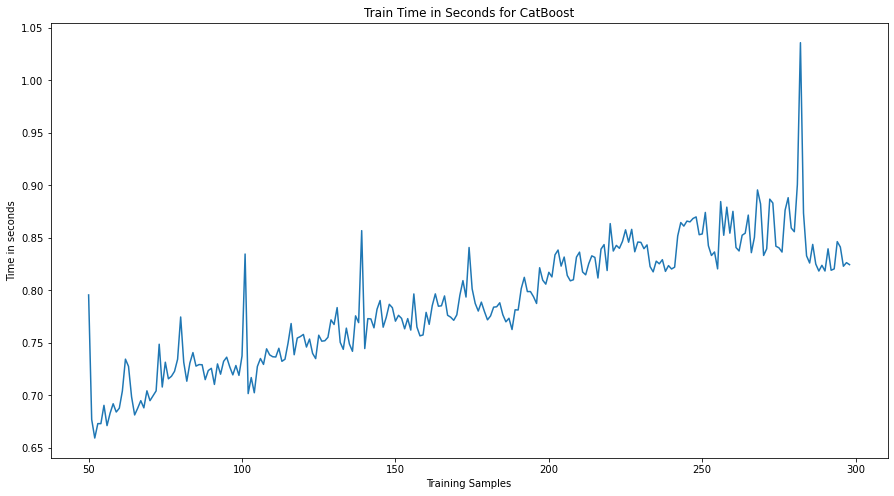

In [58]:
train_time(CatBoostClassifier(), X, Y, "Train Time in Seconds for CatBoost")

## K-Nearest-Neighbors:

KNN uses the basic principle of eucledian distance to find group that a sample belongs to.

KNN gave a very poor result in our testing, the assumed reason for this was the less number of samples and randomized distribution of data.

We also tried tuning the model using graphical method but it did not yield any meaningful result.

**Final Reults:**
  - Train Accuracy: 0.8619246861924686
  - Test Accuracy:  0.85
  - F1 score Test:  0.7567567567567568

In [59]:
from sklearn.neighbors import KNeighborsClassifier

kclf = KNeighborsClassifier()
kclf.fit(x_train, y_train)
predict = kclf.predict(x_test)
print("Train Accuracy: ",kclf.score(x_train, y_train))
print("Test Accuracy: ", kclf.score(x_test, y_test))
print("F1 score Test: ", f1_score(predict, y_test))

Train Accuracy:  0.7620817843866171
Test Accuracy:  0.6333333333333333
F1 score Test:  0.3529411764705882


**We can see that KNN is performing very poorly when the number of varibles are more so now we will select less variables for KNN. For feature selection we will select the 3 best features from the graphs we plotted before**

- Time
- Serum Ceratinine
- Ejection Fraction

In [60]:
new_df = df.drop(columns=['age', 'anaemia', 'creatinine_phosphokinase', 
       'high_blood_pressure', 'platelets', 'serum_sodium',
       'smoking'])
new_df.head()

,ejection_fraction,serum_creatinine,time,DEATH_EVENT
0,20,1.212227,4,1
1,38,-0.087641,6,1
2,20,0.381817,7,1
3,20,1.212227,7,1
4,20,1.715066,8,1


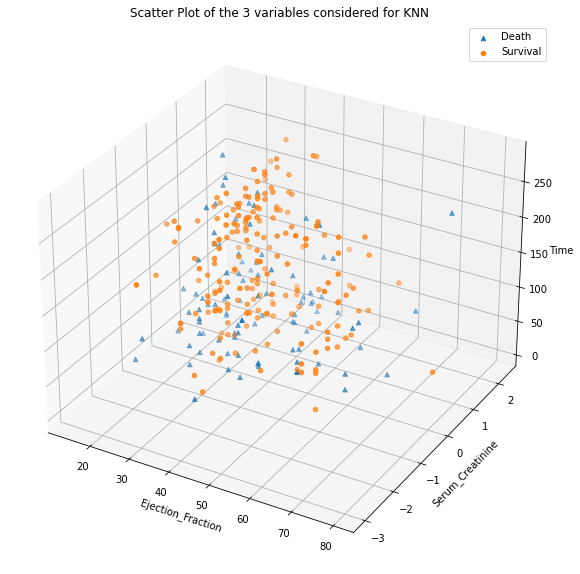

In [61]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')

d1 = new_df[new_df['DEATH_EVENT'] == 1]
ax.scatter(d1['ejection_fraction'].values, d1['serum_creatinine'].values, d1['time'].values, marker = '^', label = 'Death')

d2 = new_df[new_df['DEATH_EVENT'] == 0]
ax.scatter(d2['ejection_fraction'].values, d2['serum_creatinine'].values, d2['time'].values, marker = 'o', label = 'Survival')

plt.title("Scatter Plot of the 3 variables considered for KNN")
plt.xlabel('Ejection_Fraction')
plt.ylabel('Serum_Creatinine')
ax.set_zlabel('Time')
plt.legend()

In [62]:
X_new = new_df.iloc[:, 0:3].values
Y_new = new_df.iloc[:, -1].values

In [63]:
x_new_train, x_new_test, y_new_train, y_new_test = train_test_split(X_new, Y_new, test_size = 0.2, random_state = 0)

3


Text(0.5, 0, 'N-5')

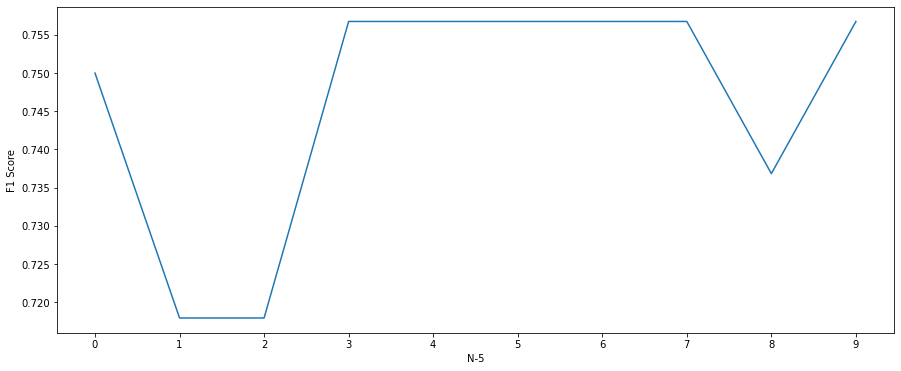

In [64]:
scores = []
for i in range(5, 15):
    kclf = KNeighborsClassifier(n_neighbors=i)
    kclf.fit(x_new_train, y_new_train)
    predict = kclf.predict(x_new_test)
    score = f1_score(predict, y_new_test)
    scores.append(score)

print(scores.index(max(scores)))
plt.figure(figsize=(15,6))
plt.plot(scores)
# plt.plot([max(scores) for i in range(5,15)], color='red')
plt.xticks([i for i in range(0, 10)])
plt.ylabel("F1 Score")
plt.xlabel("N-5")


In [65]:
kclf = KNeighborsClassifier(n_neighbors=11)
kclf.fit(x_new_train, y_new_train)
predict = kclf.predict(x_new_test)

print("Train Accuracy: ",kclf.score(x_new_train, y_new_train))
print("Test Accuracy: ", kclf.score(x_new_test, y_new_test))
print("F1 score Test: ", f1_score(predict, y_new_test))

Train Accuracy:  0.8619246861924686
Test Accuracy:  0.85
F1 score Test:  0.7567567567567568


## Training Time Analysis for KNN:
We will try training our KNN using different number of samples and then plot the training time required against the number of samples used for training the model.

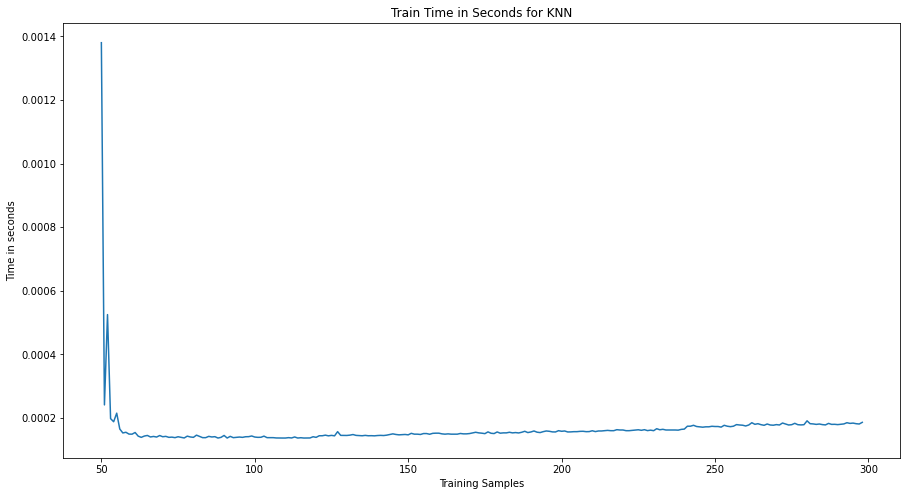

In [66]:
train_time(KNeighborsClassifier(n_neighbors = 11), X_new, Y_new, "Train Time in Seconds for KNN")

## Visualization of Results:

In [67]:
model_names = ['Logistic Regression', 'Decision Tree', 'Random Forest', 'Bagging Classifier', 'Gradient Boosting', "XgBoost",
              'XGBRFBoost', 'Extra Trees','CatBoost', 'KNN']
max_train_time = [[0.085], 0.002, 0.29, 6.23, 0.15, 0.055, 0.08, 0.23, 2.4, 0.002]
scores = [[0.9], 0.9666666666667, 0.9333333, 0.9333333, 0.86666667, 0.9666666666666667, 0.9333333, 0.9, 0.9333333, 0.85]
f1_scores = [[0.8571428571428572], 0.9523809523809523, 0.9090909090909091, 0.9090909090909091, 0.8181818181818182, 0.9523809523809523, 0.9090909090909091, 0.8695652173913043, 0.9090909090909091, 0.7567567567567568]

In [68]:
print(scores, f1_scores, max_train_time)

[[0.9], 0.9666666666667, 0.9333333, 0.9333333, 0.86666667, 0.9666666666666667, 0.9333333, 0.9, 0.9333333, 0.85] [[0.8571428571428572], 0.9523809523809523, 0.9090909090909091, 0.9090909090909091, 0.8181818181818182, 0.9523809523809523, 0.9090909090909091, 0.8695652173913043, 0.9090909090909091, 0.7567567567567568] [[0.085], 0.002, 0.29, 6.23, 0.15, 0.055, 0.08, 0.23, 2.4, 0.002]


Text(0.5, 1.0, 'Mean Accuracy of different Models on Data')

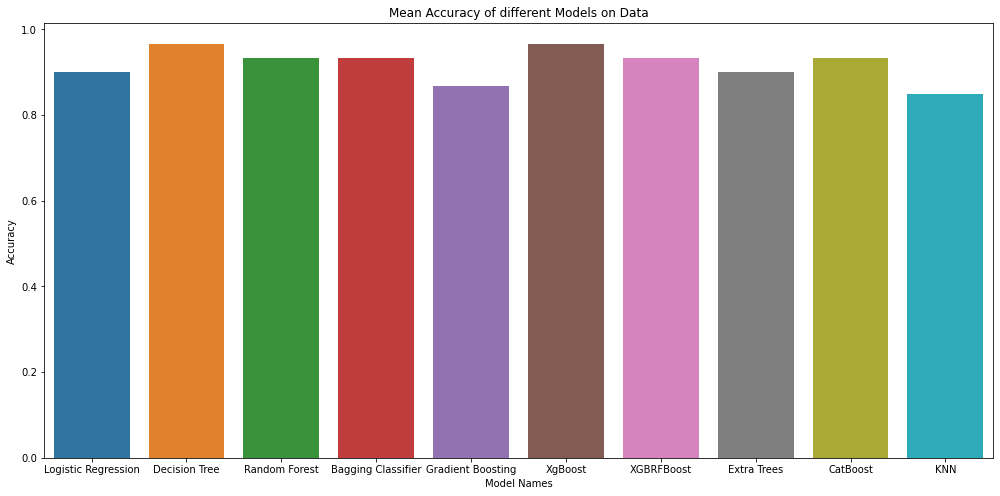

In [69]:
fig = plt.figure(figsize=(17, 8))
sns.barplot(data=scores)
plt.xticks([i for i in range(10)], model_names)
plt.xlabel('Model Names')
plt.ylabel('Accuracy')
plt.title('Mean Accuracy of different Models on Data')

Text(0.5, 1.0, 'F1 Score of different Models on Data')

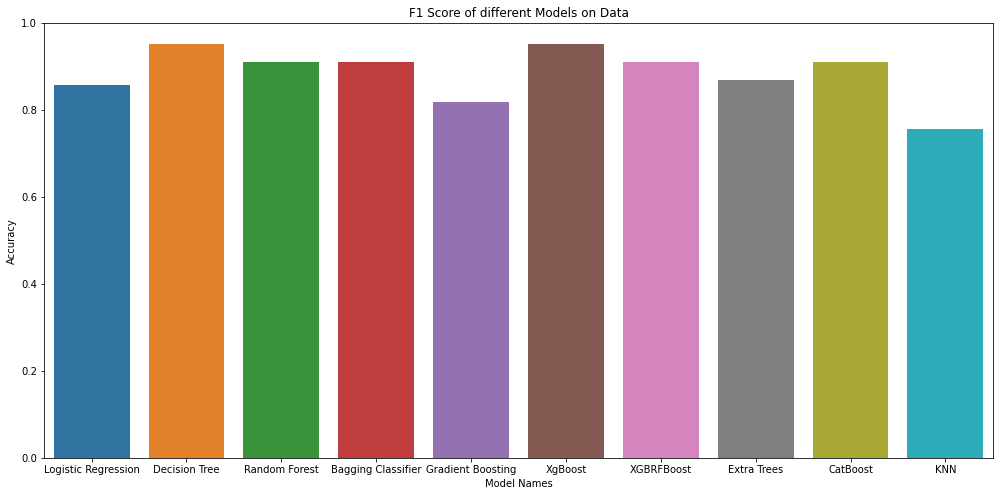

In [70]:
fig = plt.figure(figsize=(17, 8))
sns.barplot(data=f1_scores)
plt.xticks([i for i in range(10)], model_names)
plt.xlabel('Model Names')
plt.ylabel('Accuracy')
plt.title('F1 Score of different Models on Data')

Text(0.5, 1.0, 'Max Training Time taken by different Models on Data')

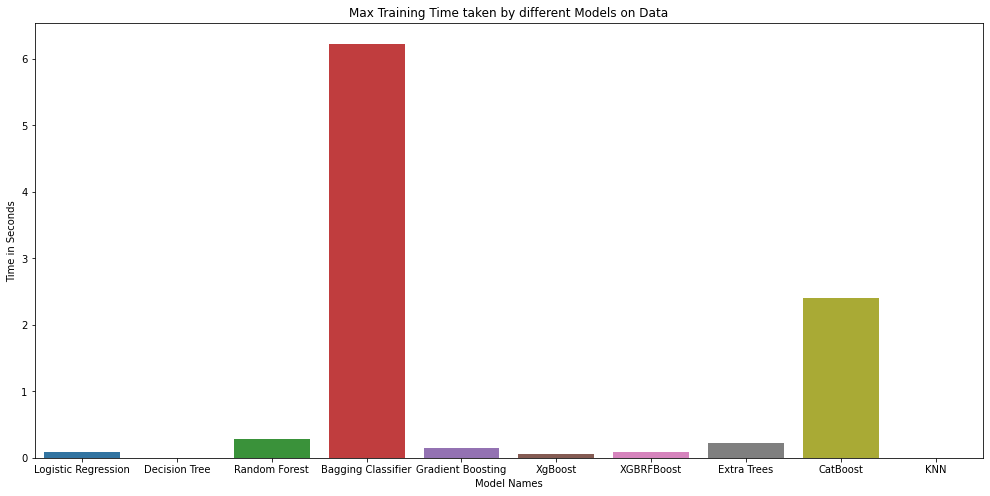

In [71]:
fig = plt.figure(figsize=(17, 8))
sns.barplot(data=max_train_time)
plt.xticks([i for i in range(10)], model_names)
plt.xlabel('Model Names')
plt.ylabel('Time in Seconds')
plt.title('Max Training Time taken by different Models on Data')

## Aggregator Function:

We first used 5 models in our Aggregator Function but we observed that the predicted f1-score actually reduced and then we settled on using 3 models in the Aggregator Function. 

Using the information shown above we get that the top 3 Models for our prediction are:
1. Decision Tree
2. XGBoost Classifier
3. XGBRF Classifier 

**The Aggregator function will take in input from user and feed it to the 3 models in our function the prediction of these 5 models will be recorded. The answer which has the majority among all the predictions will be outputed to the user.**

**Final Result**
   - Test on Train Data -> F1 Score = 1.0
   - Test on Test Data  -> F1 Score = 0.9523809523809523

In [72]:
def Aggregator(data, m1, m2, m3):
    # Check if Input data is valid 
    if len(data) == 10:
        #convert data into a 2D array
        data = data.reshape(1, -1)
        
        # make predictions using all five models
        pred1 = m1.predict(data)
        pred2 = m2.predict(data)
        pred3 = m3.predict(data)
        
        # find out the majority decision pred2, pred3, 
        pred = [pred1, pred2, pred3]
        risk = pred.count(1)
        healthy = pred.count(0)
        
        # return 0/1 depending on result
        if risk > healthy:
            return 1
        else:
            return 0
    # if data is invalid return -1
    else:
        return -1

In [73]:
prediction = []
for i in range(len(x_train)):
    x = Aggregator(x_train[i], dclf, xclf, xrclf)
    prediction.append(x)

In [74]:
f1_score(prediction, y_train)

1.0

In [75]:
from sklearn.metrics import accuracy_score
accuracy_score(prediction, y_train)

1.0

In [76]:
prediction = []
for i in range(len(x_test)):
    x = Aggregator(x_test[i], dclf, xclf, xrclf)
    prediction.append(x)

In [77]:
f1_score(prediction, y_test)

0.9523809523809523

In [78]:
from sklearn.metrics import accuracy_score
accuracy_score(prediction, y_test)

0.9666666666666667

### Evaluation Using AUC-ROC Curve:

Area Under Curve = 95% which means that our prediction model is working perfectly!

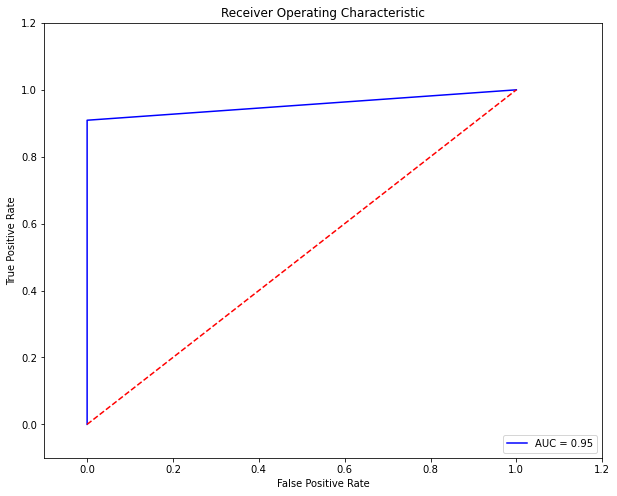

In [79]:
from sklearn.metrics import roc_curve, auc

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, prediction)
roc_auc = auc(false_positive_rate, true_positive_rate)

figure = plt.figure(figsize=(10, 8))
plt.title('Receiver Operating Characteristic')
plt.plot(false_positive_rate, true_positive_rate, 'b',
label='AUC = %0.2f'% roc_auc)
plt.legend(loc='lower right')
plt.plot([0,1],[0,1],'r--')
plt.xlim([-0.1,1.2])
plt.ylim([-0.1,1.2])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()